In [15]:
######################################### Libraries ##############################################

import numpy as np
import matplotlib
from matplotlib import pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
%matplotlib inline     

import tigramite
from tigramite import data_processing as pp
from tigramite.toymodels import structural_causal_processes as toys
from tigramite.toymodels import surrogate_generator 
from tigramite import plotting as tp
from tigramite.pcmci import PCMCI
from tigramite.independence_tests.parcorr import ParCorr
from tigramite.independence_tests.robust_parcorr import RobustParCorr
from tigramite.models import Models, Prediction

import math
import sklearn
from sklearn.linear_model import LinearRegression
import pandas as pd


# If the code above gives you problems try this one

In [26]:
site = "S2"

path = f"{site}_data/"

# Rain Events
rainy_times = pd.read_csv(path + f"{site}_continuous_rain_periods.csv")

events = list(zip(
    pd.to_datetime(rainy_times['extended_start']),
    pd.to_datetime(rainy_times['extended_end'])))

########################################################################################

only_rainy_times = pd.read_csv(path + f"{site}_rain_continuous_rain_periods.csv")

start_r = rainy_times.extended_start
end_r   = rainy_times.extended_end

only_r_events = list(zip(
    pd.to_datetime(only_rainy_times['start_time']),
    pd.to_datetime(only_rainy_times['end_time'])))

Negative precipitation values: 151


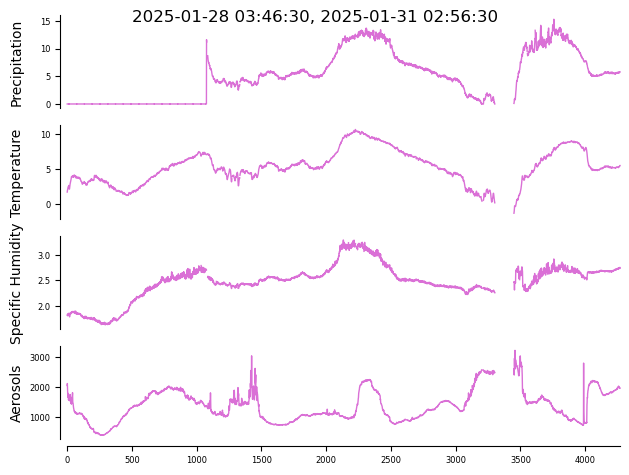

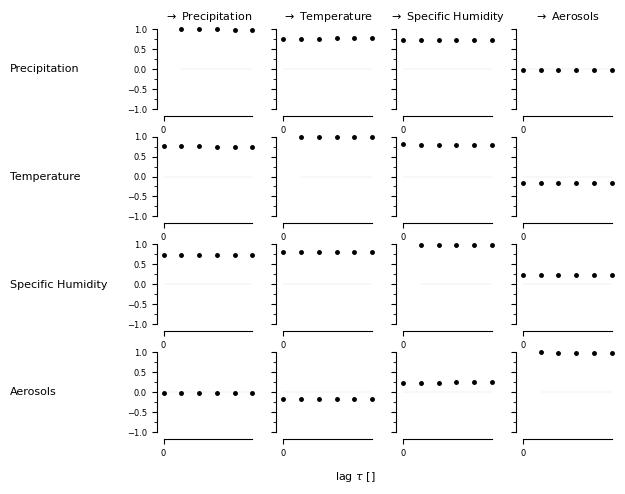

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


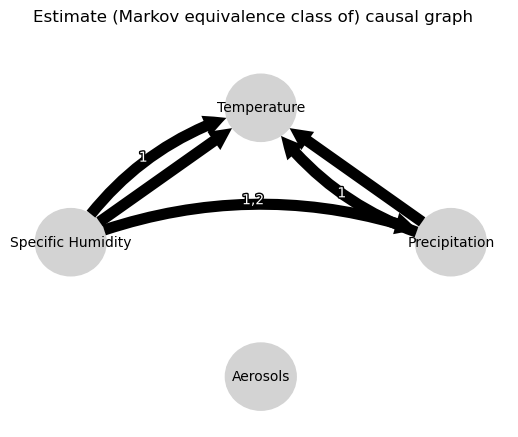

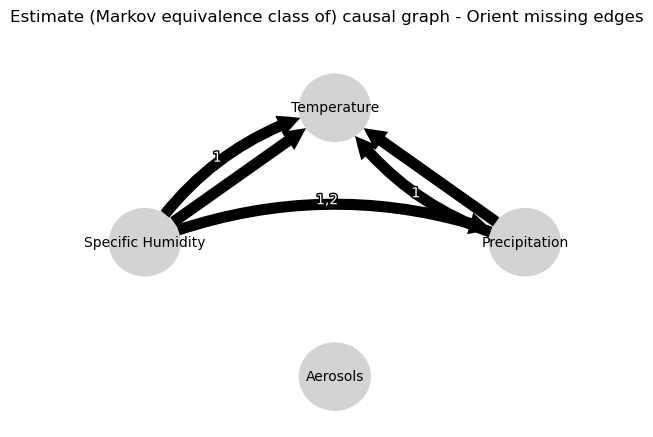

0.0
0.9956068999816714
0.9917441894808054
0.9881043708778527
0.9846124953995645
0.9812277565379428
0.6735017947074514
0.6738238084478445
0.6739153210690054
0.6739268503624801
0.6739039728944026
0.6738508574751765
0.5772017458787829
0.5754334073910898
0.5736173233177584
0.5719011179347193
0.5702338893258552
0.568538528528677
-0.07283403981085196
-0.07275622477422083
-0.07272778598844688
-0.07273982549617504
-0.07278838499573731
-0.07283148104705525
0.6735017947074514
0.6726828809114543
0.6719558724041279
0.6712217393590718
0.670498918387543
0.6697894443130474
0.0
0.9980879619843084
0.9949277331342152
0.9912504568101425
0.9873604644304809
0.9834204854519843
0.5675760064982783
0.5654818435307927
0.5636863587975484
0.5620932805151156
0.5604258863346199
0.5587537943675333
-0.06853870682595188
-0.06831065592558822
-0.06816310160354049
-0.06803734088981087
-0.06790136148417987
-0.06779132177760396
0.5675760064982783
0.5686901715650301
0.5696114643477626
0.5706038234764124
0.5715343504060117
0

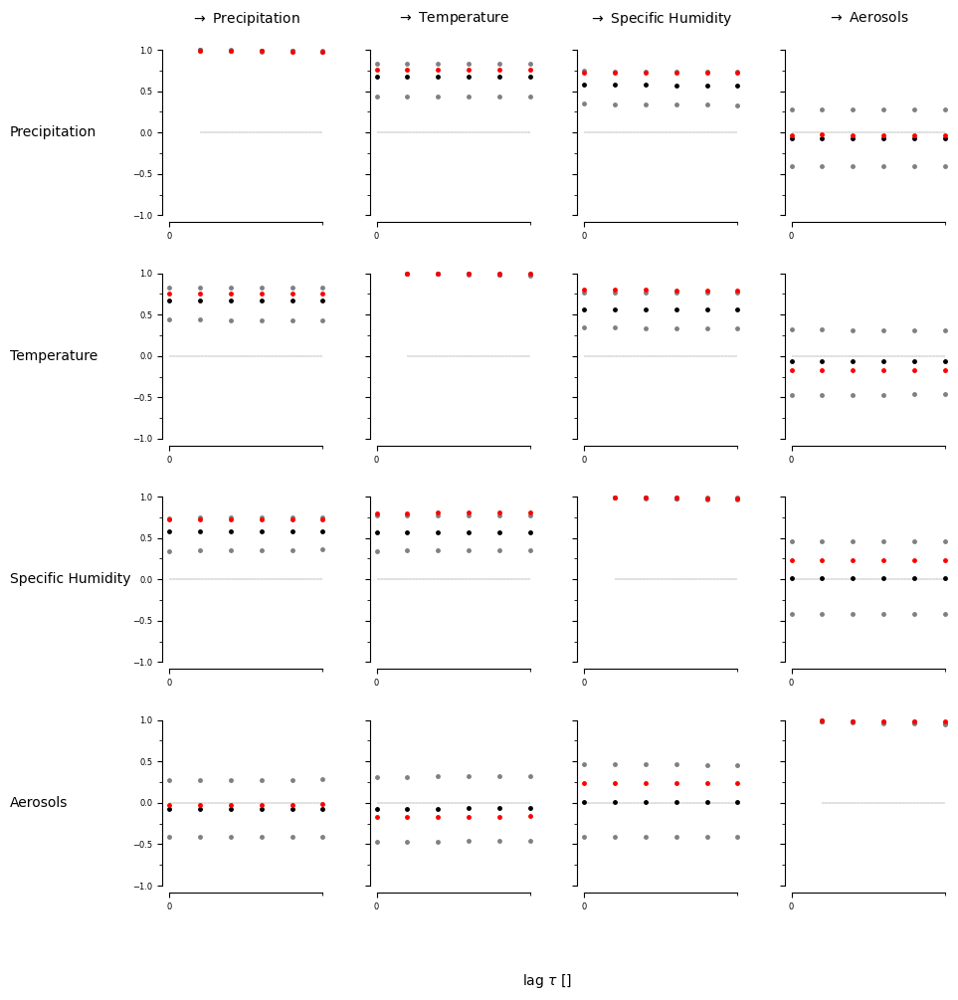

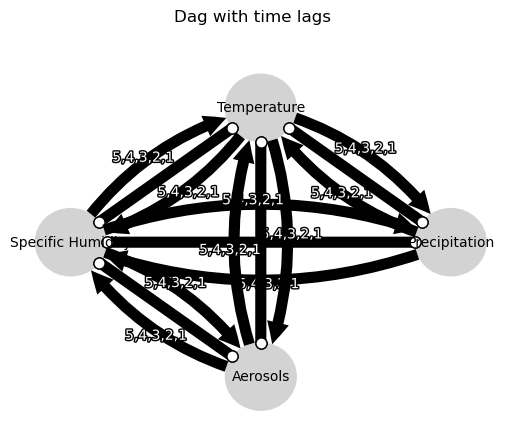

Negative precipitation values: 49


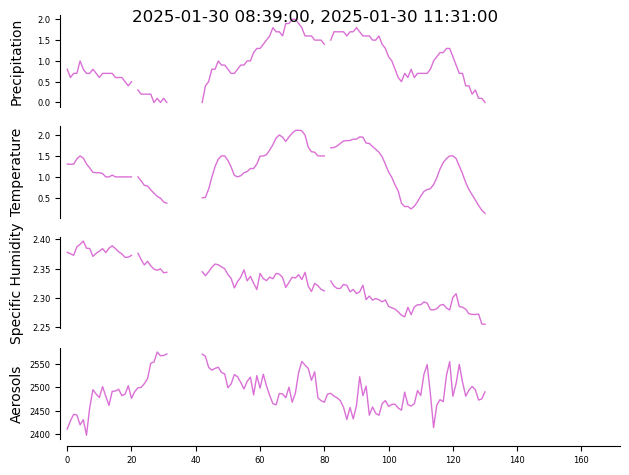

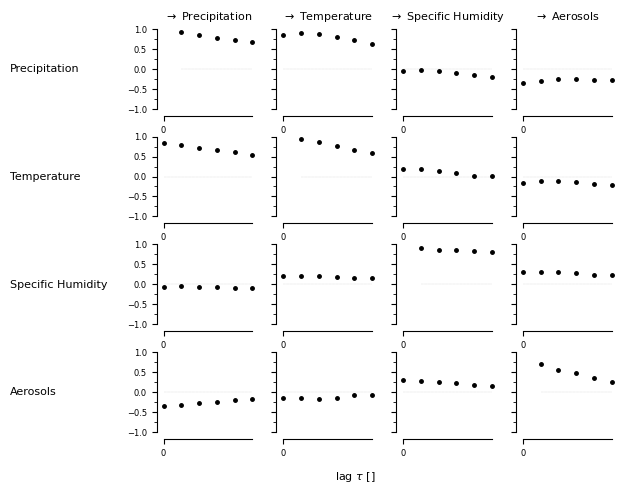

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


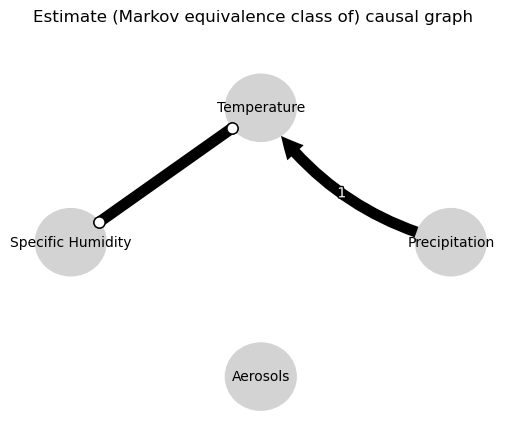

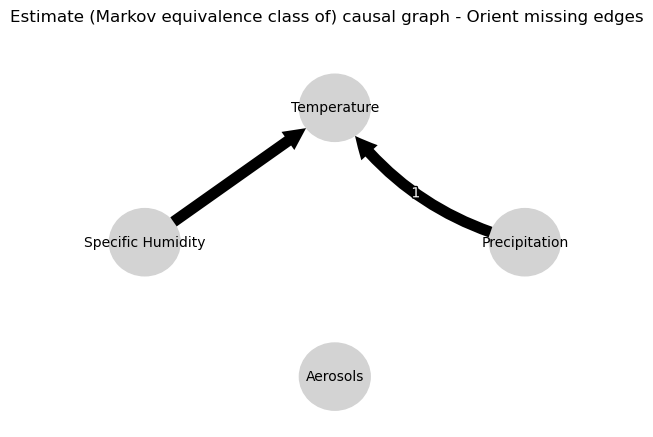

0.0
0.9163940052058205
0.8615401124943497
0.8161225491647963
0.7762916805893137
0.737430691971009
0.8339380724773894
0.8456231214648953
0.8399919339921914
0.8171570327239459
0.7893377645743546
0.7596176892396449
-0.12367037205226944
-0.12145863858327086
-0.12035246126309598
-0.11877658023533376
-0.11463805547020602
-0.11383884797790943
0.006750980284238987
0.0015197415743628596
0.0043179474363375684
0.005004784333671269
0.005299374645312653
0.00011608432331686805
0.8339380724773894
0.7884284033088513
0.7498175000086755
0.7131548362141927
0.6779722591845566
0.645455048189331
0.0
0.9282566271675955
0.8826104988319436
0.8397732661168584
0.79981498685957
0.759879873105357
0.16882897964523216
0.1454940943317057
0.12663879475822962
0.11188519749223731
0.10074367269881941
0.09092177073321416
0.008898821234434716
0.005823902384970625
0.004358049408897091
-0.0009808678741522099
-0.003284030840671448
-0.0023126040919048286
0.16882897964523216
0.15376761007078218
0.14590687441842337
0.13697066218

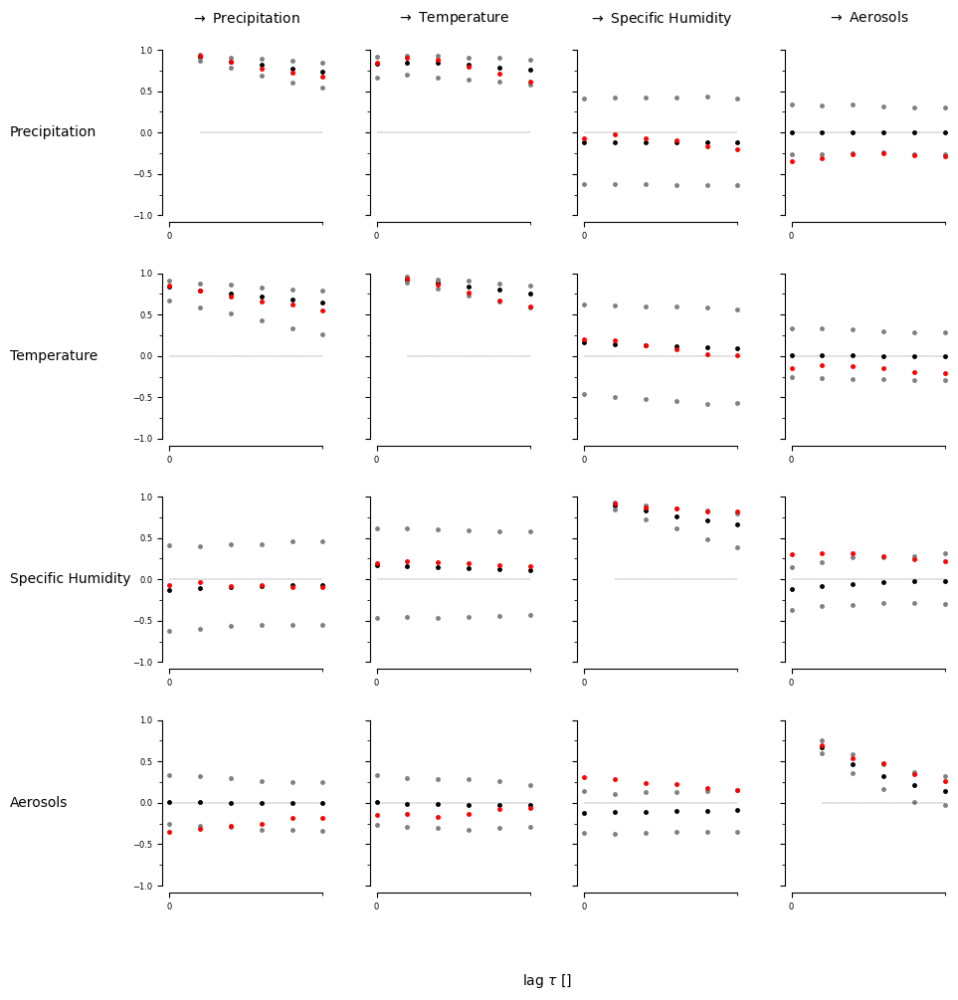

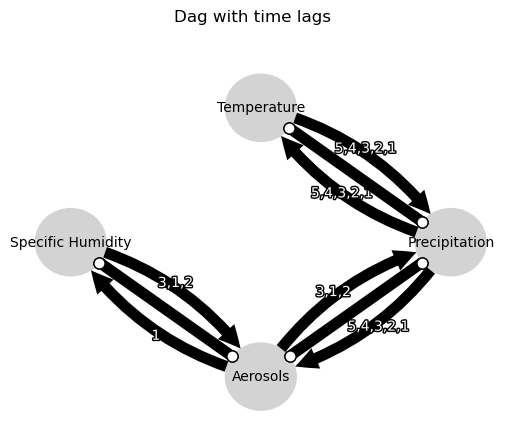

Negative precipitation values: 1104


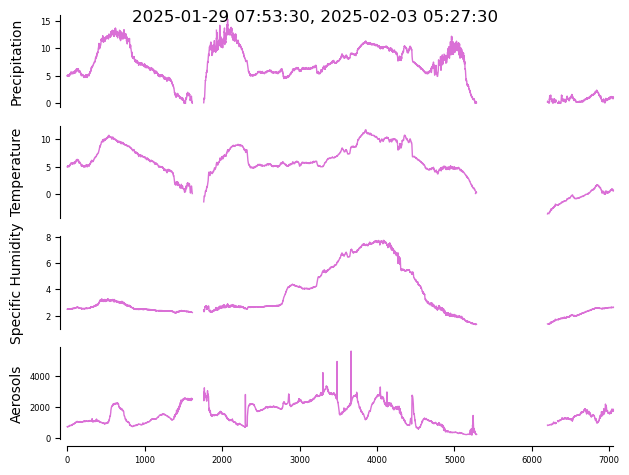

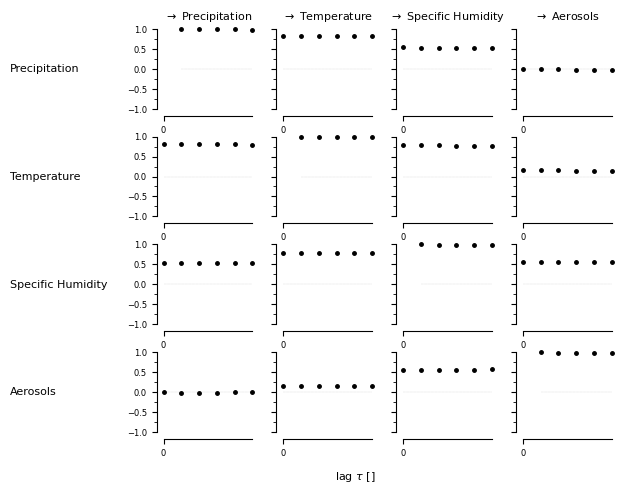

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


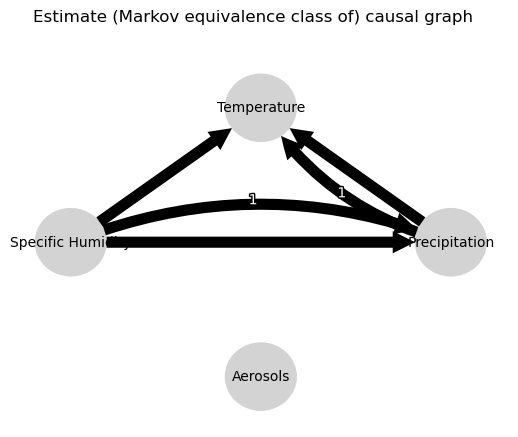

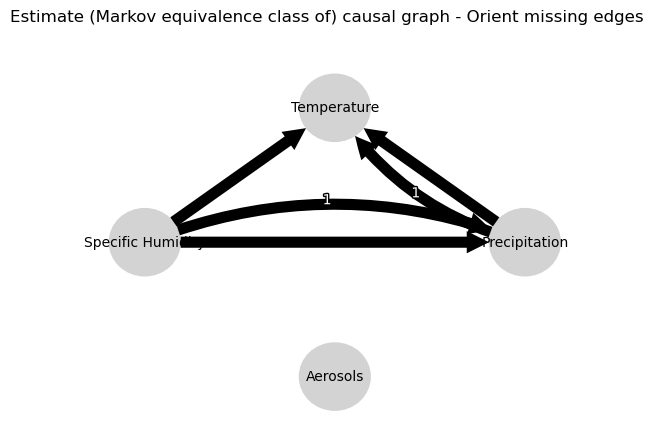

0.0
0.9969266439064388
0.9938049300841142
0.9908058698665059
0.9878865032513389
0.9850034554762367
0.8483821760349487
0.8501609726680347
0.8517730305577849
0.8532721227781235
0.8546911329610555
0.8560576194521222
0.2767542829183309
0.2762816440405632
0.2758376144640792
0.27541500831226695
0.27503334902818355
0.2746765731893076
-0.08122655795131989
-0.08091694917572619
-0.08066598257569643
-0.08047418808328233
-0.08025134102362036
-0.08003057767880817
0.8483821760349487
0.8463169095177645
0.8442734491662647
0.8422600595543825
0.8402761786323706
0.8382976868204262
0.0
0.9991537271300301
0.9977619614497093
0.9961630715240996
0.9944845386593082
0.9927955526790393
0.4153924369452129
0.4146329010485901
0.4139455796593555
0.4133375856115257
0.41278542604157814
0.4122671885516426
-0.08080224427067421
-0.08048747065261862
-0.08023458814809072
-0.07998917905214524
-0.07974544646349135
-0.07951235617452532
0.4153924369452129
0.41556872719899784
0.4154950614352337
0.41529577838371656
0.41505318124

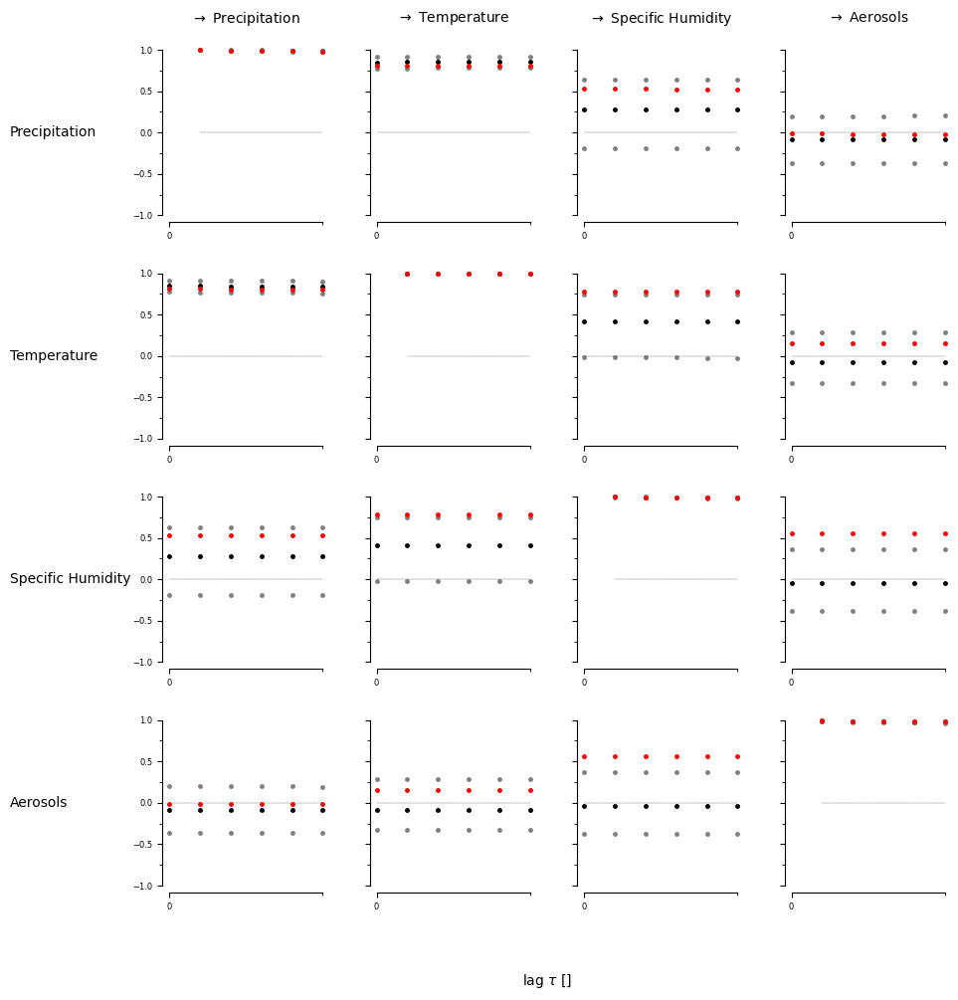

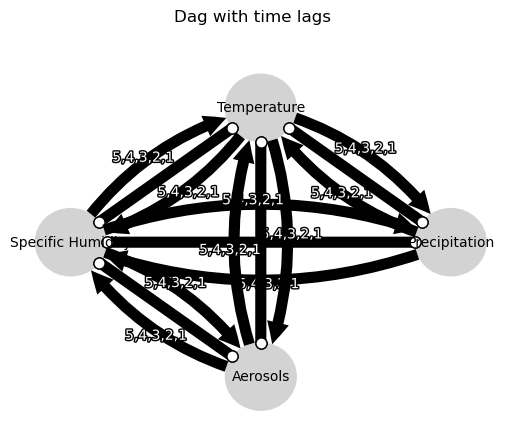

Negative precipitation values: 72


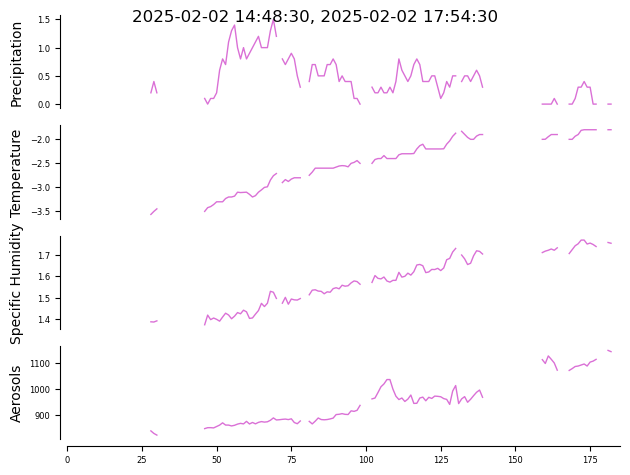

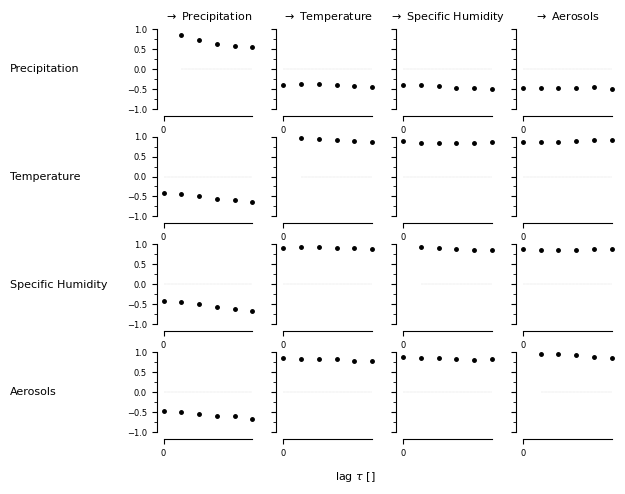

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


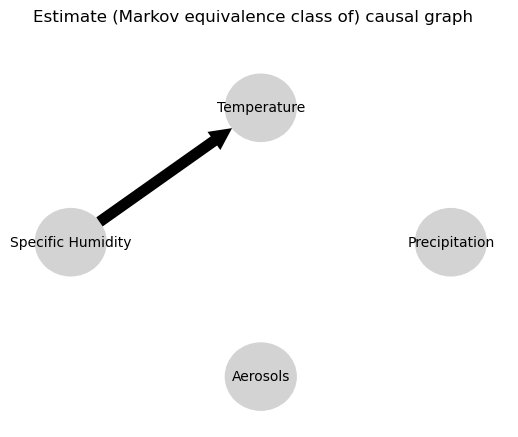

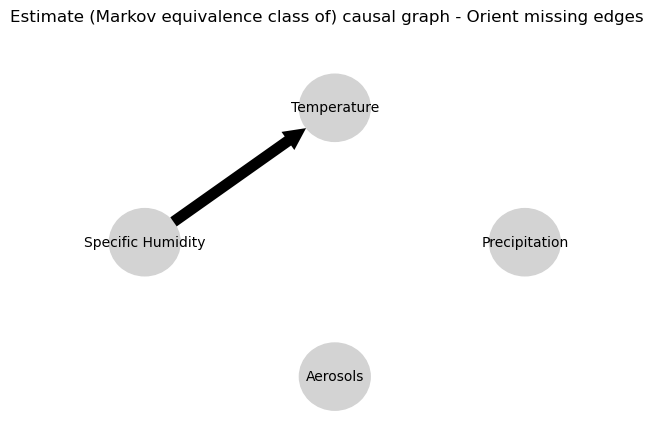

0.0
0.8642381401545991
0.7676186397401865
0.6846953605593643
0.6137602165243818
0.5489753739084168
0.10473388480065729
0.11294839903822312
0.11706194143188654
0.1209227380612619
0.12290471600283917
0.12332405165298767
0.14702667303773795
0.13794003409938607
0.1313255752306944
0.1289107647043129
0.12306029770039639
0.12320724756818517
-0.015042243174546045
-0.01777439569206115
-0.02046571210503279
-0.024930103112061862
-0.028559723728881155
-0.029893624905356613
0.10473388480065729
0.08743330292404405
0.07353744659837089
0.062313171211257984
0.05067512845423093
0.04249457460485979
0.0
0.9495743103909662
0.9152119316470736
0.8824641438534674
0.8485277597217042
0.8137450182303665
0.9303984718716424
0.8708736407322993
0.8266022277824098
0.7858092677973929
0.751898440108515
0.7190154437681008
0.06939357599333704
0.05776864154623567
0.04773389456239748
0.039714379505694695
0.02753624422441725
0.018269971797325108
0.9303984718716424
0.93371462796215
0.9202551918290237
0.8988372910971734
0.872

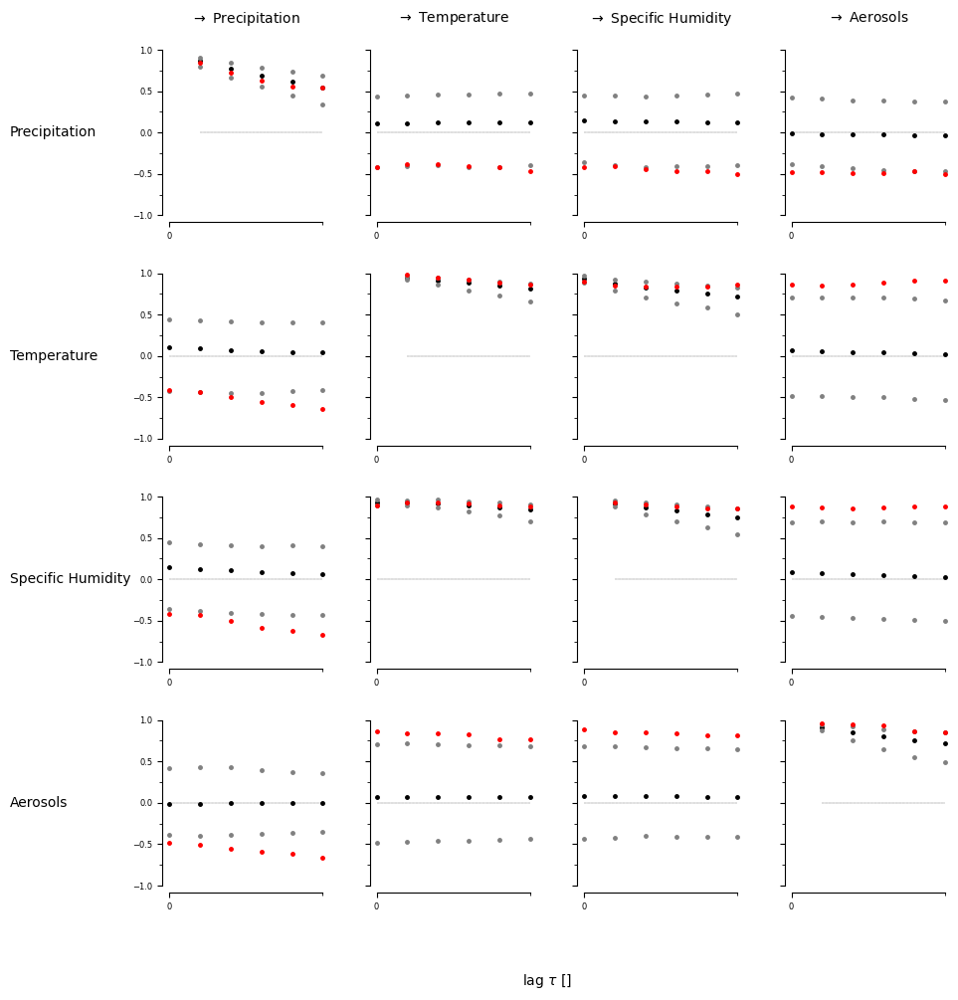

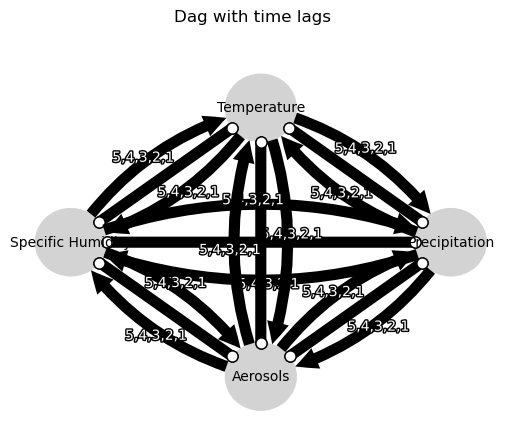

Negative precipitation values: 551


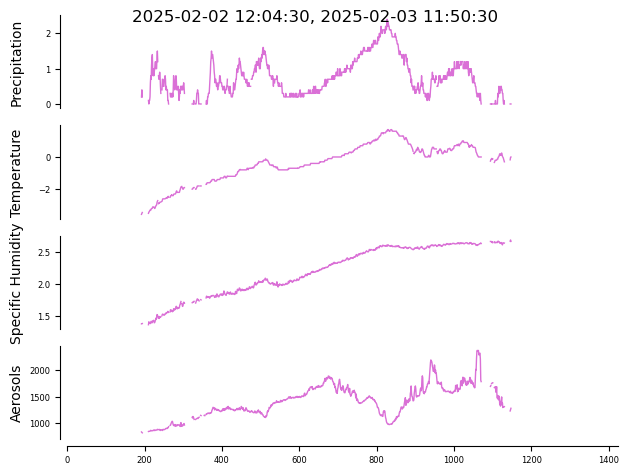

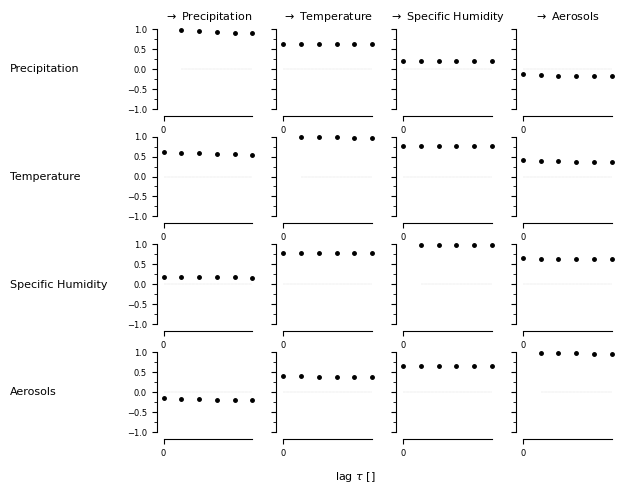

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


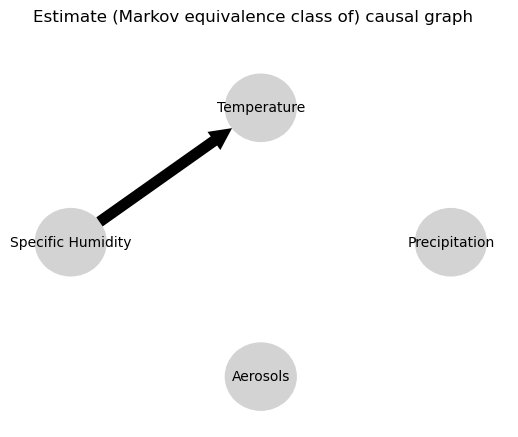

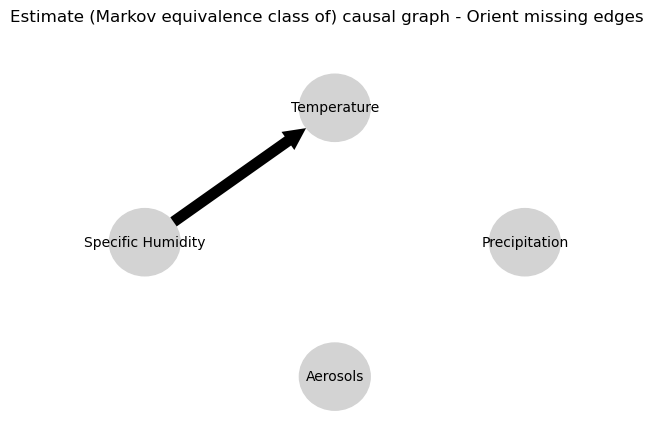

0.0
0.9689180468304714
0.9503948294065944
0.9308764974844169
0.9124037272154635
0.8944607928566409
0.1993595964160466
0.1991637622064383
0.1971690156362625
0.19452608946317057
0.19179193983497367
0.1888237429780265
0.1775590602357003
0.17652507151406688
0.1755160299650596
0.17451736953041447
0.17349152961600622
0.17224718928209257
-0.011155870264552894
-0.010996547084684297
-0.010436279020136472
-0.010147711729924102
-0.009627821267563596
-0.009301837072504369
0.1993595964160466
0.19432715222177616
0.1902327804396709
0.18607178510742053
0.1819855869541312
0.17799934405480283
0.0
0.989568653688721
0.9747955893201394
0.9586656934897033
0.942347978239193
0.9264869720166723
0.6301045308306711
0.623913540880938
0.6181872418745371
0.612761079646844
0.6075833313232839
0.6024058375033856
-0.03406602348657677
-0.034508049940715
-0.03494961545811244
-0.03518120973465353
-0.035280071069299306
-0.03535769171659889
0.6301045308306711
0.6277197172824276
0.6226280116068711
0.6167090288070067
0.610597

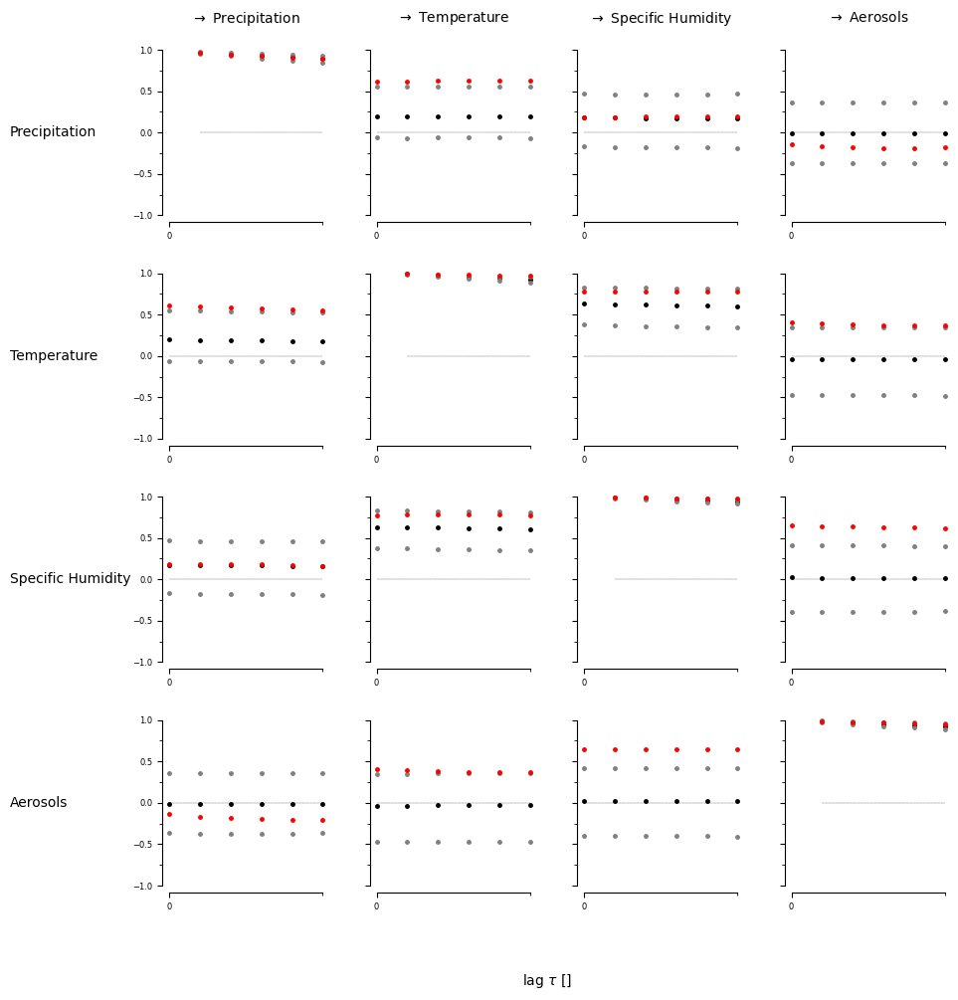

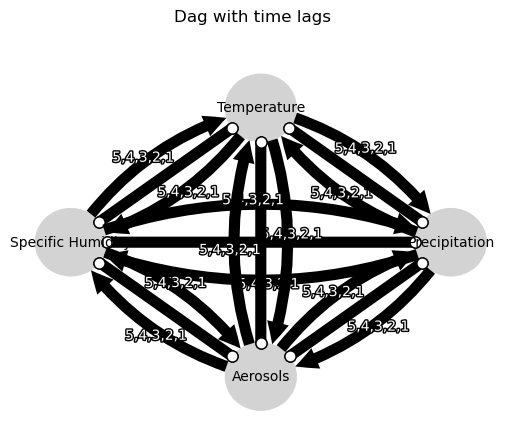

Negative precipitation values: 11


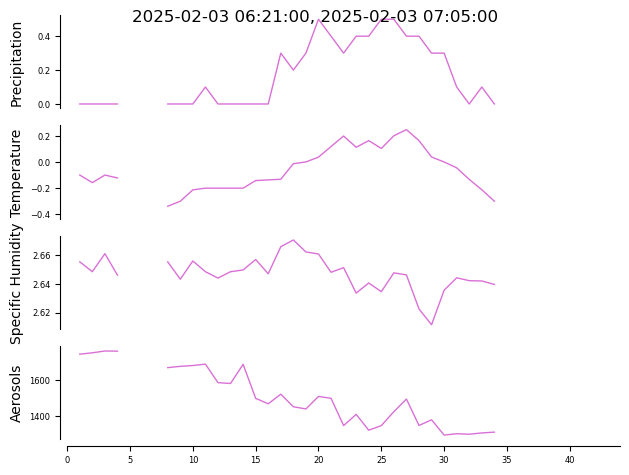

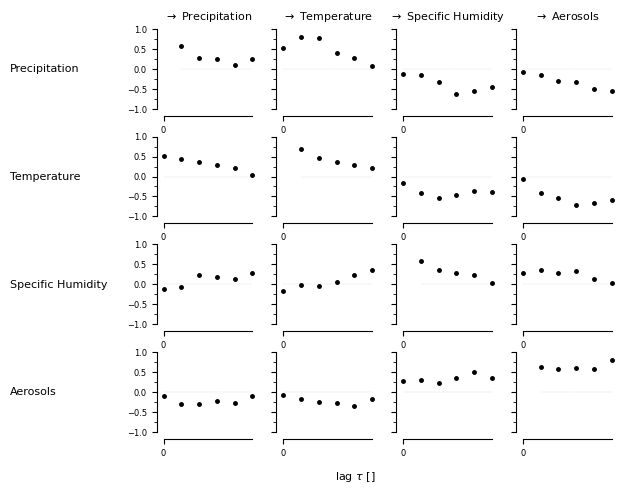

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


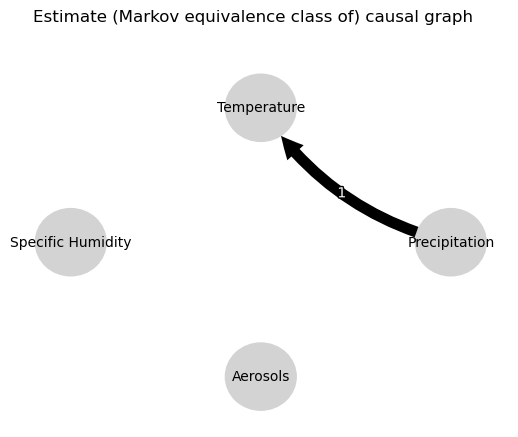

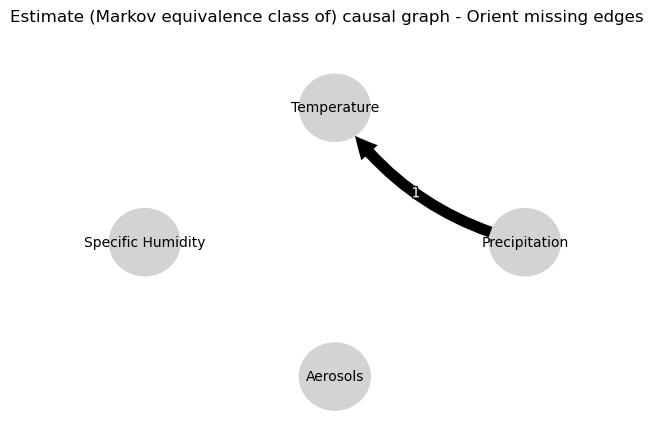

0.0
-0.019675835101427404
-0.02343157200626413
-0.02108510803211481
-0.004788577928310365
-0.022589151204537437
0.060181082070964294
0.8652378234314915
-0.04695803962435577
-0.021758558795968694
-0.027522636425953522
-0.0011176084886695148
-0.12808314967332876
0.02324635144752616
-0.01838601463126459
-0.005883590366777819
-0.05760373464599272
0.0017180867778654563
-0.3310528289832942
0.03988124780792532
-0.02801575852749606
0.016426245875033784
-0.014838712515572467
0.02051587048431107
0.060181082070964294
-0.021546568598292203
-0.007157389542812281
-0.016385904300313704
-0.025659058797836448
-0.027293656262425955
0.0
0.019182574814723387
-0.024826393318340245
-0.028059490612412988
-0.01677866602303883
-0.04182285242855371
0.08828812810588298
-0.010716723008484972
0.0019395679105460206
-0.06308914550855686
-0.0030027480929503752
-0.011945999629936152
0.06495917211656384
-0.02204977266650165
0.01273963648862242
-0.010105312174191017
0.030869961686265615
-0.0259365308479651
0.08828812810

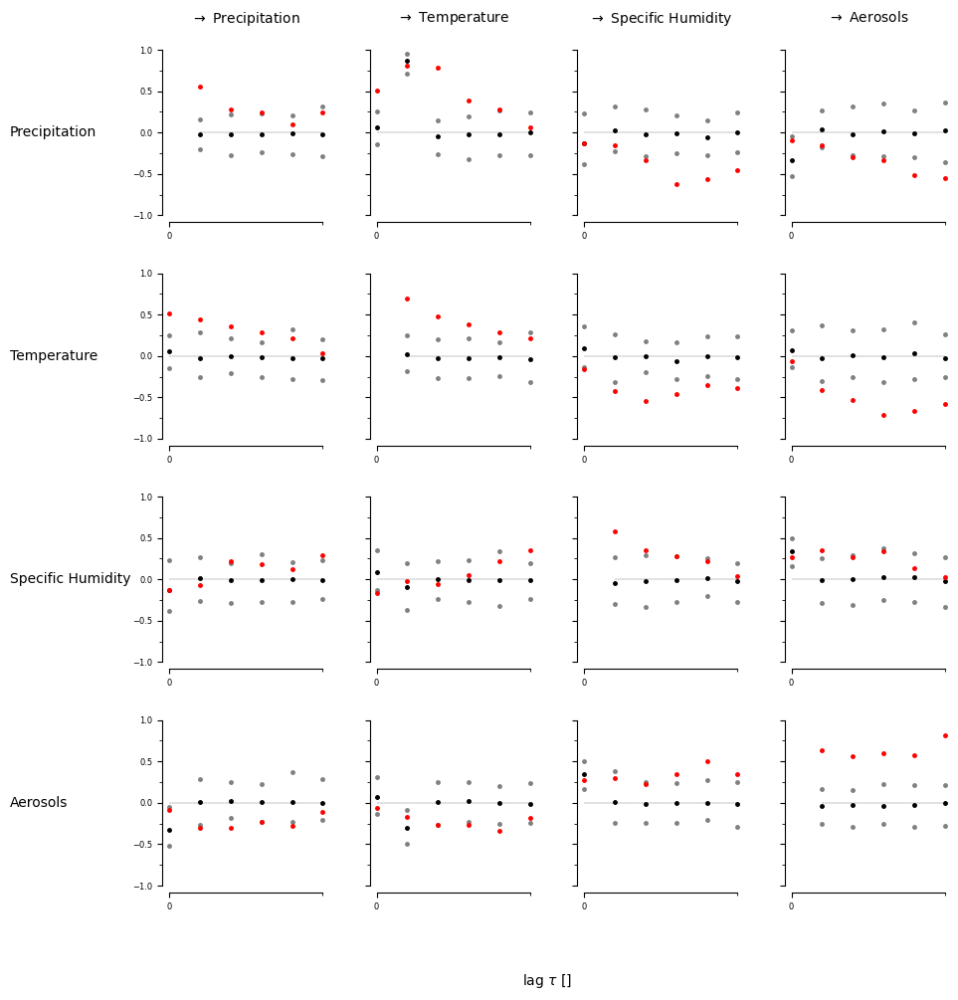

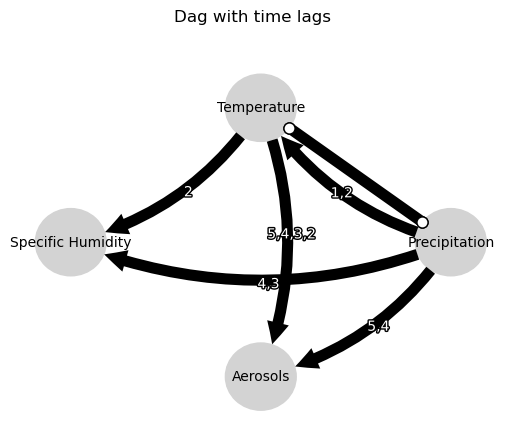

Negative precipitation values: 541


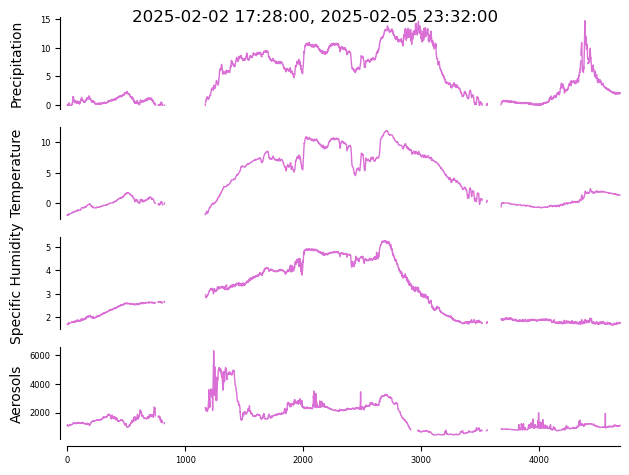

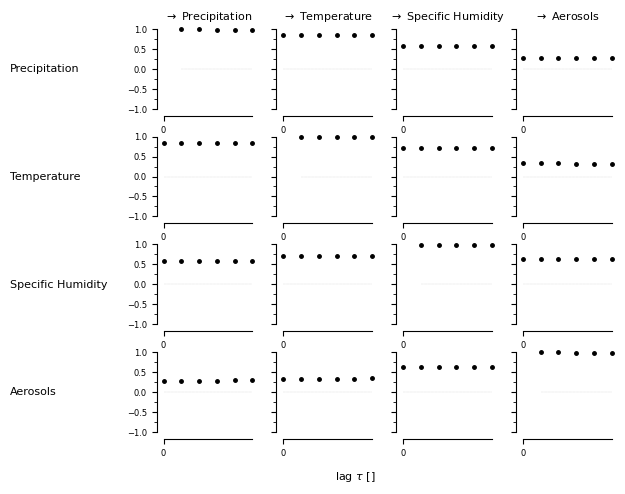

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


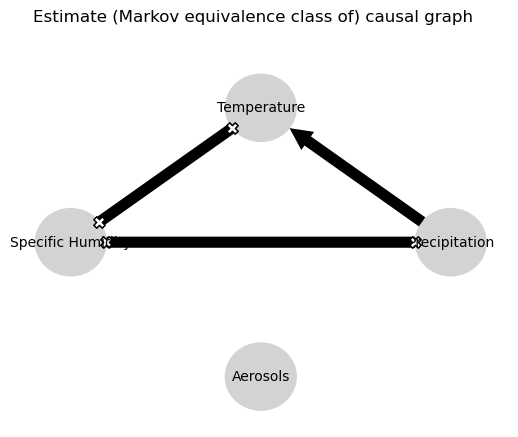

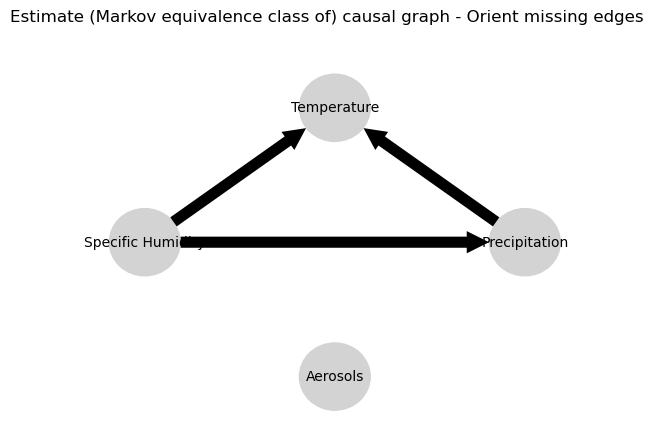

0.0
0.9954282879197908
0.9899110387544394
0.9845958067373006
0.9794336884536372
0.9743948816021561
0.7920410180773214
0.7941327787828516
0.7958728910072032
0.7973761048376208
0.7986920441813418
0.7998337774029559
0.5868706860845002
0.5855095487240984
0.5843254977109654
0.5832975967462538
0.5823868784849203
0.5814574571453327
-0.010855448817737312
-0.01074275568029717
-0.010608230591491128
-0.010486914377304202
-0.010399942057608249
-0.010299420128644918
0.7920410180773214
0.7894267123464027
0.7867832617184208
0.7841726875722731
0.781593382058158
0.779046322882849
0.0
0.998668209607135
0.9960973602668894
0.992736092315793
0.9888719342333687
0.9847078833473114
0.765133363681613
0.7633139384335227
0.7617045297360501
0.7602346158296523
0.7588225430360445
0.7573976578548067
0.006665802677943415
0.006643079840018626
0.006630032563729857
0.006634461852223755
0.006647739091632734
0.006660176989456714
0.765133363681613
0.7659621503464196
0.7661510826360113
0.7658923084191058
0.7653509809536732


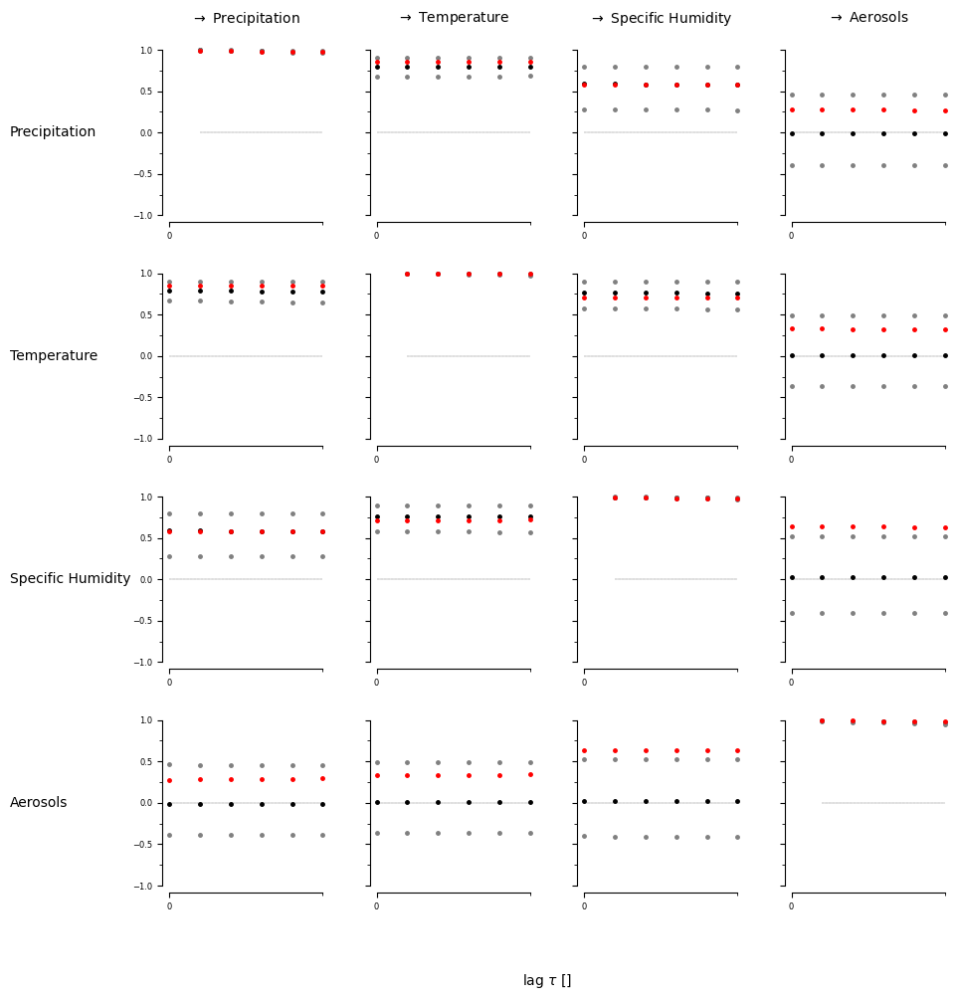

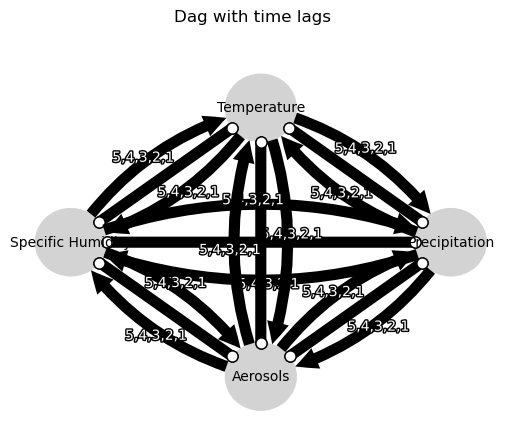

Negative precipitation values: 477


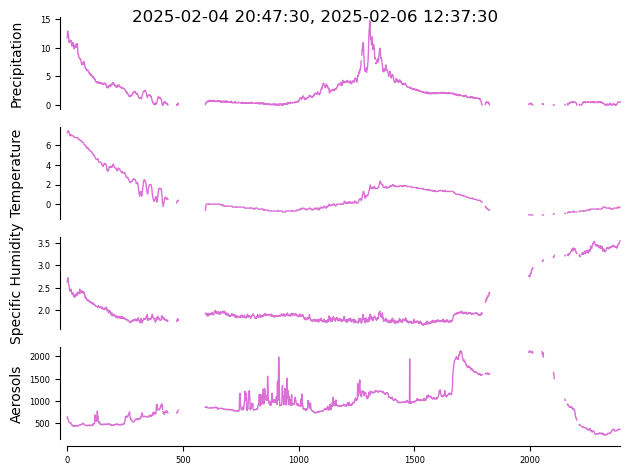

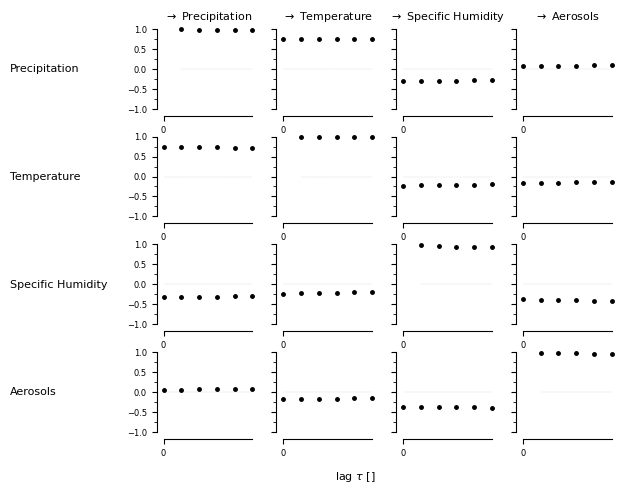

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


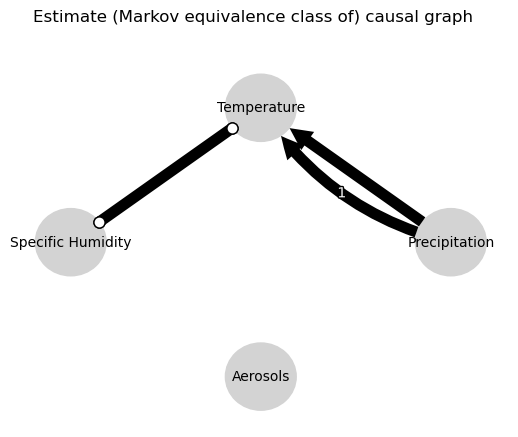

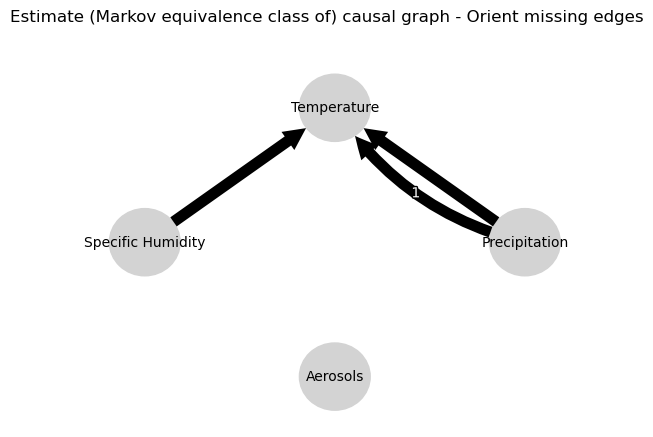

0.0
0.9929427484114012
0.9828113050003053
0.971423577667599
0.9596324706233862
0.9478733786385667
0.5256316389891144
0.5320917632522072
0.5378679227577543
0.5431976230549453
0.5482830565244707
0.5531906019038785
0.04865743422342673
0.04894623385187171
0.049384507976957794
0.04978118483435425
0.05009903787526796
0.05041485252018373
0.009445737596666035
0.008910944727650843
0.0083502313763276
0.007897358939835793
0.0074456837256530566
0.007038660930283127
0.5256316389891144
0.518411565798666
0.5109978190200595
0.5035343345579475
0.4961356433046263
0.48884554613679176
0.0
0.9942058710435682
0.9892766634201652
0.9845547510590253
0.9799805701036918
0.9755495468649129
0.17766702682983532
0.1770559974886555
0.17656090220797227
0.17615390249166268
0.17581675236613614
0.17556959197538724
0.008395184651103864
0.008234994347568036
0.007993387548775962
0.007832890164740003
0.007759374424559956
0.007727530374392467
0.17766702682983532
0.17686948415999207
0.17607107033581518
0.17533903535476292
0.17

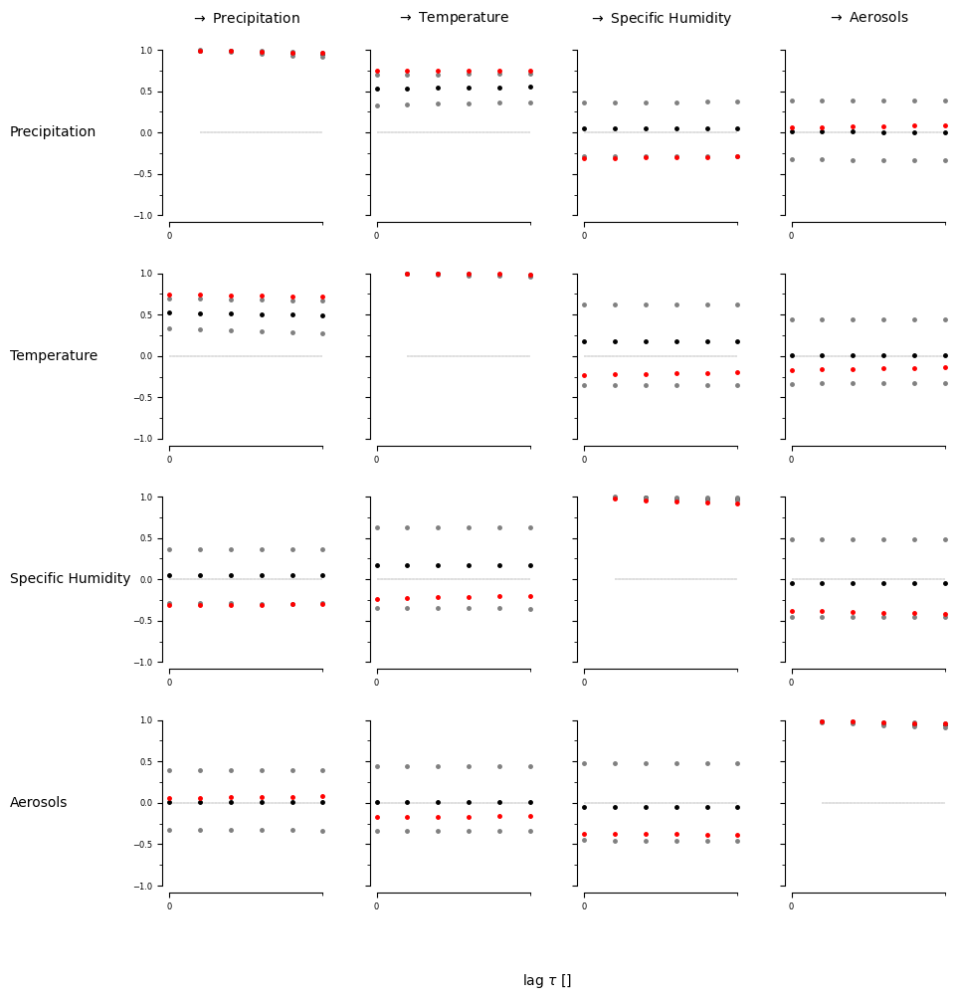

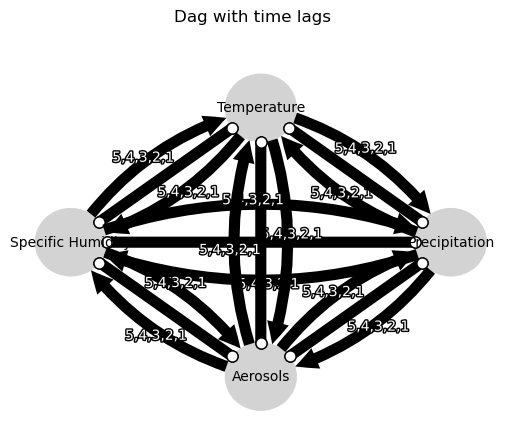

Negative precipitation values: 31


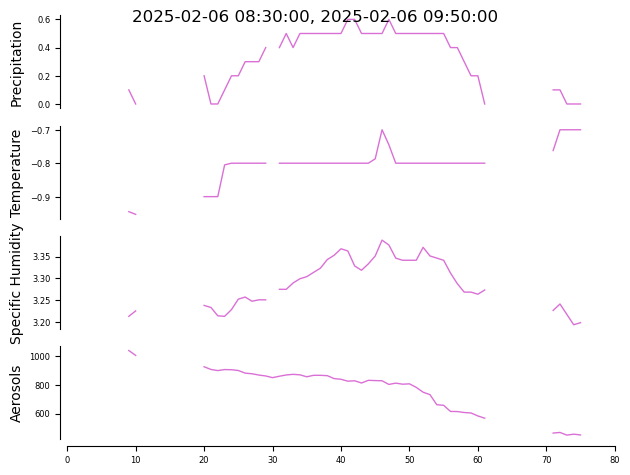

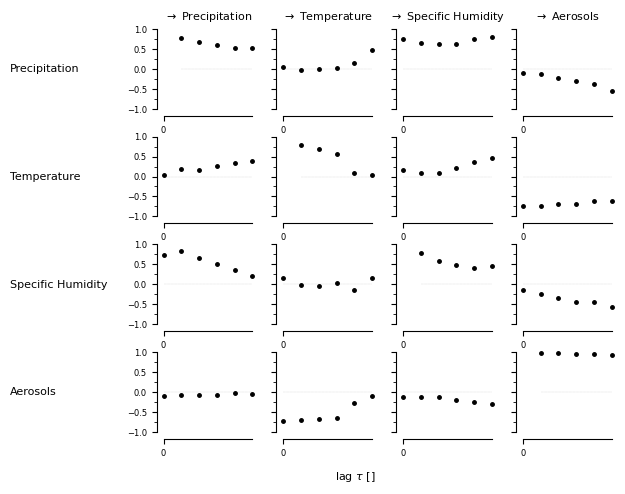

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


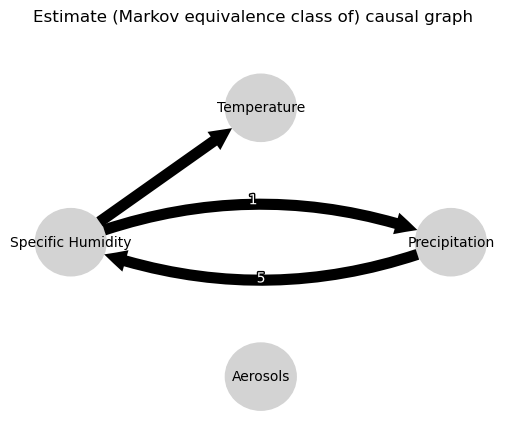

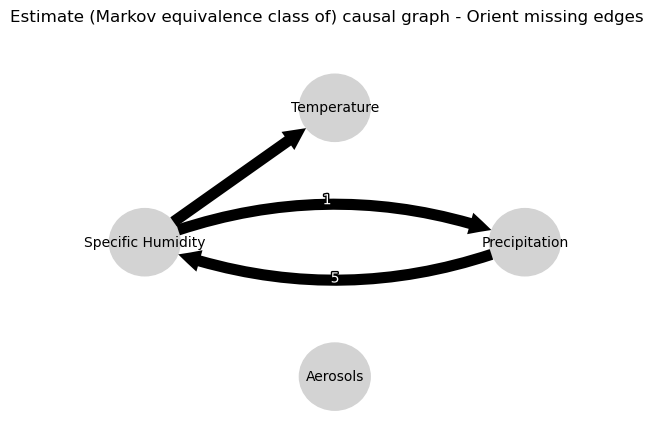

0.0
0.7690927483646408
0.6329478776675856
0.5369335971023861
0.46806840781421427
0.4251222218149856
-0.05043252388831023
-0.06861875285074953
-0.08191355705802683
-0.10547227197417502
-0.13311613767559144
-0.15600948191810343
0.4094375271956253
0.30698045996074347
0.38235381079015246
0.4482366125672996
0.5442414490461928
0.6622938110994729
0.21427485580028902
-0.08415045674286191
-0.0435504657857725
-0.05037482130408682
-0.043968149114349604
-0.047496375727815315
-0.05043252388831023
-0.05279427567842545
-0.056758983806132556
-0.05785206349651054
-0.06295289631316167
-0.05773596314989902
0.0
0.7510946900794405
0.6088794647900493
0.4951531102415614
0.39672648829977936
0.31679425823162566
-0.06871794040312557
-0.09980750483540632
-0.08614456242015686
-0.07450371182858354
-0.057677797897209296
-0.04335687040263766
0.01676847664626515
0.00518912207175828
0.015764672756735553
0.011879467514335556
0.03427742809478211
0.05086174615212194
-0.06871794040312557
-0.10273530740955424
-0.0918805159

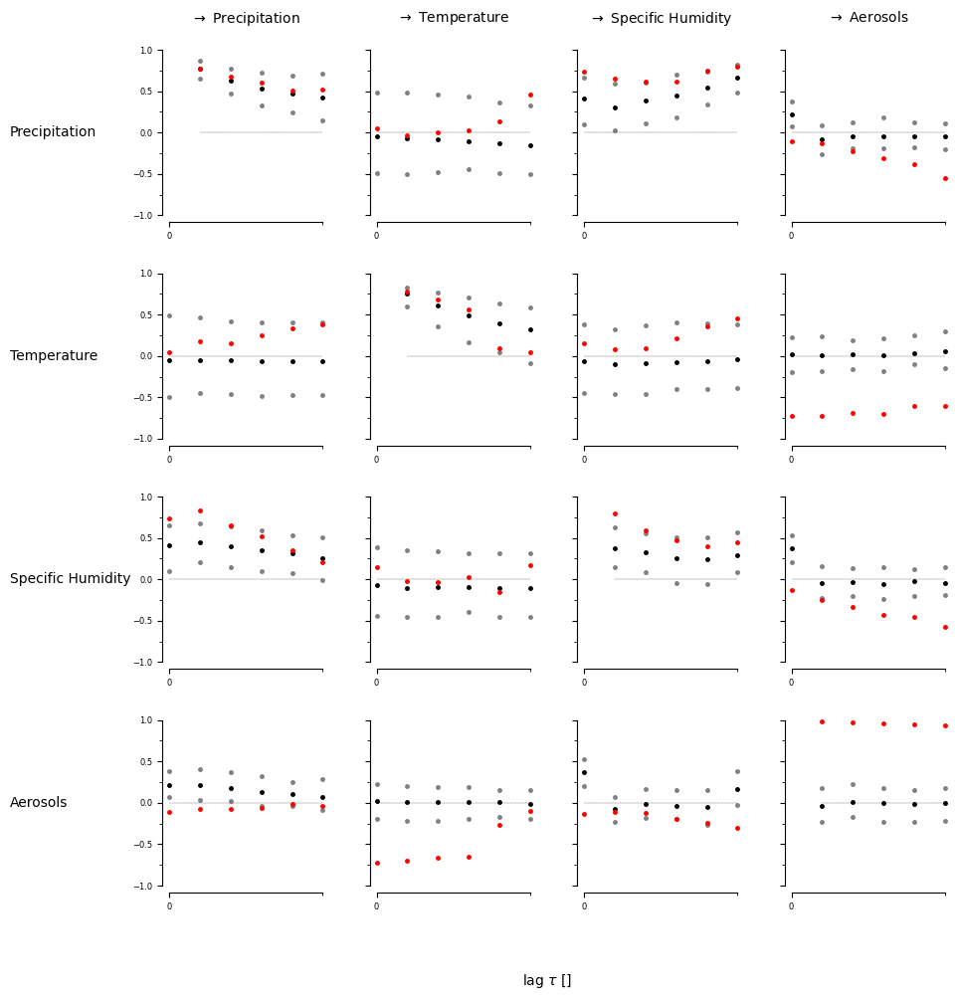

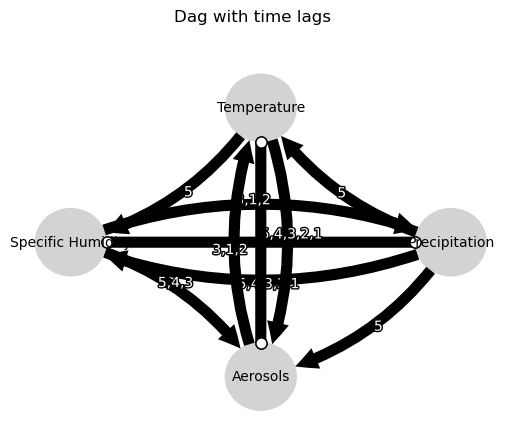

Negative precipitation values: 1080


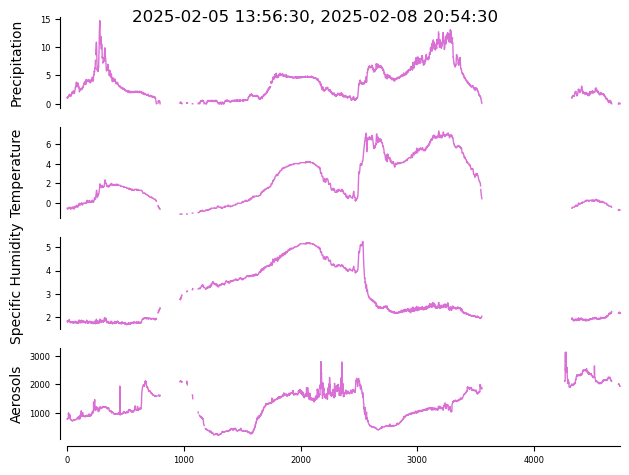

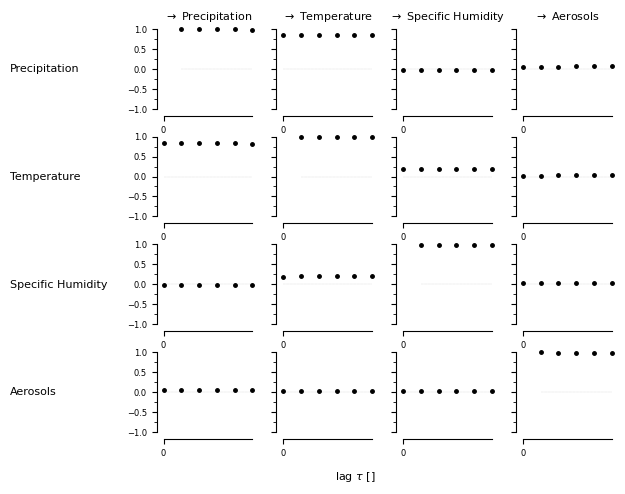

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


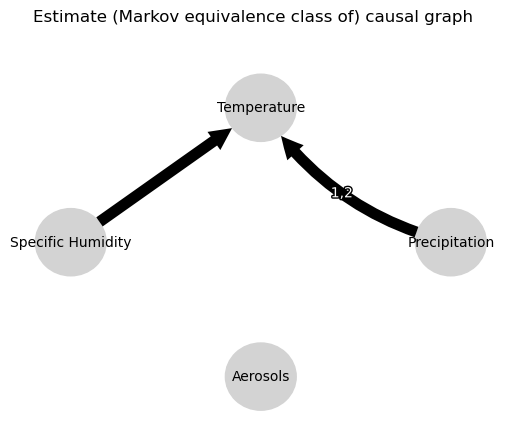

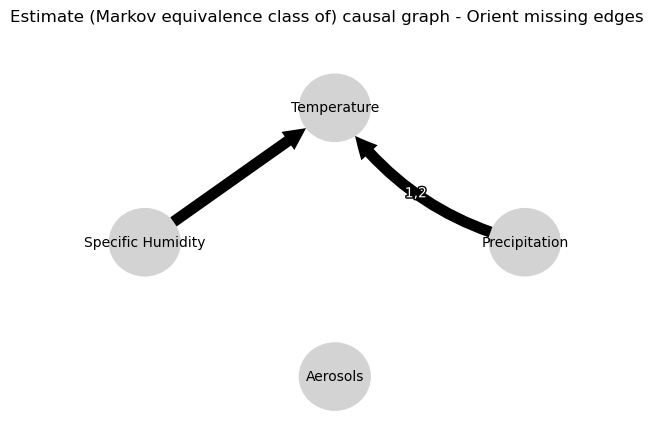

0.0
0.9952669972661792
0.9909819418251886
0.9868841875576001
0.9828700855360519
0.9789409946597972
0.7071388763595071
0.7097744201731708
0.7111160395294207
0.7118826513120214
0.7123679878105891
0.712714786098842
0.08332755394208027
0.08308881892659628
0.0828407297263253
0.08257373175361309
0.08228750590086817
0.0819904845152833
-0.032812071909516696
-0.0327322901502325
-0.032596905224508095
-0.03250456364628874
-0.032403385892358916
-0.03232217896436981
0.7071388763595071
0.7043011709760643
0.7015271372213816
0.6987889677963728
0.6960896625914361
0.6934137394477142
0.0
0.9987017605759605
0.9965906192319448
0.994166850246933
0.9916534842694215
0.9891443950736264
0.35038441316873564
0.3498008034335322
0.34918250331065315
0.3485345842071112
0.3478702274999712
0.3472046157952326
0.016534812495834
0.016529144522075895
0.016547158346494572
0.0165872075918638
0.016642720123577155
0.016693003586757404
0.35038441316873564
0.350447273193261
0.35021256495660696
0.3498317686283416
0.34938717003558

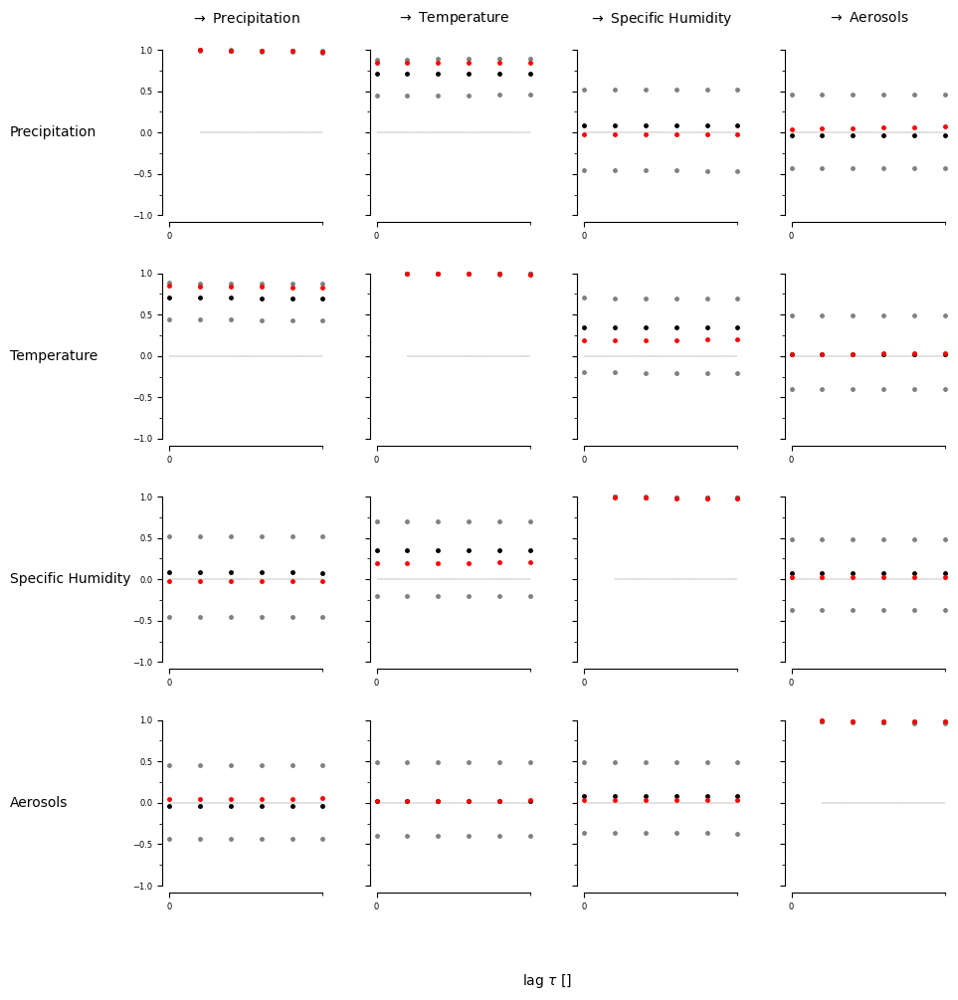

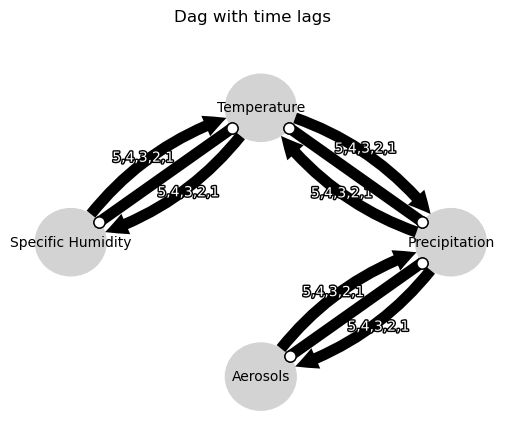

Negative precipitation values: 225


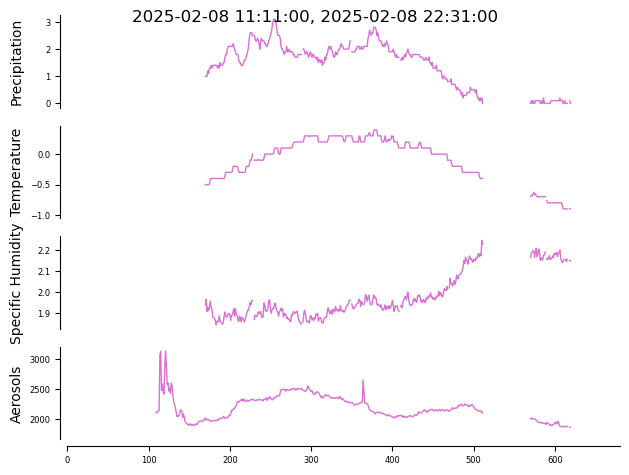

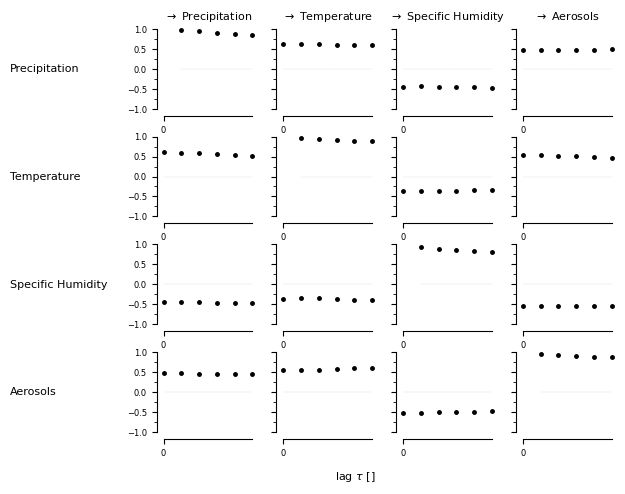

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


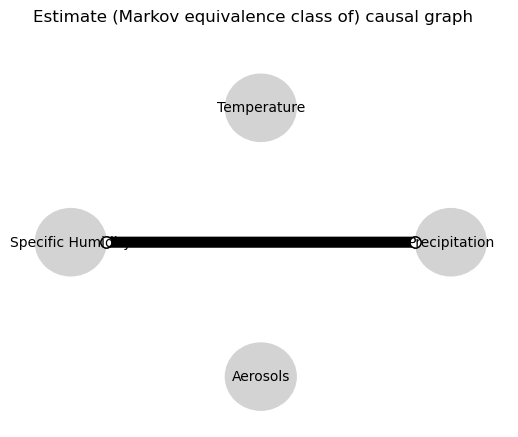

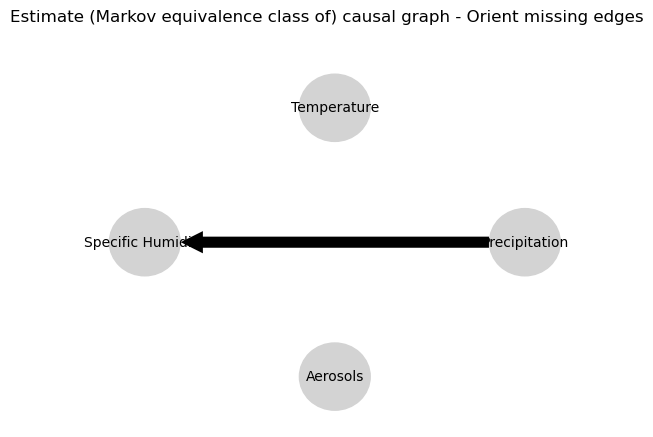

0.0
0.9775859510234519
0.9600329031720913
0.9446257040104356
0.9298016660584841
0.9156068043988383
0.03634009729672282
0.034763322467091406
0.033276819945710995
0.03199360399353481
0.030938023834408187
0.029775884167348242
-0.5225894775636136
-0.5341774388645133
-0.5446563283648466
-0.5545086333018974
-0.563613713399953
-0.5722408763835063
-0.062413161486775205
-0.05859793244012912
-0.056286766634138855
-0.05389747962595108
-0.05155504758426689
-0.048919377241996125
0.03634009729672282
0.03462186138887405
0.03260439723003952
0.03055628986131615
0.02905013407567845
0.027384520963186474
0.0
0.9781780421031708
0.961209972619676
0.9457603734724089
0.931681703344607
0.9185382855758338
0.1373088151625798
0.12748571129119599
0.11849484366638335
0.10982637974962019
0.10174349400689792
0.09439850384776277
0.04365252436432425
0.04244204735053495
0.04182108136849934
0.04150010784871095
0.04082362354414438
0.03989289998880486
0.1373088151625798
0.13566369530959077
0.13427017510964637
0.13362908035

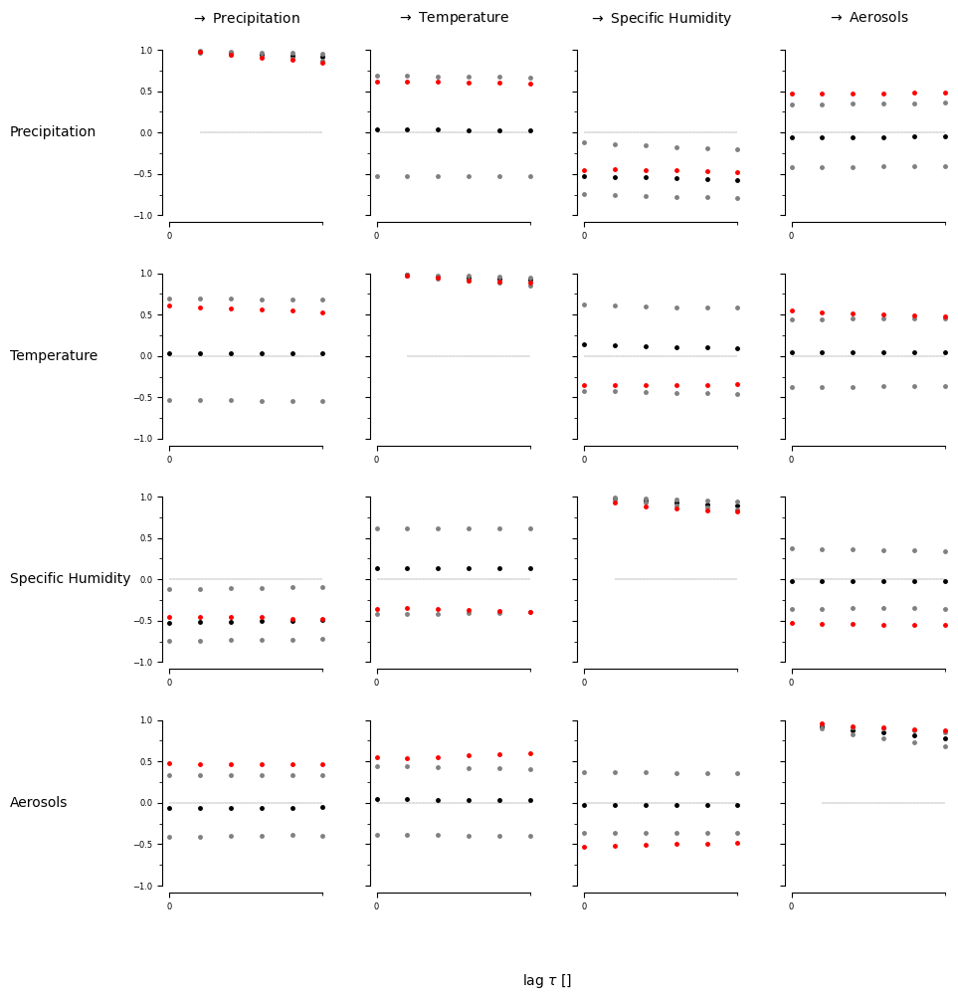

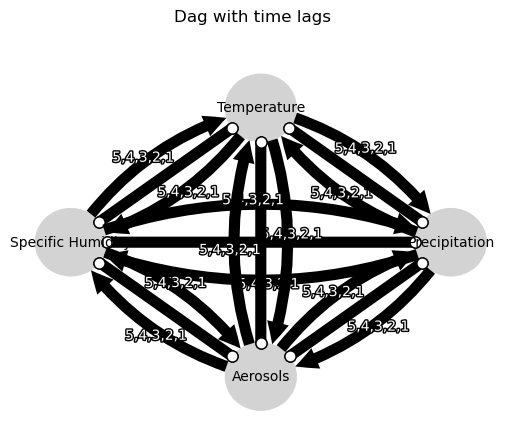

Negative precipitation values: 45


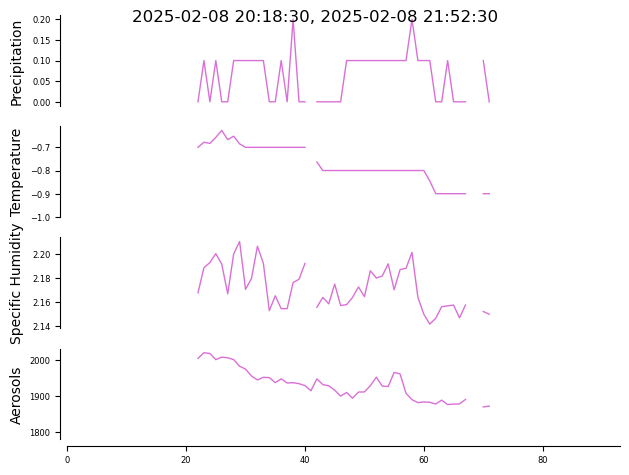

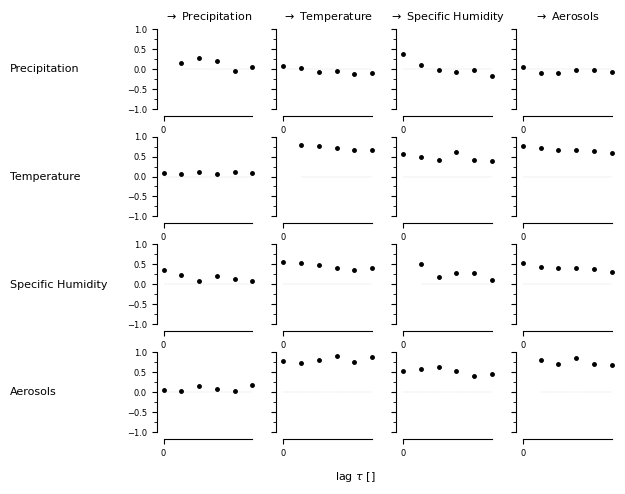

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


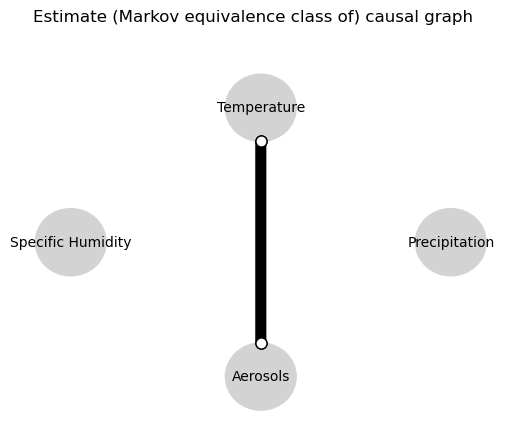

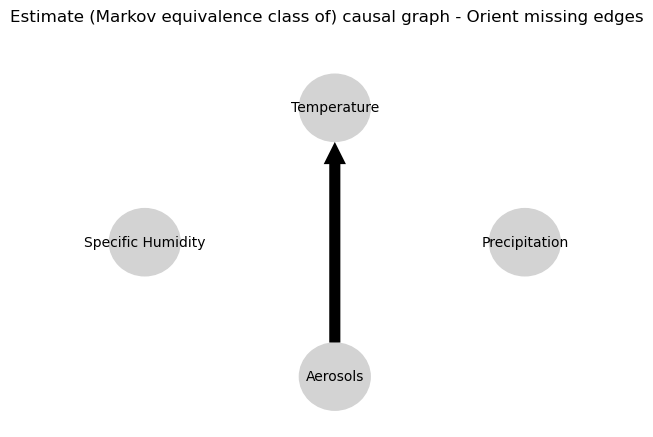

0.0
0.0029905728248404207
-0.0031129195558670954
0.018883524325969833
0.006605420551299799
-0.022583458444472532
0.10116548760705354
-0.02043237991010932
-0.041697188665158105
-0.02953481122536447
-0.04240225381405284
-0.01608120307256996
0.3948162302182318
0.009373368608273053
-0.011164217301560317
0.018430655574190737
-0.00773091310340322
0.025134310903937744
-0.020217789542185862
-0.015571944088466341
-0.02041907293383367
-0.015730190264771144
-0.03792663887643353
-0.03039522685476759
0.10116548760705354
0.0035874881554642285
0.005331600163893354
0.015418981104787852
0.004839204055601715
-0.005448064250268416
0.0
0.4518769396799267
0.3754865707094083
0.3295232137759562
0.29038600413179916
0.25906529382352306
0.06325677145407493
-0.016065284886524877
0.016436730673046893
-0.010566088897581876
-0.013044348826784824
-0.008086418979891773
0.6539447452565352
0.5511563129180285
0.4669796177324188
0.40917498342795994
0.3541969186299887
0.2934653641959285
0.06325677145407493
-0.015409910524

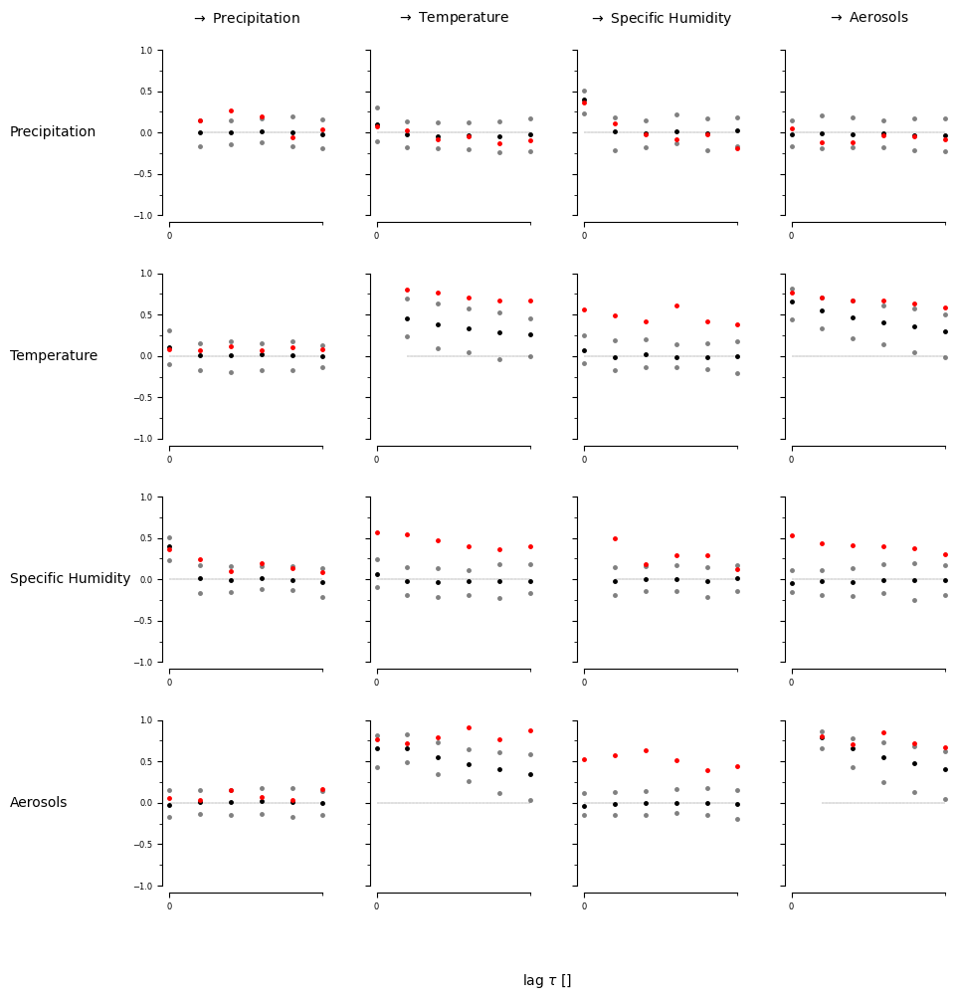

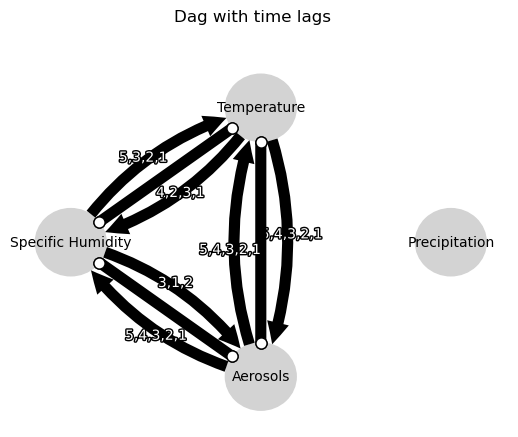

Negative precipitation values: 597


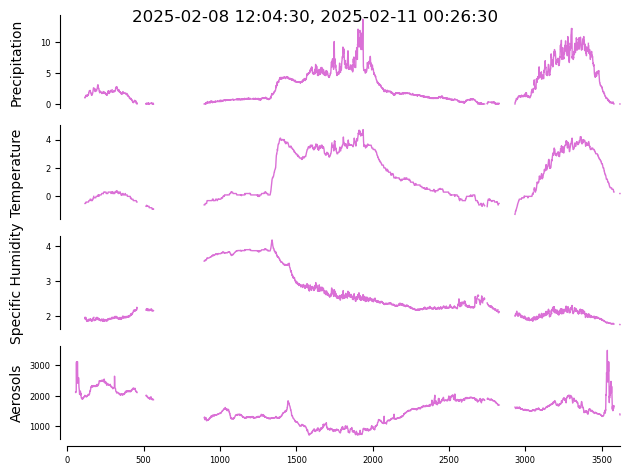

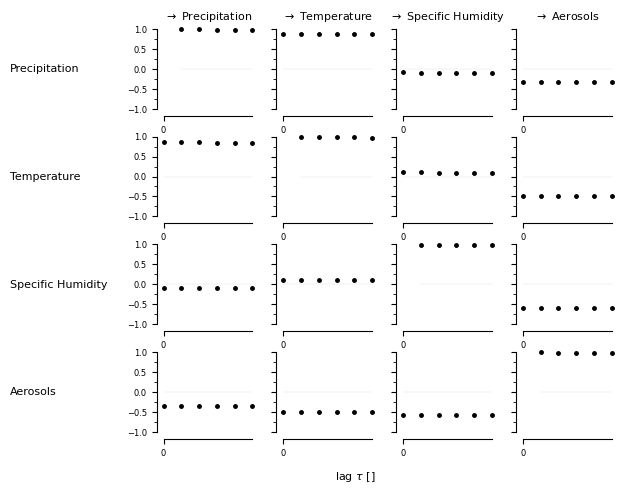

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


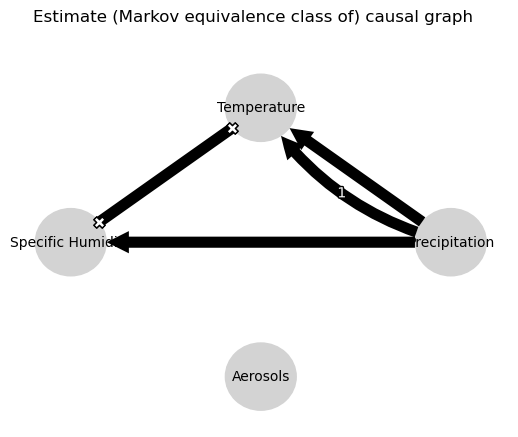

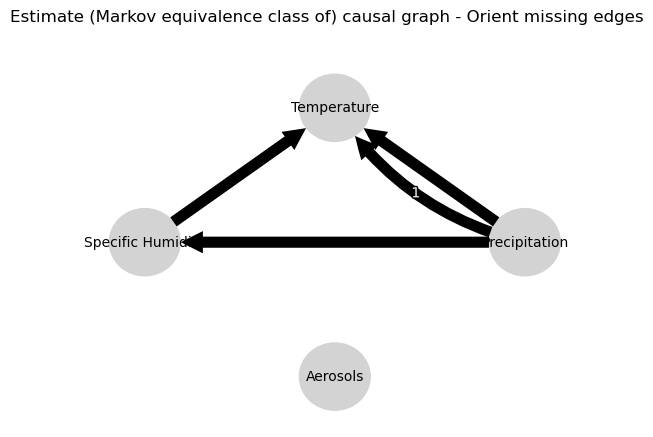

0.0
0.9909327607495898
0.9825115677985575
0.9743530678908741
0.9664133935607228
0.9586511509565614
0.785024360743063
0.7910260059257089
0.7966060435265249
0.8018854907316636
0.8068718050546999
0.8115672365405687
0.14521824646408196
0.14376232071779377
0.1425587785134495
0.14160622146207258
0.1408671227522613
0.1403257185589724
0.04920637474704547
0.04934048700661288
0.04942668488681849
0.04951041694458351
0.04961153001212189
0.04974322552749826
0.785024360743063
0.778383861016945
0.7718857624362271
0.7654686072919269
0.7590928660891099
0.7527978076213057
0.0
0.9982748690371566
0.9957294868013424
0.9928269495394609
0.9897941578524261
0.9866989882899311
0.3289099049450468
0.32668021455776314
0.32484294668696756
0.3232676753046481
0.3219076059030448
0.32068381212755137
0.05485703104563159
0.054970108677196795
0.05507987778759747
0.05514699584968872
0.05523405858996989
0.05532562335062487
0.3289099049450468
0.3292367077059911
0.3287861918607601
0.32802963733909984
0.3271572923038659
0.3262

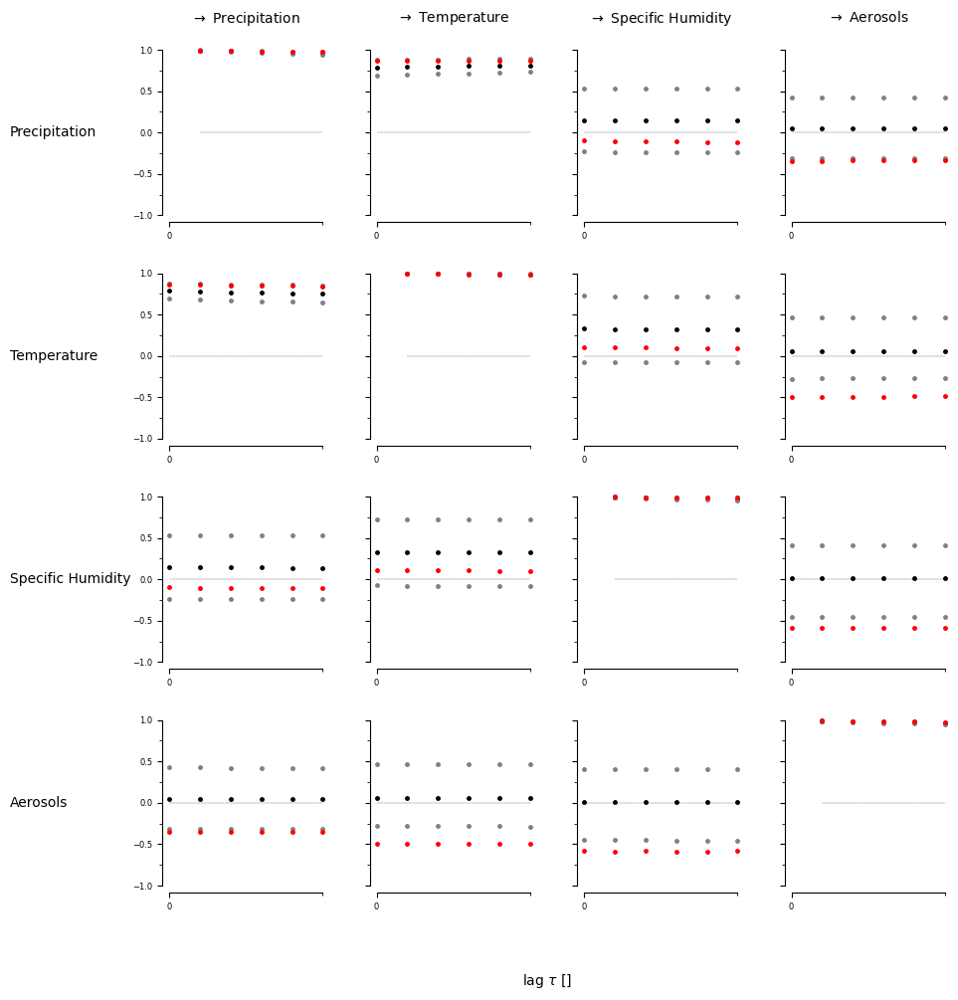

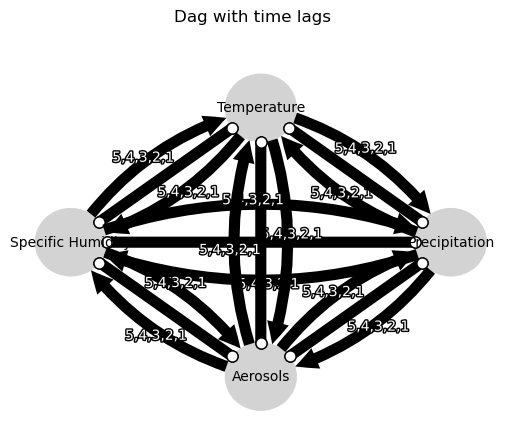

Negative precipitation values: 62


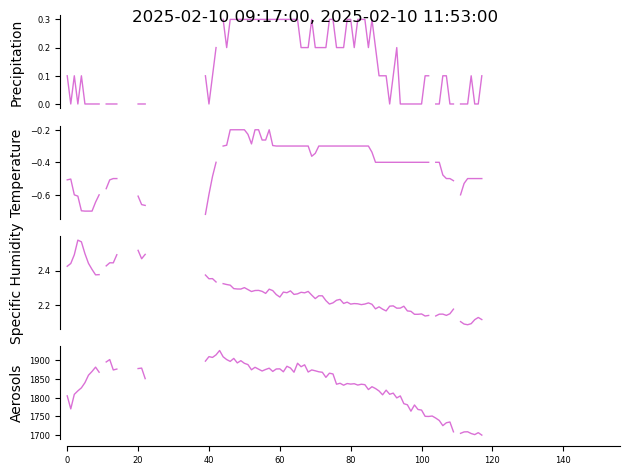

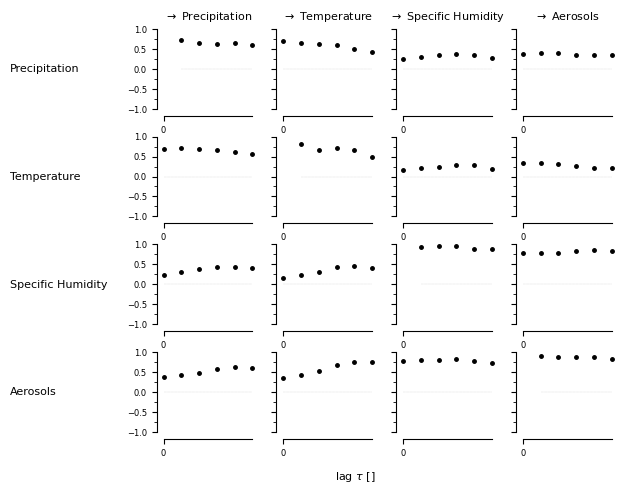

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


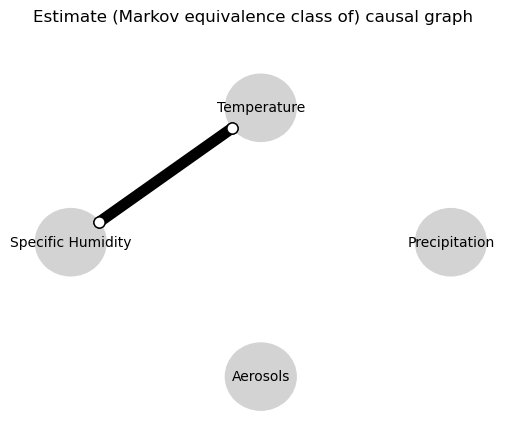

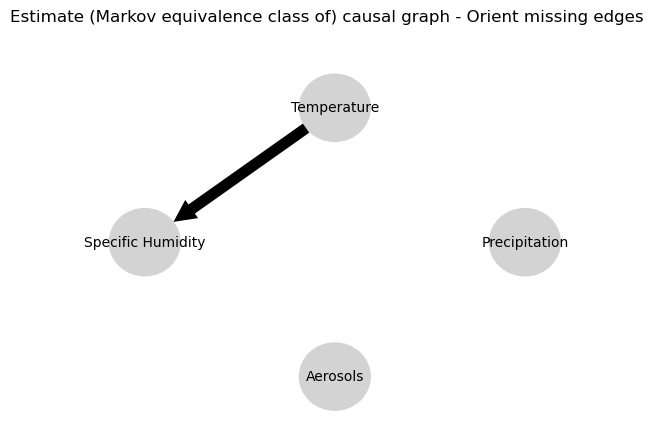

0.0
-0.0009553040276130553
-0.010403234092298206
-0.0018700029001242383
-0.0044654058451918345
0.005851546270121922
0.04477419243177758
0.04325702912018087
0.041248176881105963
0.03855790054978093
0.029787114225534945
0.03188153061728688
-0.04575465000884878
-0.041466988648752326
-0.02558258219128345
-0.02713086288021678
-0.019022787527410948
-0.019953245255864345
0.49930952617081786
0.001133489269570095
-0.0009930017711890218
0.0024836336401569893
-0.018700236083544257
-0.0040247092264756685
0.04477419243177758
-0.014157918407997397
-0.014700065980921021
-0.010791622796486917
-0.0033741921582284614
-0.0009627752329015894
0.0
0.842665289160832
0.7320873511360064
0.6394612468227048
0.5593851035794761
0.49114267075001583
0.2969676191722199
0.304461968631851
0.30859098379598665
0.3060518940673501
0.3008055513744278
0.29592624606035844
0.11906785232384019
-0.02994870582102129
-0.023538042429943905
-0.023575311966479506
-0.014331323540994373
-0.0032754971319956584
0.2969676191722199
0.25092

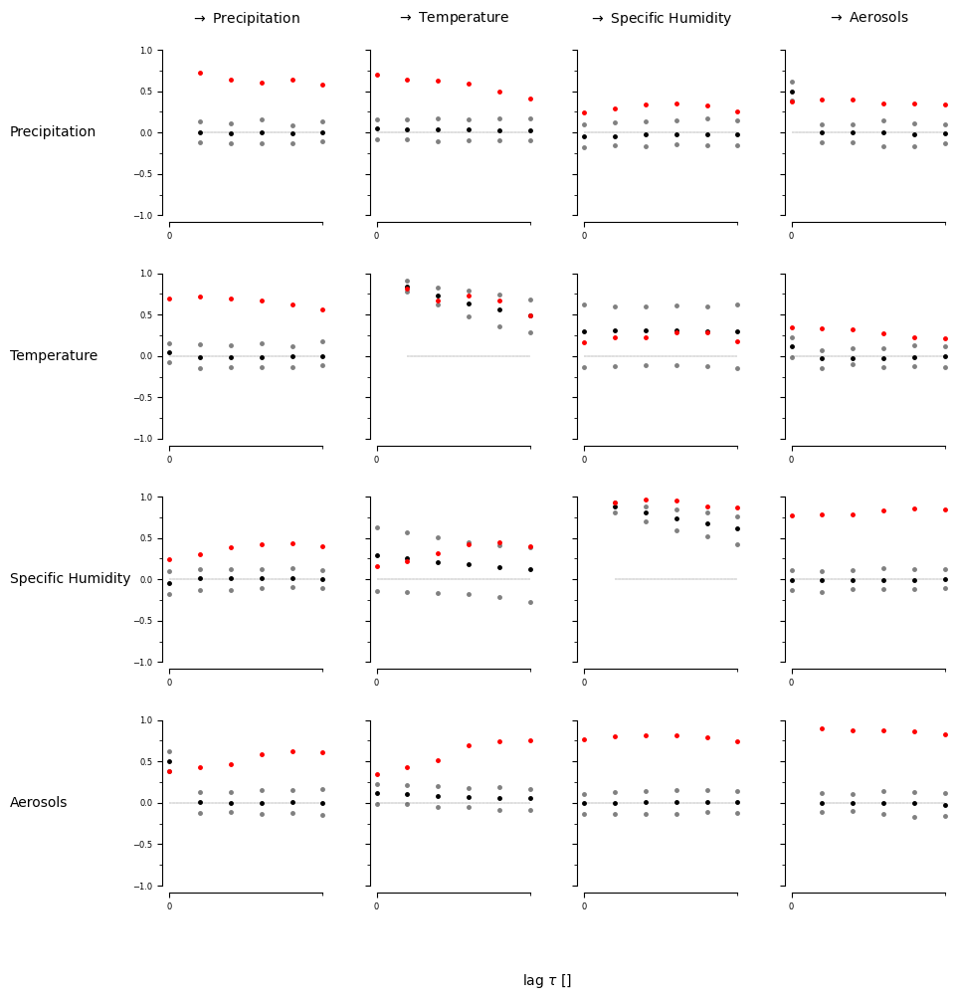

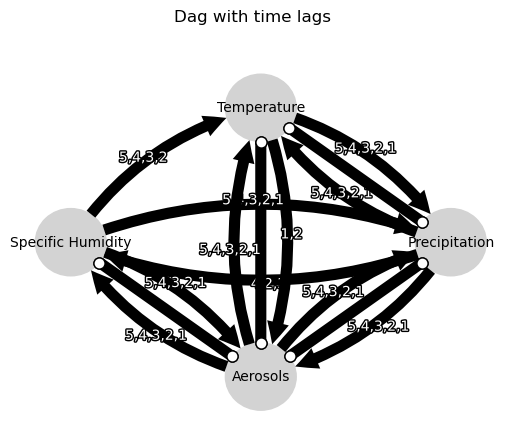

Negative precipitation values: 320


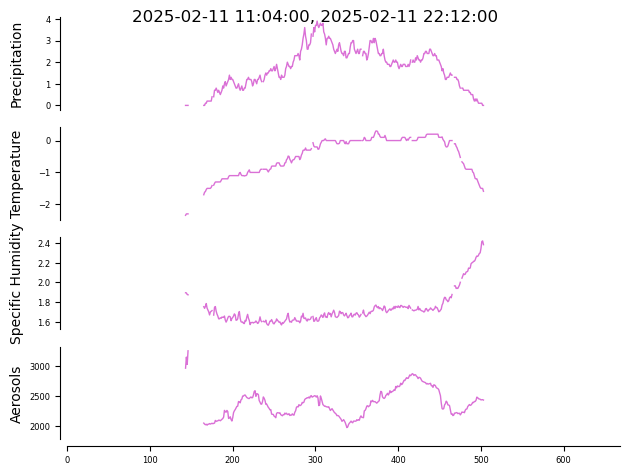

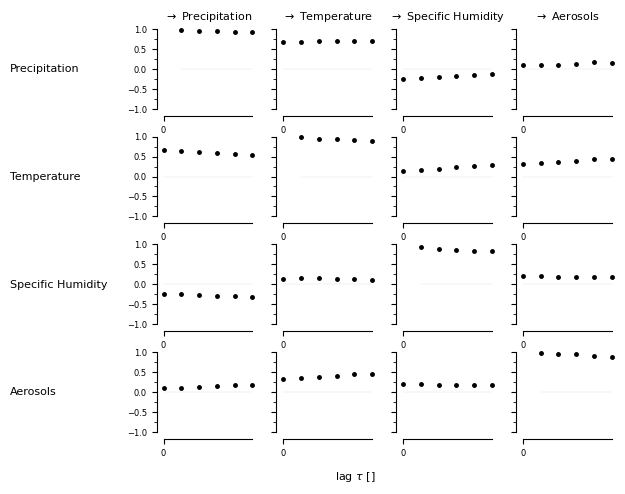

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


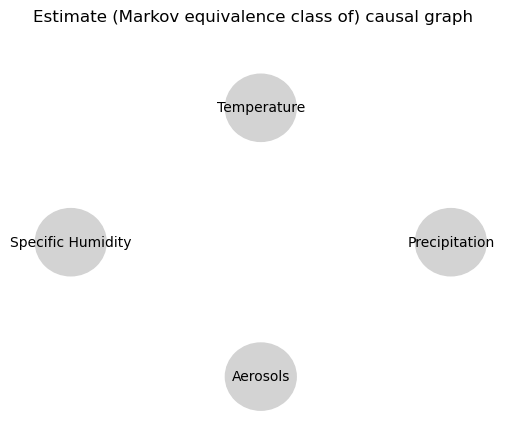

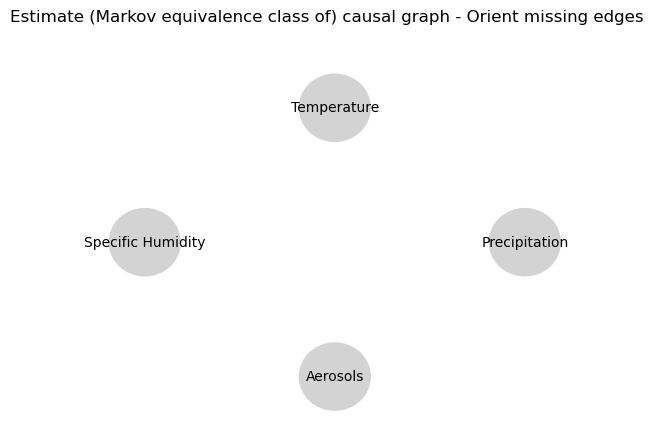

0.0
0.9719360918699981
0.9494978696037185
0.9290533981832303
0.9095923995784861
0.890315926271239
0.06989717289263318
0.07017405714852658
0.06951202238541138
0.0682432448184708
0.06734063818373075
0.06651551299820907
-0.03366459671764085
-0.03334353867097667
-0.0330291208185902
-0.03298408993930471
-0.032551138056232276
-0.032170210900786846
0.0613465682195398
0.06093785198825902
0.06095434435737184
0.06069924032241042
0.06070035726452341
0.060132912053330975
0.06989717289263318
0.06743413581422214
0.06508647278498168
0.06301462524667678
0.06119347907709569
0.0593531511568107
0.0
0.9865697764147937
0.9713125621938475
0.9555182399703945
0.9404638372473779
0.9264122554626997
-0.0875231381412598
-0.08736112027039963
-0.08752613317470496
-0.08788396948019937
-0.08831104898918785
-0.08873335352744631
0.023530979603039216
0.0229994290275586
0.02205046034592212
0.021089091166296762
0.02049372194646031
0.019973034390631673
-0.0875231381412598
-0.08767379744403922
-0.08787659014723422
-0.088173

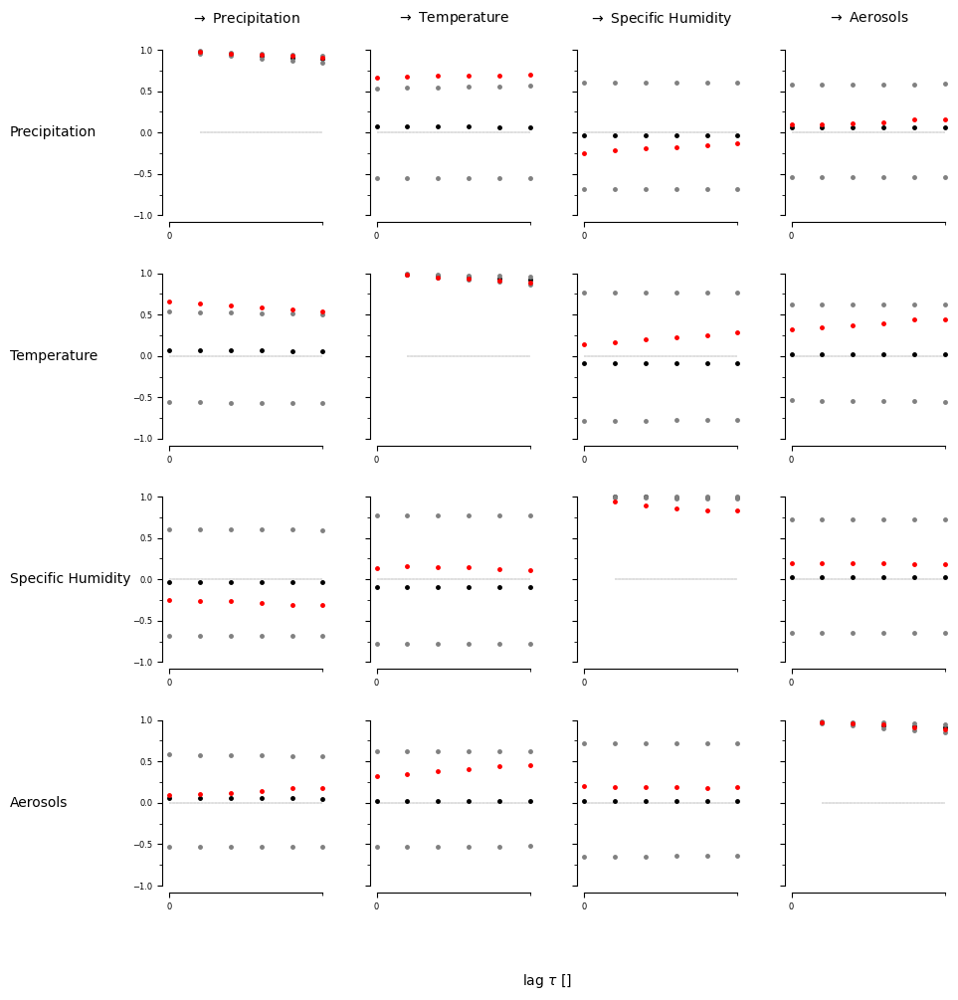

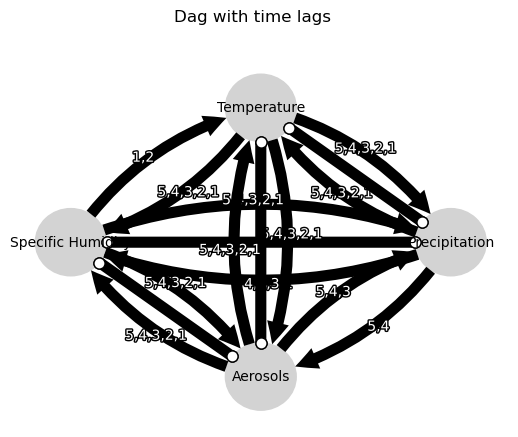

Negative precipitation values: 1867


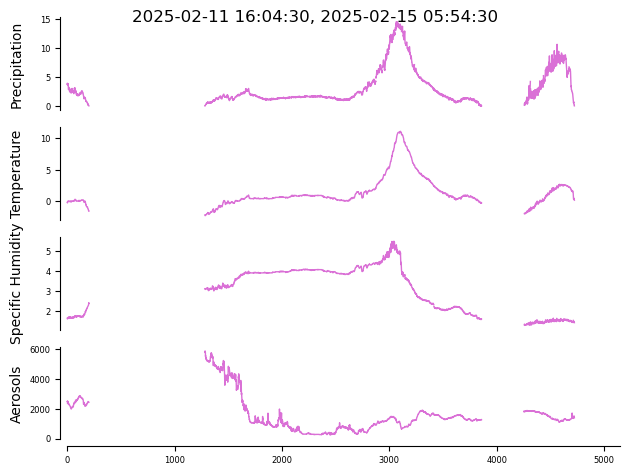

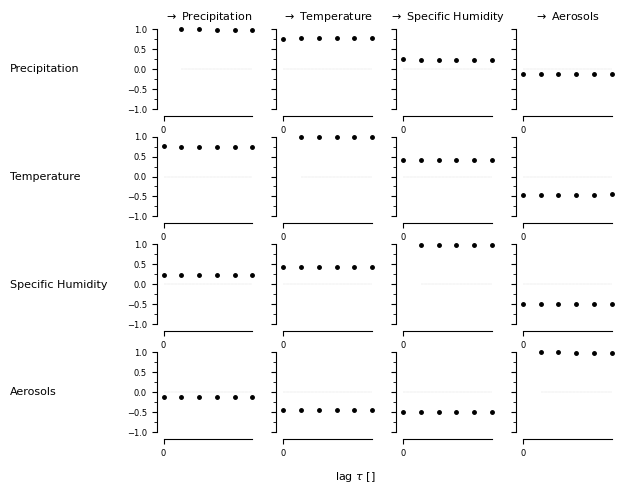

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


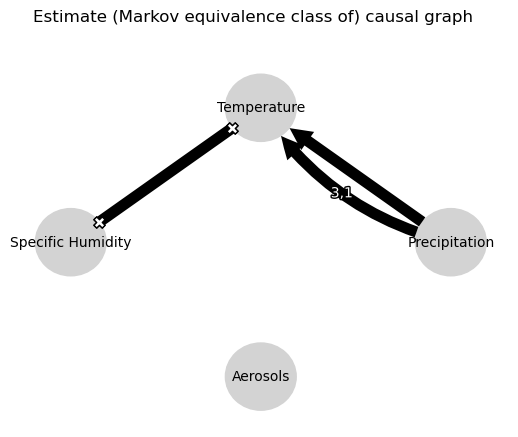

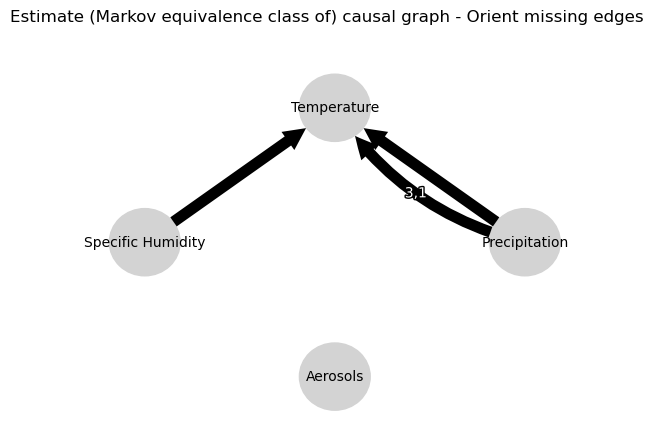

0.0
0.9945741550095134
0.9881897532446652
0.9826450015630495
0.9780740399852923
0.9737202334953606
0.8368763174990839
0.840999895939807
0.8440610524713434
0.845852724606191
0.8472044357630898
0.8484021888435884
0.06528092100482295
0.06507411007598808
0.0649993159555755
0.06499199473341029
0.06494862806011172
0.06493011397224199
0.04182416093322179
0.04170497642360911
0.04157413649029294
0.041486588512606816
0.041423222595036134
0.04134011460611336
0.8368763174990839
0.8327003768702429
0.8287476153233095
0.8249525508585243
0.8212155299365849
0.8174850552449939
0.0
0.9987748914799538
0.9972424899837624
0.9954187746792136
0.9935762171367002
0.9917323533292068
0.2846824434163918
0.2839301779081443
0.28333275162900073
0.2828369100704634
0.2823146248594849
0.28179941985005585
0.027328358387053688
0.02714269674173378
0.02695515222371853
0.026781369739382943
0.02659560976786076
0.02640742984682702
0.2846824434163918
0.2846579903148933
0.28447627881050047
0.28411365763418883
0.2836850889754158


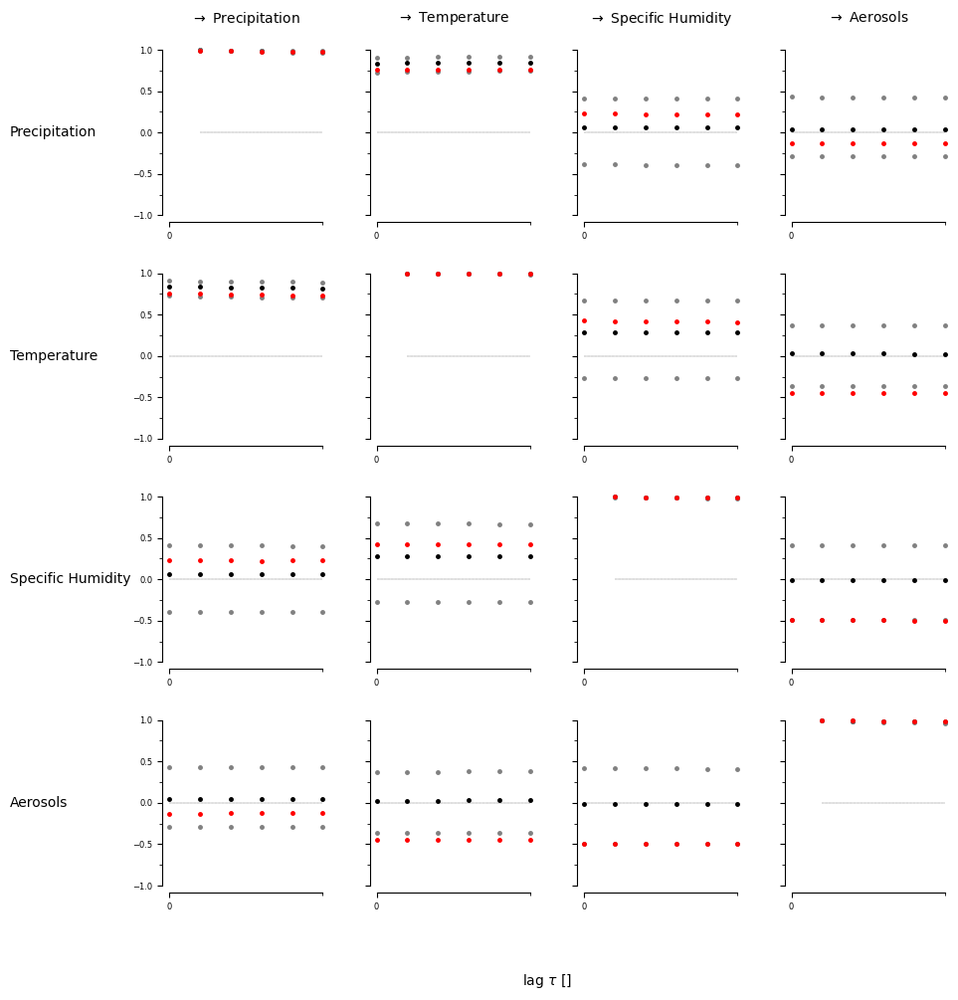

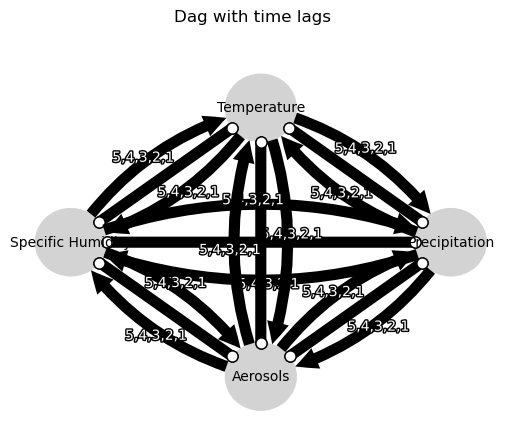

Negative precipitation values: 452


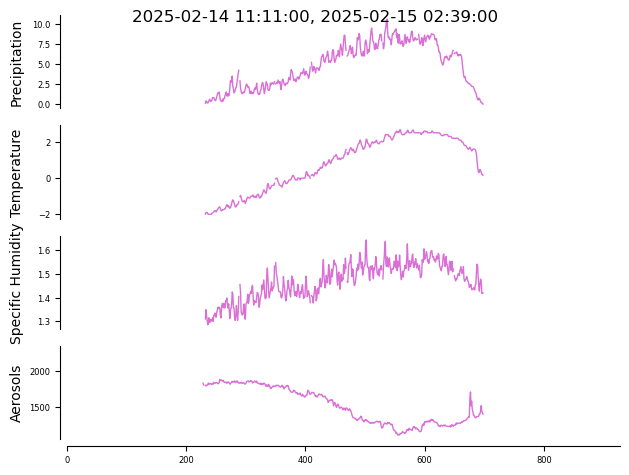

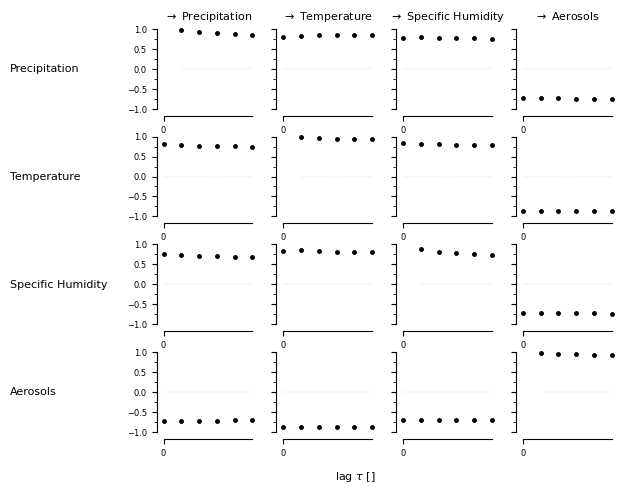

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


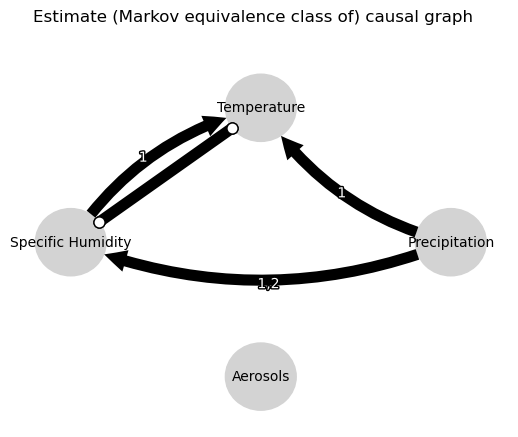

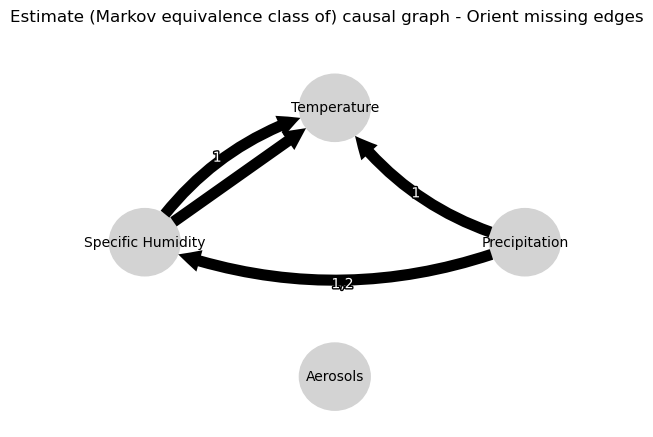

0.0
0.9757802818392252
0.955512433840921
0.9363888121191478
0.9181594890733001
0.900478627389086
0.8349757864179947
0.8523531788953538
0.8650806665586646
0.8760682178662985
0.8847824177906637
0.8914365371742901
0.7853448095094636
0.7979094863357413
0.7819079650686613
0.7675367438321646
0.75342277529671
0.7393753900878468
-0.0017117645018559669
0.00012004785494055148
0.0018831126382494235
0.003526307953720712
0.0053268287428723405
0.006639496604686017
0.8349757864179947
0.8182804583160787
0.8021018117425507
0.7865309689493352
0.7713725437535577
0.7567478432898644
0.0
0.9922371247843774
0.9857306038461314
0.9782857716424564
0.9702366392315988
0.9614955996025987
0.7569653827506504
0.7272457248179429
0.7018311572333491
0.6796189392308457
0.6601398358282624
0.6425793320425888
0.02940603263263851
0.030033135105524796
0.030628142184269003
0.031436227380526024
0.0322160352828938
0.03280018269276394
0.7569653827506504
0.7720327703214853
0.7837157424876914
0.7920644042194729
0.797702408174398
0.

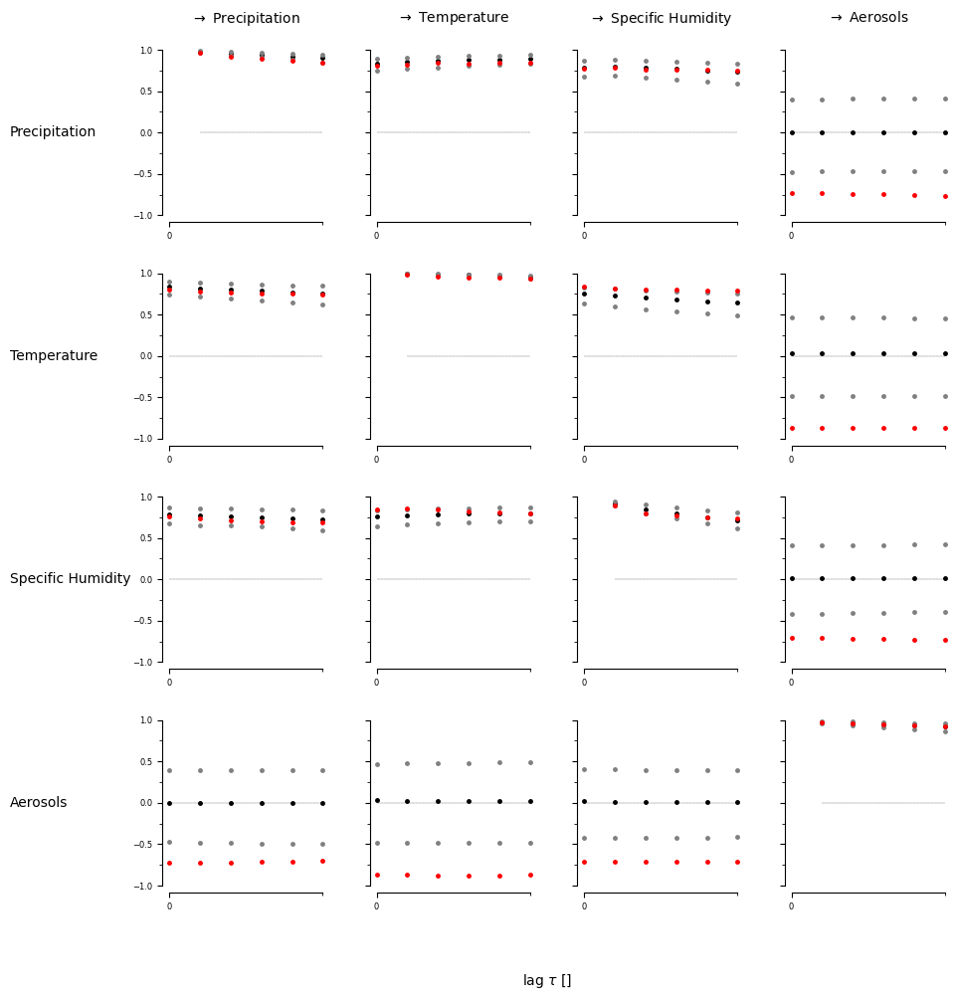

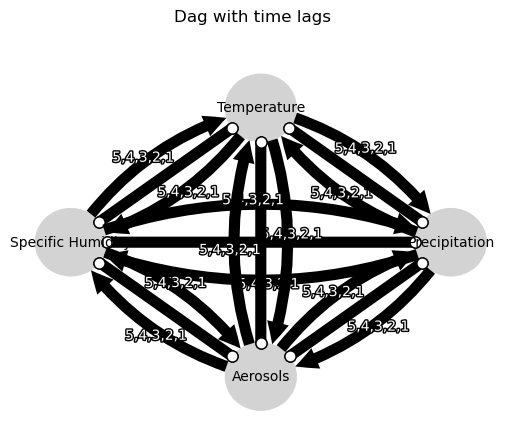

Negative precipitation values: 25


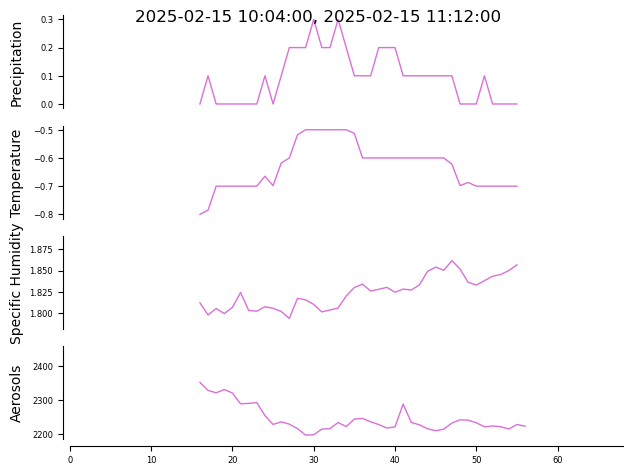

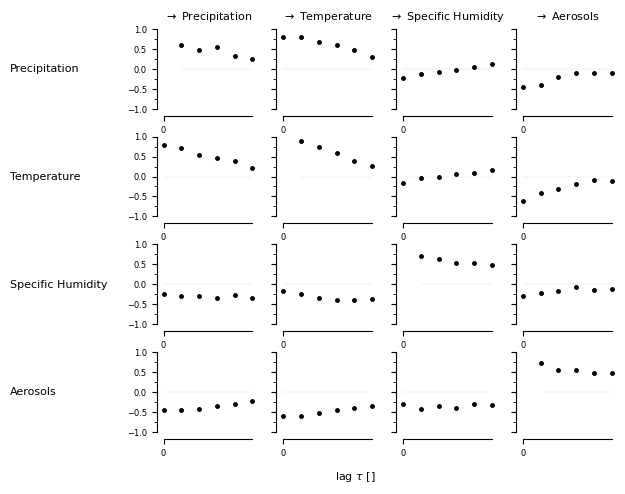

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


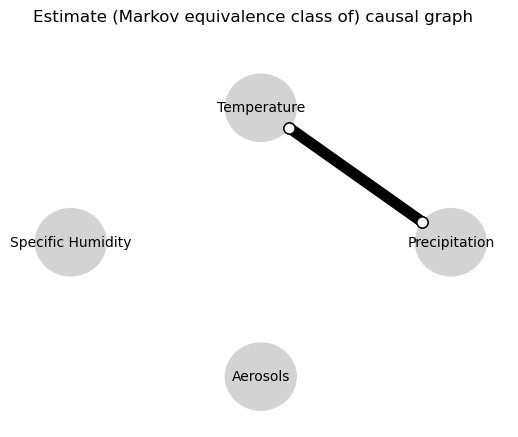

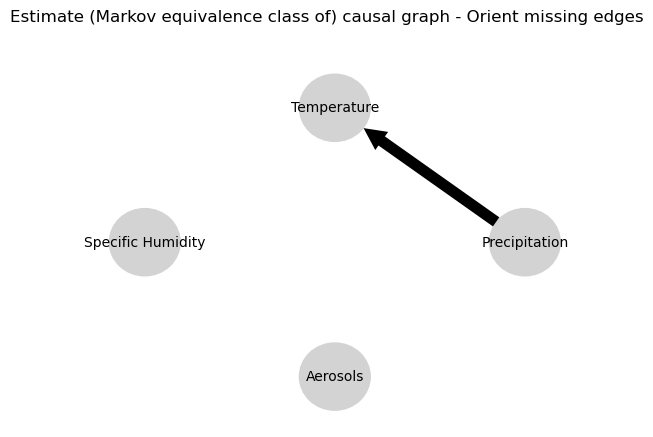

0.0
-0.0033154846395592984
-0.03621987239587776
-0.000499220895150494
-0.01664042573268049
-0.011344163384073774
0.7943200240246879
-0.004278312214326649
-0.0020105938042108583
-0.0007197923721726267
0.000763431579986959
-0.003452396142438078
-0.01255923185813042
-0.0037743845545484345
0.011530375664451203
0.0007729101042402742
-0.02165597421628929
-0.0014088847980310271
-0.08132627465608086
-0.08218057513021963
-0.023575362616983692
-0.022410293801916628
0.015281903212053017
0.006725893799850121
0.7943200240246879
0.010256948920388349
-0.032452875756517285
-0.016054718940922502
-0.016029568116969775
-0.0016444260274673544
0.0
0.012770079023884884
-0.0029710600985264346
-0.021737541819310213
-0.013794691441015828
0.004384909207862962
0.0588688551988147
0.05321157726785678
0.04161256786306899
0.03503752671405902
0.00857010184143962
0.020084311087710534
-0.02254135750293313
-0.02884082850838533
0.006861879633438681
0.004721546300662056
0.02798532055391
0.027695801941982373
0.058868855198

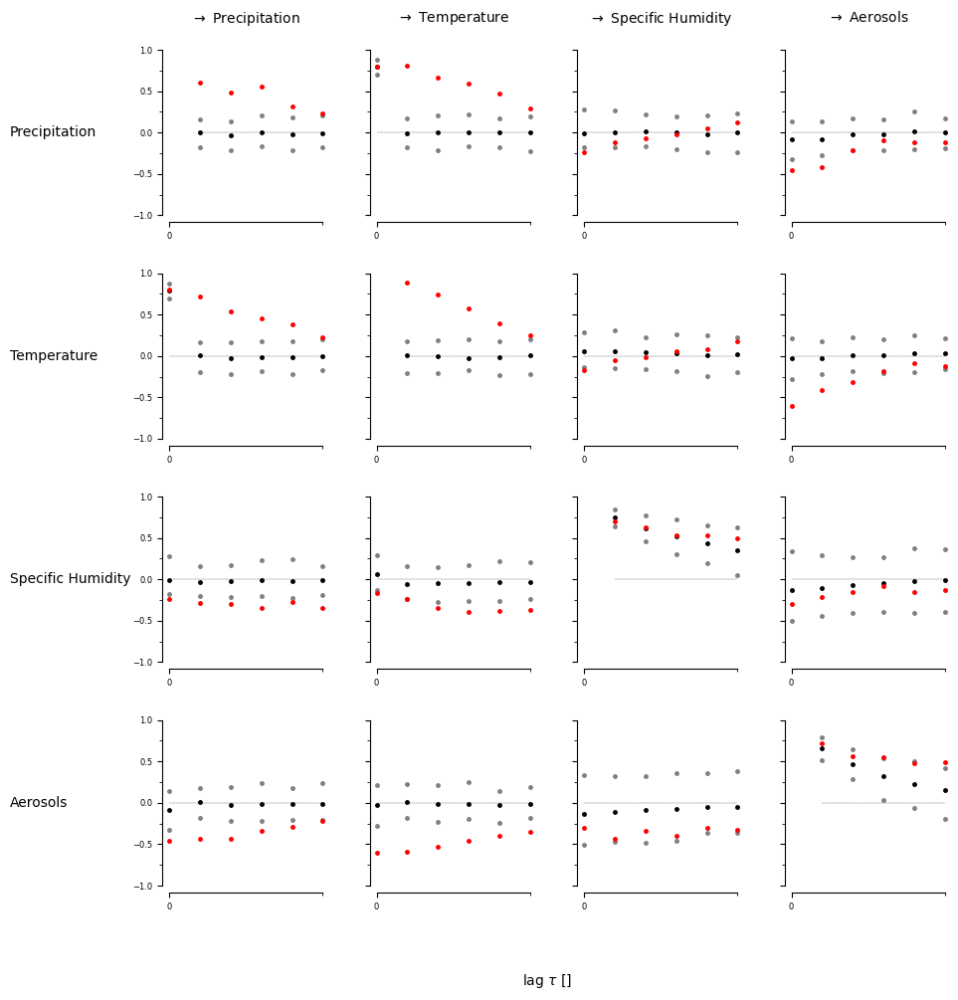

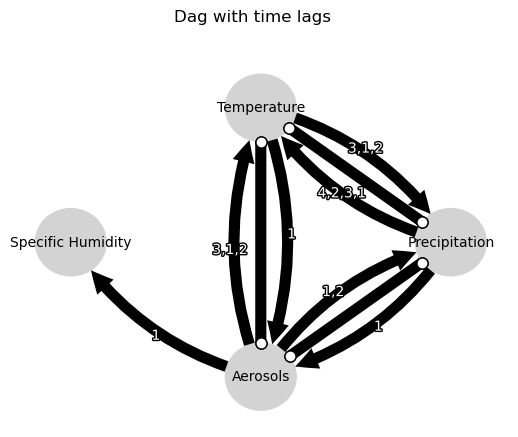

Negative precipitation values: 1479


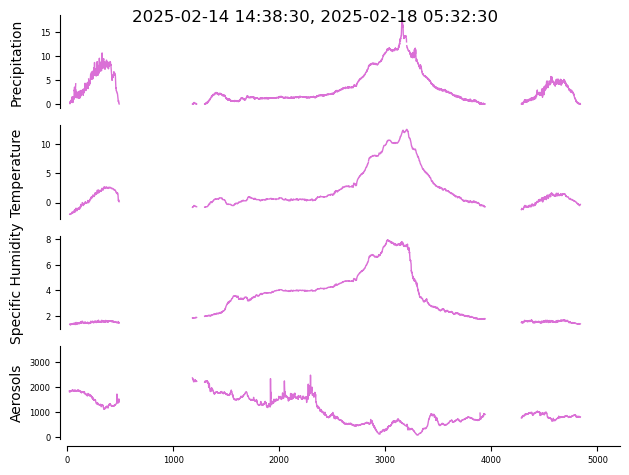

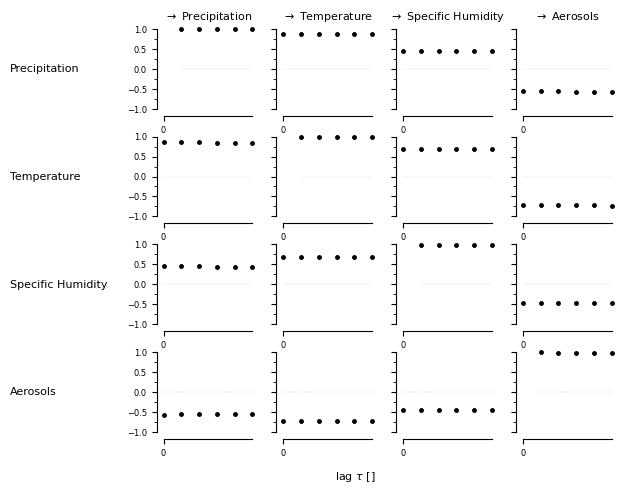

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


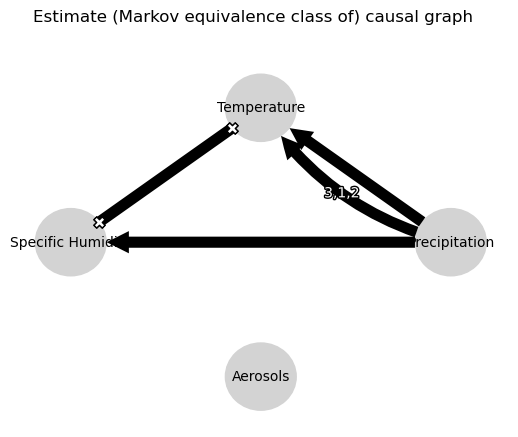

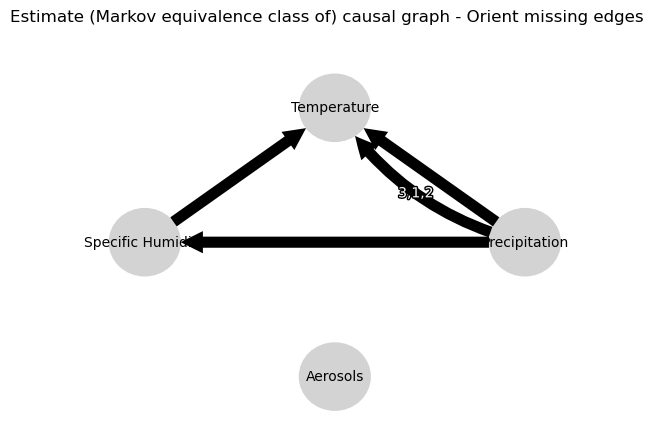

0.0
0.9964671529343705
0.9924298460676988
0.9884489860802212
0.9845211311954449
0.9806574166679545
0.3839211683609265
0.3852450262058056
0.38596423751728204
0.38625015536402807
0.38641387446303843
0.3865714150485778
0.12620233609064174
0.125939210167462
0.12570756992684384
0.1254817141206361
0.12525665682014864
0.1250263338656763
0.04975396240962196
0.04961033260730581
0.04947126510963899
0.049365846046102384
0.049272699654942985
0.049175975304515604
0.3839211683609265
0.3826420314021371
0.3813635223736734
0.3800982524265846
0.3788468540676638
0.3776286950802696
0.0
0.9993248375976123
0.9984536004079715
0.997597040722985
0.9968488355082986
0.9961572986120133
0.8615197507777609
0.8611417742303208
0.86079218150223
0.8604352869437645
0.8600592979920115
0.8597170998337137
-0.019479715193052676
-0.01947446161260157
-0.019473367038116394
-0.019479158169245232
-0.019502752715375174
-0.01951737420951448
0.8615197507777609
0.8617057820988291
0.8618470563460963
0.8619827928059681
0.8621265596053

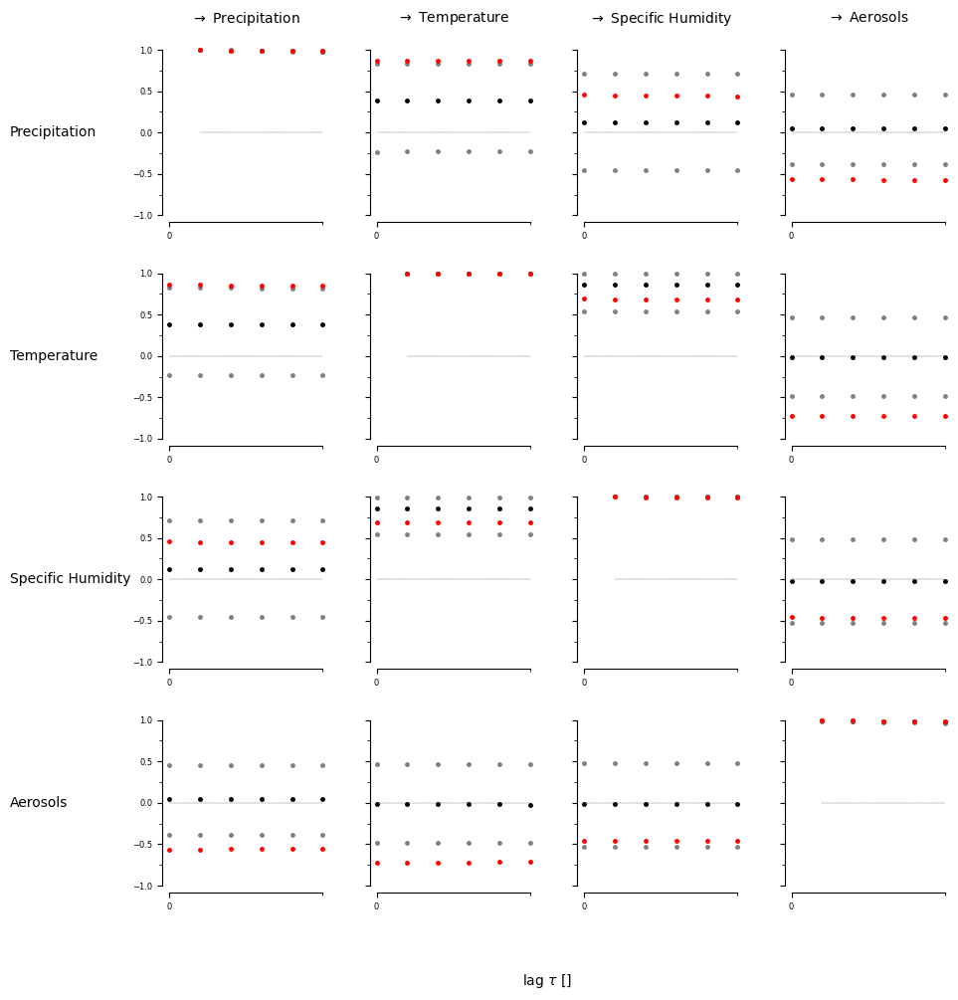

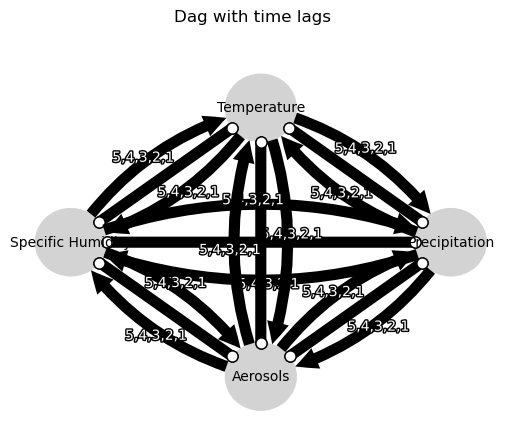

Negative precipitation values: 513


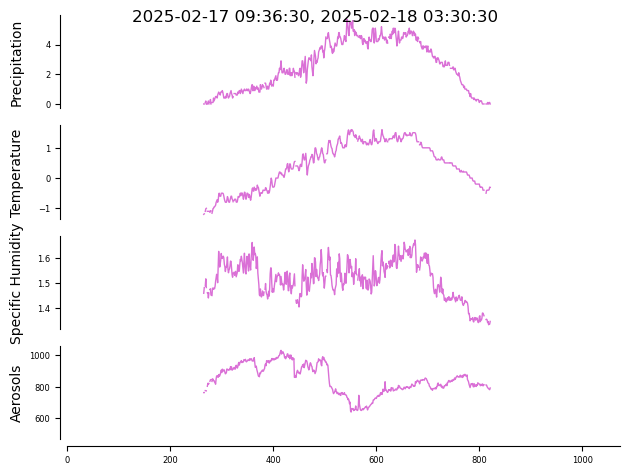

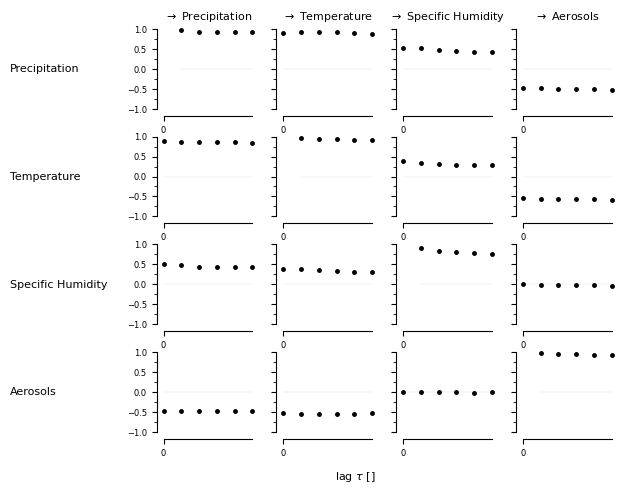

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


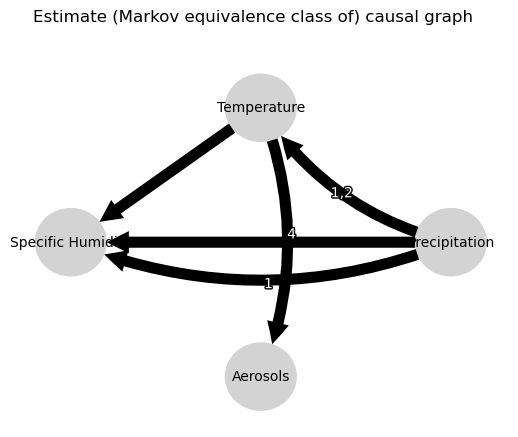

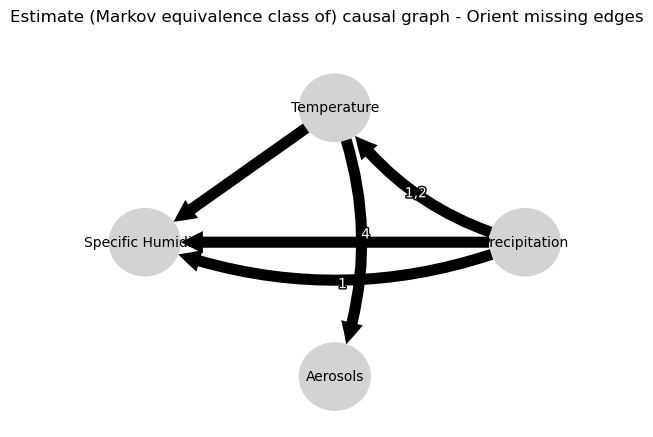

0.0
0.9640733281403719
0.9389086782457834
0.9222313057061586
0.9132214587980743
0.911690741167032
0.9087119379714518
0.9255430898548758
0.9143201115203492
0.9056237964092111
0.8993890244516622
0.8955859562788088
0.5739865900339591
0.5567570117655052
0.5416840089400106
0.5298467864236424
0.5228795889602079
0.5178456190095215
-0.48519543681181654
-0.48892845505974186
-0.49284056179433333
-0.4964196205068548
-0.5003809774182912
-0.5044033686632227
0.9087119379714518
0.890655926056823
0.8774076886907785
0.8683811628914221
0.8635026420762131
0.8568345481695182
0.0
0.9809698882500646
0.963668032085647
0.9490291449537339
0.9368883874734726
0.9267839398684566
0.5511963242269714
0.5170865470010972
0.4899299224611448
0.46955391153281506
0.45377662185225043
0.4379522228865029
-0.524545425996757
-0.5277269156056869
-0.531034917328589
-0.5347361259894209
-0.538442898530058
-0.5421098248627831
0.5511963242269714
0.55833655335057
0.5515620088551176
0.5463512528552336
0.5428690882088997
0.540747519964

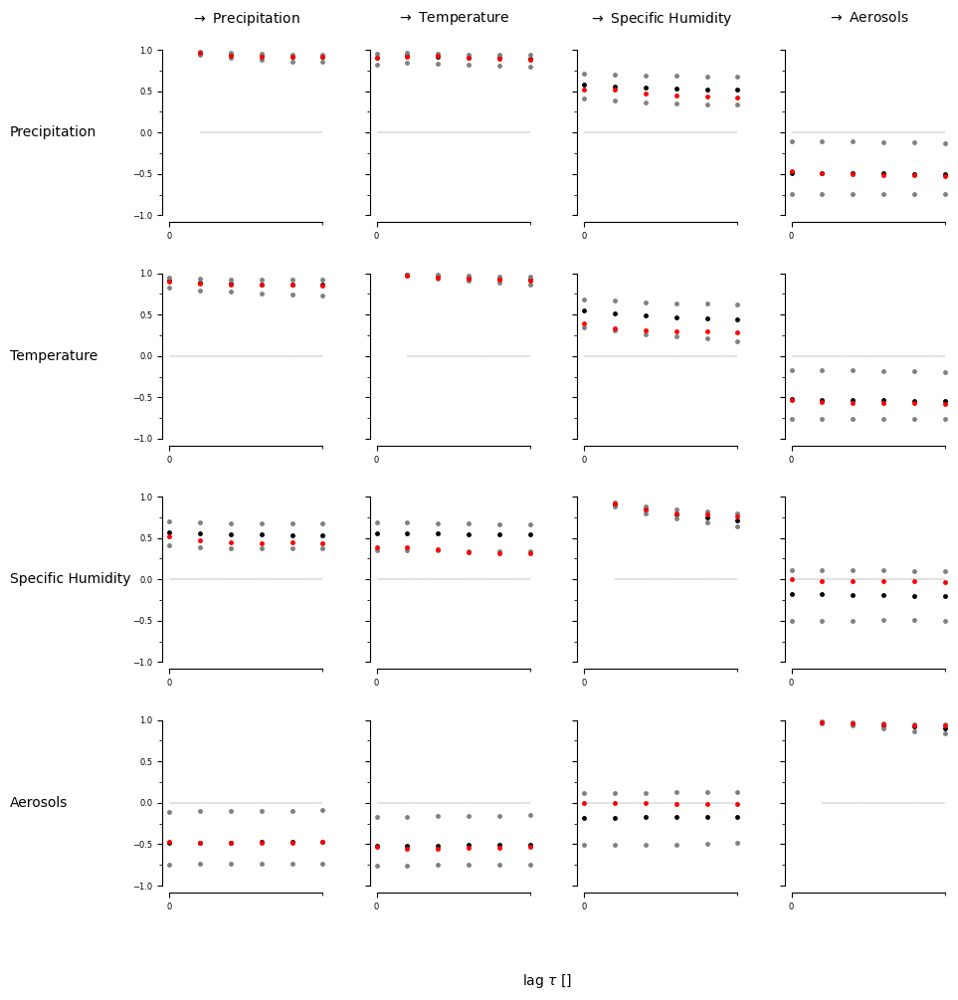

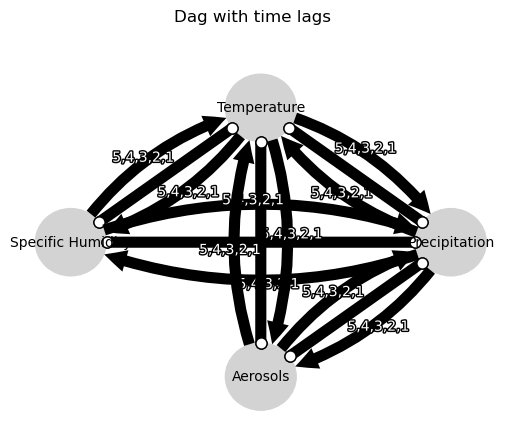

Negative precipitation values: 118


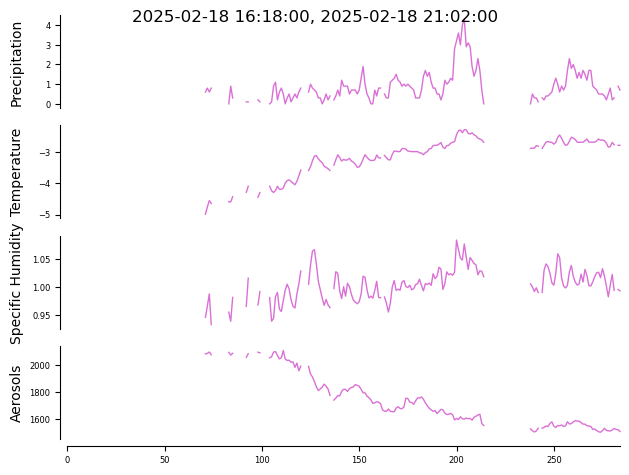

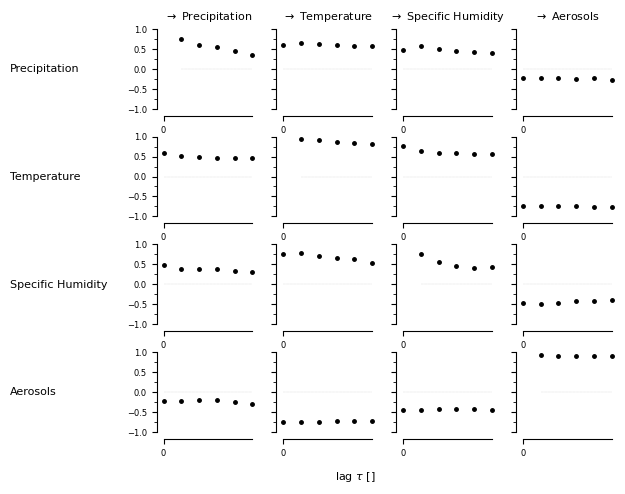

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


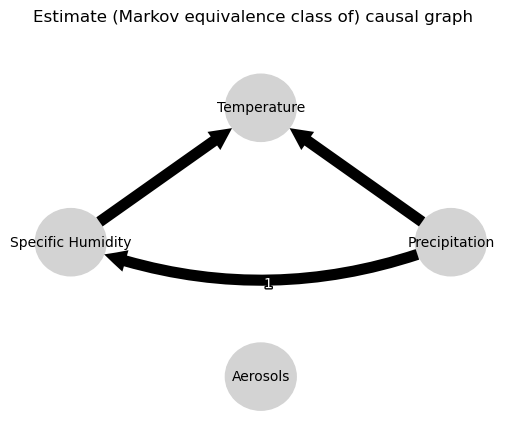

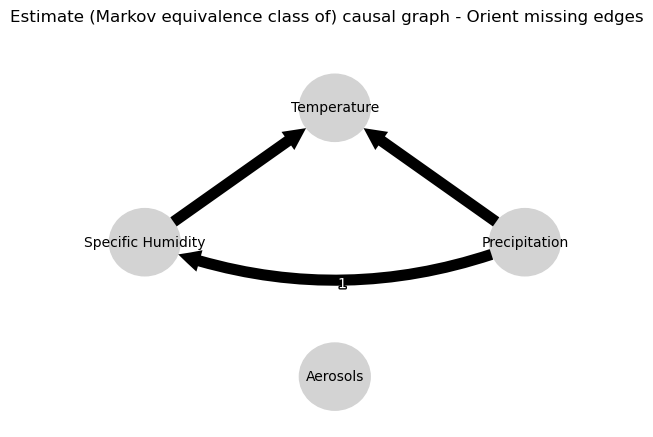

0.0
0.8283121394512437
0.6959069375757513
0.585126403180044
0.490447312046347
0.4081844258627452
0.3016425248391015
0.3716522303066779
0.43725508562081694
0.4878604410639148
0.5223309539900032
0.5426820008782394
0.4672745644842037
0.5504767222501172
0.5629746056840195
0.539773324316305
0.4936132679572499
0.4432729660067679
-0.03267749967648981
-0.03280690120302163
-0.03171610656722807
-0.029673706385179105
-0.024481784472657604
-0.022210533689342574
0.3016425248391015
0.24616530350024457
0.1997368145001697
0.16022914440207786
0.12623579467005486
0.09865059086204084
0.0
0.9484316549275634
0.8865108537454236
0.8173199137679952
0.7453202906000936
0.6738427084970868
0.6541102272570294
0.47775478809881605
0.3573859492701979
0.27407034983571504
0.21262957752292722
0.1683939747640877
-0.03349720063193069
-0.0356402172181904
-0.03891843056105417
-0.041495085047129884
-0.04314595585582366
-0.04476654523941179
0.6541102272570294
0.7186432189400058
0.739346355005449
0.7270391433388396
0.698032797

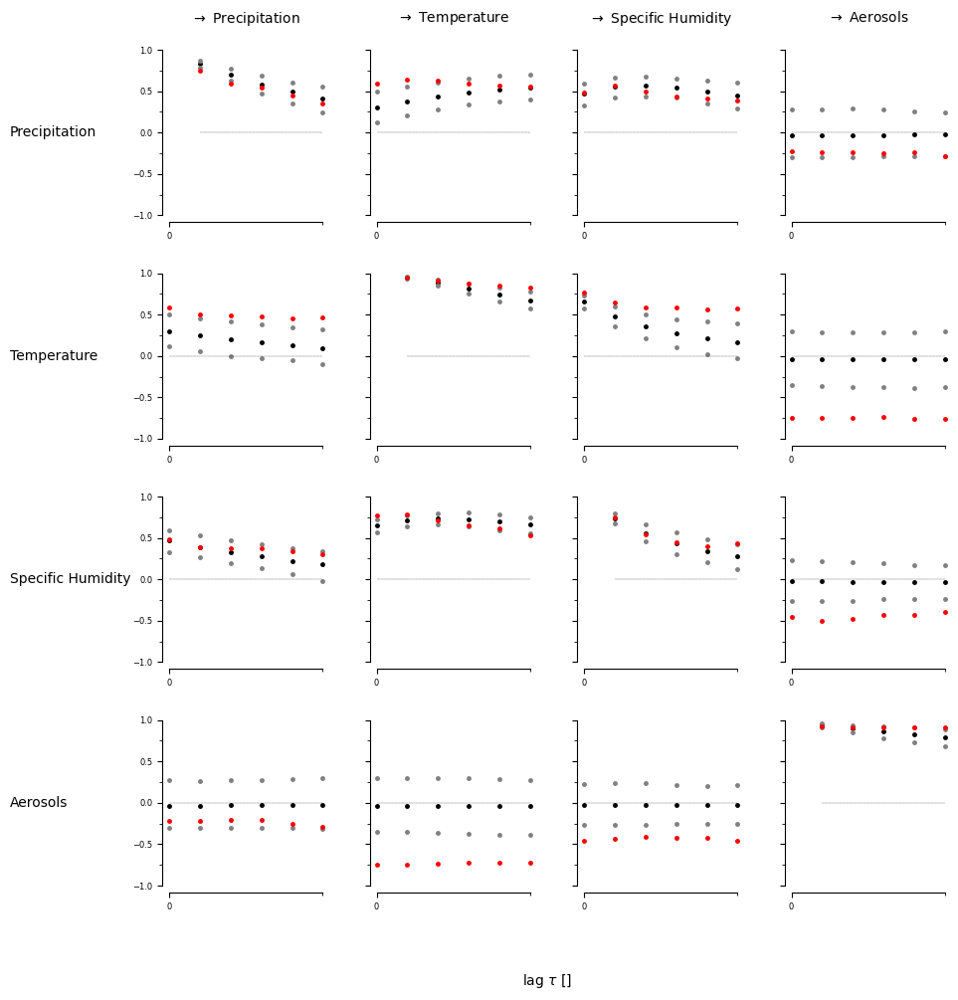

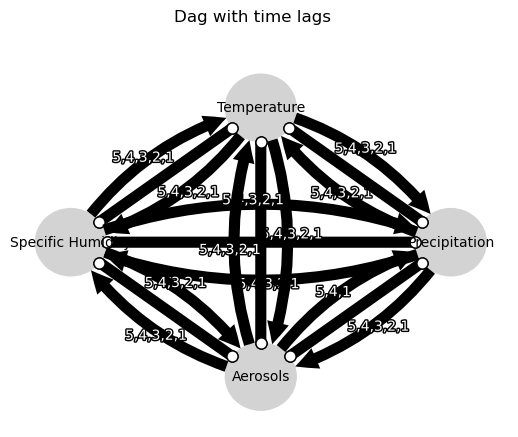

Negative precipitation values: 62


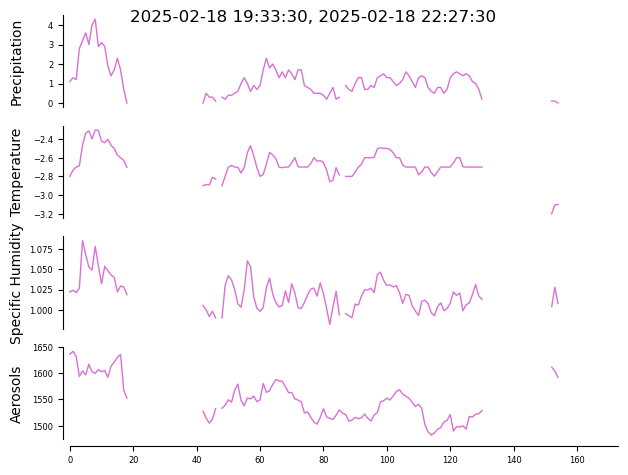

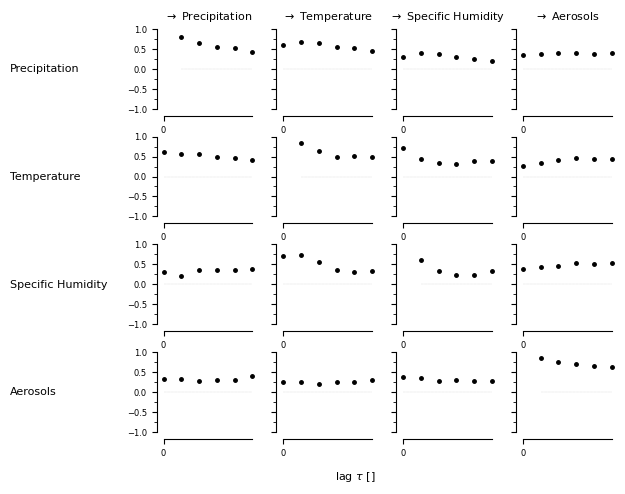

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


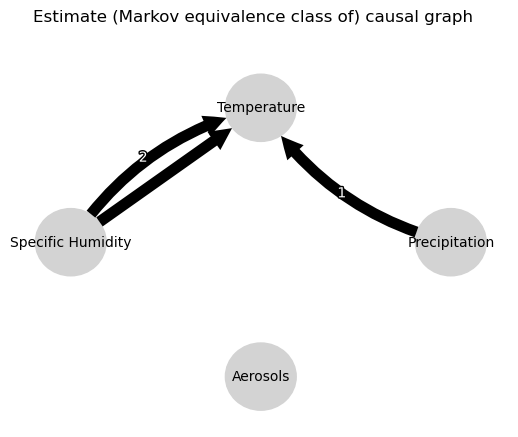

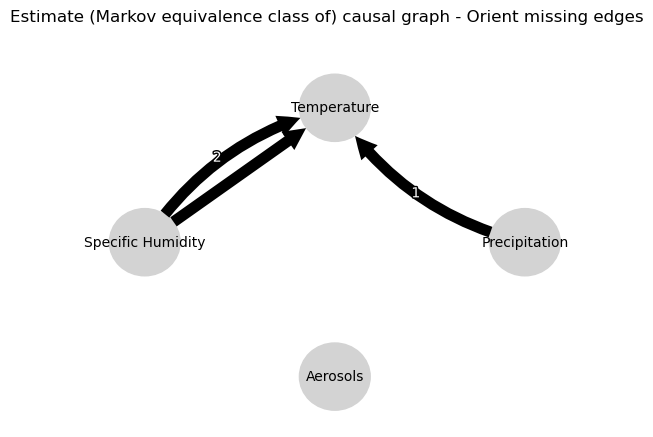

0.0
0.8228029326785427
0.6959884236225545
0.5934235572890989
0.5098231402912468
0.43692463575492435
0.3302683796142214
0.36139812476747374
0.35827966135574796
0.3444519480261453
0.3248053486552601
0.3046745865449785
0.10651440430811673
0.08127895500186379
0.06216161222332334
0.052013153143514235
0.039122554687970226
0.03532758097884333
0.1250397983559731
0.10754056149784258
0.09219270253794769
0.07612263609290978
0.06072482264384405
0.05289198245678139
0.3302683796142214
0.28684456459854024
0.251554270457637
0.21521957587850044
0.17518550700412075
0.14701915056909226
0.0
0.8192258413112736
0.6082864455789853
0.4580961788021255
0.34698635942308287
0.2661169943839225
0.7590581383813347
0.4892556049127121
0.32107567509099305
0.20571804276005196
0.1311409327713146
0.08377674522913667
0.10058571991014623
0.08563559104195242
0.0741055880088086
0.06622577937274973
0.05455509335777541
0.03982206256353259
0.7590581383813347
0.7278762585688107
0.5072981965866701
0.35556558226415674
0.25364974174

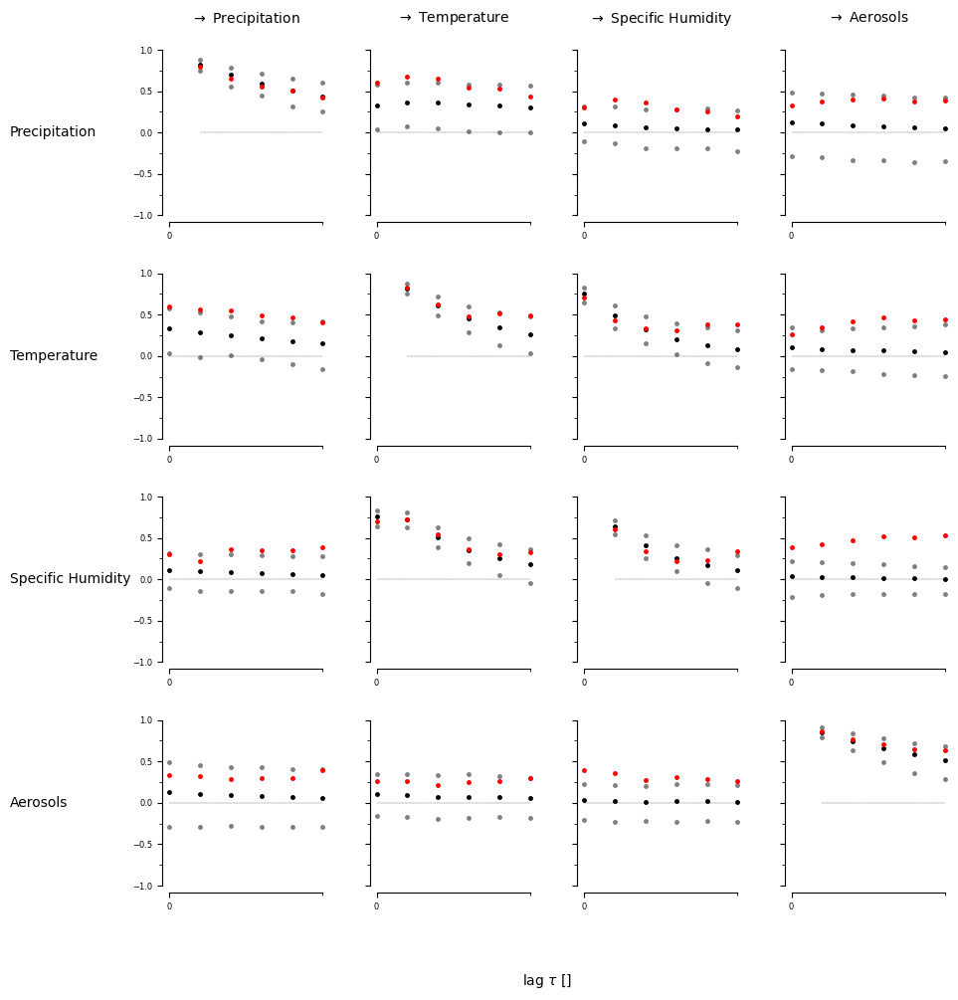

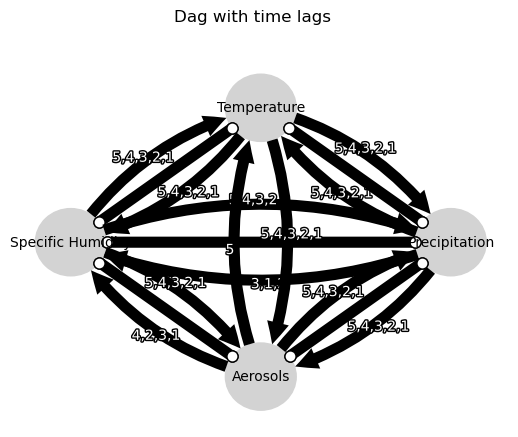

Negative precipitation values: 45


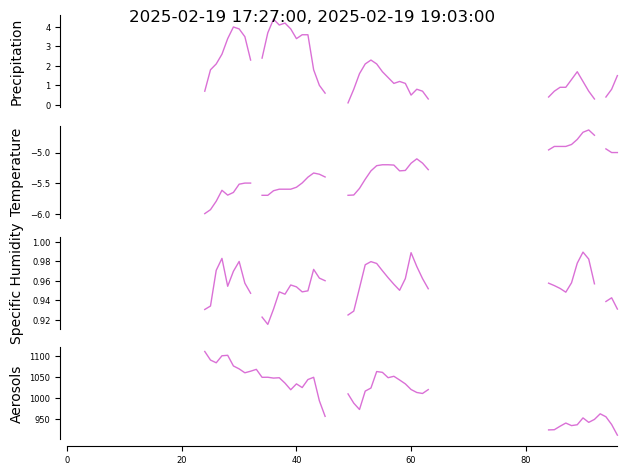

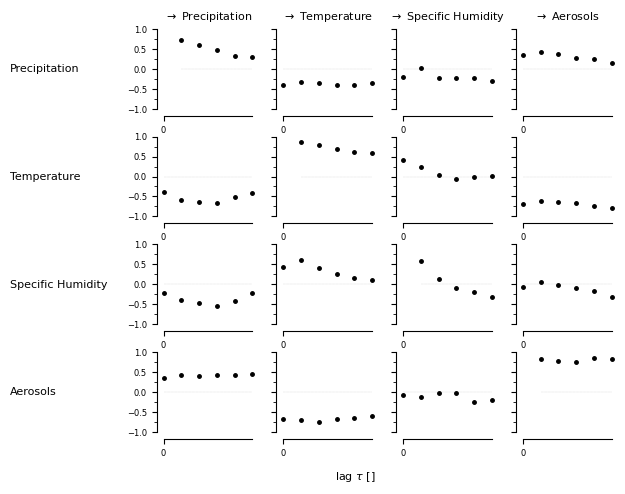

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


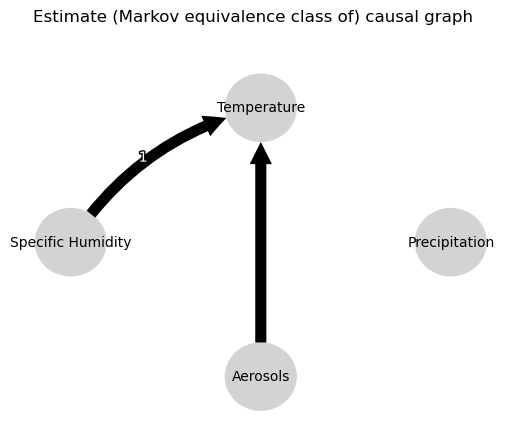

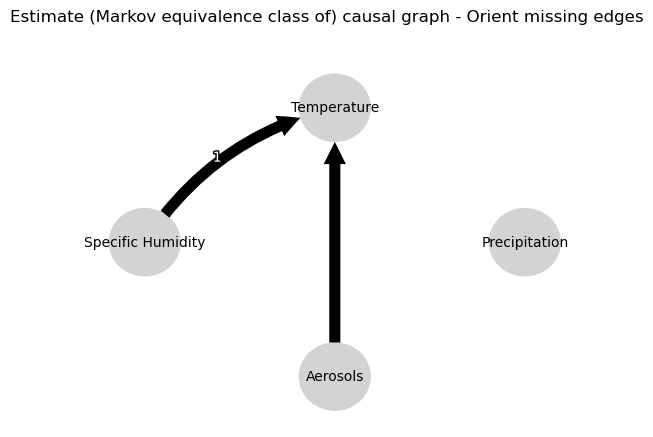

0.0
0.7700271981678628
0.6241434644327364
0.5184561874107039
0.4295642952562679
0.34987868576691045
-0.10526839082896285
-0.04326412361577309
-0.01165594665666882
-0.000392184075728938
0.021616012876251856
0.035074564629590695
-0.13256030367949842
-0.0766839163765067
-0.03842758630227634
-0.016764342125170334
-0.0045050594904833575
-0.0031505605051667636
-0.028510229825041325
-0.025916575267600925
-0.03497105056385616
-0.0398526976313725
-0.05352435944450292
-0.05339039531238957
-0.10526839082896285
-0.07579651041433198
-0.0720878614485529
-0.05755106437879846
-0.036551516356042126
-0.027600020107532118
0.0
0.5228700956483376
0.41403278412893796
0.3443695337959415
0.2856791194231291
0.24125515271105283
0.30860045560102056
0.1920269930992989
0.12925359473190545
0.06759416907095009
0.036784328739157976
0.019744749113963175
-0.5107549847219409
-0.4484651632644971
-0.3880045648330771
-0.34846711482649306
-0.3019759273813136
-0.26212703669473625
0.30860045560102056
0.44342747058090604
0.221

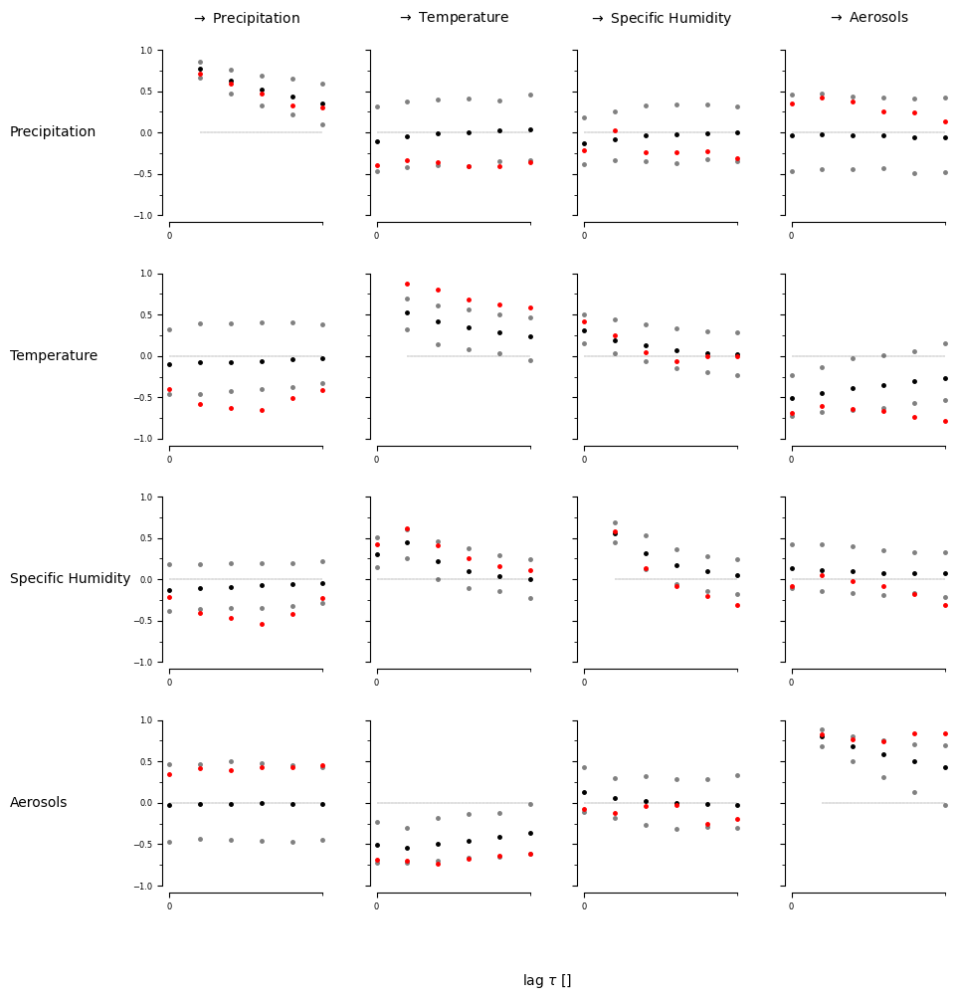

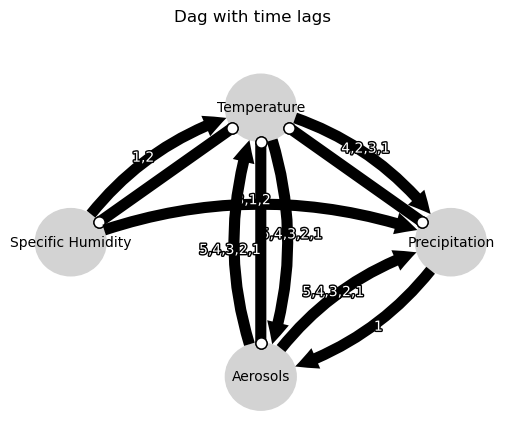

Negative precipitation values: 77


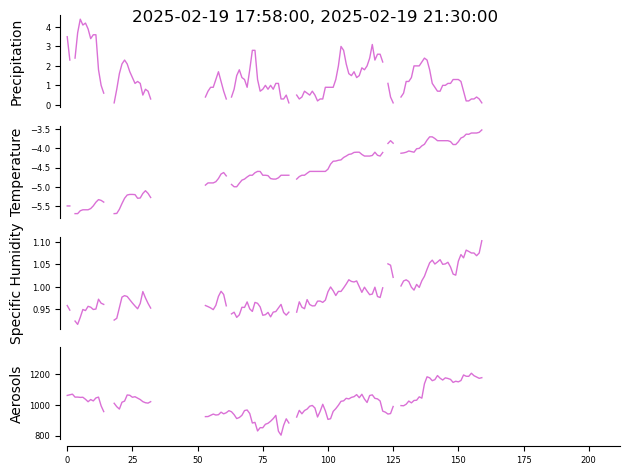

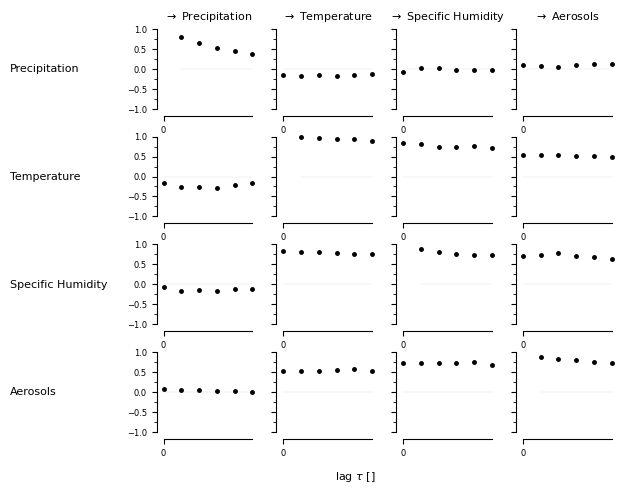

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


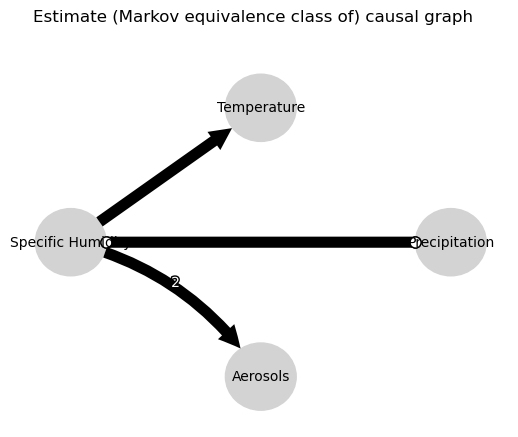

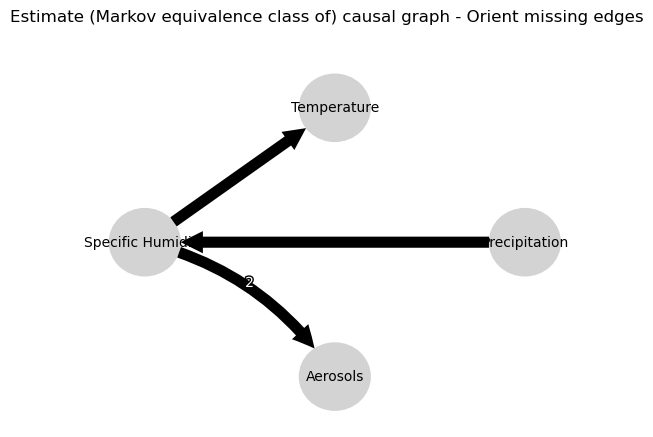

0.0
0.8450997984058062
0.7303562636872588
0.63249492197191
0.5511135157998237
0.47559385680308053
-0.0006527456214815702
0.002683787370935539
0.00896899875236425
0.021025835281054
0.032756486209971424
0.04453440706519264
0.012515070243005147
0.04517630749423935
0.07205045707379872
0.09542806153744374
0.11571454037874114
0.13312518104223267
0.07284554358452047
0.06465543596210774
0.05983169643558071
0.059292206354373225
0.06551146877925666
0.07052540827088027
-0.0006527456214815702
-0.003630196153860352
-0.009272177419528687
-0.014770719258543263
-0.017765862724632372
-0.021288098300159736
0.0
0.9570507117362058
0.9305844757480185
0.9042433357051258
0.8789289687781767
0.8511000219172382
0.7688621984995183
0.7110619128963026
0.6606315194259864
0.616085597398885
0.5763143890352407
0.5380175125770864
0.7040791855282978
0.7063838498908345
0.7085299614370623
0.7043300462341527
0.6972755481963651
0.6847976307491428
0.7688621984995183
0.7822629032329149
0.7961080131685505
0.8019446220364965
0.

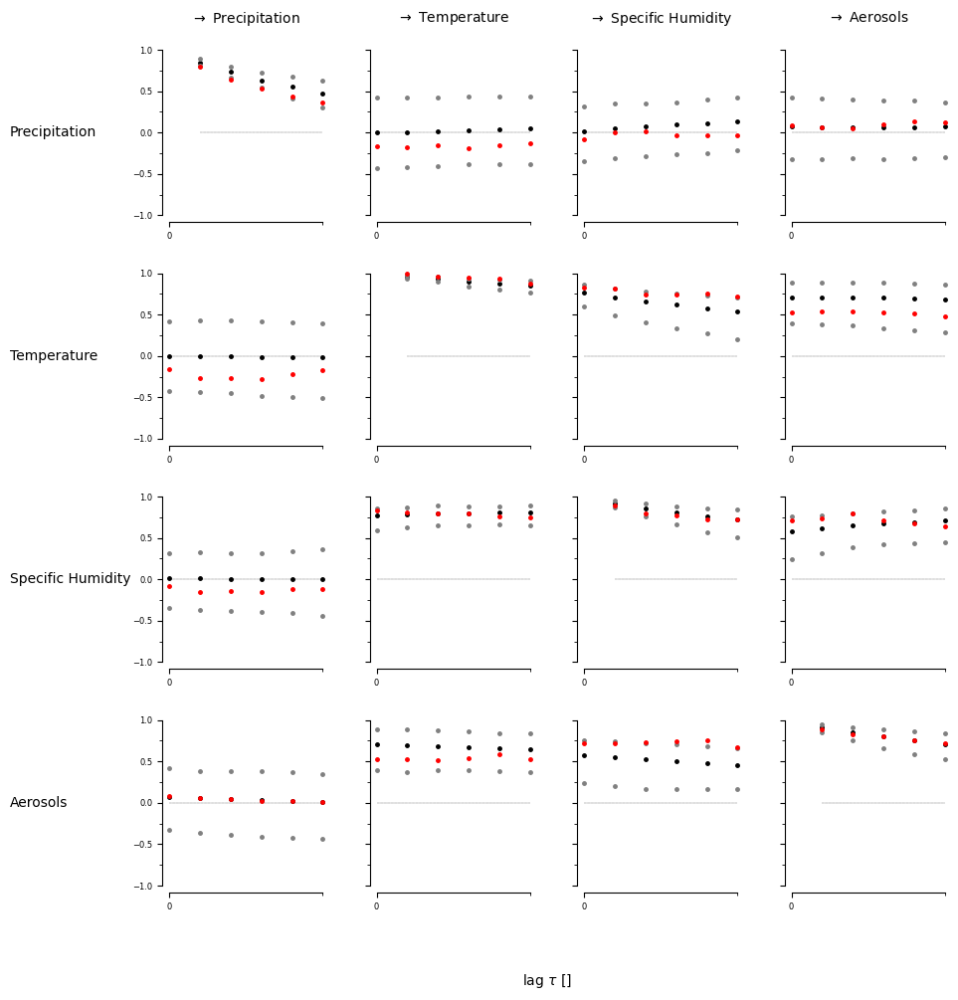

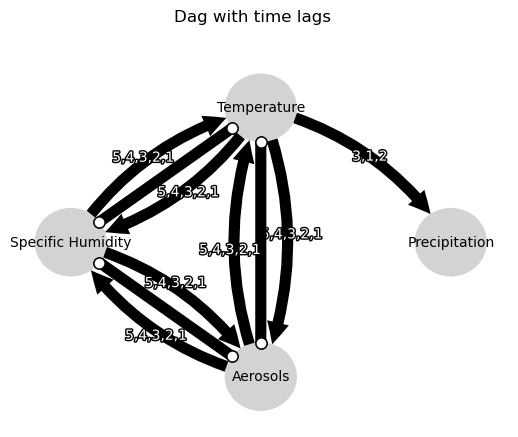

Negative precipitation values: 433


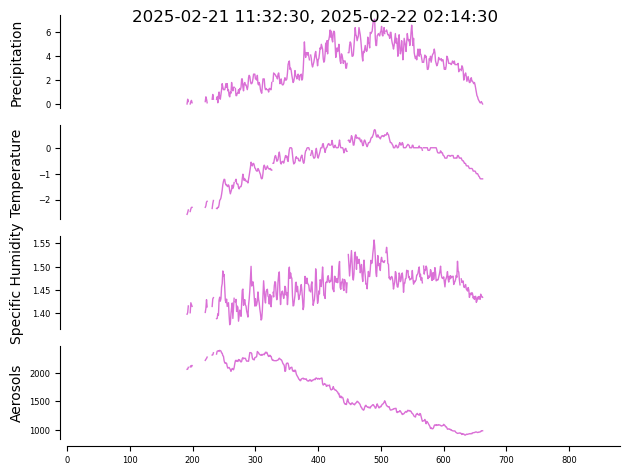

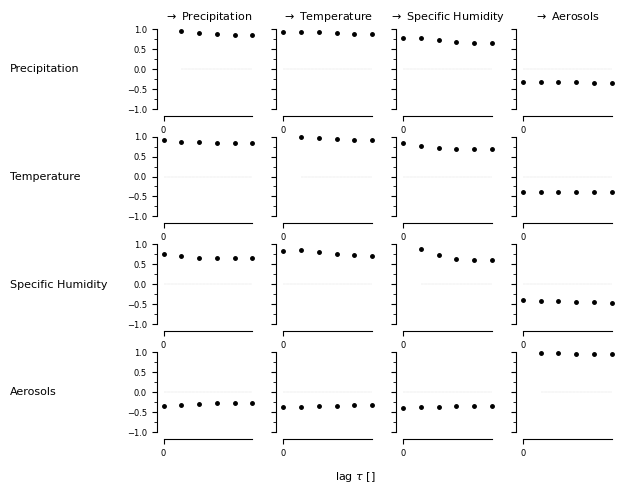

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


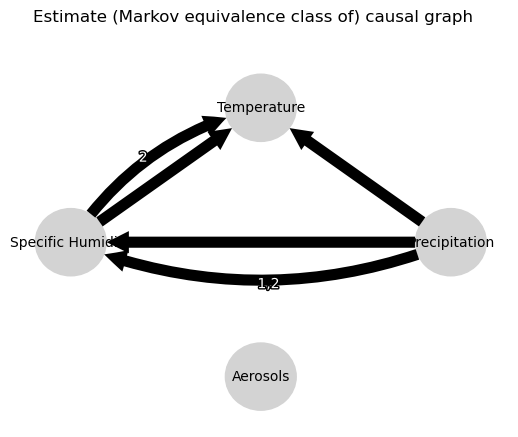

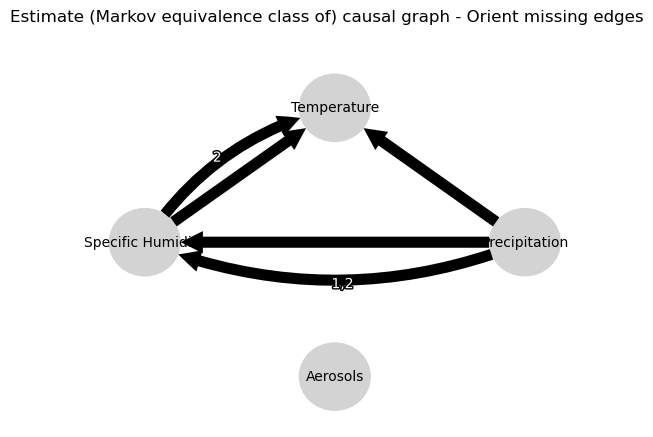

0.0
0.9554272551289452
0.9162684325250277
0.8796194505854865
0.8452239273289339
0.8119356586364096
0.7804369833128949
0.80827080452449
0.8122895396941753
0.8022569663823538
0.7933894821719307
0.7847535477066466
0.7551426846300633
0.7567562551319637
0.6979563480885469
0.6502531635219806
0.6096704688363217
0.5737073293936098
-0.015402357968434477
-0.01658387612941755
-0.017951443599723747
-0.019300881357882087
-0.020630206443413113
-0.021881110511992385
0.7804369833128949
0.7479848314013195
0.7175378073144867
0.6884844712195582
0.6609022843471831
0.634765694257502
0.0
0.9767364297739222
0.9411862145845542
0.9097525611038612
0.881777180897672
0.8565025378729245
0.7808685602802962
0.693549651576427
0.6197727884711113
0.560865566534624
0.5122216475085039
0.472061235173308
-0.01211088105697536
-0.012674664990128908
-0.013355742599701854
-0.01406180368419852
-0.014458813453941066
-0.014558479327296172
0.7808685602802962
0.8067114951383405
0.7744566839064596
0.744300098721115
0.719373340384516

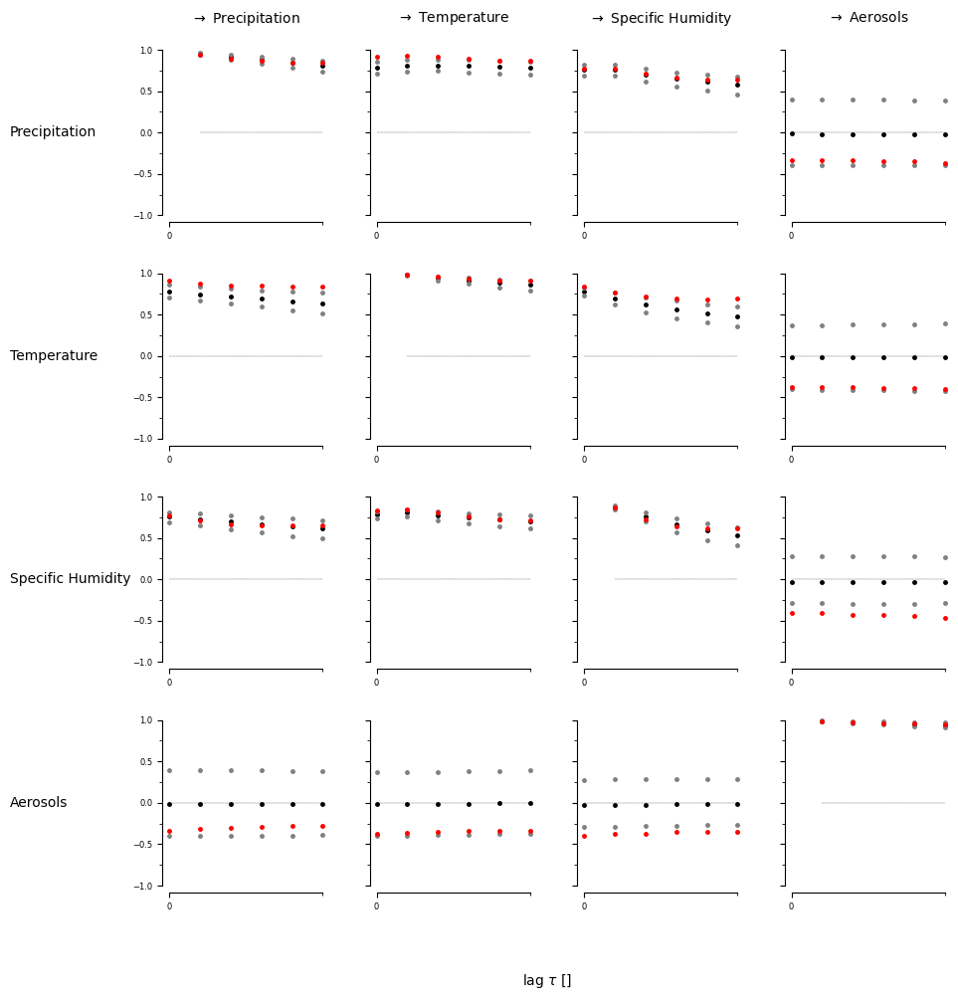

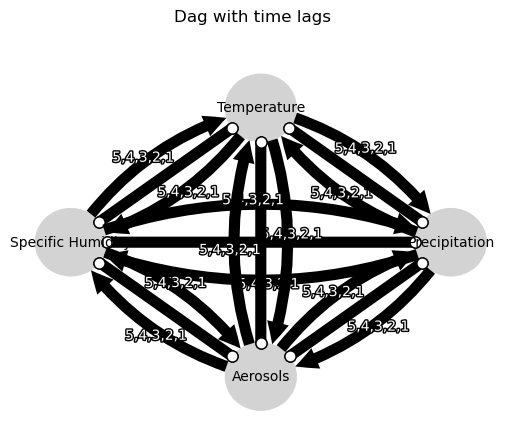

Negative precipitation values: 608


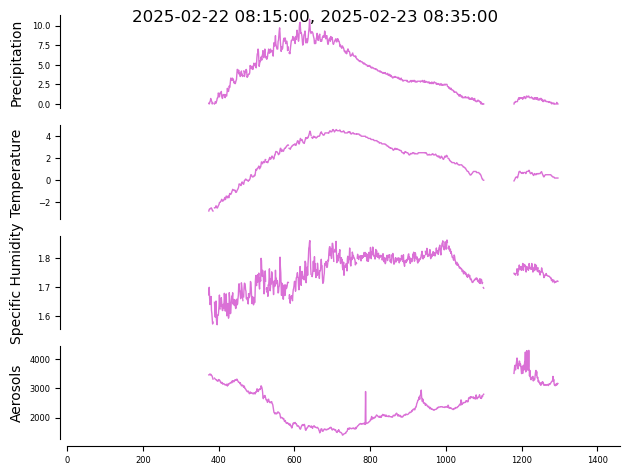

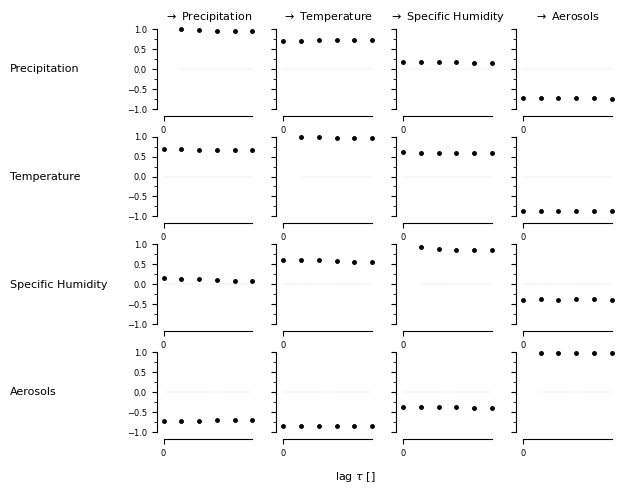

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


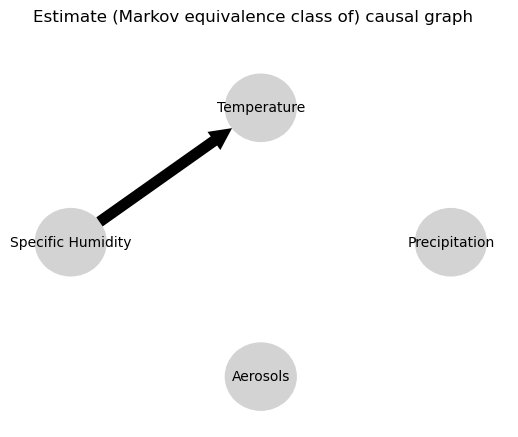

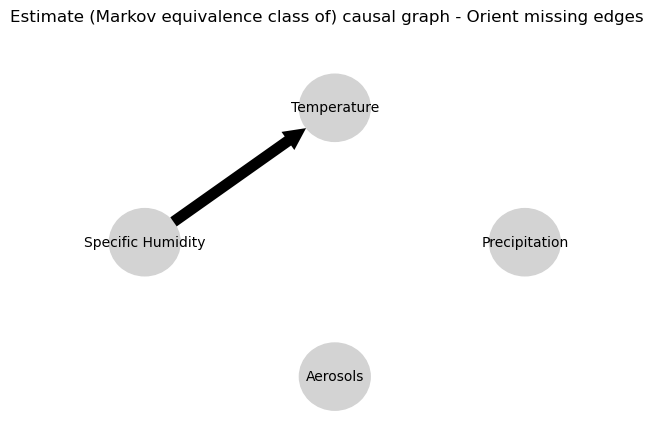

0.0
0.9863637927819754
0.9748147383259373
0.9640708730131117
0.9537612619329587
0.9438415089973389
0.01058632708044224
0.010306722126734655
0.009874852565549833
0.009456884844603731
0.009043804880883893
0.008560431313291787
0.027367792368776636
0.02415769978933898
0.020983896806930264
0.017914560286674784
0.01508350982009828
0.012328527486937127
0.008402504968795563
0.007965530881367665
0.007255570688972921
0.006989066386366253
0.006646821531542382
0.006572519450224262
0.01058632708044224
0.010747078422057443
0.01079101318481969
0.010823485675803086
0.010758080270964232
0.010670265124345999
0.0
0.9926756631205297
0.981993852087777
0.9711864689431178
0.9617637896137232
0.9539088869444808
0.41425390780865035
0.3907179459380055
0.36850232776977065
0.34744470522745646
0.3275531284943499
0.3086281579322678
0.0465037310843105
0.04662039222723836
0.04688330377395482
0.0469891626170926
0.0470423074767039
0.04720780692203853
0.41425390780865035
0.4229888387757704
0.4248481432437971
0.4245279790

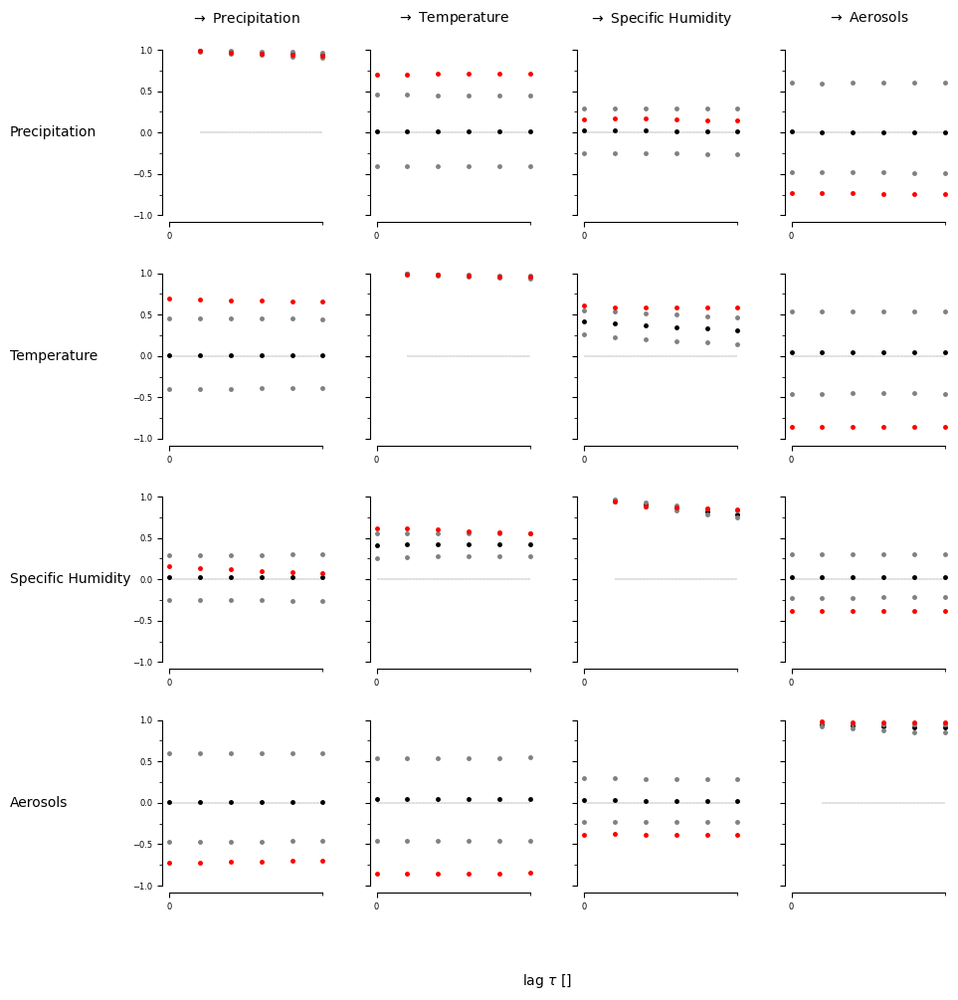

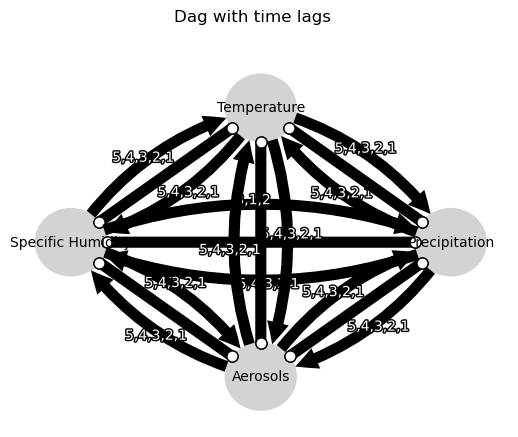

Negative precipitation values: 106


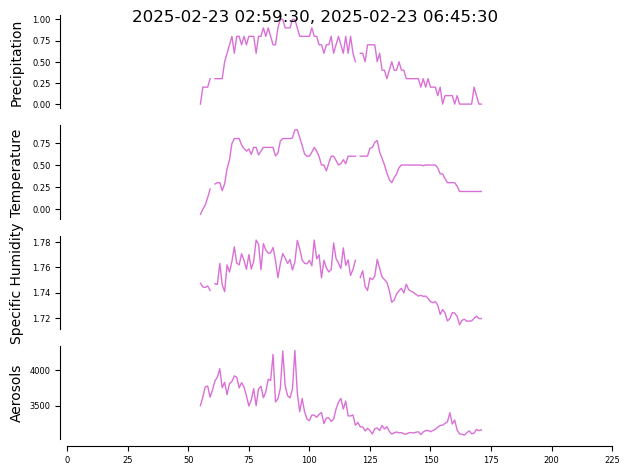

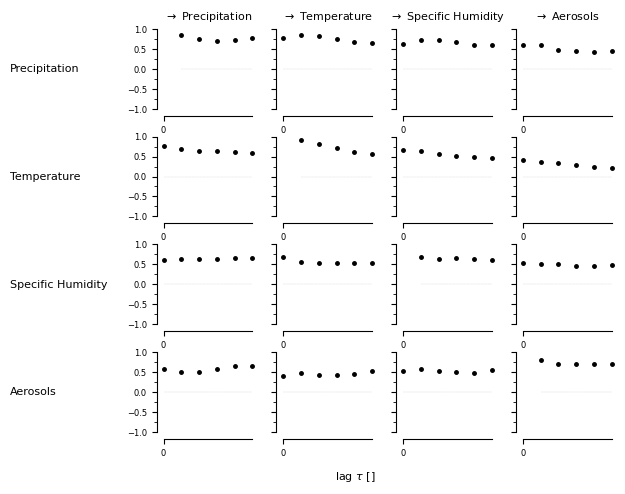

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


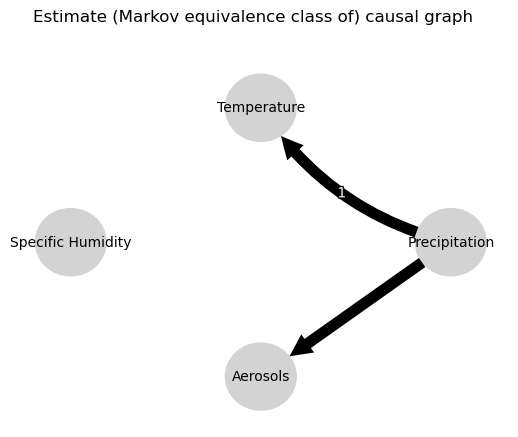

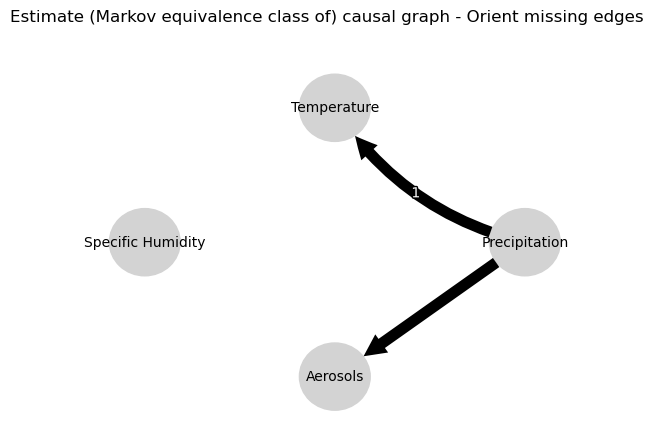

0.0
0.8601948110144609
0.7755681692751162
0.7233308018310807
0.697895499832258
0.6998133196783144
0.771900462450021
0.8094228250008149
0.8066658504592028
0.7872635906780637
0.7570431593848678
0.7277951943069518
-0.20760690364517542
-0.1822057855721583
-0.1615571273318198
-0.14093026713795156
-0.12364191059658274
-0.10515902566224597
0.5000607751638004
0.4802391607406386
0.459000292228273
0.436792059801324
0.4206961346308303
0.40705408049739406
0.771900462450021
0.7157957567620497
0.6807029513513766
0.6560534358331458
0.6420434542045054
0.6228584141378071
0.0
0.905805042487588
0.8368217787655624
0.7796164344607897
0.7347523803658749
0.6974832260325167
0.01292162009927516
0.011803090938036966
0.011648276407443054
0.012877912394689052
0.01725719523592234
0.020823391205258418
0.49306744012950127
0.4620821085322577
0.4366432610063262
0.40938101962895124
0.3897749121328349
0.374099847309698
0.01292162009927516
-0.050065217733264014
-0.08761753285541155
-0.11116141524952024
-0.122943934738770

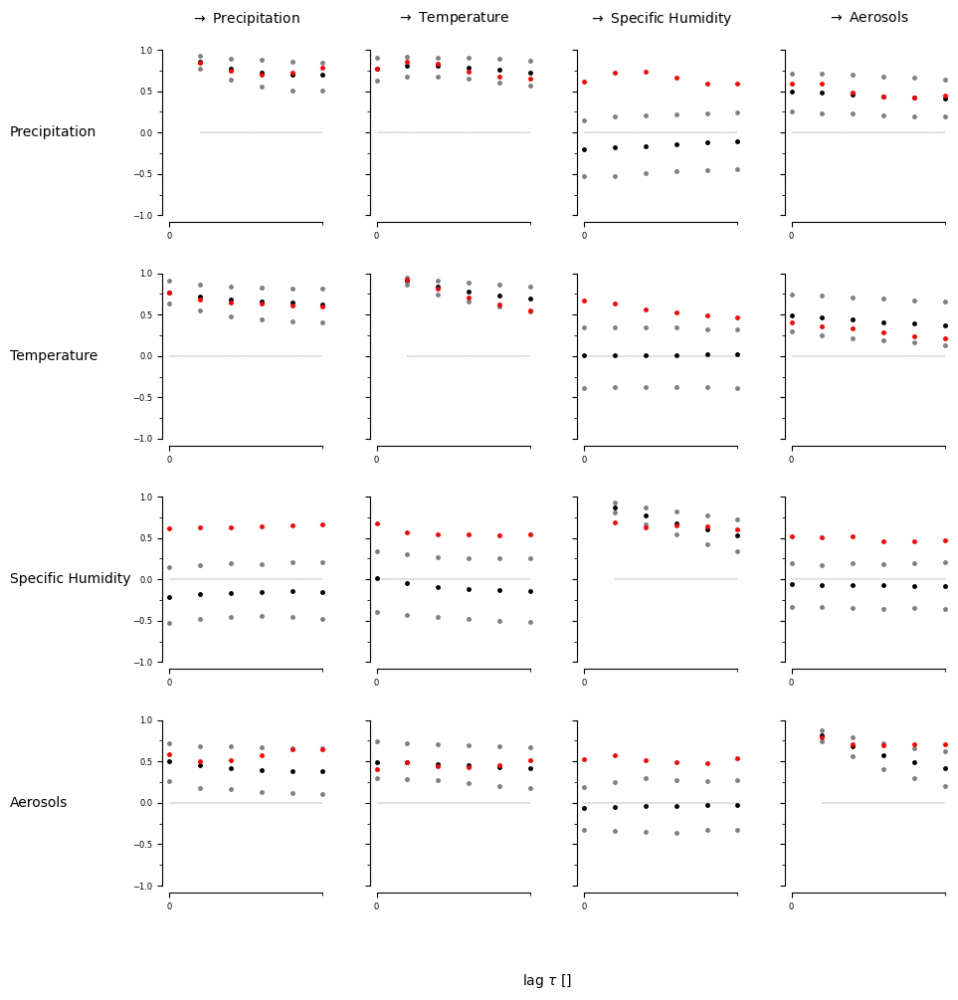

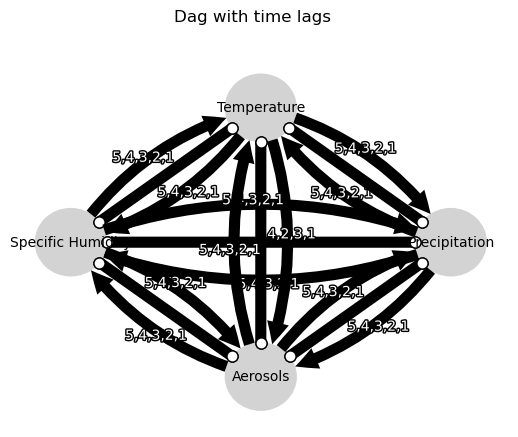

Negative precipitation values: 123


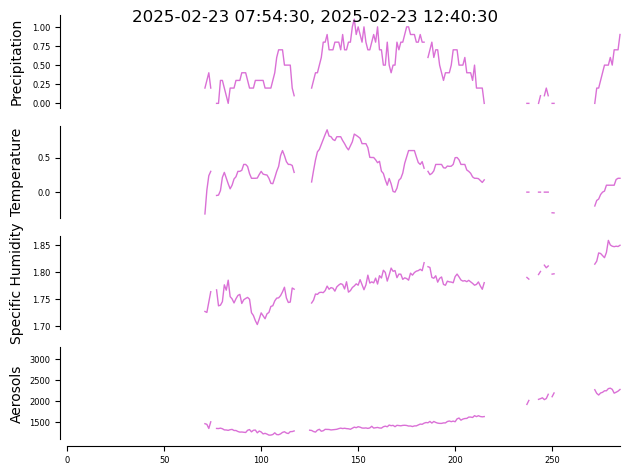

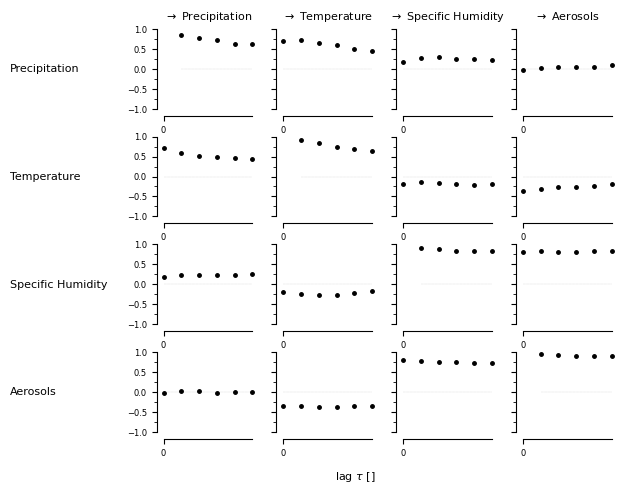

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


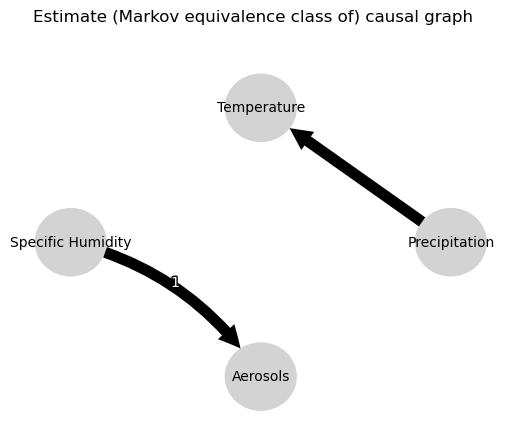

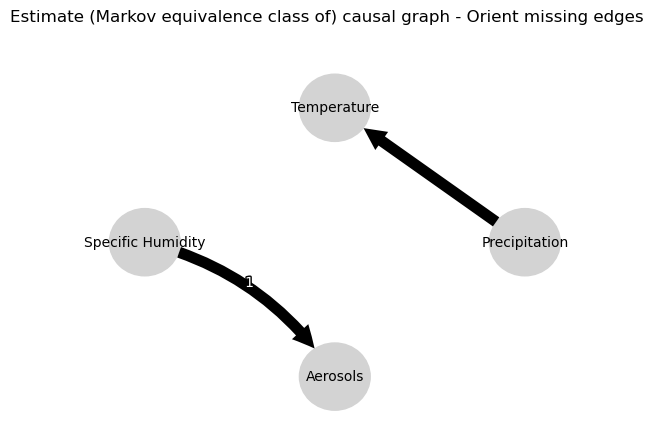

0.0
0.86193931027334
0.755011287096362
0.66369726350359
0.5834686991429772
0.5100331069706958
0.5683380269808395
0.6013947051986472
0.6159674819878943
0.6180986524640675
0.6099478419405692
0.5924449042709583
-0.21045936912794516
-0.191981826580537
-0.17593305687898403
-0.16171227662216134
-0.14939544917620096
-0.13614577526907584
0.03164893965338357
0.030870214411725234
0.027560444138619706
0.02398566916467239
0.01819255491058081
0.015187458394877234
0.5683380269808395
0.5001945726253907
0.43885990600391017
0.38093628029422943
0.33049467781703223
0.2854095758126701
0.0
0.8999858289578649
0.8186849315674656
0.7445743955585407
0.6758760191668806
0.6102450456589467
0.025526079711712057
0.0287413265609542
0.03248156049237511
0.03310393868799611
0.03471066757657027
0.035138145975831335
0.0009821585777654617
0.003065022097042426
0.0017873456396634258
0.003339015948051142
0.0034369838734860116
0.0030560207528965233
0.025526079711712057
-0.008293865614543141
-0.03338629705560904
-0.04964436545

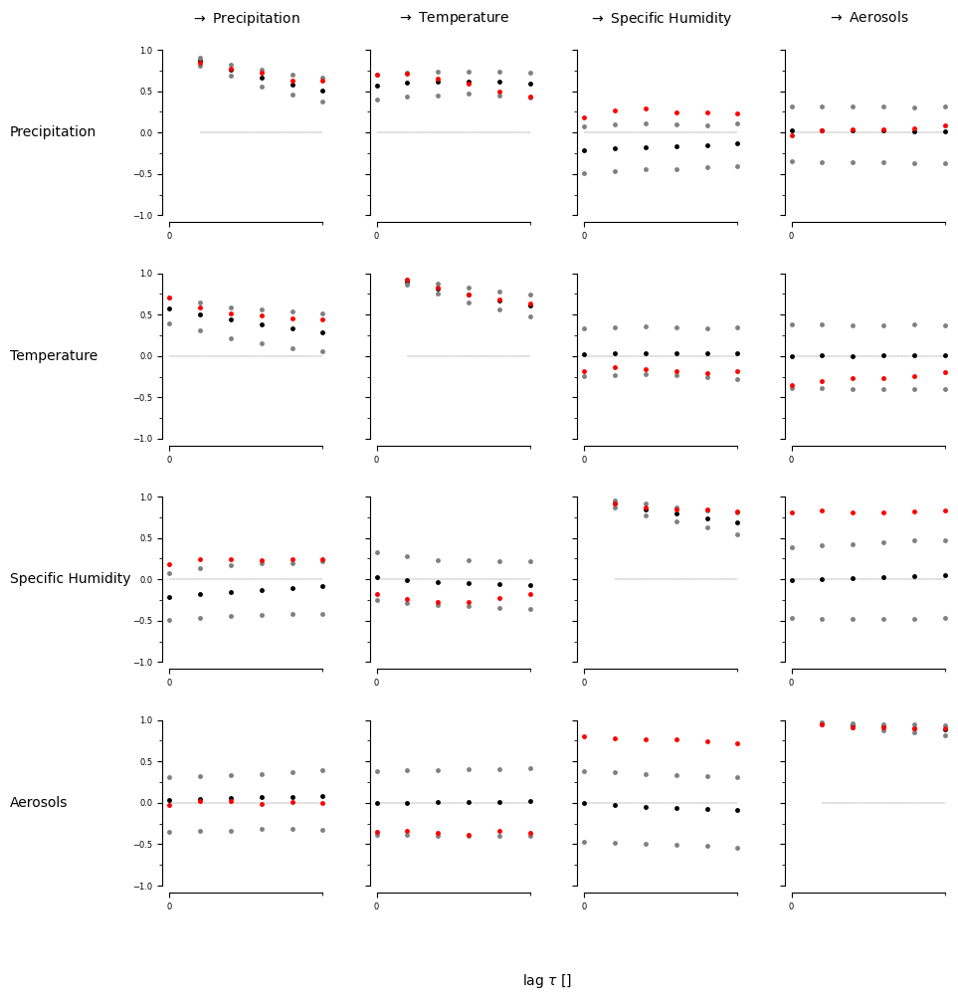

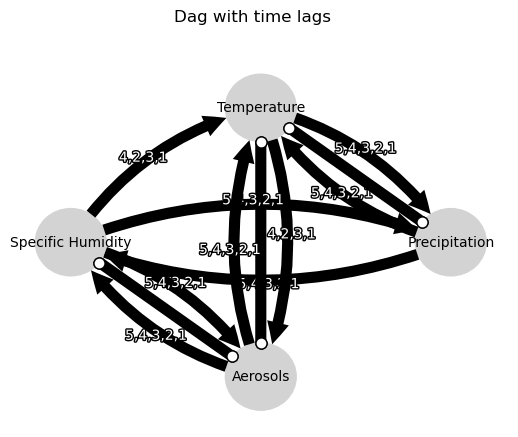

Negative precipitation values: 456


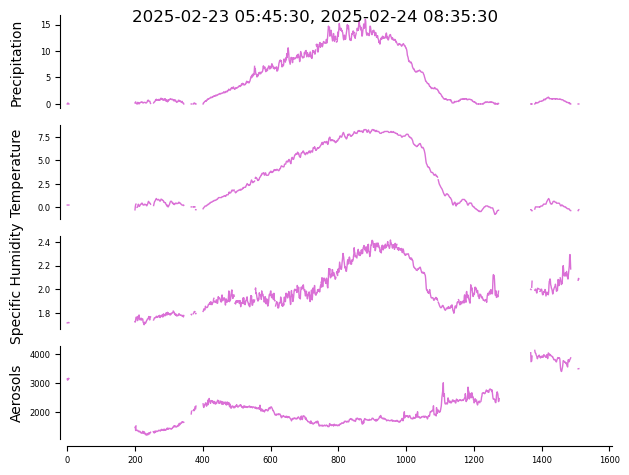

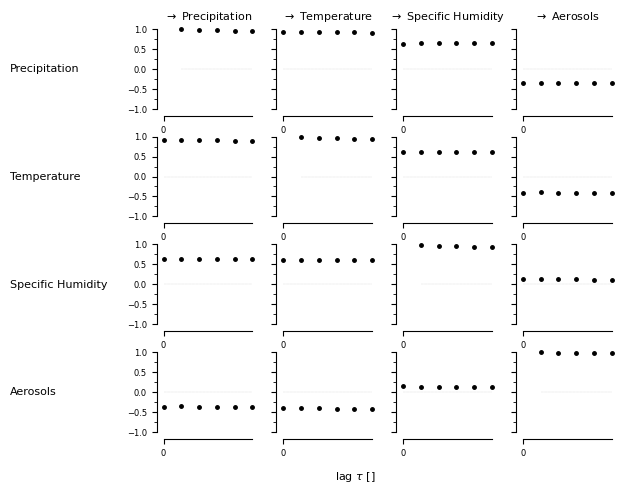

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


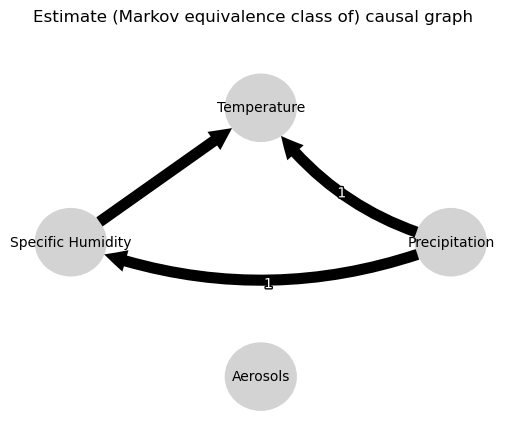

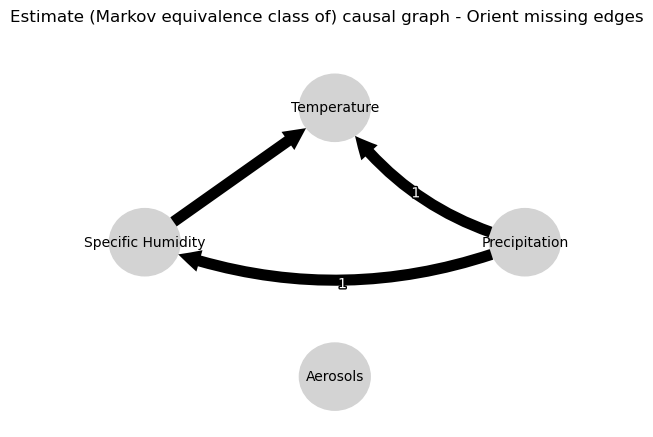

0.0
0.9897928118128112
0.9812454312537691
0.9731431372150283
0.9655312158660574
0.9580207169213104
0.8692618519843576
0.8770716753245192
0.8842853442539302
0.8907140799986473
0.8967472286133136
0.9023123299151077
0.5370697723854297
0.5404503647505305
0.543561678586883
0.5464424563812156
0.5493917234776913
0.552331753428133
-0.06604359207804004
-0.06565369584946452
-0.06522139573538854
-0.06491862953145705
-0.0645305736413403
-0.06427593967519046
0.8692618519843576
0.862624724240138
0.8561569867486625
0.8498558048181981
0.8436548884582639
0.8375592956550955
0.0
0.9955780864329807
0.9920723200100745
0.988864644955152
0.9857049001487505
0.9824407986709554
0.6349887806465406
0.6343941569896626
0.6338899985955538
0.6334324505938753
0.6331507179190554
0.6328140870342682
-0.06530711887447481
-0.06509987874064654
-0.06488465141859198
-0.064701226150027
-0.06454813251564566
-0.06443224980655254
0.6349887806465406
0.6307593831471313
0.6267349846292825
0.6229895785135237
0.6193308796916296
0.6158

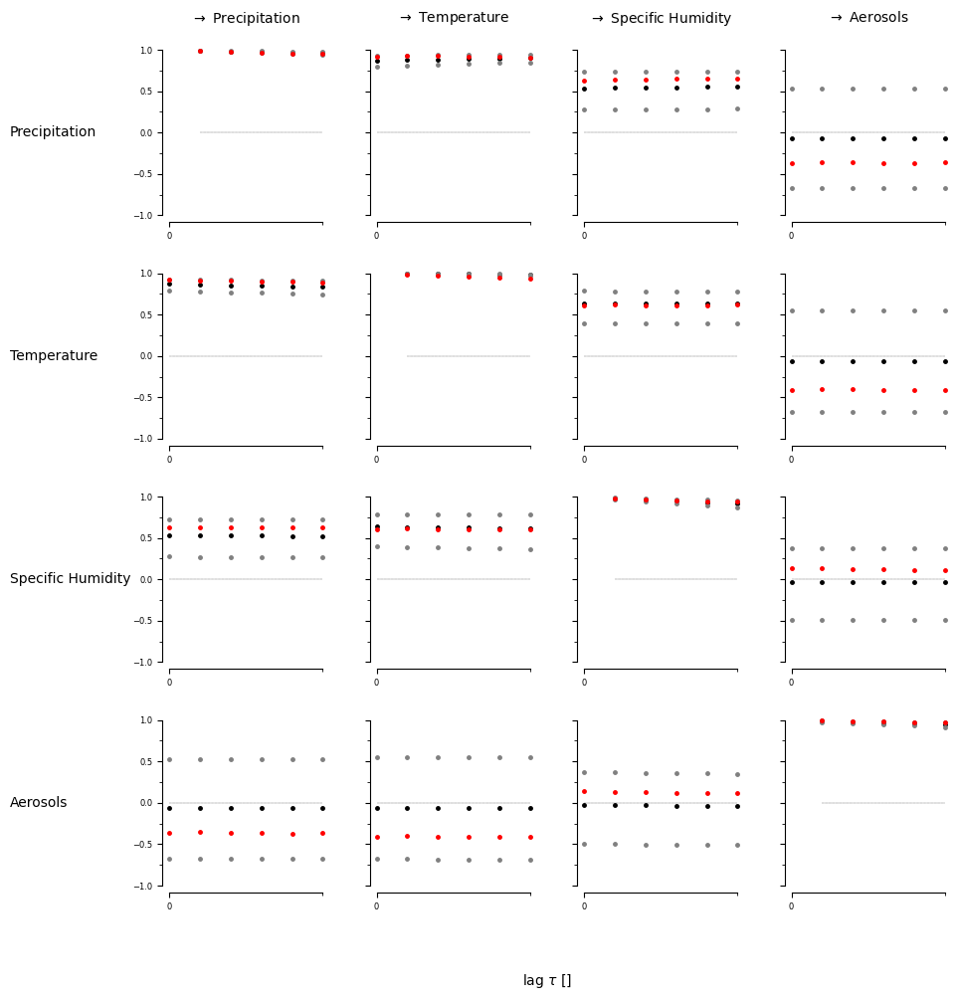

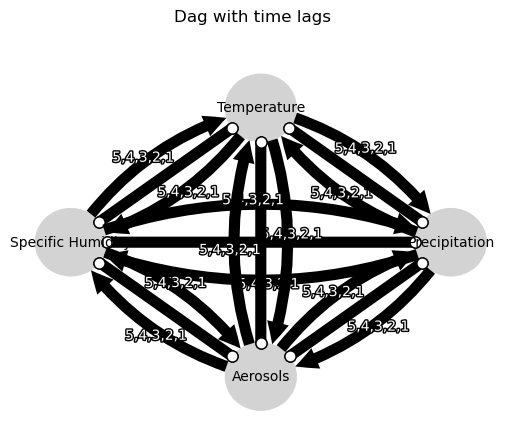

Negative precipitation values: 21


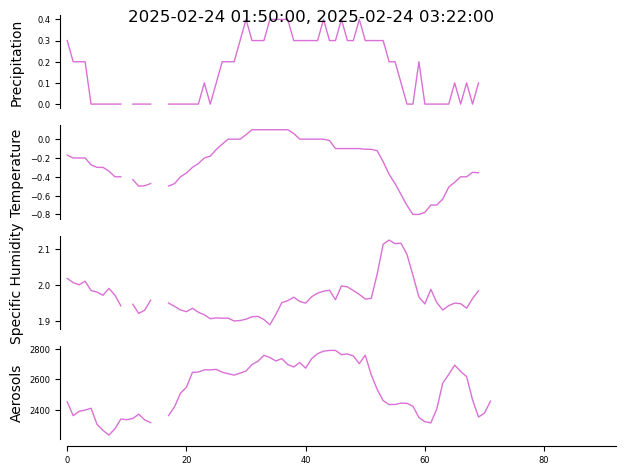

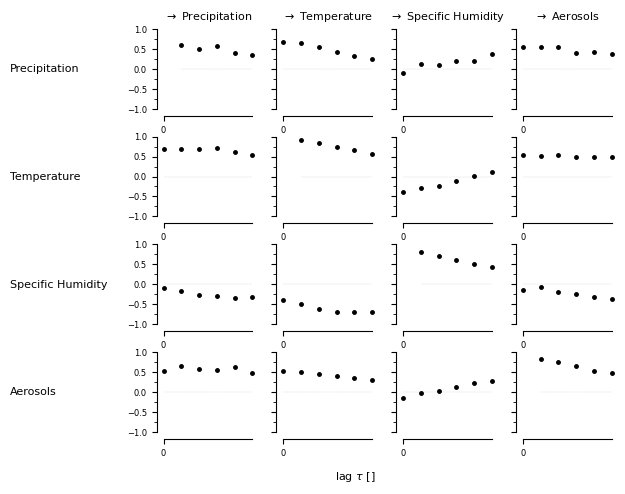

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


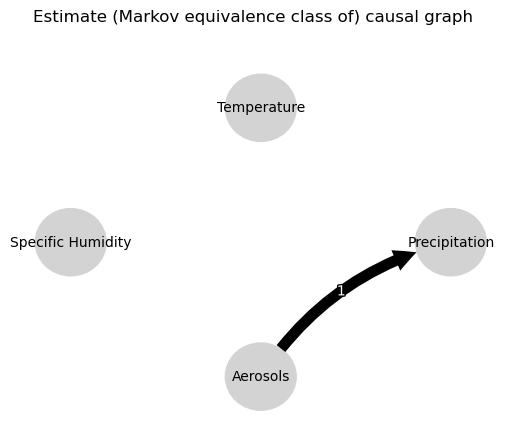

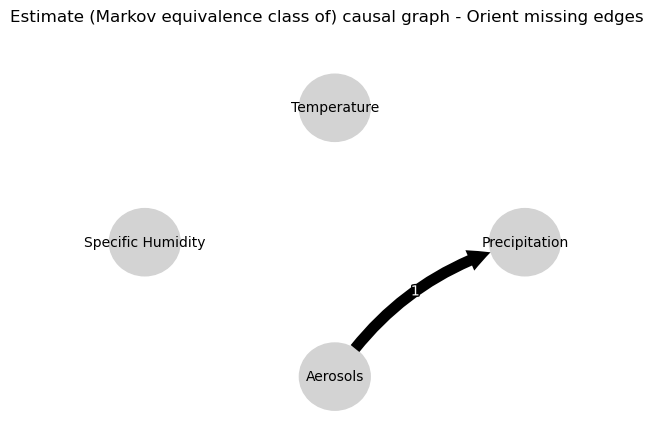

0.0
0.37352051750218107
0.3237453842626154
0.3037718942307938
0.2637519838336067
0.24420740333301996
0.026910658231819696
0.025210029721356553
0.0425519079525378
0.029694040632095634
0.03530310005651489
0.026635793692699684
-0.09516630328078471
-0.07116047191649337
-0.061312607129775445
-0.046772523746604226
-0.05377439282885063
-0.03928625060605767
0.5364346332991872
0.4750867743228521
0.42852445829704827
0.36709170590455736
0.3361481929970547
0.28869123413834535
0.026910658231819696
0.17084151913775159
0.13391178833599426
0.11794034893277966
0.11999990965008134
0.1018689582438803
0.0
0.8437142851025731
0.7549568308189794
0.6977429160755986
0.6234112307808817
0.5632822232819258
-0.06271508182102074
-0.04988987937968457
-0.04331248950609951
-0.033234884416674805
-0.017430748429327767
-0.013018015125400781
0.18275272635787965
0.15491195824910414
0.13194426864282818
0.1222409691481986
0.09940399685440784
0.09352123899822143
-0.06271508182102074
-0.059045335511980754
-0.05146359824162986


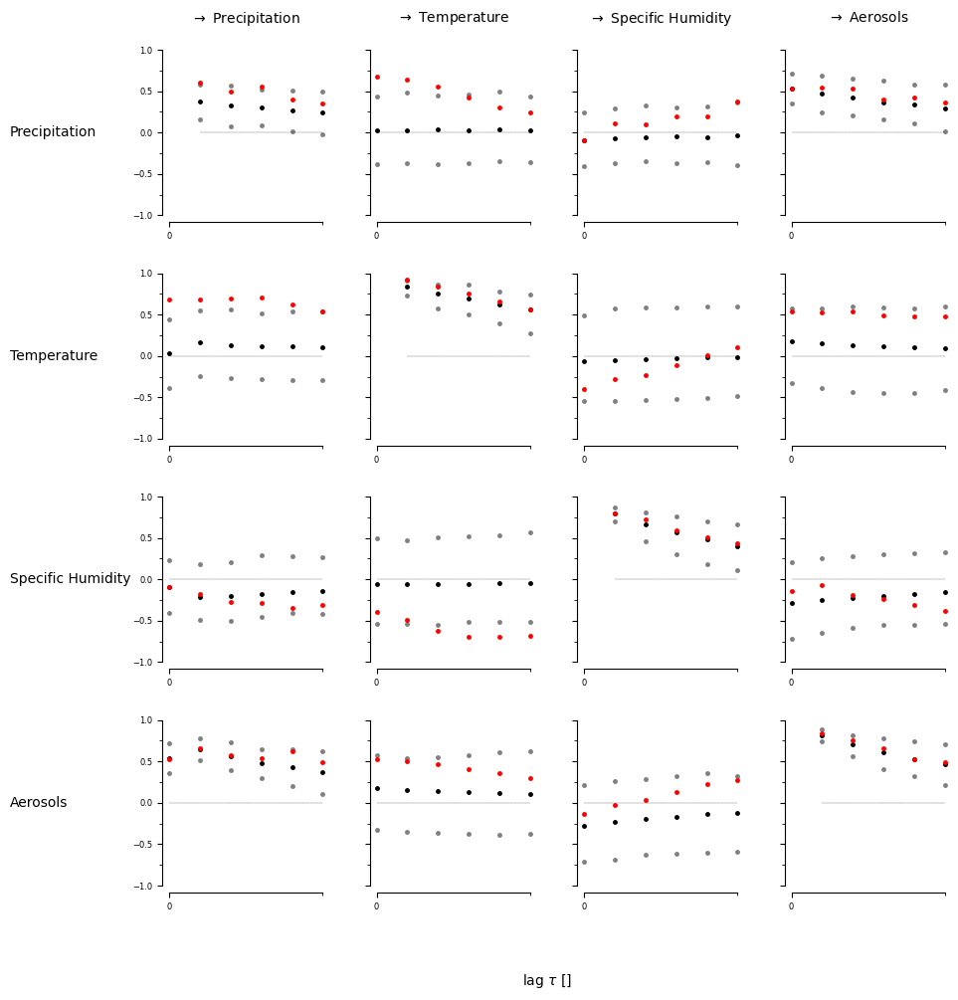

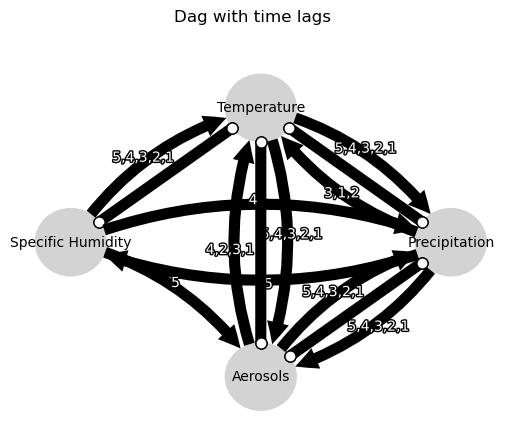

Negative precipitation values: 97


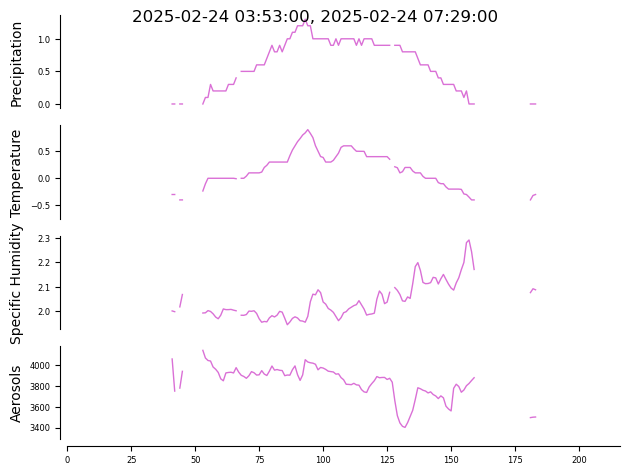

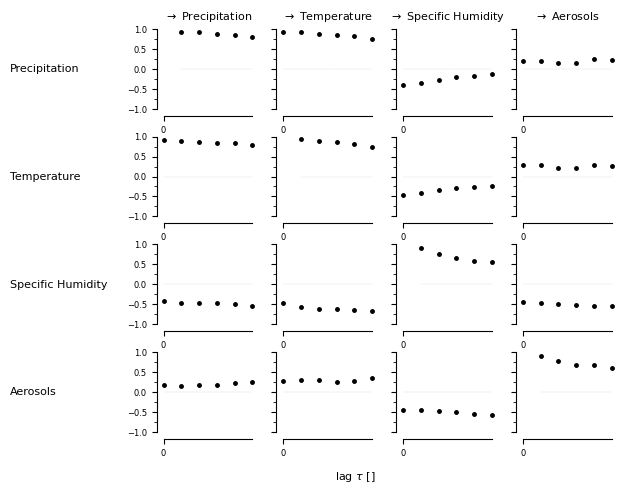

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


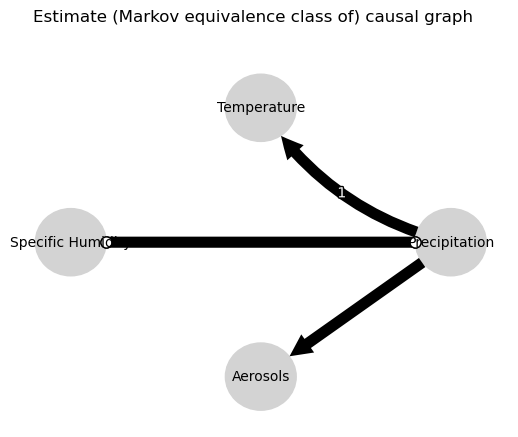

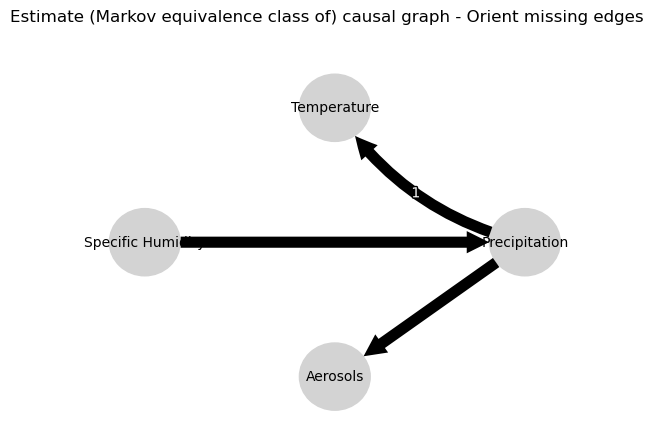

0.0
0.6964687301447899
0.9467845490355034
0.685592528527433
0.9101841884300451
0.6662656889964353
0.4649562794225817
0.4826969932234801
0.4890636903905491
0.5064134883142731
0.5125136294322885
0.5285168879926188
-0.47302796528088
-0.429469595001246
-0.3875840072313158
-0.35160191290523335
-0.3164140439392911
-0.28662106874806437
0.35545543516388234
0.3585579951827535
0.3724550561671892
0.3742782650015271
0.38729112438333907
0.3877240805846984
0.4649562794225817
0.4475473274898233
0.43096867580892395
0.4142902781794986
0.39544878184642507
0.3782945844878979
0.0
0.9333639289089057
0.890390647393618
0.8547931236849
0.8214518945392706
0.7891473070210244
-0.07679805586086831
-0.05870234880547829
-0.04225380982462558
-0.02370121217897414
-0.009120920631660569
0.005366937559824005
0.31635981795472257
0.3086942143995688
0.3030252813485283
0.2998071642081703
0.29531560901652976
0.28770606920841185
-0.07679805586086831
-0.09176134924158426
-0.10596772090992827
-0.12379953919026201
-0.14319907276

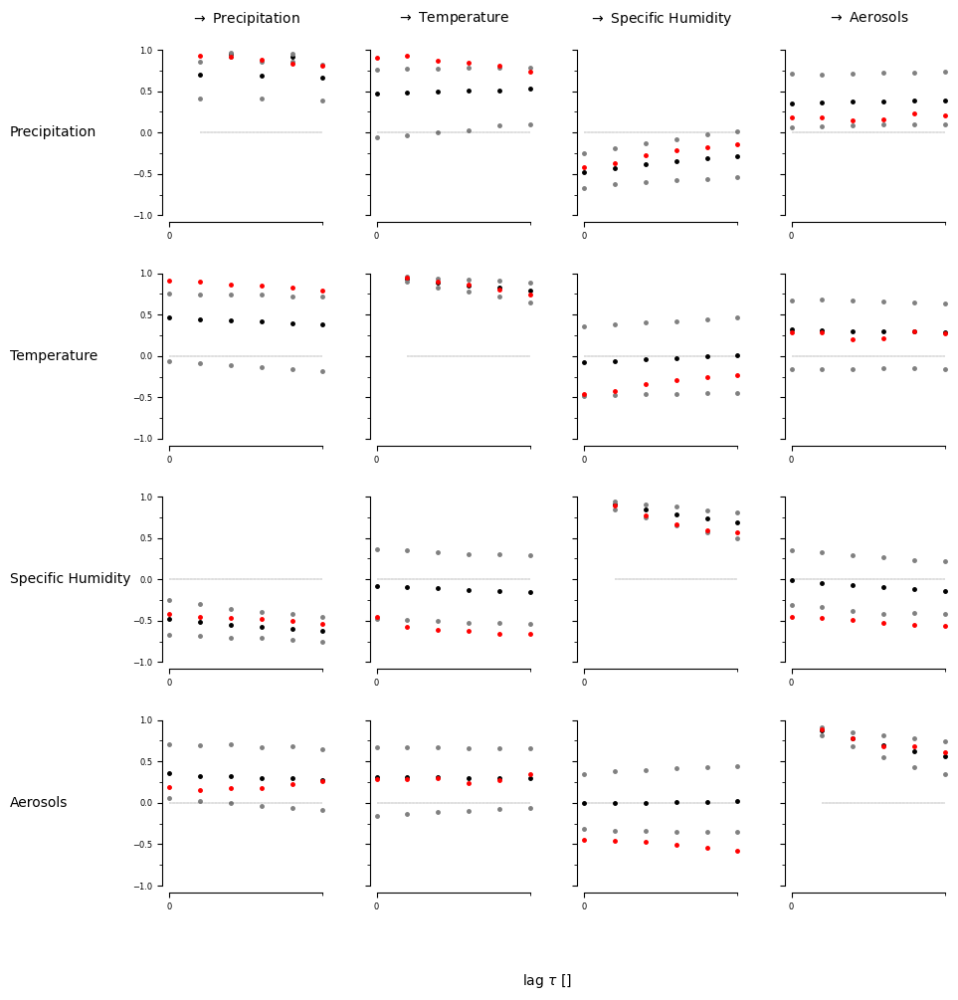

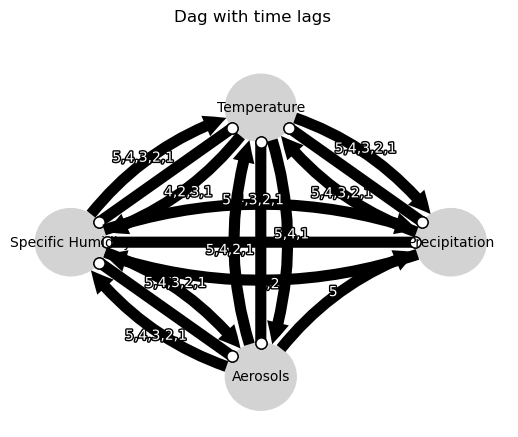

Negative precipitation values: 461


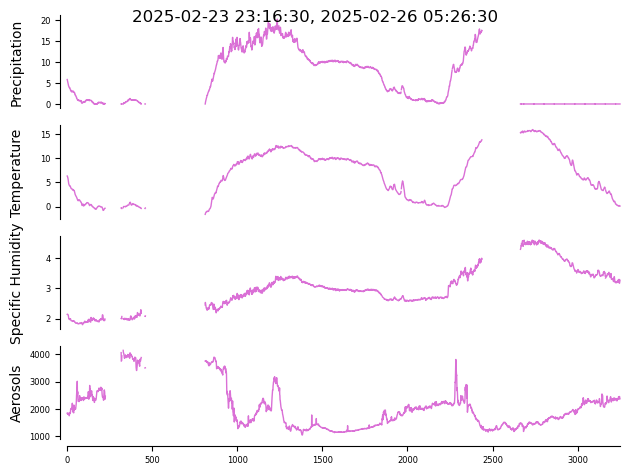

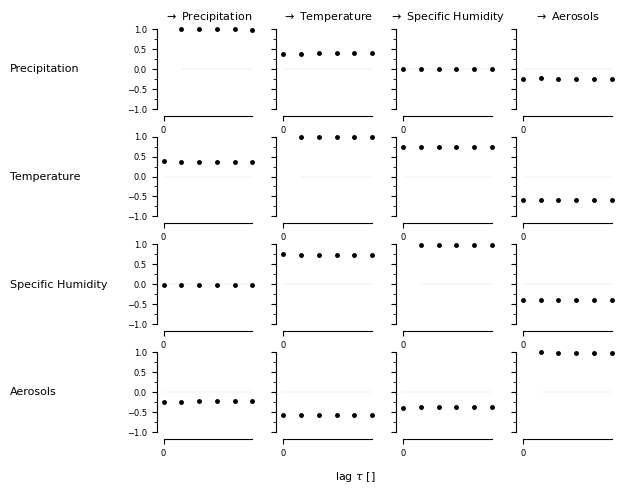

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


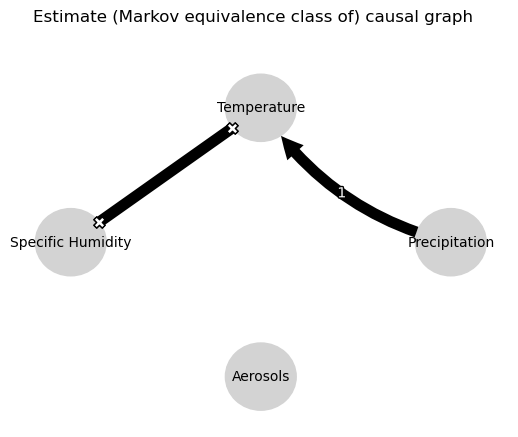

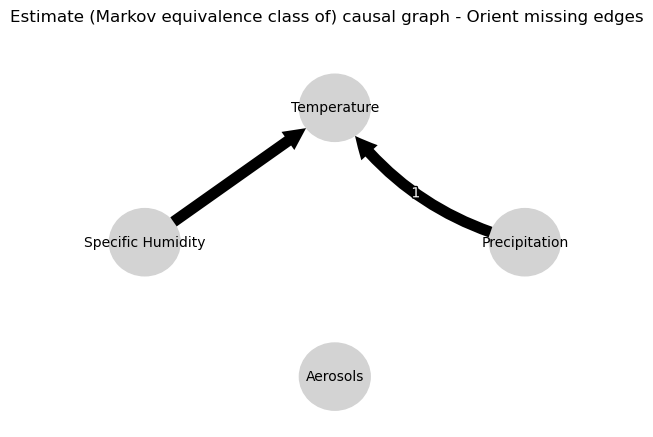

0.0
0.9958168617051055
0.9924675493935656
0.9892842415033165
0.9861947406234861
0.9833179638955463
0.7489688650560609
0.7502053926095662
0.7512648272847602
0.7522091921690891
0.7530724978298476
0.753869189079255
0.06600345592346052
0.06567485938867729
0.06541049468689325
0.06514851524645525
0.06500734054853474
0.06482867835879834
-0.03404307758058666
-0.03379772845418883
-0.03357562971832957
-0.03334148731200384
-0.0331328053525772
-0.03294149560982937
0.7489688650560609
0.7473851537293836
0.7458629339099488
0.7443950690300217
0.7429550110399492
0.7415364462567956
0.0
0.9987379681976626
0.9967268832688209
0.9942903125088352
0.9916169990541235
0.9888629903824256
0.4327749603673883
0.43054448407400214
0.42844437423363907
0.4264990599523959
0.424729654547534
0.42299502636329933
-0.02126255013976356
-0.02132988597425138
-0.02139211560310095
-0.021412731925939288
-0.021410539410078745
-0.021413131857212945
0.4327749603673883
0.43391452828576665
0.43431748994704544
0.43427613823865924
0.4339

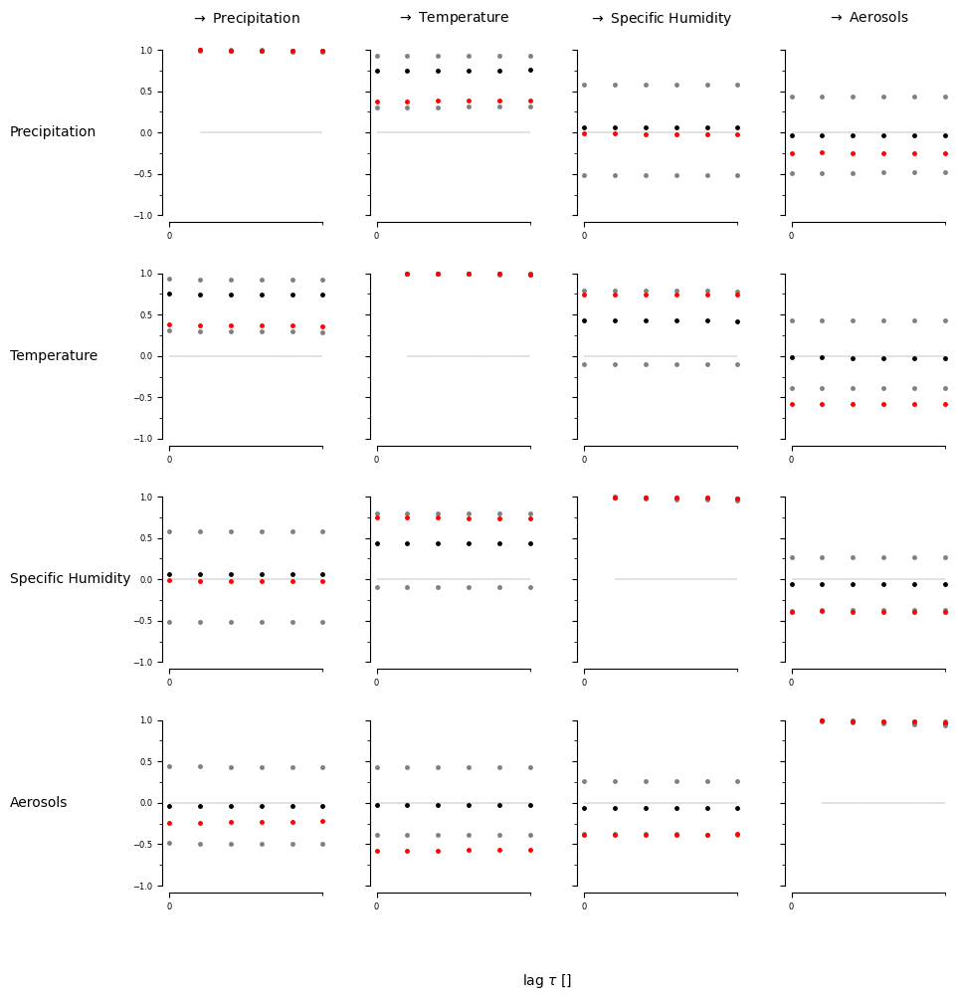

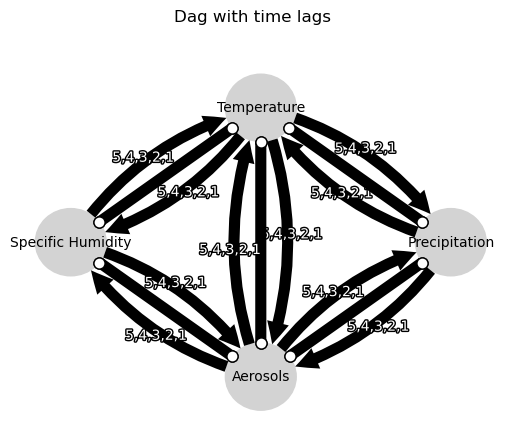

Negative precipitation values: 0


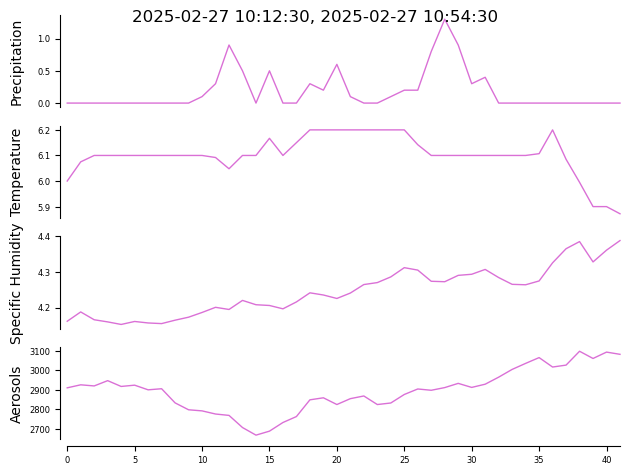

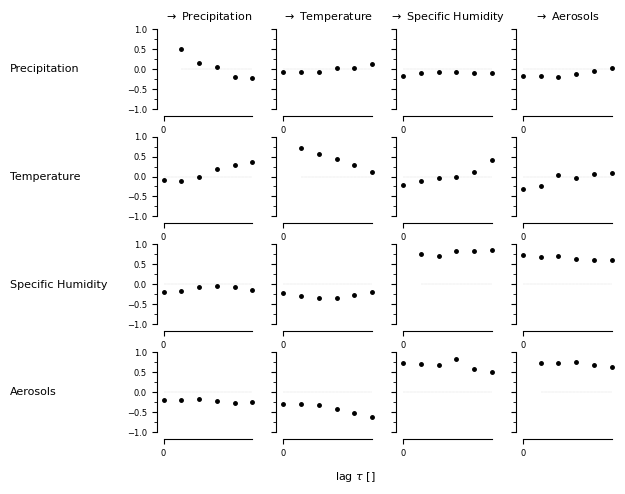

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


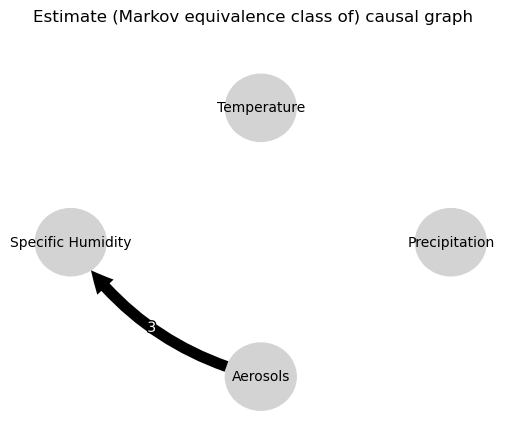

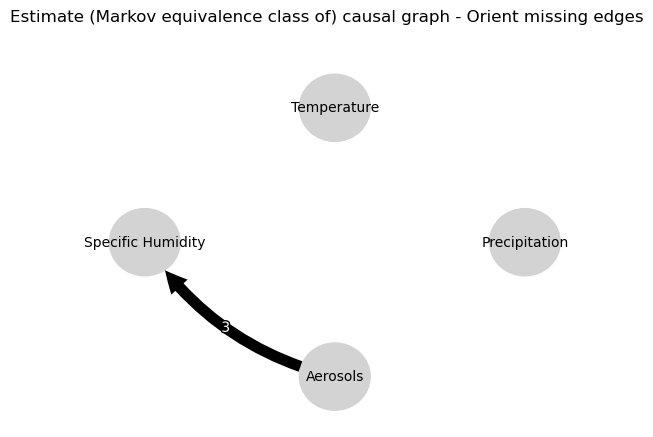

0.0
0.40907545105292775
0.17322284753720116
0.06692368278893611
0.0066447286248939655
-0.0333089460720836
0.001447785333452658
-0.012209241021424656
-0.004096820992098513
0.013743368295993087
0.04443195090128832
0.07050696626210257
-0.005038757371726505
-0.021474802164699124
-0.07353346650707795
-0.03909366069391708
0.037269997311505446
0.00065271856166371
-0.08849041419585156
0.014329531068989194
-0.038631501589386816
0.0002006821073556353
-0.005246149937264064
0.005022930746049016
0.001447785333452658
-0.014407682022889471
-0.03029793499106708
-0.022627281360048254
-0.004543184607393341
0.023041021742203783
0.0
0.6630356348537956
0.5104175256282325
0.4064041694043006
0.33247399470755523
0.2775082293865239
-0.11414856088270221
-0.022275883952715247
-0.04246878789323533
-0.03963262439487489
-0.013703571837850915
-0.03589790193960761
-0.13328895507638477
0.09382243625148716
0.04090788104618498
0.045007215963840934
0.052380790794708885
0.05322536213859344
-0.11414856088270221
-0.09396817

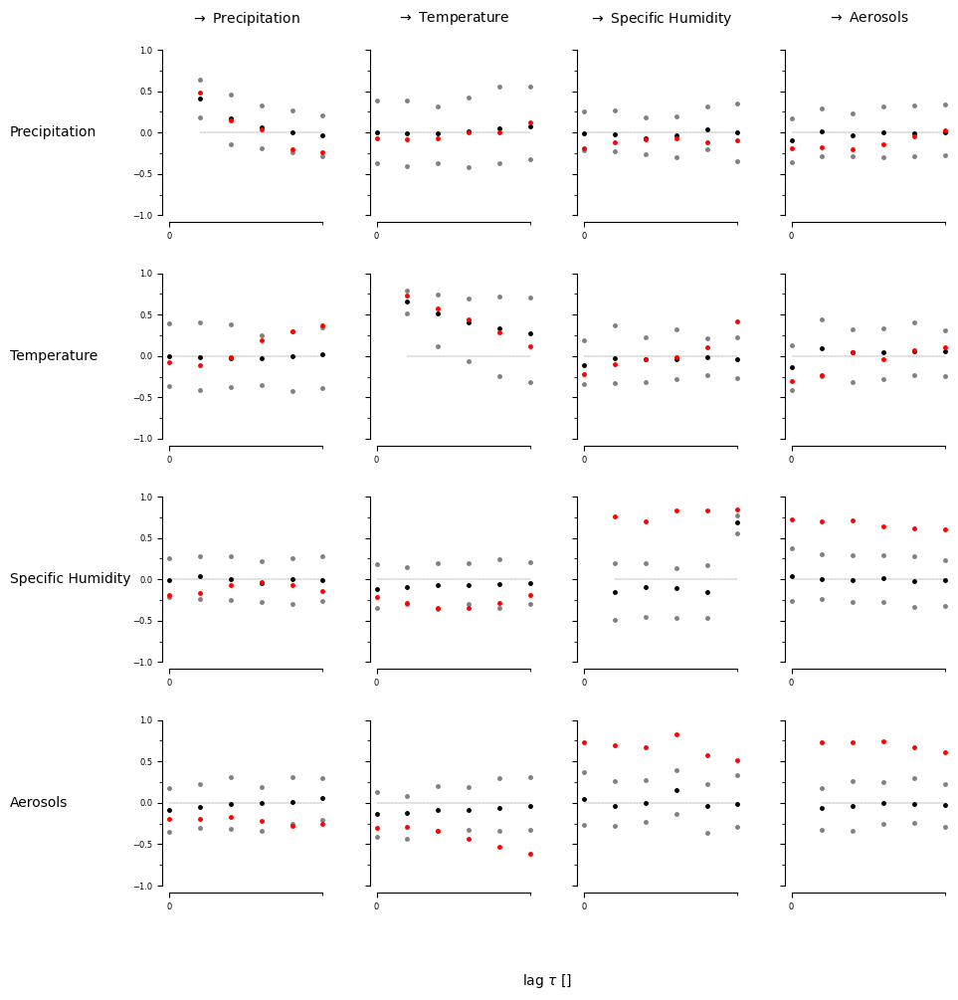

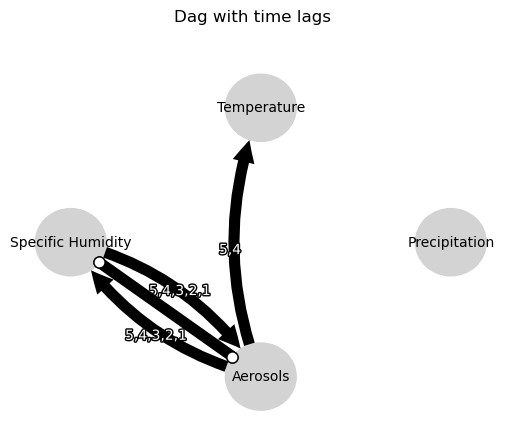

Negative precipitation values: 0


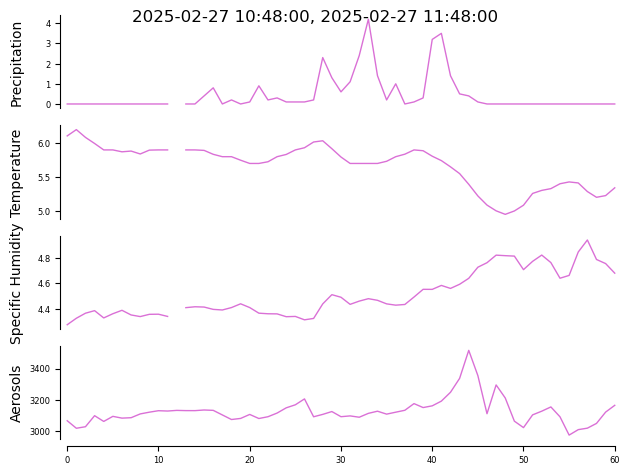

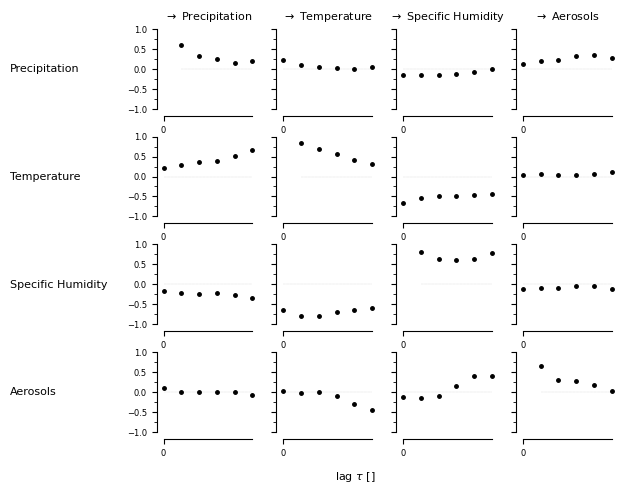

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


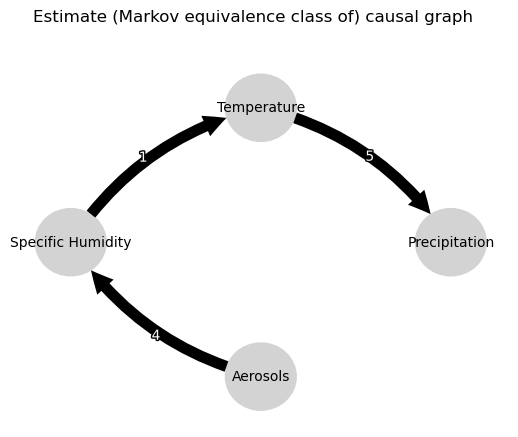

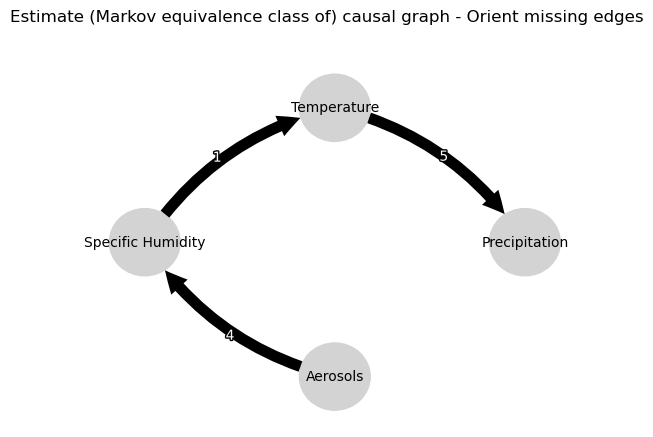

0.0
0.47453848480014565
0.24986688297333612
0.14547783927853009
0.06068797970076365
0.021992409159582324
0.14467376233857235
0.07888471340449892
0.05338040975878216
0.051666423752353224
0.03509700402753734
0.034985036600079164
0.035406943123616905
-0.0051063451650991964
-0.03405351741068885
-0.04002356897240876
-0.047204858864374935
-0.015158053012224719
0.017693938605720872
0.03733320261995566
0.02156943256904721
0.022082474685415004
0.032806493742171317
0.04884315908354231
0.14467376233857235
0.14075025219889797
0.15402861332162684
0.16966992848043236
0.1609806146590046
0.15165490710445365
0.0
0.7497300931869924
0.6259780536205711
0.5122509394389132
0.4306817600783941
0.38047523774326547
-0.5474949299078672
-0.41545263266147087
-0.33580829426065917
-0.3165676924413654
-0.3056321368799136
-0.26364833319153363
0.12455372230105433
0.16886735761035593
0.18917439819896542
0.21268699575573966
0.19919770174385043
0.19473857728298294
-0.5474949299078672
-0.6336168675240145
-0.626113109794199

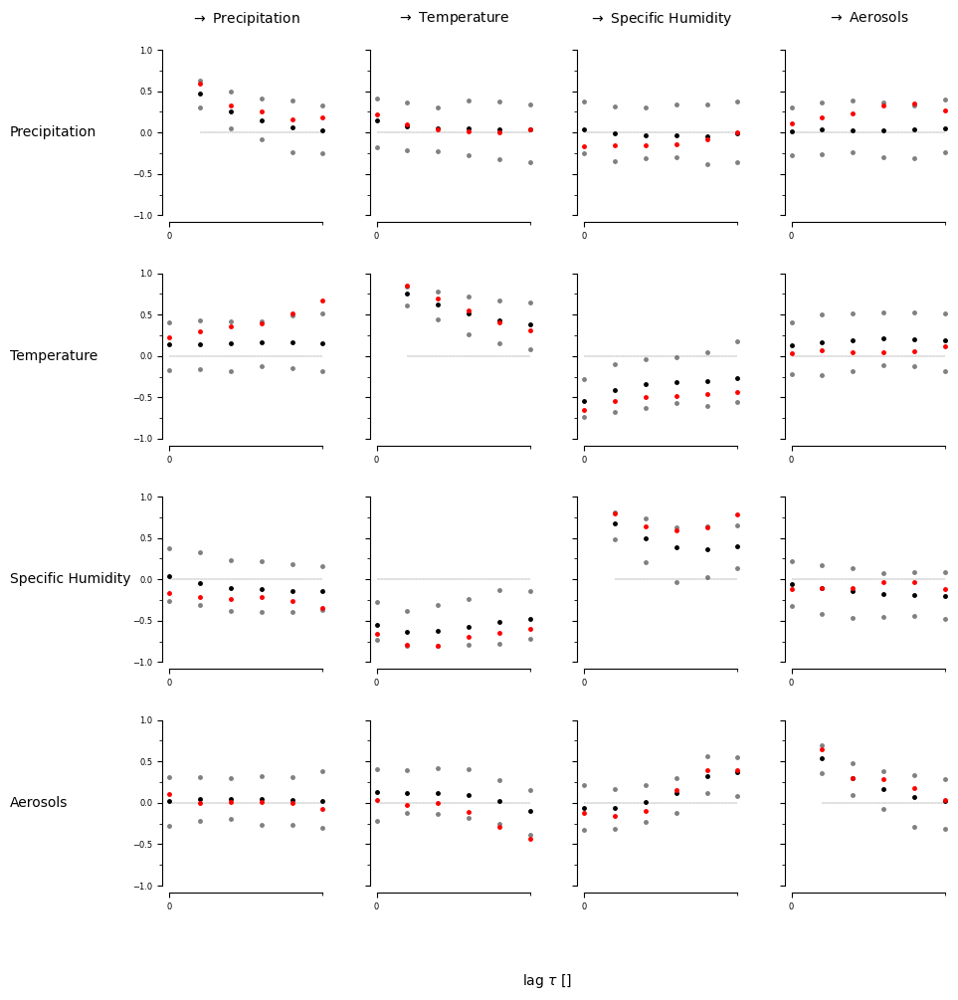

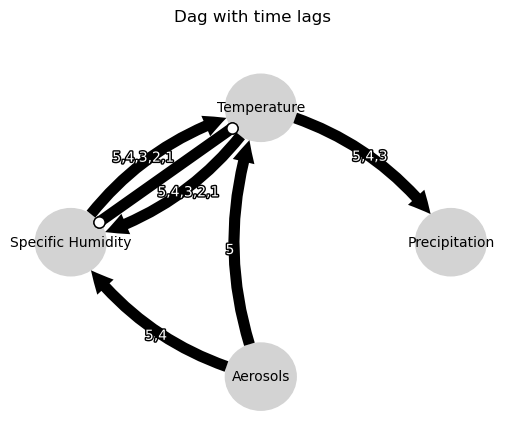

Negative precipitation values: 0


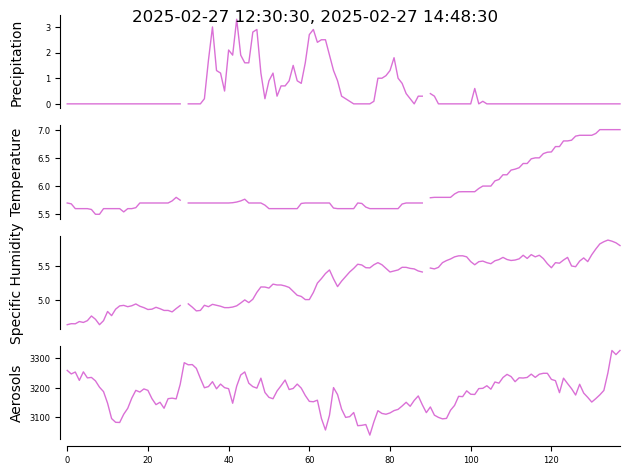

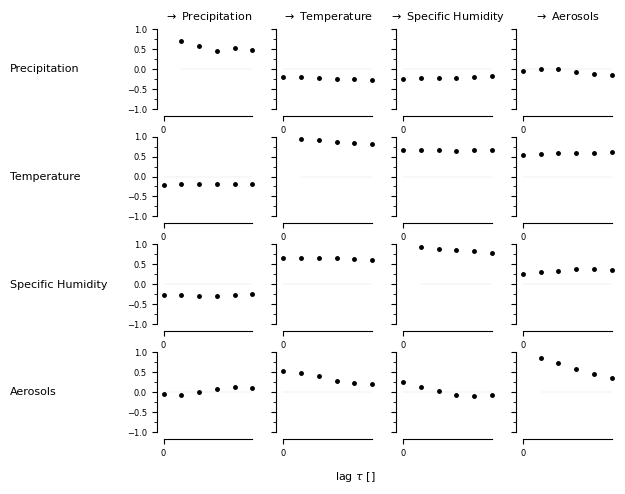

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


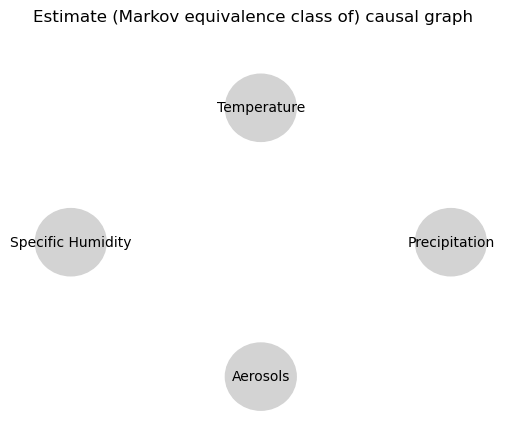

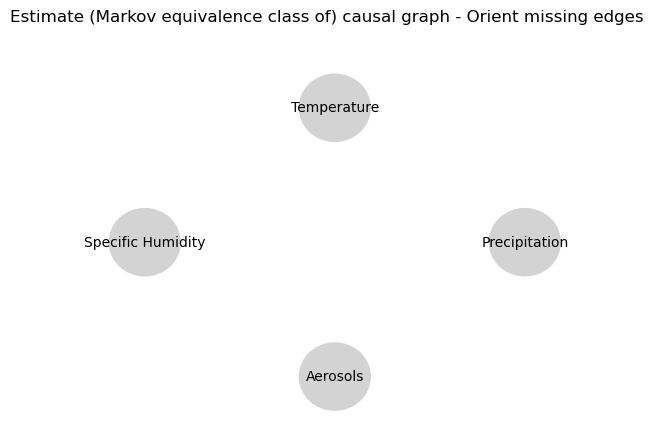

0.0
0.7622509069960214
0.6267937435376627
0.5543214579114588
0.5286827246540566
0.4873569539853521
-0.02365200243194022
-0.020024176809838045
-0.018002085285942958
-0.01339301779461683
-0.011774000024190094
-0.01230653492338424
-0.04312322982265297
-0.03229586667256206
-0.024059731788028272
-0.017632122829437515
-0.012050133501430573
-0.016982149440514526
0.004766649598054765
0.0029644836757471626
-0.0028139878445065645
-0.012680003805817838
-0.025680907268765932
-0.0348727253628997
-0.02365200243194022
-0.02690118129788581
-0.031629960975635765
-0.035598456787789334
-0.041394339964812434
-0.04289520650653736
0.0
0.9646971609087047
0.9444271437463311
0.9334809930482802
0.9247039766730631
0.914069255517403
-0.005886860893063386
-0.013026727768523849
-0.01746757892979953
-0.023733807332276223
-0.028077281438156253
-0.03177397341632176
0.02051973967005867
0.020481092537155465
0.0182333751826986
0.015858254420759013
0.013492250570238007
0.01063868368490593
-0.005886860893063386
-0.01081782

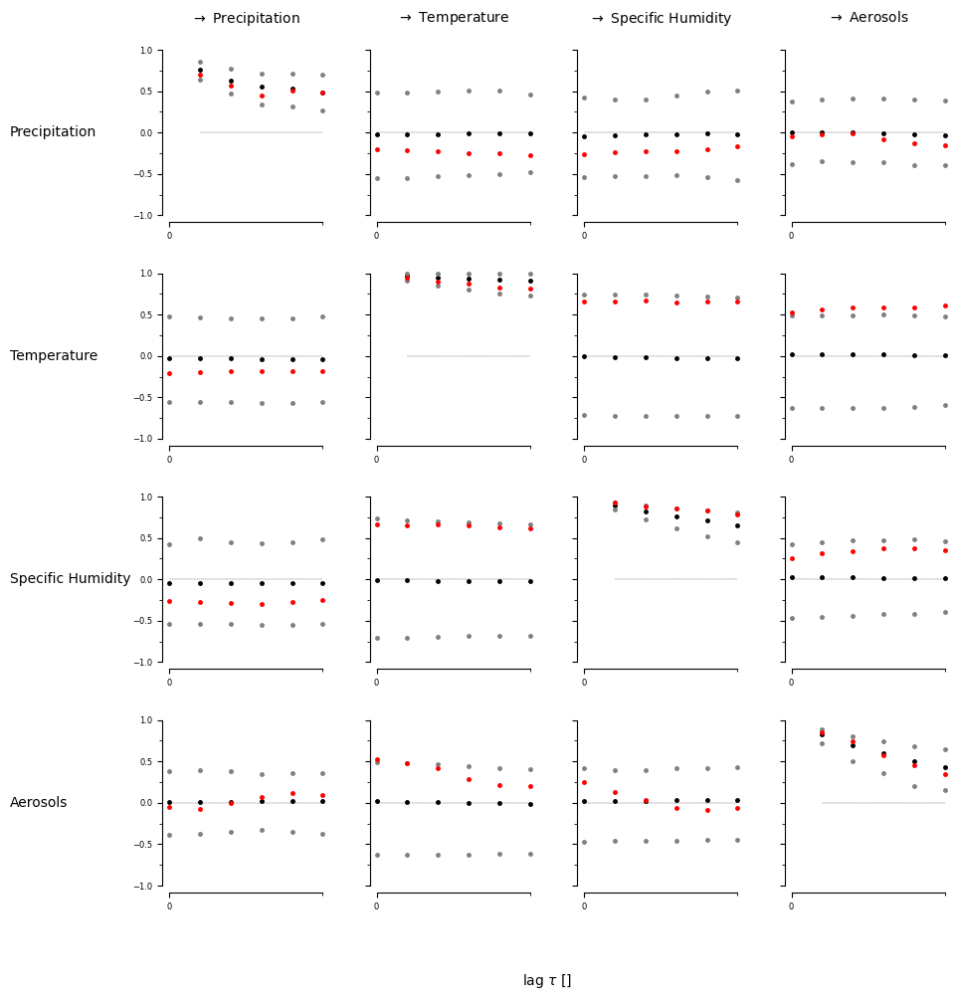

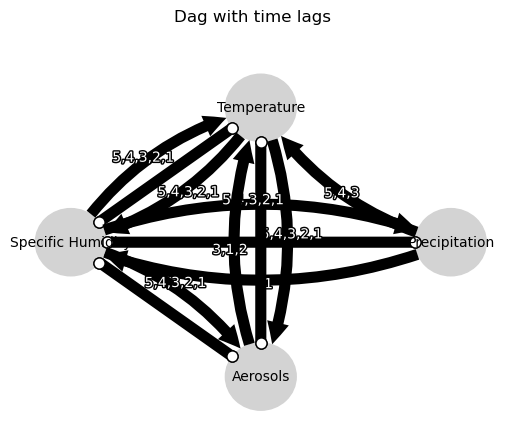

Negative precipitation values: 0


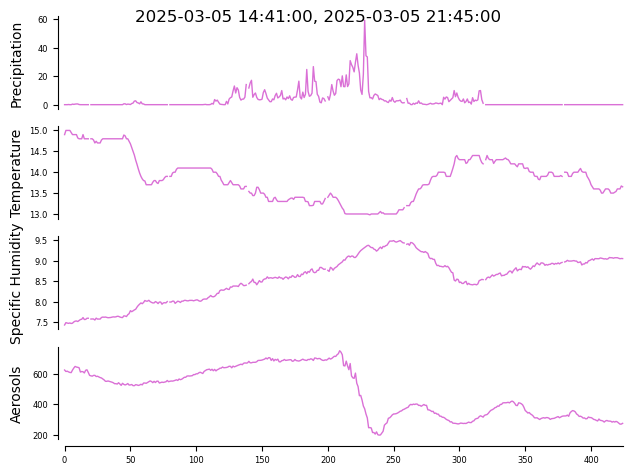

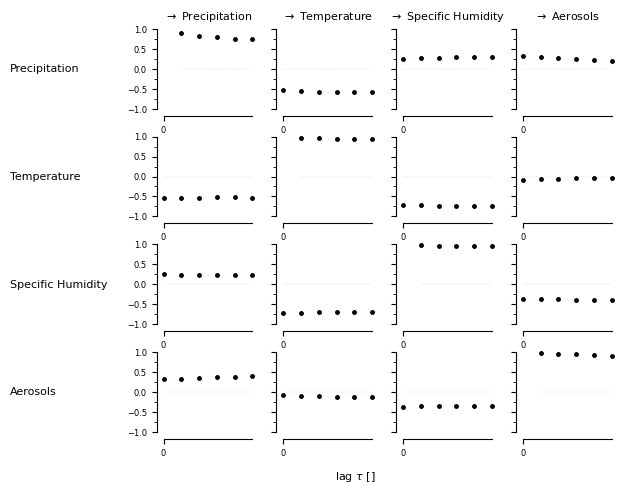

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


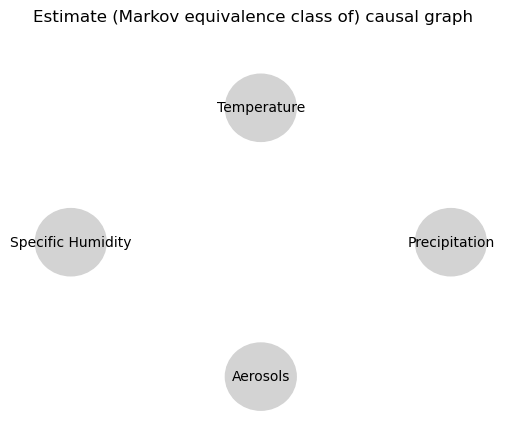

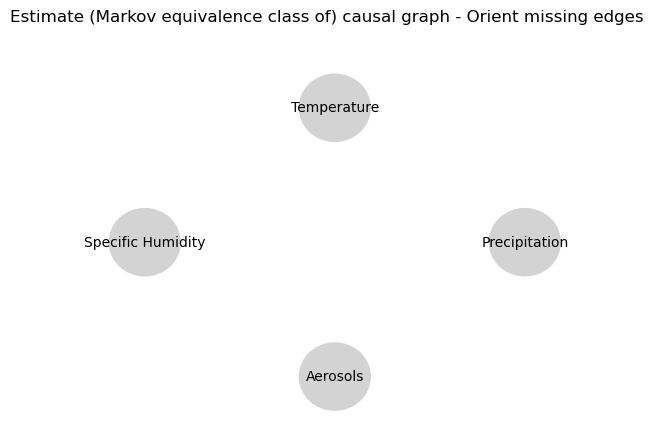

0.0
0.8128121554791974
0.6677075685880447
0.5481292701768351
0.4501022427134707
0.3671300534222952
0.0002590334975868874
0.0026339633172347745
0.004707361986621409
0.005498361033156333
0.003998115085228535
0.0036471430219921345
-0.03459174669243281
-0.03473975183217097
-0.03458232081971891
-0.034173987661643555
-0.03382308757866324
-0.03225049887657677
0.04999607546834941
0.04950877974921324
0.048012048365630354
0.04595342948552178
0.04269284122134606
0.04054290958580518
0.0002590334975868874
-0.00022935388616143913
-0.0001615448592336466
0.00046850394001815343
0.001186732372970391
0.0003458875381783938
0.0
0.9605332777466475
0.9315522774387271
0.906196131948272
0.8821487686261418
0.859559214230758
0.04797944596773636
0.046368227080724064
0.04424212333513113
0.041369370133522494
0.038549868786447374
0.03596420052531454
0.09928625162592139
0.09910006268904564
0.09942743836791461
0.09922688550478012
0.09907931225056593
0.09961199293314874
0.04797944596773636
0.04781101447953098
0.0476598

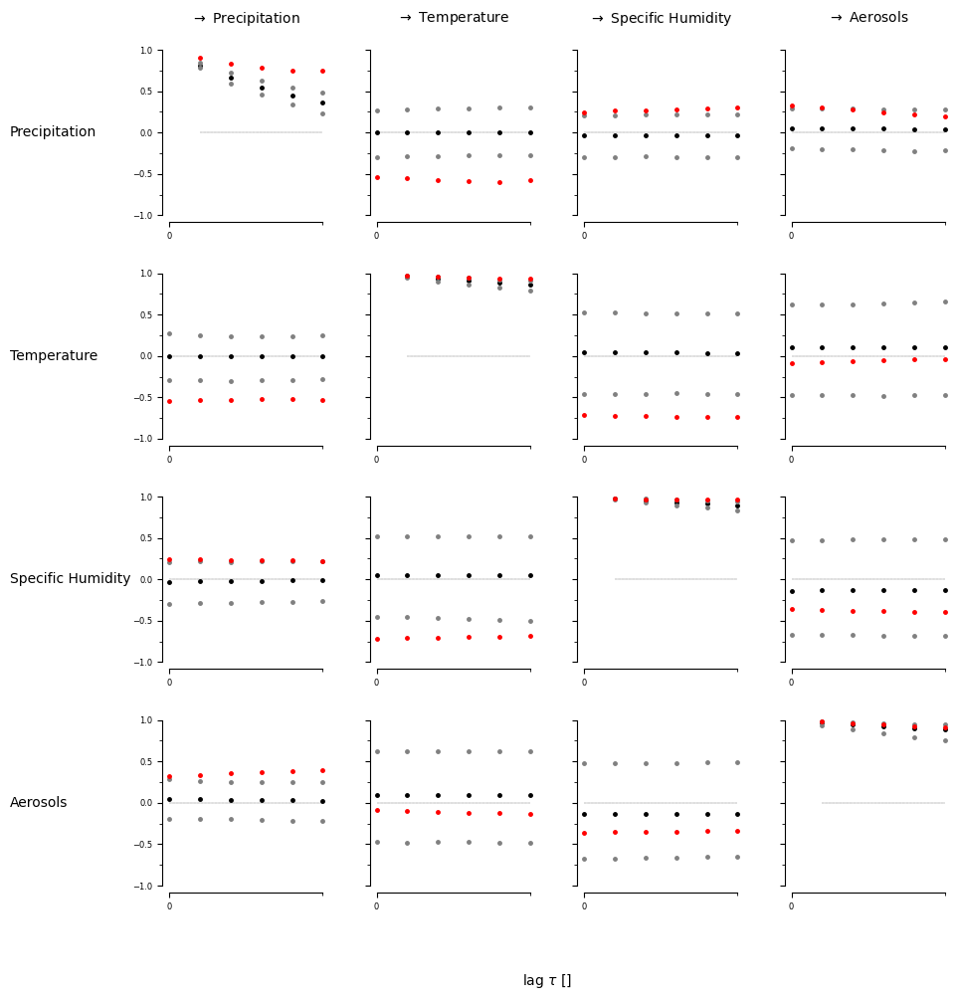

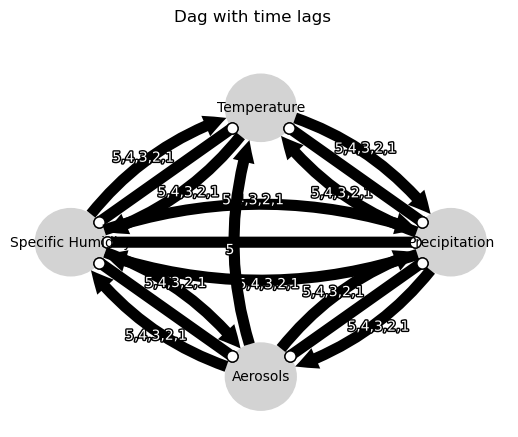

Negative precipitation values: 0


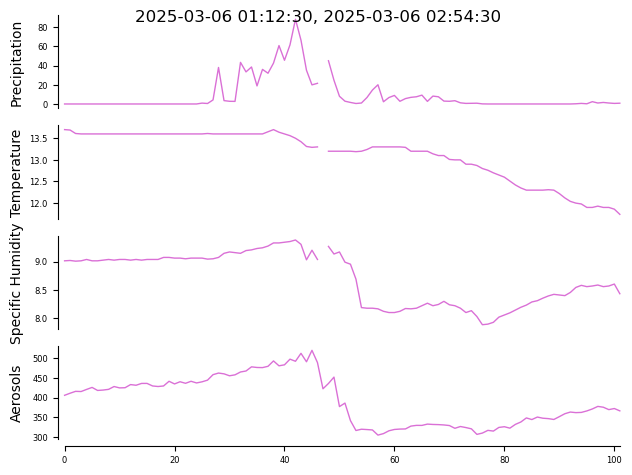

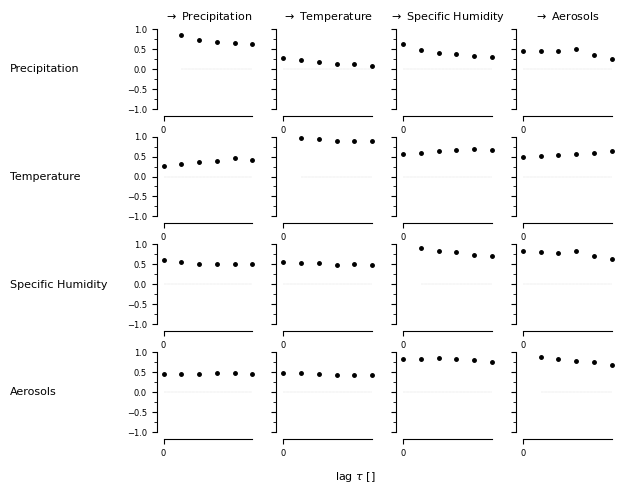

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


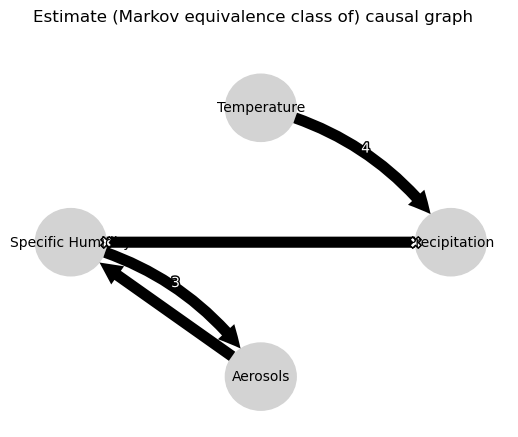

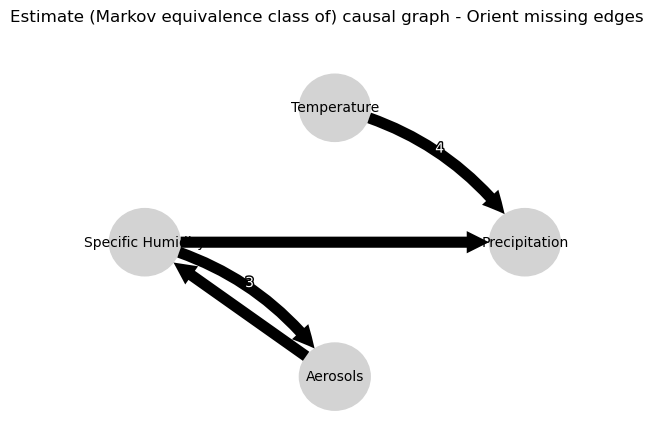

0.0
0.7090554195575767
0.5325791757258012
0.39956129916458605
0.299926243938673
0.22940343664598462
0.1387751690923323
0.13647544784409998
0.13502001660000323
0.12891611408666534
0.12442961547244222
0.11853914863152624
0.15427784515359344
0.14711461450518268
0.14901616364636464
0.140748664667463
0.13475787891574448
0.12179669422198684
0.11039639130407392
0.10579741393856887
0.11315210117260444
0.11412549434203008
0.11895090528421771
0.1151781982734159
0.1387751690923323
0.1413087706860549
0.14117283185864943
0.14017656621198016
0.14602449083453797
0.144926113236838
0.0
0.9453172602333217
0.9241964640669825
0.9075392792971134
0.8931387171282238
0.880622498962814
-0.08138464915748164
-0.09793278129247138
-0.112037901713522
-0.11841814054755115
-0.12692780574222184
-0.13267813183290714
-0.09162835733916012
-0.09165415378801345
-0.09361166860223212
-0.09777133044412901
-0.0995843220311029
-0.10451989322147977
-0.08138464915748164
-0.0841206252938367
-0.086817718650657
-0.09644115350948901


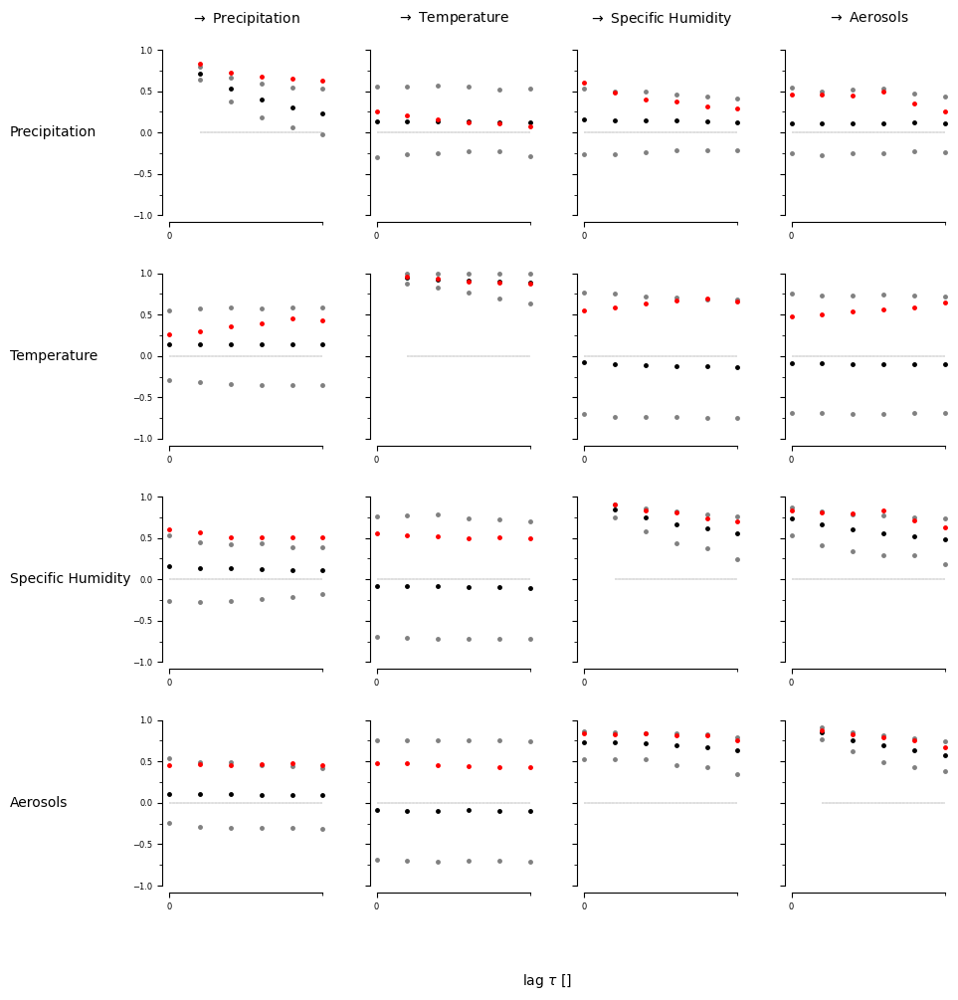

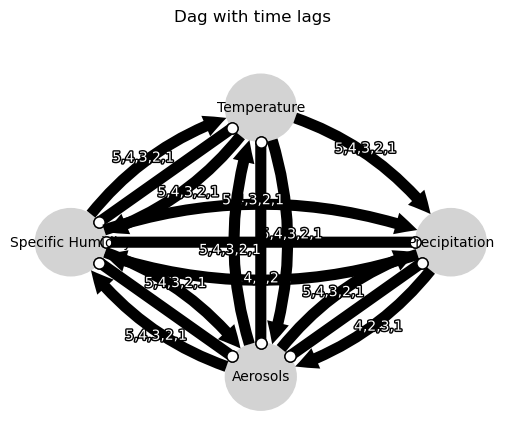

Negative precipitation values: 0


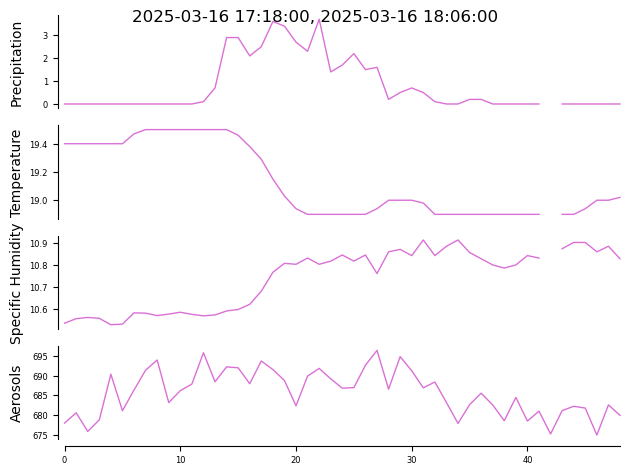

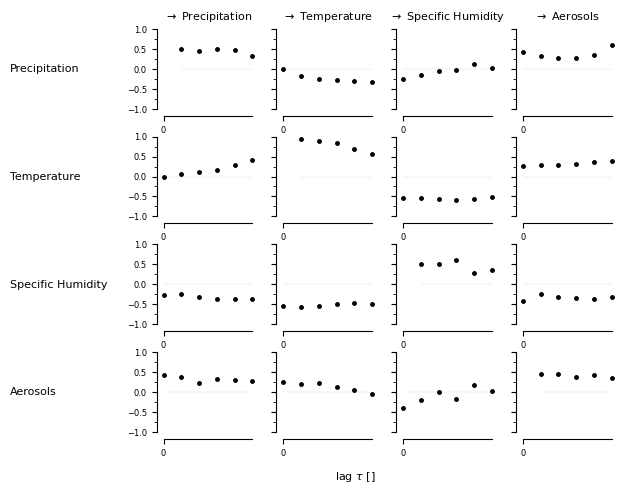

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


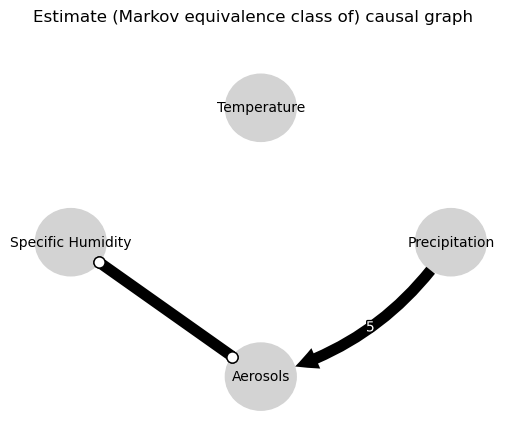

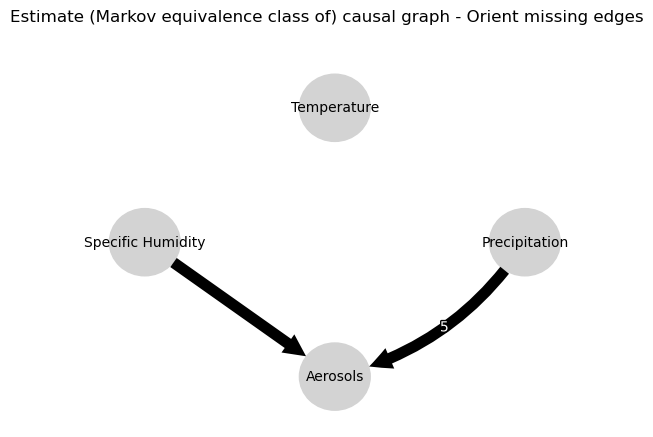

0.0
-0.015999499622985074
-0.04346058500289596
-0.01918261165585257
-0.00260670606382146
-0.005005294835247695
-0.1916311139344375
-0.15624885559454735
-0.13220275339000329
-0.13129895319321017
-0.13432923303943278
-0.10330012587832714
-0.04799456728796307
-0.009261931093096873
0.02763264686994352
0.030188182397712593
0.06026495923261834
0.028659700320115507
0.1330585790527178
0.01649157565670325
-0.06230802270273614
-0.03126513734445342
-0.06690649040801948
0.46140205076516777
-0.1916311139344375
0.11197078554813931
0.07994750934694757
0.03906195729490614
0.049095355748565946
0.045685579324713094
0.0
0.7129178024213387
0.5869790326638913
0.4974573414283
0.4152529158745477
0.3460950988426269
-0.07405392728598462
-0.013413639714928639
-0.01685907091984876
0.0051941108536714365
-0.007979239564291704
0.023009268463945926
-0.018770723002475617
-0.02744454909943628
-0.02577241165265639
-0.06416097737866826
-0.07957936053871403
-0.1253600533123783
-0.07405392728598462
-0.07268130002452
-0.06

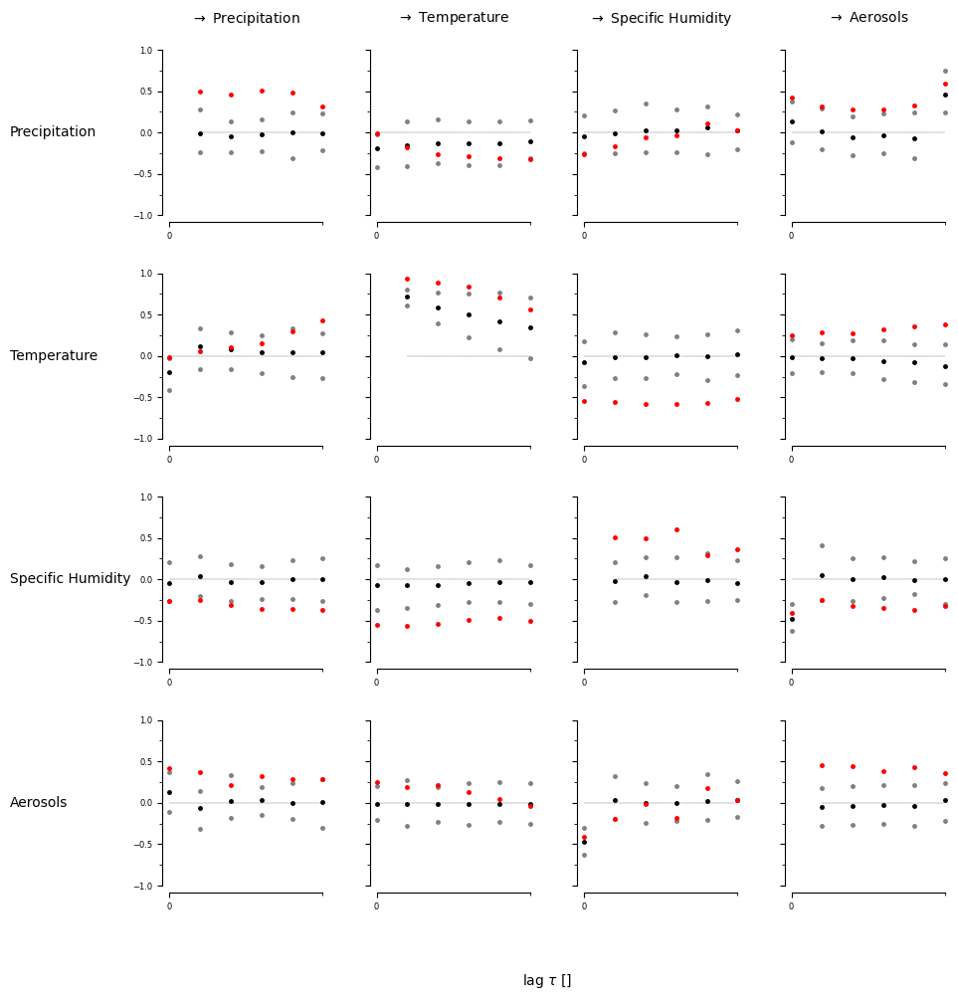

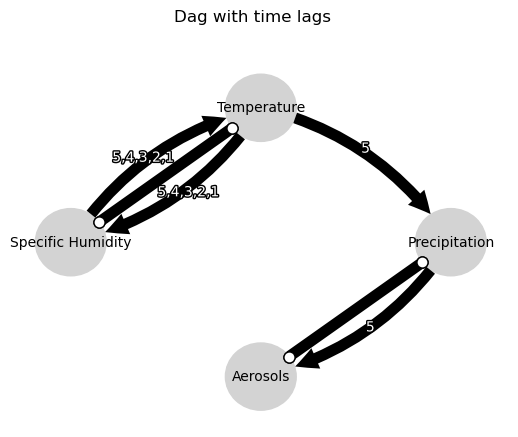

Negative precipitation values: 0


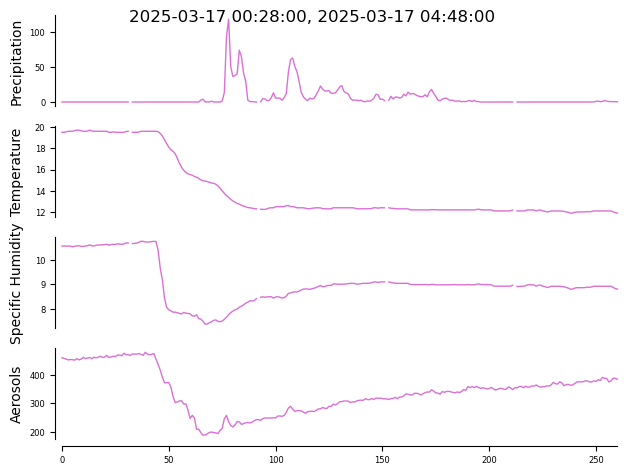

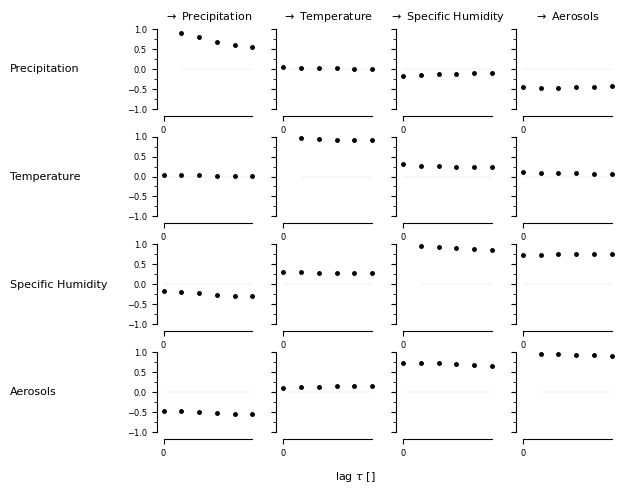

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


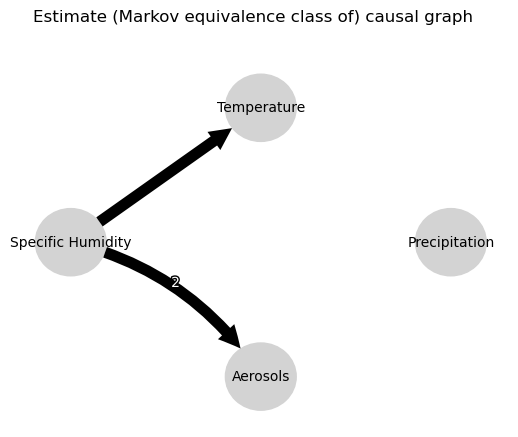

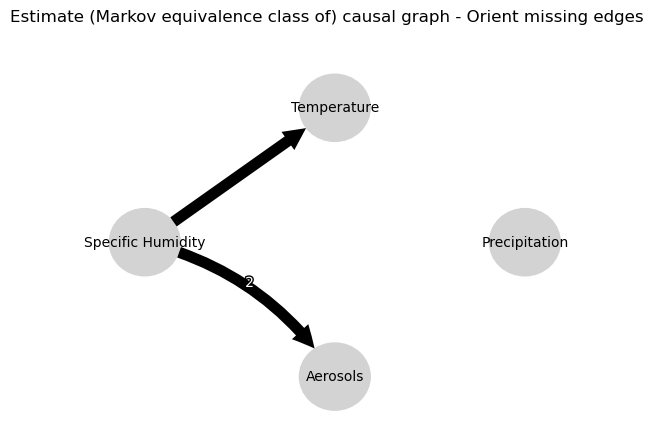

0.0
0.8012605342351491
0.6519860581544951
0.5321422849559917
0.4319536253778831
0.35061140162066495
-0.016957688280072058
-0.01585305186021819
-0.01377191377369667
-0.011929074268648589
-0.009258714272734427
-0.004300441577046413
0.05627915926970123
0.05753866649008958
0.05814578194956422
0.05946135436366565
0.06099968015328996
0.06258538264096106
0.04393208764314995
0.04697247059685649
0.04974389637362909
0.05215975967757968
0.05293517084617268
0.057835154619688606
-0.016957688280072058
-0.016176005670295236
-0.014768175667192978
-0.014172653062730195
-0.012981984663087517
-0.012520907108514253
0.0
0.9760807528403496
0.962069520774762
0.9493047945850409
0.9345932554591707
0.9188510534162172
0.6354236746372695
0.6040497288053521
0.5752883431960614
0.5497213401041168
0.5260686409912143
0.5048630053397433
0.5028683932385768
0.5008956381014014
0.4969231587618521
0.49423353297631256
0.4894177609247939
0.48467329444874446
0.6354236746372695
0.6520849095554992
0.6671477181730802
0.6803350395

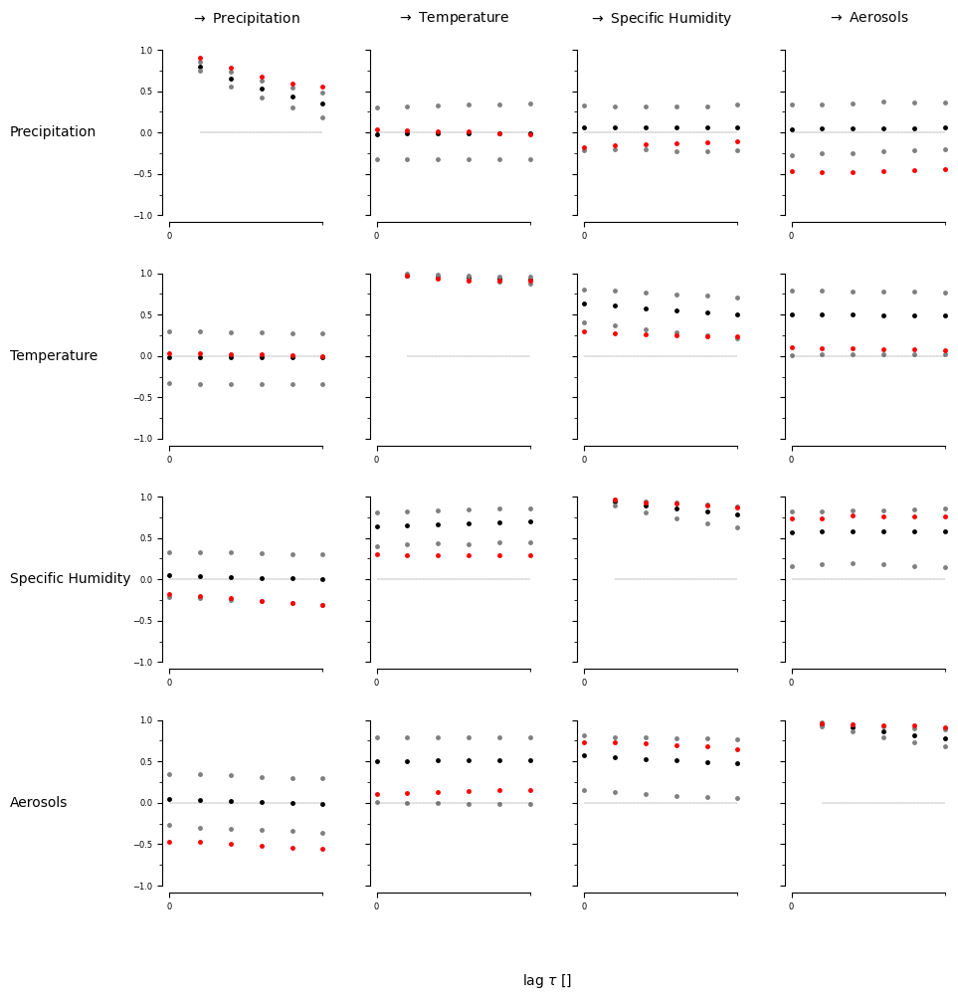

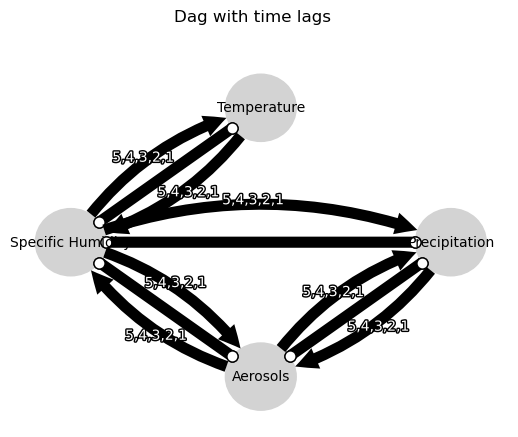

Negative precipitation values: 0


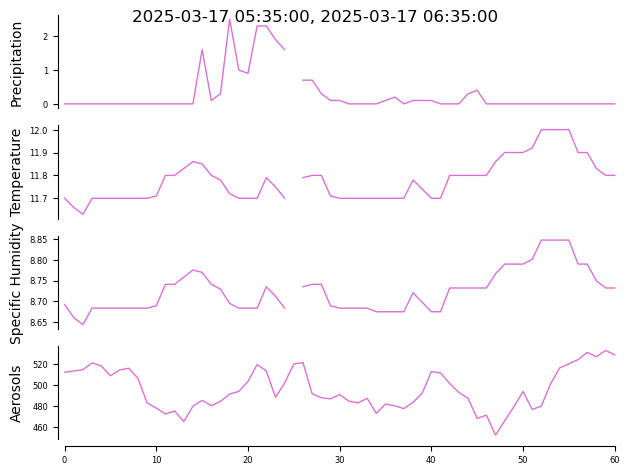

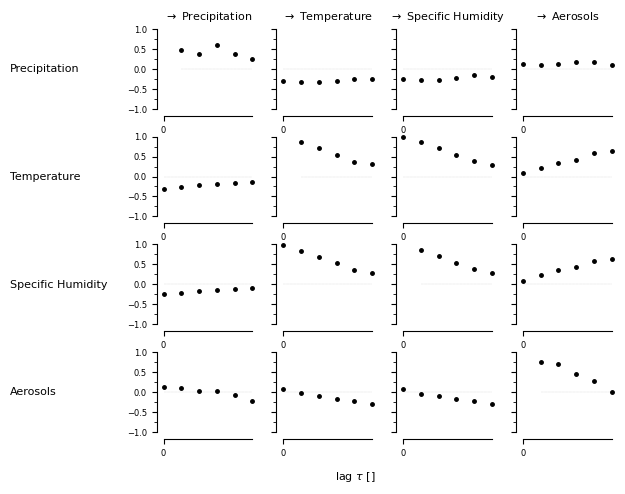

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


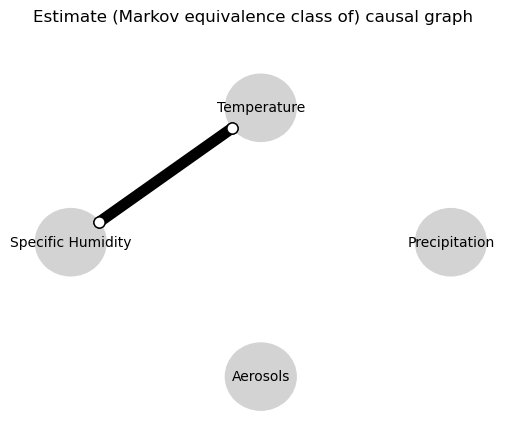

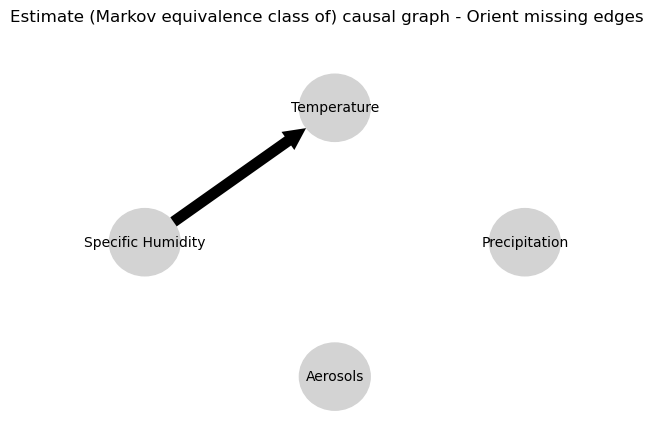

0.0
-0.09052015059904245
-0.10454048668583779
0.6437402068280165
-0.07250071171346739
-0.10336431898303414
-0.03897729530935655
-0.00935029222421611
0.025394428782161187
-0.007282295326810267
0.014469908414399279
0.030838753192002143
-0.028972565396776902
-0.009359663807153338
0.023089140460154978
-0.005499038470362114
0.013503966536291828
0.02740894863637627
-0.012428563647359826
0.003324160912102799
0.012349857268132439
-0.015133966480016994
-0.01769438393703009
0.010630502868252917
-0.03897729530935655
0.06355850181957029
-0.01206022780339465
-0.06130421103645379
0.013879206669471806
-0.015767563235961367
0.0
-0.019176912876480812
0.0035937496473077103
-0.02200321399237669
0.009206917338808653
-0.04065758657286275
0.9884040358050699
-0.015019110260459625
0.004949047242585543
-0.026660940220009376
0.008013158982817096
-0.042664373474202
0.0769486000071171
0.06800264391389195
0.062168663109678717
0.02961821321705736
0.03165558503494369
-0.006193132492096509
0.9884040358050699
-0.01667

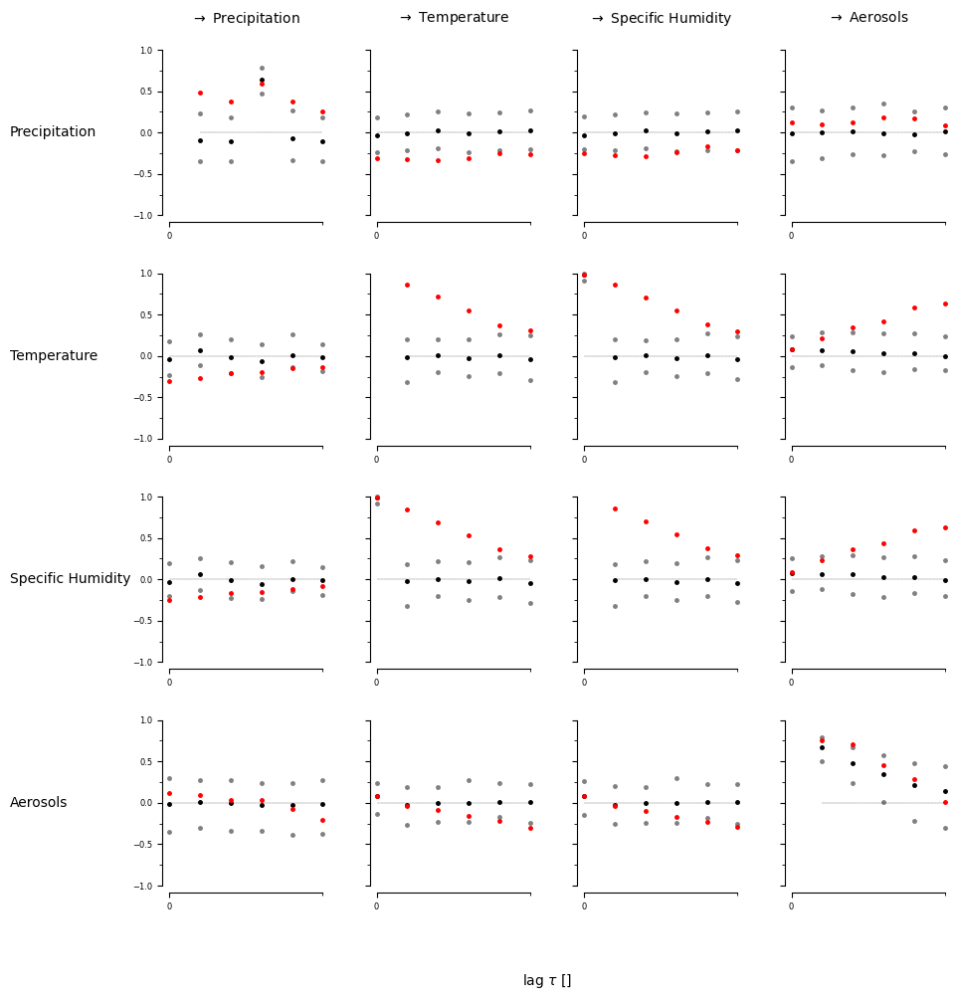

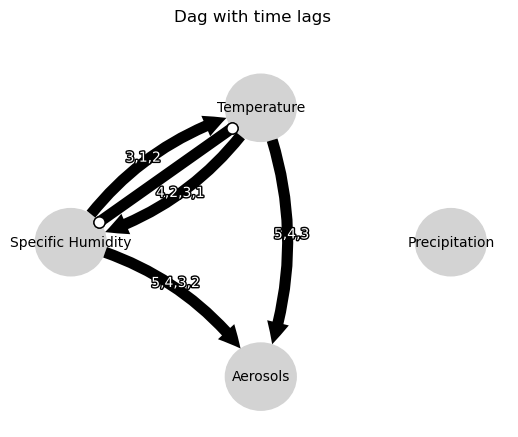

Negative precipitation values: 0


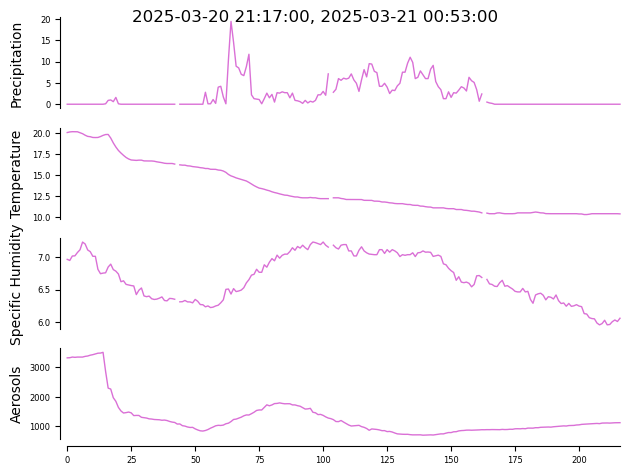

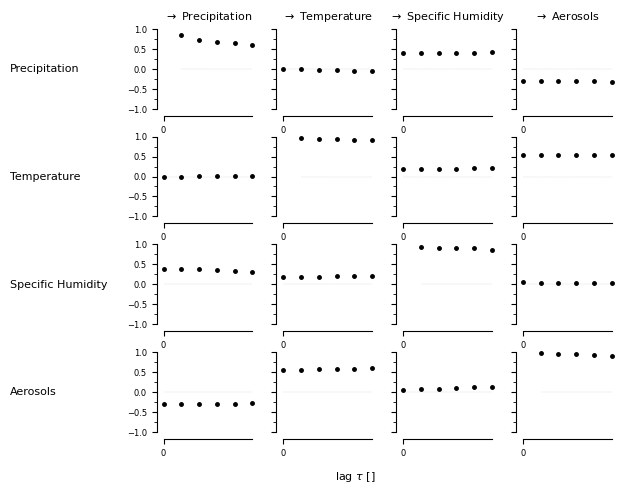

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


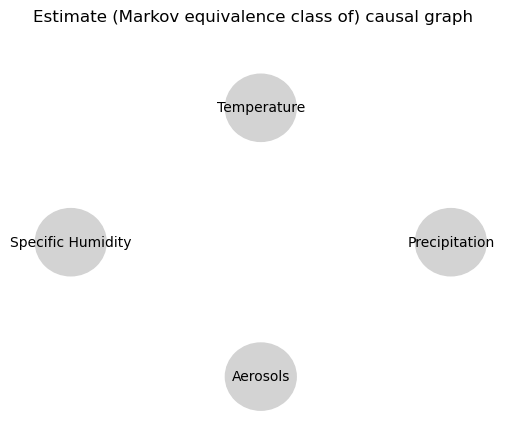

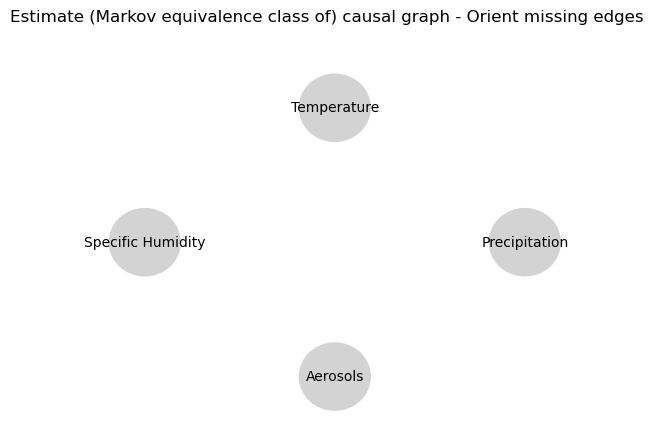

0.0
0.8310910865540242
0.7045959505003991
0.6038509073900251
0.5190462019036587
0.4447895389468545
-0.06528946843898925
-0.05945946795363622
-0.053774123452890746
-0.05053186884066708
-0.04695122006170927
-0.04527850073059621
-0.0003800791312017371
0.0038560961765997104
0.004757644988530621
0.004638119789046409
0.003636893380929207
0.005211811156396495
-0.06637301237465651
-0.06549817461685206
-0.0632601964207749
-0.05909512460062867
-0.05439501439996815
-0.05090498105056355
-0.06528946843898925
-0.05799933585215947
-0.05557365576000914
-0.053340146558833276
-0.0485960961019586
-0.044249658748107906
0.0
0.9302921396004794
0.8842423045140066
0.8414238632585215
0.8028992675975577
0.7650095801054337
0.005465972833820685
0.003282448509239558
-0.0016067940321886336
-0.0030496283037856754
-0.0034227832902649314
-0.004439642293911545
0.018059429153683085
0.018510739059116724
0.01967268935342107
0.02330483412168816
0.025187819457978714
0.026304523954152517
0.005465972833820685
-6.0784916830879

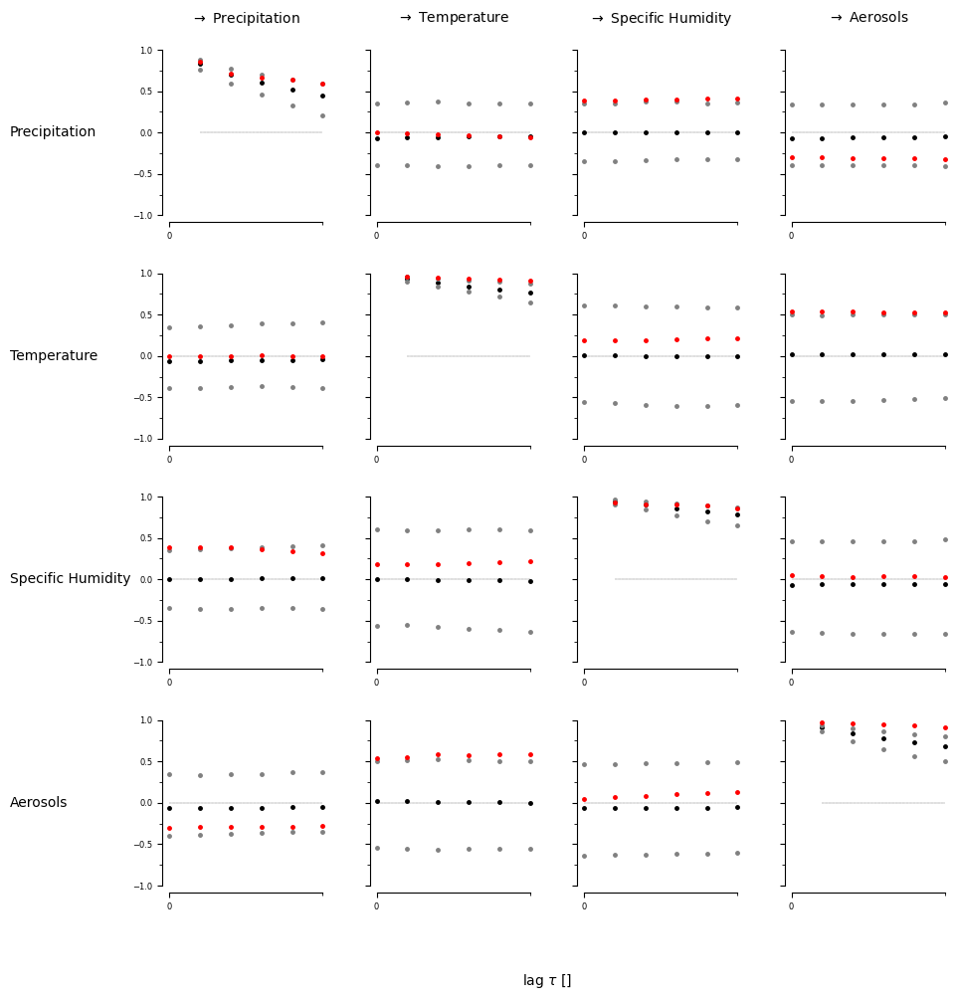

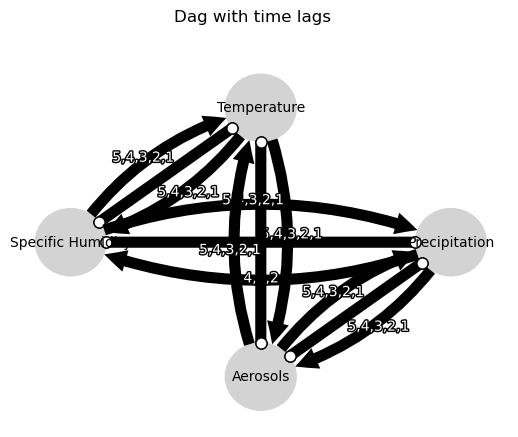

Negative precipitation values: 0


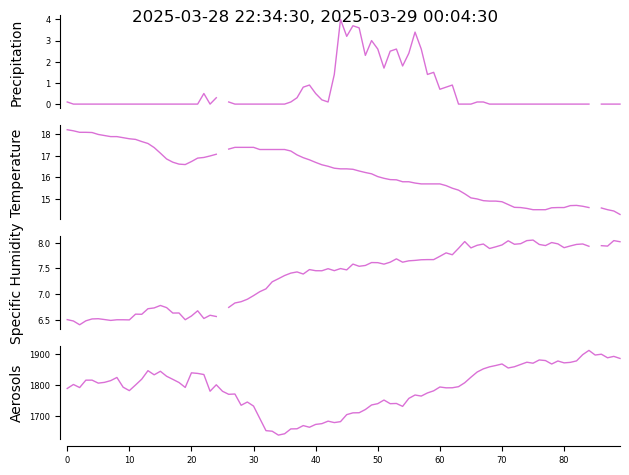

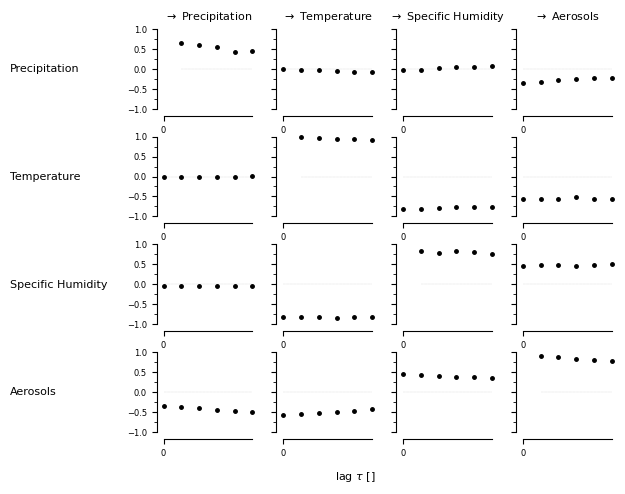

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


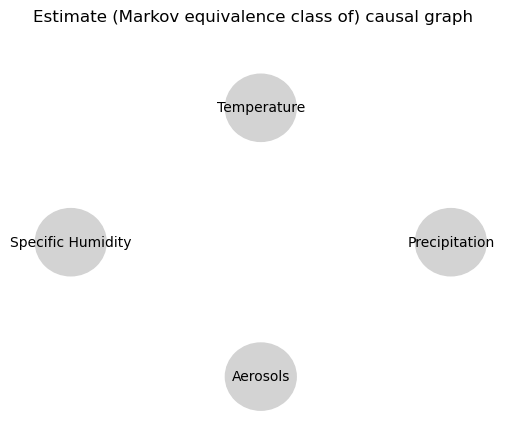

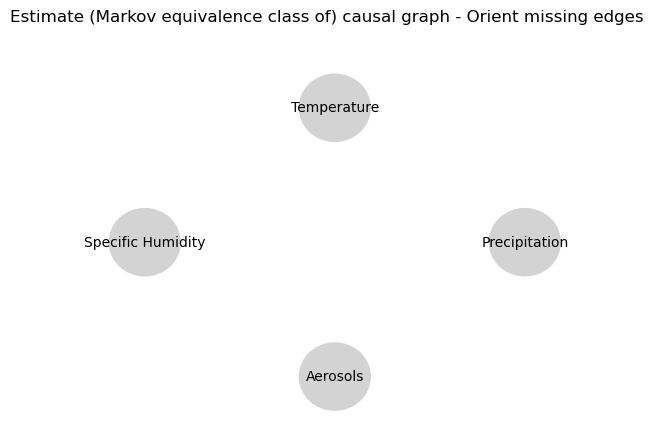

0.0
0.762701726439422
0.6210257152142676
0.5210078594142381
0.4316177386888328
0.3578145993816772
-0.08245447216107538
-0.06933408246056727
-0.057161699115890814
-0.04308695019862378
-0.033408581632159366
-0.03128244768067743
-0.014172915427502382
-0.011444551867483357
-0.011003110197992709
-0.021420623006082943
-0.023591673818130907
-0.040766813882837684
-0.016265648613694526
-0.029438292667287626
-0.04564553553860861
-0.05842098493491488
-0.06727920338141732
-0.07063976707805036
-0.08245447216107538
-0.08402333235606156
-0.0871351597632568
-0.09593329906295418
-0.09433833486201187
-0.10017528614336317
0.0
0.847221915002887
0.7660634304952871
0.7055049735725756
0.6514050001783452
0.5978398485683729
0.12623861141322512
0.114451688191367
0.09648850397461843
0.08247461309031934
0.0671726283938773
0.053048904749632406
0.045029483557611404
0.04077470001777405
0.0349577771986841
0.041060287100608536
0.04278376983775185
0.04360925669329581
0.12623861141322512
0.10941307151140442
0.0988995897

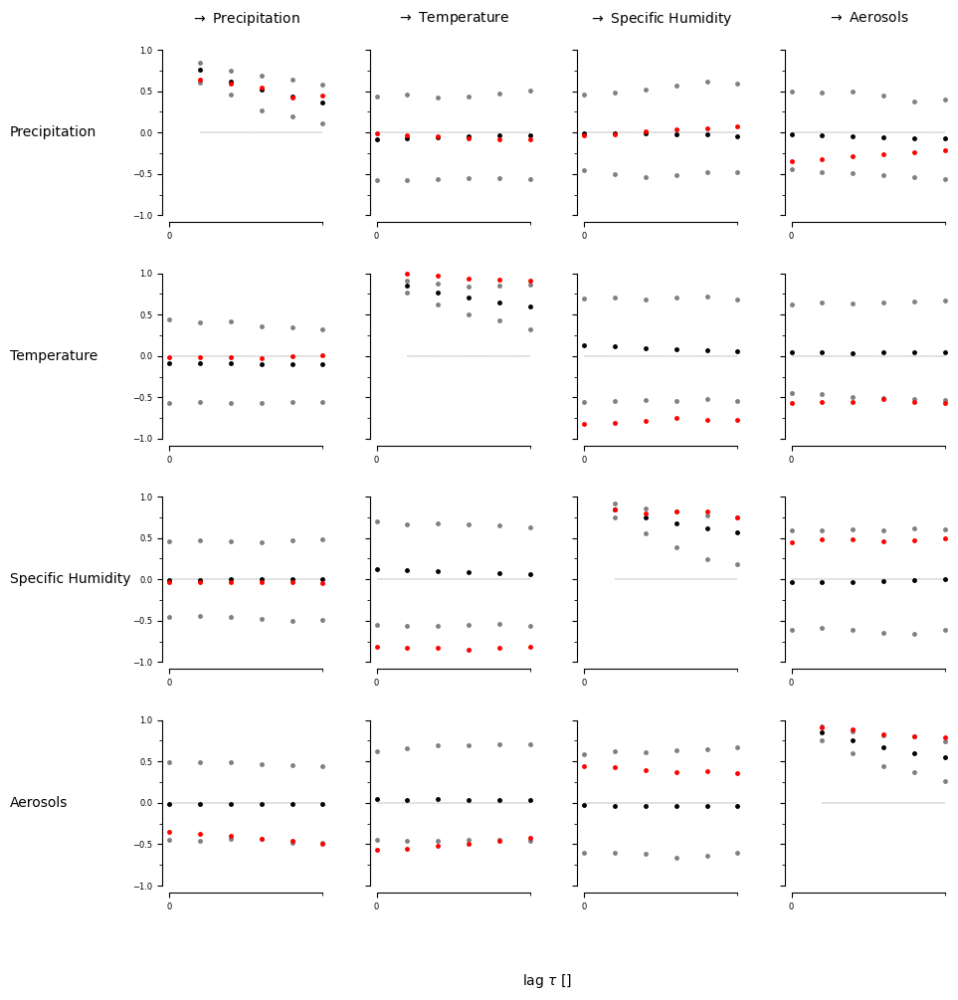

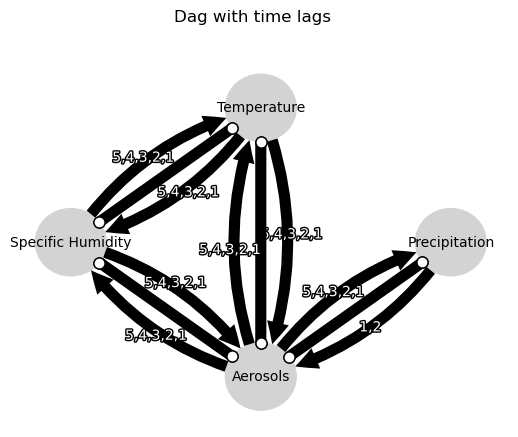

Negative precipitation values: 0


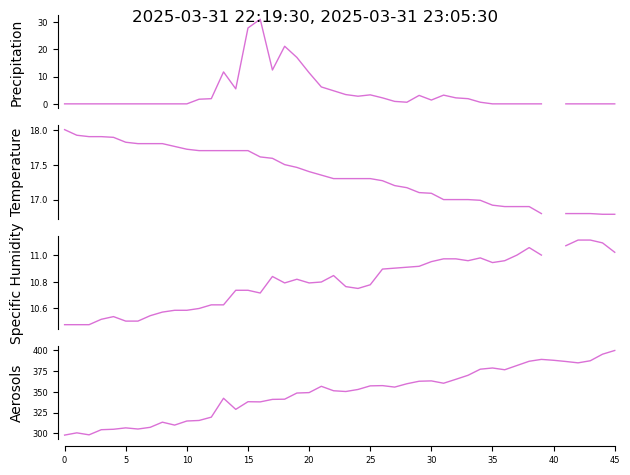

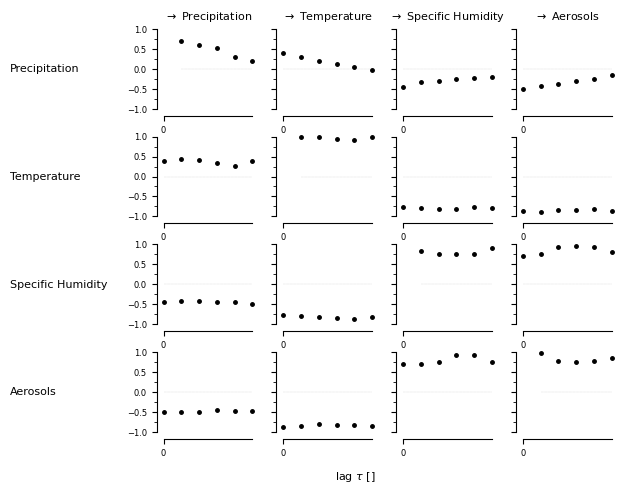

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


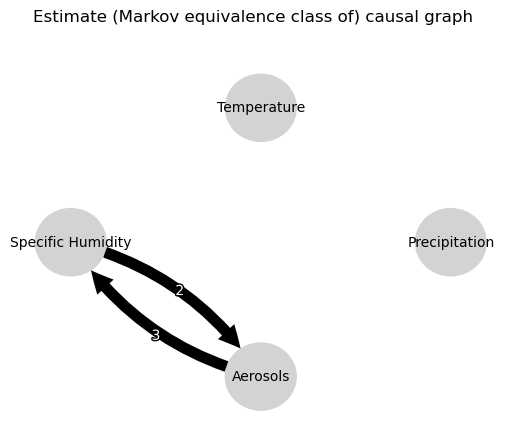

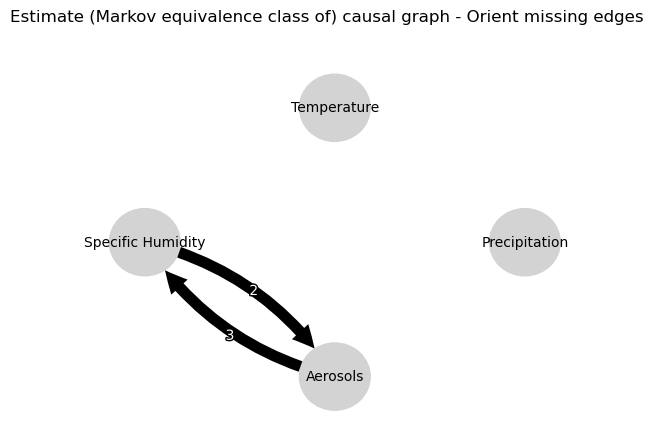

0.0
0.5316612593811654
0.30926920142262326
0.17044163325905326
0.0773363180111103
0.03228991694231323
-0.06199483878558023
-0.04627885959889901
-0.05451496989821421
-0.06505986199367288
-0.08839383663711818
-0.07776225064331901
-0.016685890779471958
0.021136599144720547
0.04299192955212174
0.050173911761348645
-0.021178907528785807
-0.011955701348329913
0.04083573161237698
-0.05433996918553043
-0.04331138997671289
-0.0038647629485363847
0.007499618159256056
0.026111153978489905
-0.06199483878558023
-0.042919745087563826
-0.043427453177238465
-0.026625138794264168
-0.04844044674039252
-0.06568463554660872
0.0
0.6937872374306079
0.5838032628296955
0.48581417989158915
0.42478103287638197
0.35727018621915496
0.01935304930183802
0.006954990997560403
0.044229982187616715
0.03859453206213719
0.0011518030744716646
0.04130303007825062
0.0381104180723361
0.006763947425254327
0.03014726284837099
0.023004324000431068
0.03527915004839671
0.034735412233949686
0.01935304930183802
0.02597689950010394


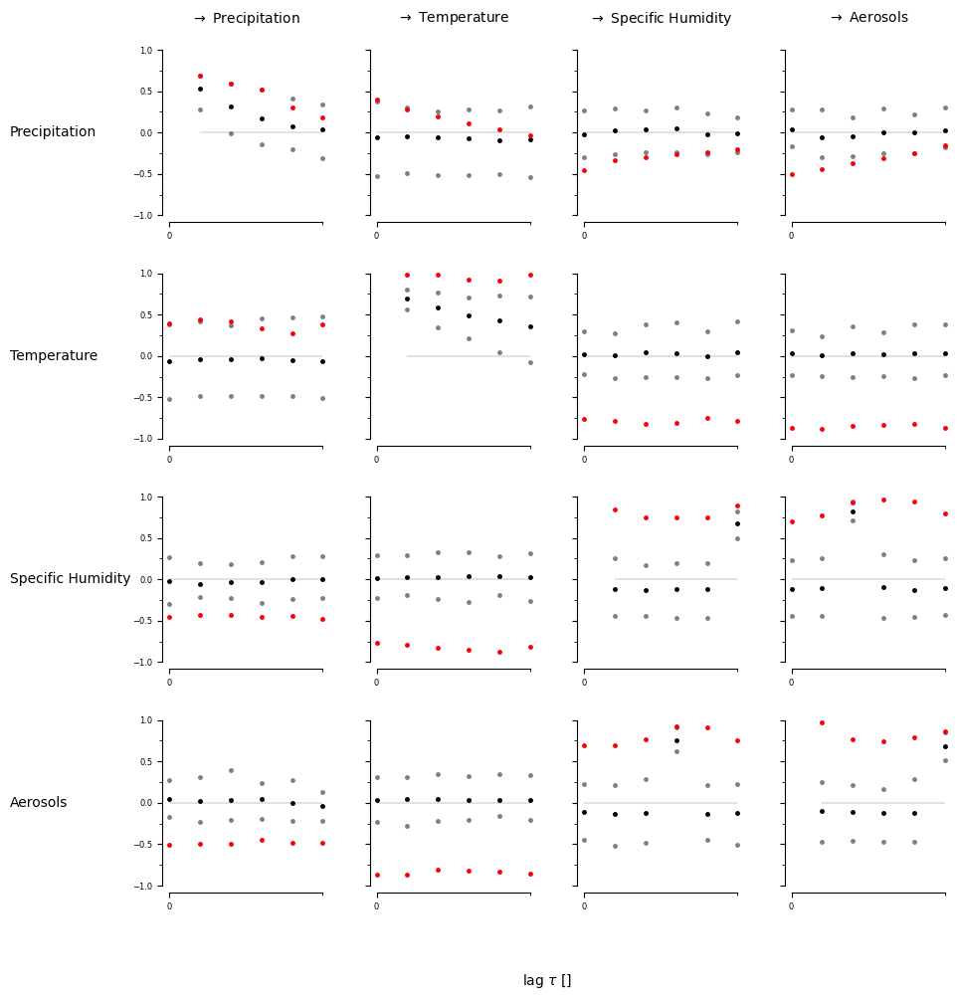

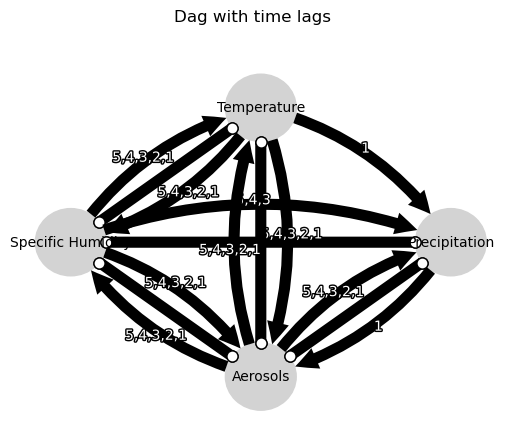

Negative precipitation values: 0


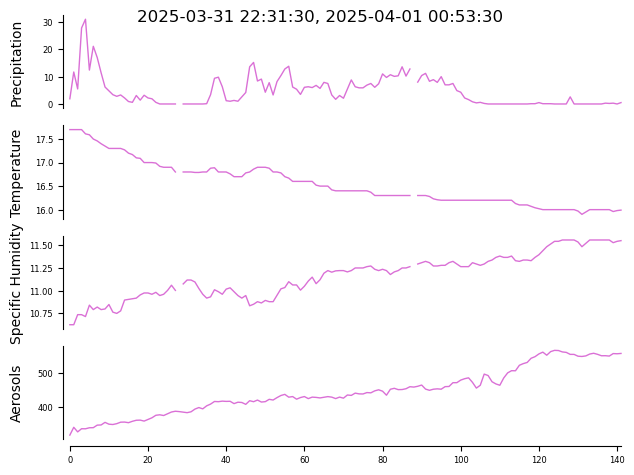

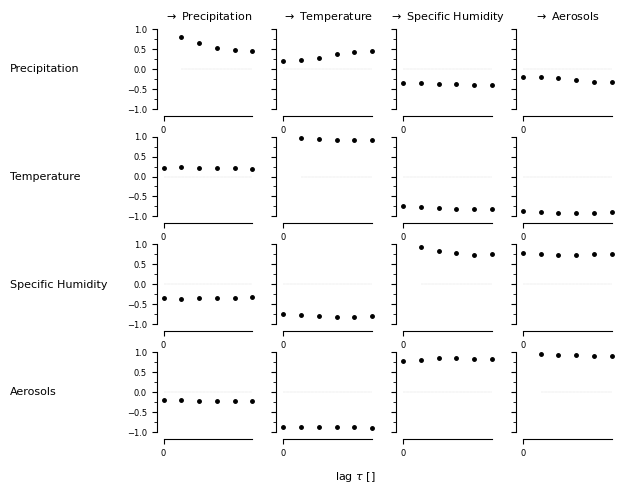

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


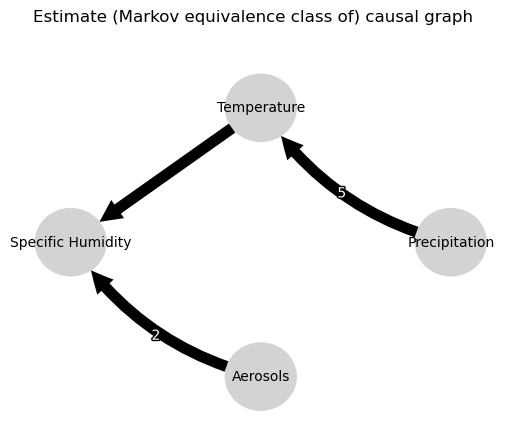

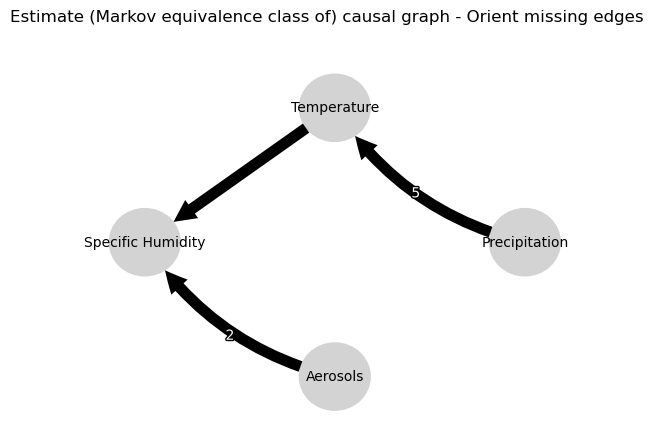

0.0
0.7034960365693703
0.5012601531311762
0.3638518420987185
0.26509213806691617
0.1899447236797611
0.0382368077358236
0.03762846344610154
0.037862872006515225
0.03510899626007234
0.021212566257141265
-0.0010022552329253937
-0.1047798728439781
-0.08716716974434789
-0.07570386835728812
-0.07017127162916427
-0.05779468904534072
-0.05830299250104902
-0.0049382607977089335
-0.008007576696565103
-0.014001965427546288
-0.02101583661004764
-0.029060807289400654
-0.03211744705334984
0.0382368077358236
0.01729982864541824
-0.0011769847588489015
-0.01097803361281805
-0.022663184246013972
-0.027662230579897886
0.0
0.8901391972216562
0.8247660288244212
0.7662732193607549
0.7142089432170492
0.6652440656201787
0.20092944812088537
0.17519116765490705
0.15676996182329875
0.13730372153084777
0.12113570854263052
0.10742892533051825
0.12428734417524107
0.11795953738930157
0.10856399910408429
0.10124241971232736
0.09581223809282913
0.0877932588765739
0.20092944812088537
0.19476216357845483
0.1870044344387

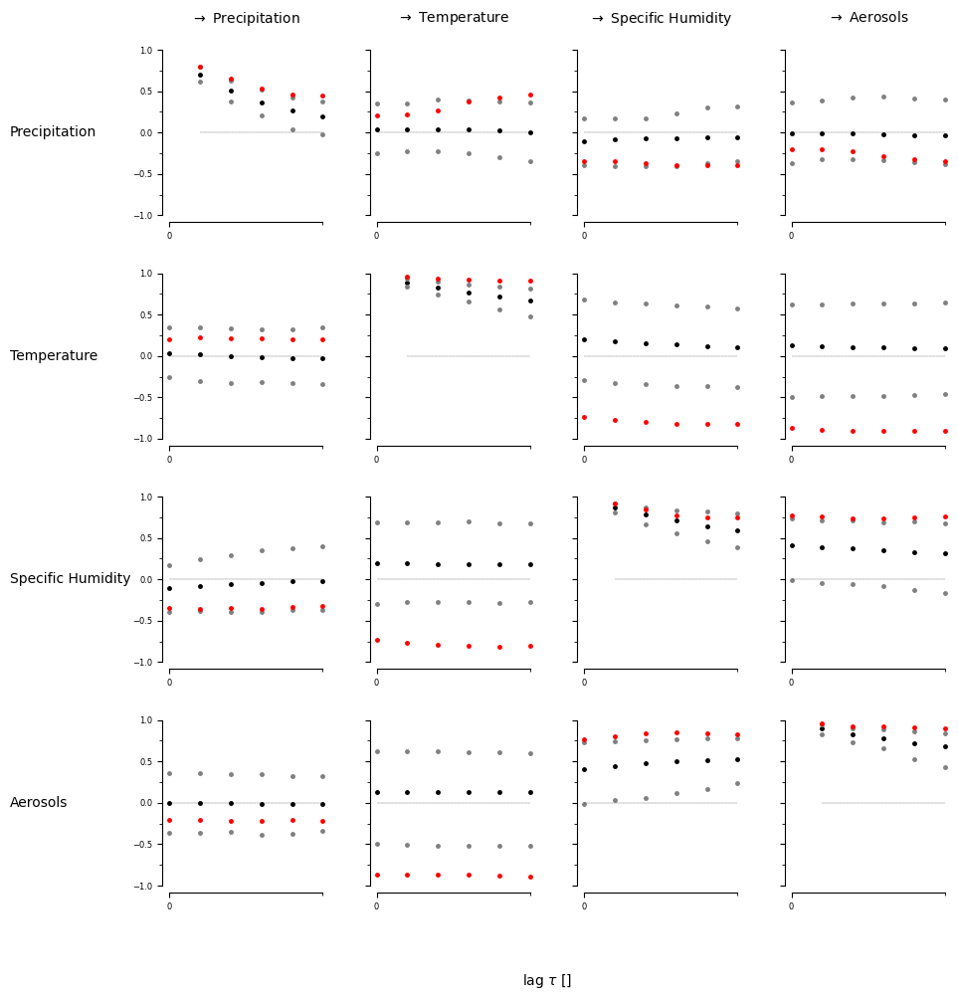

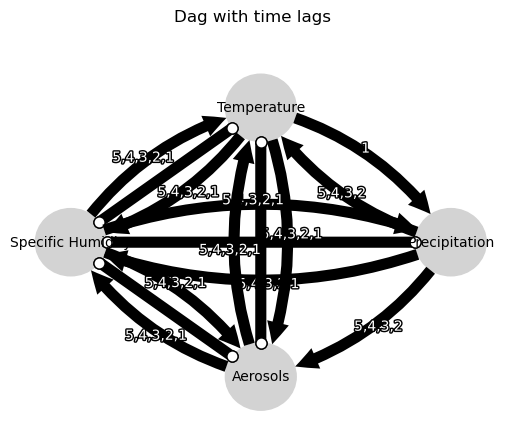

Negative precipitation values: 0


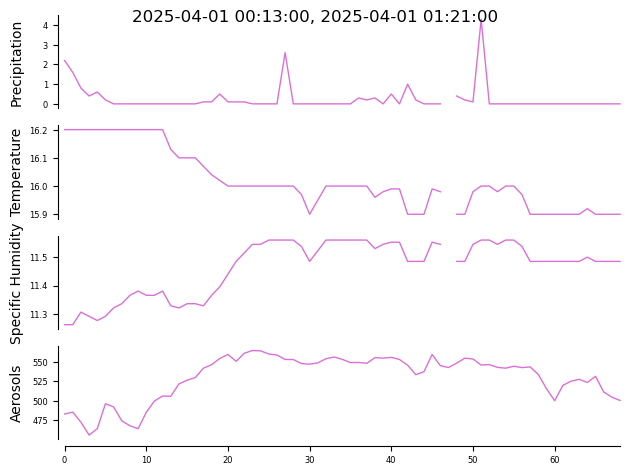

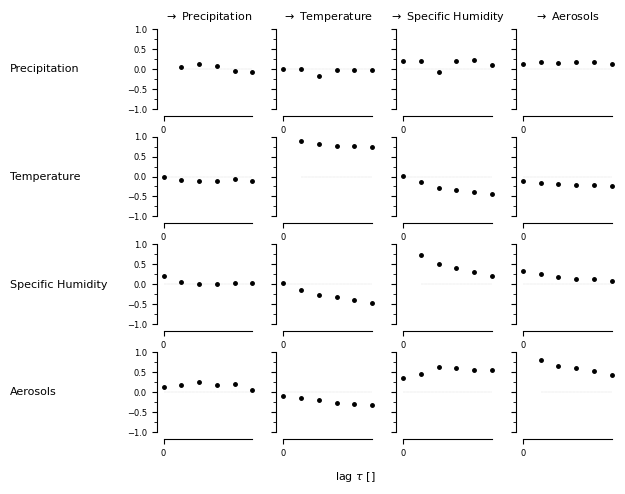

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


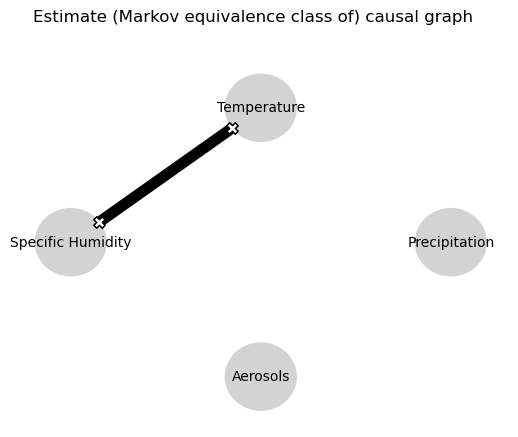

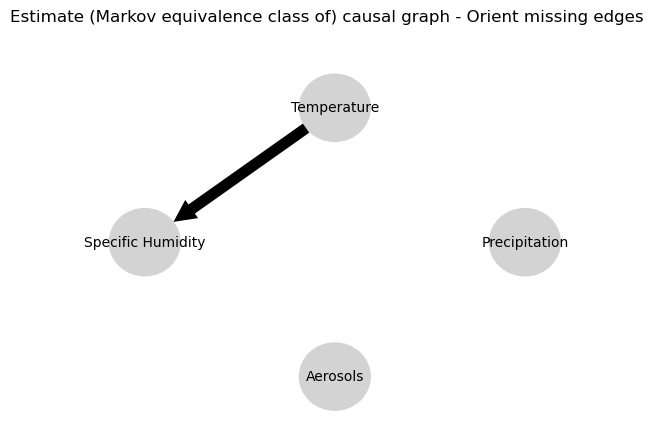

0.0
-0.006666574491908848
-0.018374589561336207
0.006224546948107236
-0.022640394144634347
-0.03597422350704784
0.010100483669096614
0.011200151658511683
-0.022505400173613185
-0.002412576730028309
-0.017402722682378594
-0.04144305484534096
0.029146530861770034
0.018593874605076523
-0.006941748169010847
-0.006167198543999584
-0.03392676755884481
-0.037258892709163216
-0.02106577087142969
-0.002926499326962224
-0.03799298008015563
-0.025369135175377713
-0.0395357333104694
-0.03249013132889694
0.010100483669096614
0.029668812228578964
0.030811590273438955
0.022230577473092095
0.0020246811916175816
-0.006299127833312688
0.0
0.7636971669317733
0.6383179305962422
0.5337240470058464
0.4507240545786289
0.37615485186916364
0.771756520548788
0.6366215141320474
0.5479043050379574
0.45961157284563425
0.3920206398279334
0.3314288194683327
0.19067451525353663
0.1609473779758929
0.14508183907476913
0.12395298703584859
0.11575357859970606
0.09962932237125145
0.771756520548788
0.6316552855010499
0.522

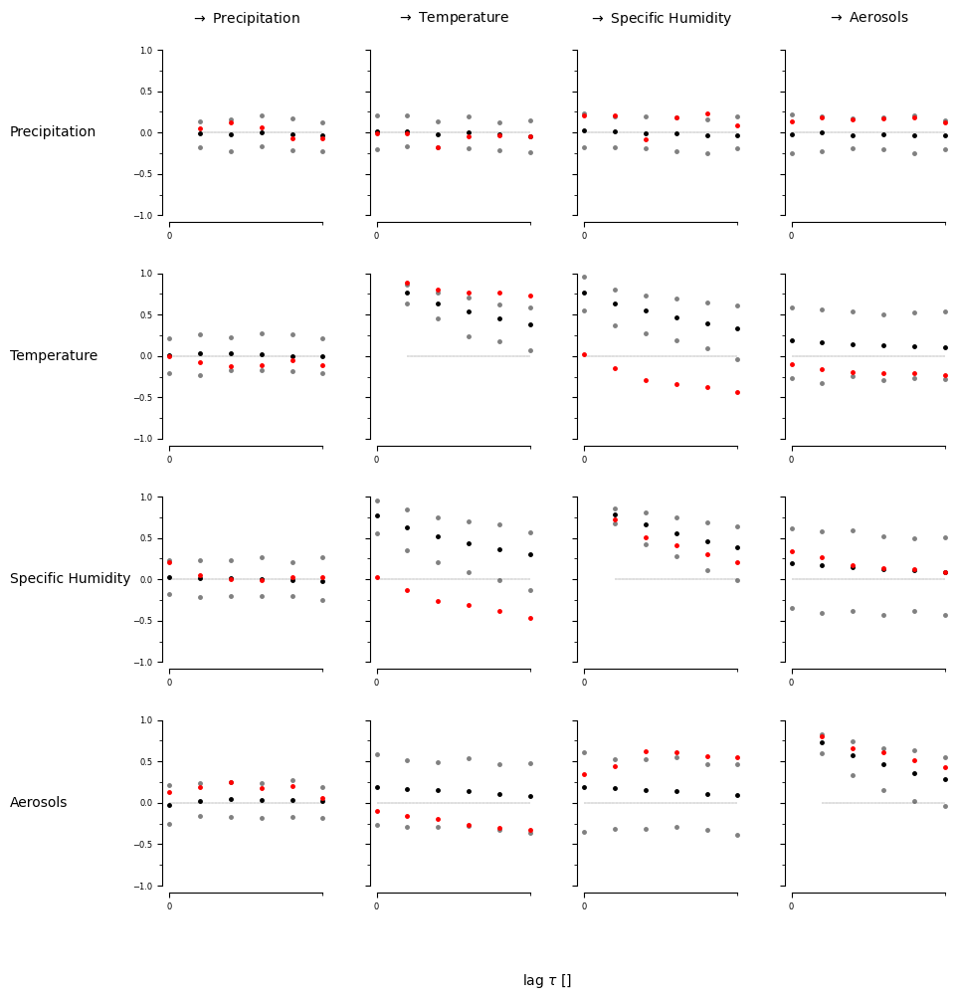

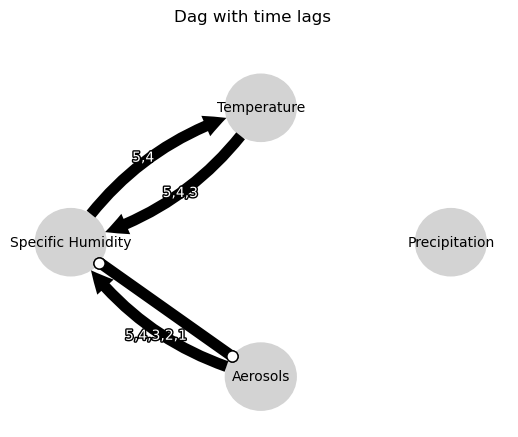

Negative precipitation values: 0


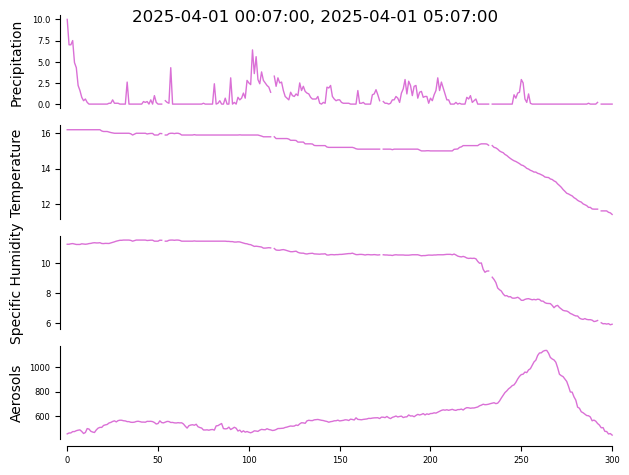

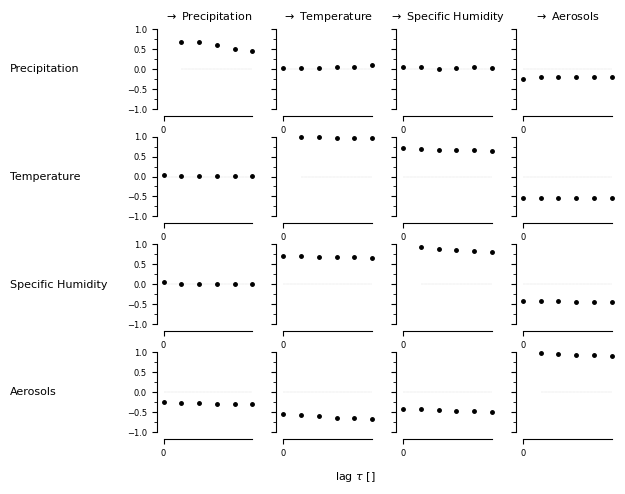

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


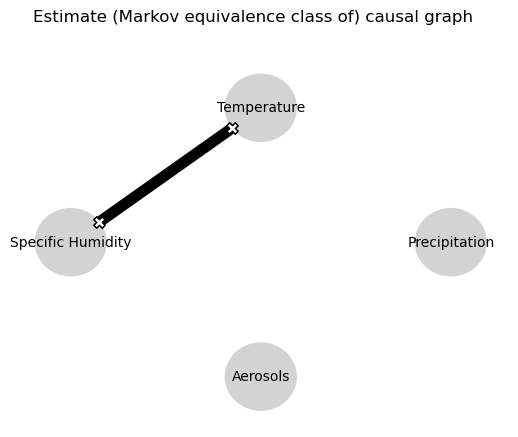

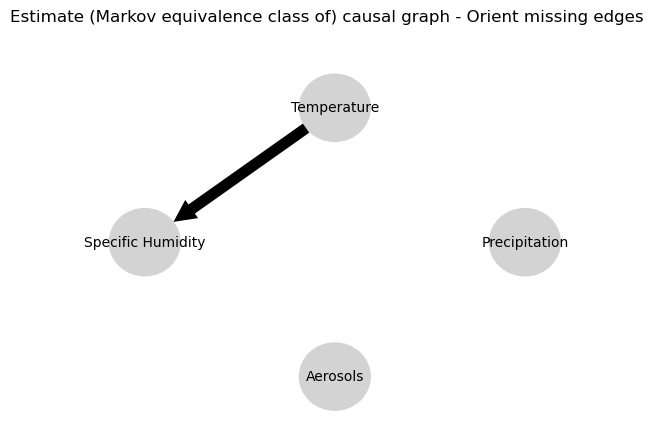

0.0
0.5902948050496251
0.5489971341904564
0.40902197459368916
0.34211319173496385
0.2680790931695921
0.020079431075918933
0.019684793973409876
0.018755323103610607
0.018977525890436834
0.02152825434529404
0.019026884634458504
-0.03080066607767735
-0.029413778471391736
-0.02823049382828066
-0.0275343338261152
-0.025437511007973868
-0.024304975184373034
-0.015262786816149928
-0.019105797201081808
-0.016372963941919547
-0.015492590570265221
-0.009532590574291644
-0.006988899078223237
0.020079431075918933
0.021490295895263172
0.02111841942176421
0.022229807107774294
0.02282068768075926
0.023044502412385266
0.0
0.9871910820520102
0.9812045592484825
0.974986927158063
0.9710426016246604
0.9667134291034304
-0.5646057501462147
-0.5648513727643215
-0.5644856653159231
-0.5643343753050586
-0.5644222335532687
-0.5643972369423684
0.03372146675975609
0.03445507423779191
0.034296377924713906
0.03472101242932064
0.03459839236140797
0.035356656645891694
-0.5646057501462147
-0.5643852323589299
-0.5641827

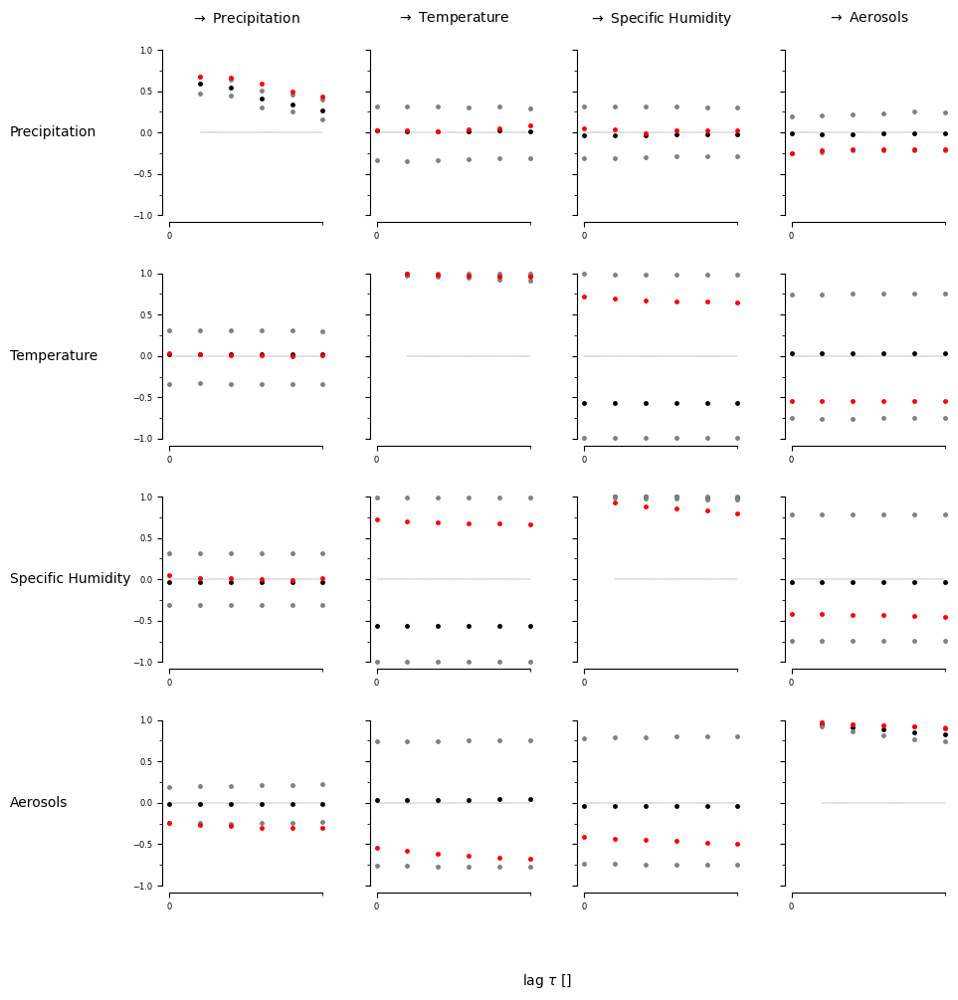

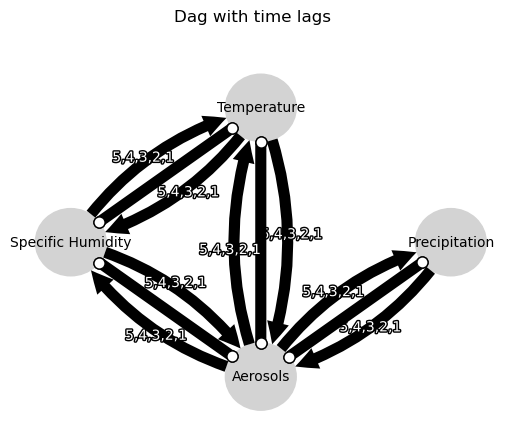

Negative precipitation values: 0


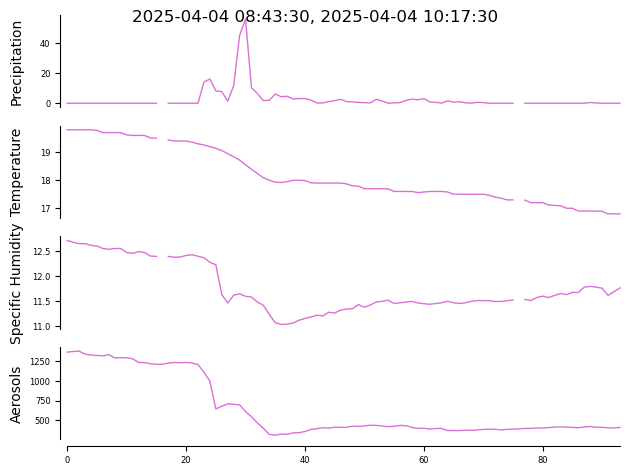

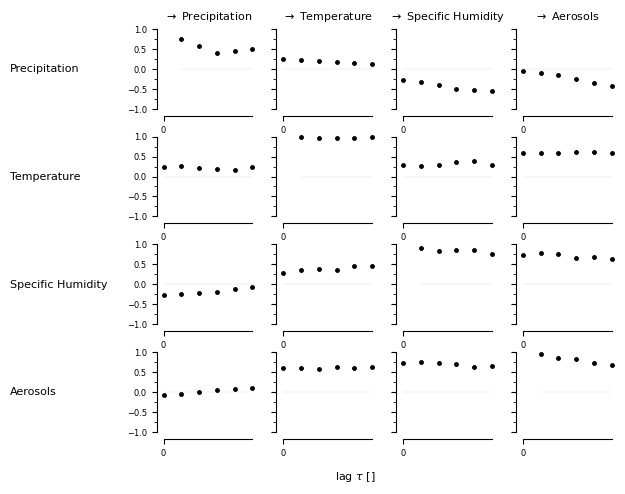

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


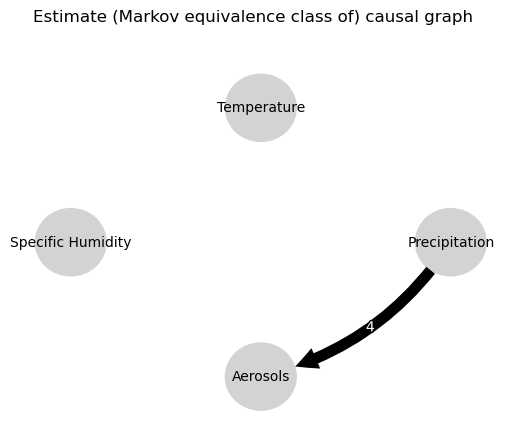

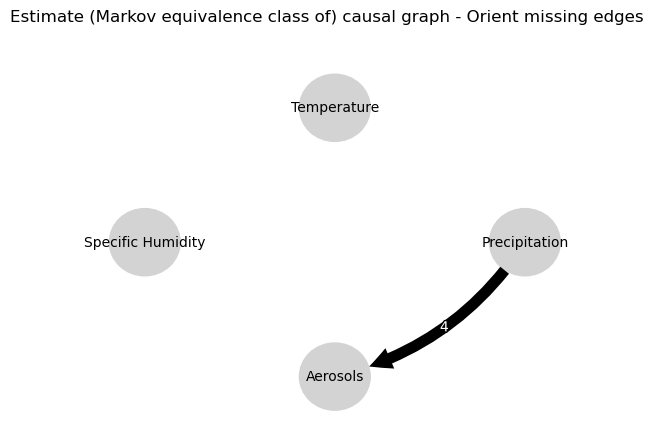

0.0
0.5977510164095065
0.37041030131403724
0.2364912856021057
0.1328619462751253
0.05863268688764092
0.015881266223674206
0.011138820429156622
0.005550839403945003
-0.005410612255968573
-0.015521142666336293
-0.02154103204234546
0.010528635484213782
-0.006200902732684272
-0.02726278630250526
-0.034328604565131524
-0.04370231722312329
-0.04084183167214619
0.03108240773854718
0.01785284880107258
-0.01809797113528874
-0.07505960824439323
-0.17107448626189103
-0.20996024858640272
0.015881266223674206
0.039501351236287056
0.053162406840481326
0.06458393631353405
0.058670876278052765
0.05205097203480668
0.0
0.9022541388076416
0.853924901814213
0.8048836092466304
0.7569356087886794
0.7019768724133769
0.10503576883746486
0.0805168451619716
0.05887827898176367
0.0349881504155146
0.02137086434910781
0.012034668575346378
0.07156935871482642
0.05336979991444236
0.04033210631011601
0.02783163081822314
0.027568673952123167
0.023001651974636078
0.10503576883746486
0.09758507161717694
0.09789859229372

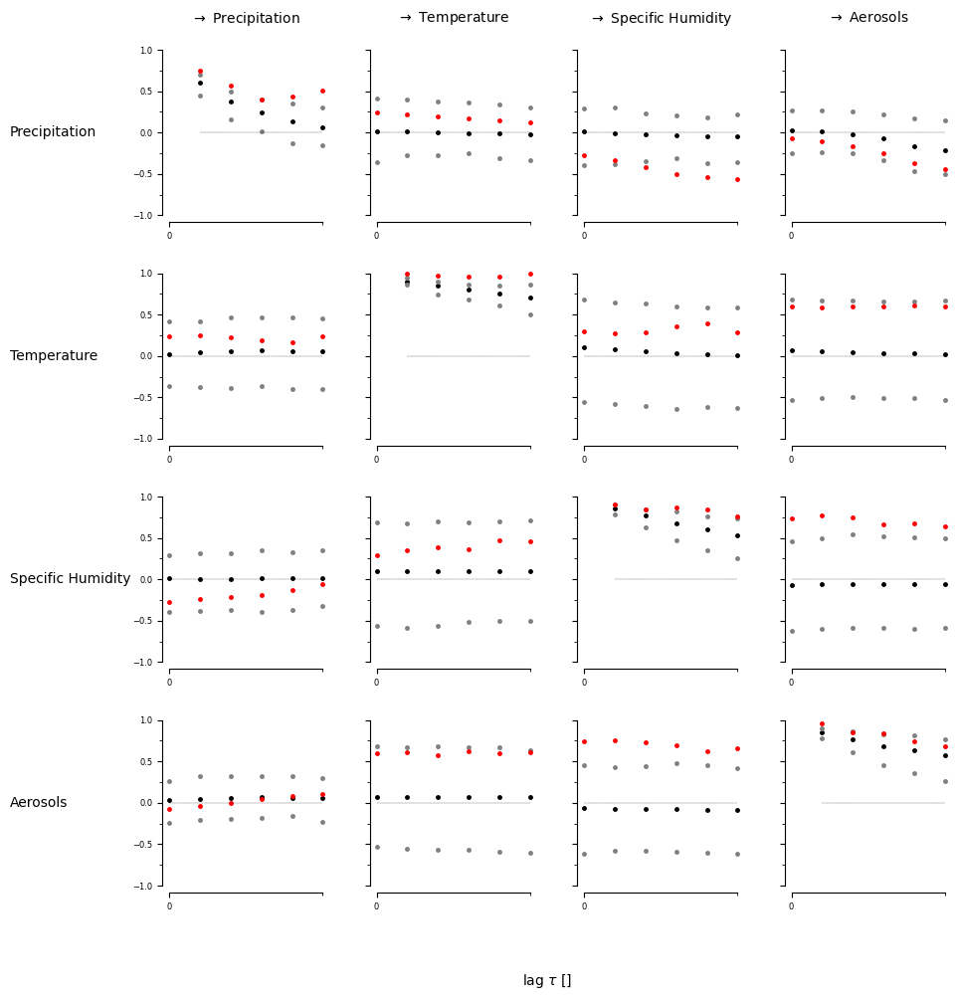

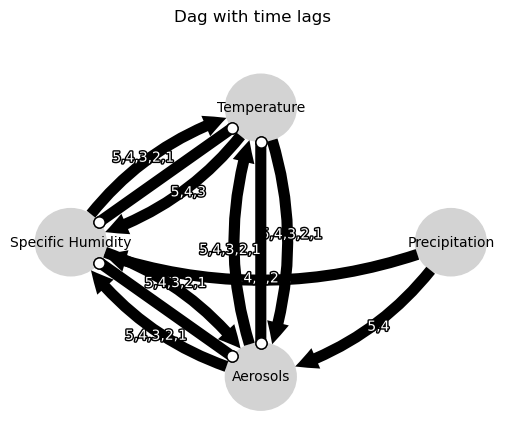

Negative precipitation values: 0


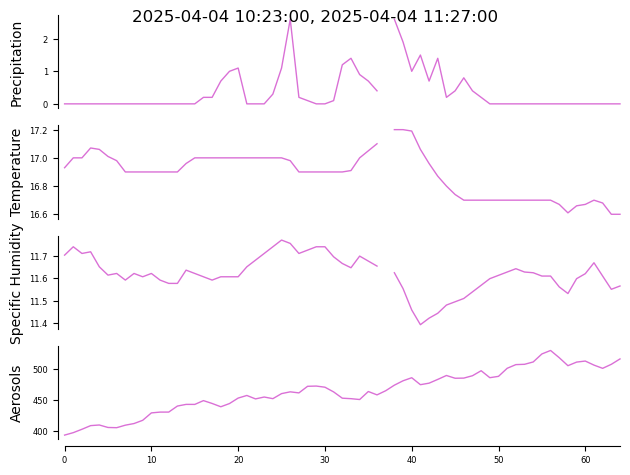

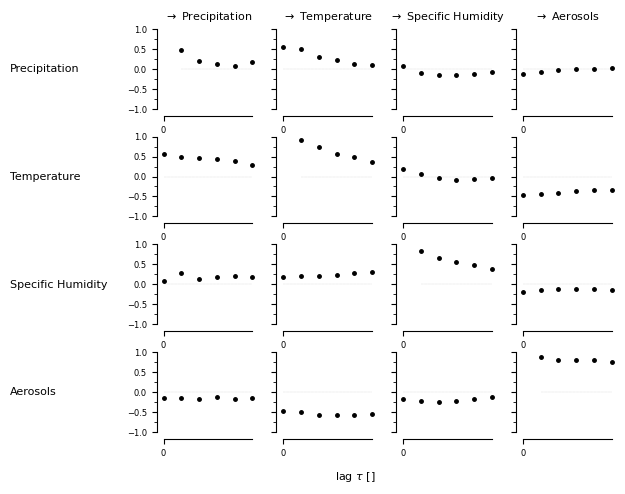

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


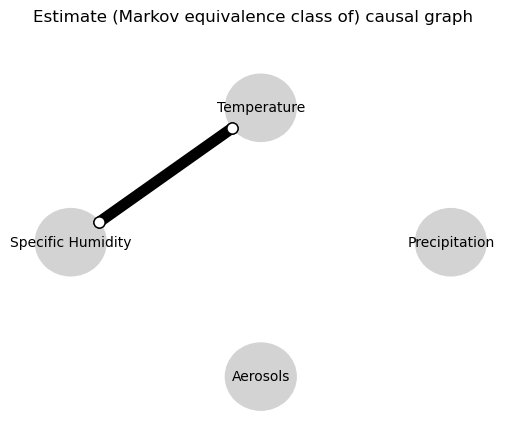

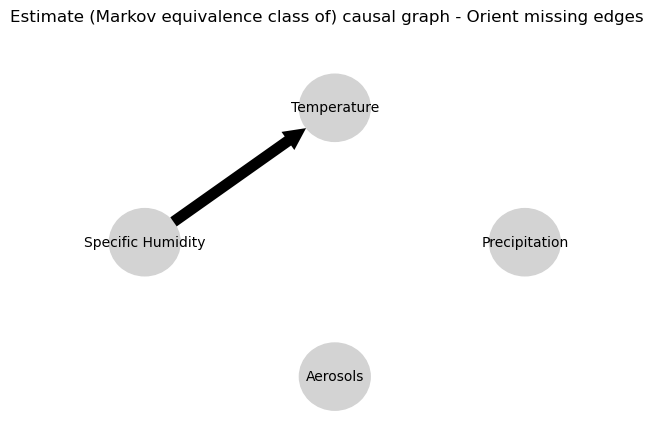

0.0
-0.034756251864192914
-0.02465111723467219
0.005646713194075856
-0.03473933943683931
-0.024607511451698885
0.03199638466164043
0.02312006824243745
-0.014321290004715971
-0.03250515162427791
-0.029669793492850056
-0.026545379797468672
-0.10058269233884223
-0.07869070367082634
-0.09403637370890865
-0.07572199050980875
-0.09342037284250965
-0.07366758849410925
-0.001828007143965405
0.012240366669789114
-0.0030110124326884983
-0.0075448161631465685
-0.01206608811722512
-0.003948389023472616
0.03199638466164043
0.04532290861282431
0.058560363936769555
0.03443281394363223
0.021687560206135048
0.03277323072461751
0.0
0.8570570687883887
0.7828593373001341
0.7184141400234024
0.6608488810042701
0.5967291876705361
0.3790907701762118
0.2613411763271889
0.16933914437398662
0.09146581190685252
0.02712201096636074
-0.024561671682833672
0.10132708807358676
0.0750031721591273
0.05620295626978756
0.03695279517478806
0.026465095433808646
0.014101593317494084
0.3790907701762118
0.43814870193480304
0.4

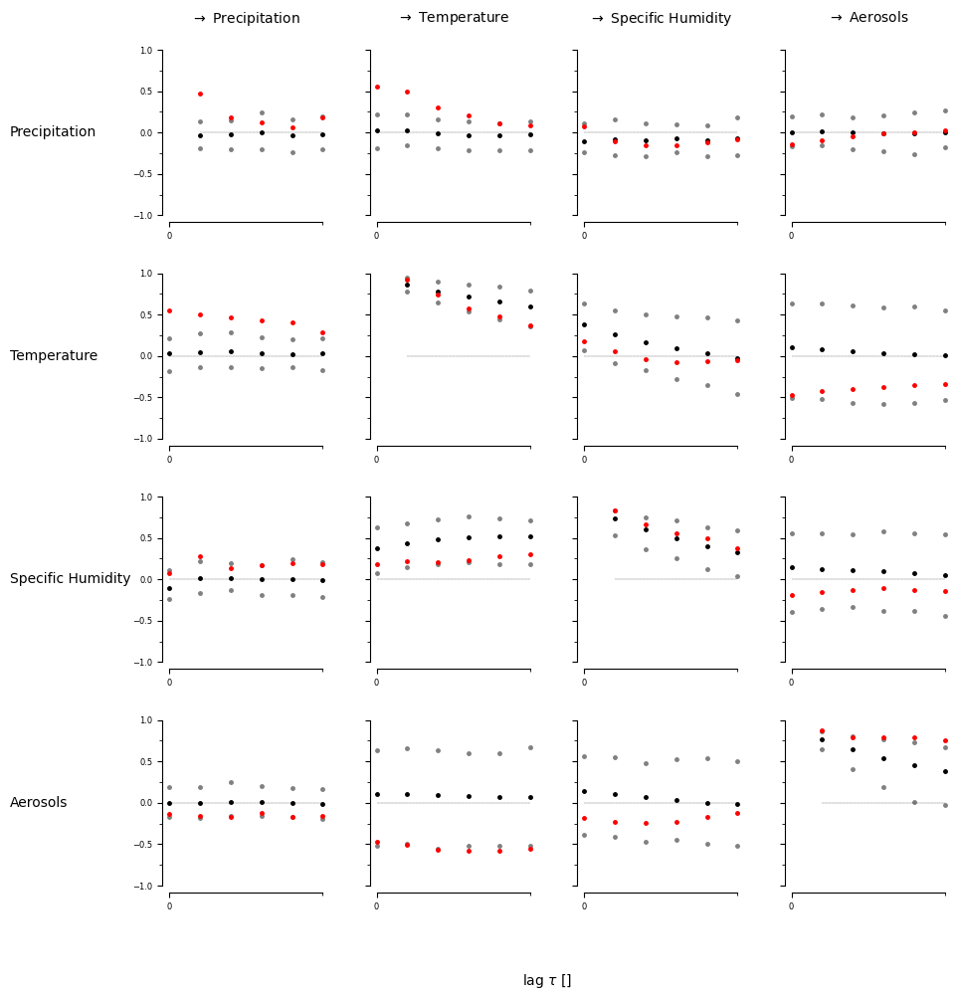

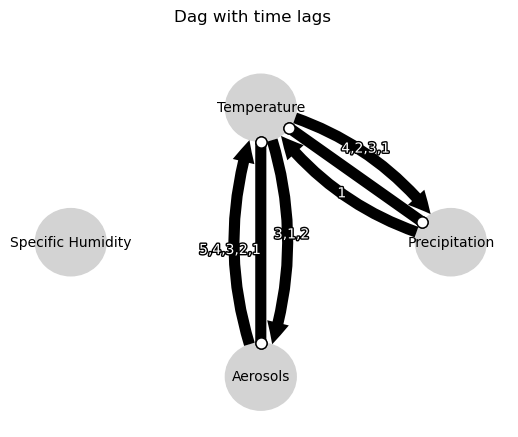

Negative precipitation values: 0


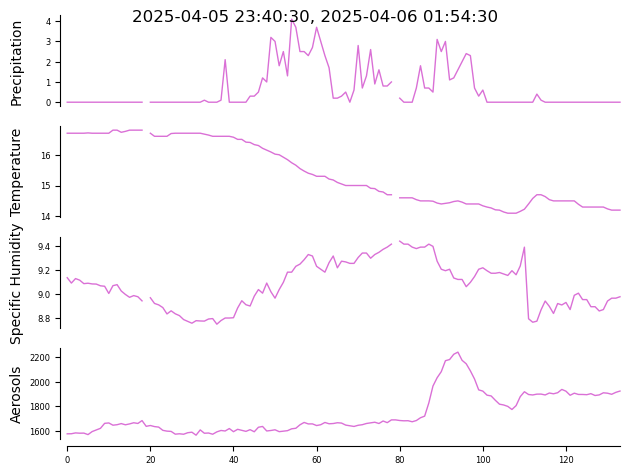

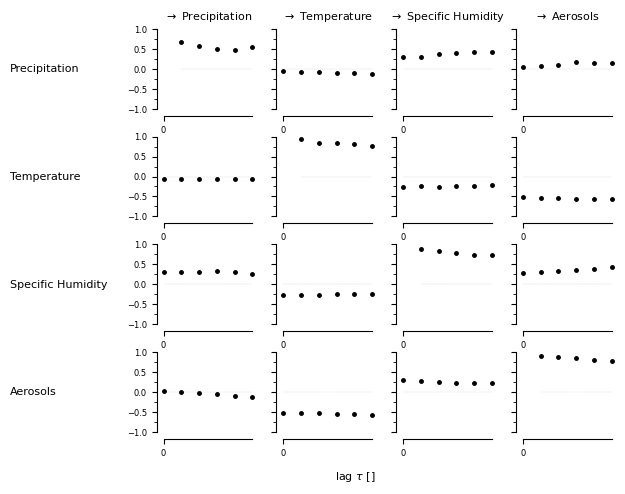

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


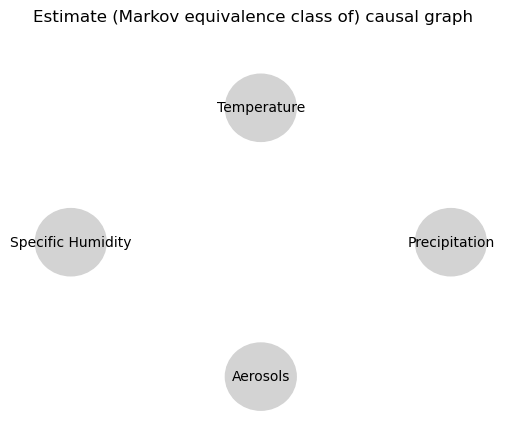

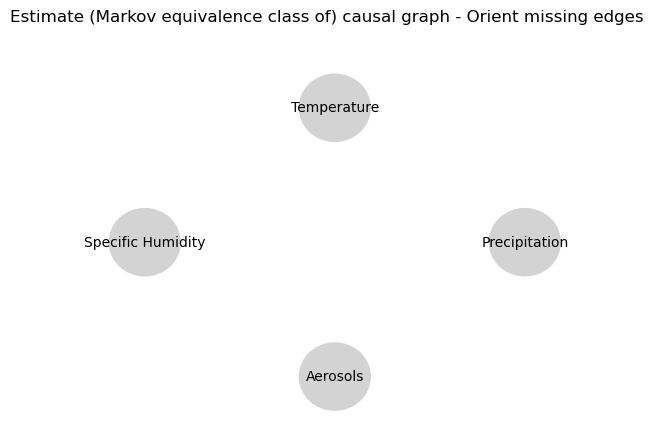

0.0
0.6680707903332478
0.4782371339853877
0.38519983437236394
0.35639609988505383
0.39586710070750253
-0.07121616069514301
-0.06967542215255394
-0.06425452480595135
-0.055423945832613244
-0.050906389481781514
-0.04726155873515107
-0.08945015100487089
-0.06700713036407518
-0.05415777301309574
-0.0520869524077398
-0.04655117143537096
-0.044027200265387166
0.08872031873737984
0.09634480426545218
0.08971732340014596
0.08267881751036706
0.07270160760828032
0.05913831811500466
-0.07121616069514301
-0.03357210631537562
-0.015885520715742615
-0.00881973256805151
-0.01444632539596626
-0.0070482791453447356
0.0
0.8930942165572014
0.8264778945620531
0.7686892972210688
0.7198202818985995
0.6759374957466477
-0.18544126357956123
-0.1613852866317687
-0.1319199175404022
-0.1082861375760403
-0.08413264781720205
-0.06699240398712218
0.012670754397139508
0.01395961439367308
0.011048223384196818
0.007464343542655583
0.0023760778089942764
-0.003175128735113551
-0.18544126357956123
-0.1749346963243767
-0.16

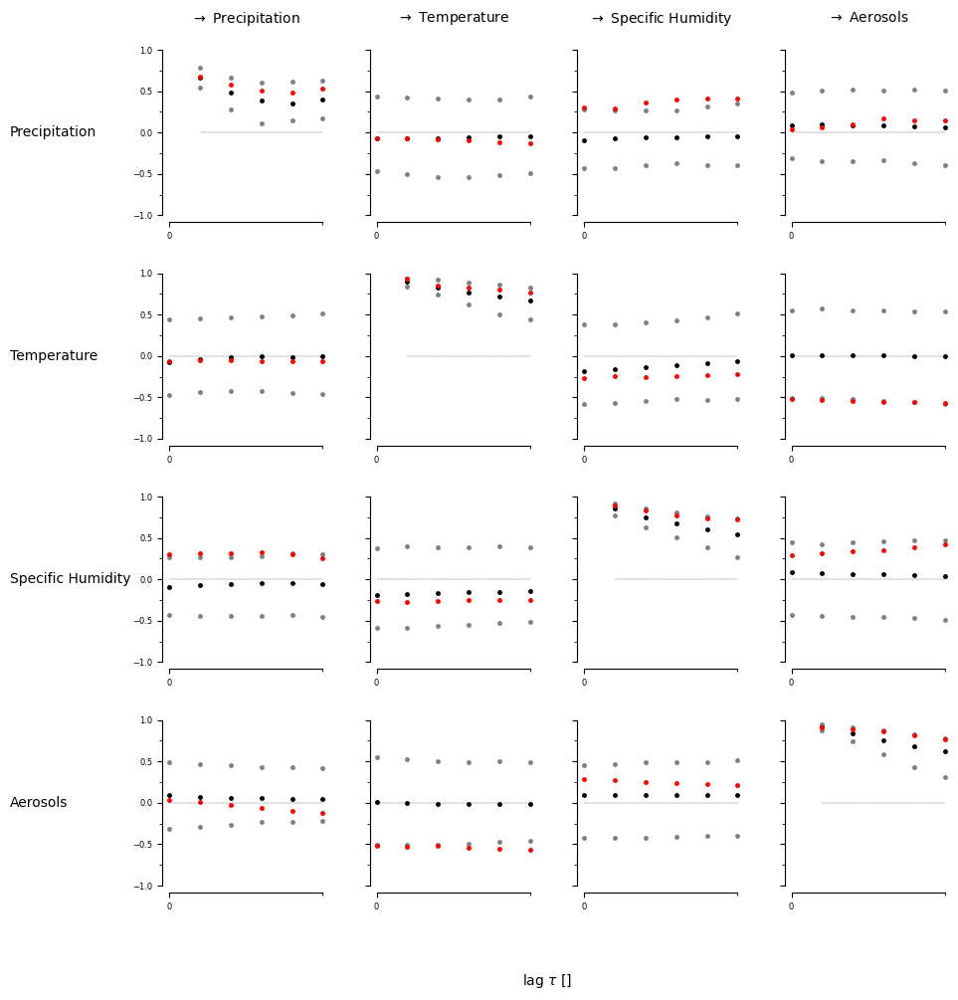

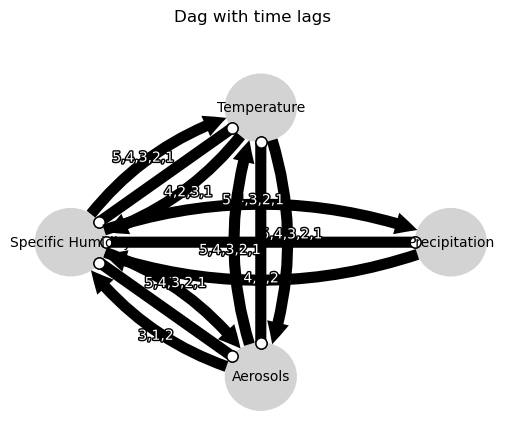

Negative precipitation values: 0


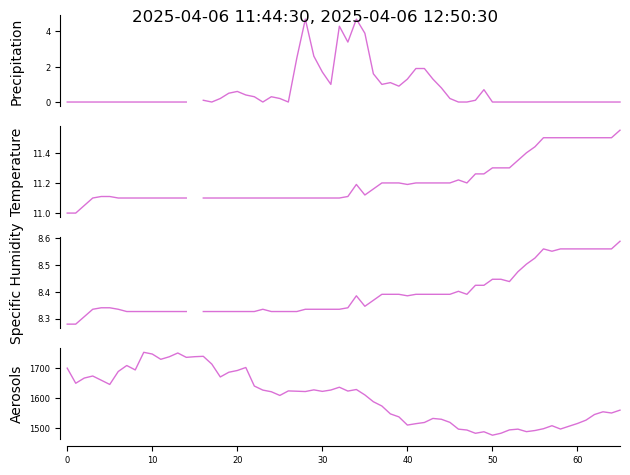

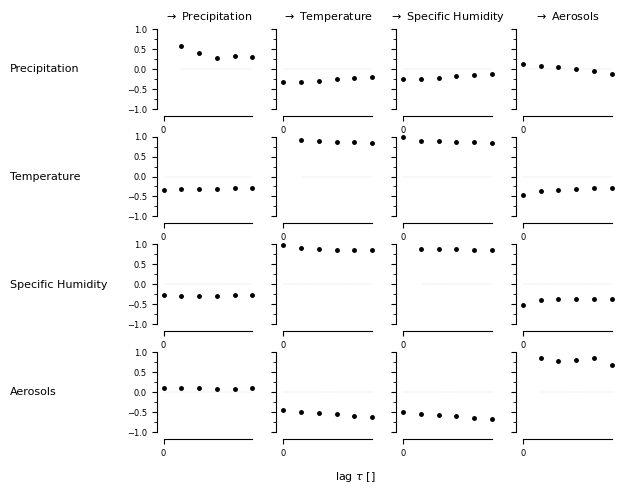

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


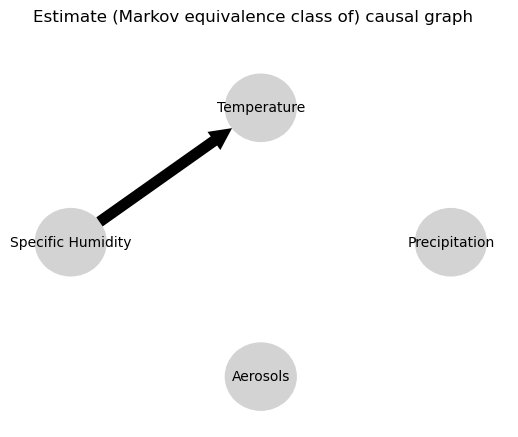

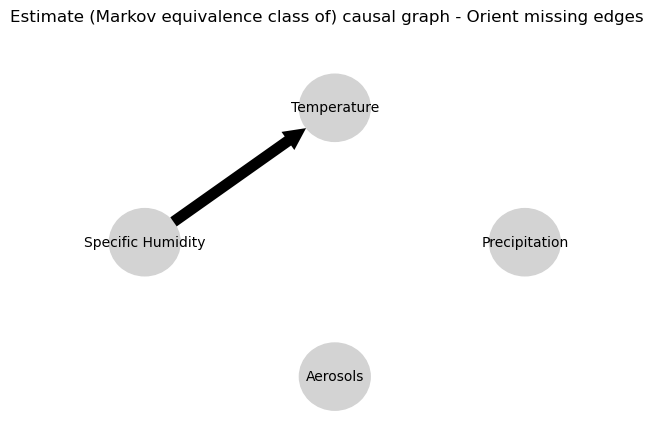

0.0
0.6444625914942749
0.43675963447588856
0.30927343106844946
0.2084670072416362
0.1506618904418474
-0.05234731245289816
0.05147435196906454
0.0711240623056466
0.03858928269130059
0.03962482486566302
0.02657450894410729
-0.0458047956920929
0.05956286596593949
0.07196935468168485
0.032113033207644553
0.03550075526834641
0.02157146801914421
0.016700671886981763
0.015604989010916302
-0.009024820045753638
-0.009277187351953075
-0.021223107881818283
-0.026008622041047133
-0.05234731245289816
-0.028153959461344354
-0.04379591135831344
-0.05464453292655736
-0.0542160395987138
-0.02756575956771035
0.0
0.06234112263374377
-0.0023319771649982788
-0.035589066494017114
-0.012050999844530867
-0.030695968319155754
0.9787584655832556
-0.022231096222599427
-0.005549103295478097
-0.0350828678815678
-0.0076400871356891885
-0.02800494626297629
0.007402234570908963
0.008642348585591642
0.0023802029672867157
-0.022936199354476116
-0.015317891545185272
-0.032625411880560354
0.9787584655832556
0.06635066019

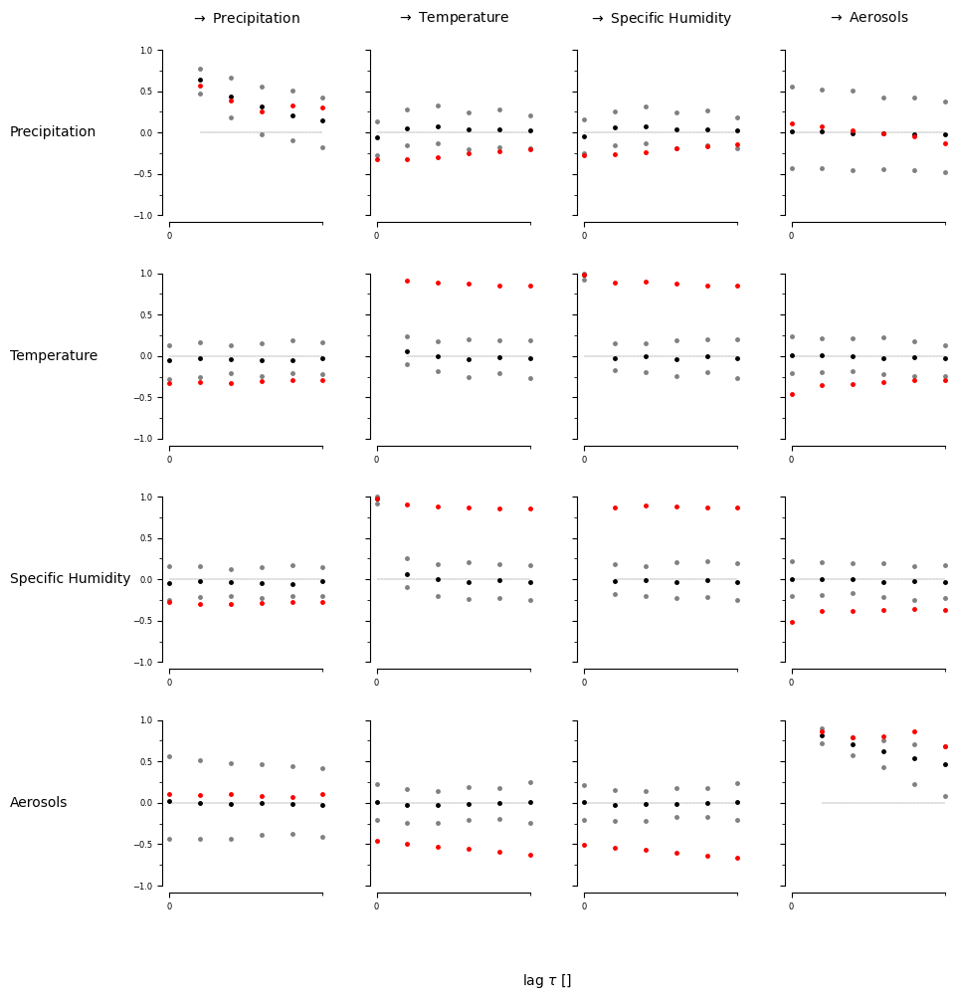

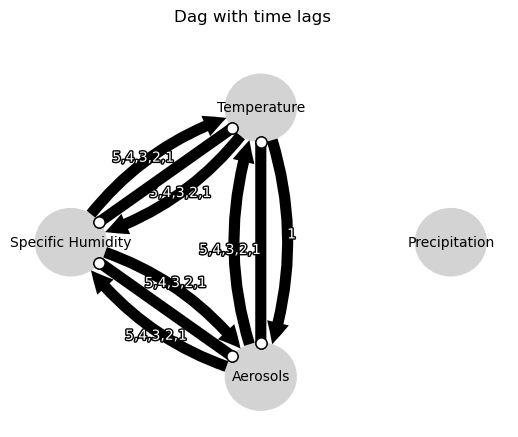

Negative precipitation values: 0


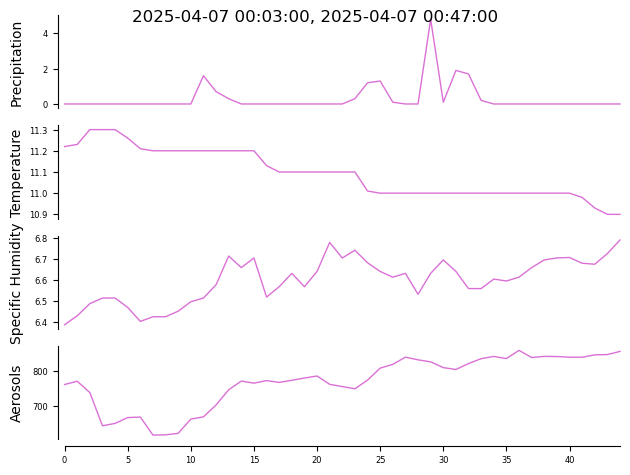

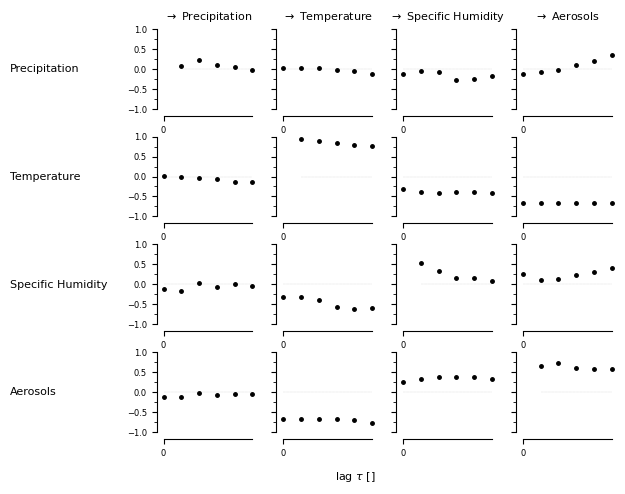

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


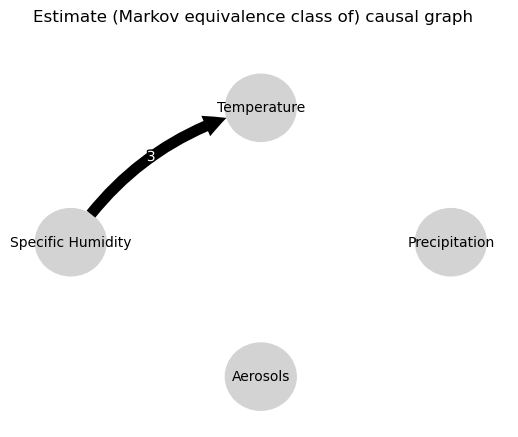

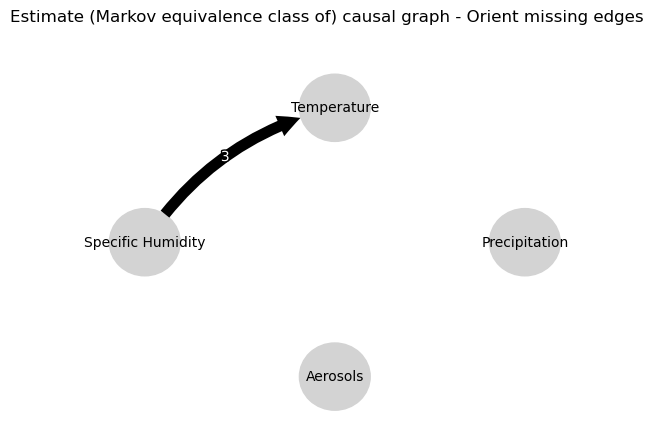

0.0
-0.009923051538005016
-0.03310297892863673
-0.02255157503964524
-0.02019257652722444
-0.03854916722428239
-0.029584859025254186
0.006279155404031995
-0.017961691871714515
0.009484180595285923
0.019012992801743078
0.0053030511335718815
-0.004944487267033258
-0.006621745184308989
0.01465971343156931
0.006174563594594324
0.048063239025517034
0.014370925719666432
-0.0035011938688026007
0.03521788057954545
-0.018960487274385172
0.02155318331012746
-0.04242972624584933
0.031624508751167985
-0.029584859025254186
-0.0015825849499940736
-0.0004583849342886265
-0.006810434611928897
0.00809841406226009
0.01877592954390295
0.0
0.7351106434544455
0.5779534223253258
0.42412161798986353
0.2979211453169828
0.19939505116575681
0.11786403733716493
0.12415703190237107
0.15485040147846865
0.1610941568431562
0.1713643168864145
0.17037492308156427
0.08584889783533776
0.07810933281194181
0.11717580353864122
0.07715452628188045
0.07833021722574007
0.05734371753112824
0.11786403733716493
-0.016751377182697

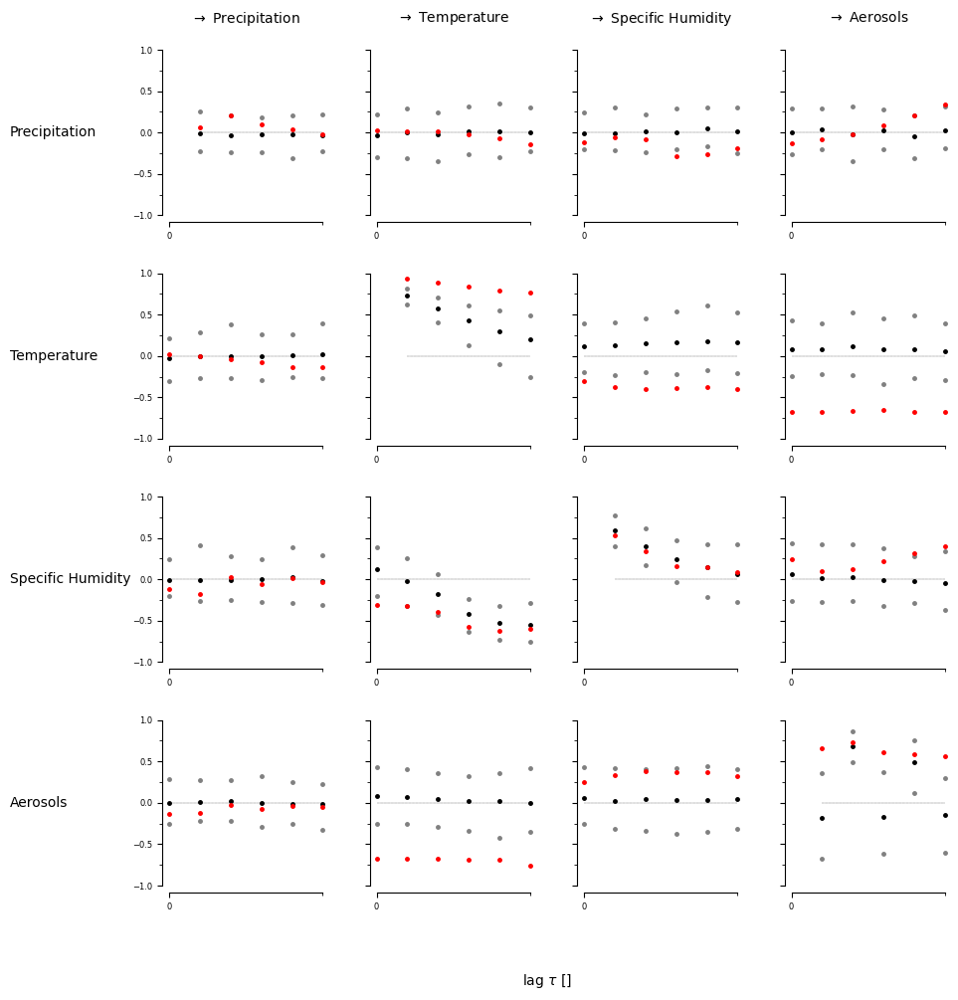

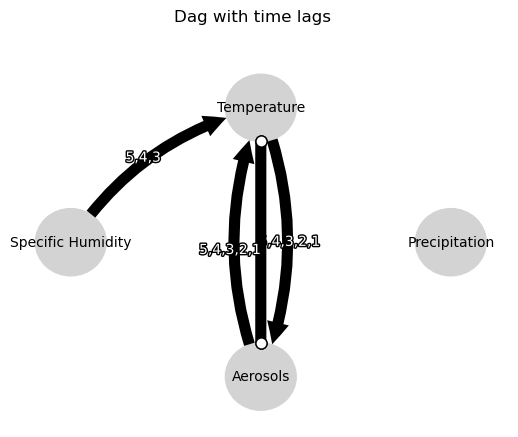

Negative precipitation values: 0


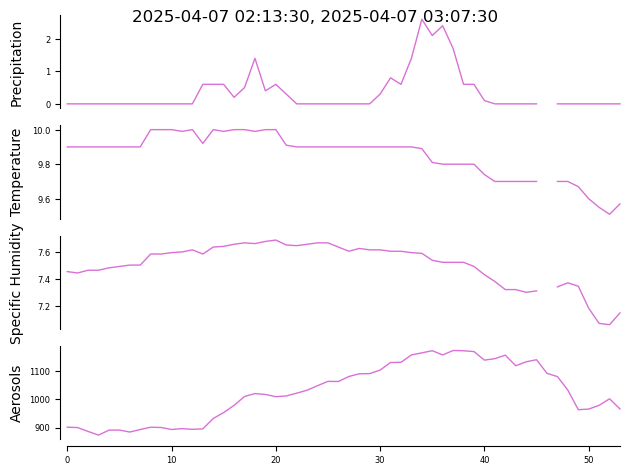

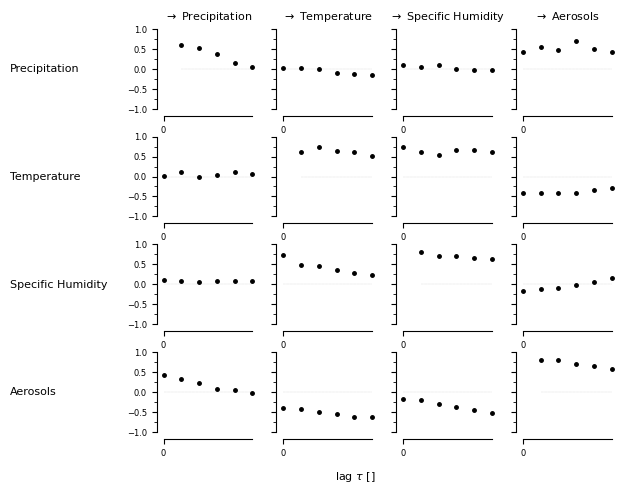

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


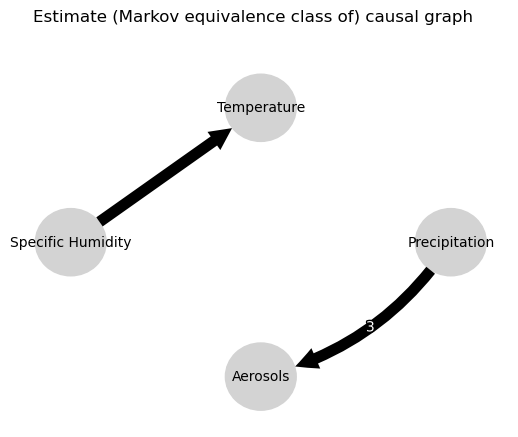

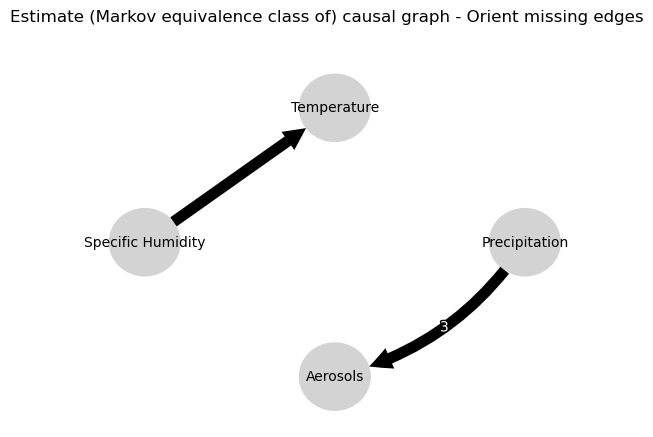

0.0
0.6377924745785069
0.4437459848333558
0.3275807571959996
0.209208171474627
0.11905518042555897
-0.0423462231204502
-0.05283496739108781
-0.04293745579433923
-0.04768704834727039
-0.04005495735027014
-0.05036338248942087
-0.05228927355312832
-0.057617630179803855
-0.05569605240246714
-0.06052669341668211
-0.046548507989121995
-0.053679834743253704
0.1621069507205858
0.16105180628974328
0.17781028680574174
0.2148004812114504
0.2350367696049444
0.21750824372834301
-0.0423462231204502
-0.040859711002941924
-0.03705720500434039
-0.030716221276493566
-0.015054665050179116
-0.0373622301668896
0.0
0.6575115961051482
0.7977963051013915
0.6328457760796022
0.7051441185942248
0.591949176597993
0.8386883265080758
0.7669039802712784
0.7204776025942412
0.6816738015694915
0.6549548645874538
0.6148925098717999
-0.0698185695100391
-0.060313197696173694
-0.06324543680205272
-0.053758823368618536
-0.045459408563407286
-0.04586393862955562
0.8386883265080758
0.7398598814904481
0.7847097787002987
0.7003

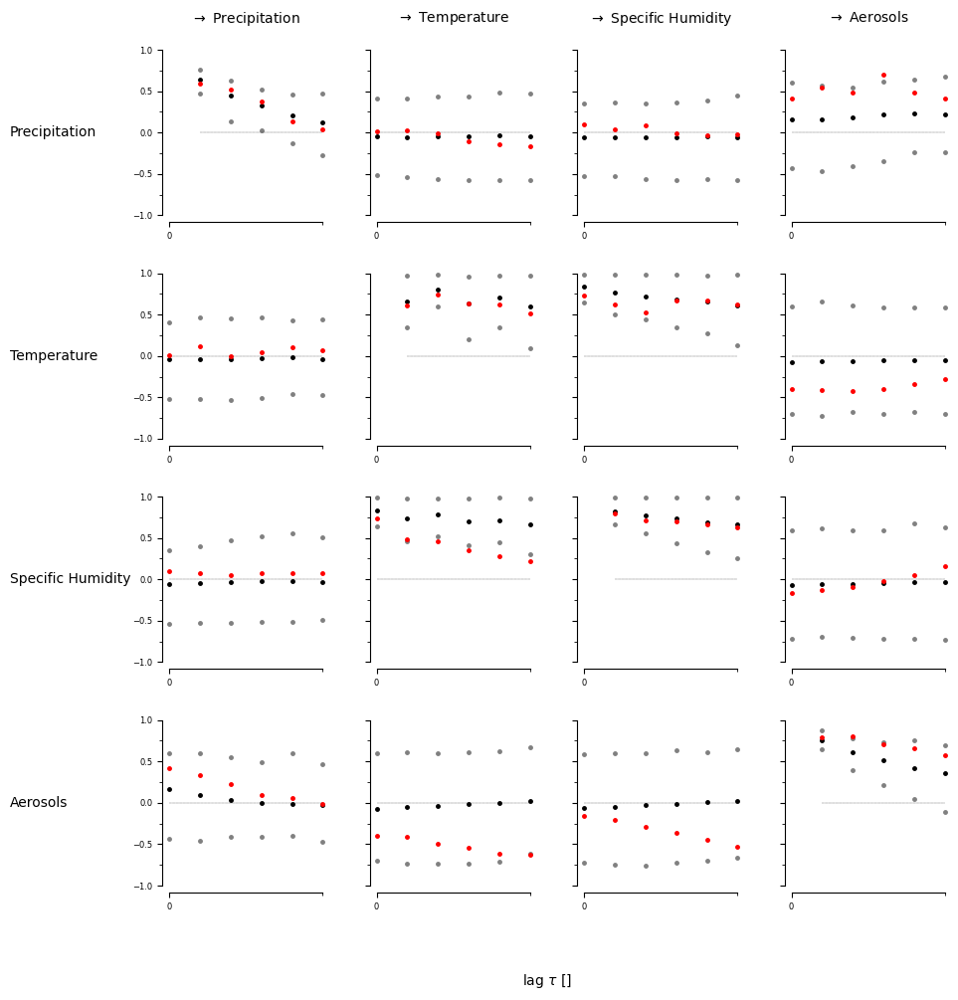

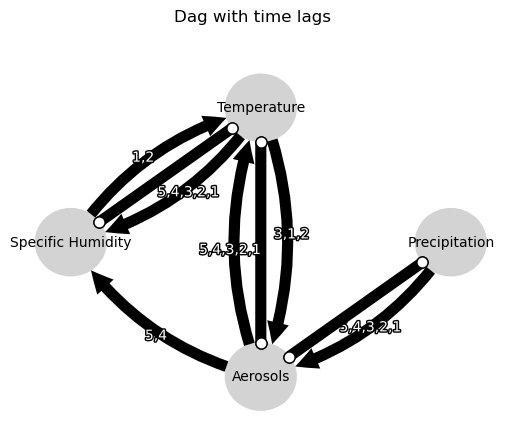

Negative precipitation values: 0


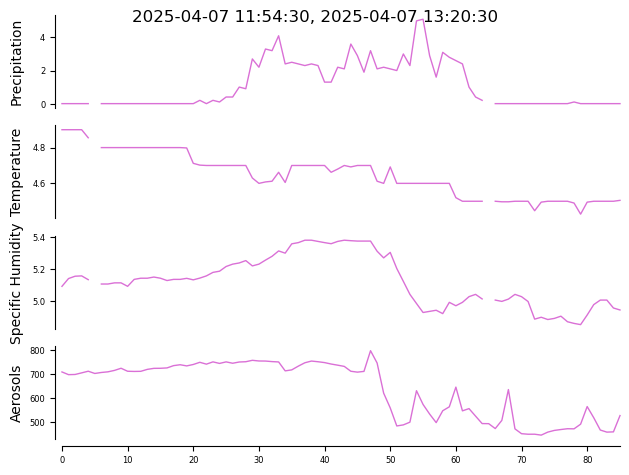

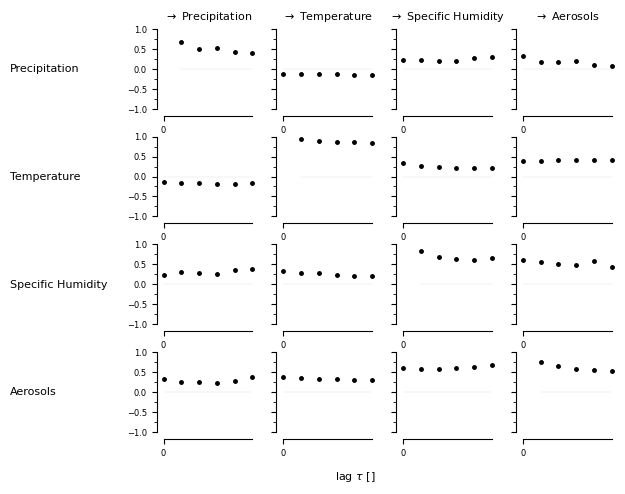

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


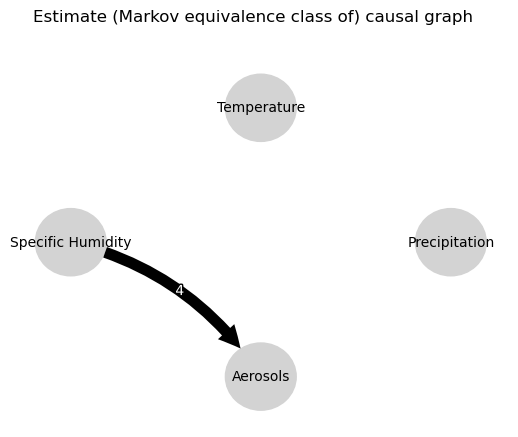

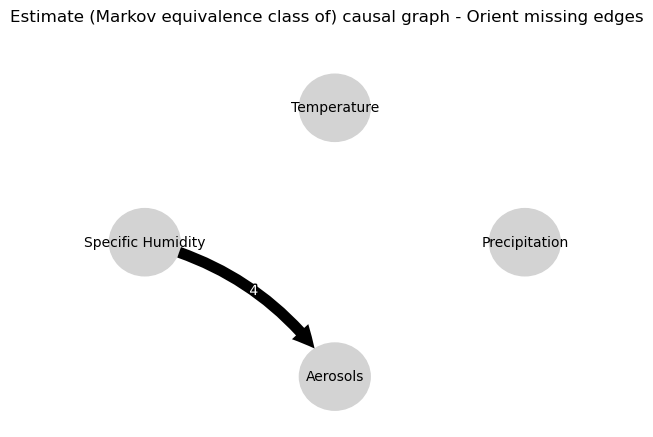

0.0
0.7560720906845384
0.6250803399506549
0.5132319645214938
0.4199573829983472
0.3417015387710044
0.04532797751682525
0.022400074793586633
0.01143655488523048
0.010750326576105008
-0.0025872851404164523
0.010726310898489393
-0.03687021523322012
-0.04734201443900439
-0.057472459966574074
-0.0530538881374823
-0.05357480420851186
-0.04663458345468254
0.29460576685481976
0.2519434256829862
0.23233197382297072
0.21497720231017067
0.1998509702051045
0.18751898471849793
0.04532797751682525
0.03062699401266475
0.025127120596293004
0.0131414535050045
0.003498982953061612
-0.010253819514188325
0.0
0.8220761706144337
0.7161207973744177
0.6192119696556291
0.5406416367242557
0.4724729018916852
0.39326855642558756
0.3454437179247332
0.30979944221447
0.27631825734332927
0.26185821171128604
0.2397746055448248
0.06875450319852981
0.050795823673696464
0.038391250995345176
0.02353810739170676
0.024767929543284523
0.03512813273625831
0.39326855642558756
0.3234307705252921
0.2640153424268463
0.21287421391

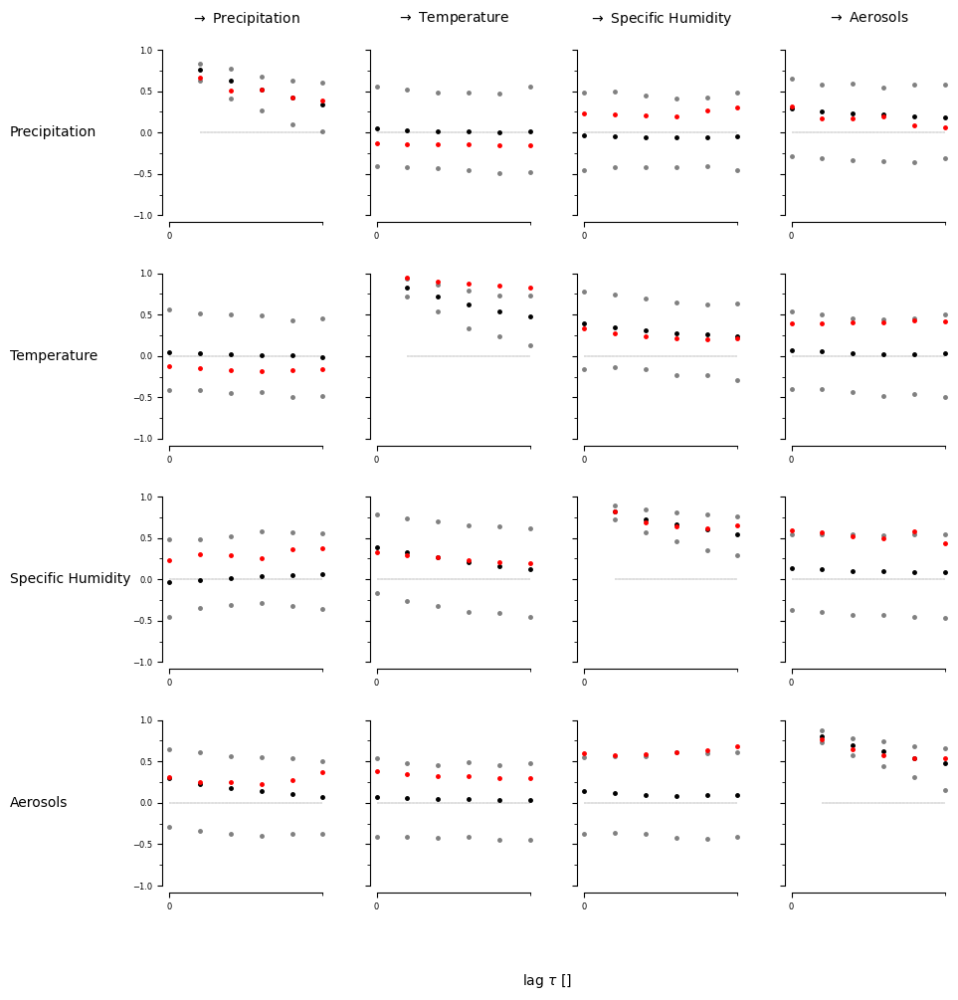

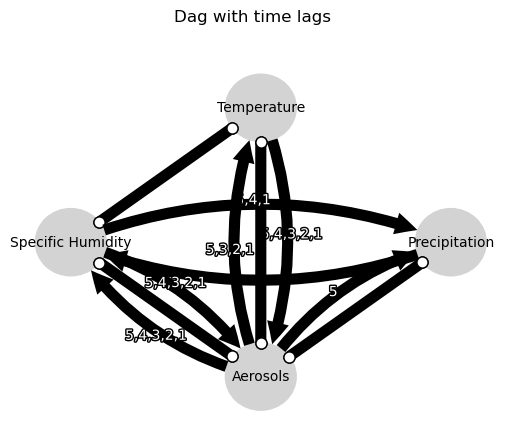

Negative precipitation values: 0


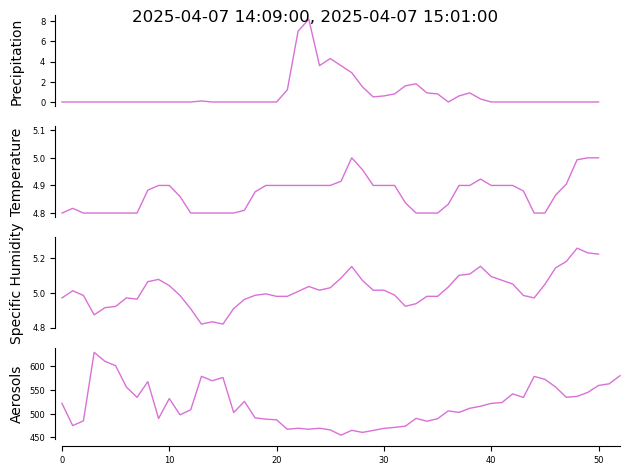

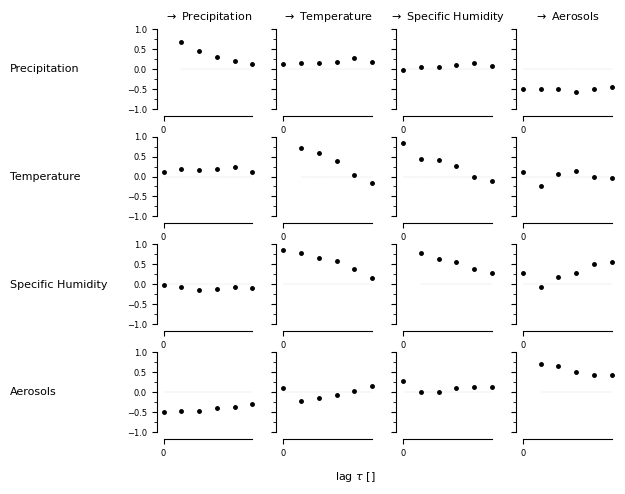

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


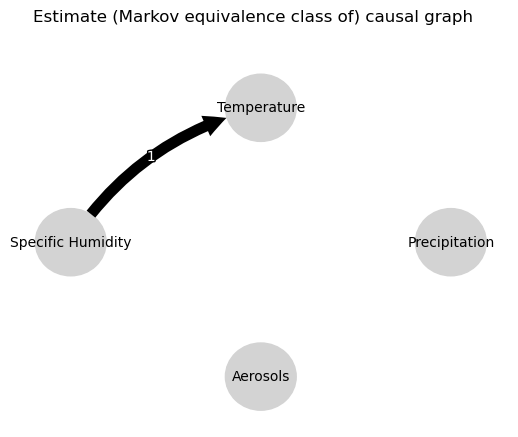

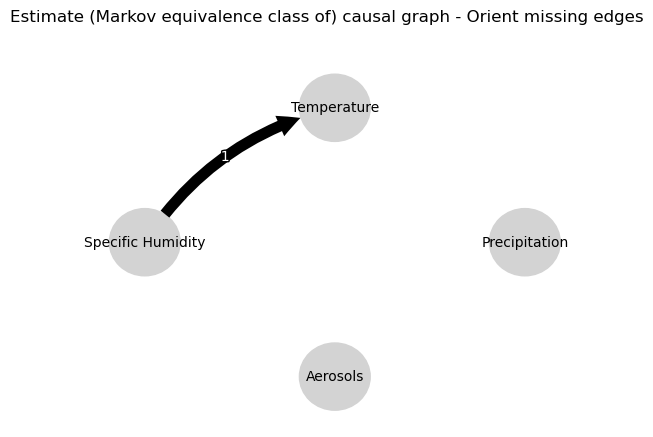

0.0
0.6050759880778132
0.40048442237422016
0.27884712639595033
0.181453730730048
0.11437513323357784
0.1167222151874371
0.007076715509184288
-0.004692695637417383
-0.038869255556681685
-0.03449278564790092
-0.04156875313382516
0.07522620787524843
0.02638438325787916
-0.01789814150365963
-0.03482356679157614
-0.052723641669768825
-0.05582267231312315
-0.1351473154880286
-0.09924899721625749
-0.10201185746398884
-0.09241839691119524
-0.08101085234177675
-0.05365014720455868
0.1167222151874371
0.10297366609769057
0.09480577932133355
0.06942261842304154
0.04496450747656258
0.027455176095975163
0.0
0.4343167745530589
0.37105298104129986
0.2837971401406804
0.21669860096203472
0.17143435369410173
0.6425304090811931
0.49318507749547513
0.3974263957790044
0.30251245639608365
0.2363710360152757
0.17718603184438492
-0.12213848375722103
-0.05087818982614052
-0.00936061453925526
0.0084926070435147
0.016113688220020125
0.05252738005706334
0.6425304090811931
0.6942260701732452
0.5283954076954683
0.41

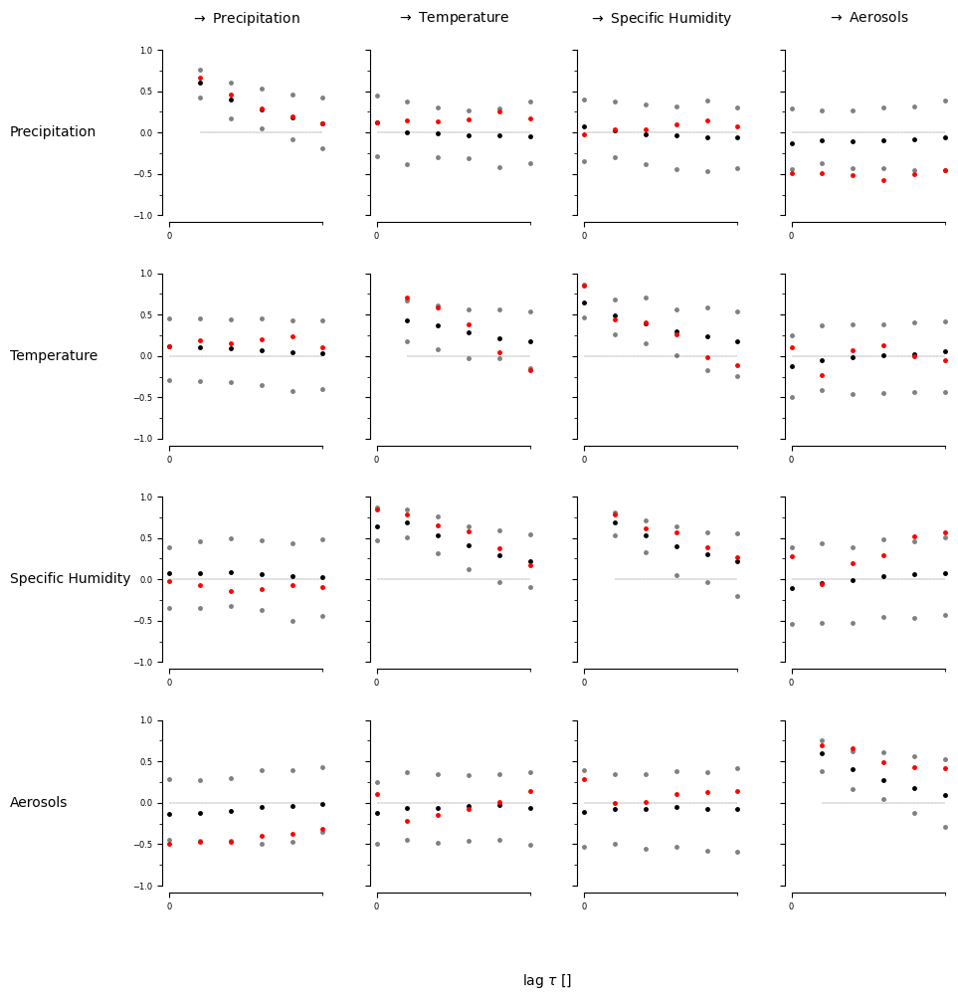

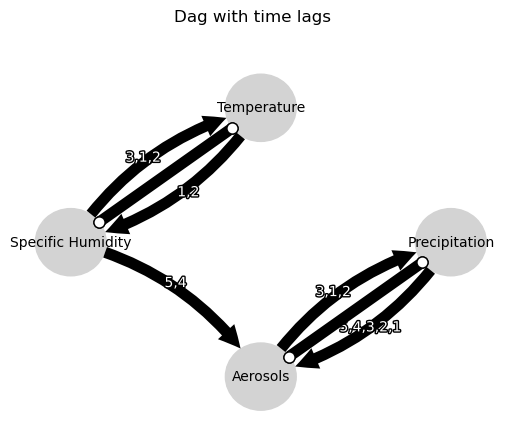

Negative precipitation values: 0


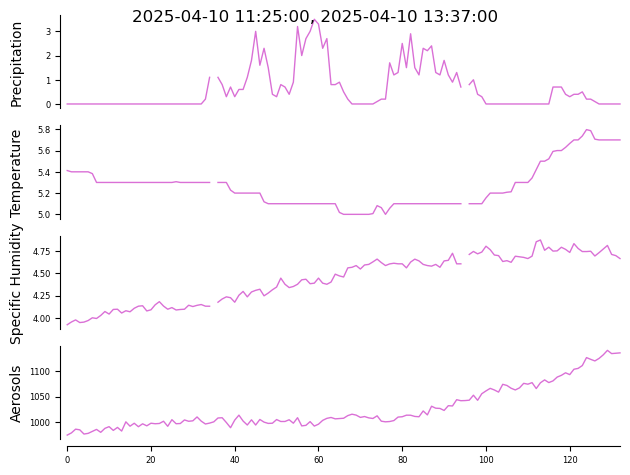

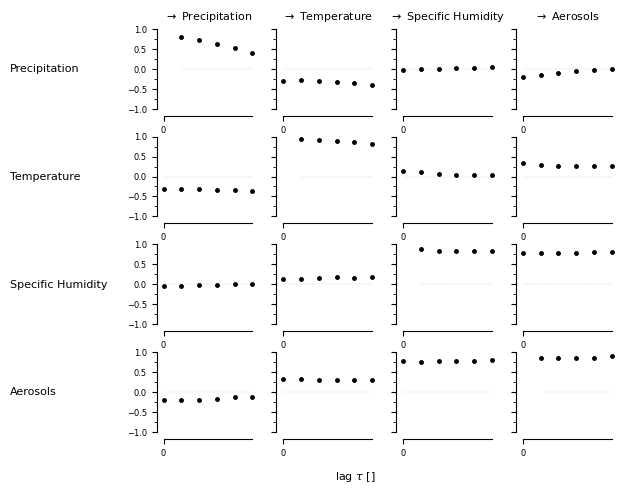

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


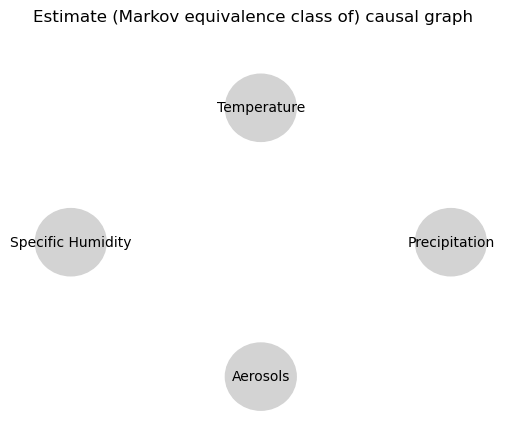

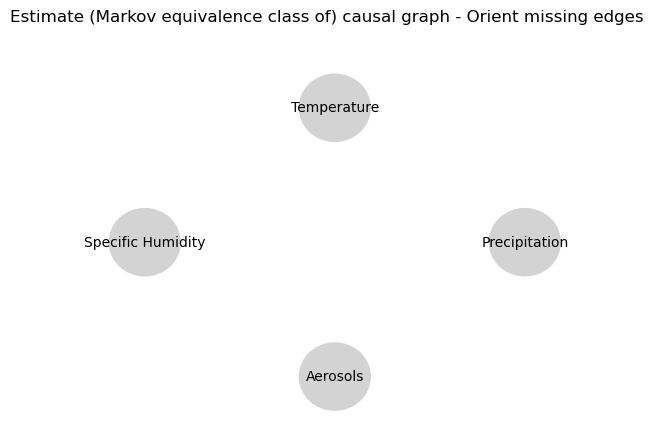

0.0
0.7575453714209358
0.5902417453146827
0.46981708007949025
0.37324787751151767
0.297472646930766
0.009017001610253643
0.0077688652602914575
0.0039014082325237154
-0.0009606127584770396
-0.002454882004360349
-0.003310714719430427
-0.0581407285044136
-0.048336273402883885
-0.04189949144467722
-0.03805909943962751
-0.029155406838893127
-0.028894185357922864
0.005187008131377895
0.013988683016317078
0.01473925902641479
-0.009385363127762893
-0.0005423640380376277
0.008575361273714508
0.009017001610253643
0.012975064460751246
0.01634132281233808
0.017090863610339613
0.022154079659802154
0.024070195824683945
0.0
0.9162271257970839
0.8675976678135896
0.8268238974619577
0.7926965533002912
0.7631502031524924
0.17180564873935394
0.1516341821491644
0.12390676064208252
0.10705808634092158
0.0915810786901665
0.07503891749580122
0.008123688493809494
0.01606850672696262
0.004233543467433706
0.015289268915326375
0.015146304620092145
0.018014418596487593
0.17180564873935394
0.16127192511032895
0.148

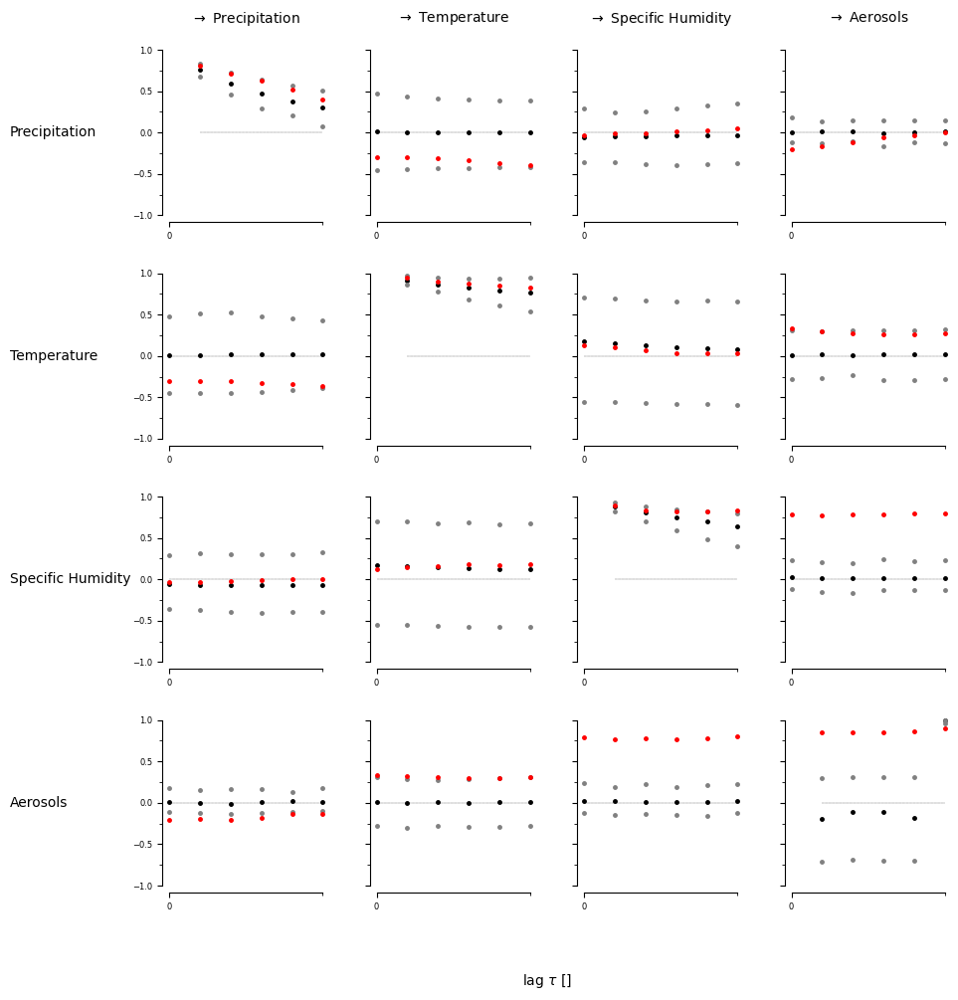

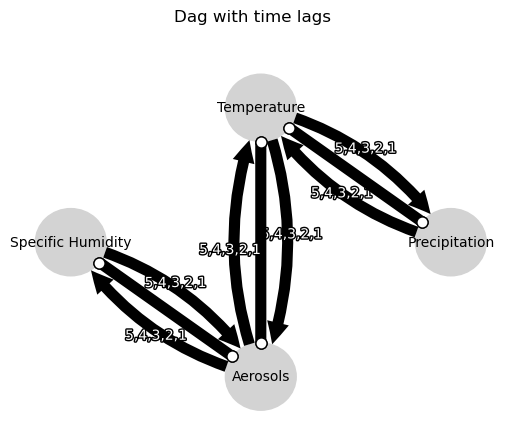

Negative precipitation values: 0


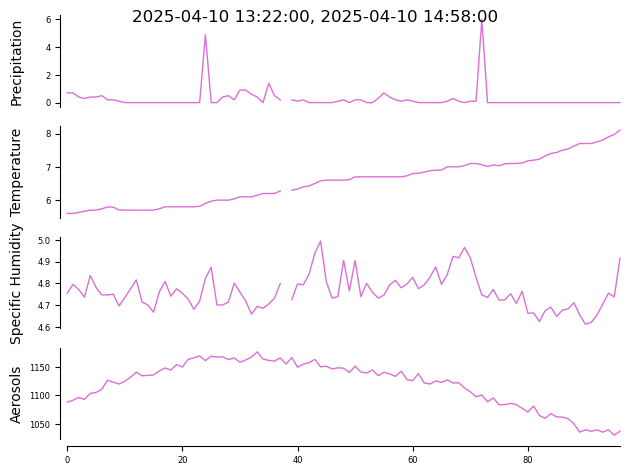

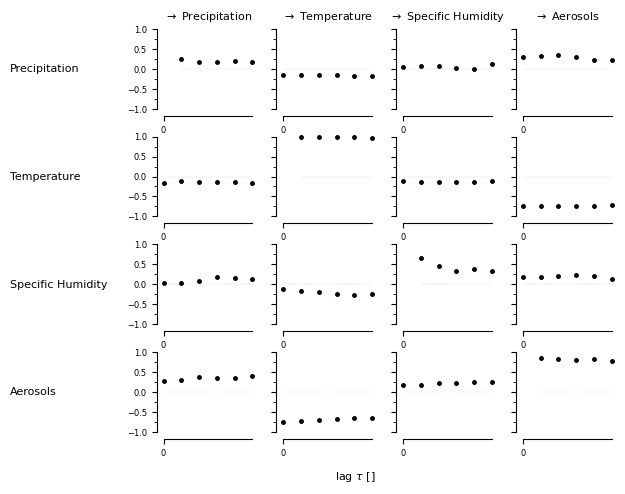

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


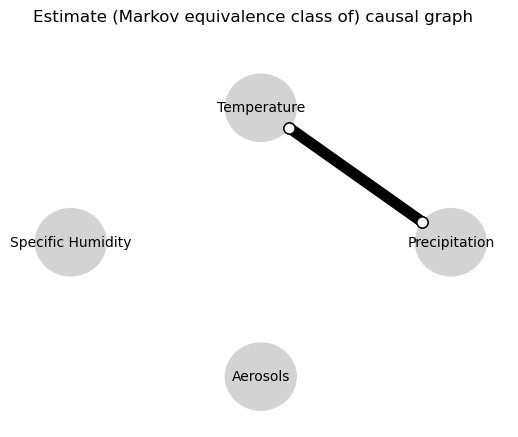

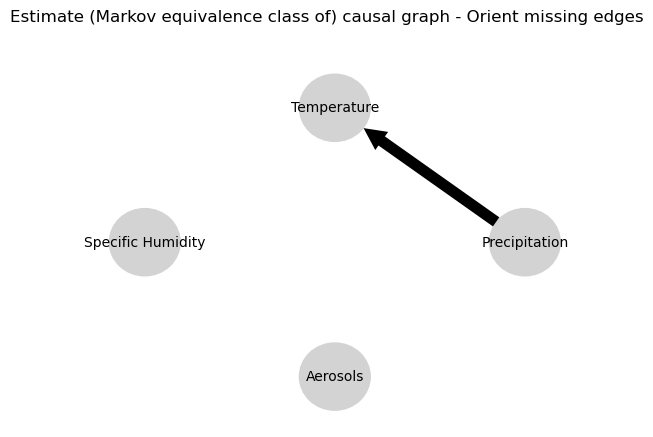

0.0
-0.011255795676127542
-0.023228726416306758
0.005106388947479801
-0.007196247612554771
-0.01776500868356517
-0.017031894763878543
-0.023401022629532475
-0.013480123626598641
-0.017866388254392736
-0.02085911292735725
-0.03367416712210771
0.010652303645799409
-0.01472021257056459
-0.038901897392343385
-0.010833128850308254
-0.03816092834743873
-0.017898882989714916
0.019511269652539374
0.029764121682654146
0.037278870889698
0.02339342089720164
0.011263805711528931
0.010880367365729974
-0.017031894763878543
-0.002799293187486037
0.006299808199539391
0.008053758123089536
-0.002789003424066152
0.0029885694486398483
0.0
0.9129286113698001
0.8744222024162509
0.8373539544900498
0.8148800564228352
0.7944248655329882
0.03492907899269998
-0.028569387151459638
-0.05991158526560527
-0.08206983355944836
-0.09093091301628223
-0.09568118912278424
0.10796794286248942
0.10035877855307024
0.09341033744364804
0.08994828729908613
0.08780300384610078
0.08655510177872121
0.03492907899269998
0.0356013210

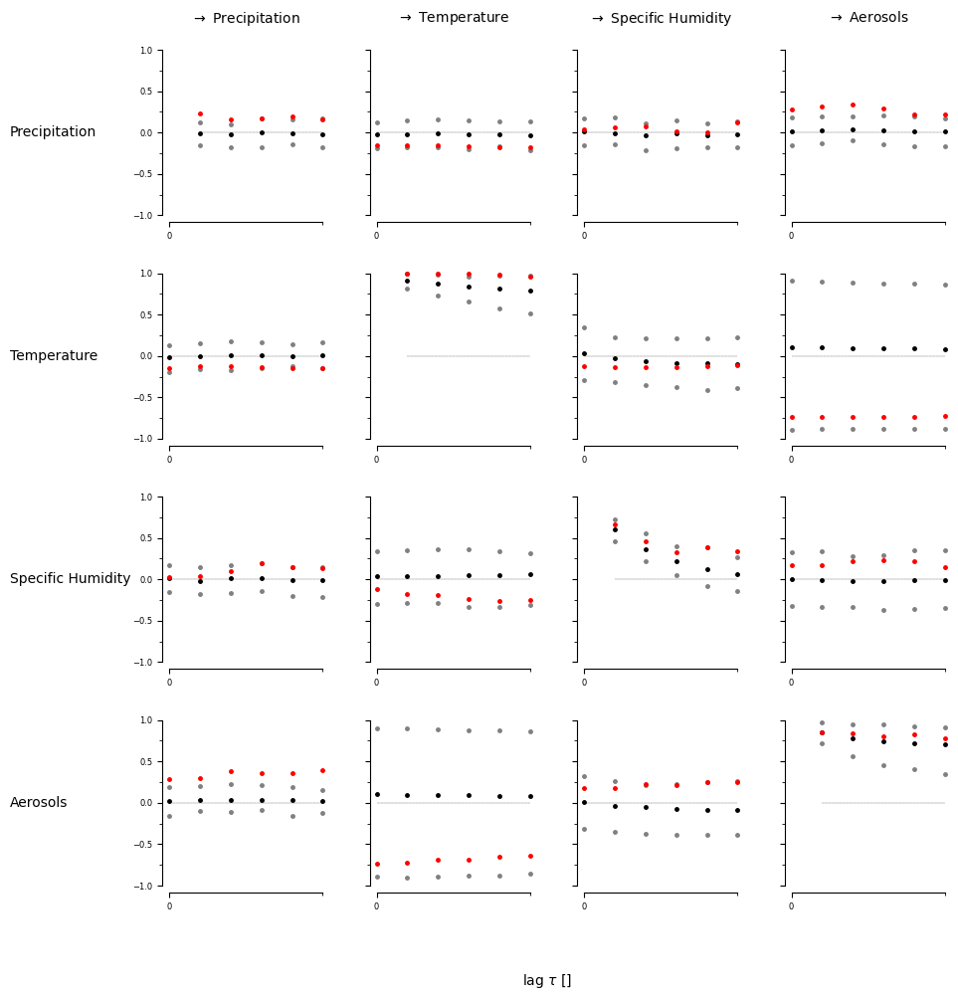

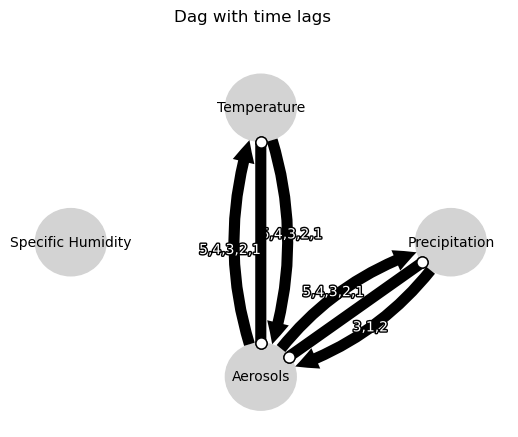

Negative precipitation values: 0


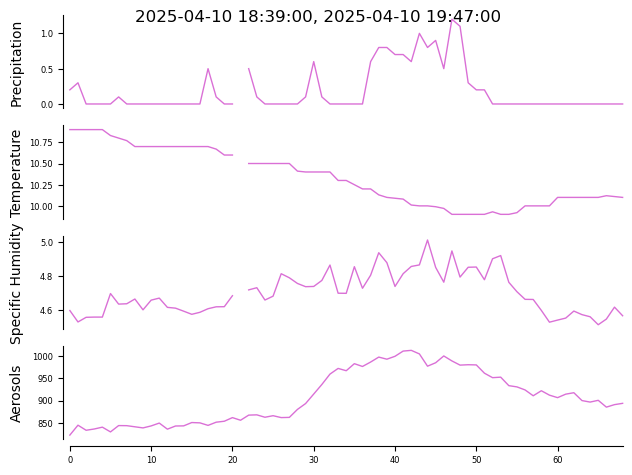

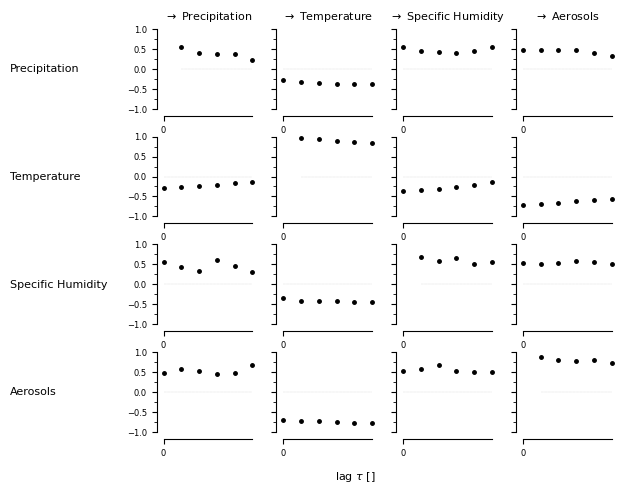

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


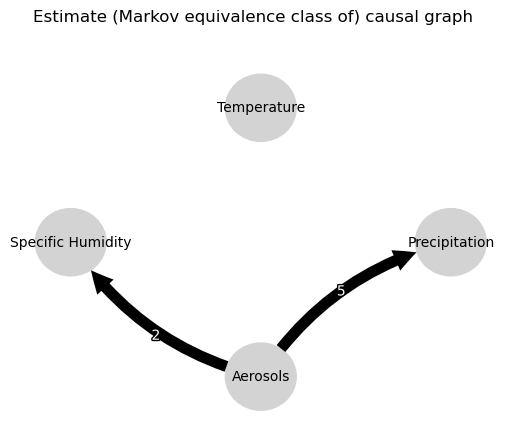

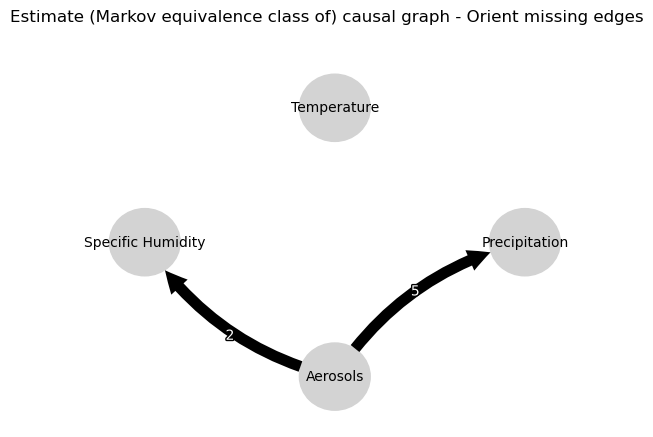

0.0
0.5892880267629492
0.38777856458676097
0.2674148074313712
0.1600850023312099
0.10779572108029091
-0.07453419118839402
-0.0616027212934673
-0.054011817508907364
-0.039437896188736096
-0.011861622419772693
-0.006434964379179881
0.21805825979001245
0.13060470253262463
0.1582245682619966
0.14804744587588414
0.11511554892288237
0.12211702409158269
0.14588874469964302
0.12750159174177866
0.1204820356840794
0.09924363878761888
0.09894789508899442
0.07078959939482285
-0.07453419118839402
-0.014417271683538641
0.02035212439322073
0.026762027586400915
0.022851051279575915
0.020761137122993715
0.0
0.7729672711551782
0.6677140655590417
0.5798020729113066
0.5192478893294488
0.4577875156877759
-0.12818330115088739
0.004412348347333376
-0.027137389439205132
-0.02938622792302659
0.03109615340274845
0.02070879576404271
-0.07569701037589346
-0.07701486966598792
-0.08767654693855219
-0.07830724737858168
-0.07724247684169143
-0.07324942479348322
-0.12818330115088739
-0.12109643441748297
-0.10043605574

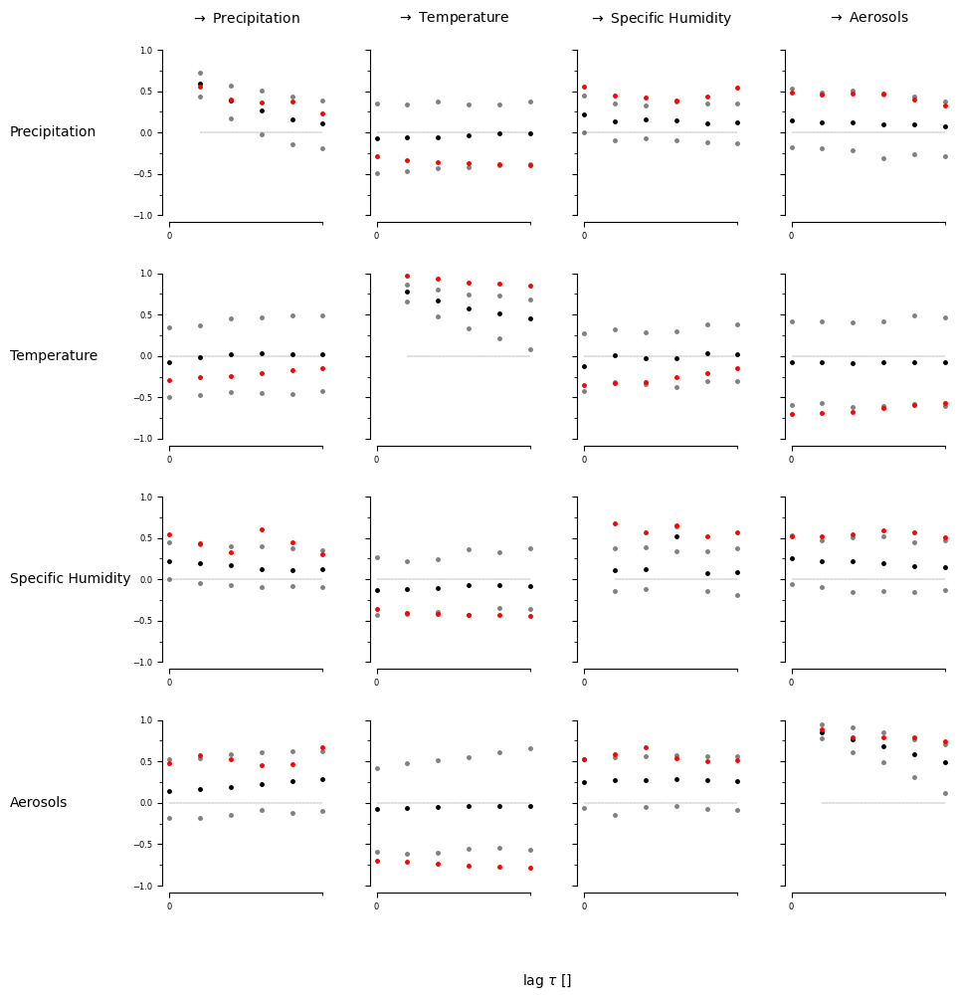

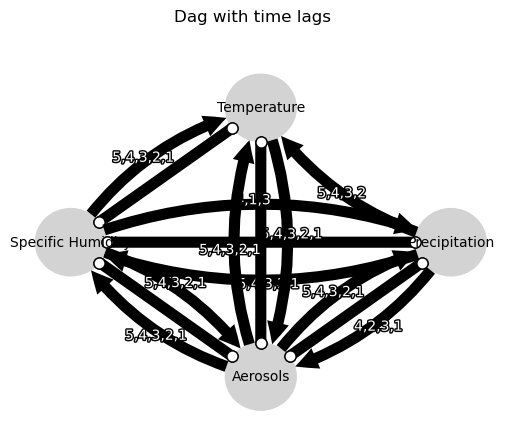

Negative precipitation values: 0


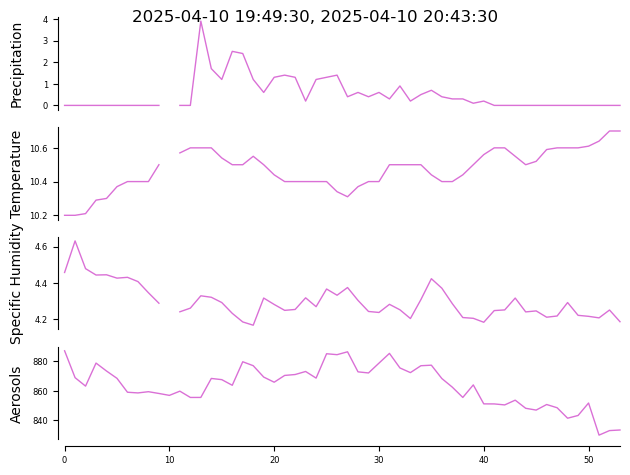

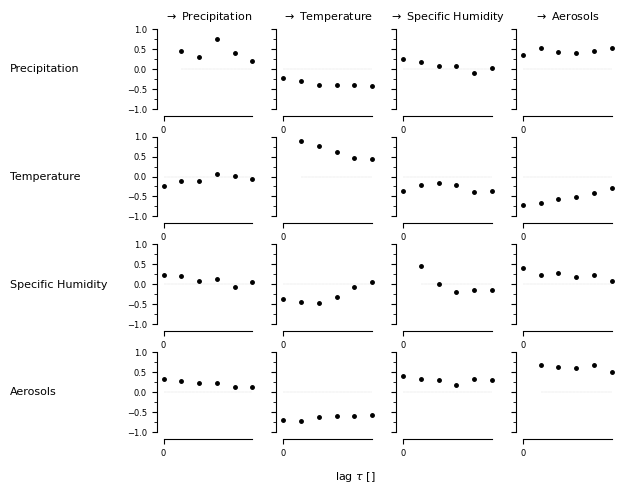

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


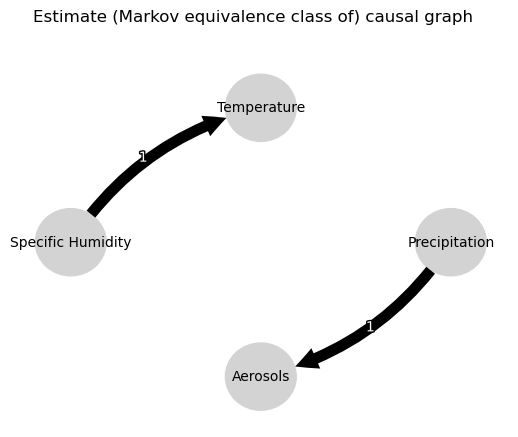

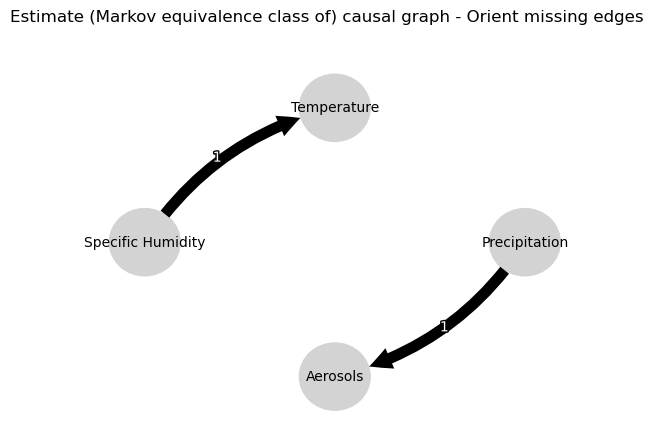

0.0
-0.016818784009321873
-0.03535578819007399
0.00641723642934378
-0.02914048798947384
-0.02548914045383126
-0.14437134373570765
-0.08398749498741205
-0.06627603185189461
-0.03902240533589332
-0.056291404188771724
-0.040508858586543205
0.01520366752637194
0.006989694990807551
0.01946269840061683
0.025541268288103835
0.024393758289017544
0.01599484222050396
0.08807186713282757
0.5206298951269452
-0.02907958825705487
-0.009543003748875038
0.018268104405111917
0.0015378107812702964
-0.14437134373570765
0.033634108695104276
0.014416128633510071
0.002234749819816162
0.009577873910249023
-0.004642563827264994
0.0
0.696147567350025
0.5316133380878331
0.38958104718969244
0.279762813954388
0.17934622177760043
-0.2900979424465149
-0.14756509082146246
-0.05139710247698007
0.005933790179432464
0.0453552341253565
0.08253371319999392
-0.11532256346585074
-0.02073896141919554
0.0673565110141688
0.070750193691674
0.02220255230998948
0.01588570642074544
-0.2900979424465149
-0.4101882092760888
-0.42920

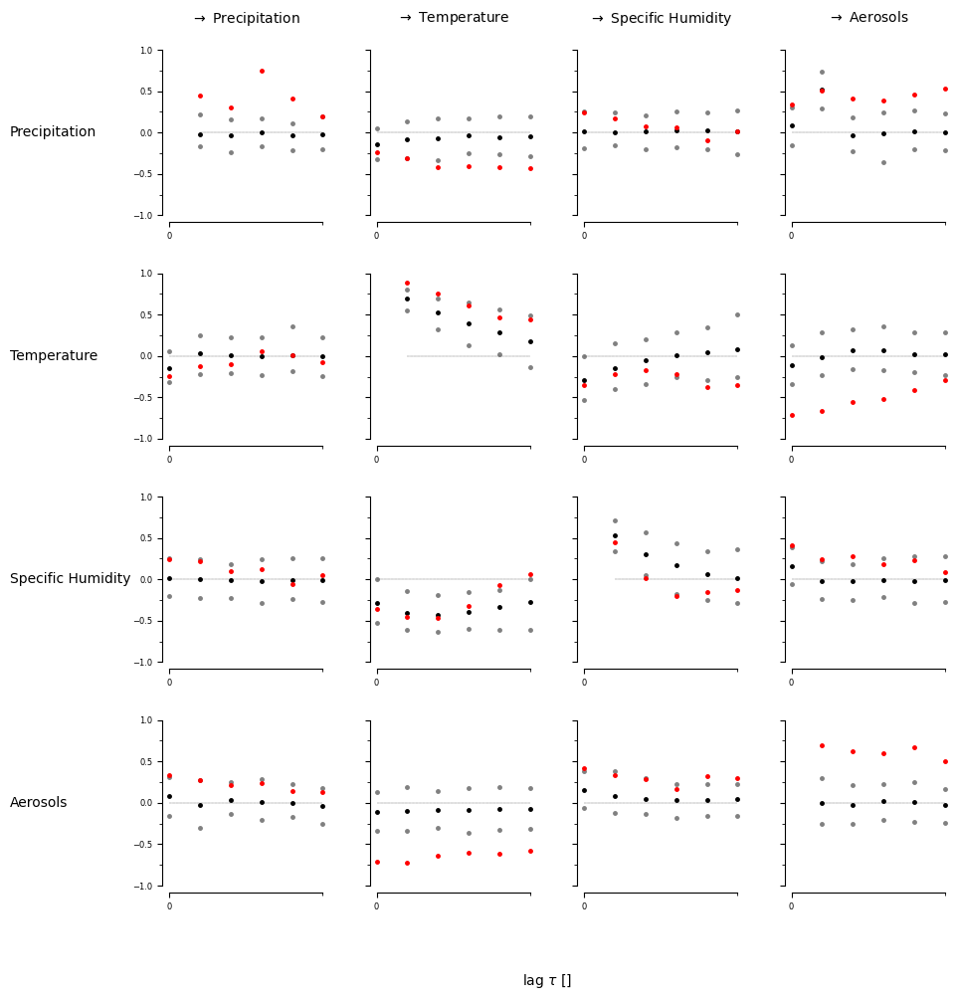

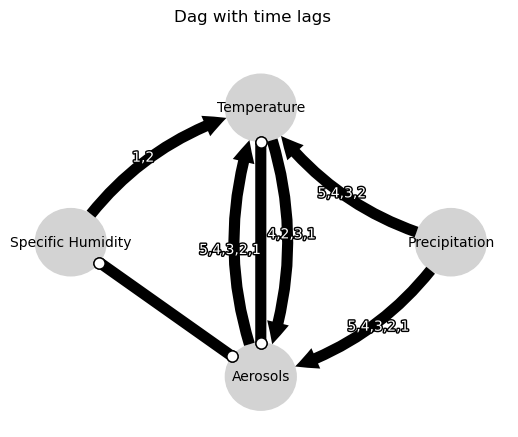

Negative precipitation values: 0


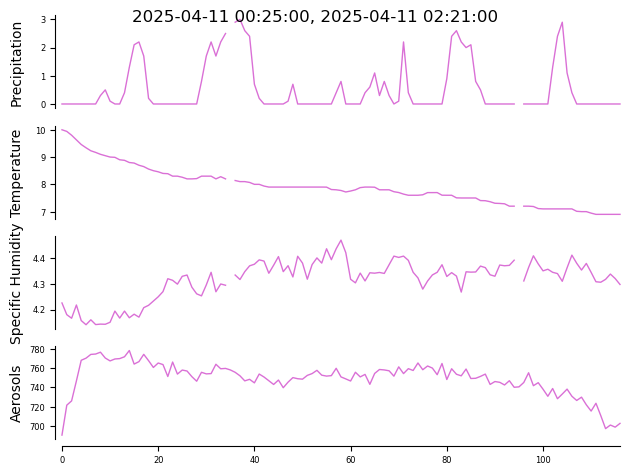

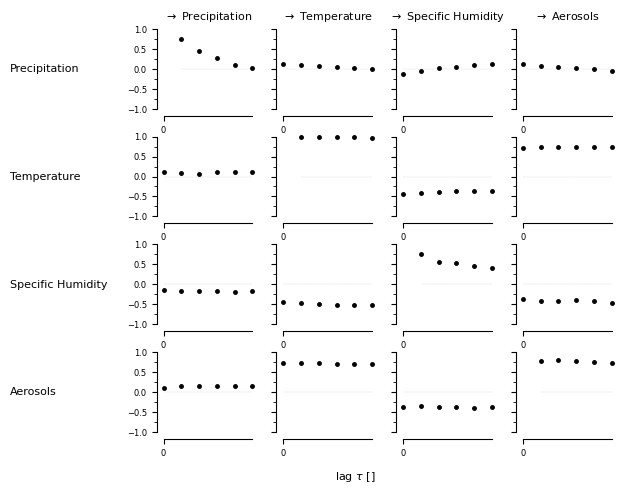

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


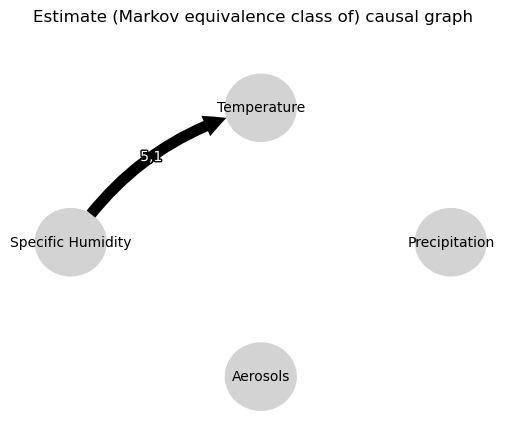

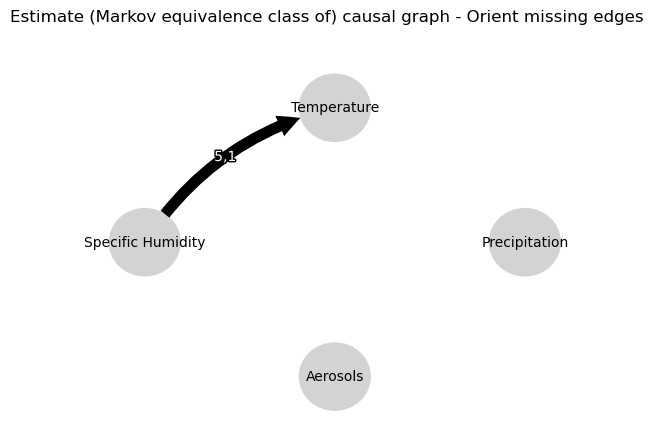

0.0
0.7126124064388714
0.5165232245866822
0.3774197119573791
0.28329357834451924
0.21209729223832766
0.08590556800362256
0.0828323872051458
0.08084134868763133
0.07759901094465127
0.07149863069257893
0.06611877388534976
-0.057189551628543486
-0.06123871775588233
-0.06018019591768445
-0.06044371862107829
-0.05645188712982898
-0.050130520886468945
-0.04317683995002798
-0.045271699493550706
-0.038628548814736395
-0.03872314719105976
-0.027888619546905205
-0.02830296157653903
0.08590556800362256
0.05377776455838155
0.03343846880027318
0.019790378764238104
0.006049902847453471
0.001479229159994075
0.0
0.8950837080966941
0.8249123610570728
0.7528212390461513
0.6930400171106984
0.641477453759991
-0.27503443911900455
-0.26464542651628603
-0.2573086207809071
-0.24487959366809128
-0.23440467507099164
-0.22038988141521493
-0.0015994361544738767
0.01512204879587712
0.011275178549809983
0.0182577340825529
0.015361298841179302
0.02429616246852633
-0.27503443911900455
-0.316933905639276
-0.3210122079

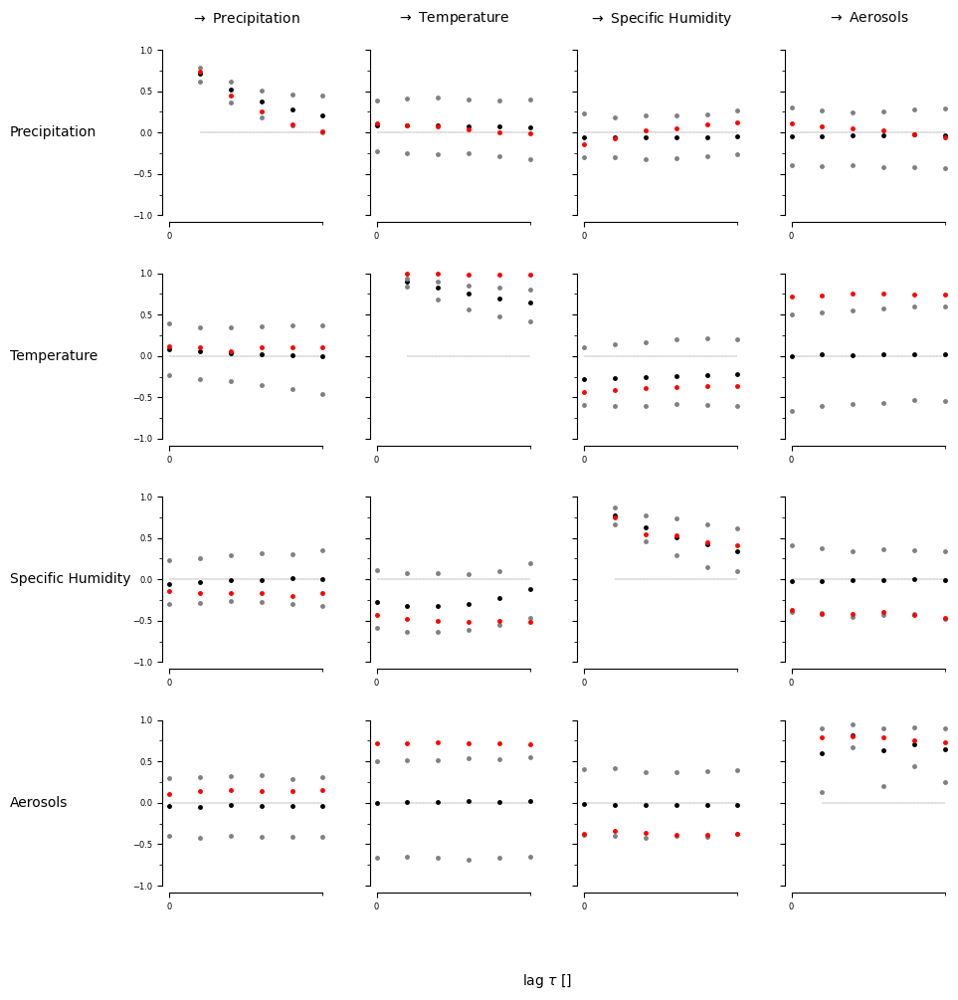

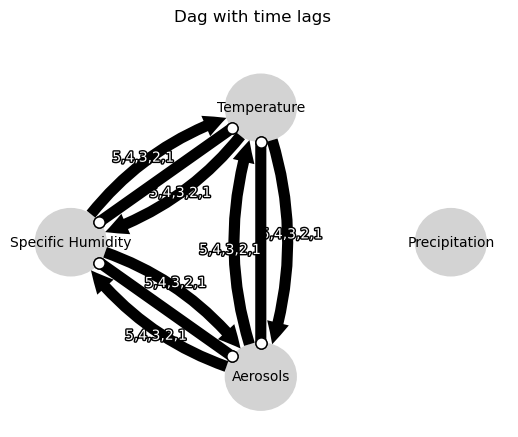

Negative precipitation values: 0


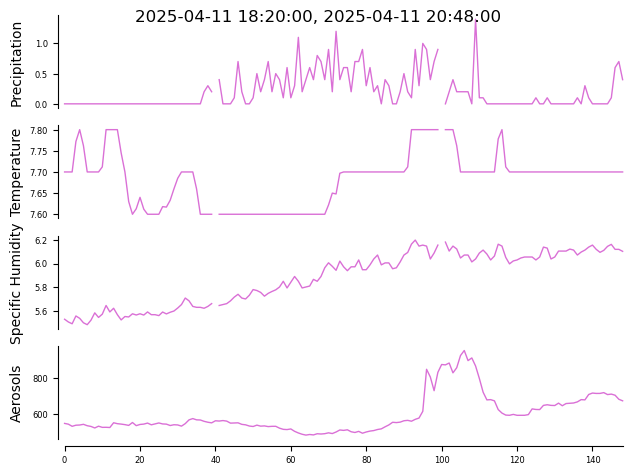

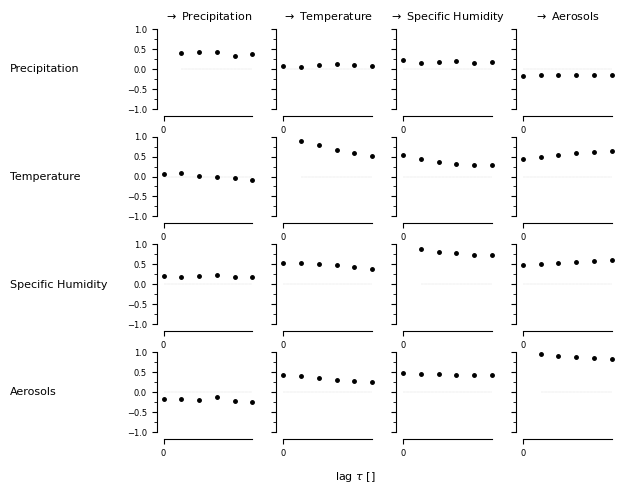

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


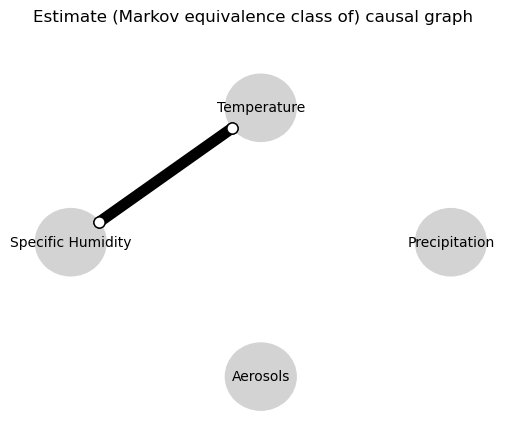

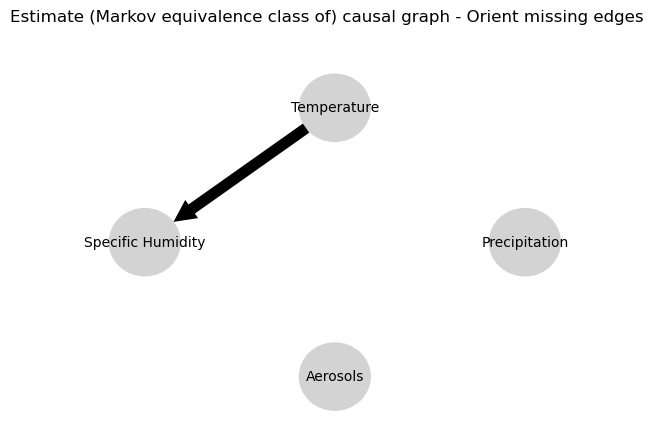

0.0
0.015109395691231549
0.4642505803694425
-0.010369859852877422
0.23229143488394133
-0.011856837023504947
0.026249929173520748
0.03188566037325047
0.024423144996139665
0.02784710824482679
0.026699763383161716
0.03632569176599423
0.04733349167830404
0.045818877763191254
0.034984613869108984
0.03751914849052431
0.02808210272120894
0.03286653523892648
0.0687814740647279
0.0609027142942361
0.0556723568157328
0.054915544694232564
0.05833346974431364
0.0631613634024026
0.026249929173520748
0.01764184965132412
0.012346162714644704
0.010924410500596515
0.006956550503361788
0.00498824214138755
0.0
0.8590947287109644
0.7612784862444393
0.6784242689190216
0.605499959054415
0.5411226079392167
0.34451272274158223
0.3252468065263578
0.3034886816210459
0.28754501798010057
0.2722929295225637
0.25401421841281824
-0.04304032184263755
-0.039901379133856565
-0.034972912962543394
-0.03362547291532152
-0.027435856992161046
-0.022773629086936312
0.34451272274158223
0.3027315470919443
0.2630891002837995
0.2

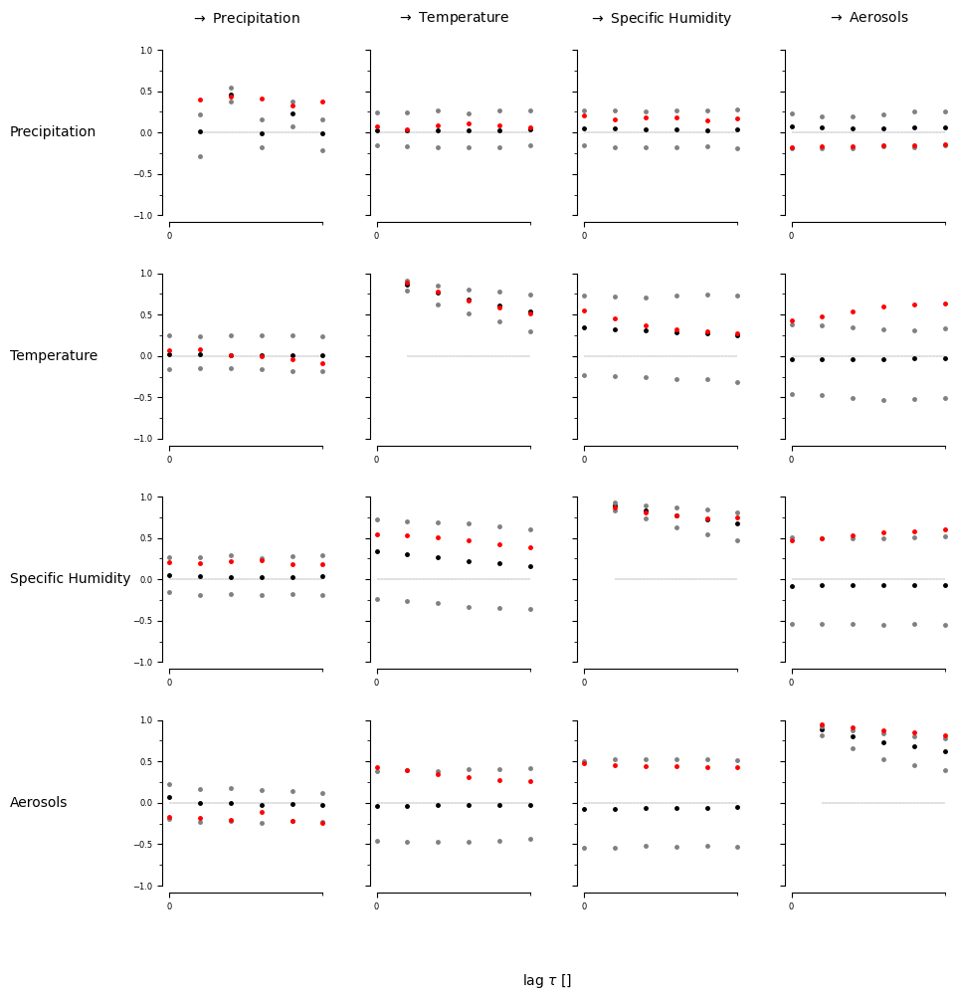

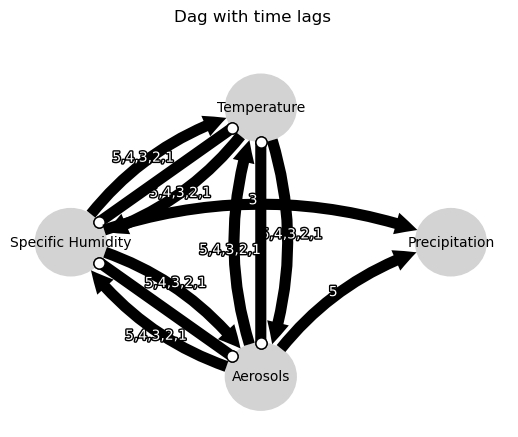

Negative precipitation values: 0


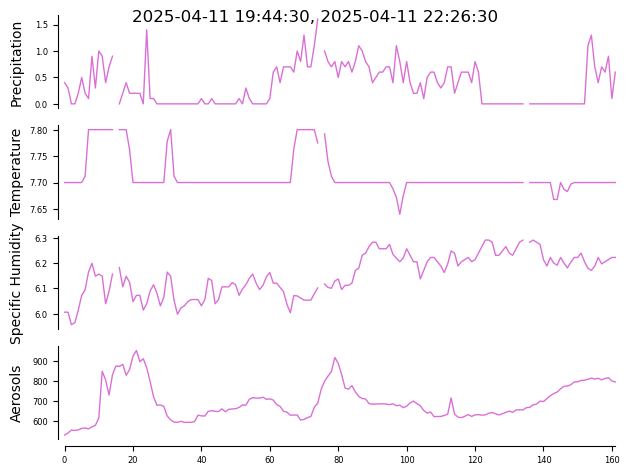

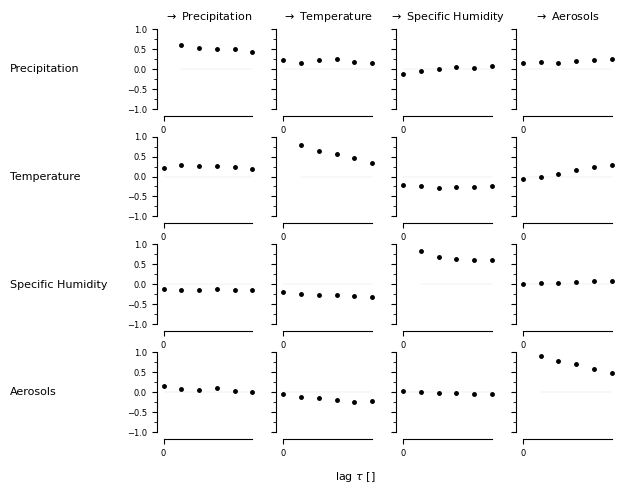

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


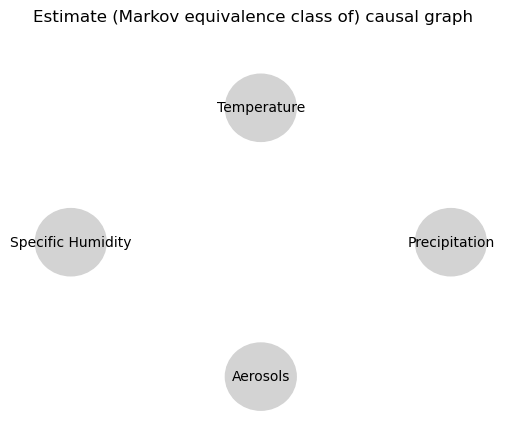

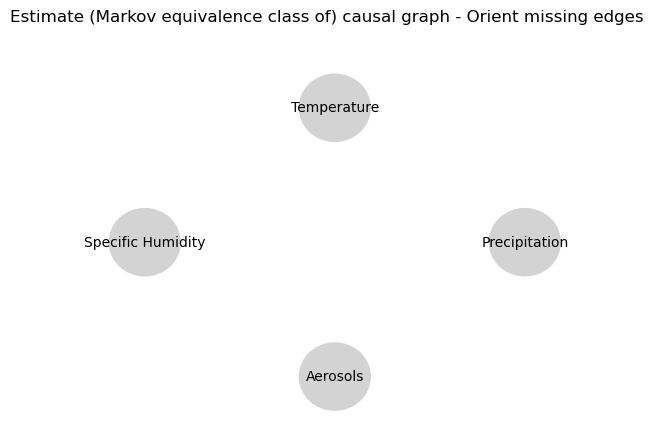

0.0
0.6711677059515279
0.4646079390265051
0.3252449810635123
0.22944112584751036
0.1563575579172739
0.028249551651727302
0.023184654546938452
0.0201784628368094
0.016409822559746972
0.011035403261536656
0.017876298509149558
0.04960283324292619
0.03831741582118004
0.02800067618737383
0.023331217644271575
0.02007990128450733
0.02468294031039834
0.05485504645849977
0.04670401736576125
0.039251532537974886
0.036802934594727776
0.03587466872140106
0.03156984499527895
0.028249551651727302
0.014615476580357278
0.007911158594220126
0.002183164034255786
-0.00826770480611148
-0.010459637444514723
0.0
0.8133532828505845
0.6787531809273872
0.5682440474393882
0.48057948315750393
0.40579686115638325
0.3622568687745181
0.313029222459524
0.26673912596484006
0.2339912880566083
0.20242374968849317
0.1721330110532107
-0.12552206066064764
-0.11636031012760982
-0.10182033658651767
-0.09218885243140897
-0.0758339435106862
-0.058539400478712283
0.3622568687745181
0.30180684602335256
0.2511529535277466
0.2076

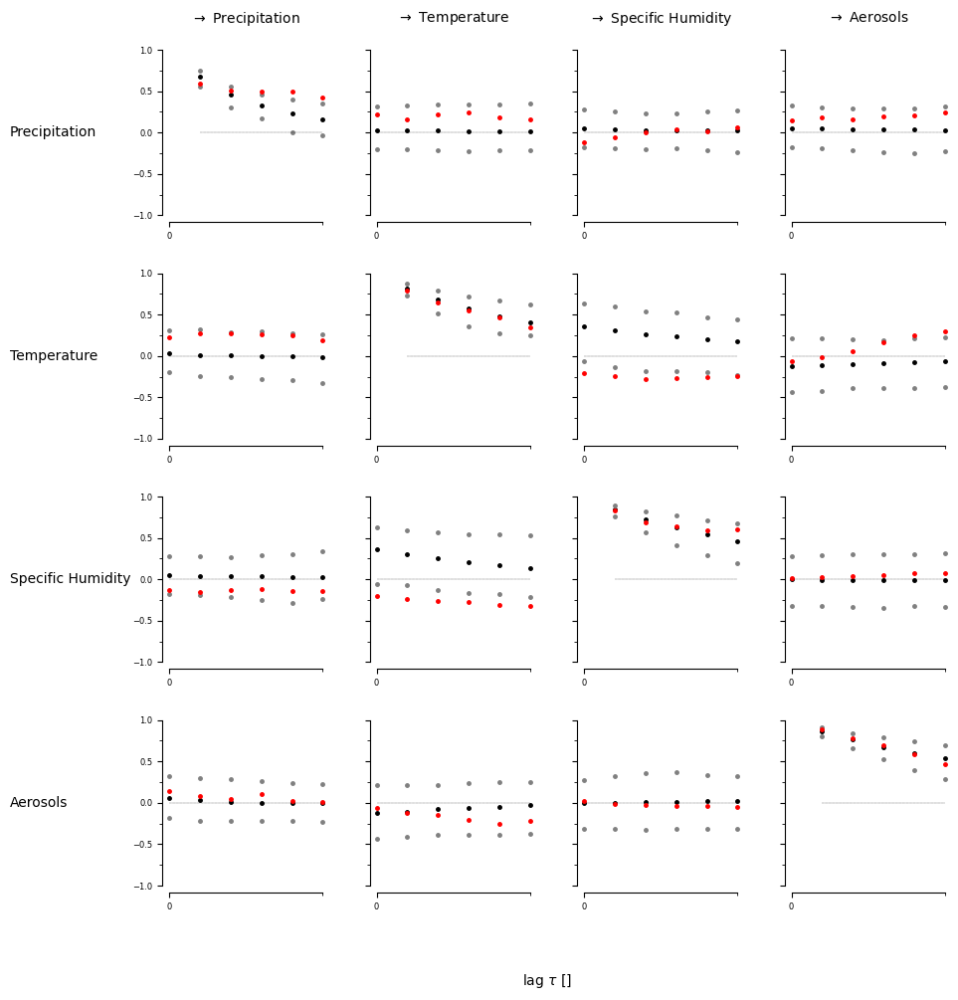

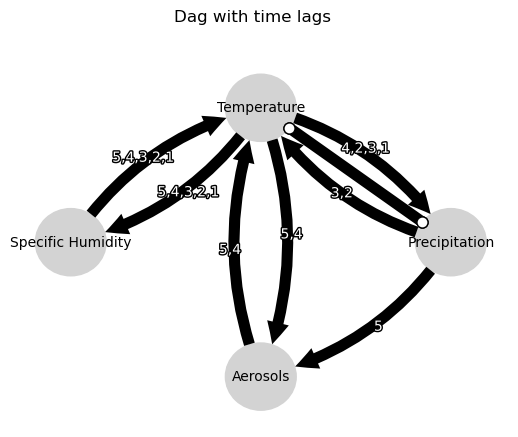

Negative precipitation values: 0


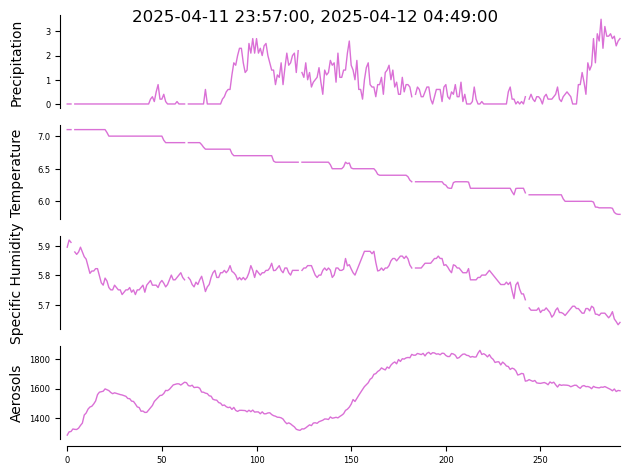

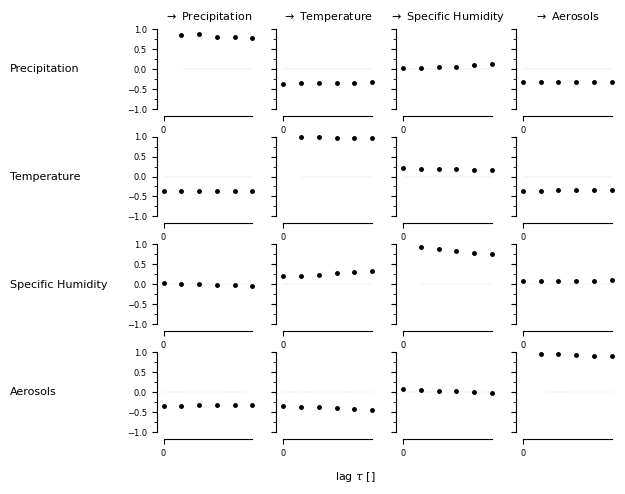

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


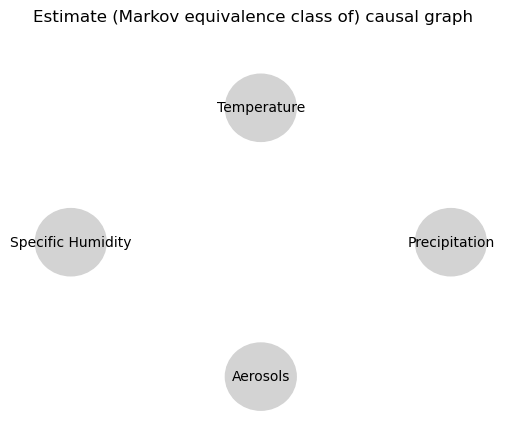

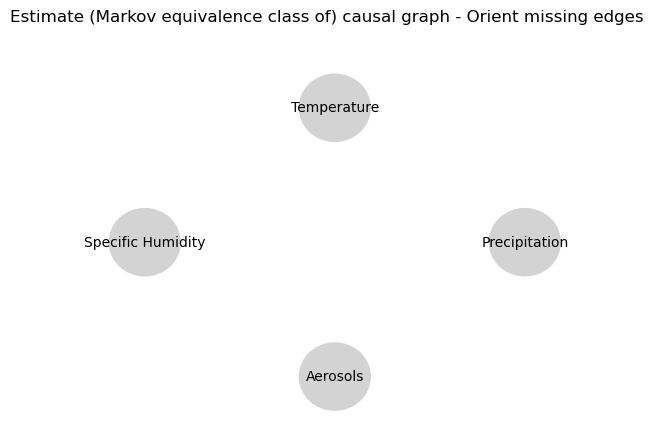

0.0
0.854254364683335
0.8461350009790484
0.7835748113002383
0.7496939171621237
0.7088350567623847
0.015020215064329828
0.014508299153009094
0.013316573245136503
0.0117746674871411
0.00852635264674541
0.008216371181058581
-0.08227717792172178
-0.08126226120617423
-0.08077306511652967
-0.0819122366553785
-0.08262822556175936
-0.08337001935338416
-0.022827703961416868
-0.022970567566826423
-0.024798042151179086
-0.02410698200556357
-0.027477248108713184
-0.026615998786426193
0.015020215064329828
0.012394959580857129
0.013553968762334969
0.013481811749903568
0.012569644539268086
0.012439489095767284
0.0
0.954464949976177
0.92504909945594
0.898823550499265
0.8745429747514065
0.8532026622461142
0.3280396794019802
0.30233740015972727
0.2797551769975152
0.2588962198302535
0.23989493905848402
0.22190624644553253
-0.03418615440666478
-0.034712955281904496
-0.0361744042993591
-0.03708749409542708
-0.040013464845214994
-0.04147864481561025
0.3280396794019802
0.3167631299073608
0.30728985542783305


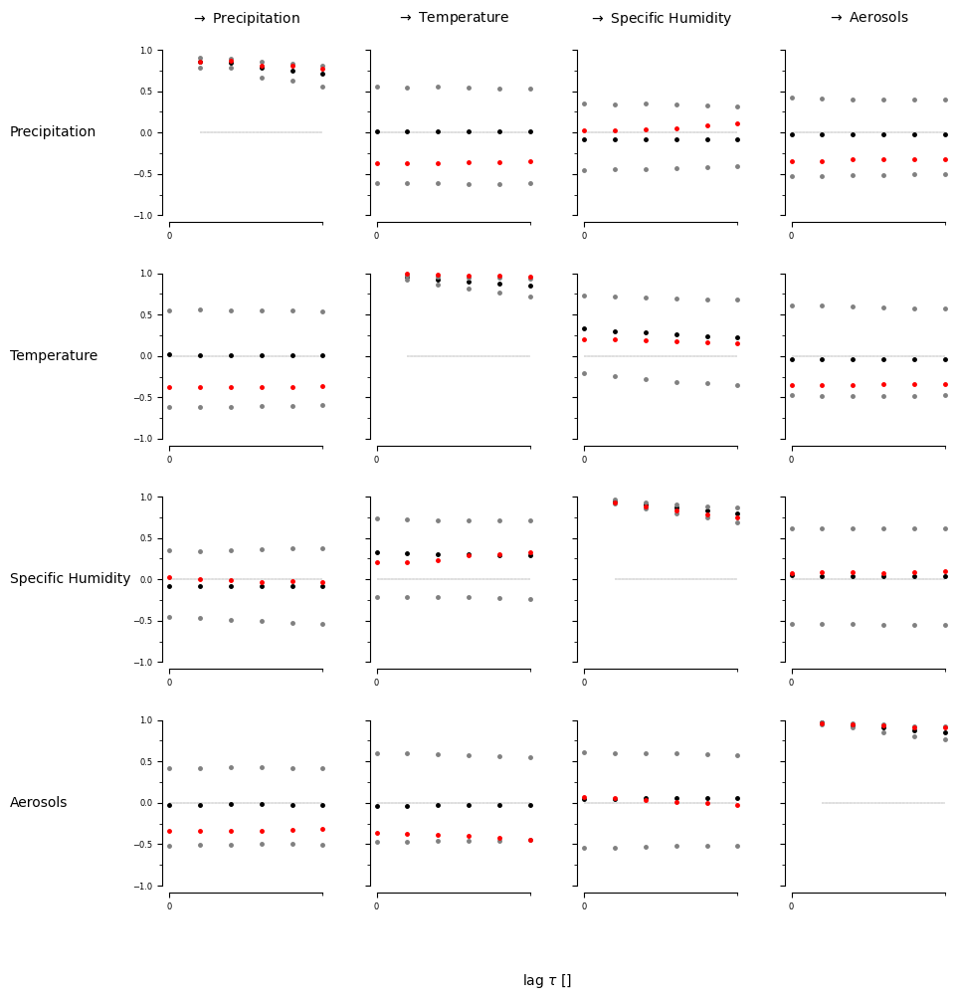

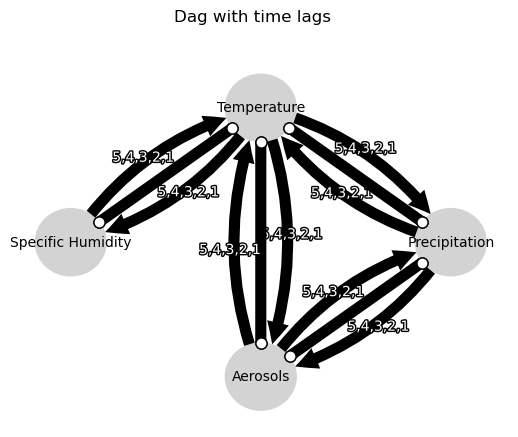

Negative precipitation values: 0


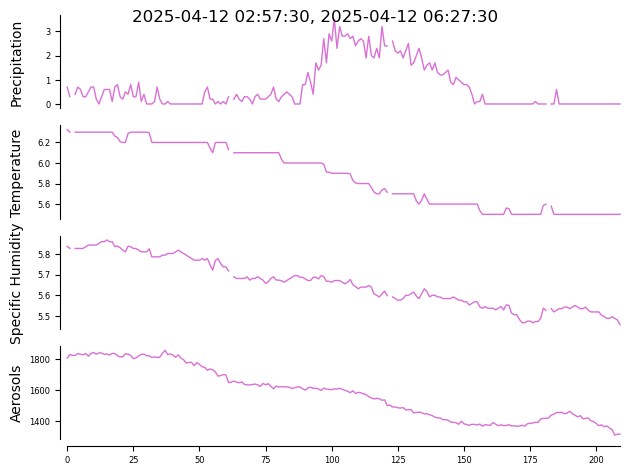

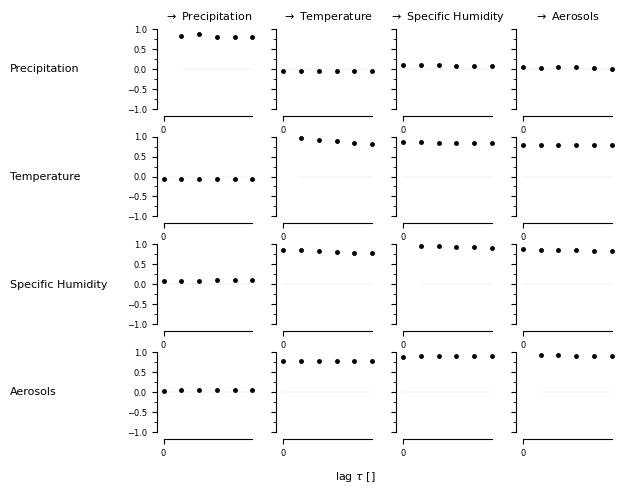

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


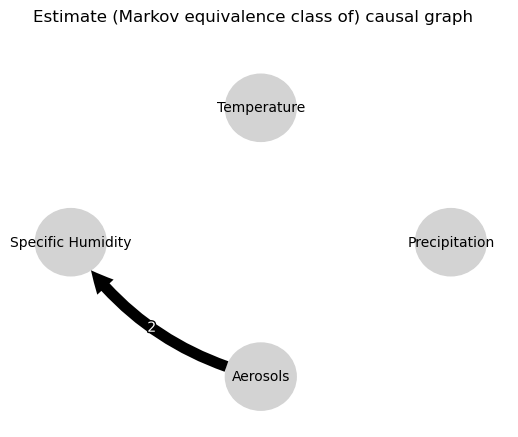

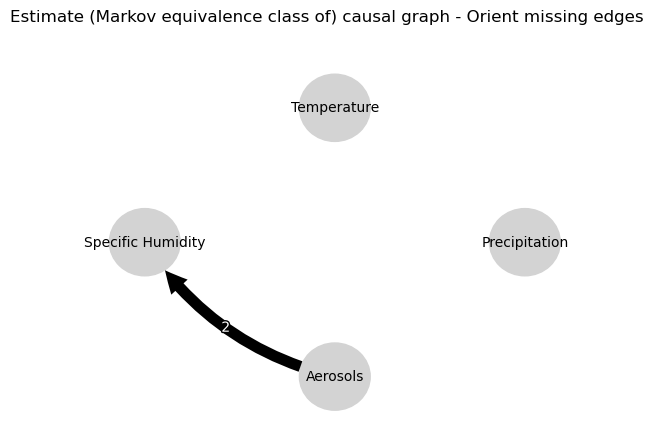

0.0
0.7759705967489283
0.7733193172654309
0.7098805979408209
0.684499292990748
0.6885098866273122
-0.07621787161584574
-0.07017502913251969
-0.06806121214630216
-0.06594357756524985
-0.06678376901879184
-0.06713457981456693
0.009962161217417814
0.01410190950913296
0.015252315224404329
0.013914609415712733
0.01304611249125893
0.009761746323036995
0.02989842118566088
0.02825829181254815
0.02384671063275369
0.020802093620100378
0.013442163896753014
0.00976027424090566
-0.07621787161584574
-0.07667713598169285
-0.08062801957213868
-0.07622003886331123
-0.07781964930093763
-0.07875786643694883
0.0
0.9298451460141098
0.8836759890002619
0.8413564911545042
0.8051726941181262
0.7711268225117953
0.2755735437108039
0.2102612134731542
0.1582586361407643
0.11376798776892702
0.07977654650475233
0.05108188815298216
0.06893976193171829
0.0653535169669708
0.06303932878961187
0.05950615250601561
0.05609526572706473
0.05511124687380848
0.2755735437108039
0.26083694021571463
0.24651858328793938
0.23421224

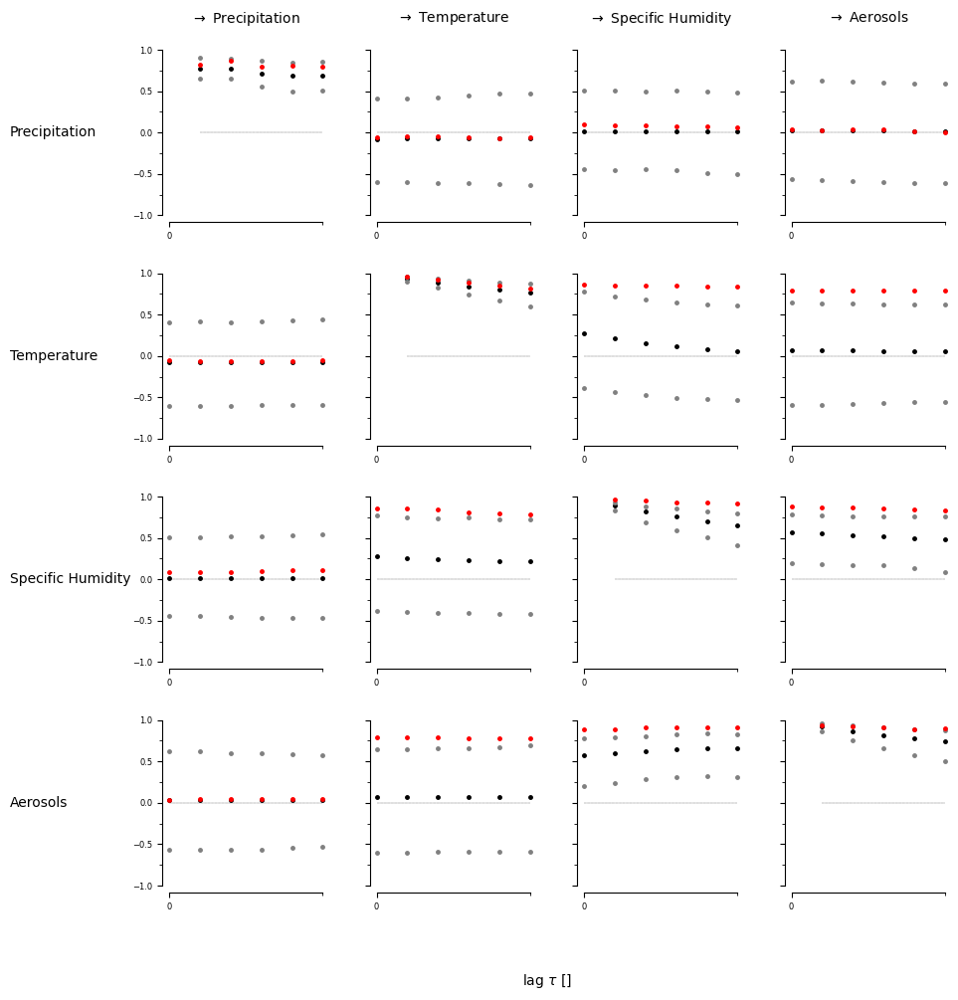

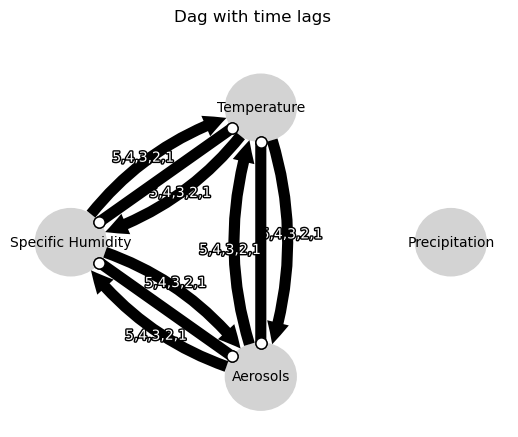

Negative precipitation values: 0


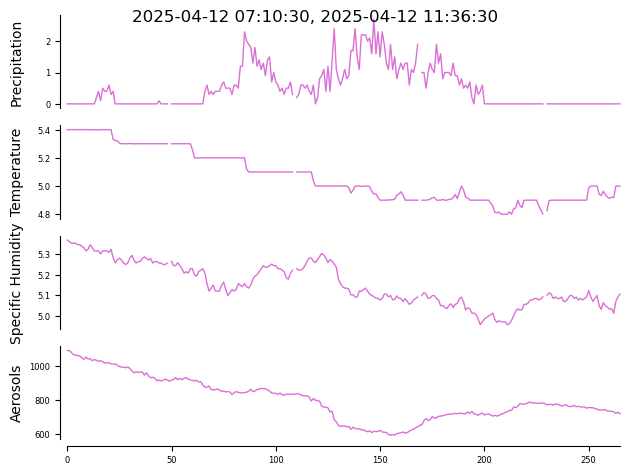

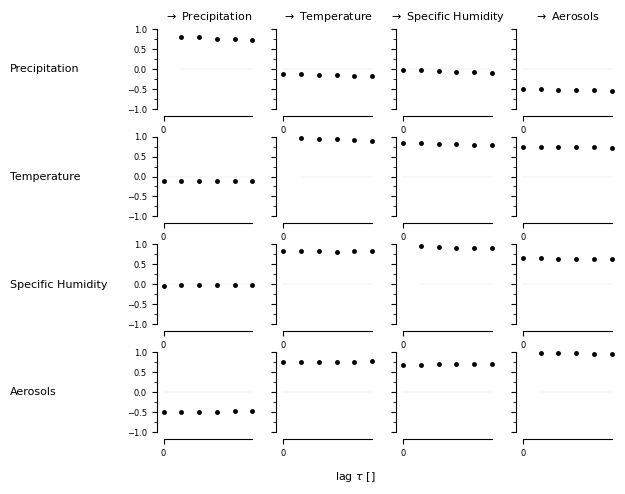

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


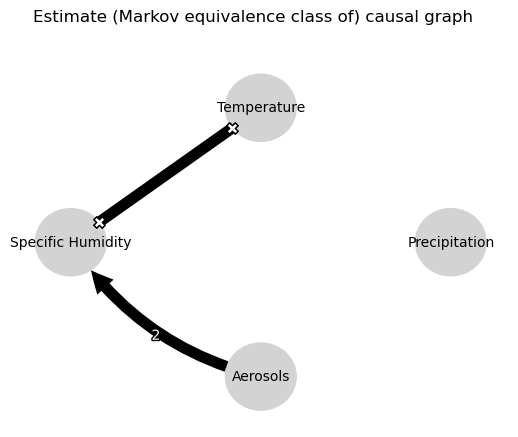

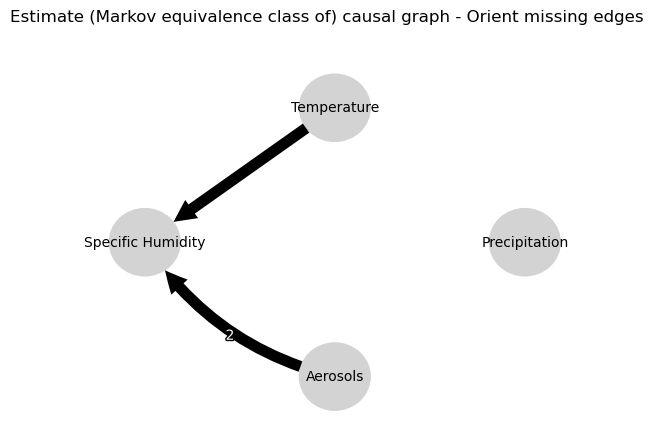

0.0
0.8219476984826702
0.8090334987654854
0.7378134607365755
0.6974046693224913
0.6473987340787895
-0.05812400670699131
-0.05480477026507195
-0.05104127183285611
-0.05126073113179166
-0.049248268913897636
-0.051343594231376015
-0.016554053136778265
-0.021080310112381328
-0.019945244084803682
-0.023234999269568197
-0.026595680200087946
-0.02745883094917306
-0.10404338312145363
-0.10060432440034939
-0.09484799826471599
-0.09264496549765862
-0.08746555092583536
-0.08476636906290685
-0.05812400670699131
-0.05530249585944201
-0.05580119948859932
-0.05358947976531919
-0.050089483182861175
-0.05004124228441539
0.0
0.944977713333155
0.9066829212444611
0.8731936930650417
0.8430377300855185
0.8133317308061563
0.4473660571843168
0.4252220452776433
0.40291229807112416
0.3862200692238345
0.368243288584297
0.35092546781662537
-0.08014557292442173
-0.07895075297588795
-0.07685953689607629
-0.07409766043215979
-0.07250425824405303
-0.07082720672225841
0.4473660571843168
0.4320920629499598
0.4180091350

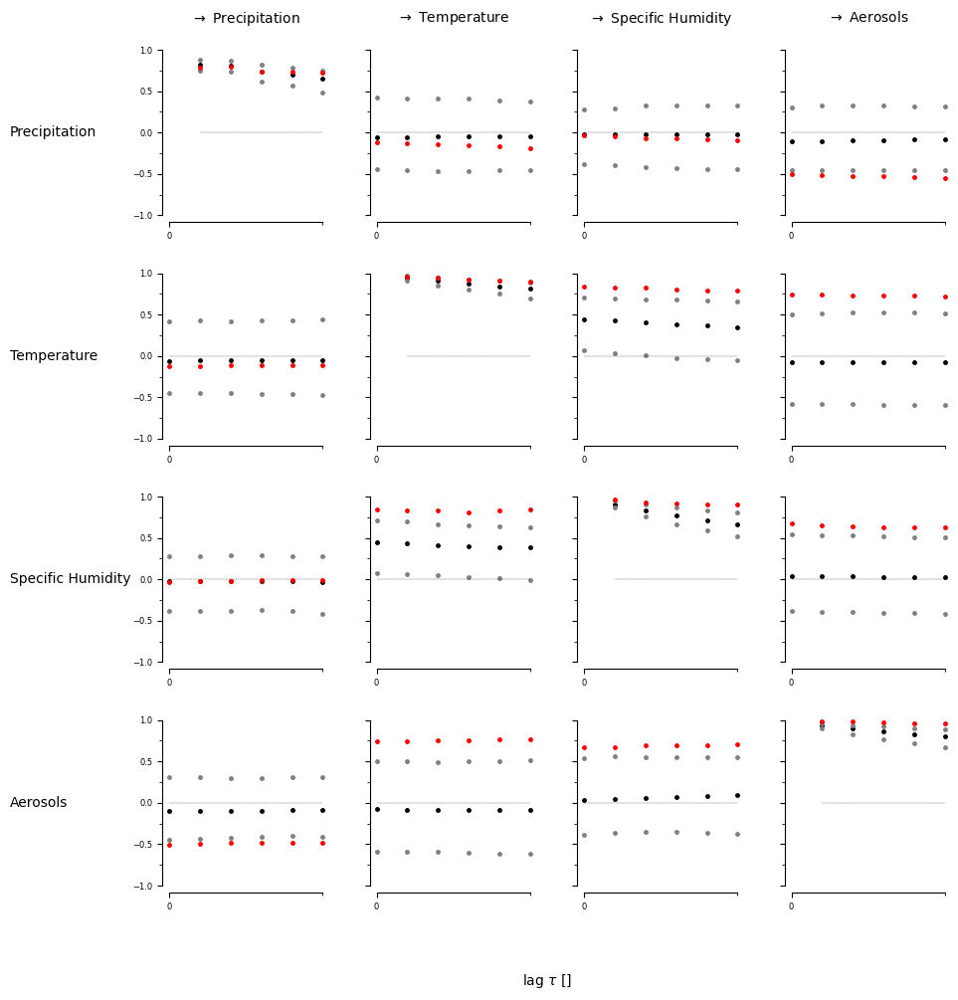

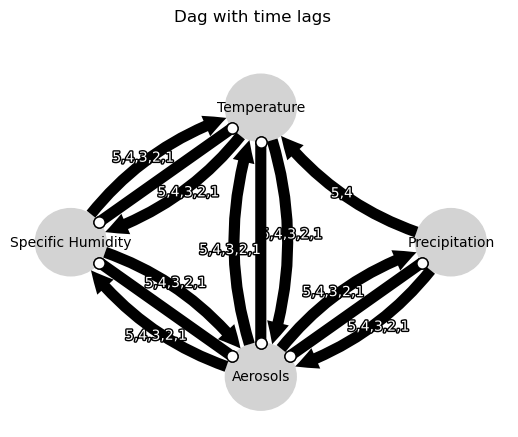

Negative precipitation values: 0


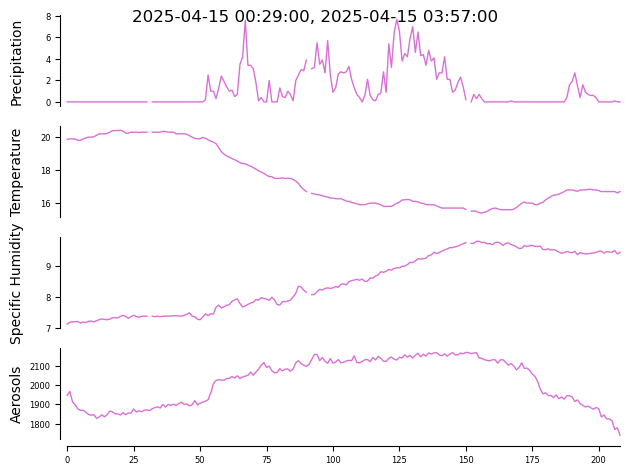

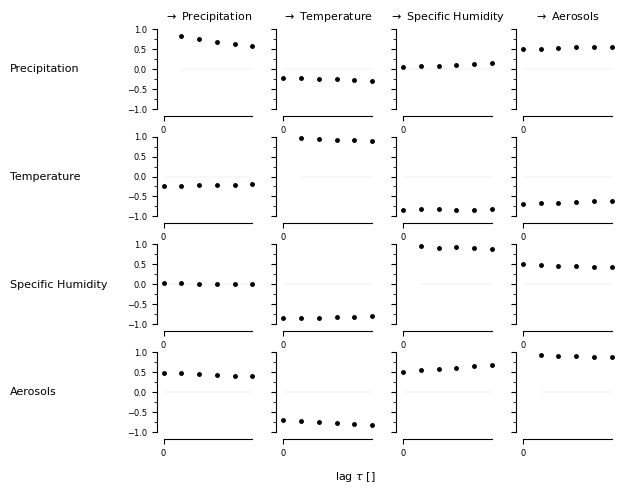

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


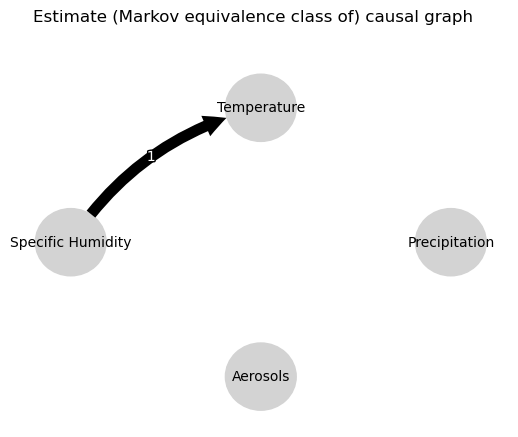

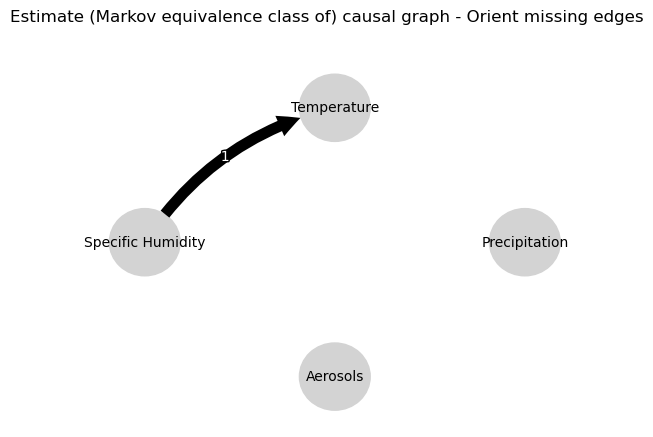

0.0
0.7945716319702547
0.6460303096952872
0.5266557342417004
0.43051102014664006
0.350222974774326
0.038270159336398255
0.03791117966777999
0.04021067222319909
0.04268791906587663
0.04647667172557547
0.04786853875769235
-0.041113960799810265
-0.03987070523382021
-0.03699848553103231
-0.03593204131455338
-0.03281241677917543
-0.03249873830433017
0.0193862072413616
0.013991033921943152
0.005215302660924476
-0.002534595369198448
-0.012742047882525977
-0.017221788402553232
0.038270159336398255
0.03864246898729042
0.03827371594398556
0.040684539517586896
0.04206903291099517
0.04276436059494507
0.0
0.9844373786857988
0.978819045305364
0.9720542594018524
0.9696108874013087
0.9644834768002113
-0.017683601179171008
-0.02027905411850862
-0.02328521329651285
-0.025836528428966853
-0.027954777401287313
-0.02894544514348461
-0.039979567957557166
-0.03851750413830218
-0.03736211529901309
-0.03715002266678999
-0.03688672735638604
-0.03630006035389101
-0.017683601179171008
-0.014674663788184666
-0.012

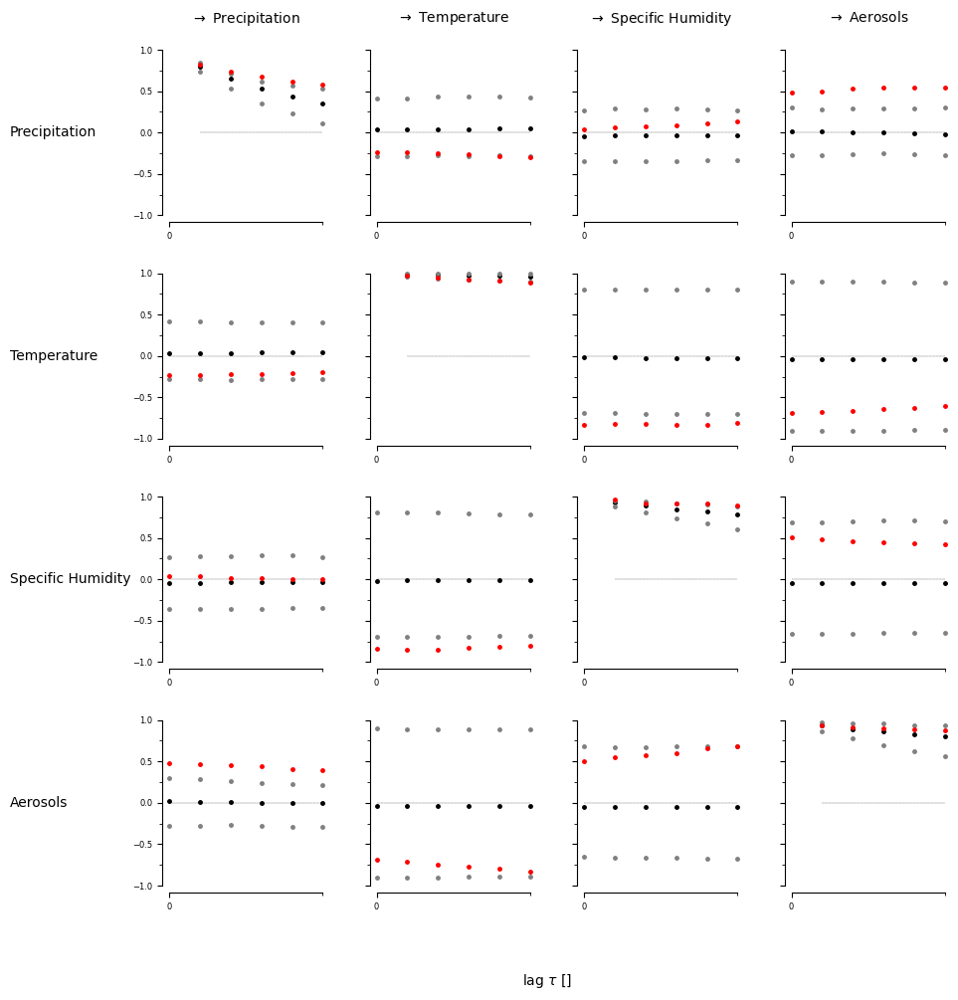

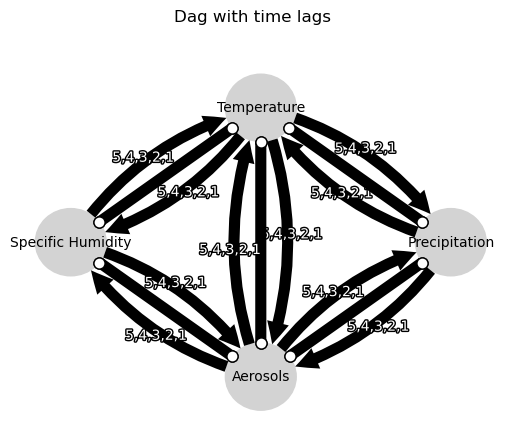

Negative precipitation values: 0


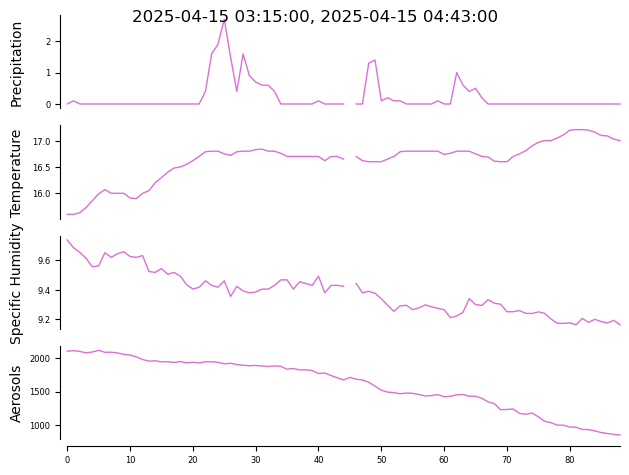

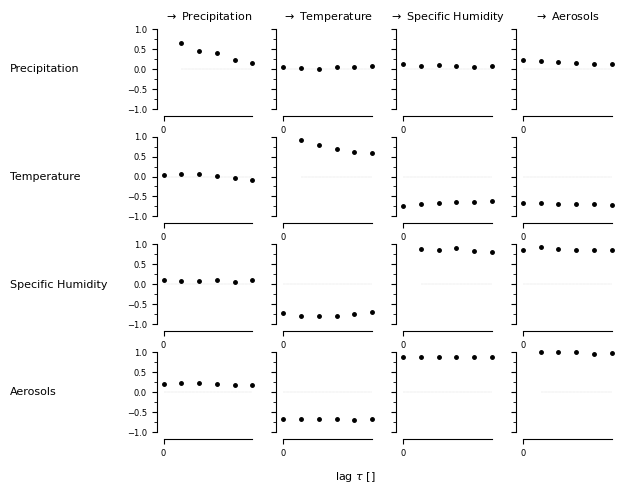

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


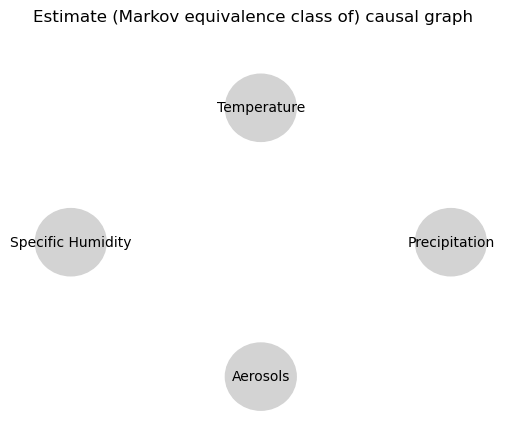

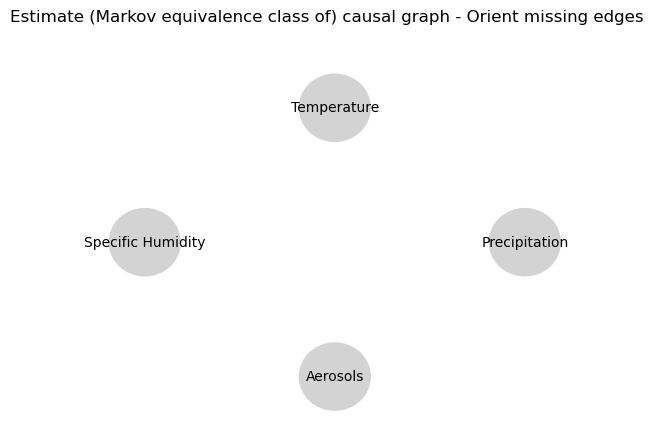

0.0
0.6363734805760601
0.4161711260087722
0.2774315250652263
0.17796140923771264
0.10967270043410045
-0.014268362671860388
-0.02033781319453982
-0.030524714032344094
-0.03959734144218727
-0.05262524456534315
-0.04892438457117496
-0.0052653774971078635
0.018244742370686927
0.008787942849350657
0.007425107753165672
0.014422296038764902
0.013586390622746431
0.04839274263175436
0.04625866701883265
0.025093071059965784
0.03129111592441636
0.0148708956791078
0.026045693624208534
-0.014268362671860388
-0.006034186313700474
0.005223240244710445
0.014541222600602755
0.013468921948928257
0.003725316883009717
0.0
0.8095739388968083
0.7005239422297475
0.6062426578611521
0.5289796890609859
0.46009915942540963
-0.20438954006226556
-0.11314706875671489
-0.12383232865338481
-0.16831568587808443
-0.0927919867854698
-0.0924398966558519
0.07024383961463514
0.040459938613048696
0.06883888584598066
0.03816578060984834
0.06421499880540998
0.03379980315617956
-0.20438954006226556
-0.17092864287122456
-0.1542

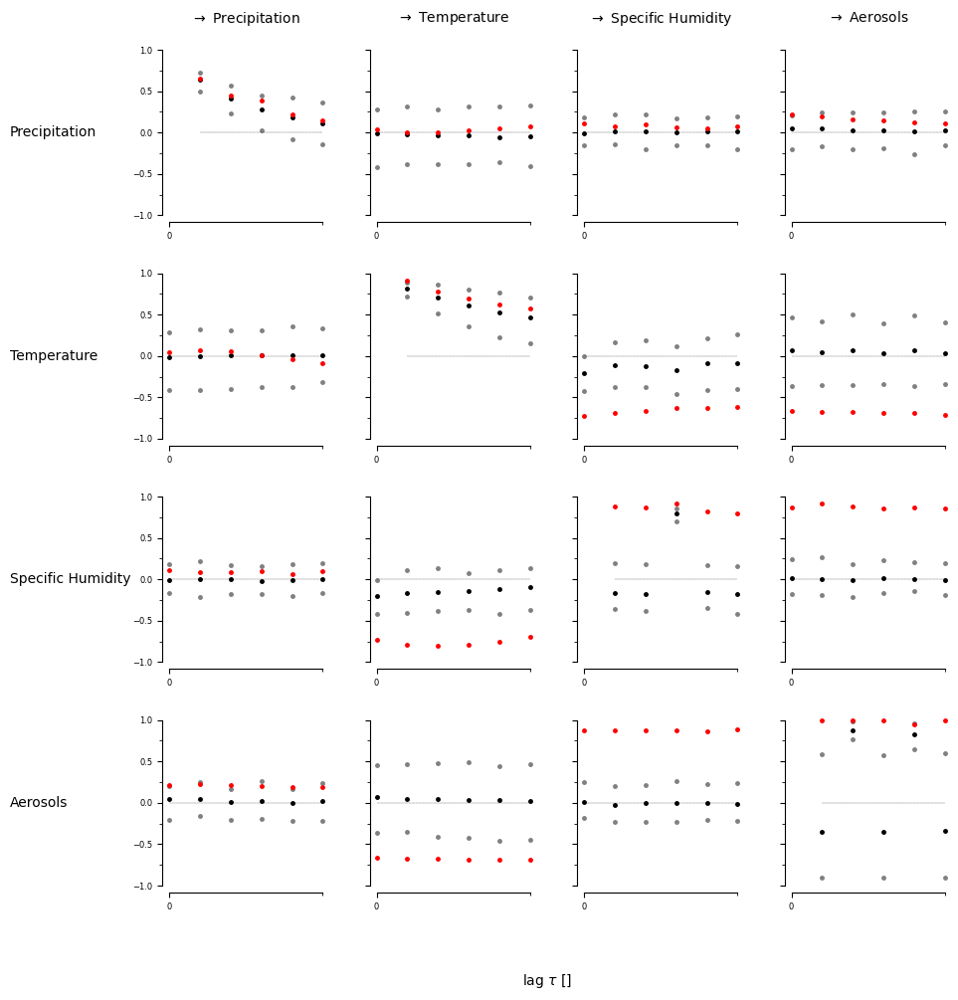

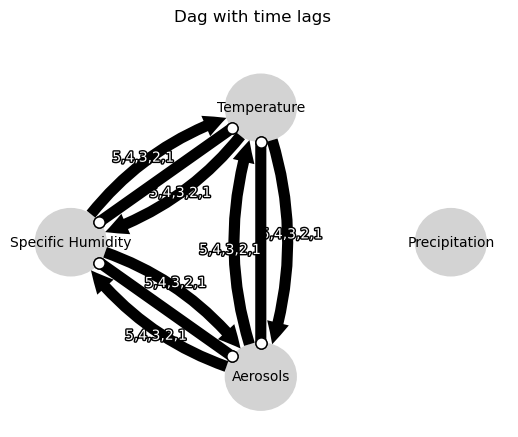

Negative precipitation values: 0


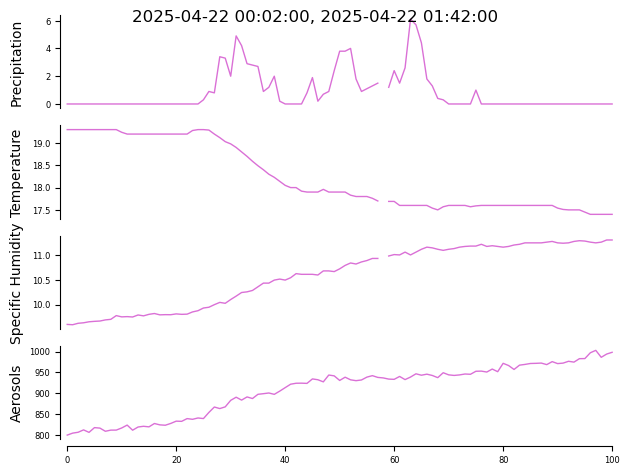

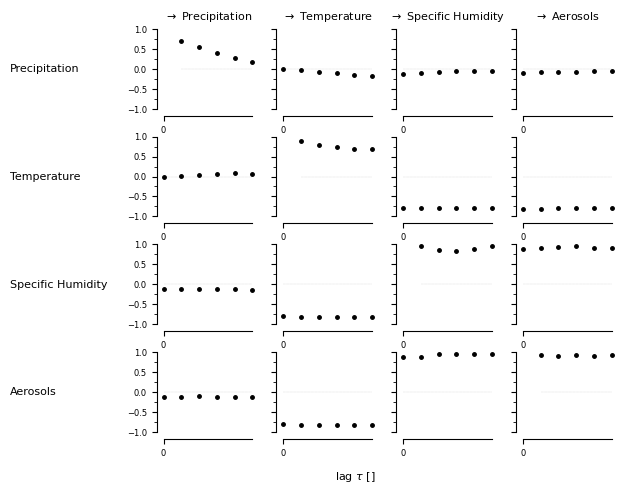

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


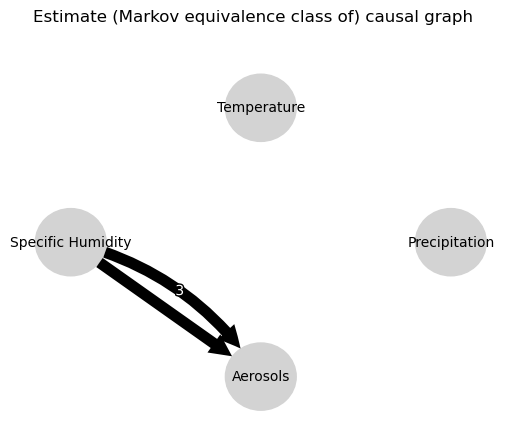

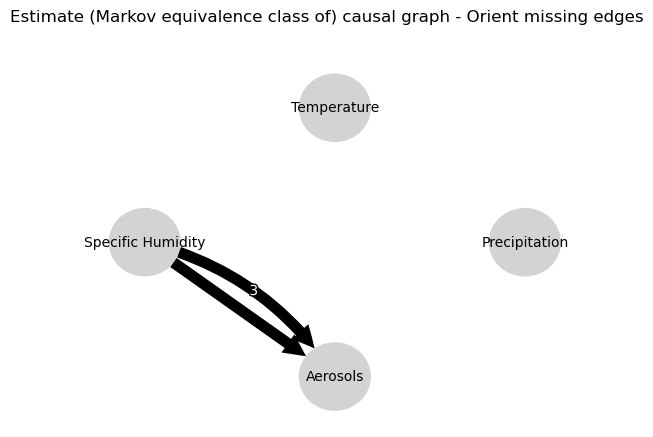

0.0
0.7437214041072582
0.5789733282766616
0.45282847636729295
0.3520276917624167
0.2724610666933566
-0.07023493266892233
-0.05803766923120671
-0.04747779373220702
-0.04154699575485306
-0.03827547374277242
-0.03800197334862911
0.0728718503281314
0.07607546672638409
0.06733573968651096
0.06517087726326895
0.058738478038329676
0.05435130096648079
0.1487209881865353
0.07680013758207069
0.07782901732026595
0.07358181778303764
0.06474990697487792
0.0553634235365332
-0.07023493266892233
-0.06058862673609755
-0.05671289363174916
-0.05658057236385037
-0.04992705248425493
-0.04563220062379456
0.0
0.8622724936471099
0.783276332178284
0.7140674774649337
0.6601726187585076
0.6062860896111394
-0.04811845805774968
-0.05142373161576168
-0.04934250114071959
-0.04365259416339651
-0.031638078815274064
-0.0316938331050087
-0.07218112149593103
-0.0004250303922787378
-0.011468453993828074
-0.016389488474906497
-0.011173456872849097
-0.0062500822058992565
-0.04811845805774968
-0.0567300524534373
-0.065604617

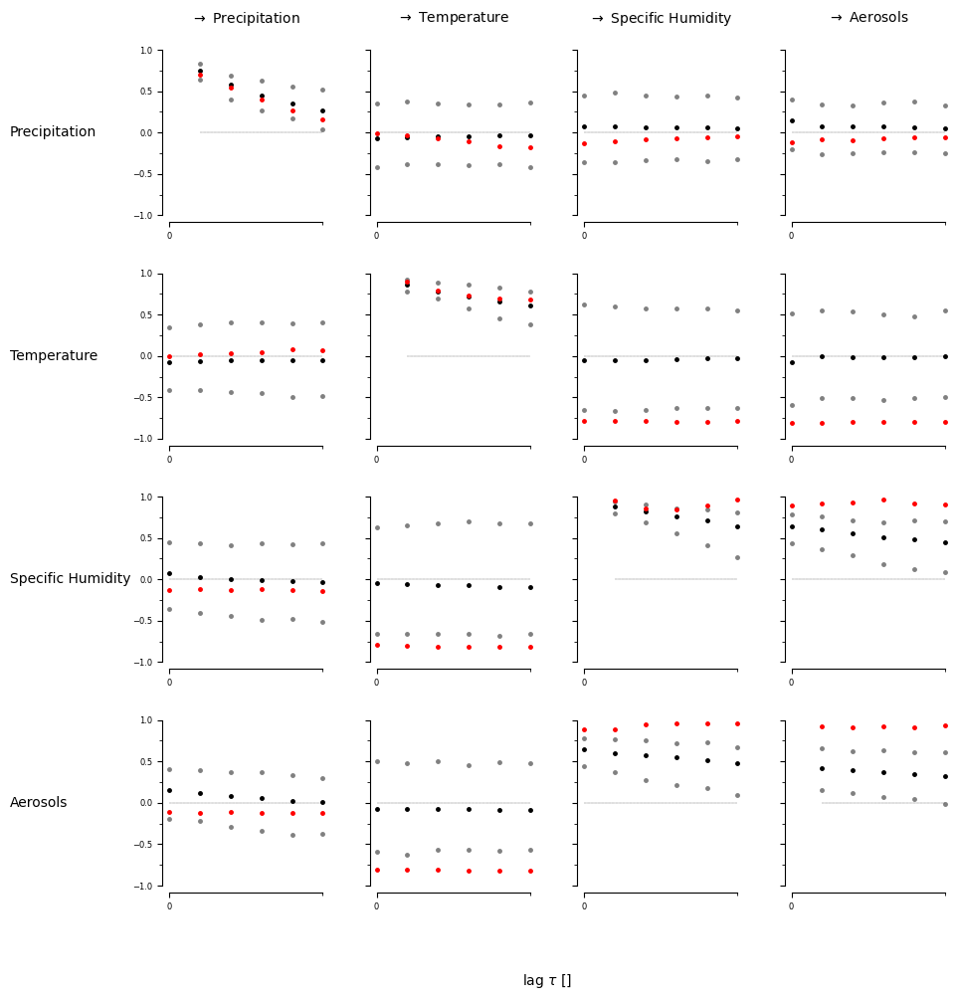

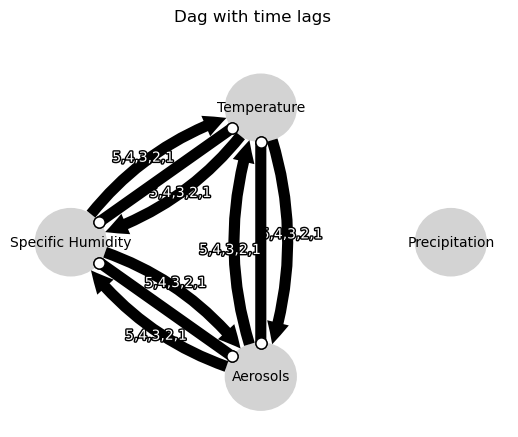

Negative precipitation values: 0


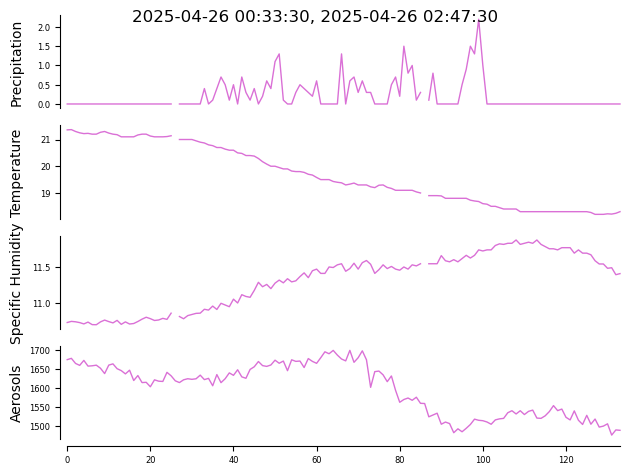

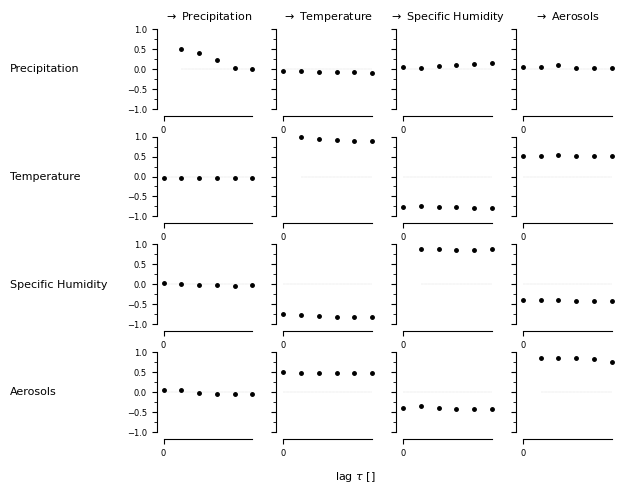

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


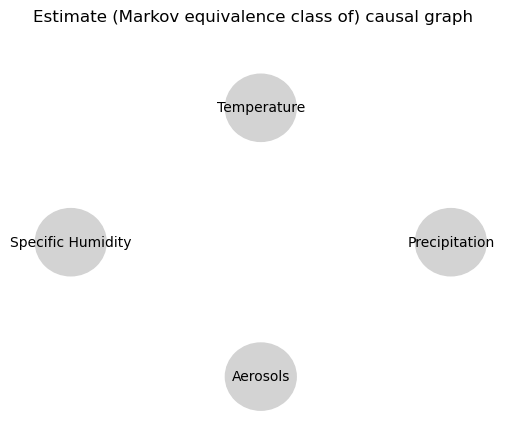

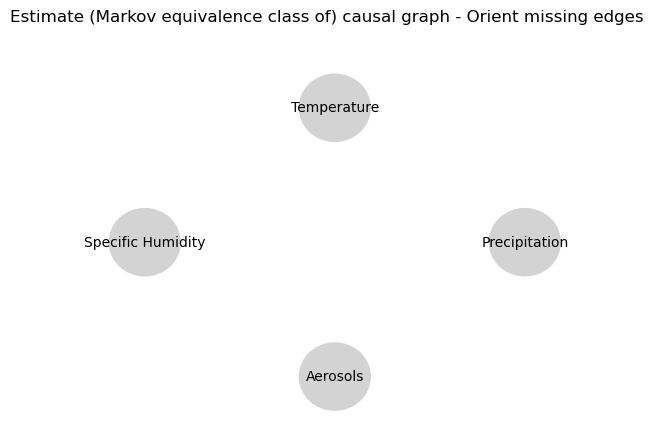

0.0
0.5150072093810154
0.26392912981708266
0.13560848233619918
0.0678288887380052
0.019292958481563705
0.02930750898217005
0.02540516695751849
0.019555245736654913
0.021600238761626023
0.018434184106332685
0.015379974486007506
0.1684931754918646
0.11166487850848775
0.11457302219943889
0.11011553733342018
0.10704905463115724
0.10452577078308505
0.0475955830890348
0.04853644310072824
0.03423196544031517
0.034320846472507514
0.028110067606717033
0.027461603327846525
0.02930750898217005
0.020066336539895625
0.016698055124826888
0.00916183323380599
0.012293736487464693
0.01488809461090785
0.0
0.8967174733888551
0.8326328496305649
0.7836006299480254
0.7369600606522009
0.7023061752541989
0.13873495514175097
0.11748857091811901
0.10630707465520806
0.09379981486926986
0.08796724221546225
0.08297880863023259
-0.012832785529529293
-0.001421912717275916
0.0022863312140812917
0.007948561768542002
0.007559948409503136
0.010599268755682503
0.13873495514175097
0.12822539883968218
0.11920557237273505
0

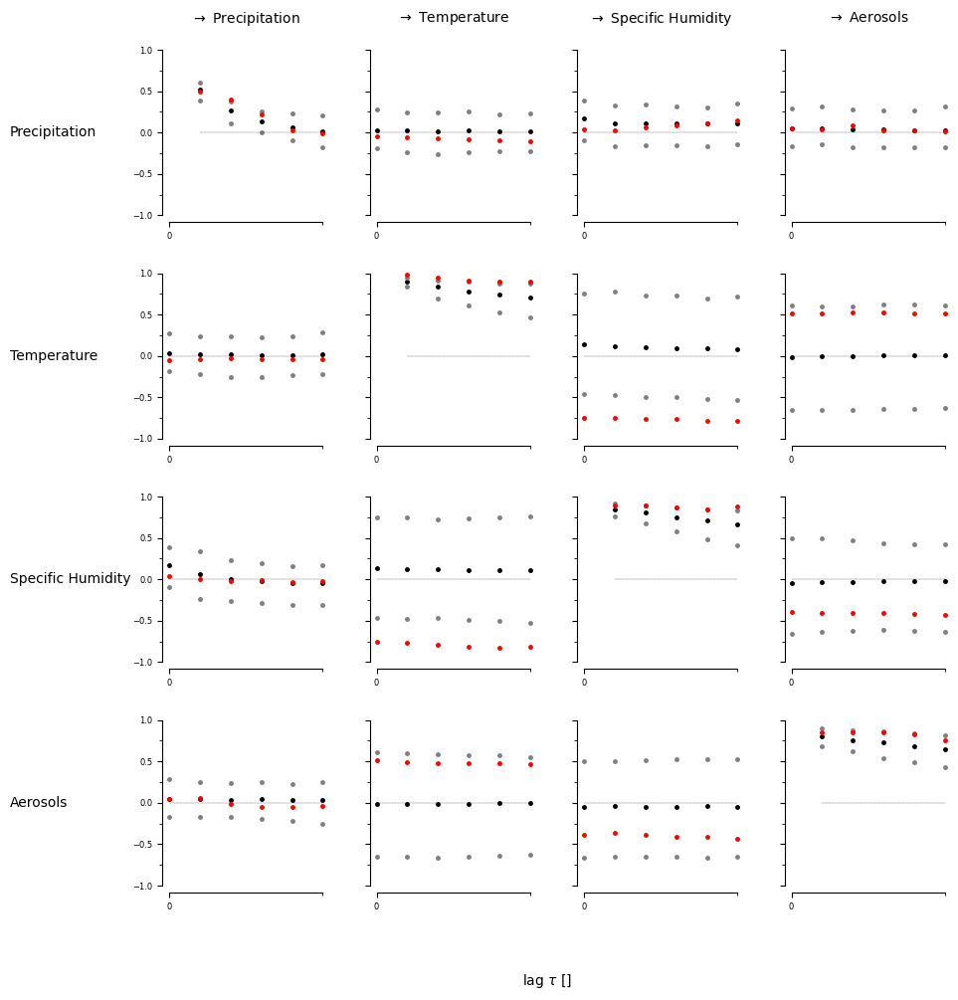

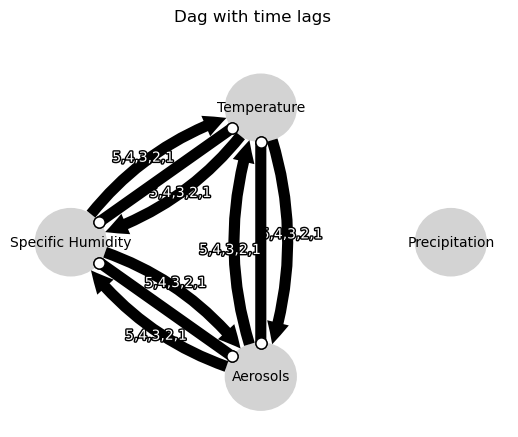

Negative precipitation values: 0


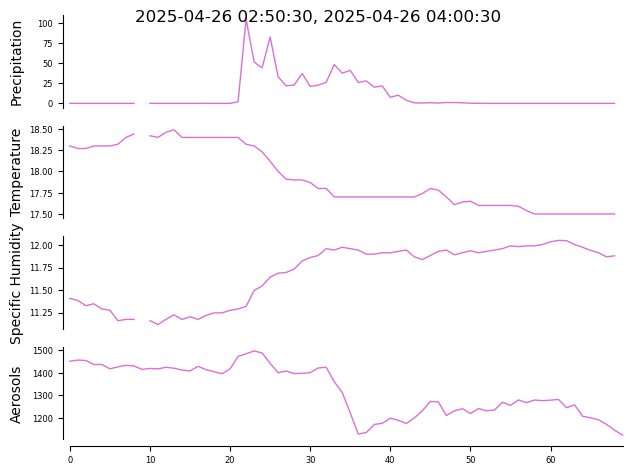

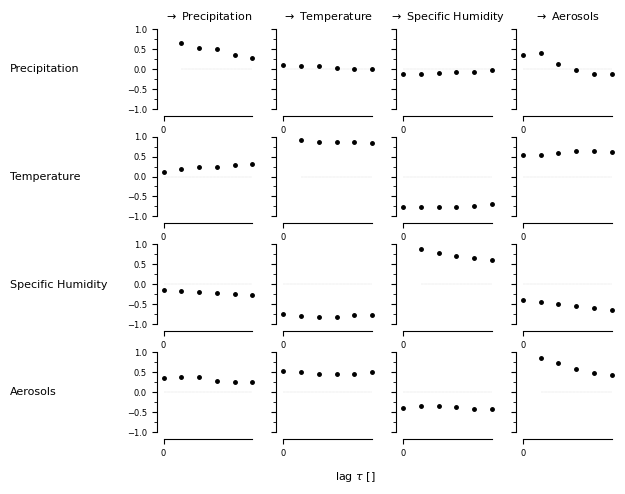

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


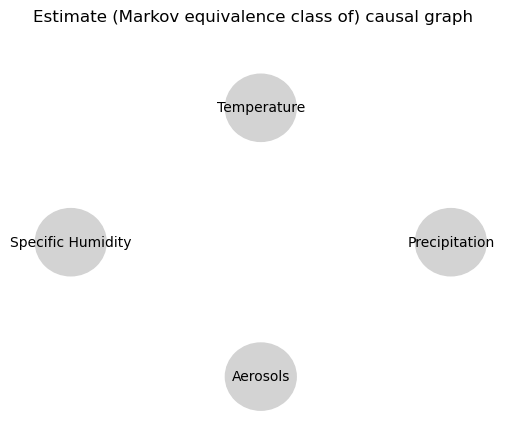

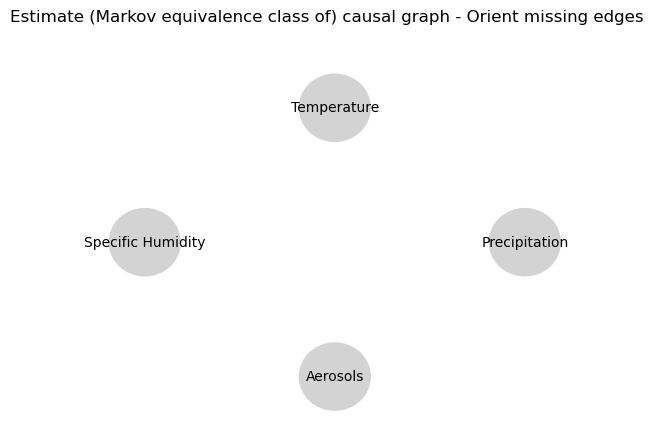

0.0
0.5428174674218244
0.31561148274732964
0.17221636873825033
0.07653413074360178
0.02626127326746261
-0.07758879302936997
-0.06032864137969885
-0.053035010349502115
-0.04944134821040256
-0.03903481006483248
-0.03745651932159138
0.045791903655394706
0.018801021662604802
-0.008294133347489055
-0.022915195378290353
-0.028127051551521336
-0.0329441371425339
-0.06736989541102757
-0.06209784344848506
-0.06352473490849539
-0.06524173685225365
-0.06142765186146611
-0.045839835771877314
-0.07758879302936997
0.028393185130300425
0.08936776353078345
0.1094777442910347
0.1169239966814266
0.1281143343878609
0.0
0.8095033607290338
0.7146379428616036
0.6395962321559403
0.5818761110673699
0.5269311594431187
-0.15790570418432381
-0.14399847212286032
-0.12951460700883685
-0.12228479033510255
-0.12577942172565204
-0.12075803132599608
0.16892524518140575
0.14290753962988834
0.13487827549124945
0.1050388370228815
0.10064529383062508
0.08632753333486727
-0.15790570418432381
-0.15593600797089915
-0.1487578

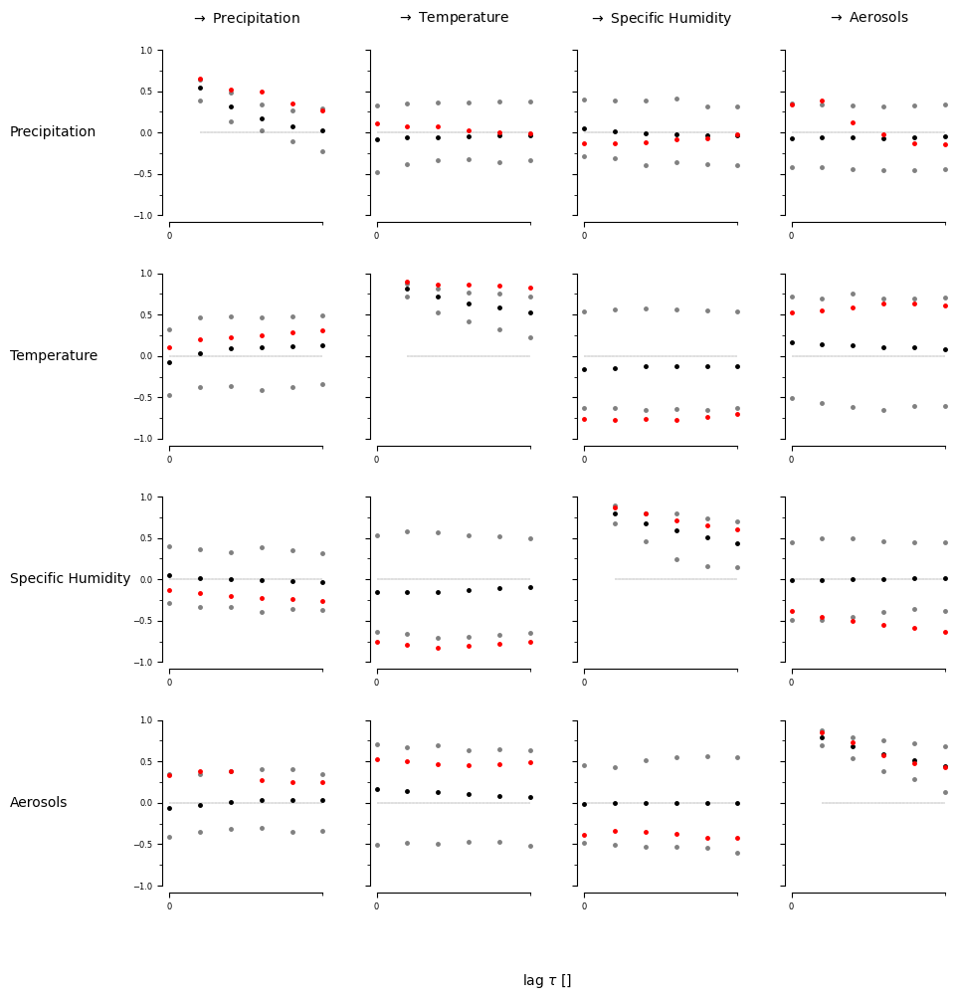

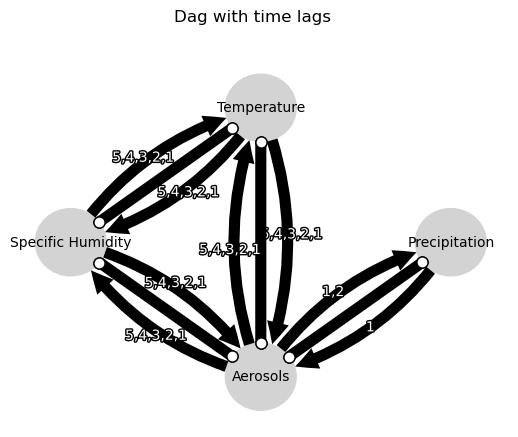

Negative precipitation values: 0


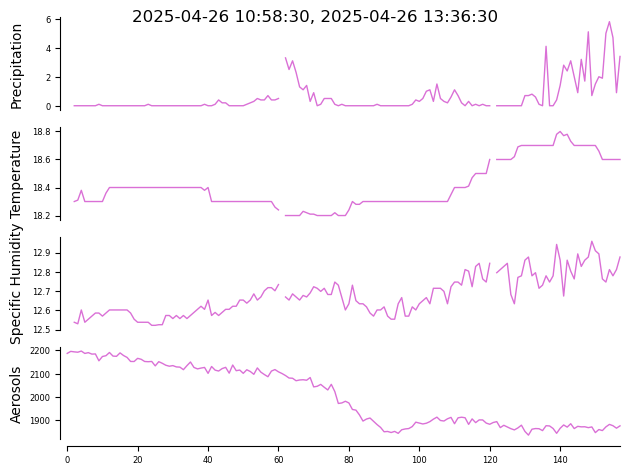

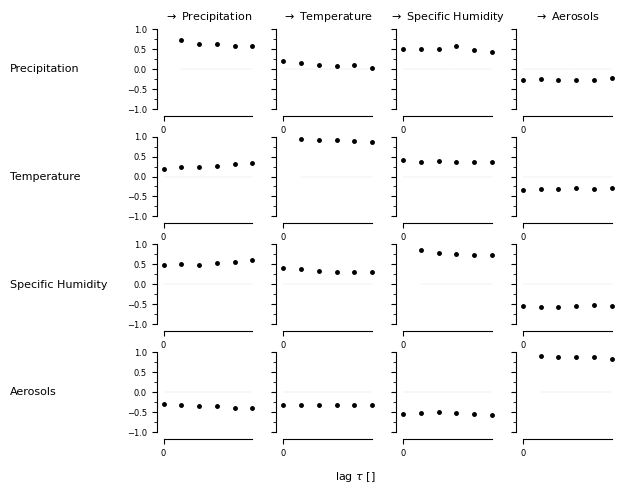

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


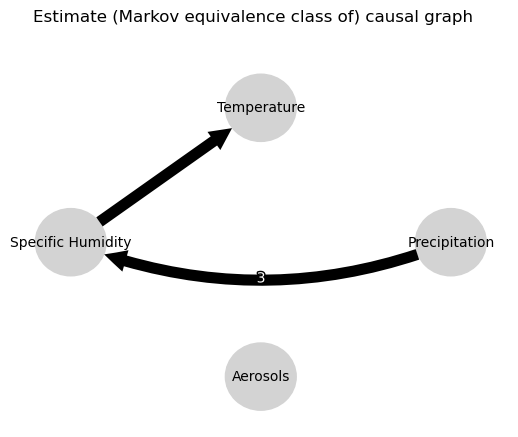

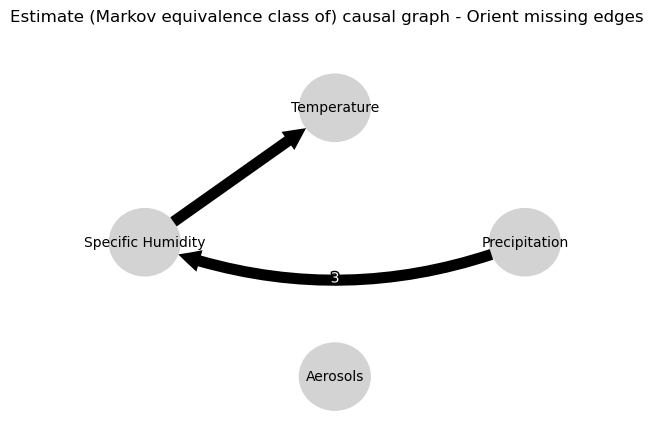

0.0
0.6194601209855581
0.3973125571854817
0.2546586493068956
0.16228407379614018
0.10025571751401391
-0.0755350952967657
-0.0630397916841584
-0.04321952228234675
-0.015239795738170274
0.014147958721828178
0.044049344820962746
0.06530765354726814
0.1284224716173758
0.2233361464863885
0.36205919176051177
0.4111554029945724
0.3972247491427797
0.0779217186507834
0.058756870613138765
0.04040227329578665
0.032467885003104685
0.032005339028853615
0.03355430936835205
-0.0755350952967657
-0.0742911774551085
-0.07853014476493224
-0.07517122221660032
-0.07720582746933558
-0.07519546964914099
0.0
0.9186990697686997
0.8645340815287024
0.8129765123290018
0.7619796798314189
0.7152401772177971
0.309628038986382
0.1964369127159804
0.10787045546613402
0.03452966795992716
-0.017319302097983477
-0.05565363878579308
-0.11087381035994304
-0.1046443655638654
-0.09880744116325758
-0.09593982503827247
-0.09323280281876721
-0.08833555425064699
0.309628038986382
0.34913490490523147
0.3831942662011326
0.403279721

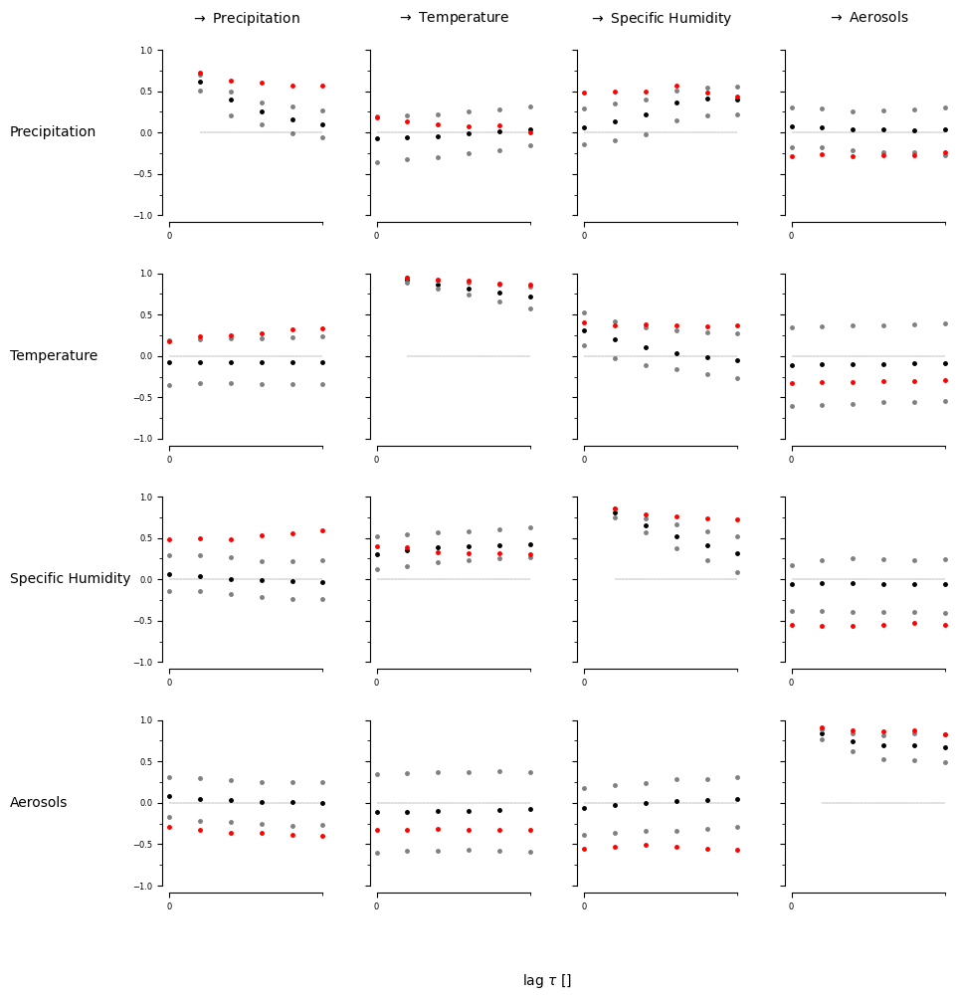

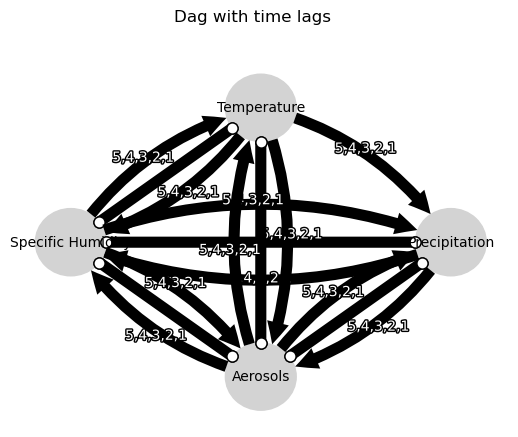

Negative precipitation values: 0


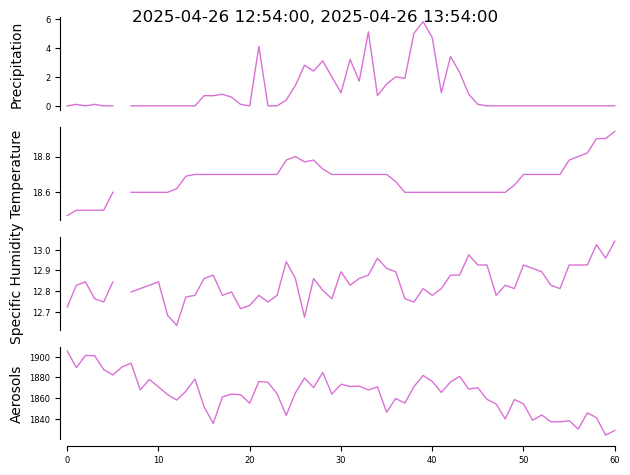

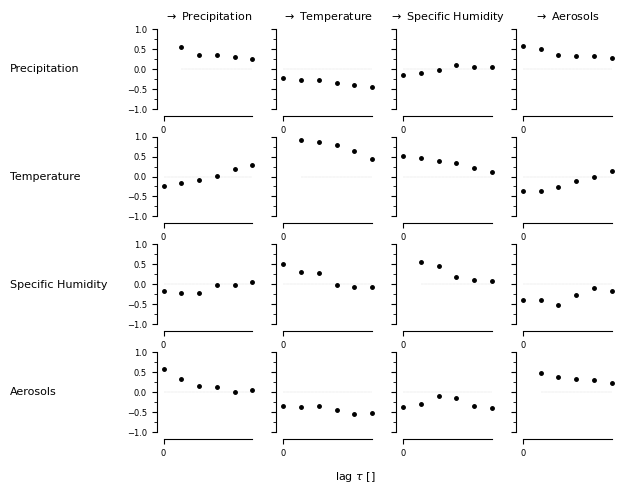

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


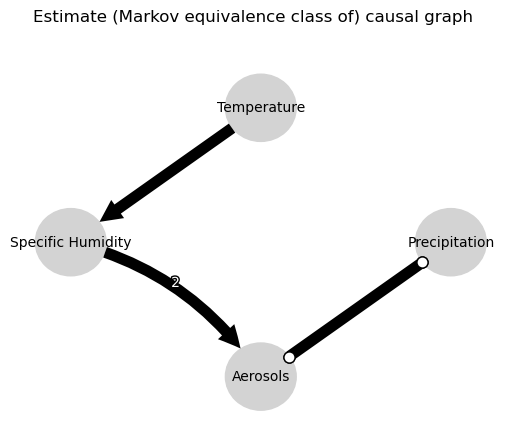

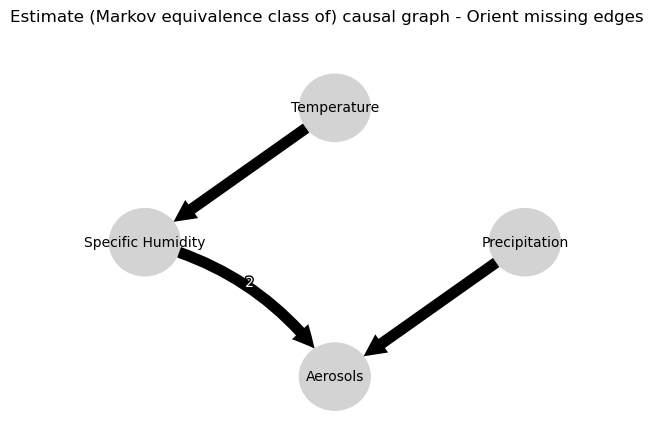

0.0
-0.010558547282598465
-0.037878993021778086
0.002329920667271588
-0.018589984103945925
-0.005895119513065812
-0.12007899705039277
-0.10450174789559163
-0.10435921639425123
-0.07645065130796071
-0.0807178963414542
-0.05321762782622448
-0.06338614224258927
-0.07800860489056222
-0.03892399431189828
-0.045701618934016836
-0.011015653794231356
-0.004871515096596706
0.4106467905551848
0.014266365408732037
-0.006734757943086403
0.025605451506826592
0.007317276902491031
0.03160810953418607
-0.12007899705039277
0.03941267201336301
0.018545556456089476
0.03456511388021474
0.02938400863592132
0.01508202182287966
0.0
0.7719059689280031
0.6756023973961175
0.5818504347231721
0.4985406106634207
0.43257286309915577
0.5450605615631646
0.38034716427004484
0.30038846673377406
0.2480467307963869
0.19903604666300737
0.17993467149306966
-0.3177199084719195
-0.20794376428095604
-0.24608805278397938
-0.18172786706184987
-0.1492249834788048
-0.13140841217730015
0.5450605615631646
0.481889770997036
0.441484

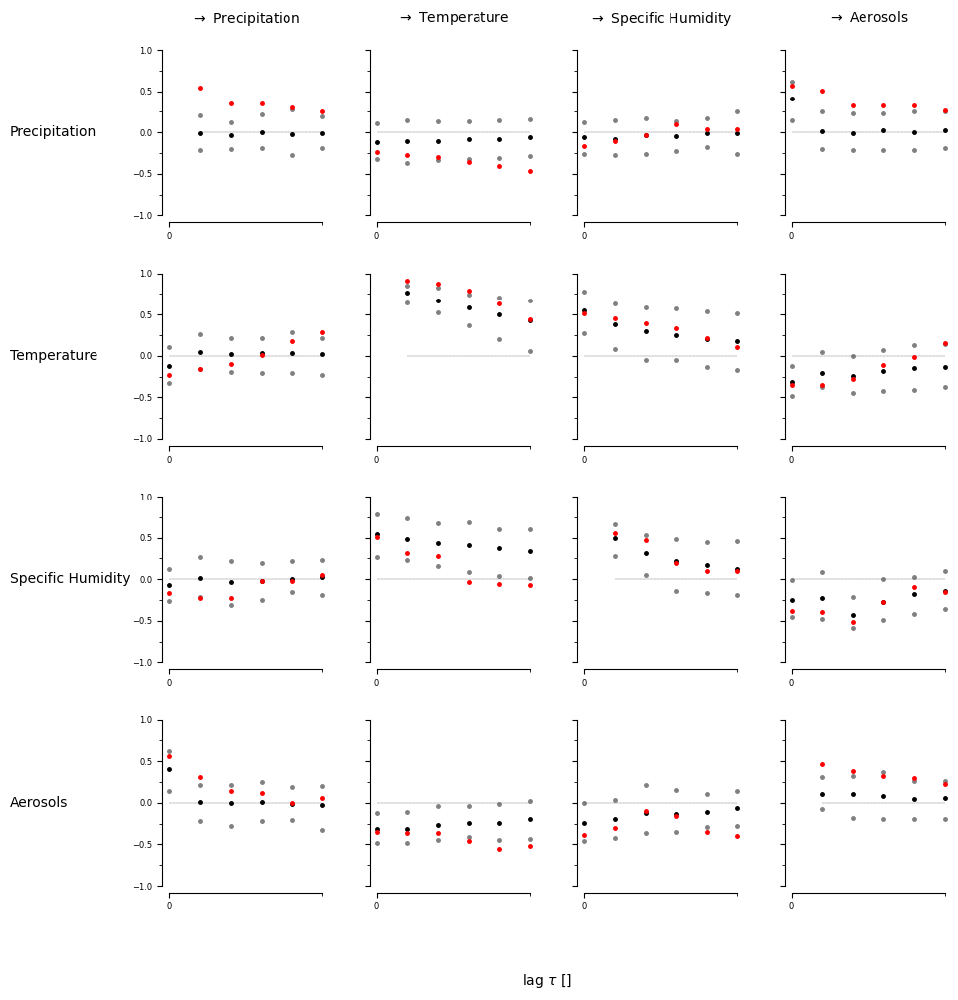

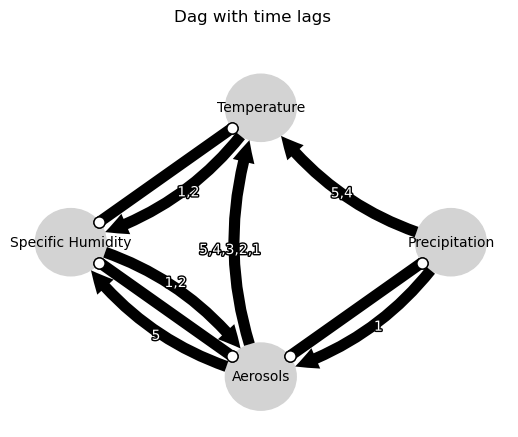

Negative precipitation values: 0


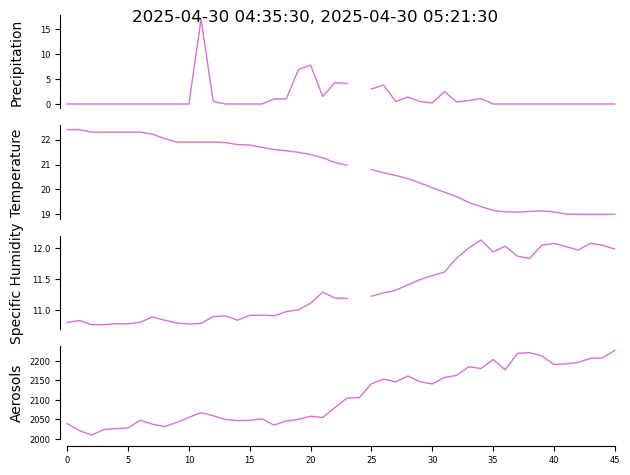

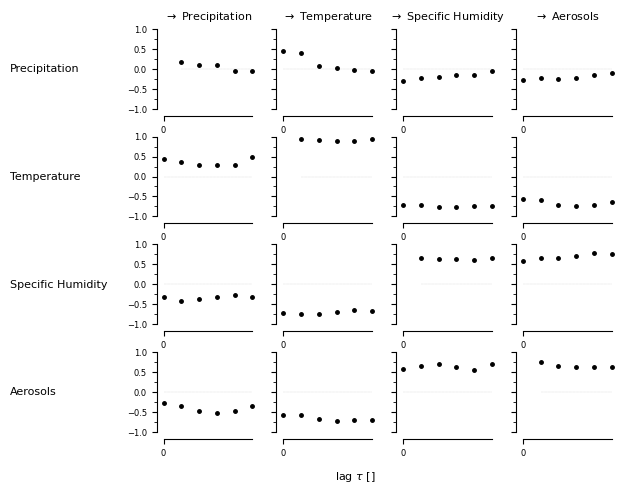

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


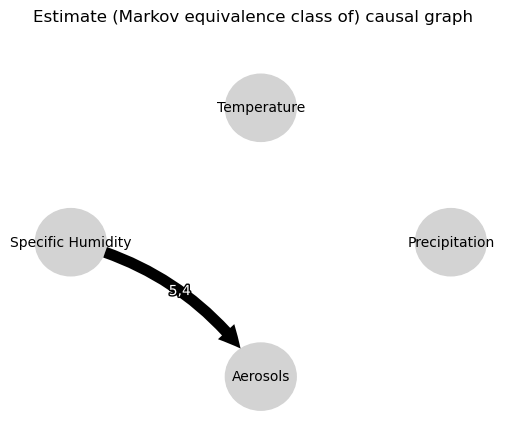

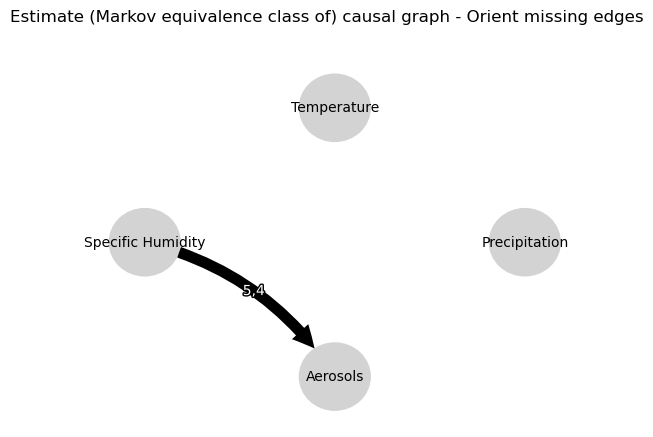

0.0
-0.0291697956188513
-0.04681380769402946
-0.01632314998478161
-0.03328000499603923
-0.02763764891376592
0.2194450758035182
0.008492680842107365
0.016040526086134436
-0.030721433088036047
0.020304239731563242
0.010327581066987945
-0.23252231066831086
0.0033766916208935642
-0.021061813822648535
-0.004970828304175198
-0.023600719731516877
0.003920490770855601
0.06389717684377673
0.05225020162610907
0.036992804250632366
-0.008048112889087283
-0.22225696038603462
-0.05691031007905487
0.2194450758035182
0.017129696415431064
-0.016071268006682647
-0.029491819417470023
-0.06093013042948036
-0.01747421704854069
0.0
-0.017159499168753135
-0.0018225768459755665
-0.042393098591239145
-0.030583144292715726
-0.02458854663734216
-0.8712348497488901
0.02454157586218527
-0.005731106513145751
0.045528600941332736
0.031750546777777715
0.021562606028926436
-0.017835348800907584
0.04314785827332077
0.00799715480735282
0.00489076644113405
-0.8096969771413669
-0.13162399436477604
-0.8712348497488901
0.00

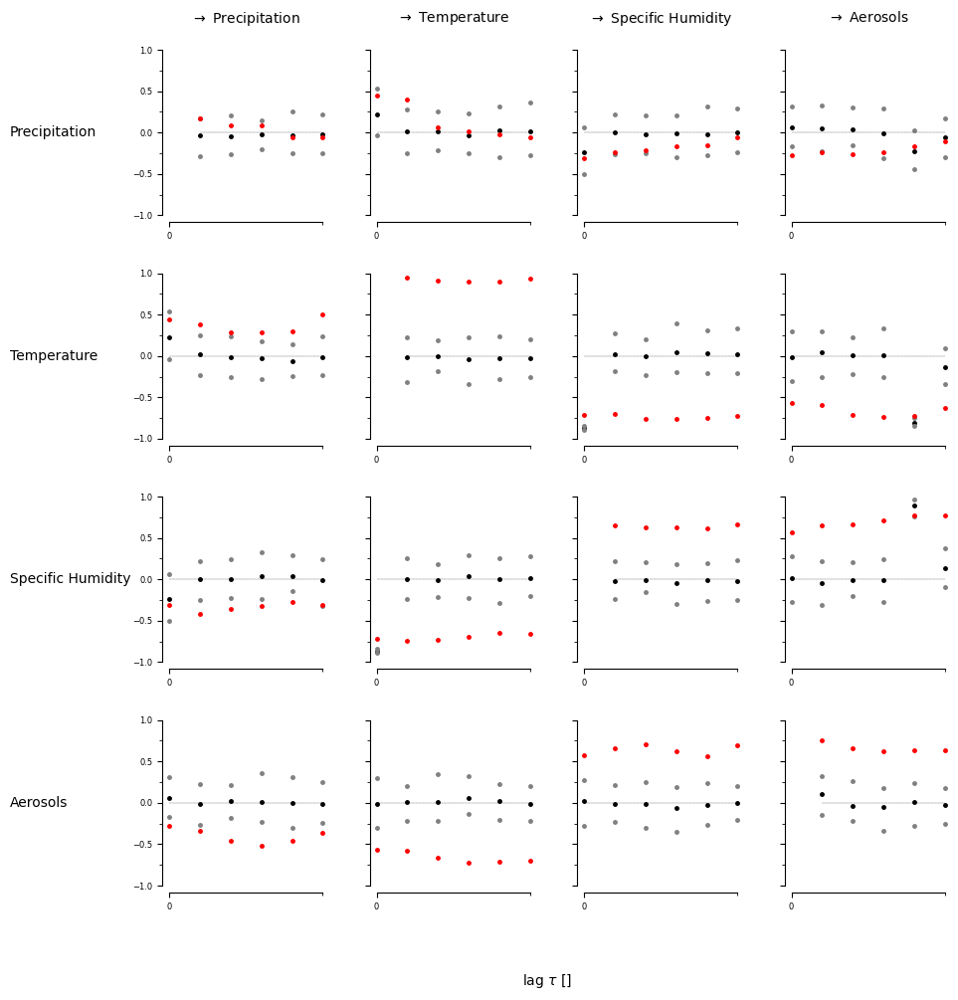

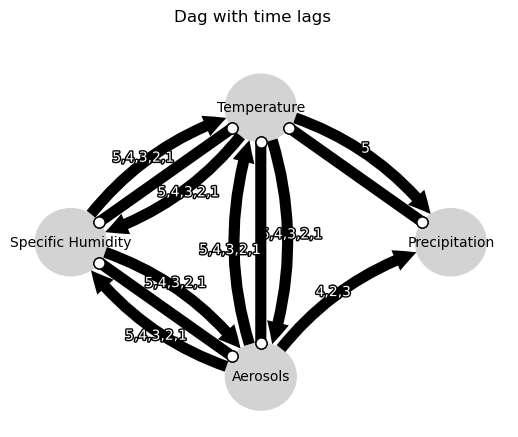

Negative precipitation values: 0


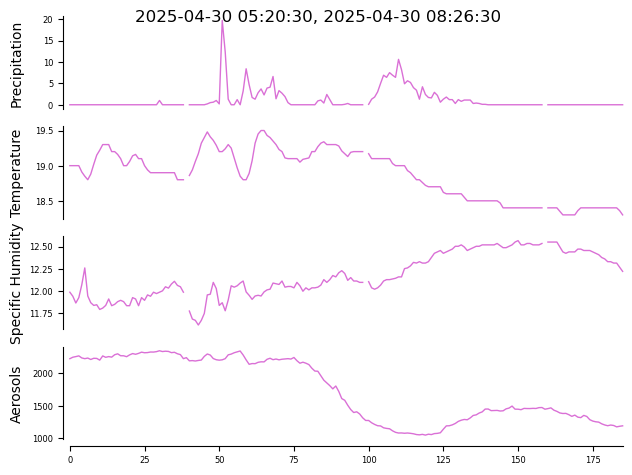

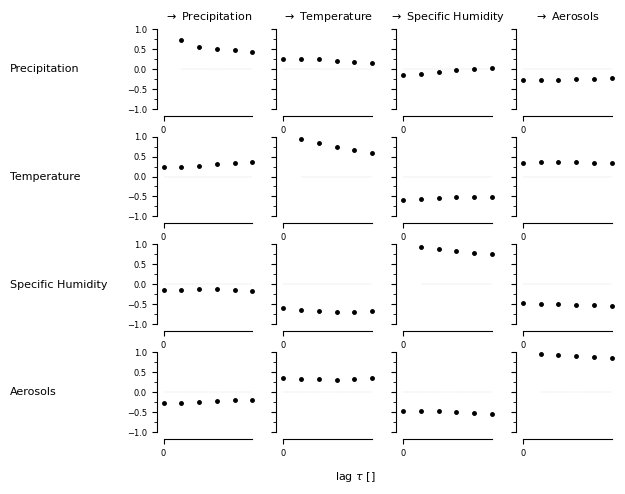

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


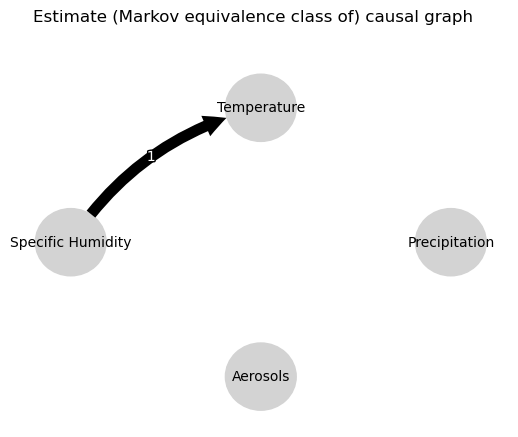

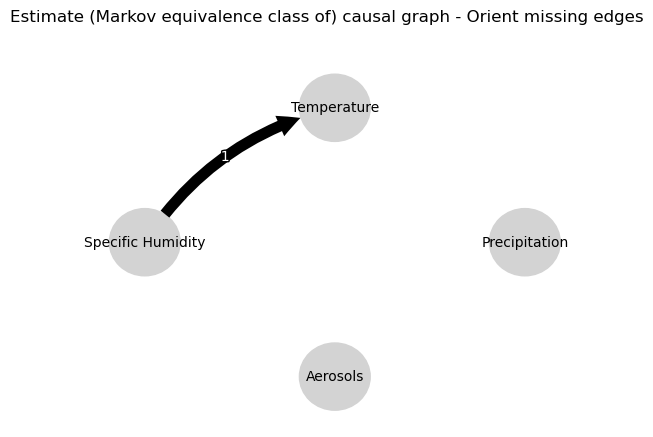

0.0
0.6459315982242202
0.4248076481624081
0.28255917029680117
0.18916547119405183
0.12106861133934922
-0.0034445983491826642
-0.003980312719337289
-0.003030057029447427
-0.005640848342760707
-0.0022229162972602964
0.003454129091319632
-0.013283202156472926
-0.02070599483415963
-0.028593437724041944
-0.026482570265693294
-0.027415513430234094
-0.02142695395841963
0.002841790193026086
-0.0017719132838140417
-0.003943810747296727
-0.005331977756740257
-0.008036767217820276
-0.006700265925329856
-0.0034445983491826642
-0.007716592974777946
-0.007576580564944344
-0.005697462293440705
-0.003938622541568124
-0.006289950421542467
0.0
0.949794788225007
0.886074490054654
0.81254777716917
0.7374114826542163
0.6666182041829252
-0.6163959276148069
-0.5785590554692079
-0.540713803451844
-0.5051354256615501
-0.46982293356476523
-0.4377438493107028
-0.03181082809089853
-0.03241214908667787
-0.03358564177656253
-0.03481530890173954
-0.032922816876298715
-0.031058033938840653
-0.6163959276148069
-0.6664

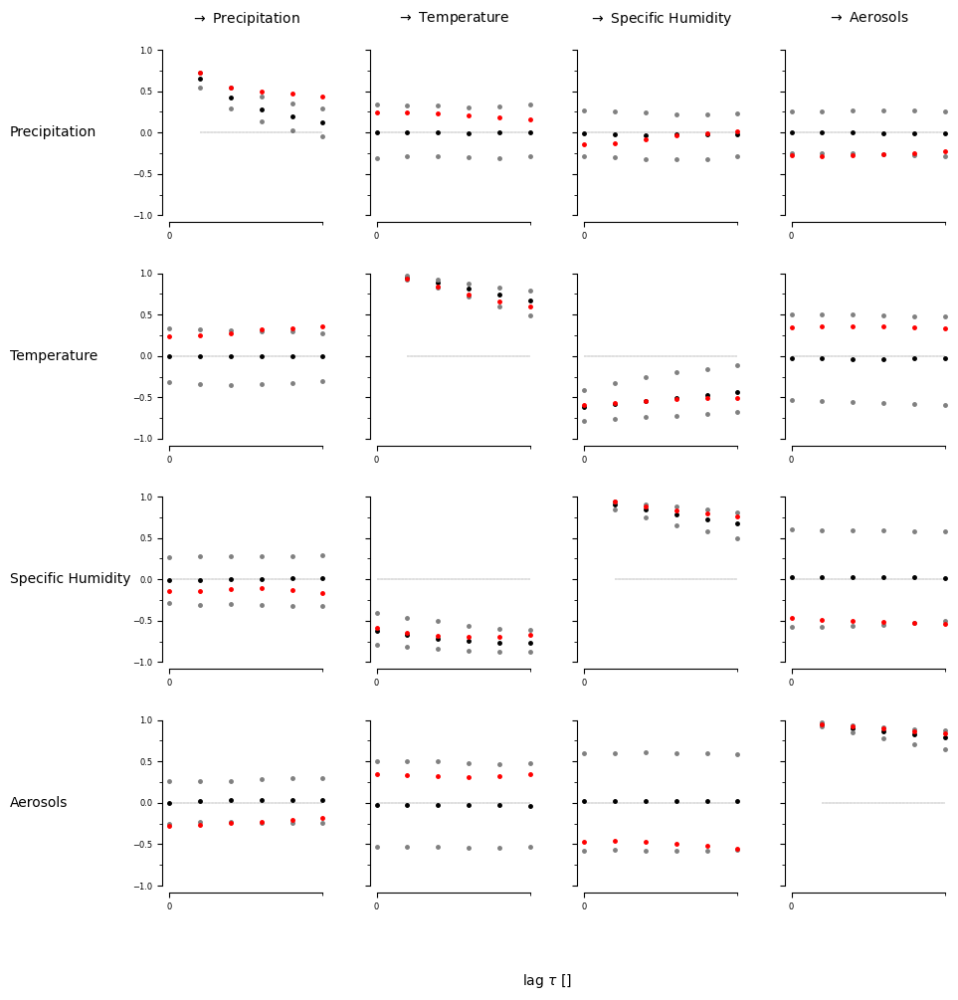

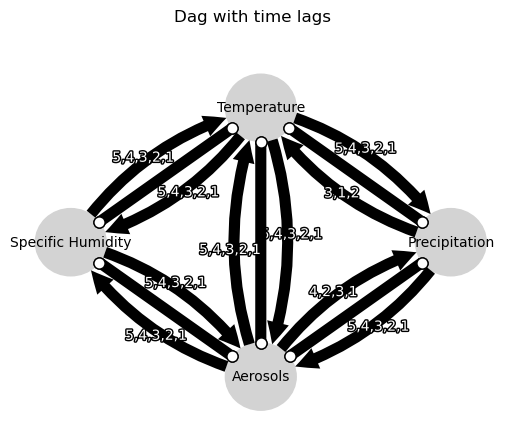

Negative precipitation values: 0


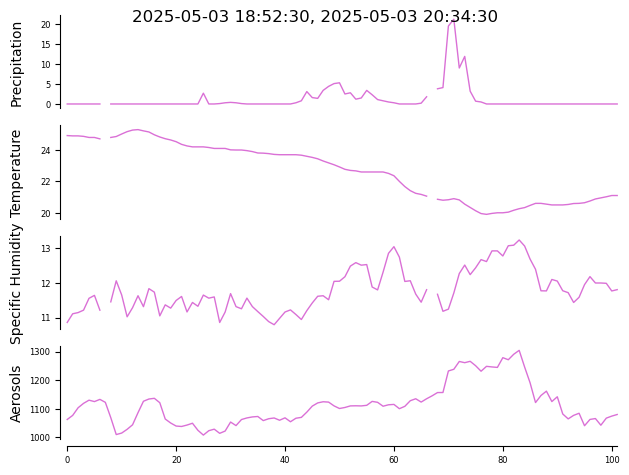

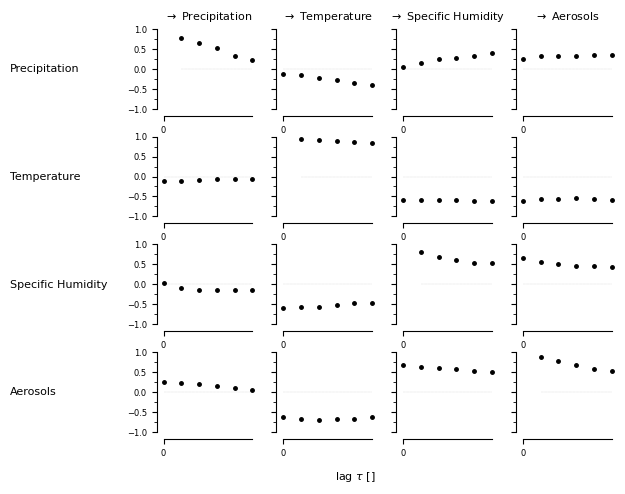

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


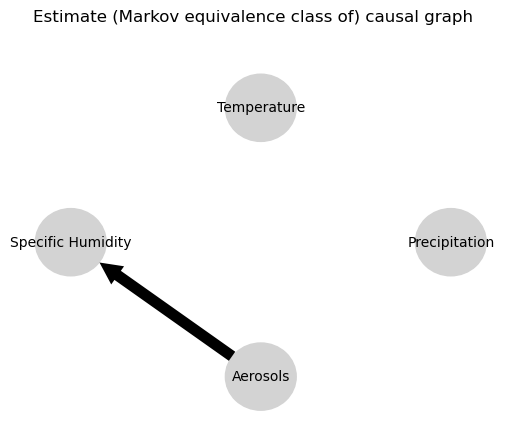

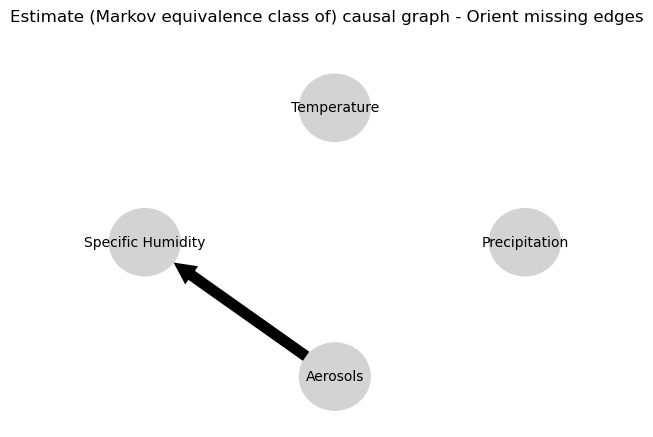

0.0
0.6819191699077649
0.48729037123631336
0.34412717373337676
0.2365722054481227
0.1592615727952324
0.04216690205645887
0.04218252564296396
0.04219211668283381
0.03638504138511875
0.0268643899075357
0.02352765215422026
0.00039019546715829607
0.017213582632961896
0.02843343053659857
0.04903252504391132
0.06133746031887259
0.08640753324812747
0.18291552691514645
0.17035010188192815
0.17070669618199869
0.1699897482831843
0.1754827084089564
0.17331967719547453
0.04216690205645887
0.02121190021590037
0.0056826923428858174
-0.005723194159380444
-0.01382778303043666
-0.01245447959795227
0.0
0.8643220157906658
0.7816060768753893
0.7157946840458865
0.65634876482317
0.602996506164663
0.0014732139730770021
-0.0017719899344285283
-0.002728049267784125
0.00586208767943832
0.014118461485947018
0.01883486373615609
-0.04446123705319721
-0.029204062916393037
-0.011097436710282271
0.0013625171301833421
0.01534983102470092
0.02542655079271584
0.0014732139730770021
0.005669196837120128
0.0058820249666960

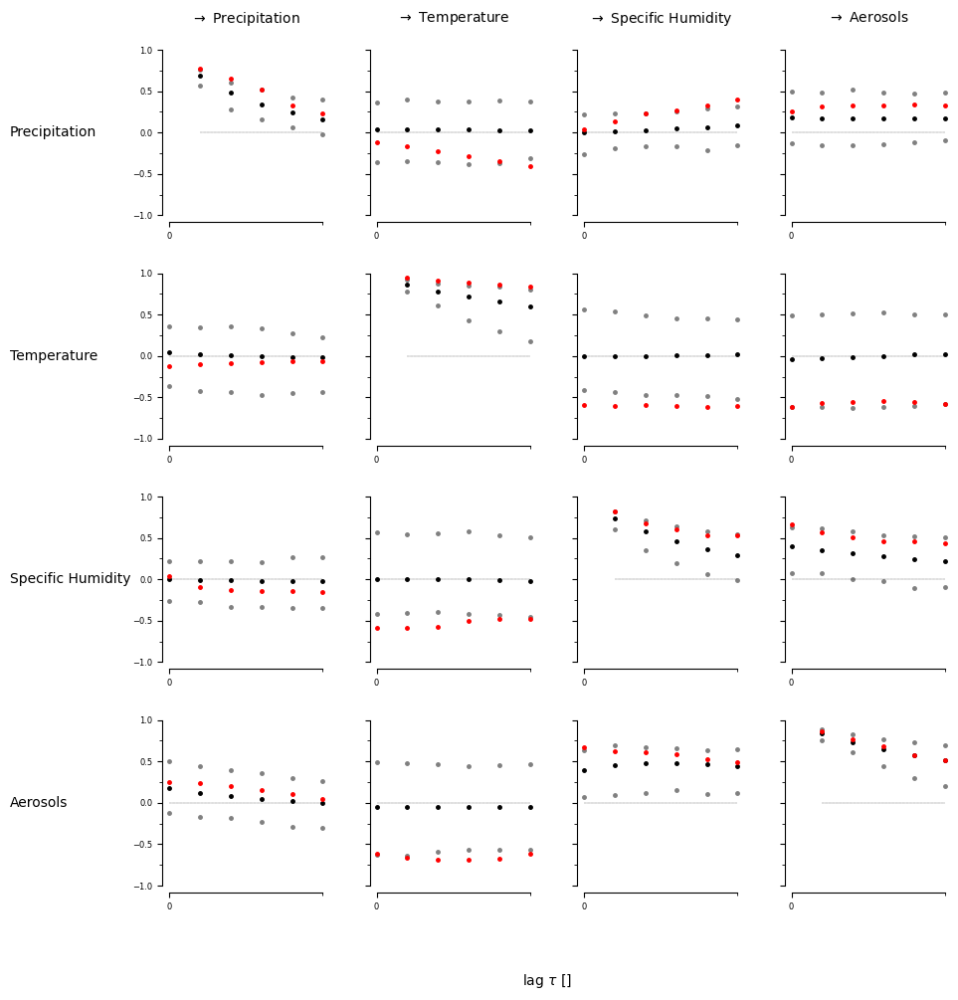

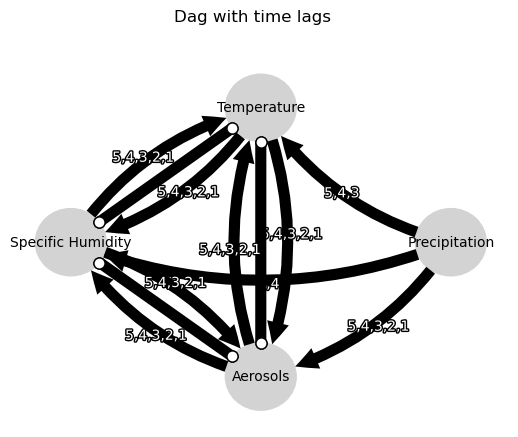

Negative precipitation values: 0


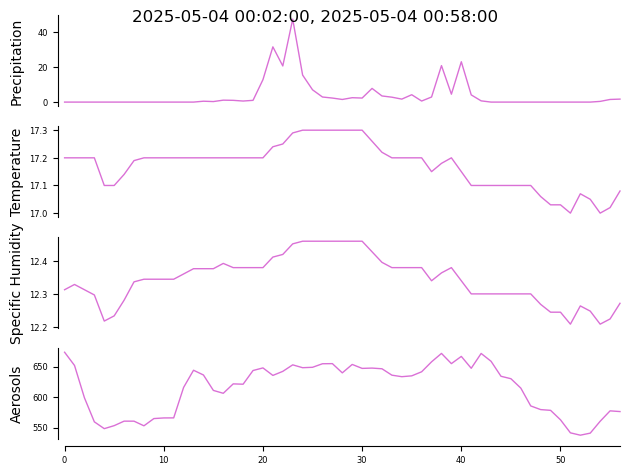

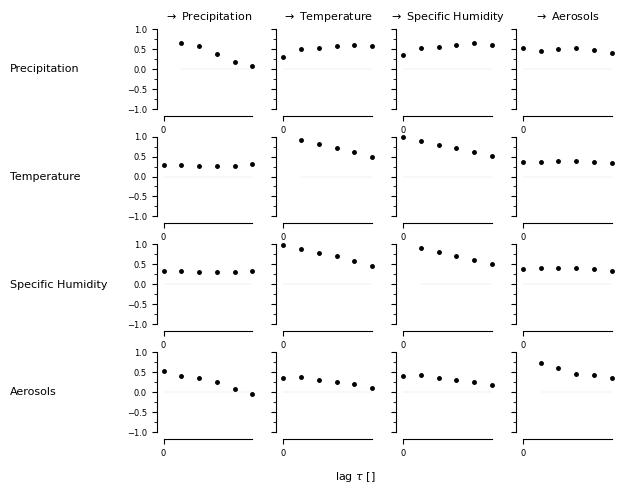

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


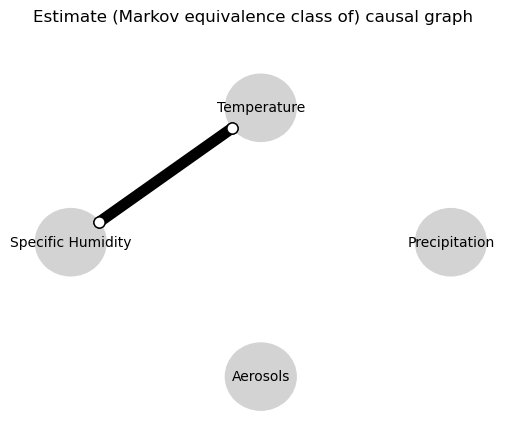

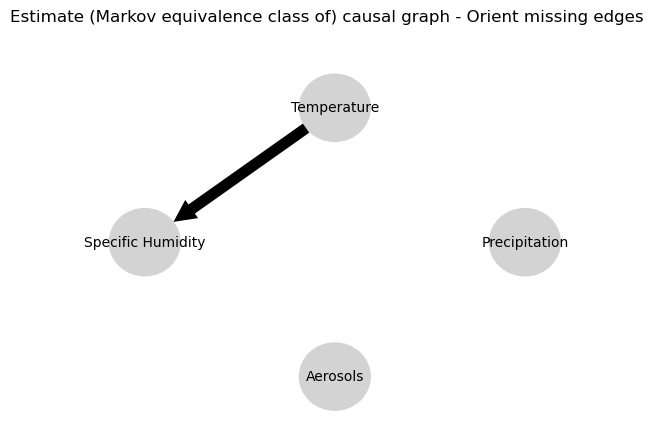

0.0
0.4460555155039646
0.2061385274340184
0.08816912299274778
0.0010722394627375386
-0.03737300160235752
0.12787153298107085
-0.01099374115912963
0.010846187086898168
0.004244162362636975
0.037749265344210234
0.020564603843156722
0.1354099278844943
-0.011332674630120403
0.012262537570032936
0.003938287550673724
0.034636427252706874
0.014550610626426841
0.12301080119131406
0.09683223301041721
0.052585466557743855
0.028409549526991738
-0.013568047370000908
-0.027354556573068813
0.12787153298107085
0.08083697331566395
0.04046497063379218
-0.008658881888714068
-0.03368558447577773
-0.04372769853773284
0.0
0.005863501733848383
-0.0031508718615395116
-0.05893331439987841
-0.0302275060176842
-0.024901310317400772
0.9604288024546784
-0.0035042229908729184
0.0006400036827724578
-0.0553638631447365
-0.03247849812564054
-0.030849971456569234
0.08267133652874198
0.06925486061374513
0.08653120824258251
0.04525867410744342
0.02073241342805318
-0.0036337276816970987
0.9604288024546784
0.0147245646591

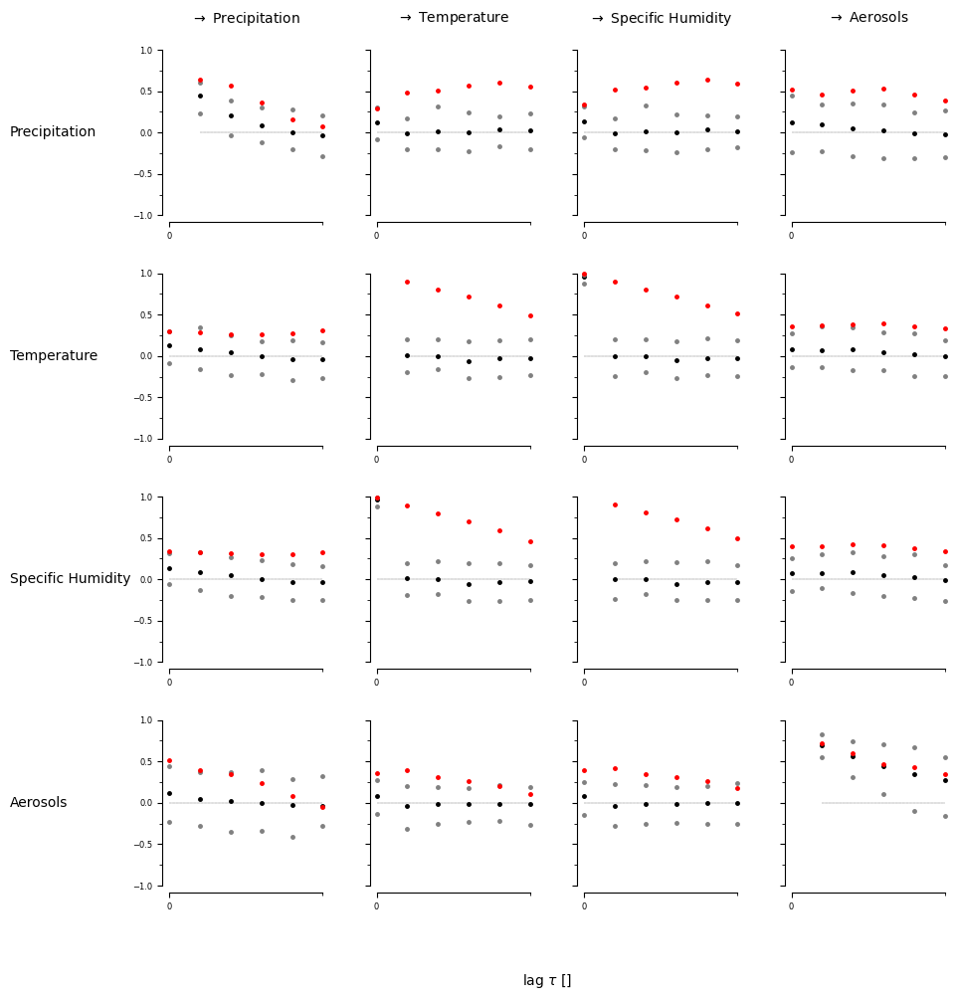

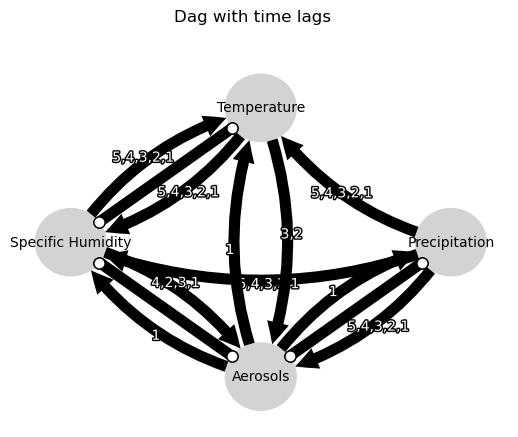

Negative precipitation values: 0


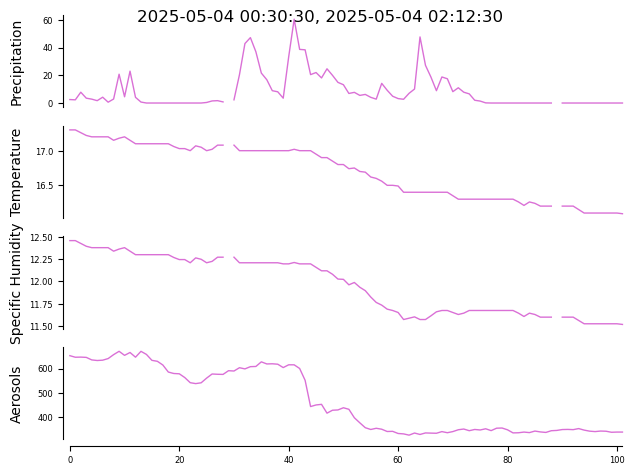

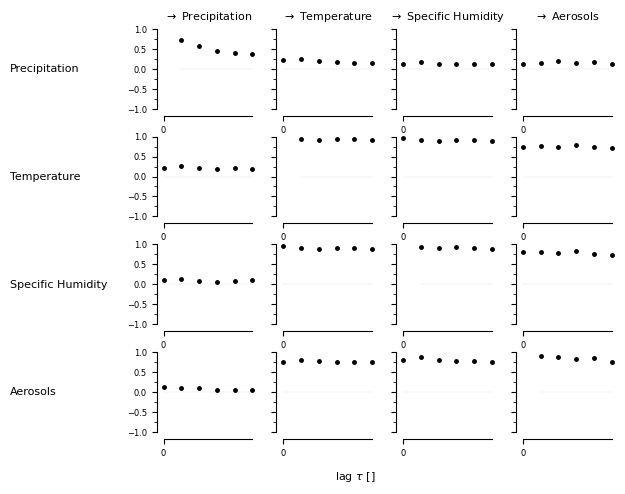

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


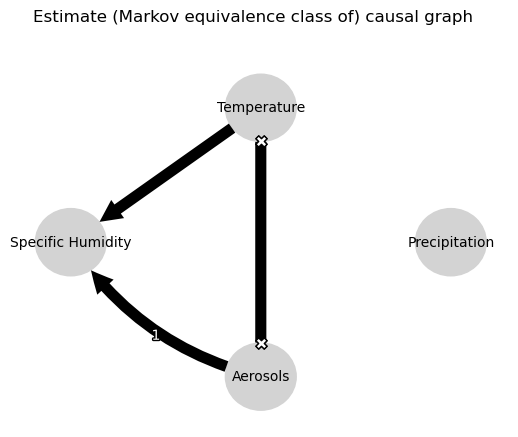

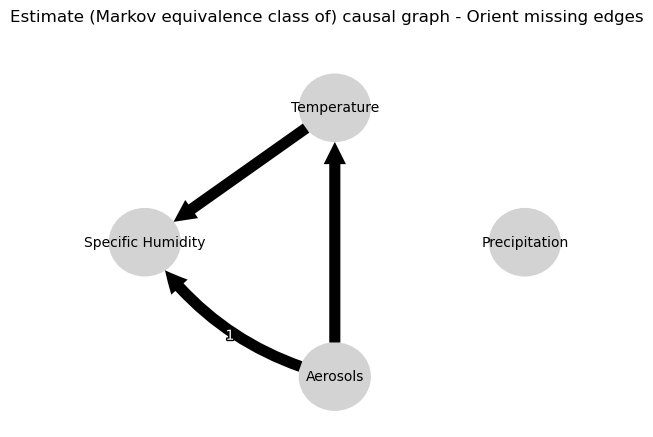

0.0
0.6839431433411916
0.4926104469566524
0.3513378755979788
0.24346856815500673
0.16620090035154958
-0.03299707477830326
-0.032393765478435116
-0.01957932956263491
0.0035124992280587174
-0.0006395450047315566
0.02185973435354755
-0.054087157205985434
-0.02273150704603742
0.0038766191453391452
0.027551301351223585
0.05294250112317709
0.07108388459100023
0.10650792816975756
0.11345422045935438
0.1226753242273805
0.12860692314284422
0.13584073770462524
0.14646675276173973
-0.03299707477830326
-0.04170857994429894
-0.05862290237170998
-0.06826336103126765
-0.06806349696031759
-0.07557047513327754
0.0
0.5429817352150625
0.5308932408764773
0.8654088099456743
0.5085814091438216
0.4854048589870406
0.7683124725111385
0.701098714085471
0.6367844595290725
0.6535289433121069
0.5851329966265157
0.5289866586670836
0.46143964450445735
0.41381346135516167
0.36524730395691635
0.3211021383241608
0.2875314069459445
0.2432781249232791
0.7683124725111385
0.6594410817357448
0.6973529062480154
0.73725075308

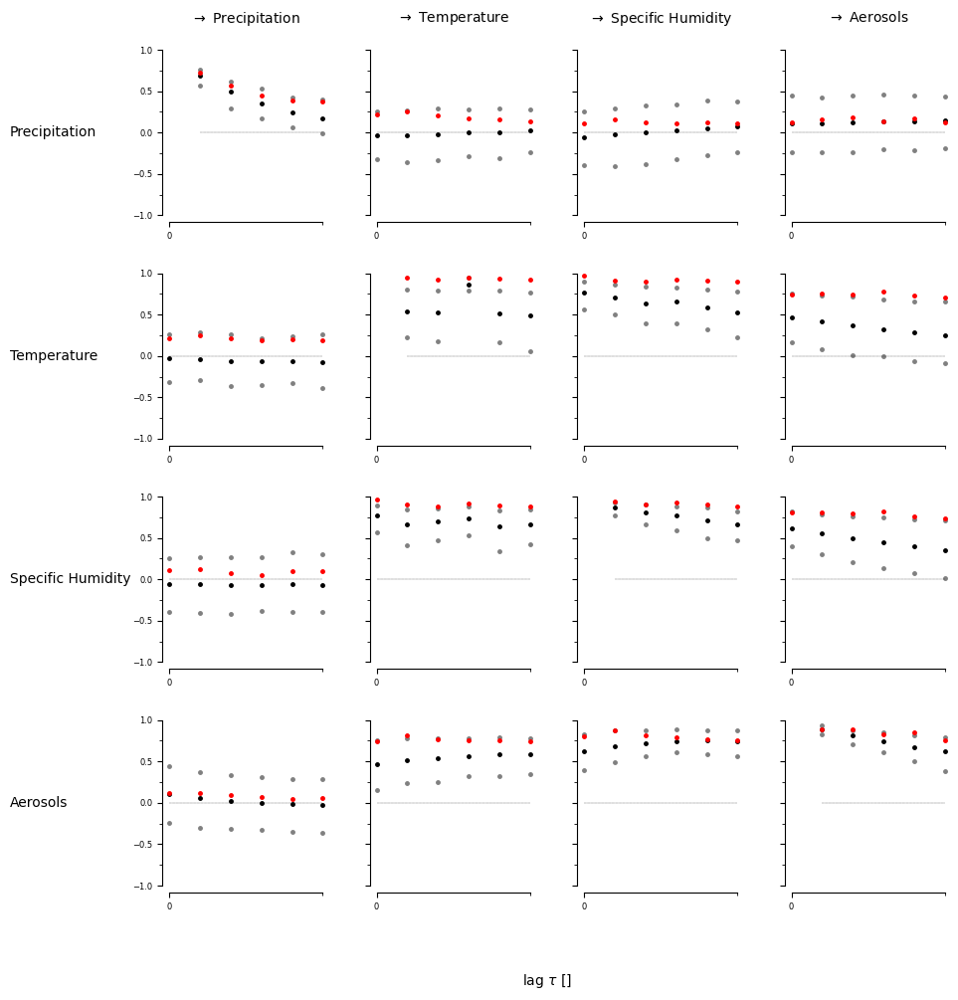

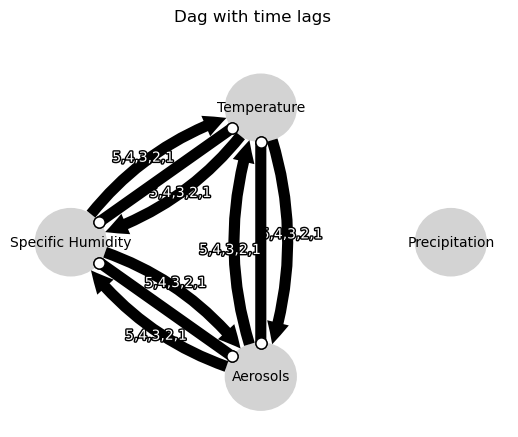

Negative precipitation values: 0


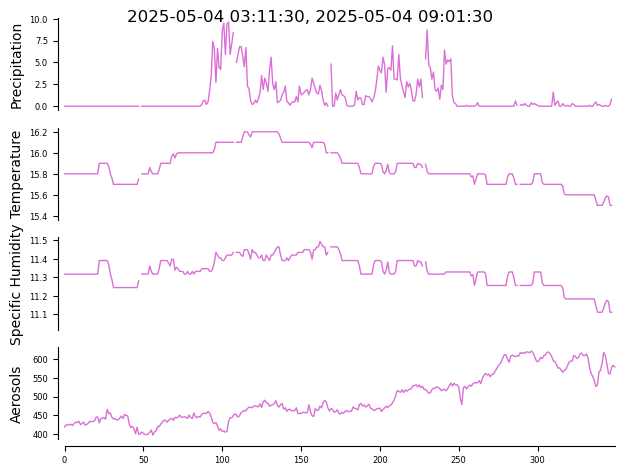

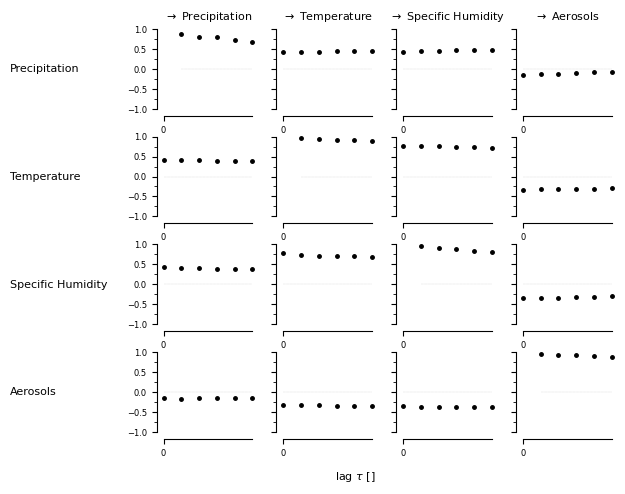

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


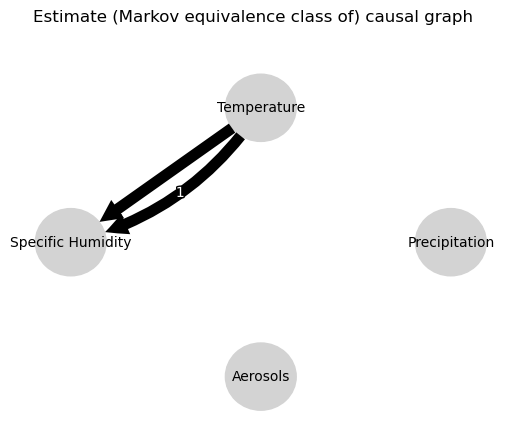

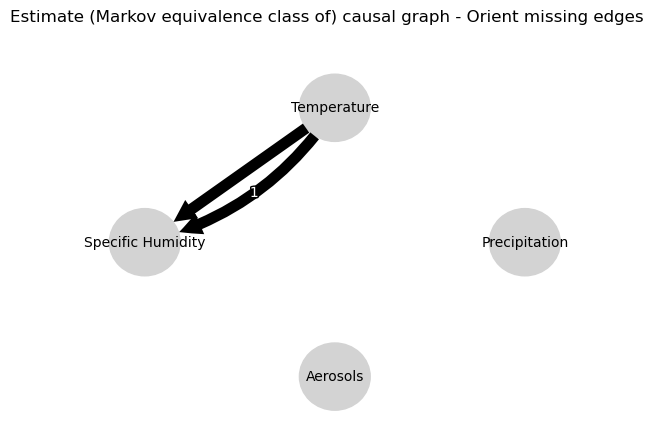

0.0
0.8234030057277973
0.7311191452553372
0.7065134444865627
0.6551282703662281
0.5991765265771145
-0.0605609937892641
-0.061254663117940894
-0.06345338342311097
-0.06203493091579508
-0.05992721326861573
-0.05799731133531529
-0.06885983132191391
-0.06869385861317538
-0.06978713476919104
-0.06807660908385516
-0.06634994791601762
-0.06416214879437174
-0.10054643496616997
-0.09672556650890478
-0.09281258256496906
-0.09011217340362501
-0.08399162845335666
-0.08134455173802137
-0.0605609937892641
-0.05222743768095543
-0.04774373118441443
-0.04552244610372015
-0.04356974602094629
-0.041226695630980824
0.0
0.9581747788150657
0.9287210864248817
0.9038990233912658
0.8799773247879624
0.8578076473567454
0.8901535461670903
0.8519485160544569
0.8206399335734192
0.7937332841697607
0.7688161436983159
0.7451198602468518
-0.015976027778339716
-0.016544706725808277
-0.017462191989797246
-0.018634027291499034
-0.019830821756751632
-0.019603250364169707
0.8901535461670903
0.8593438047053877
0.836137401883

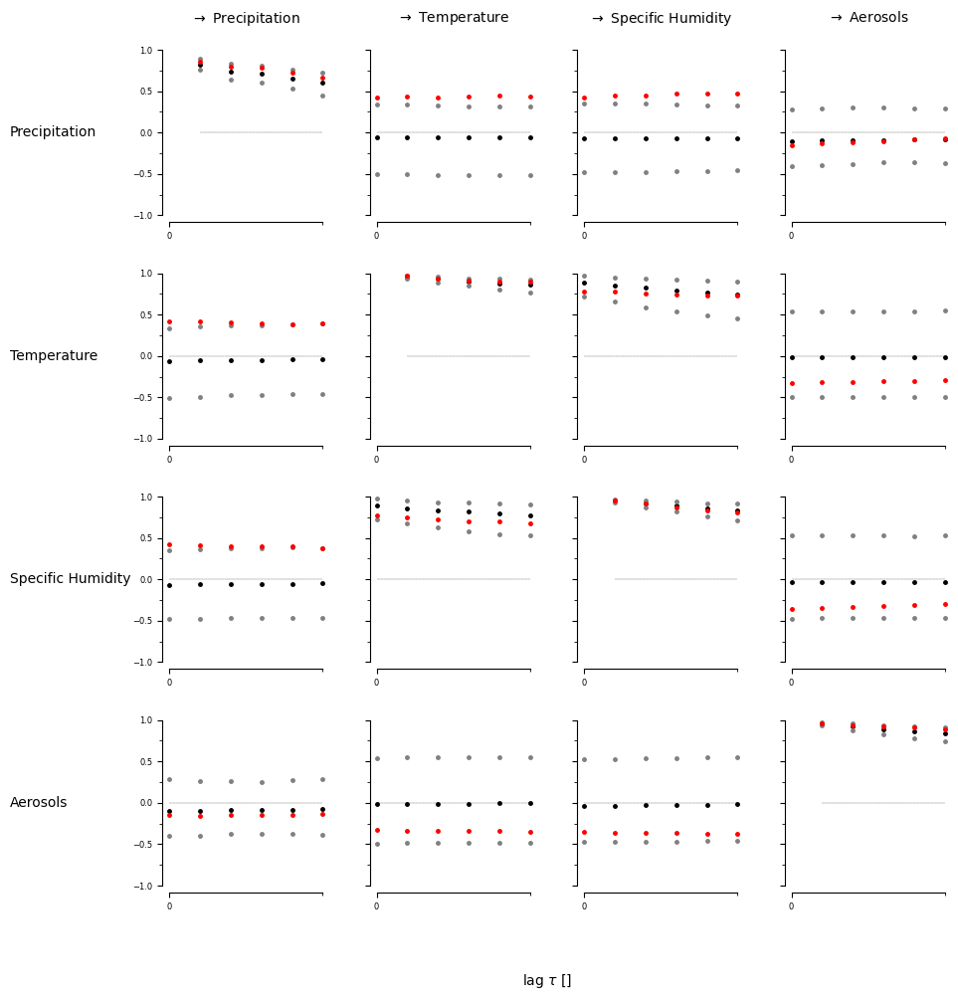

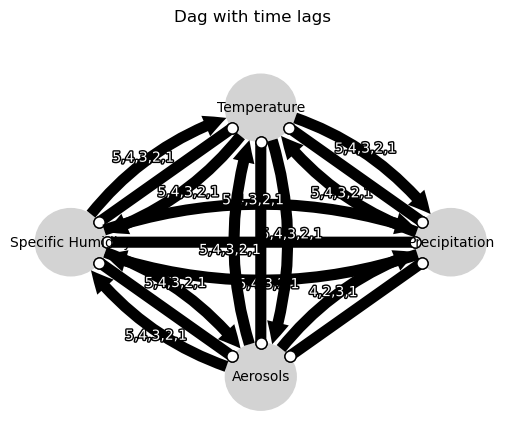

Negative precipitation values: 0


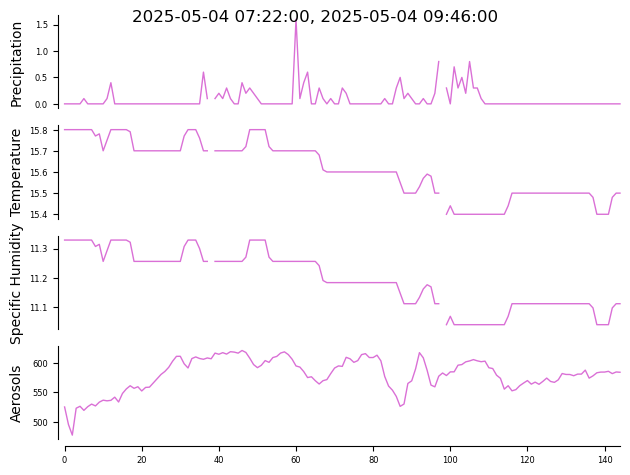

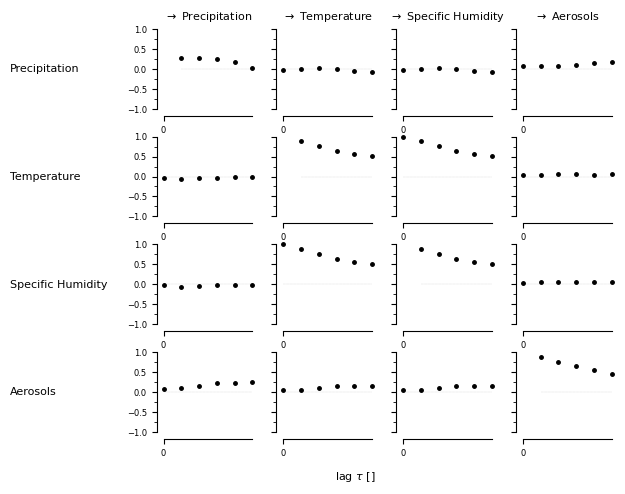

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


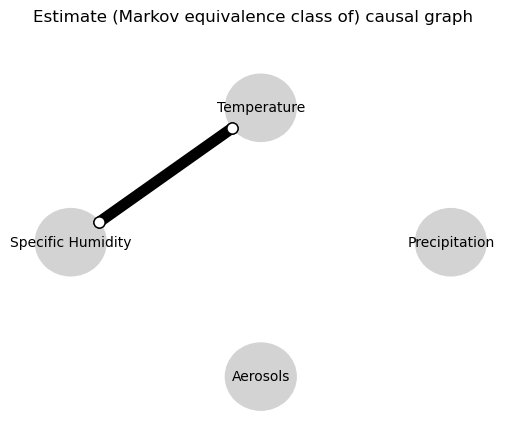

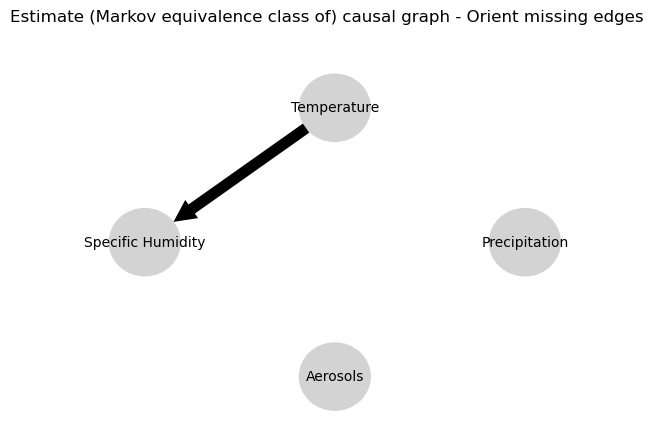

0.0
-0.0007390257262790964
-0.012783530445186778
0.0029963761706758626
-0.006357075056319623
-0.009761037964236894
-0.05312384648057905
0.0037127517961150656
0.01764291712885979
0.0005697392301336524
0.013819124524988293
-0.0018398112651489484
-0.05331143948345896
0.0034096882006540317
0.018121543728232208
0.0013300130038913205
0.014147307757557084
-0.001927067207645797
-0.03726576582128726
-0.04378123671927007
-0.03924637005126455
-0.04186146731531831
-0.02645625583478576
-0.022237362985503484
-0.05312384648057905
0.00560517333241353
-0.001504930236273402
-0.007039165396783485
0.004826991317693082
0.0011213514102878367
0.0
0.005062531049521578
-0.0088488643388756
-0.018705671337366957
-0.0006138457636317721
-0.006072201931509631
0.9994695362109492
0.004509878822843178
-0.008062759179956165
-0.018105152349751512
0.0001457500257203334
-0.006092844516911243
-0.002602268073075752
0.004718175997039616
-0.007600489126732668
0.007862577251630523
0.00729173545007203
0.008588289909071739
0.999

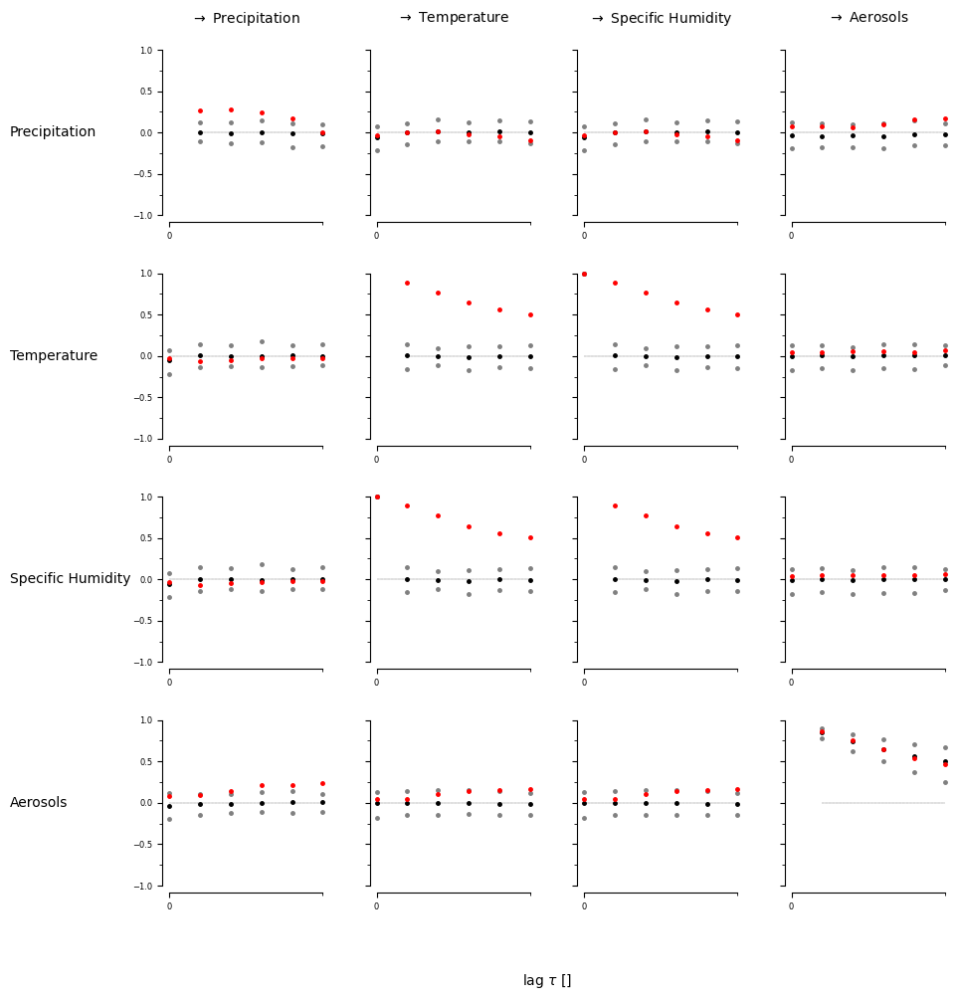

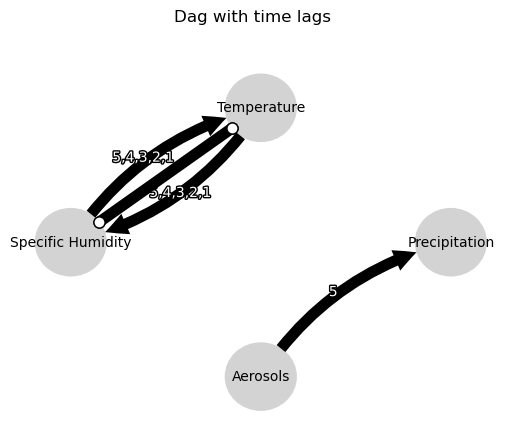

Negative precipitation values: 0


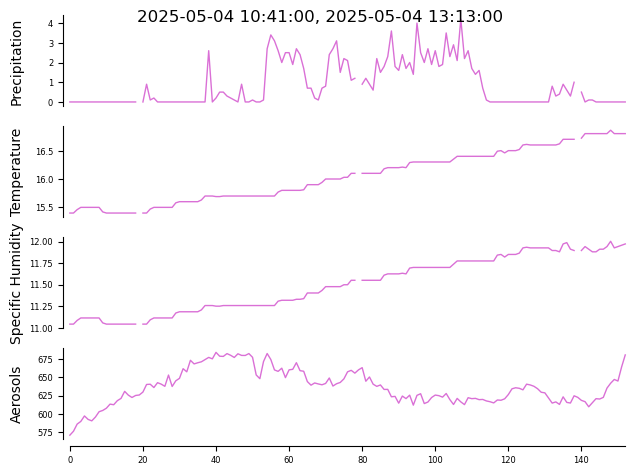

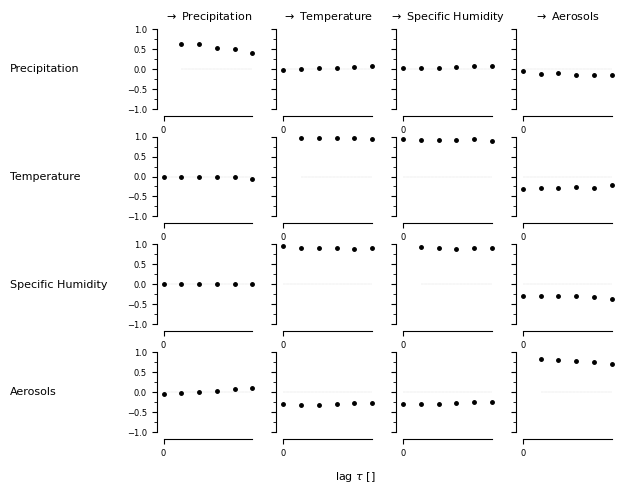

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


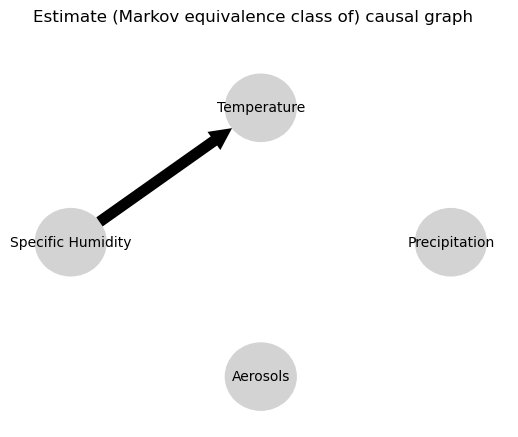

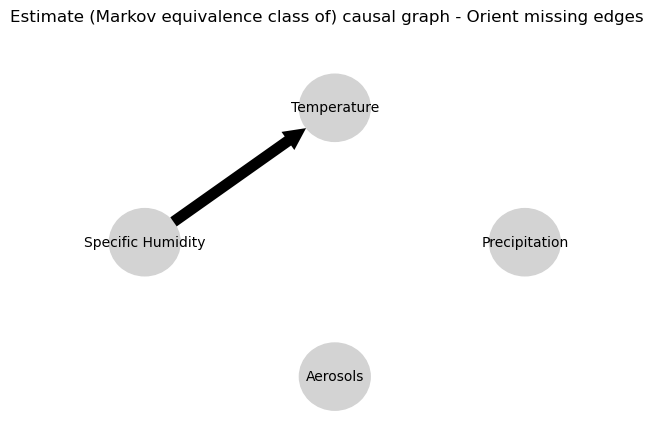

0.0
0.7263145085719351
0.6746127058574365
0.5736109898178449
0.5054795640649847
0.43809530886354503
-0.022038266636703698
-0.009790840343958756
-0.0021701481568444383
0.0026638172103611597
0.008429407909088481
0.008873765134311682
0.00011554815306621613
-0.0018849920056479513
-0.000661454641844958
-0.0041881709020901
-0.0027342648146410973
-0.003606301245977441
0.10418802866702835
0.09148168189669556
0.07660054863532105
0.06103701221010815
0.043781722899359804
0.032117470372562656
-0.022038266636703698
-0.019346381612101102
-0.0308446166306469
-0.031072502443535245
-0.034748662833789704
-0.03668586838950568
0.0
0.5734214916967283
0.3656453636381648
0.32488819121569645
0.45162496883328784
0.7521112417766898
0.6074637424814909
-0.13819120834792098
-0.043669909345437324
0.1194030395699739
0.3256289446853596
0.5653272208504722
0.0439806644203937
0.042351175346074896
0.04626926764368261
0.03453308870337627
0.02128594966607651
0.020827672093158833
0.6074637424814909
0.3595557230100085
0.1458

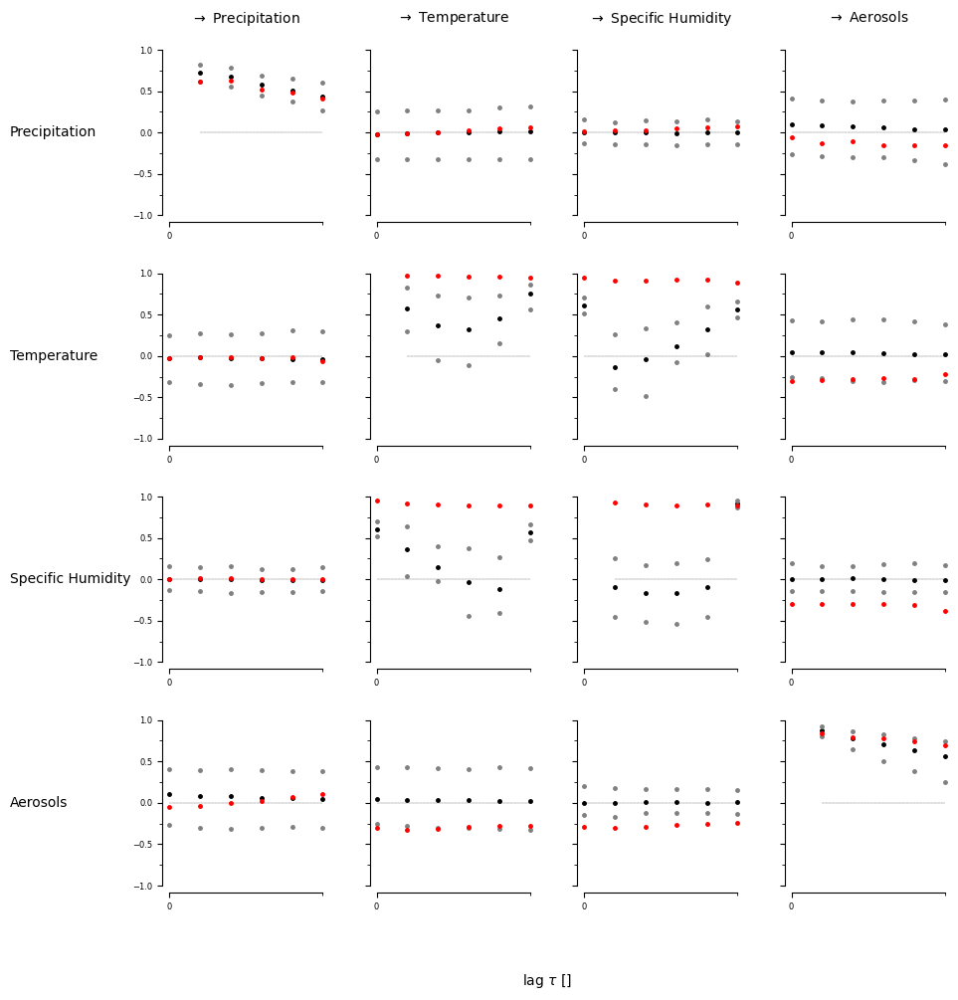

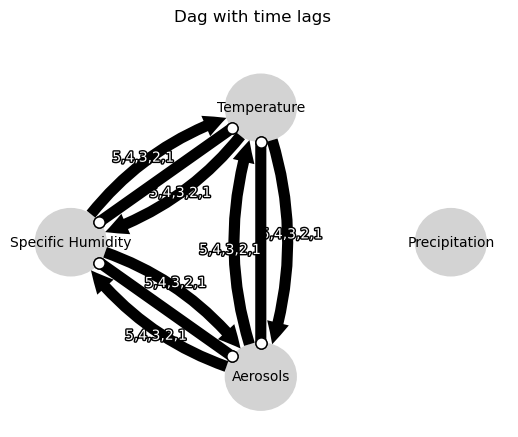

Negative precipitation values: 0


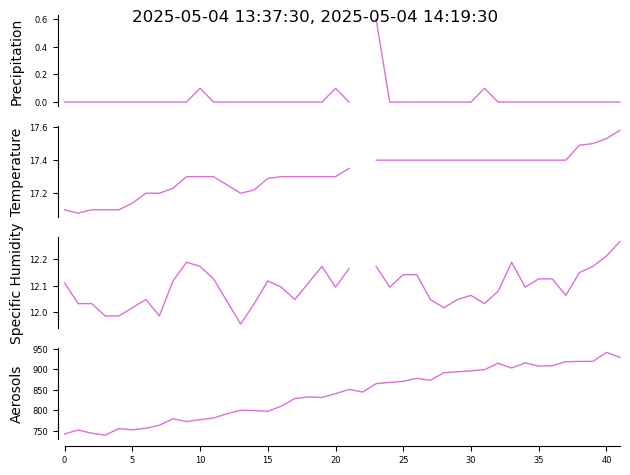

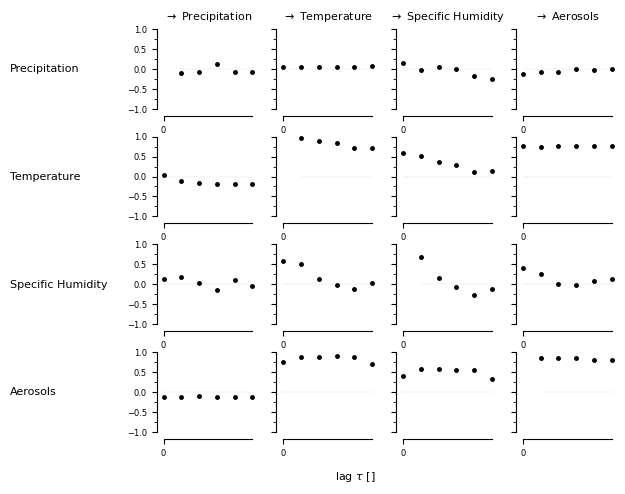

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


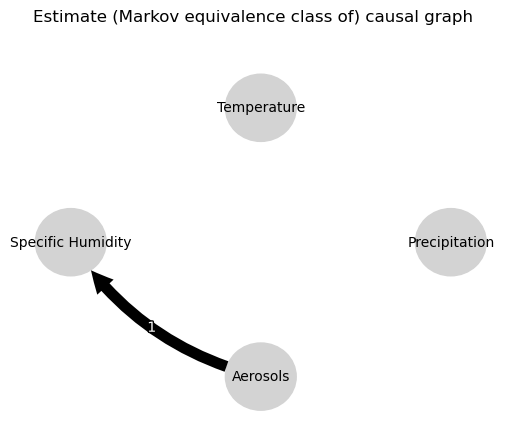

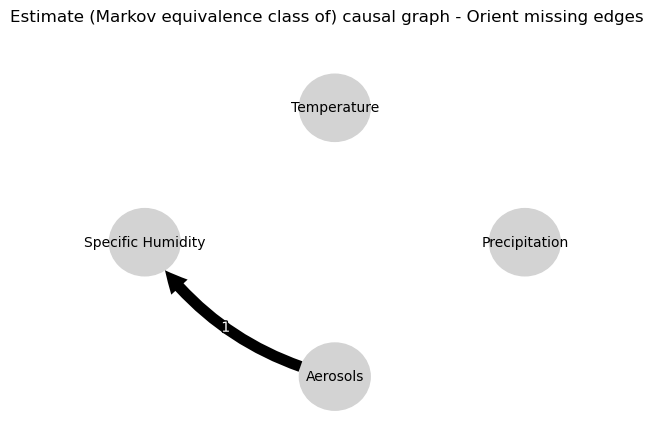

0.0
-0.045733014375405105
0.011142978094799201
-0.03688114671387781
-0.029673052441825894
-0.04804765970384307
-0.04230308527244135
-0.058377199880165785
-0.04798143696517461
-0.021017563939474578
-0.03196195470235766
-0.054733659990230256
-0.07593712945954645
-0.04759247746729517
-0.013052620984561442
0.003323271680732659
0.02741350765802047
-0.0132201644569215
-0.004946241948097612
0.01591480701281487
0.017279992571691553
0.007980132936044017
-0.003881985863476761
0.006994709847430292
-0.04230308527244135
0.006126233381596438
-0.021264095955898413
0.003029129171742136
0.010878024396946115
-0.010918322692842968
0.0
0.6540995198157268
0.5182307325664722
0.40186517824064366
0.32170330128607616
0.26141243278921733
0.29199078750809776
-0.008145973547563155
-0.09947332339186069
-0.14465448733734448
-0.16426504500088512
-0.15267077692209544
0.017685360330652412
-0.02818473568718687
-0.03955332992569631
-0.032000572245379055
-0.014839523416881129
-0.024709311962125148
0.29199078750809776
0.2

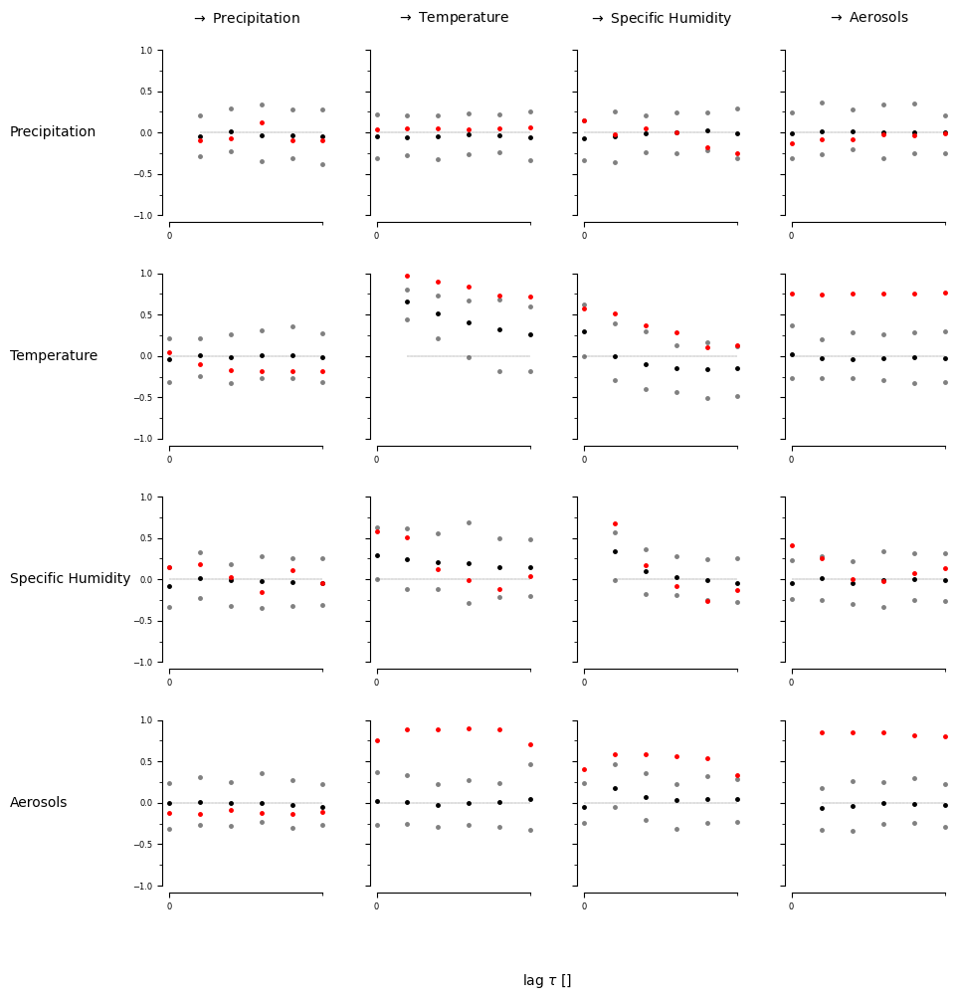

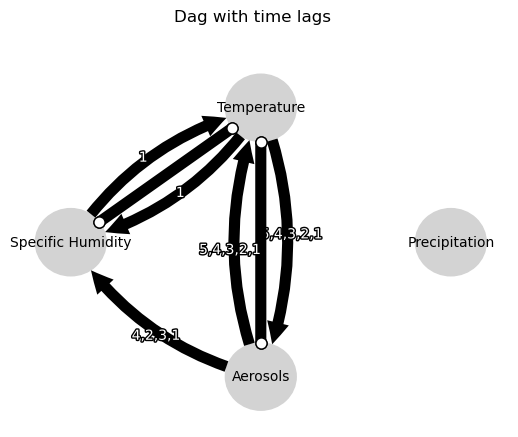

Negative precipitation values: 0


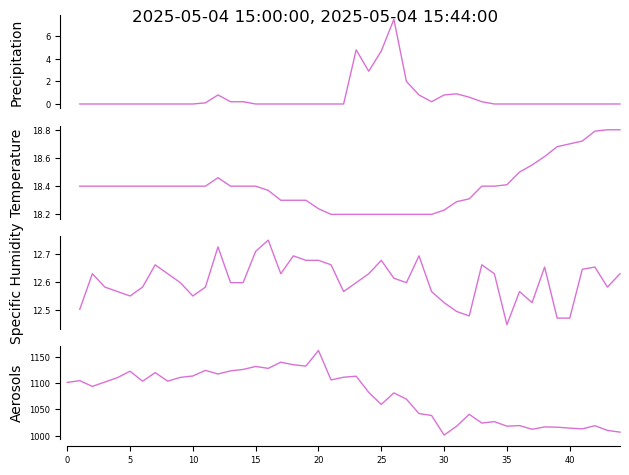

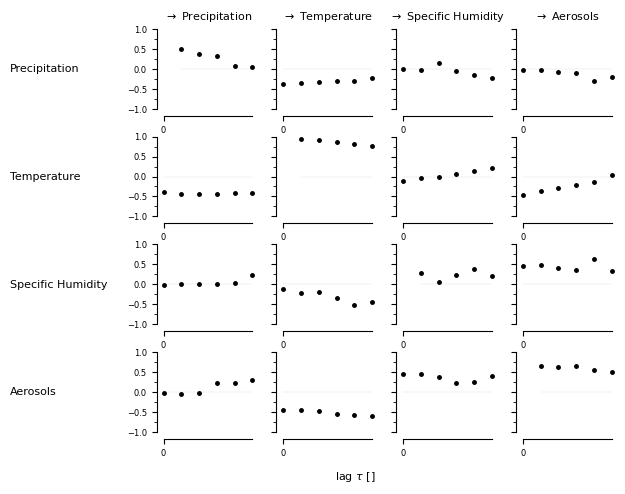

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


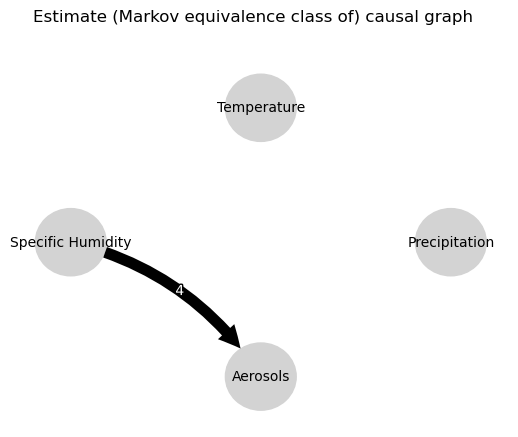

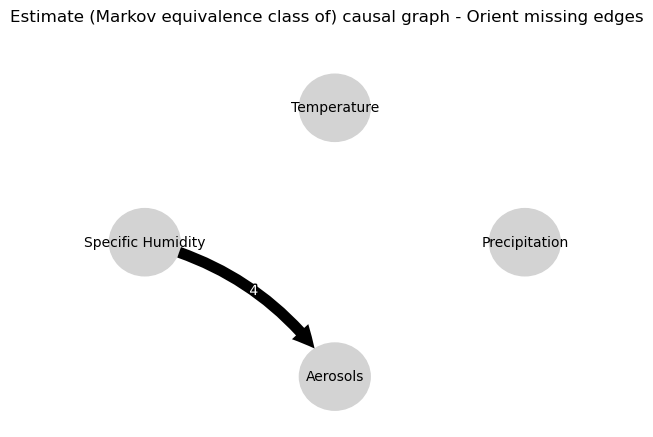

0.0
-0.009782422214159918
-0.03313850027788709
-0.02457671869893888
-0.021867654827487096
-0.03822759624314307
0.04077100098864985
0.03962183816848172
0.050639507176232106
0.03602734695943723
0.0004982420198816845
0.014022956642683333
0.04617330101893895
-0.030326130600180128
0.03766146185806606
0.016510140851506462
0.05965102350564722
-0.0038176849867625107
0.003379411420928936
-0.018768207936780554
0.03342006211358137
-0.00918627374910208
0.07508845454692814
-0.0479525699375811
0.04077100098864985
0.02691277969346187
0.022762667351009607
0.016590282711081275
-0.0003702750619787021
0.022779622574085733
0.0
0.8440011265305825
0.8017931500026272
0.7565664852168728
0.7480288819832637
0.740566259877004
-0.020466974547859777
0.056205932488388
0.029127747450171864
0.03925203298859206
0.03797408460875225
0.03300137065905122
-0.07896743248893251
0.05687951420853274
0.036310497092320516
0.013767465872636431
0.027220794006048175
0.03734937888465149
-0.020466974547859777
-0.0035537505548381117
-

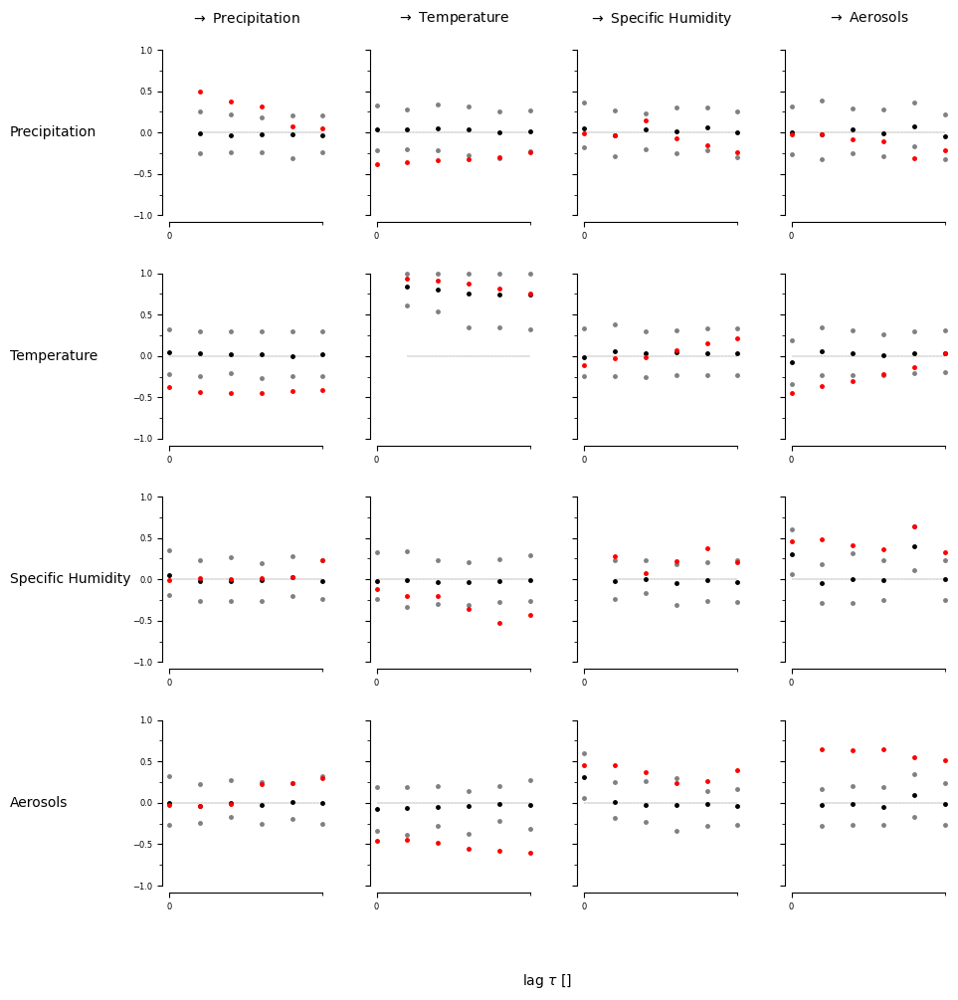

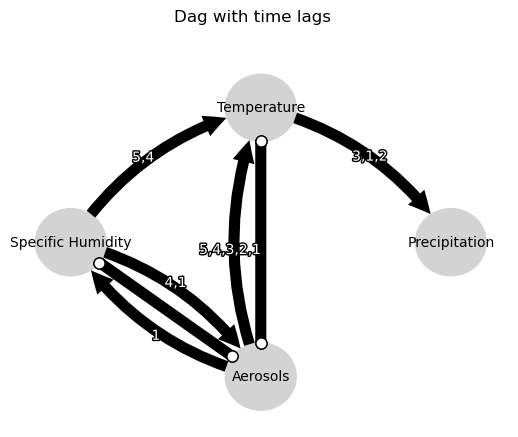

Negative precipitation values: 0


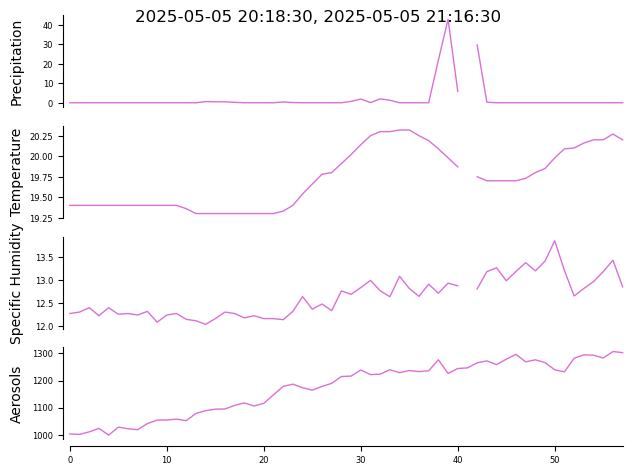

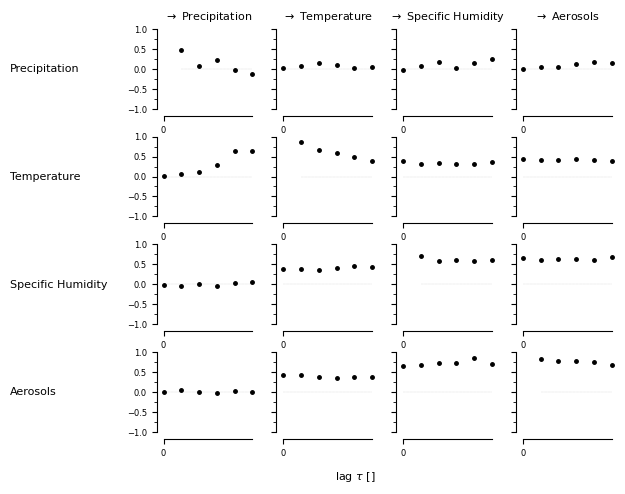

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


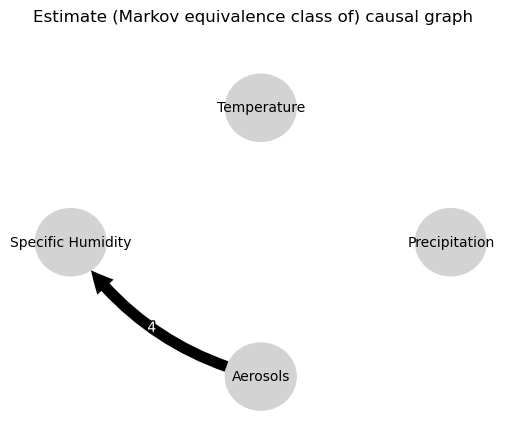

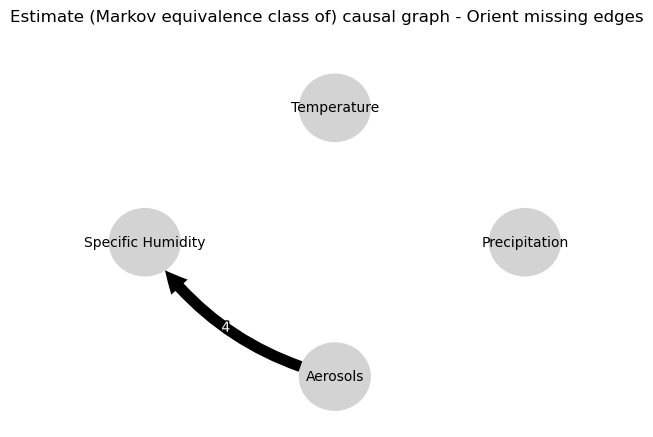

0.0
0.005442127989880612
-0.02354007095944296
-0.008937832799608402
-0.018999696827944387
-0.009965831186546719
-0.08434276646090125
-0.059344781929498894
-0.06441623758136922
-0.06641087005980452
-0.07132049659353293
-0.06642294128610184
-0.058135756070971156
0.02423389203947371
0.032583266351010366
0.007895494619675585
-0.03204869794132334
-0.03369342787858217
-0.052177853726321305
-0.06716040059964107
-0.052765528903523595
-0.04329982563976653
-0.003455169646146309
-0.026115025442649754
-0.08434276646090125
0.10021690544434024
0.07676196899981512
0.07366310762969688
0.08719522826663423
0.08335854437401928
0.0
0.7633213910042798
0.670917457181994
0.583299911688444
0.5156988399064469
0.45217976144541544
0.0519322215923294
-0.04286853854214781
-0.04980976857875355
-0.03868930934091255
-0.042218934991940744
-0.03792812595449606
-0.05596652638223257
-0.046815713341876536
-0.044445061992917784
-0.047343369255254106
-0.0449659912583026
-0.029416062067655194
0.0519322215923294
0.04305427394

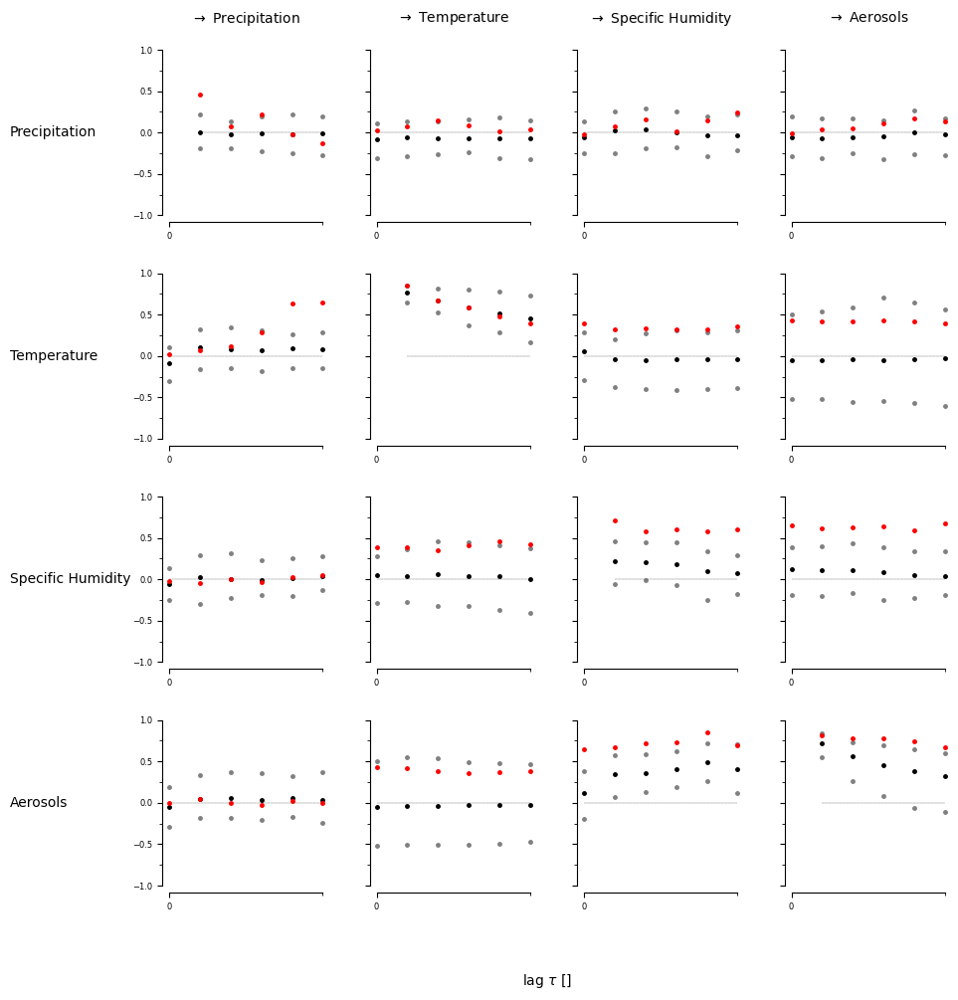

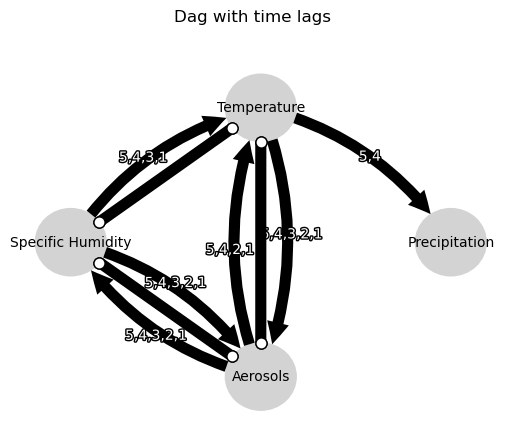

Negative precipitation values: 0


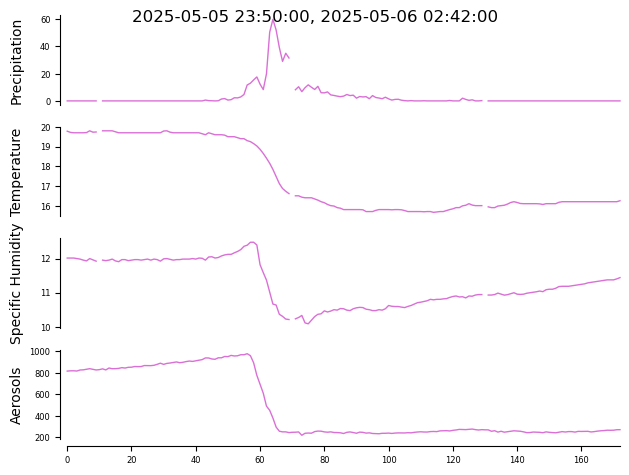

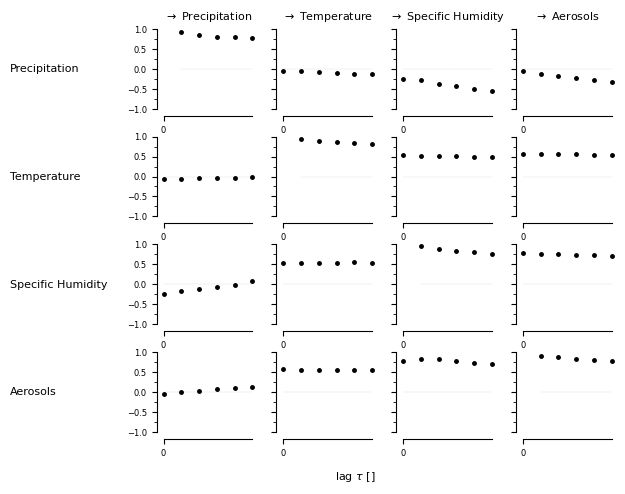

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


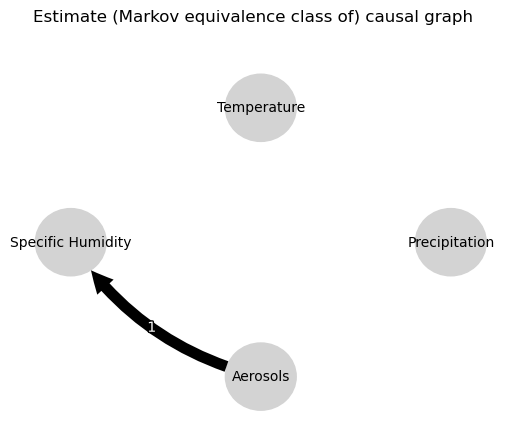

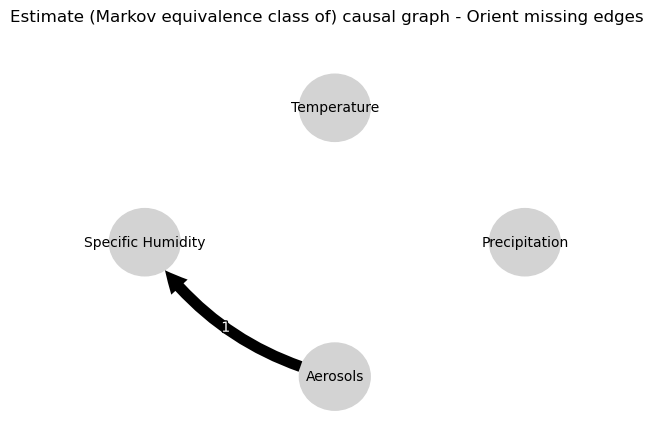

0.0
0.8982352566339972
0.8352928785364295
0.7772388028020134
0.7279971181225099
0.6843984008050018
-0.08530011497651191
-0.08557415908062978
-0.08709658109474339
-0.08862659516861723
-0.08849958039892272
-0.08728645225281502
-0.16249611568433647
-0.16443276229801843
-0.15785389208788342
-0.14940425509294922
-0.14280065648461654
-0.13186939668362543
-0.09815258192535882
-0.09263245553162068
-0.09142171522307325
-0.09276185338489125
-0.09497733709793378
-0.09434824568446863
-0.08530011497651191
-0.06751138899694437
-0.05233172815363907
-0.039572364999135703
-0.028338965669455617
-0.019924215456693605
0.0
0.9164549791079155
0.8590690558758192
0.8133282220310244
0.7679120781860521
0.7270308533997768
0.39694158049819045
0.38436514958927054
0.35819037284116384
0.3259898568591154
0.2938739426020833
0.26415570985415854
0.5830764632152794
0.5454568998087673
0.5149672028052346
0.4897926803594907
0.46613522716545247
0.4461029877307261
0.39694158049819045
0.37394931033334033
0.35743782247632694
0.

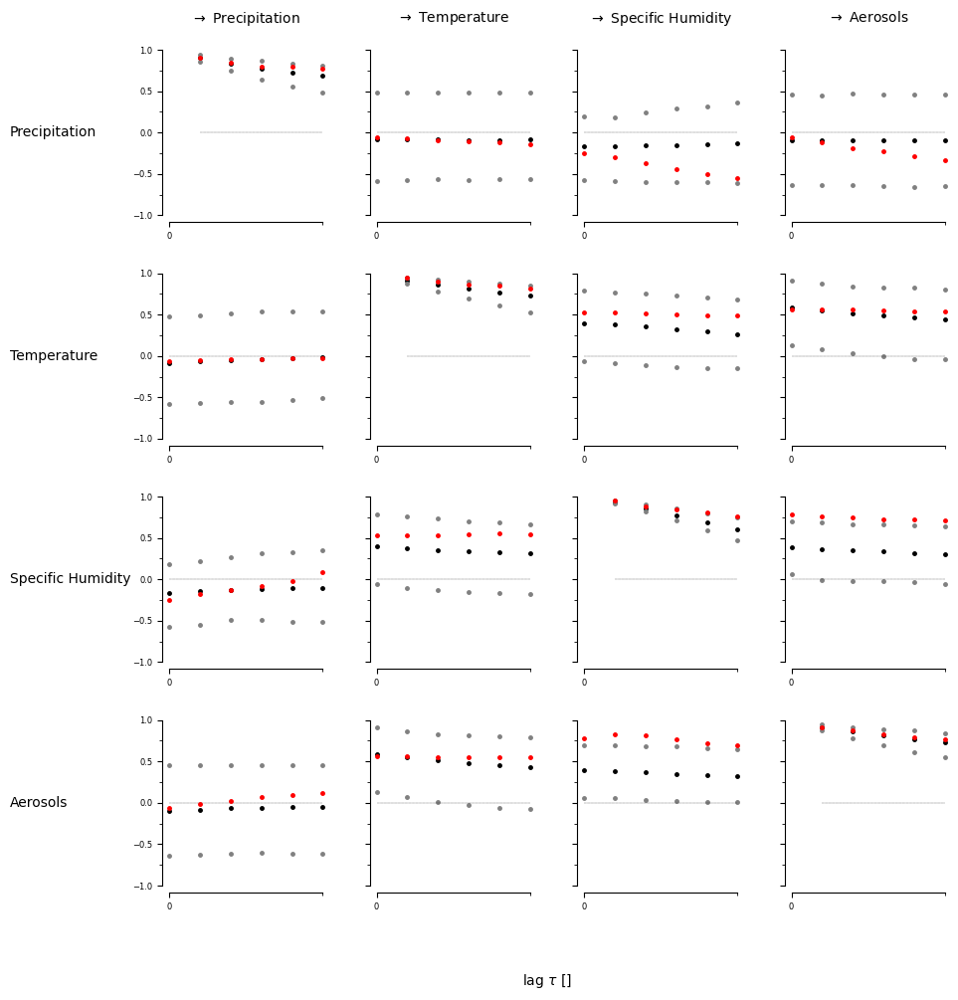

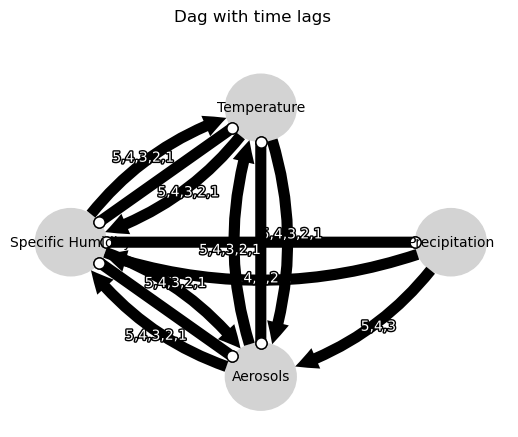

Negative precipitation values: 0


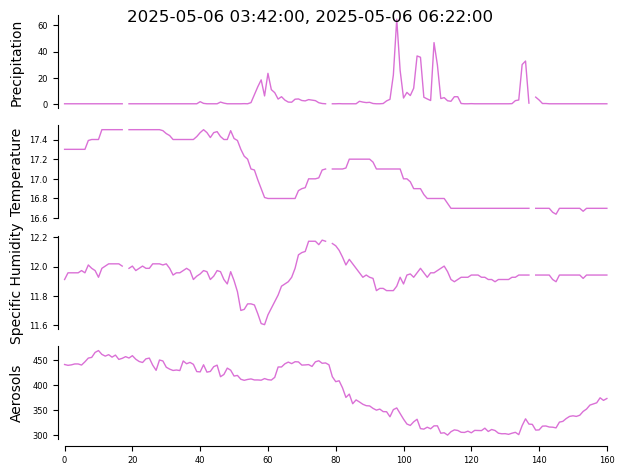

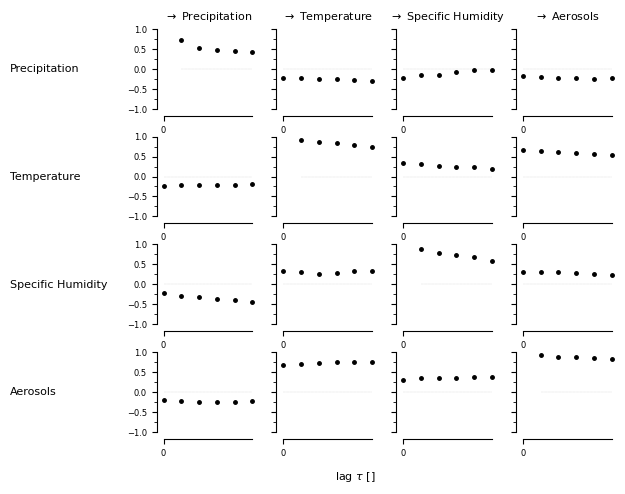

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


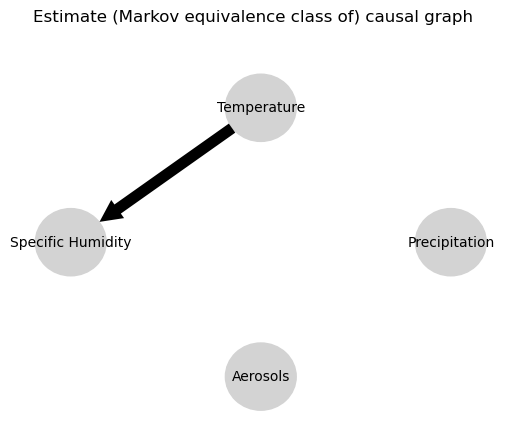

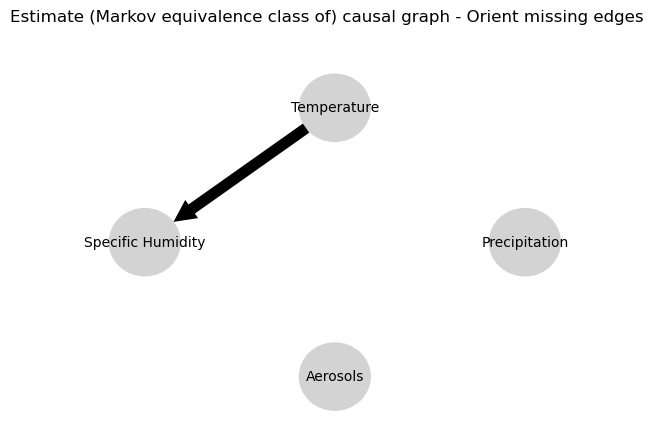

0.0
0.5382745457284058
0.30378290292342547
0.17632062802402873
0.08856967866698785
0.04165586858226329
-0.016819799061746642
-0.023084410815892534
-0.021124847172788064
-0.02821157852345078
-0.022143227727989906
-0.01320797403716496
0.010388138677695063
0.013644764063863436
0.013511192765739519
0.012640984636563844
0.012310504724233928
0.01928604763164319
0.07560370432719685
0.0703408708263123
0.06008360518267545
0.053541397750336096
0.04008914842044295
0.03841826767798979
-0.016819799061746642
-0.021073155916194106
-0.021636049950387436
-0.022350815428132935
-0.017070337854521174
-0.012822292389713765
0.0
0.913655562961149
0.8567955584881085
0.809368532234629
0.7674157549430113
0.7276222679371115
0.38274054844477645
0.3125830076491292
0.25274282064028275
0.19864105896078477
0.15068736520492357
0.10932844450661339
0.11378458264363454
0.10290102750308376
0.09790331465215414
0.08970073586721966
0.08802088207410946
0.08552217974957196
0.38274054844477645
0.3592320149431691
0.3359620130641

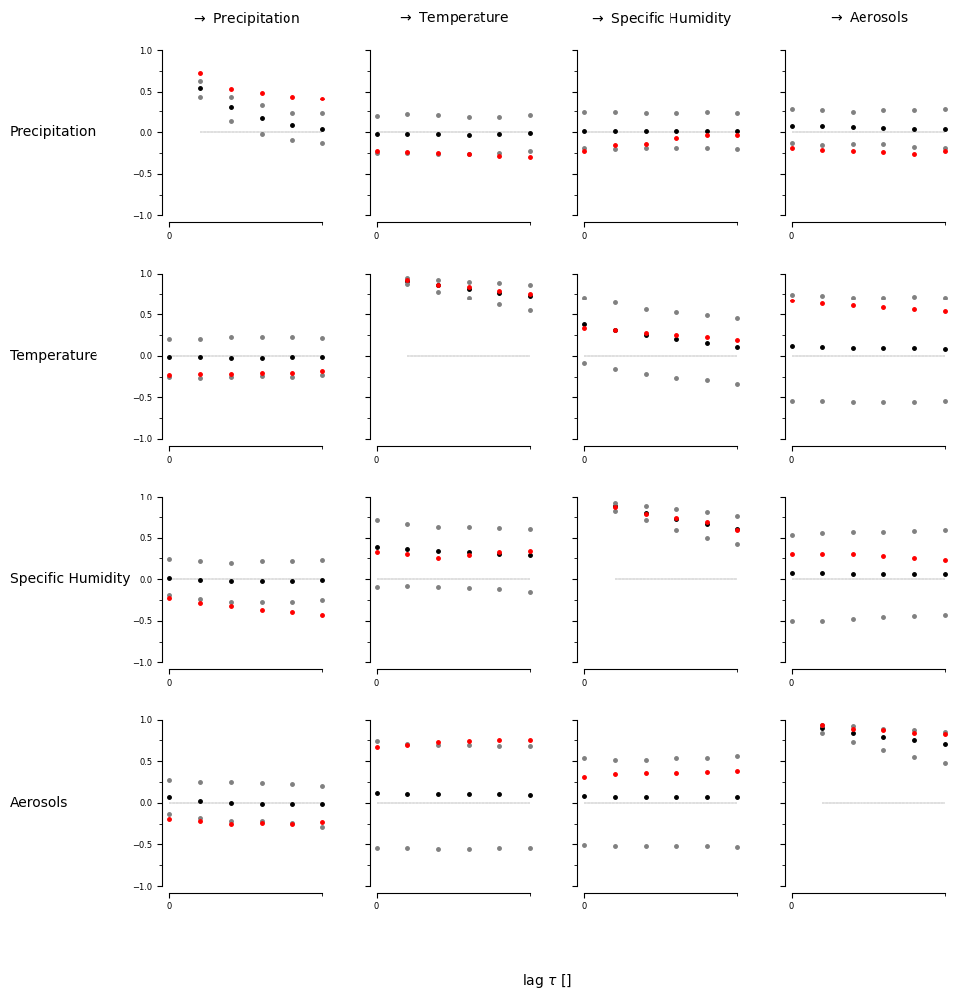

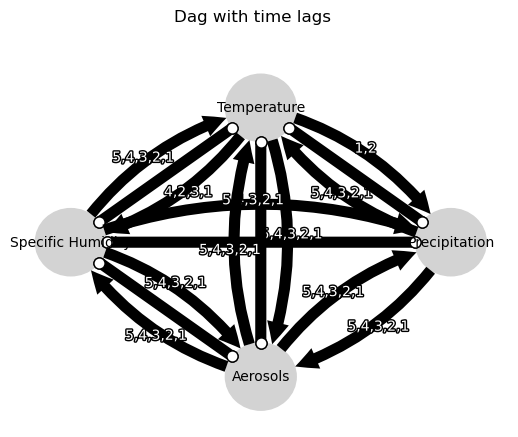

Negative precipitation values: 0


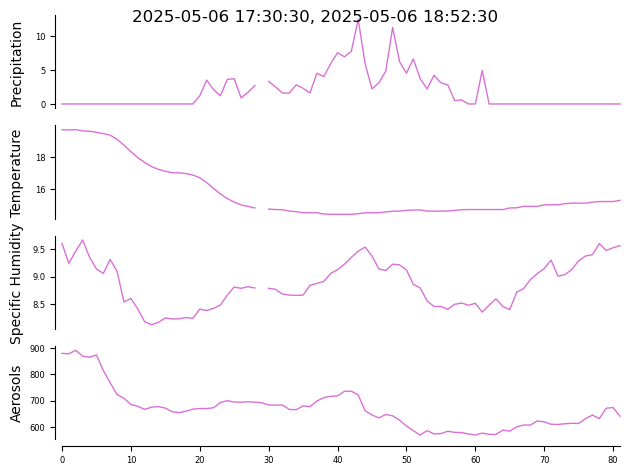

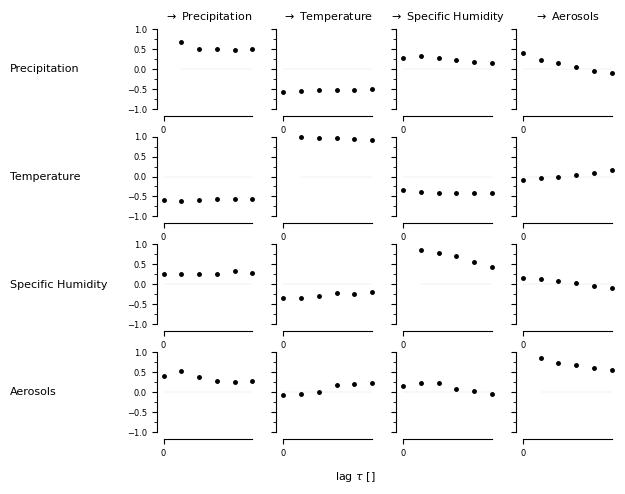

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


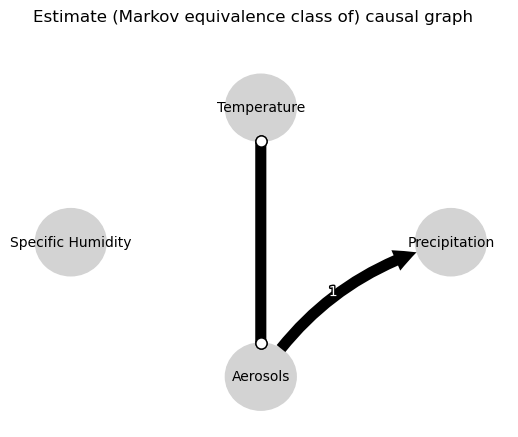

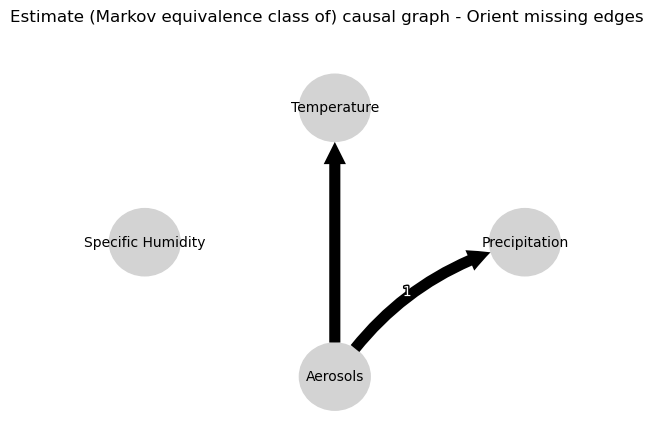

0.0
0.002855305381935759
-0.017942208568204446
0.008352921288029029
0.009712919442465778
-0.008057186678999751
-0.05882334082519055
-0.04891900720337035
-0.051870726825891535
-0.036288697484840045
-0.05418906430327208
-0.04672453891012793
0.04016614908815939
0.026645171008000075
0.01590568137355284
0.022770530429378644
-0.010769553975571547
0.0005522345161213407
0.05419905890556152
0.02948570815040777
0.046585211905938104
0.04294858876135896
0.04538987171545071
0.03375523916128865
-0.05882334082519055
-0.018377824448968388
-0.018417084138646362
-0.0014067255385154709
-0.02036812099880146
-0.013610797517189991
0.0
0.8119426711034579
0.7096734731557105
0.622852501072987
0.5526506589484378
0.49891866513378547
0.16424172540758947
0.15536857400969456
0.14323002535740595
0.14110273632439863
0.12651395914751676
0.11456381250562105
-0.21250563988975263
-0.17012477656843675
-0.14154305486144292
-0.10838471016933632
-0.08854871652999309
-0.06706735097037611
0.16424172540758947
0.1439044220039645

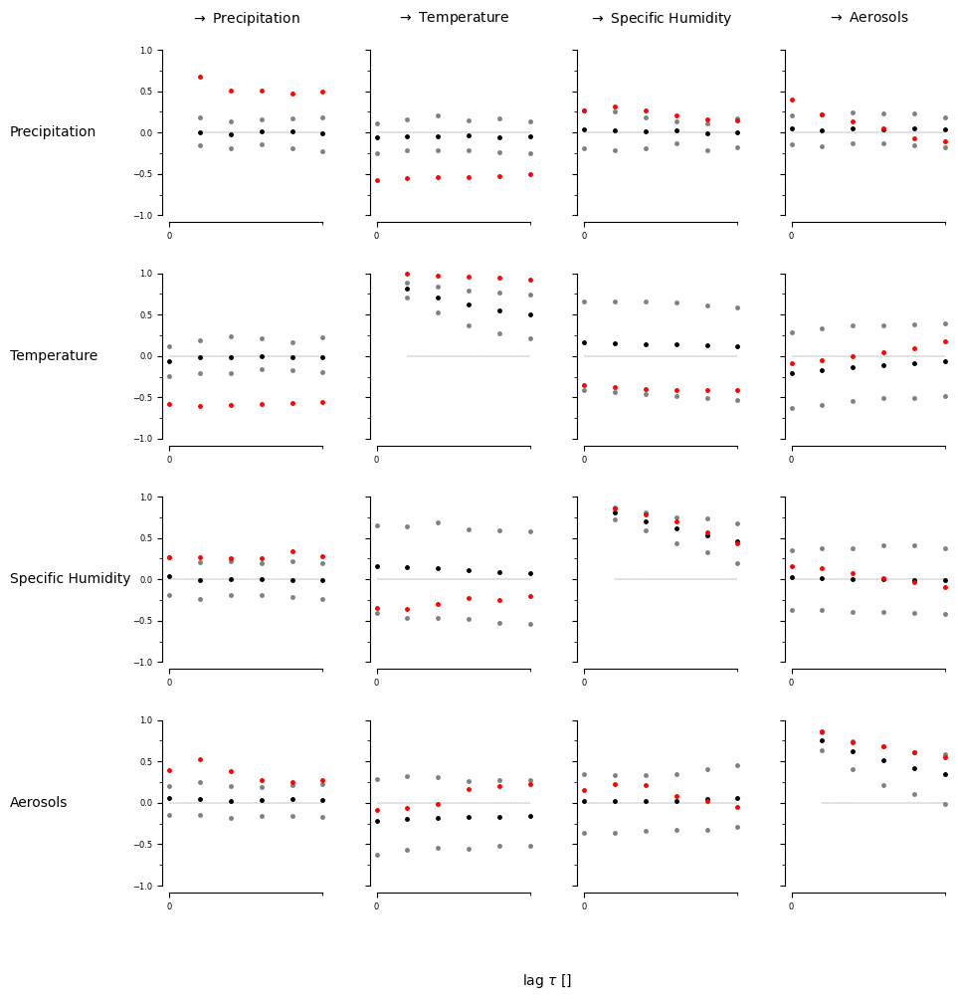

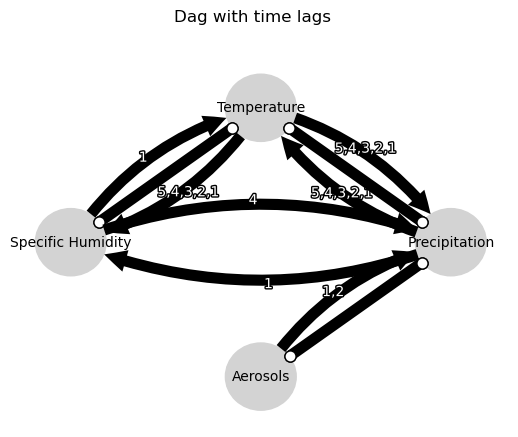

Negative precipitation values: 0


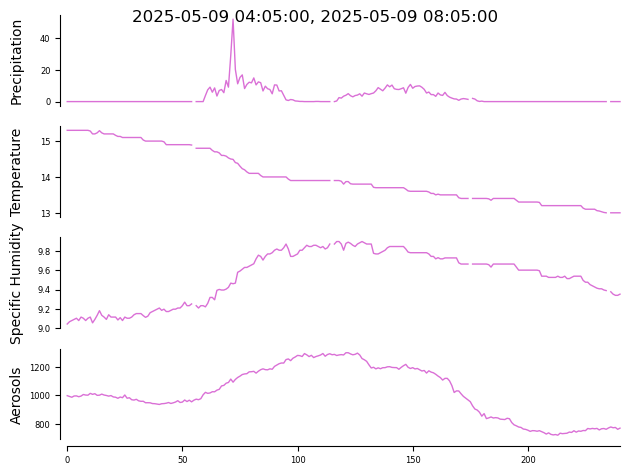

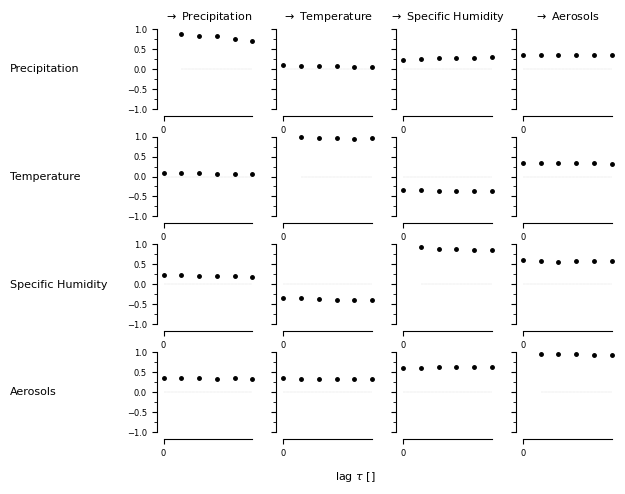

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


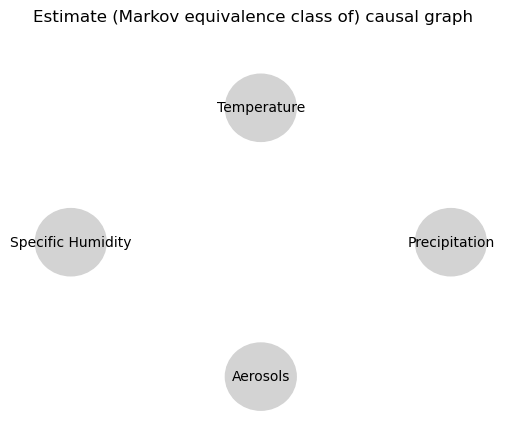

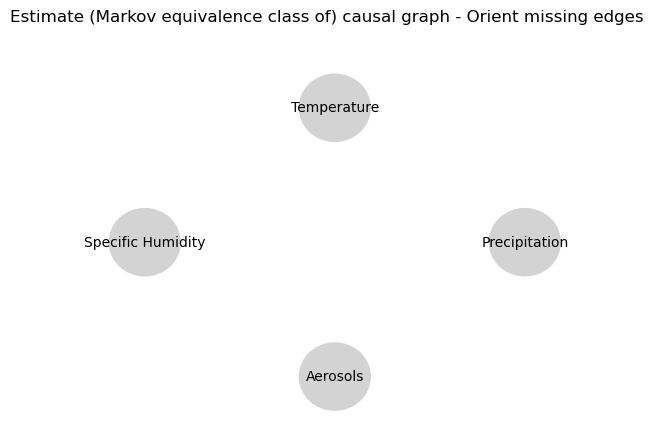

0.0
0.7824231609408504
0.6722821656300481
0.6476085115388495
0.5871355223843713
0.5248941401989697
0.03385462648149746
0.034207898815525634
0.03437819272045916
0.035385118838941555
0.03493336991614233
0.03376132755715641
-0.015958332429720595
-0.0145319552455207
-0.009975517299847645
-0.010134757219434248
-0.009815505335507783
-0.011094203624032182
-0.10451403207534932
-0.10574069687592313
-0.10258873875482812
-0.09975476826837791
-0.09313039600872312
-0.09115227251520276
0.03385462648149746
0.0209727016867805
0.012122852491427066
0.007872501344028109
0.003047599361350025
-0.0010429347640526587
0.0
0.9523210784704454
0.9189746614983441
0.8883510606637135
0.8592236720814366
0.8286122854313365
0.48629306436285674
0.45969237609538915
0.436166602154454
0.4161445049215375
0.39764038522259587
0.37971547259974214
-0.051127233796367355
-0.053371549112333355
-0.055551696502173196
-0.05626873908560991
-0.05833585159340305
-0.06122396205755048
0.48629306436285674
0.47362979632462315
0.46158942374

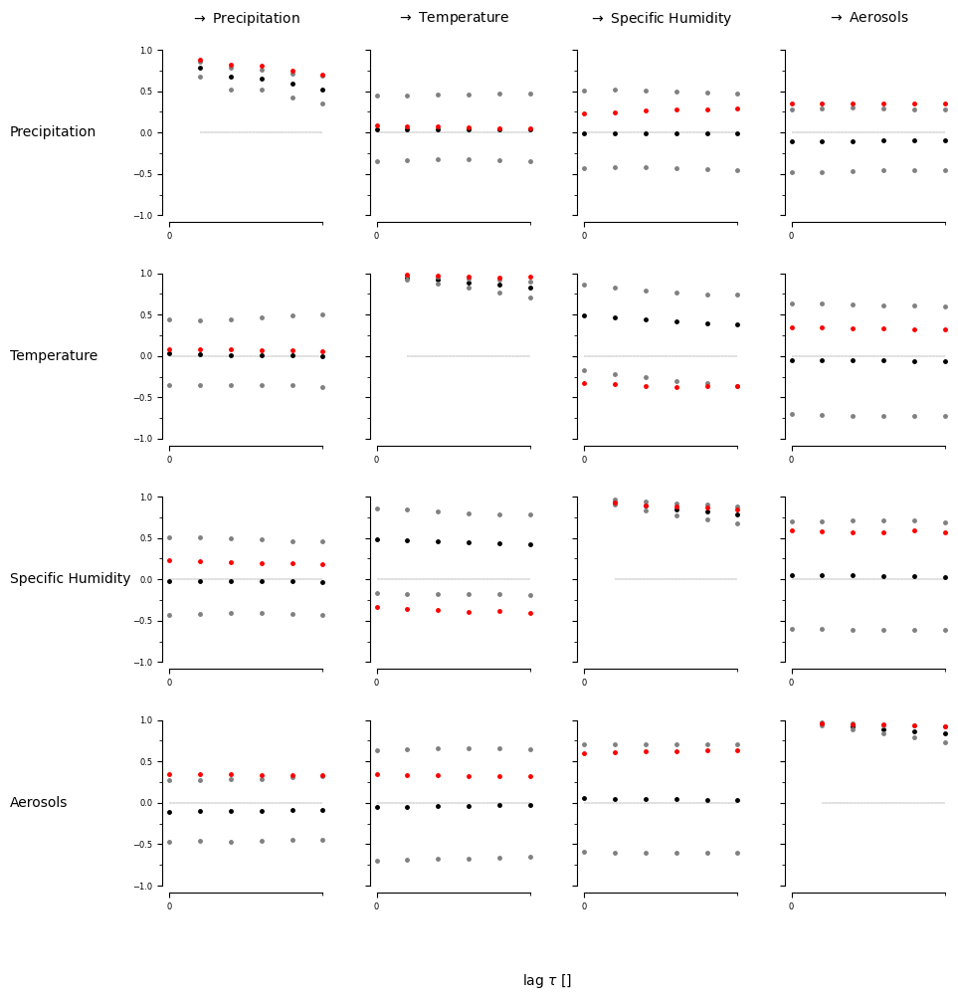

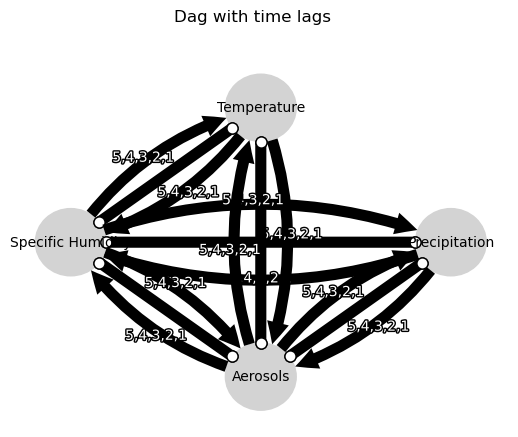

Negative precipitation values: 0


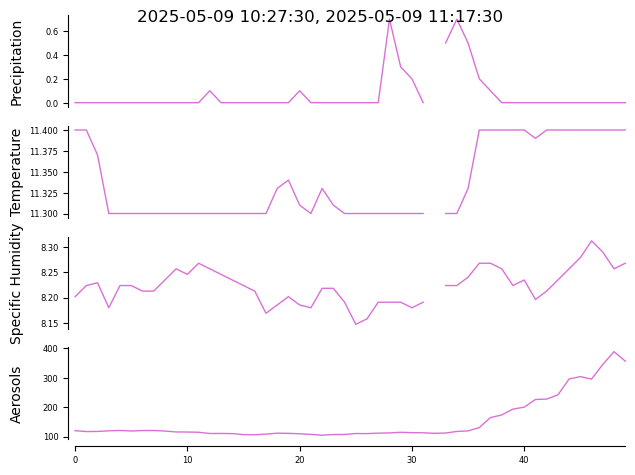

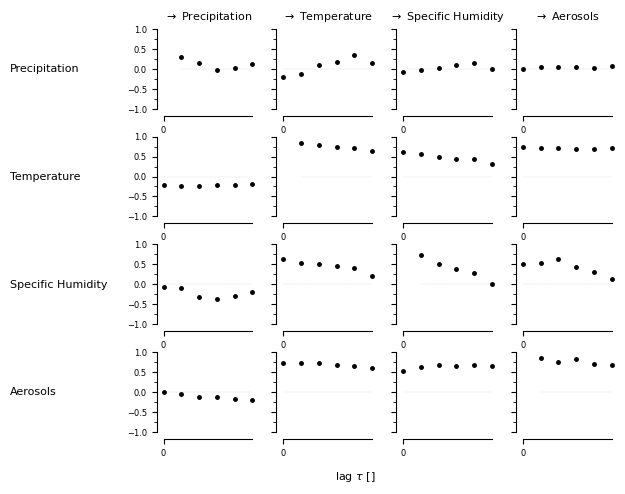

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


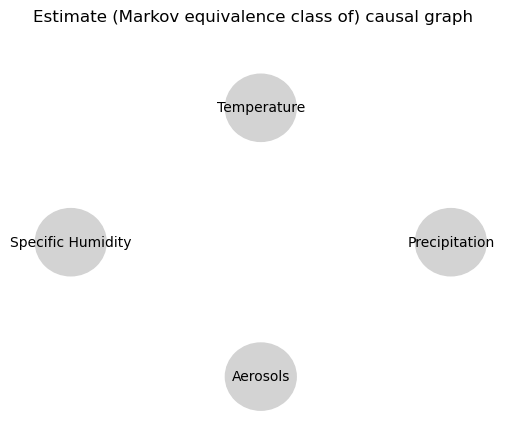

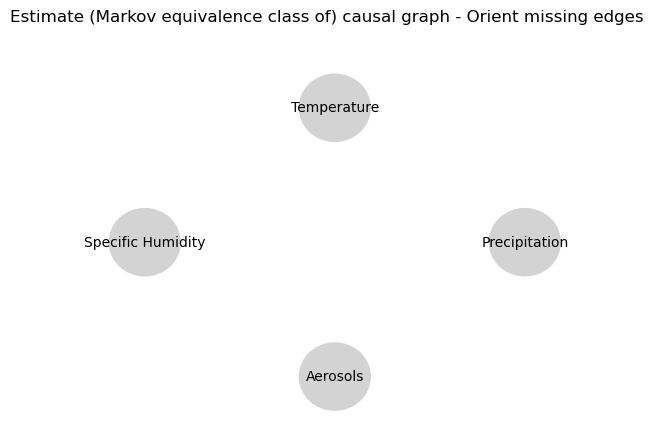

0.0
-0.027351538848518073
-0.06183221100494829
-0.004981072916808349
-0.03492528630109097
-0.027125659538817837
0.03764745392305168
0.03576314823079989
0.016717119778722214
0.03543506181649612
-0.011181993628964779
0.00896982310648108
0.038554992157159254
0.027328996917036982
-0.011611647625289948
-0.004274647716411638
-0.006271930013275258
-0.02702483967365489
-0.007932286175475148
-0.008337691894883915
0.024491538686953262
0.0008791175615910327
-0.01963085235244956
0.007001006786797111
0.03764745392305168
-0.05054087162921794
-0.03897352808083177
-0.0315494210987562
-0.02065167392111614
-0.02465833844936141
0.0
0.7201757034682504
0.5677096171157843
0.46787021480205515
0.37537136119804015
0.2897073565248093
0.31969001686606197
0.22320224909198236
0.14748334898486068
0.09373760589517616
0.052697404402427296
0.014744393520253463
-0.086598921577888
-0.10001591332813078
-0.10336611918705824
-0.09188172351811218
-0.0839937331489904
-0.08467528050488474
0.31969001686606197
0.279900323926563

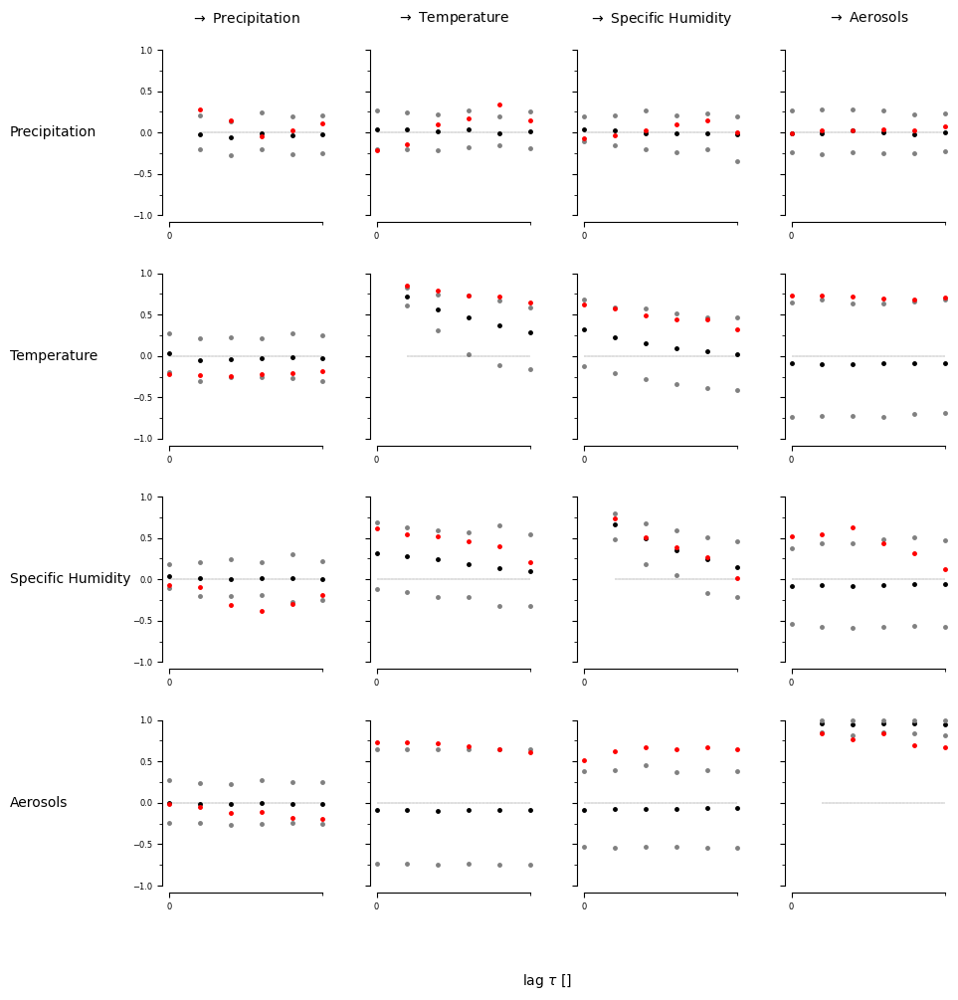

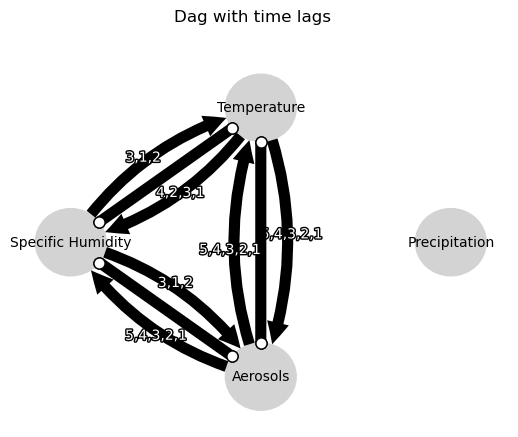

Negative precipitation values: 0


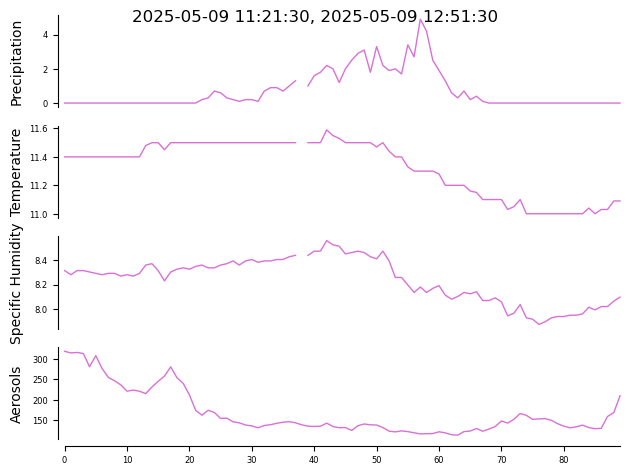

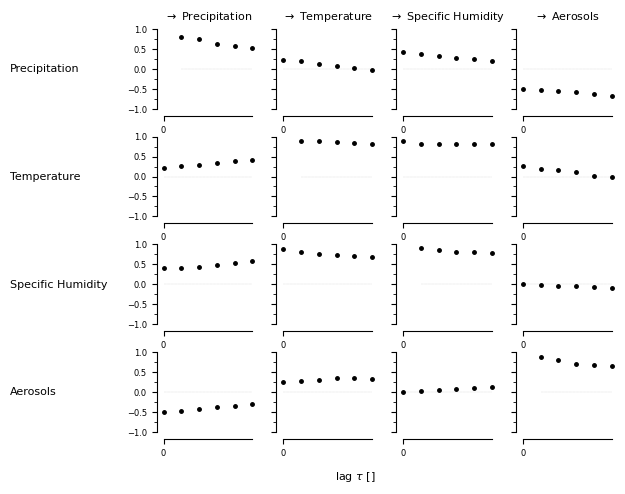

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


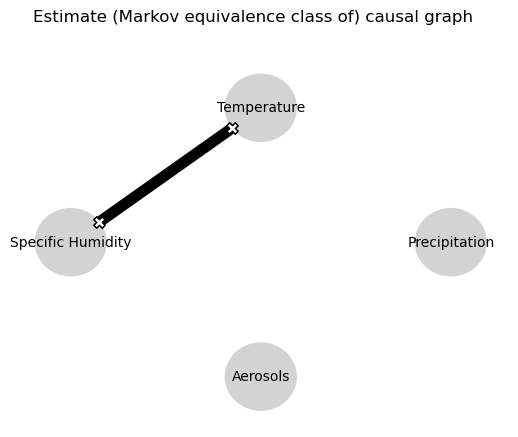

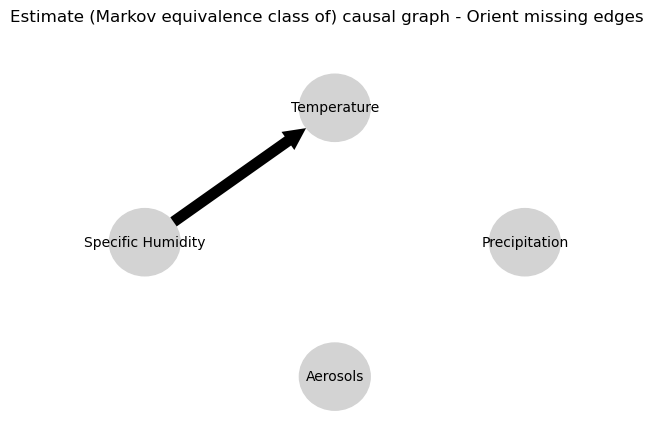

0.0
0.762454150958609
0.6203639887580241
0.5196264817426385
0.42947002729299105
0.35540340031602385
-0.06115604918986849
-0.03273125233333687
-0.008991646938814166
-0.0009686926404375607
0.0064098443877519925
0.007111627525954019
-0.011287154036934898
-0.0026556589685964123
0.00484984705171067
-0.00027224211132959025
-0.0025744163645522126
-0.01275940911926967
-0.02919473351295644
-0.0367215406512654
-0.05296956895138536
-0.06388508187044034
-0.06995931560268165
-0.0750010177236674
-0.06115604918986849
-0.06021090430289092
-0.06415768008034439
-0.06387871954354503
-0.06596283526231789
-0.0672280808766967
0.0
0.867694411091101
0.7936127237387859
0.727162995497731
0.6599429670502804
0.5970928594621837
0.8828853721401322
0.7657700545999256
0.6800363264875319
0.6039798303448172
0.5394650652581954
0.48102698378716435
0.11819959643447264
0.10003718915748135
0.0905124093296872
0.08172480839296208
0.06997644600265258
0.06369523566560406
0.8828853721401322
0.8427258535194474
0.8070485518688386


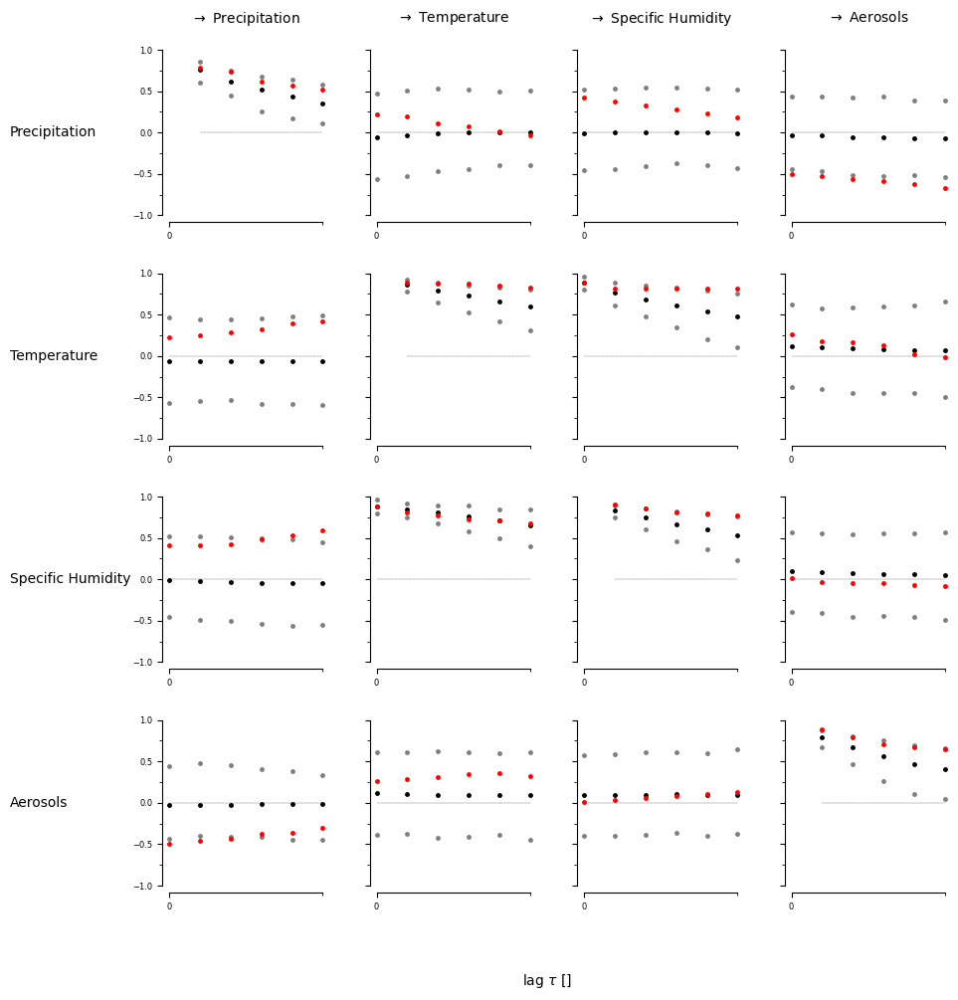

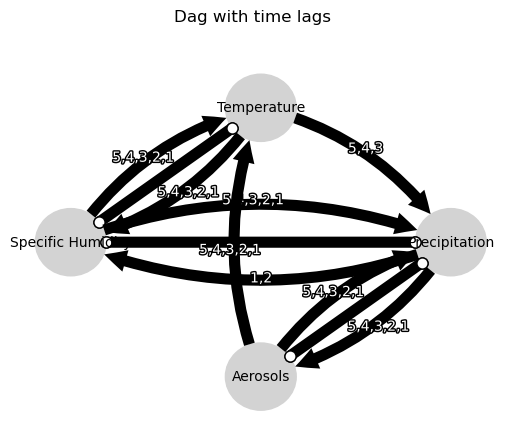

Negative precipitation values: 0


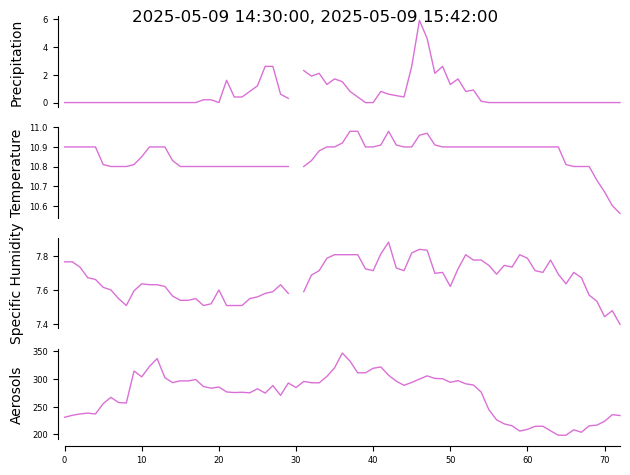

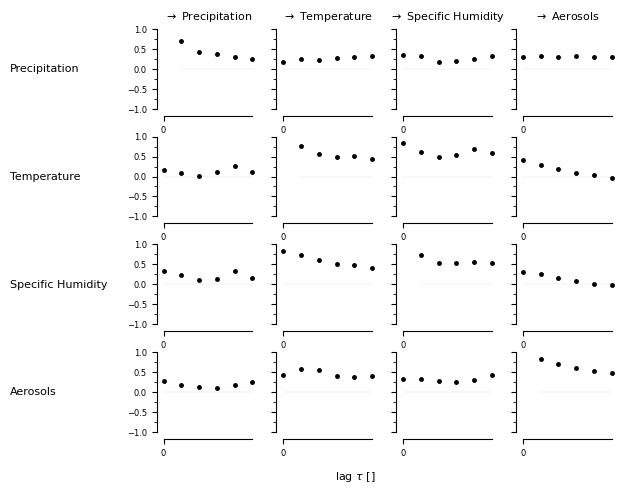

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


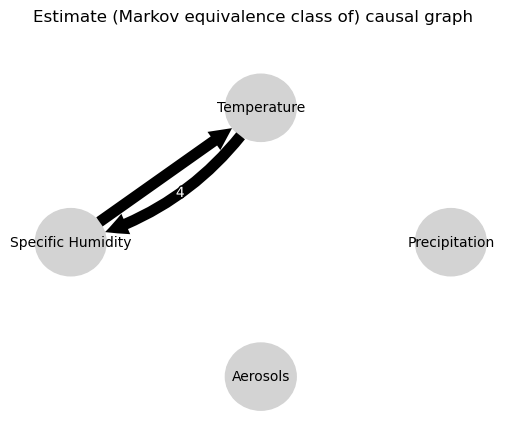

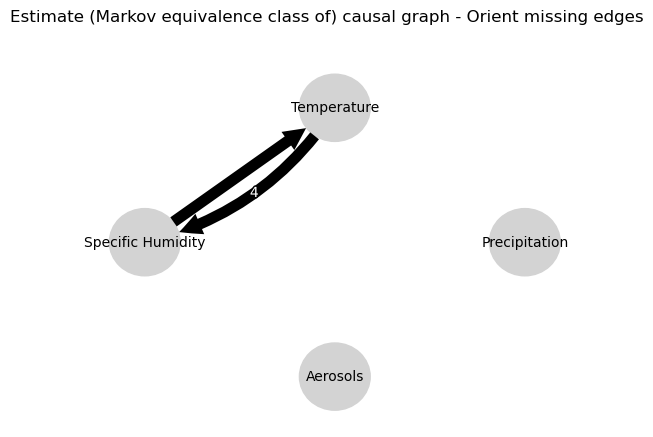

0.0
0.6305050355367551
0.43392694415029015
0.3016155994661316
0.1871092006050248
0.10539401086330474
0.05026010455024945
0.002980664471806289
-0.017925411645734766
-0.010223503276243844
-0.003122978540861811
0.01633597634377561
-0.01962211647397267
-0.0734176723273356
-0.052971760743470604
-0.01561399415376134
0.007457442561160106
0.015172279887997988
0.13002570442972916
0.10702963208879422
0.1176411868919229
0.11294265851701865
0.1117111872610606
0.1012857640273424
0.05026010455024945
-0.004072209046159259
-0.01749653049104595
-0.029476453277986887
-0.06810836320096159
-0.0795802180191763
0.0
0.668205102113575
0.516123185047421
0.44670227369565085
0.49900497029207
0.4686937317680093
0.6407609468014188
0.26439071952844007
0.2895548716009974
0.3906470658811628
0.5484391683988284
0.40318951470674763
0.001738255999179118
0.009274338895525584
0.022318735160804834
0.009625198969042816
0.02180118324642344
0.04128175020839592
0.6407609468014188
0.4856772953657719
0.3858731205062792
0.28762038

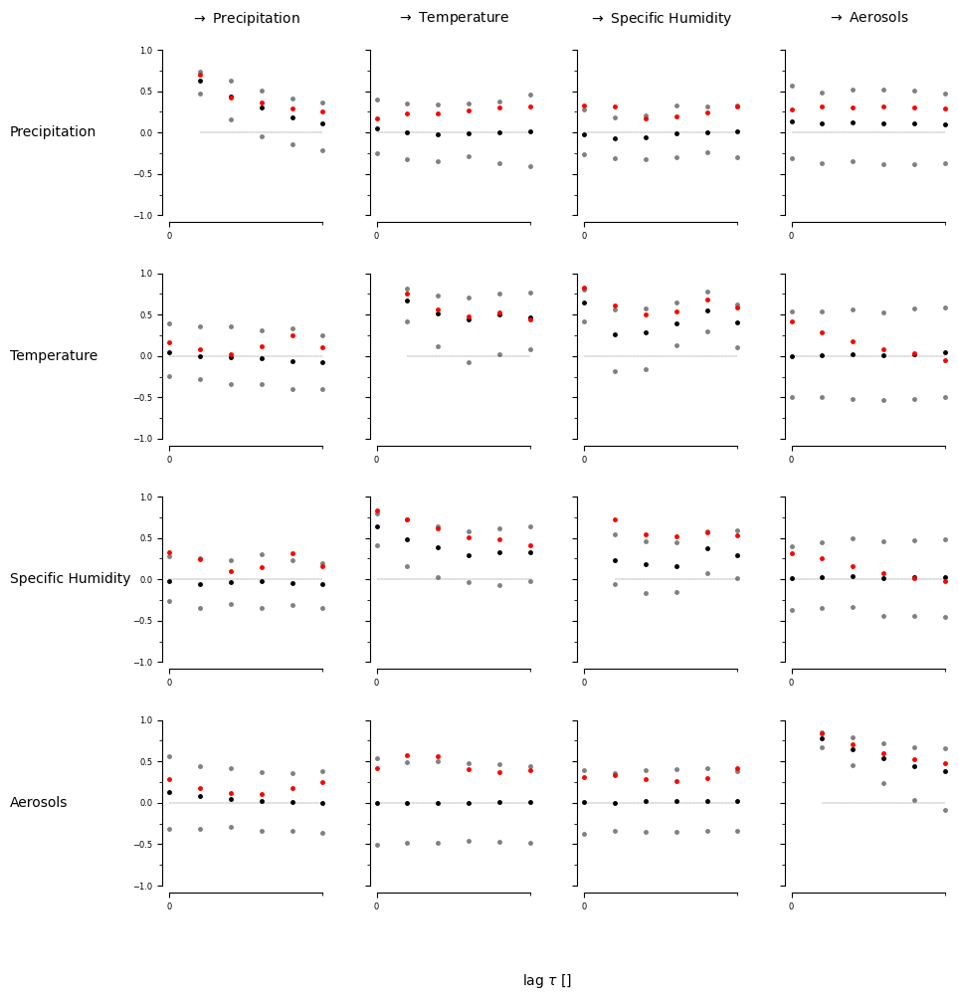

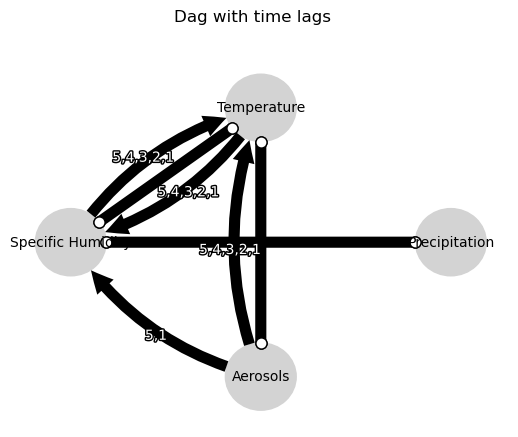

Negative precipitation values: 0


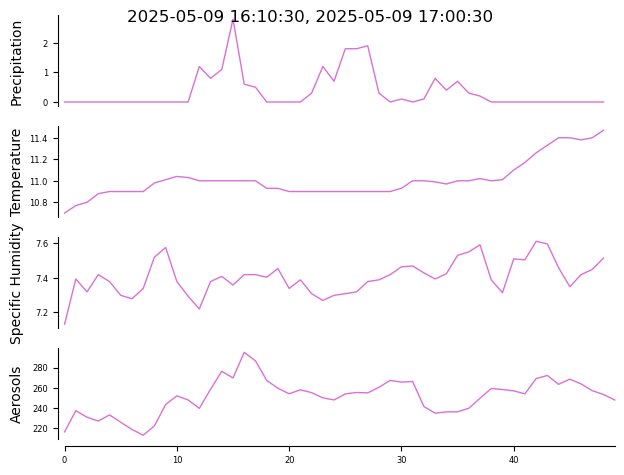

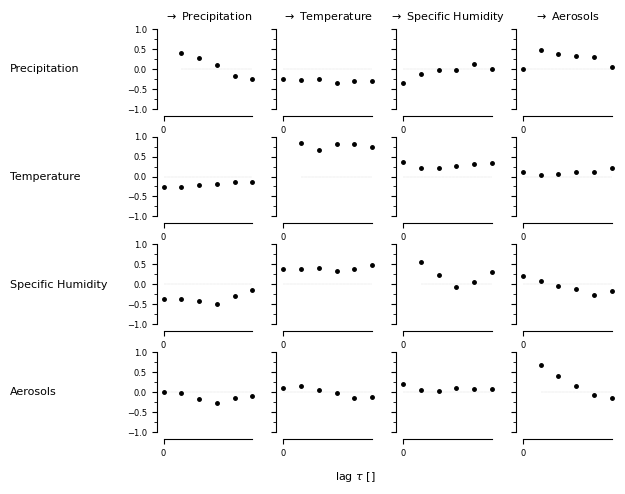

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


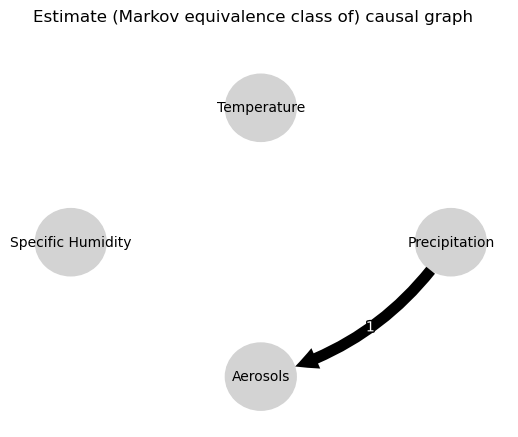

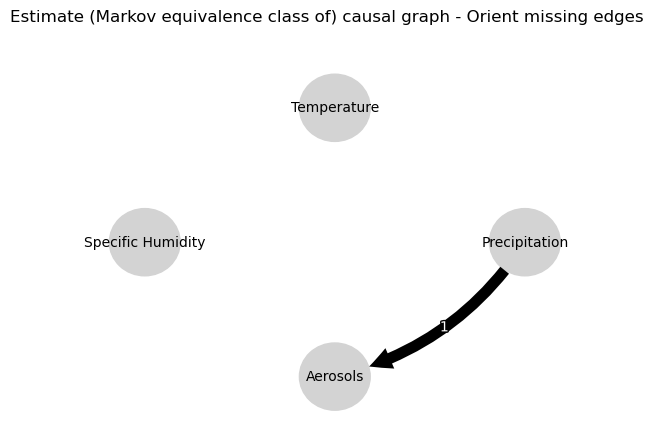

0.0
-0.036879271177658
-0.06801848169274692
-0.009472794341328455
-0.03044116259755818
-0.012950073266441067
-0.02364488397691497
-0.025084996712442464
-0.008082641514048644
-0.009646851323972335
0.006094256120242355
-0.010608301607970128
-0.10067184413954157
-0.06383253001531379
0.017239740099976694
-0.021614637943840696
0.0218958398911212
0.03127262214997742
-0.14791382493618568
0.17575265301171253
0.1447764238983461
0.08183933320636527
0.06273878615893475
0.037444971535194924
-0.02364488397691497
0.0001133717986062463
0.014723131008529303
-0.00425279341313046
-0.009271032011731623
0.0050663309911613726
0.0
0.930823793393948
0.9184520325310698
0.9002620618018687
0.8762510533778294
0.8705254981923781
0.05226107800203108
0.003184425230698662
-0.01970814307026499
-0.011521512404621428
-0.019640810854857624
-0.017789979309621017
0.002255830723759444
-0.027331591728463084
-0.030013903793432925
-0.02370838765280752
-0.02623326903405741
-0.023856329246834028
0.05226107800203108
0.0400084323

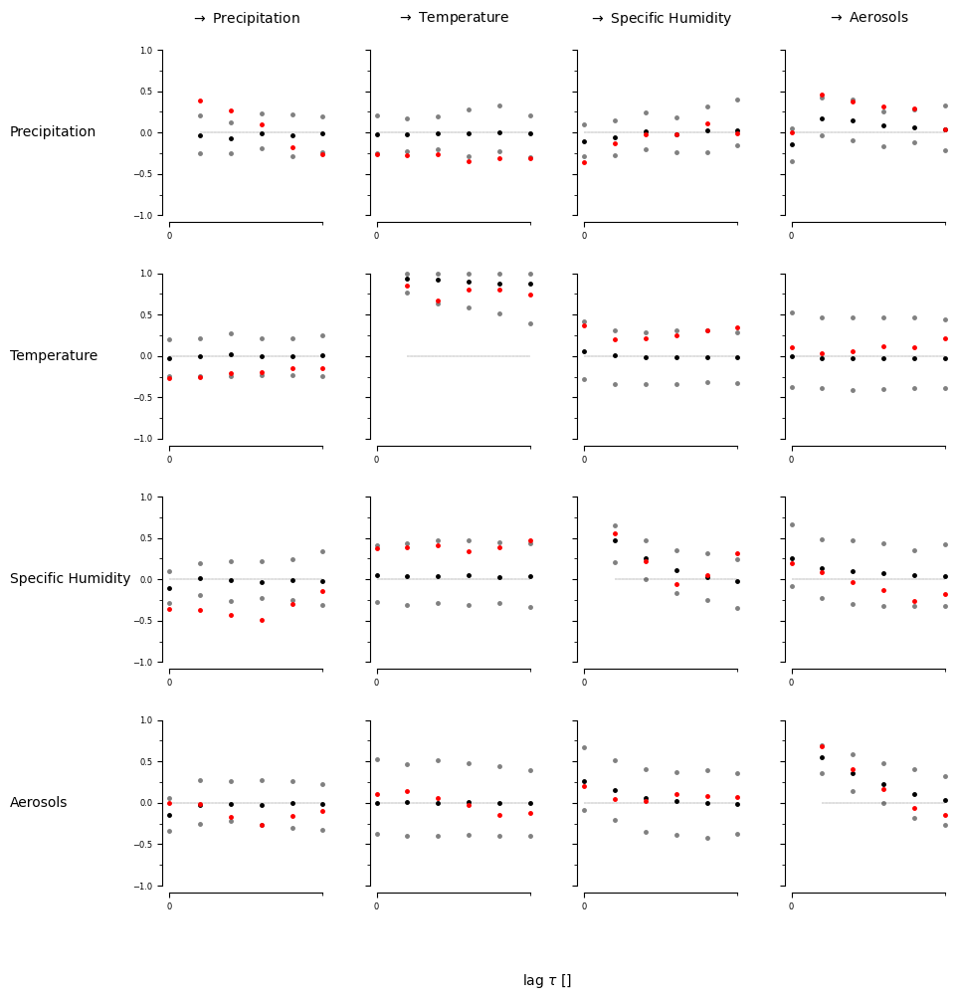

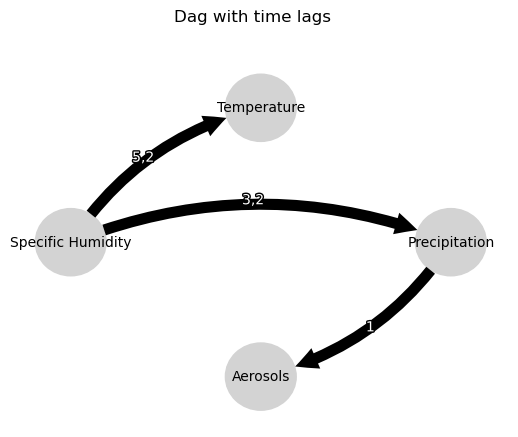

Negative precipitation values: 0


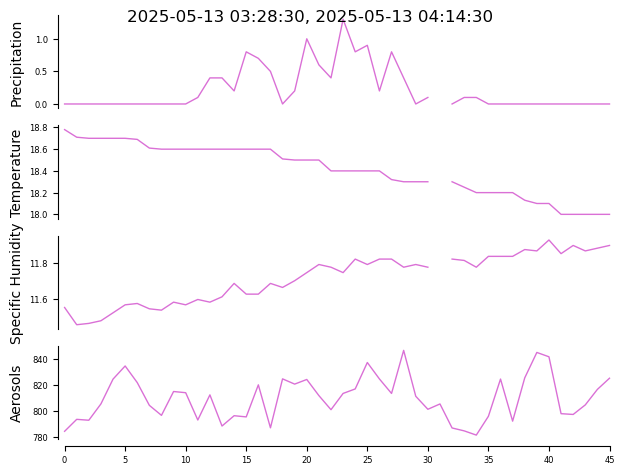

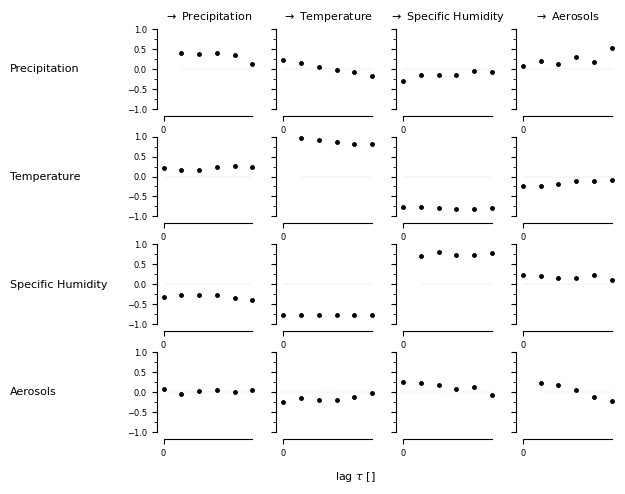

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


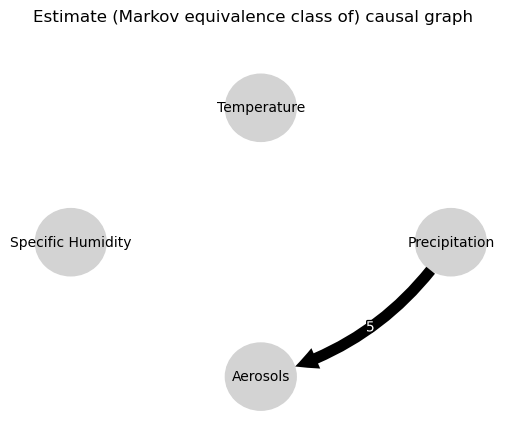

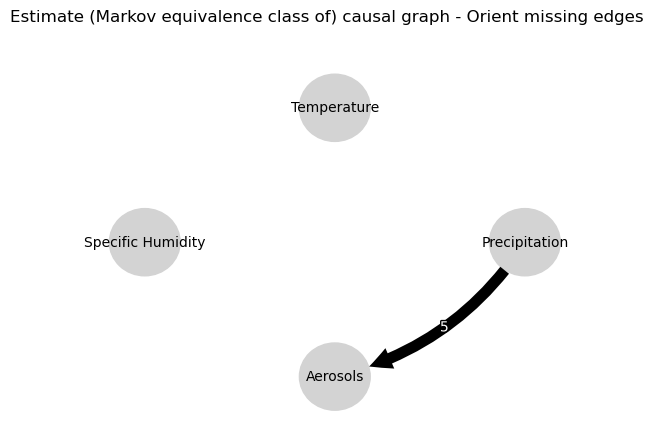

0.0
-0.026134400776397816
-0.048676311076158905
-0.014811092715800882
-0.03764406506231106
-0.02483747711550434
0.005169471345026838
0.02077337969843715
0.03889973674003806
0.017469839612543395
-0.0272379076356866
-0.01297928825690221
-0.004032065994333413
0.010741697308645291
-0.028396883140113863
-0.008733500675880435
-0.0390650090609841
-0.012583591133649707
-0.011950090360225487
-0.022063588717075554
0.04587198411167357
0.01811451411328126
-0.002443320911479024
0.20670906395833288
0.005169471345026838
-0.053887748861145675
-0.03737814352712434
-0.015841487083482444
-0.03754563199791533
-0.05096527521870798
0.0
0.7403390029165583
0.6338001904939651
0.555178041620095
0.4754303913431268
0.4113492436654599
-0.015089870956552462
0.025613712431944394
0.02884028485188739
0.029030084335328103
0.0309730797077596
0.030398906232503475
0.03183493396586274
-0.020813112248322364
0.0015387989900252736
-0.003370911199520504
-0.004106528616307304
0.010516874459119672
-0.015089870956552462
-0.018557

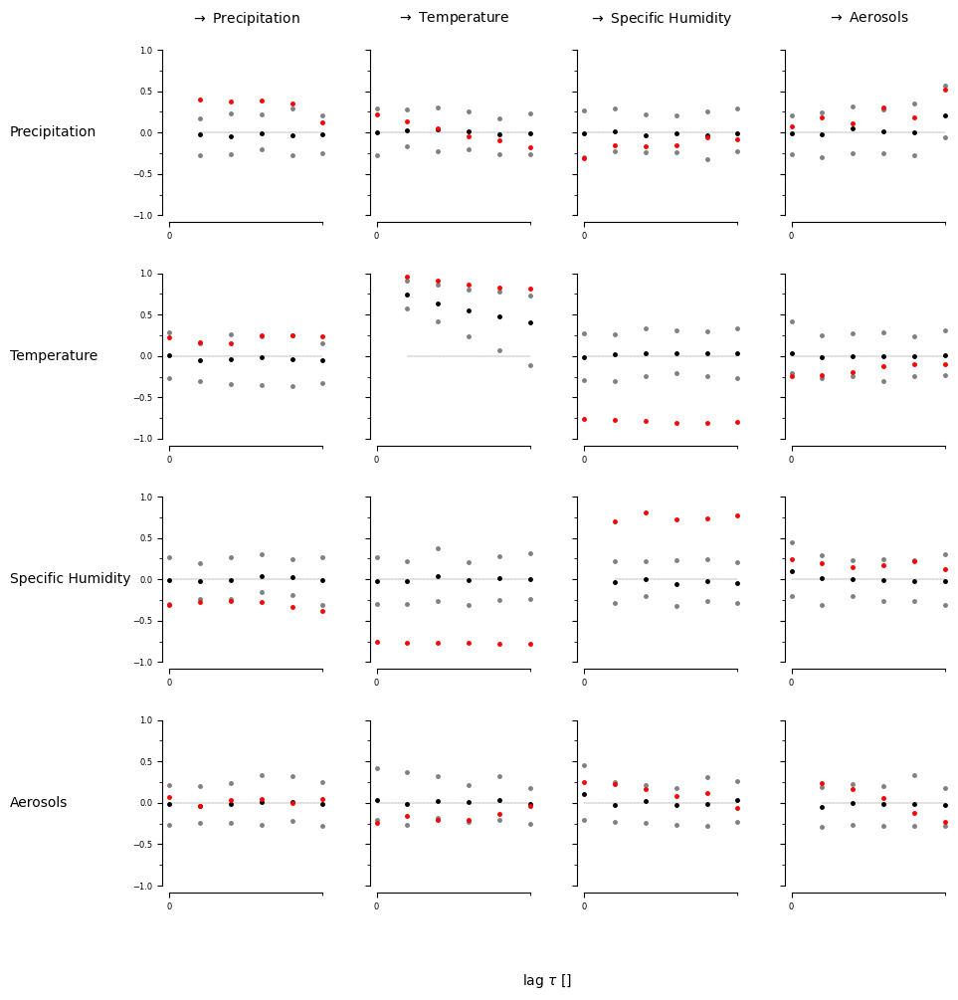

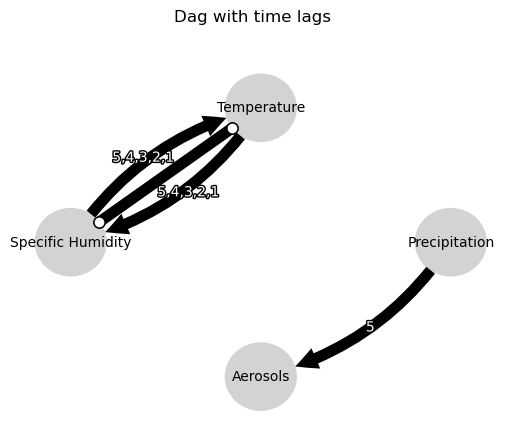

Negative precipitation values: 0


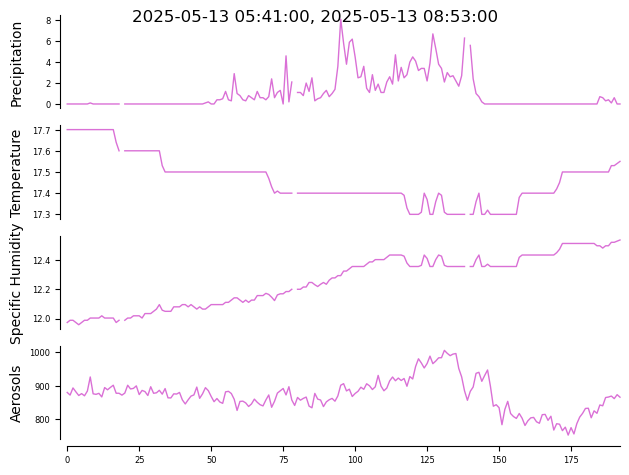

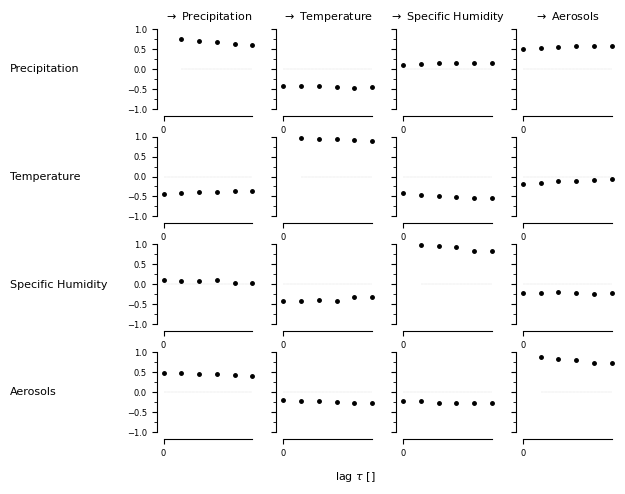

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


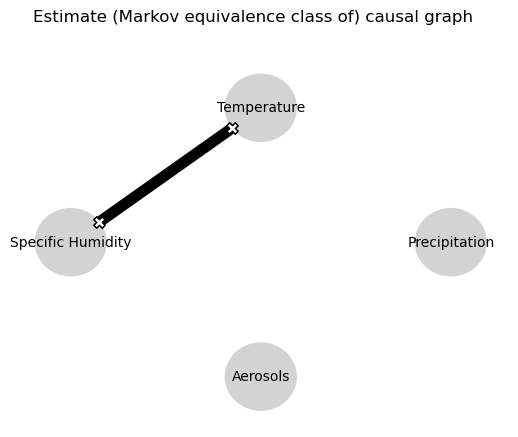

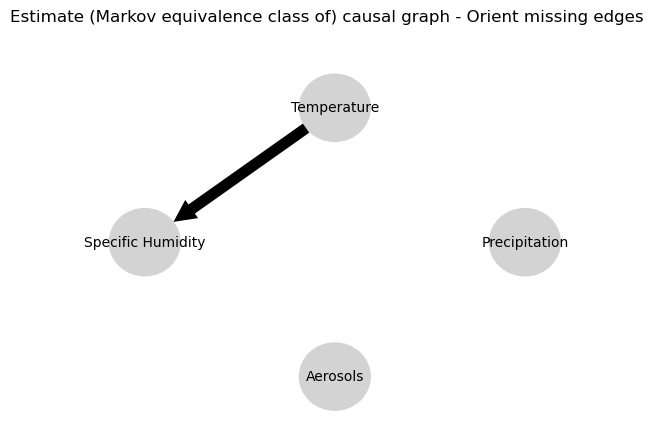

0.0
0.7207789255640548
0.5880824538267732
0.5666795764702419
0.4981125627091894
0.42911783596719055
-0.022178507349694433
-0.01519720281681778
-0.009765694674613436
-0.007683336332369203
-0.007783481635159526
-0.009345952051078733
0.040031503792339135
0.041100269211662016
0.039516742656085055
0.03684061636067696
0.039207407949534236
0.03862904276961152
-0.12246601668453821
-0.11153280688081119
-0.10153894793275164
-0.08857771270614391
-0.07475059691318064
-0.06692555825735648
-0.022178507349694433
-0.015468301410792243
-0.013710546153920413
-0.012805423833621212
-0.0091243204168427
-0.008125084826686842
0.0
0.9080069494221668
0.8433054207854777
0.7835195769467791
0.7308899798627065
0.6801170524709598
0.4215028899206951
0.4062223446611959
0.3934439485871117
0.38310904590958933
0.3765766390350829
0.36812708133215394
0.019299755426430244
0.0172010512729023
0.01716129595729492
0.01875761961787574
0.019181481695202986
0.0165576012612238
0.4215028899206951
0.3609654731864769
0.31063950176060

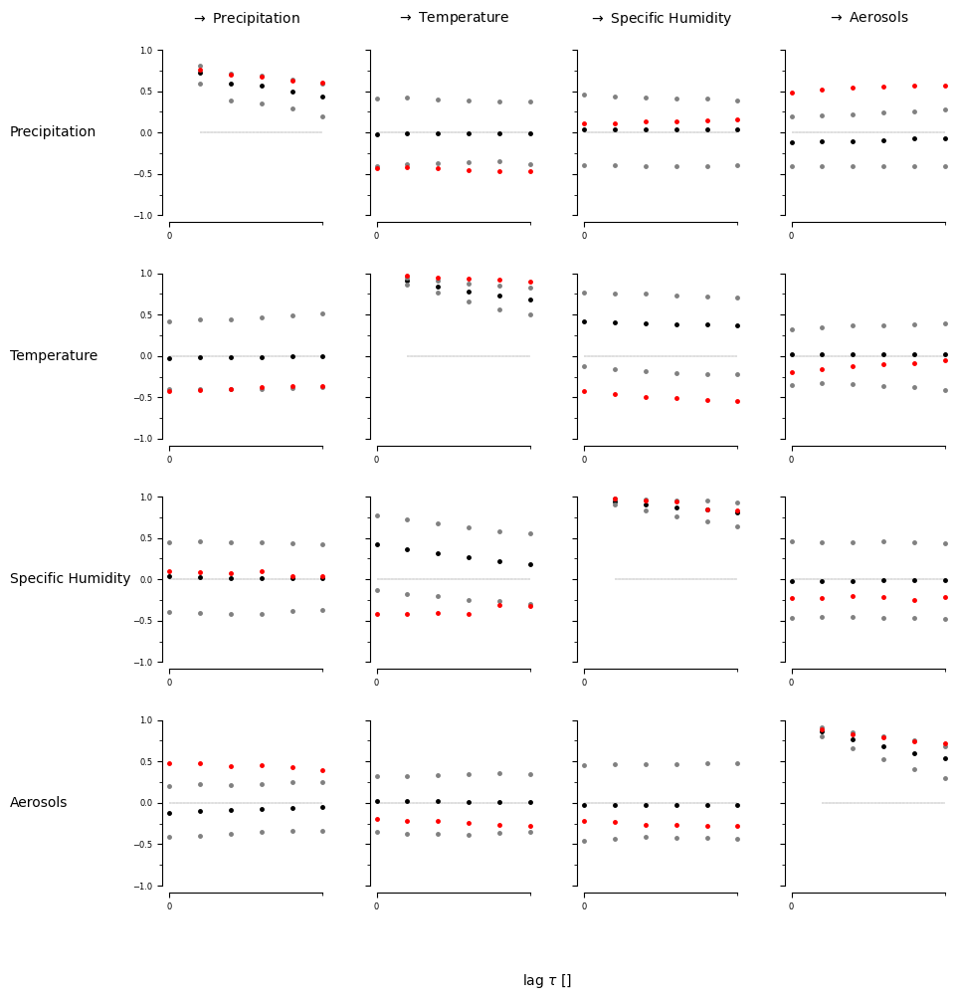

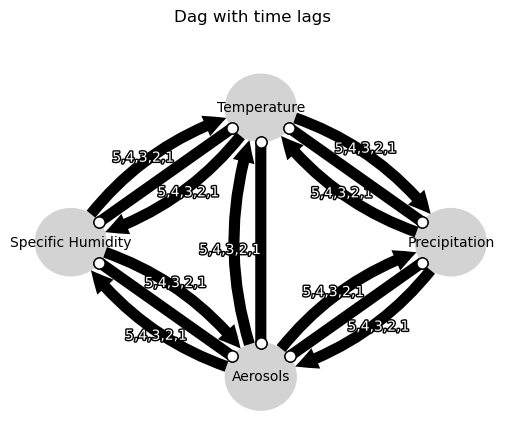

Negative precipitation values: 0


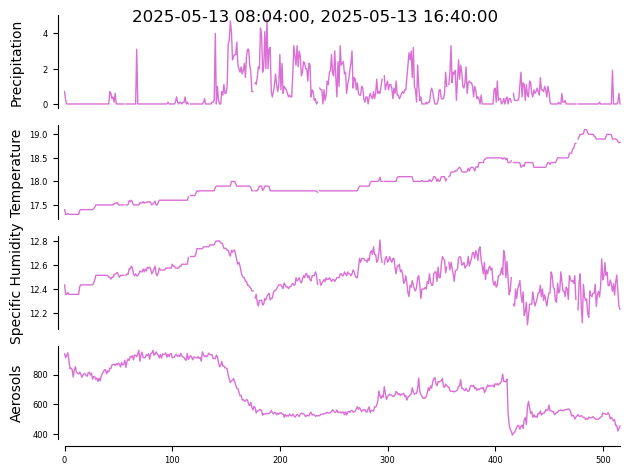

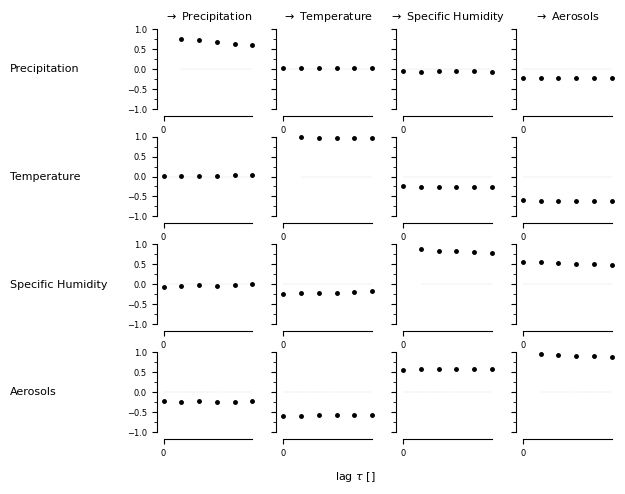

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


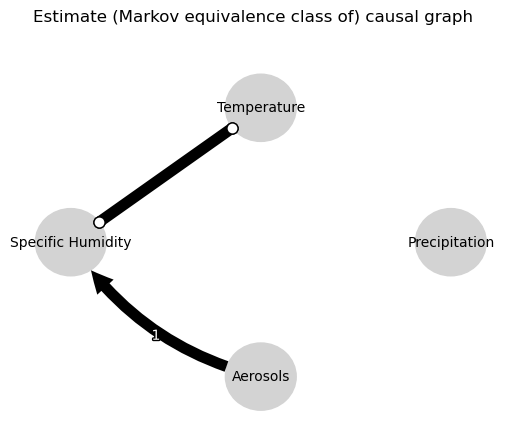

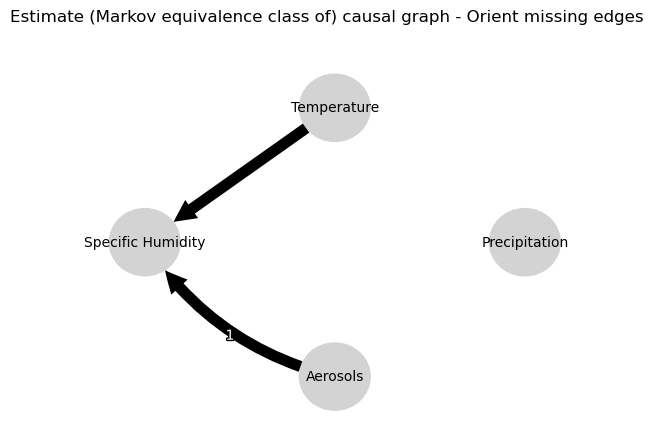

0.0
0.7158193436950618
0.6902245290208924
0.5745966640516648
0.5162115256042127
0.4452958736596299
-0.04643022798235167
-0.04497664460812323
-0.04228980627256971
-0.03953325792026751
-0.037621312427371136
-0.03661933295831955
-0.03194903993252317
-0.027677384179150805
-0.022802475256623437
-0.019236147765679803
-0.01997336630238641
-0.01795073108812505
-0.01836724442341191
-0.017757540540769376
-0.015223087002756016
-0.01461306912489855
-0.011286760030142461
-0.010531185322568401
-0.04643022798235167
-0.040631003867251624
-0.03897473663874522
-0.03540549677739303
-0.032865173602984174
-0.029237720369982335
0.0
0.9707077414055216
0.9485346182482153
0.9286146317312628
0.9108160097795469
0.8936381677716426
0.1968458232791278
0.16422970847412677
0.14467617818197165
0.13465910943724851
0.11913395070154141
0.10425847574761134
0.04101032193997423
0.03913558366988085
0.03732605946784048
0.03654468538394785
0.03598300610500024
0.035114788892860765
0.1968458232791278
0.19324726304810633
0.189341

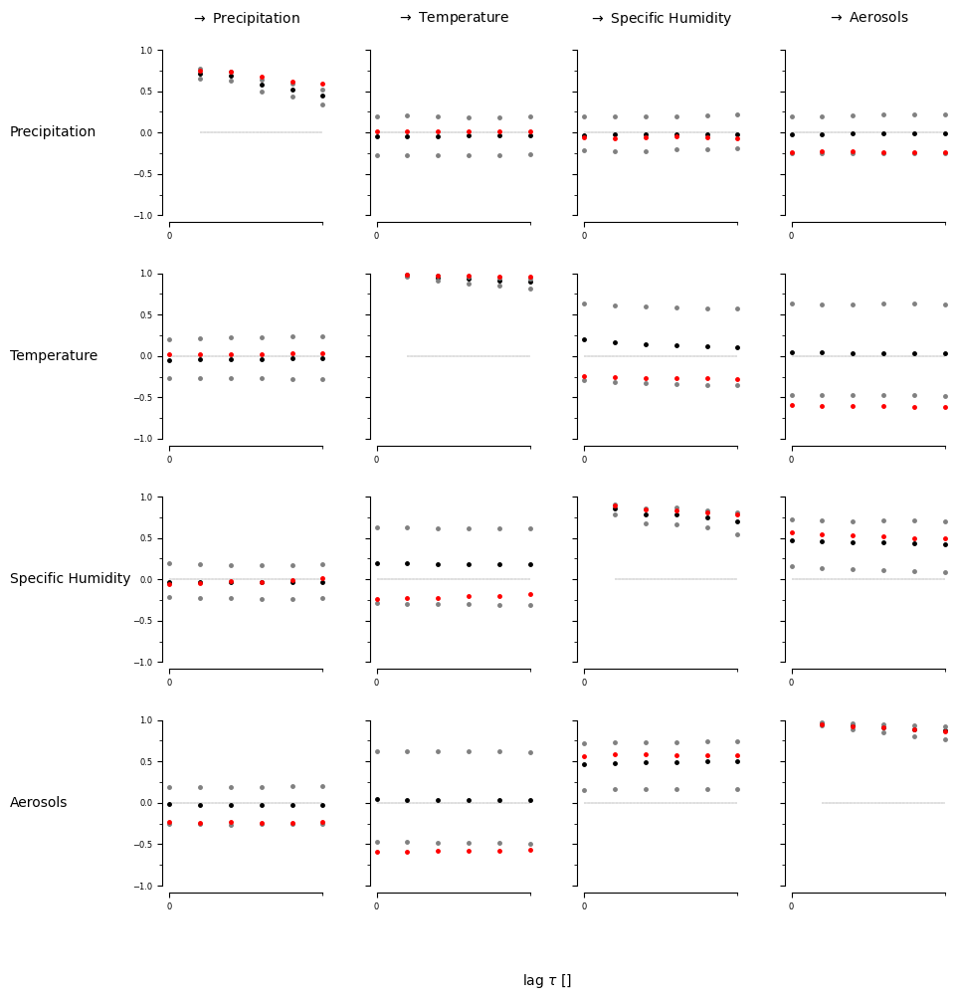

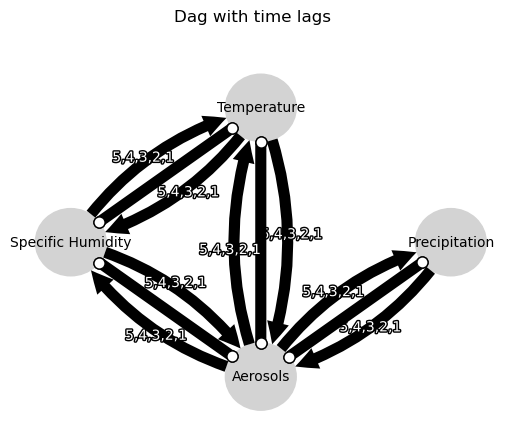

Negative precipitation values: 0


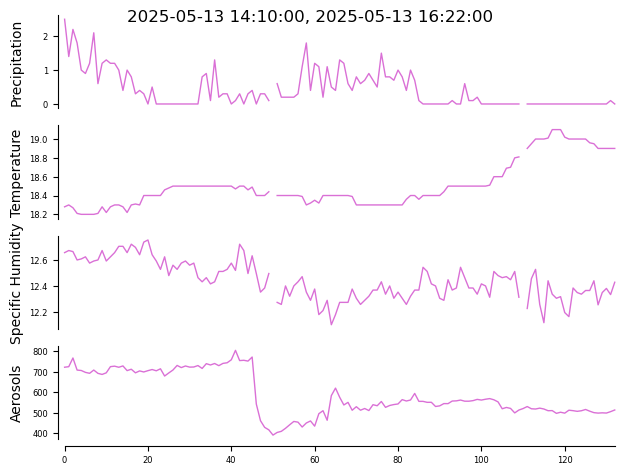

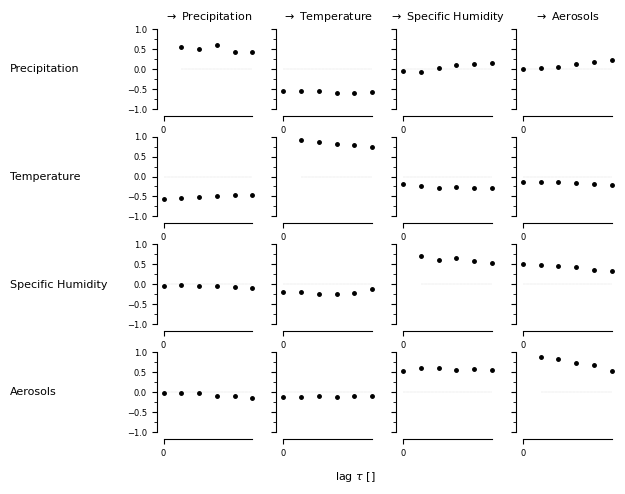

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


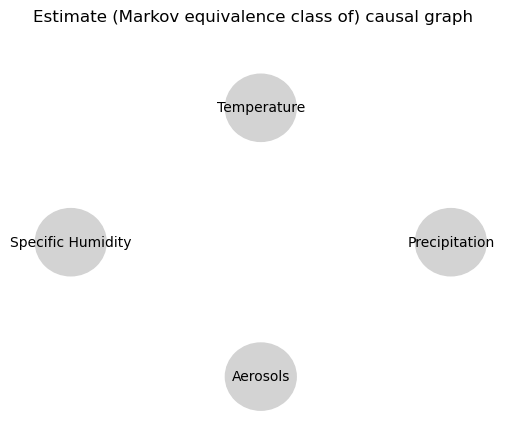

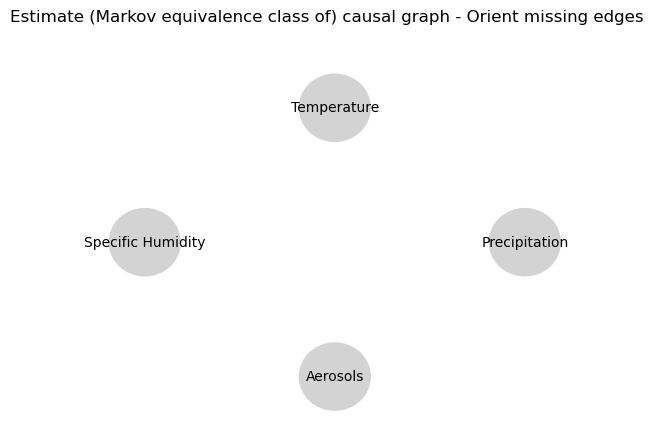

0.0
0.40997449278306675
0.2794811360947652
0.4957349006737533
0.3233338811277358
0.21505431253116927
-0.10507907858895203
-0.09938218048874042
-0.0949132782010832
-0.10253186387093852
-0.09117242774524588
-0.09269472427419545
0.0013023362059009014
0.01827590970986068
0.017006681806204703
0.006713451158848102
0.018182318512407522
0.003105787458978282
-0.03269020082701237
-0.03341922962648866
-0.02975062718210615
-0.026610459703549392
-0.012360109762738878
-0.010113363738938501
-0.10507907858895203
-0.057561761222582344
-0.051840855901734664
-0.05799872258930563
-0.034848356548459386
-0.03587214264955967
0.0
0.8891195639917581
0.8149615717899377
0.7504487758487923
0.6914939670023105
0.6424701716233215
0.19235019403183695
0.10658123852027696
0.0383859146920015
-0.0017662621738593232
-0.03509887184414275
-0.05827534924863982
0.07404484672013206
0.06901559978568525
0.060475389468454696
0.05085694984547327
0.041925049438897195
0.03254788235664697
0.19235019403183695
0.18015408535389388
0.166

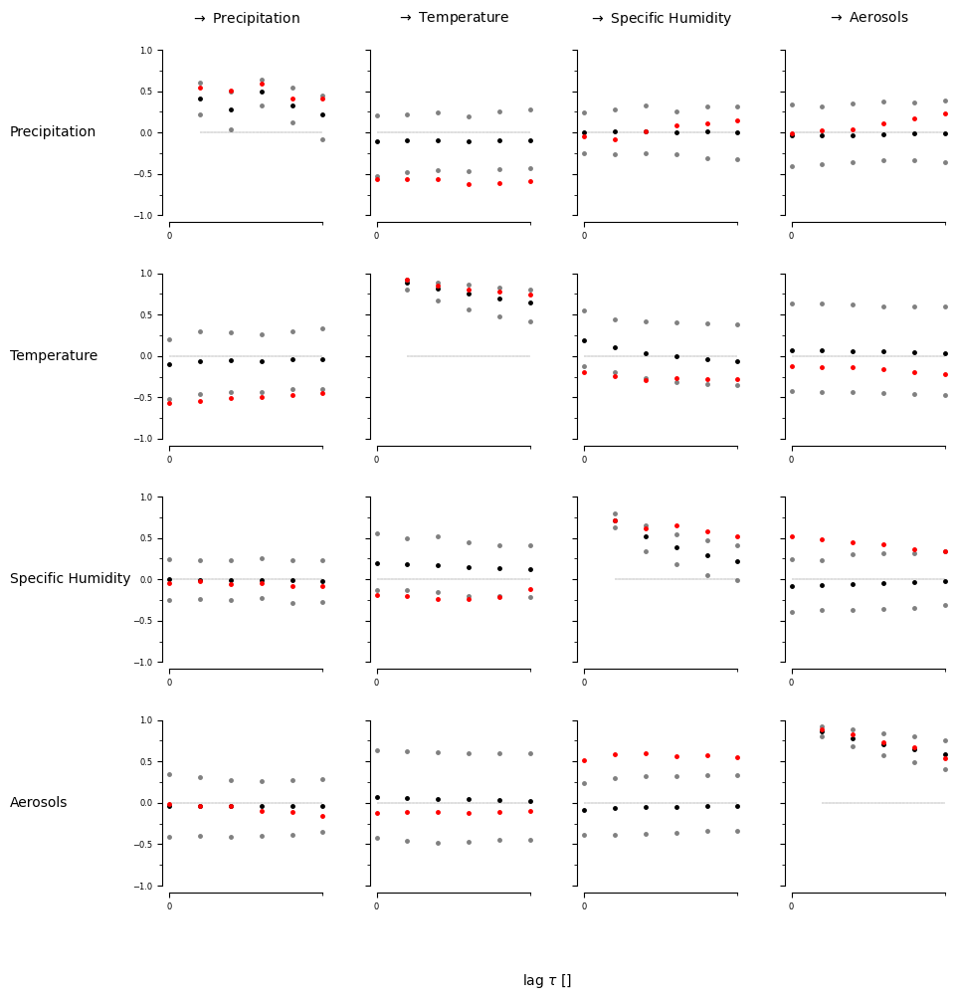

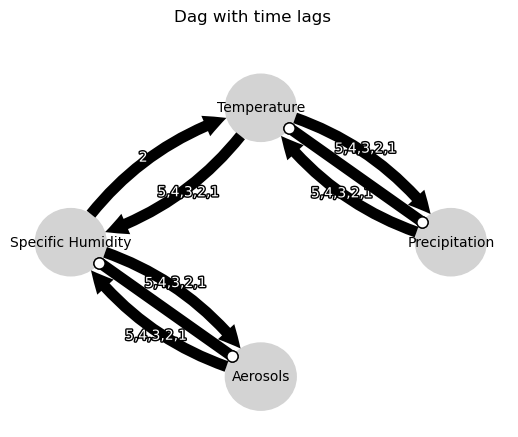

Negative precipitation values: 0


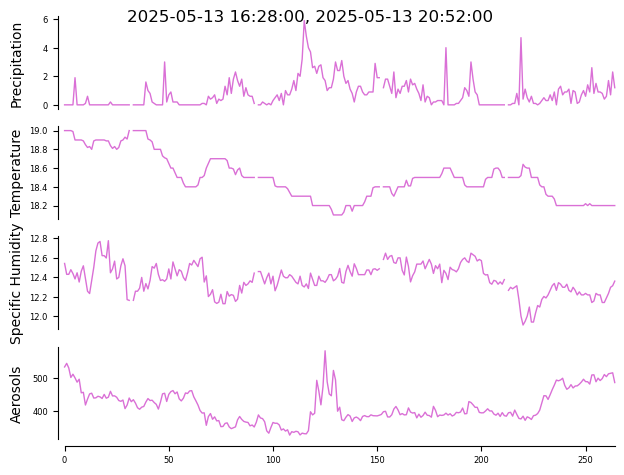

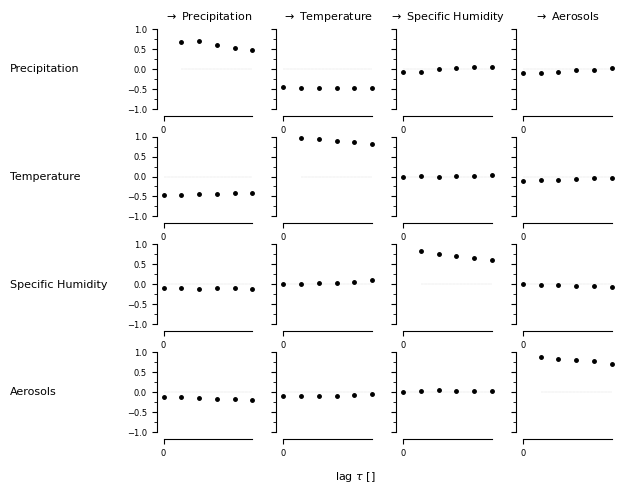

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


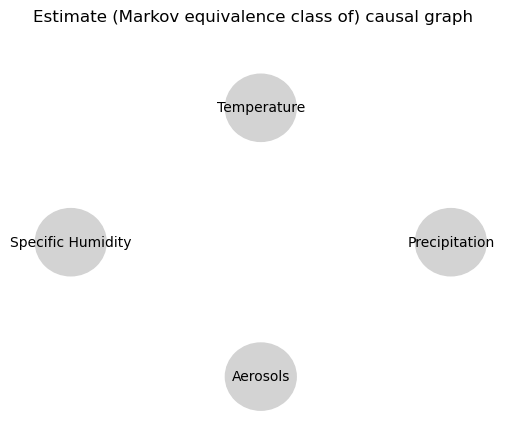

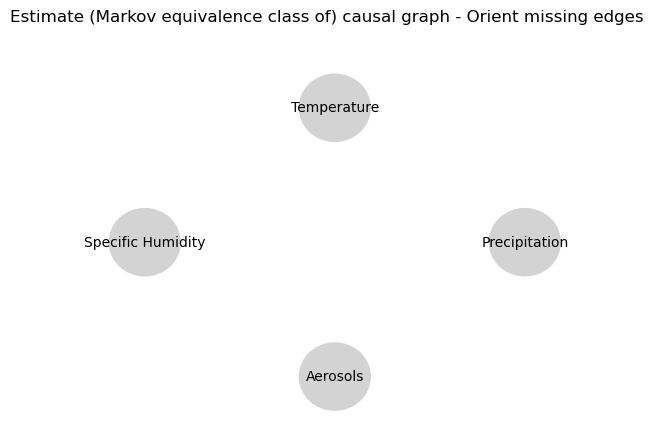

0.0
0.576267969092128
0.57818842540739
0.4267045071382477
0.3761553084228261
0.29370327003757746
-0.05321751597631791
-0.04764572339554204
-0.040742949929489854
-0.037575514579627045
-0.0384963377994543
-0.03507775872335535
-0.1387450835215296
-0.11679594511427972
-0.09493486222260725
-0.08139833000126066
-0.07048029492248514
-0.06358470847595284
0.014882304240481812
0.017651943789503566
0.012109327658039171
0.01389879255208936
0.007458305331928022
0.005057316280036408
-0.05321751597631791
-0.03143537284481841
-0.02572894052513916
-0.014987144104922214
-0.013145796606085218
-0.0028316077861049093
0.0
0.9345496861117908
0.889455042878534
0.8463602508991289
0.8082685075856708
0.7724050813638611
0.12290365200699274
0.0930673783519258
0.06795483859583225
0.045427985245282416
0.02623865200479528
0.01142174457987022
-0.04279978289037059
-0.03541609935533683
-0.0304065977087733
-0.02745574309410846
-0.022040220225922506
-0.021389041906492722
0.12290365200699274
0.11388639787942098
0.106208302

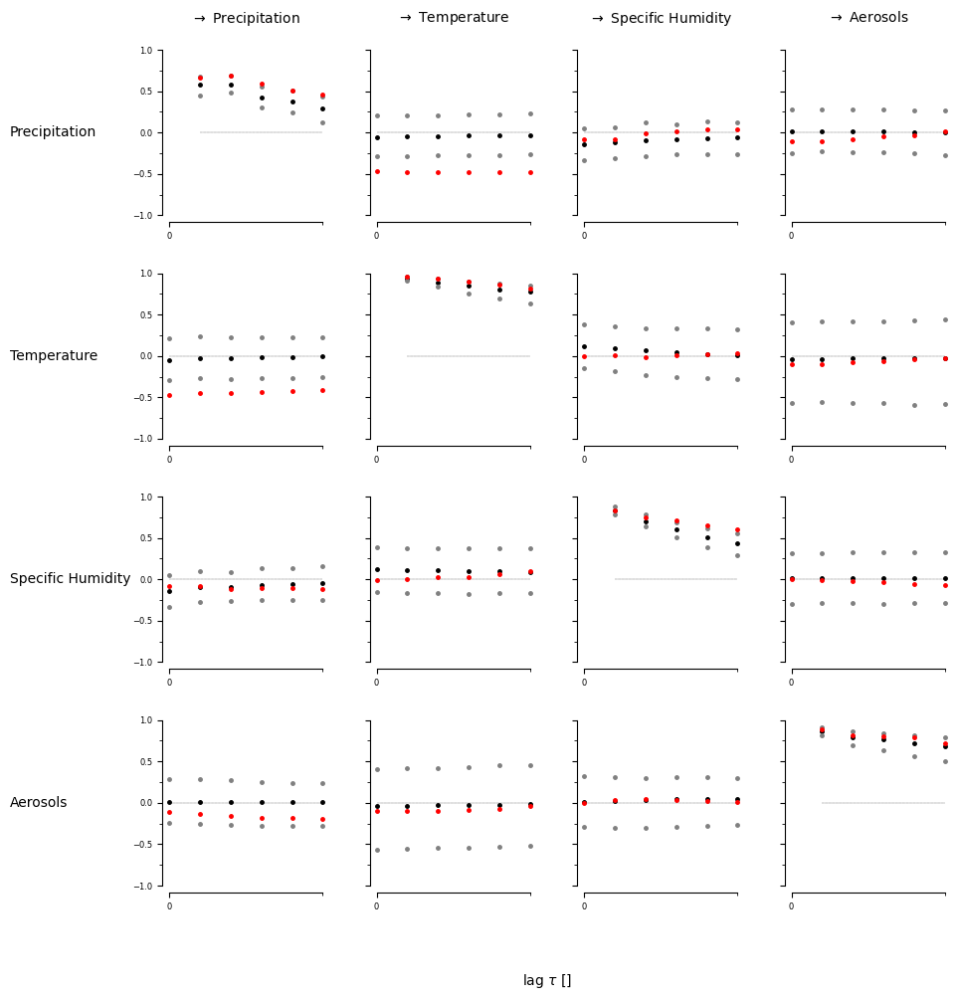

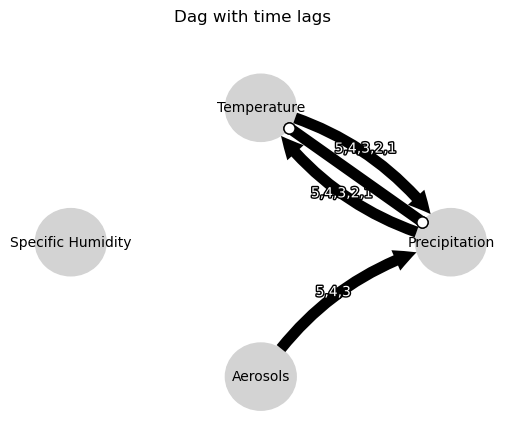

Negative precipitation values: 0


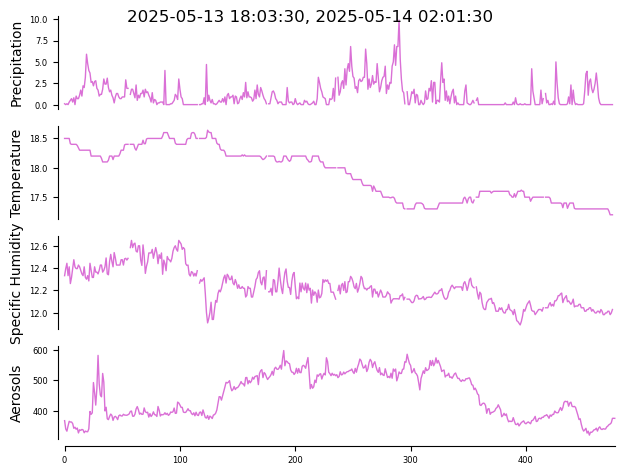

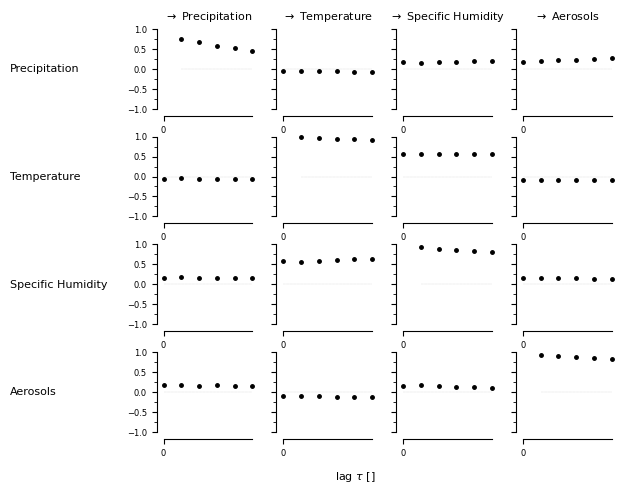

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


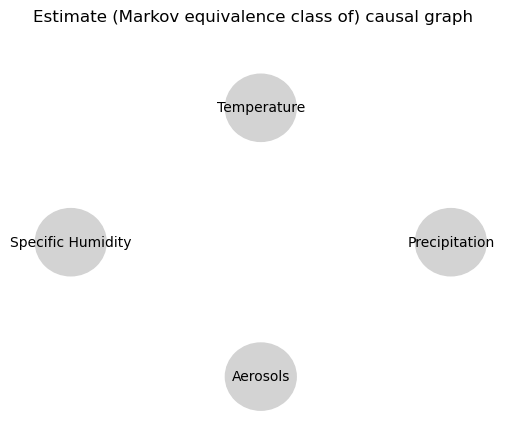

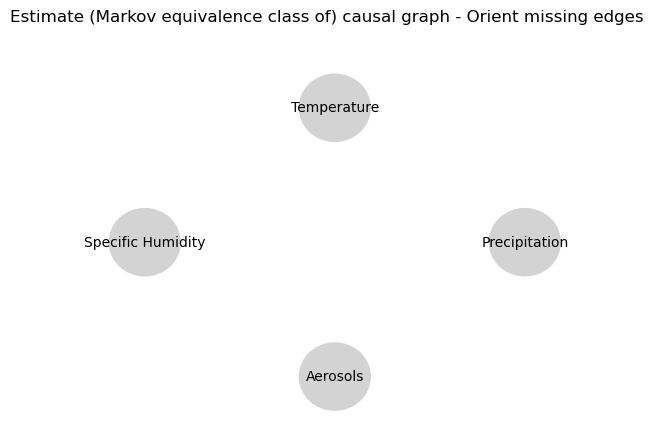

0.0
0.7107432992229314
0.6319043985164129
0.5184206783969791
0.4381157264925218
0.36085287095273144
0.001061417929388585
0.0020042705933374775
0.003844561810445052
0.005962225396945031
0.006999542810942851
0.007933866031602848
0.002159446659041485
0.005608079294492976
0.009991958411572015
0.012981427330839323
0.011776639437481333
0.014877350005877542
-0.02519561943379208
-0.024114068941380955
-0.020174046080095938
-0.01827233061402076
-0.012573983469694168
-0.011663882867333285
0.001061417929388585
0.006015669111433506
0.0059941016590486715
0.008147104850011506
0.009459327169917623
0.009662325575425108
0.0
0.9680470694493647
0.9457683563402225
0.9257807748715087
0.9068399538569837
0.8883696251420129
0.21980613194883397
0.20513492660328073
0.19410014540344658
0.1870858227467831
0.18136208284371147
0.1742992952704977
-0.03166964673344107
-0.030516960485152445
-0.03043861932649613
-0.02954189440008838
-0.029041741569643408
-0.0291794671702962
0.21980613194883397
0.21515349047857485
0.2121

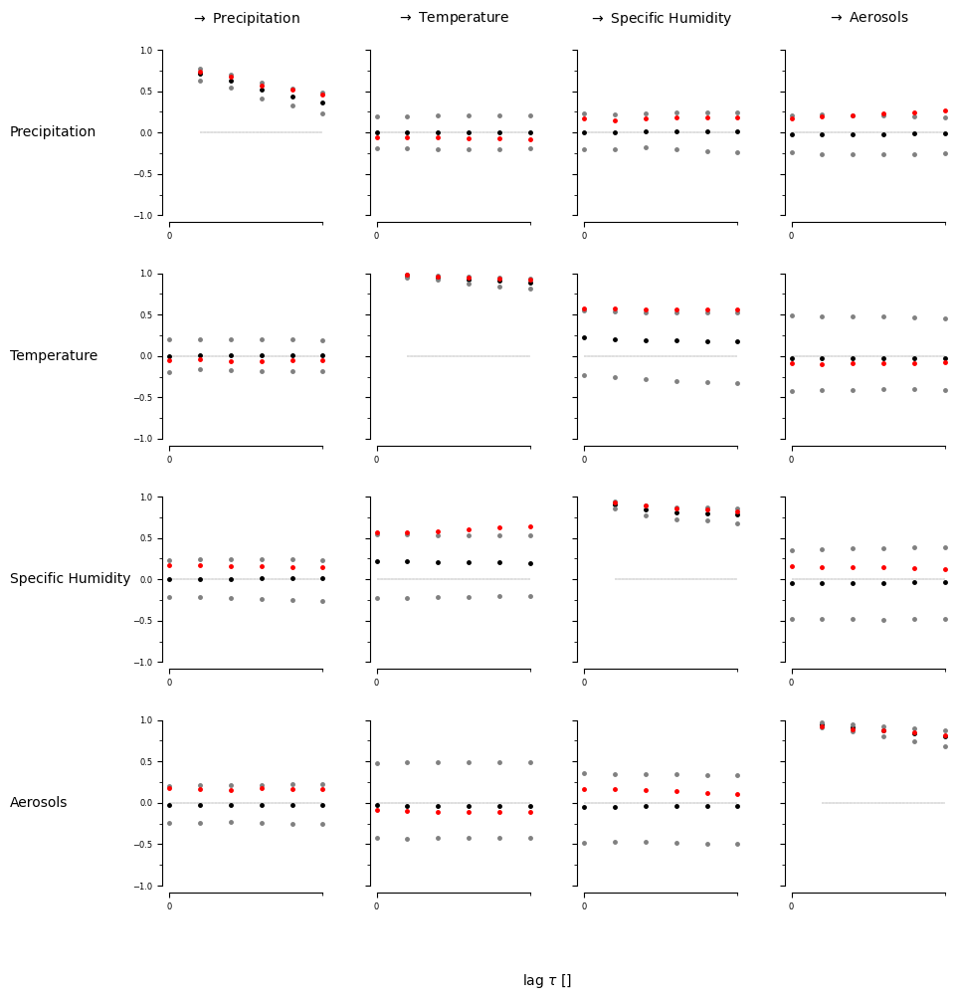

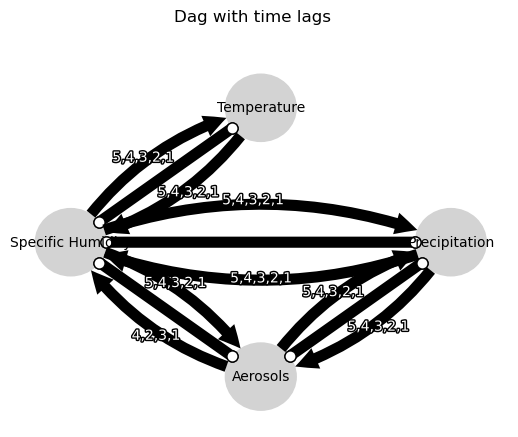

Negative precipitation values: 0


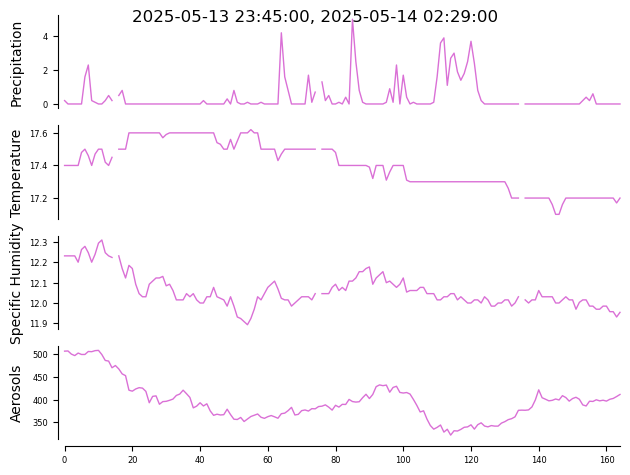

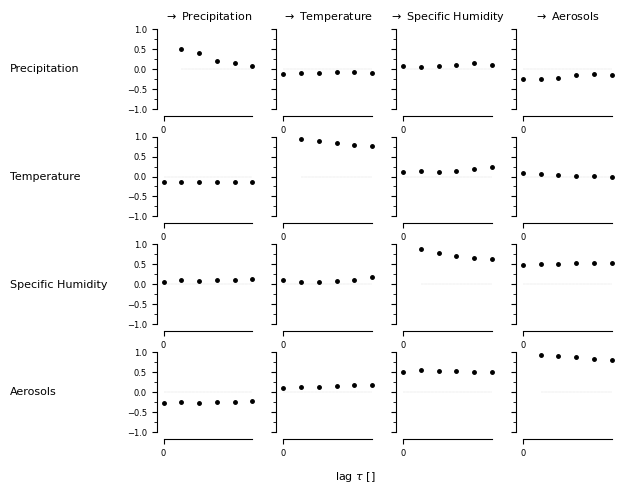

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


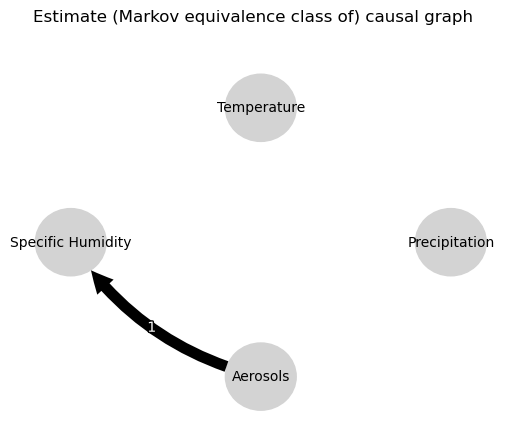

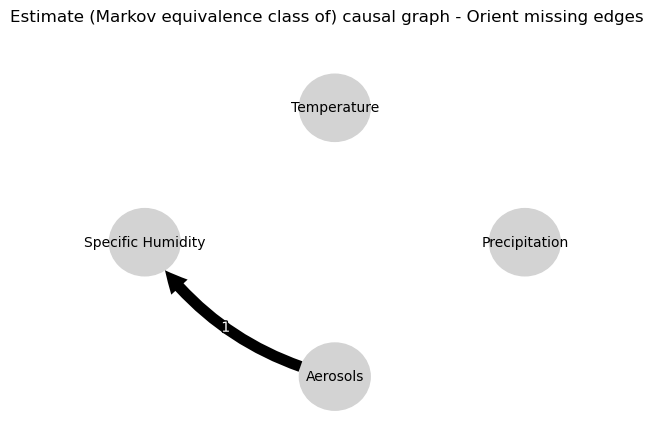

0.0
0.5138099930164612
0.26924453571371926
0.13836259189735653
0.07180692096466426
0.042598348995147445
0.03278926119782675
0.03173650168147954
0.027486303505086167
0.03195233002436854
0.029084394499310776
0.03207236325556242
0.010261807189714988
0.002390890761042555
-0.0009717588740234323
-0.003250727045861934
-0.010226570960283676
0.0007541534280382495
-0.0043882923680999015
-0.005463304327205296
-0.0024021021565186667
-0.0050771602060584575
-0.0072705092284154945
-0.002171602912165102
0.03278926119782675
0.023238299487298296
0.018771904657672634
0.01798652627093038
0.019135222980769823
0.018260651266307146
0.0
0.9057111346119538
0.8469369119713044
0.7979927380320936
0.7498328319430331
0.7082571060957047
0.18459599763513887
0.12066937791407492
0.07167788712927849
0.028337093354817773
-0.00020959414481331207
-0.02230510584773932
-0.03276020089362752
-0.026957626167284175
-0.022807887362932003
-0.019863487098759746
-0.01992003691441492
-0.01830068878333161
0.18459599763513887
0.1762533

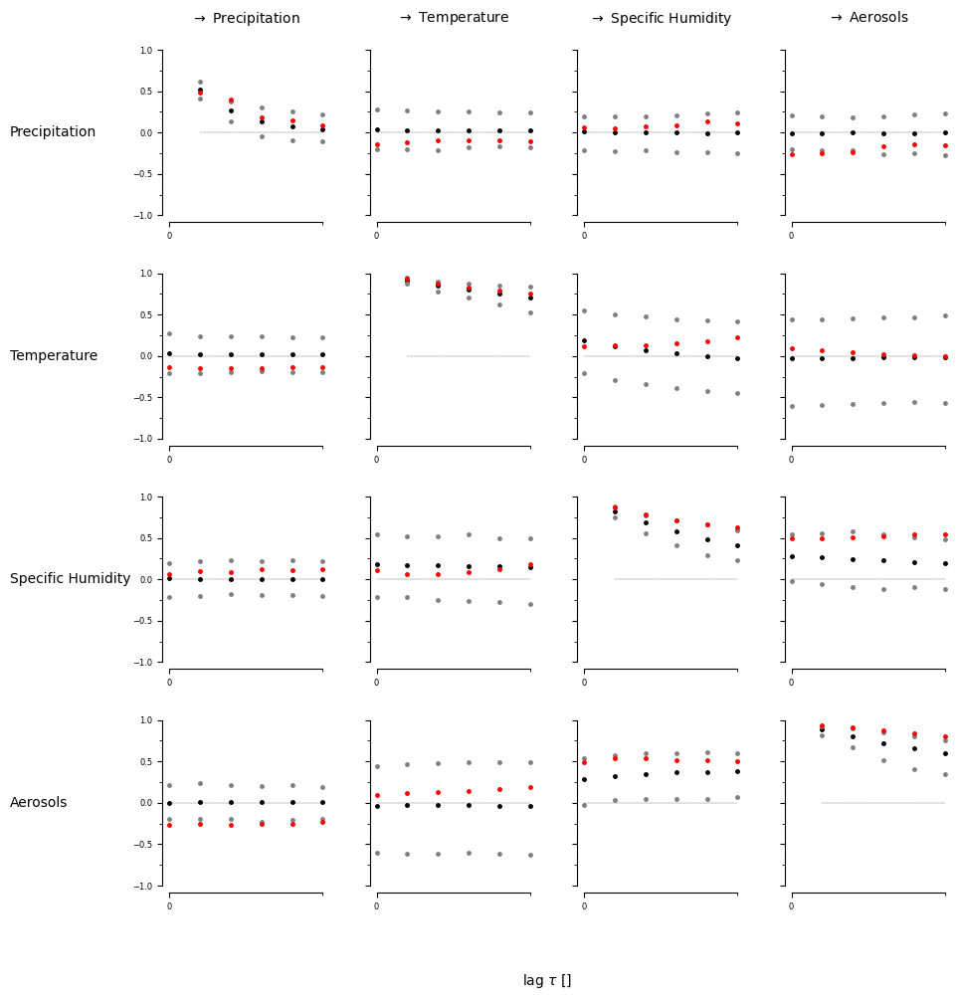

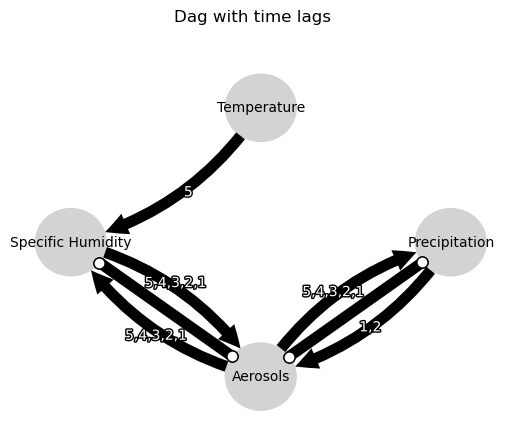

Negative precipitation values: 0


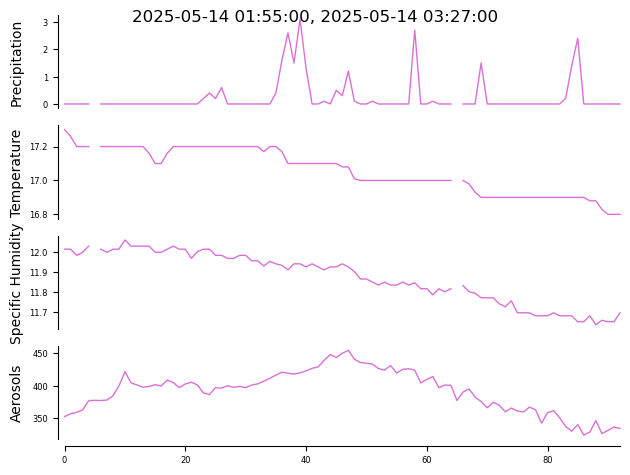

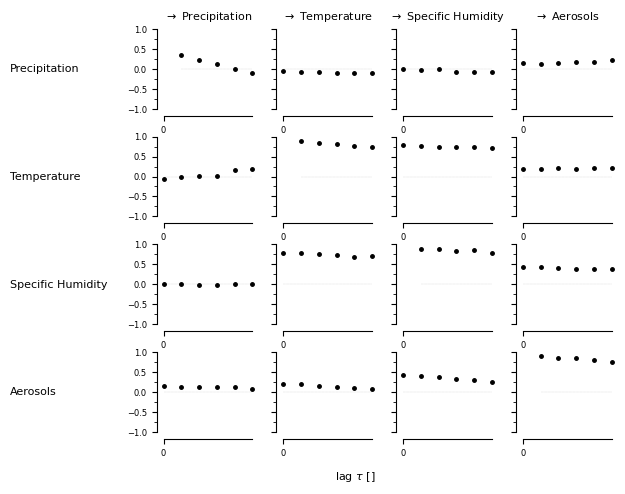

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


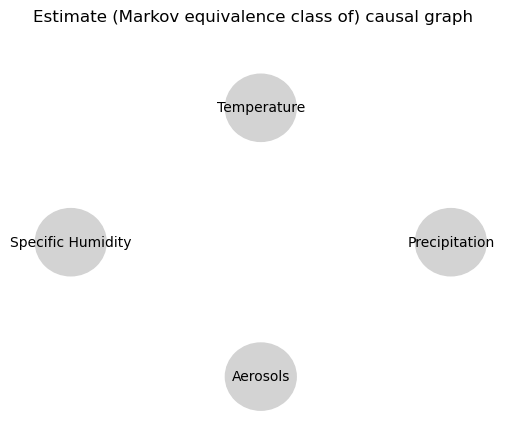

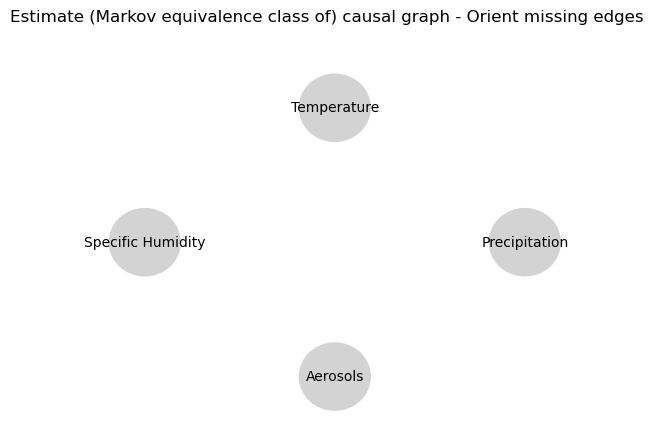

0.0
0.38962304555162447
0.1470158927976635
0.06512744749268781
0.009549778461855231
-0.004046192060932572
-0.033959499097733596
-0.02219789313163786
-0.019371210557171257
-0.03283337744258521
-0.041331595173804796
-0.03501929303138493
-0.004494281635421361
0.010584361655438706
0.019681755593492632
0.018670498941955695
0.028825156573638974
0.022599277956126748
0.08052884365096608
0.06758603947465823
0.04271862430328026
0.043602140679272684
0.026846981333501507
0.020956045008990242
-0.033959499097733596
0.00723217067767087
0.013853875727887599
0.020159019020428028
0.024569141591768925
0.024873667808064055
0.0
0.8643140759036442
0.7952321039584502
0.7398618616936495
0.6896981656004738
0.6490858240290238
0.1201873737481389
0.1004561070384152
0.08398004216391451
0.07161778727509023
0.06348476635109454
0.05811664663998567
0.18543195177470434
0.16524963498771694
0.1492045844944216
0.14042016594658513
0.13270993276652188
0.11940470124392237
0.1201873737481389
0.10370236001015781
0.088621851102

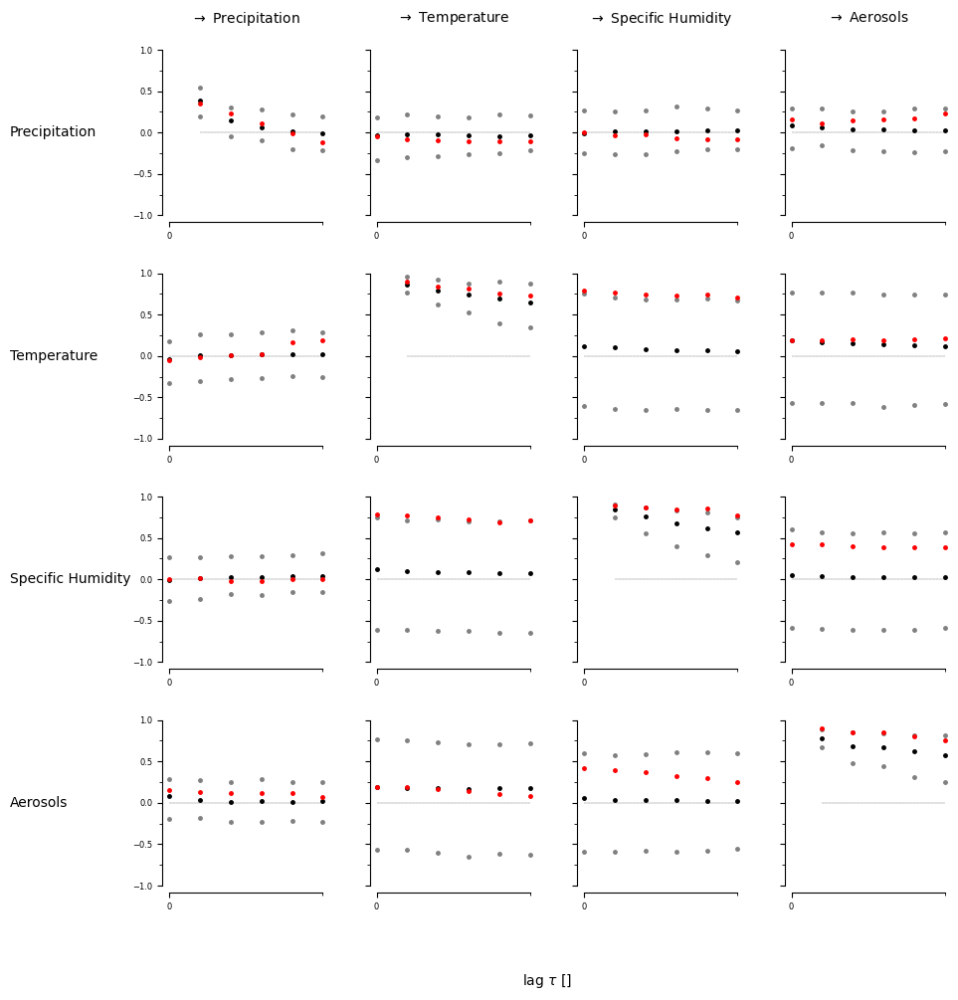

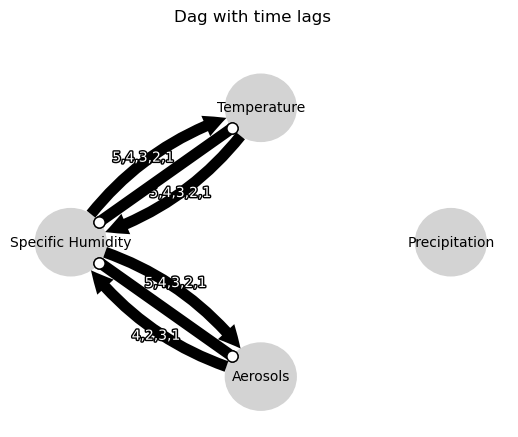

Negative precipitation values: 0


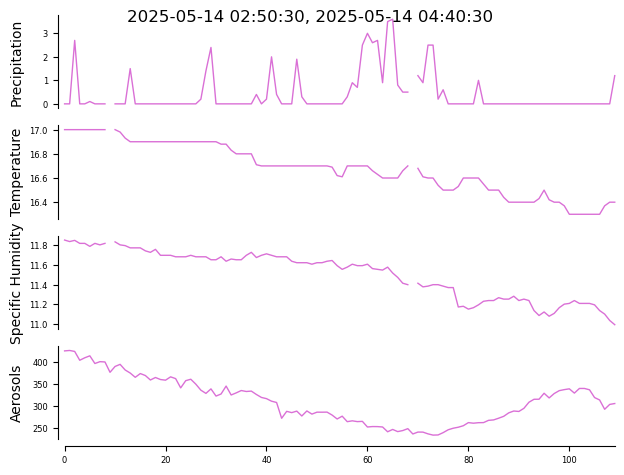

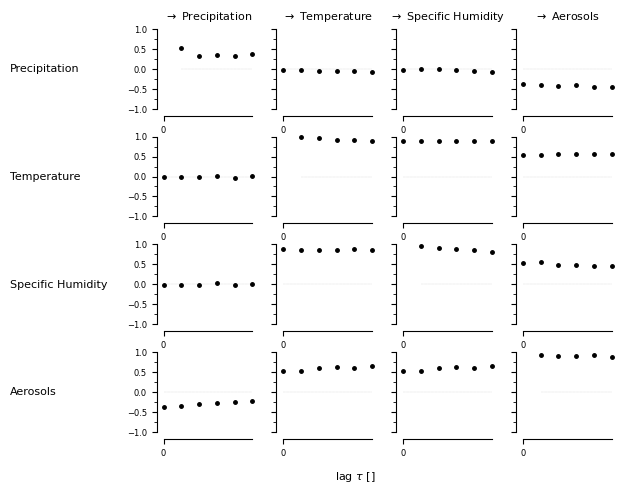

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


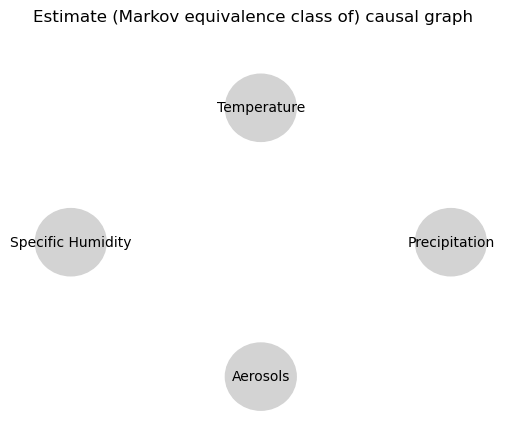

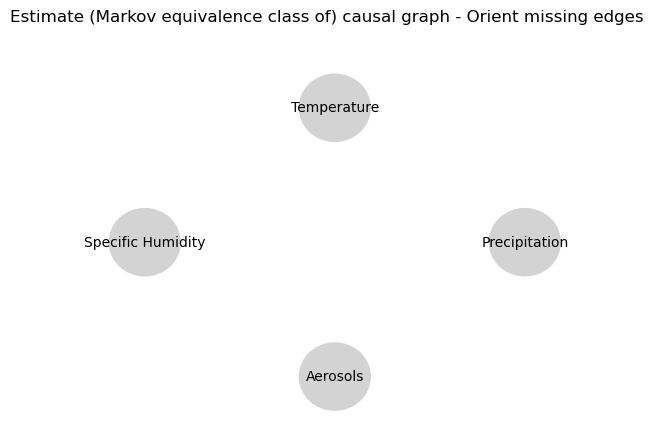

0.0
0.5880880186623919
0.36370692545497463
0.24721488746859585
0.19320544887776334
0.1980037269547209
0.008647001665731449
0.009741432936871321
0.008171936623468908
0.014074647215390321
0.016949623893709832
0.008045442005337699
0.06247492852208635
0.05775066505144559
0.048915880799331485
0.050704581250260866
0.03425989779408629
0.036117121617538585
-0.024586060276573757
-0.02308307336223186
-0.039341639205696985
-0.04299876182896465
-0.052715181036410534
-0.04744972644694127
0.008647001665731449
0.027146154965661334
0.023855625699403943
0.022311393116039965
0.026964911552644952
0.018871116145226446
0.0
0.8660817127023462
0.7883012534379137
0.720843801520103
0.6634015066286516
0.6139251477719115
-0.038727385547679974
-0.03427761741686601
-0.03228224387702606
-0.02773598705905822
-0.025445777955790613
-0.023116468688846058
-0.014165164358270263
-0.01615788899476776
-0.01120288504728856
-0.013849013538484539
-0.007963975044659129
-0.006479582459881724
-0.038727385547679974
-0.036620142469

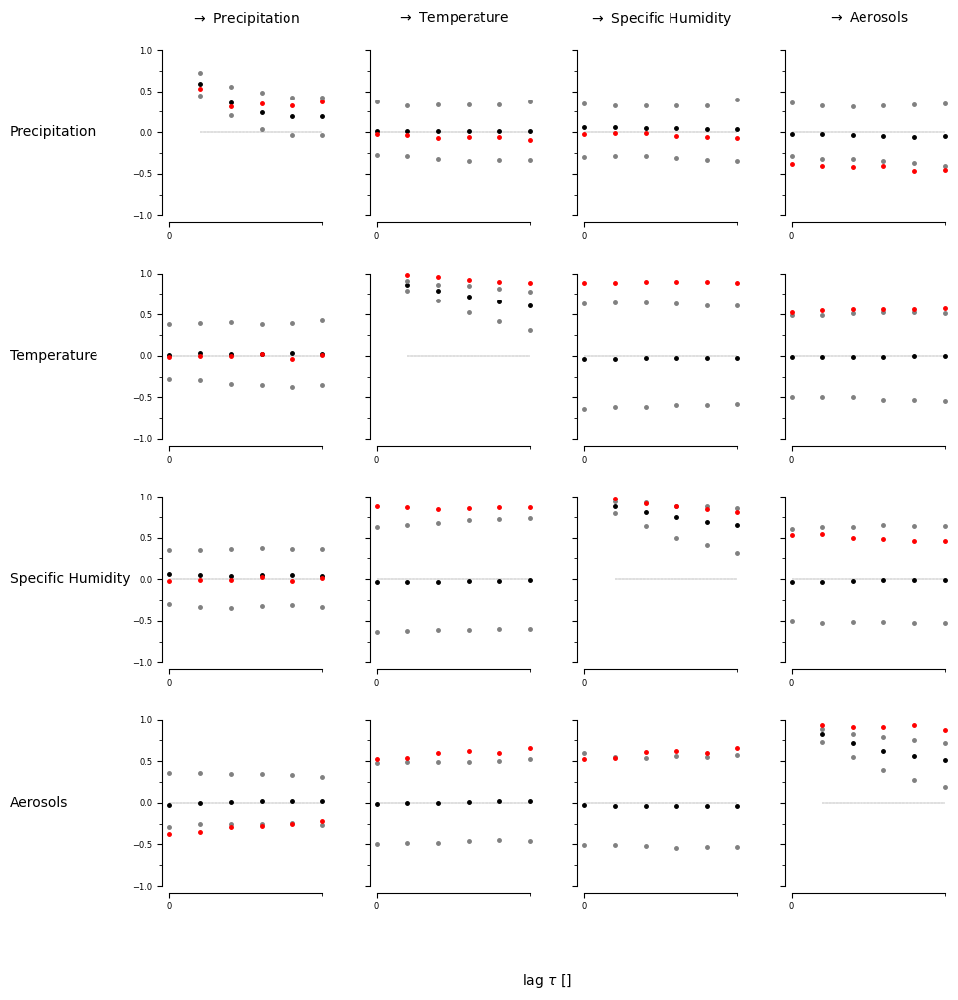

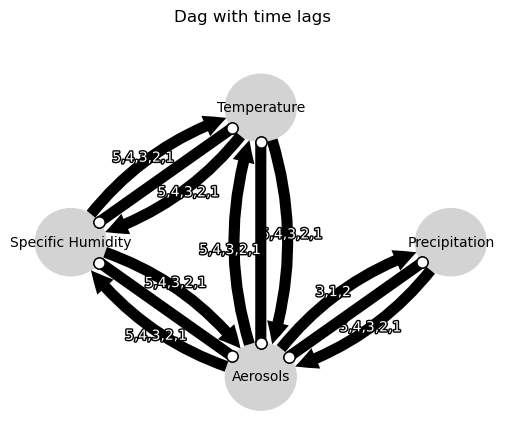

Negative precipitation values: 0


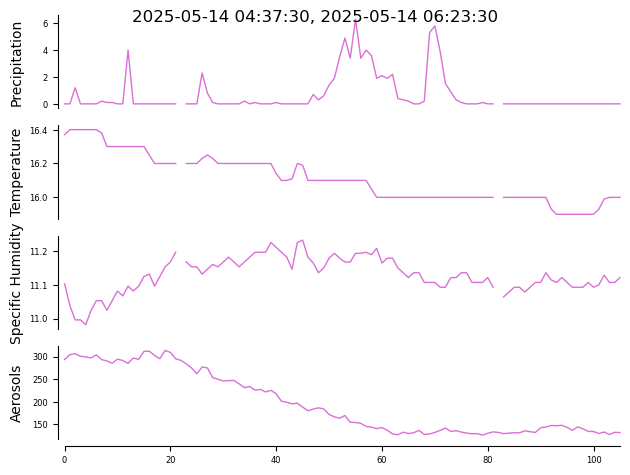

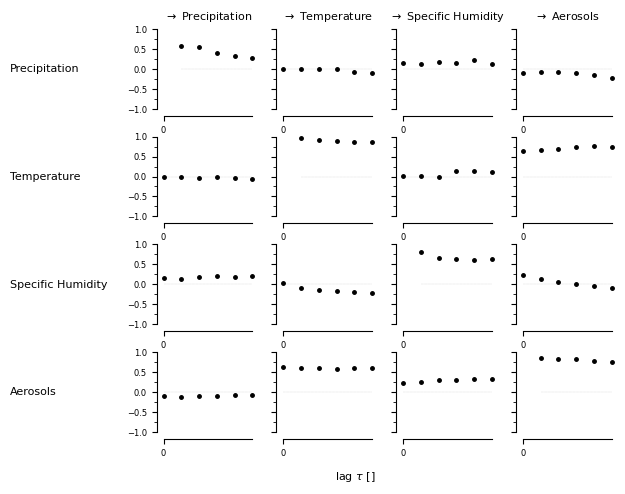

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


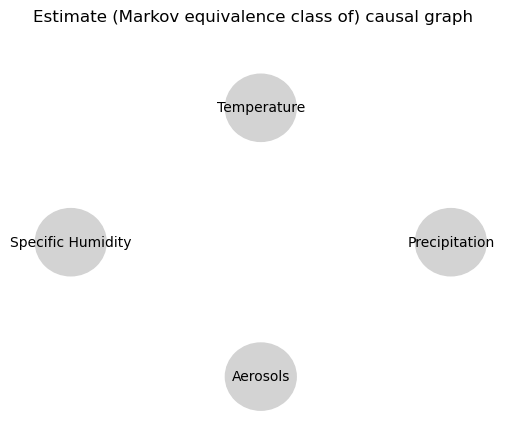

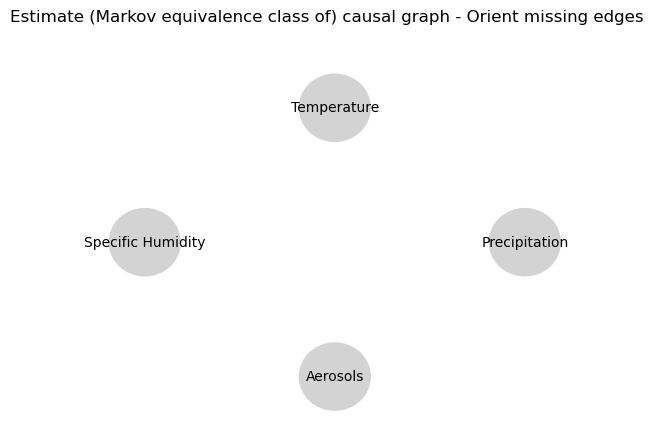

0.0
0.6596274233860703
0.4902912372842966
0.36615143242759773
0.26092066319625595
0.1899322197165857
0.06626805592869739
0.05034407538417493
0.027801987671070224
0.027256228866889533
0.01798582659929783
0.010434943896312799
0.07118589699086822
0.04566123060048354
0.024175267527156725
0.03368588310157896
0.028700835462378973
0.03755550245915826
0.009136885819712495
0.0003935860635024073
-0.012241102587147031
-0.019700159494830418
-0.026503648194877022
-0.029372985700881447
0.06626805592869739
0.05526434603510544
0.05346876766903828
0.056294953150298276
0.052969817699446475
0.05265909137701726
0.0
0.8389847318443505
0.7406348177432975
0.6587610404421023
0.5896484918404413
0.5238250135480822
0.35775524062575903
0.2684990647965342
0.20003334026808897
0.13979784865460837
0.09454696599017925
0.05763523587991741
0.1653151940757456
0.15056387602179475
0.13420699320145743
0.12422903821746728
0.1142709221900655
0.10219023949952144
0.35775524062575903
0.3310987708891644
0.3025229721262744
0.28135

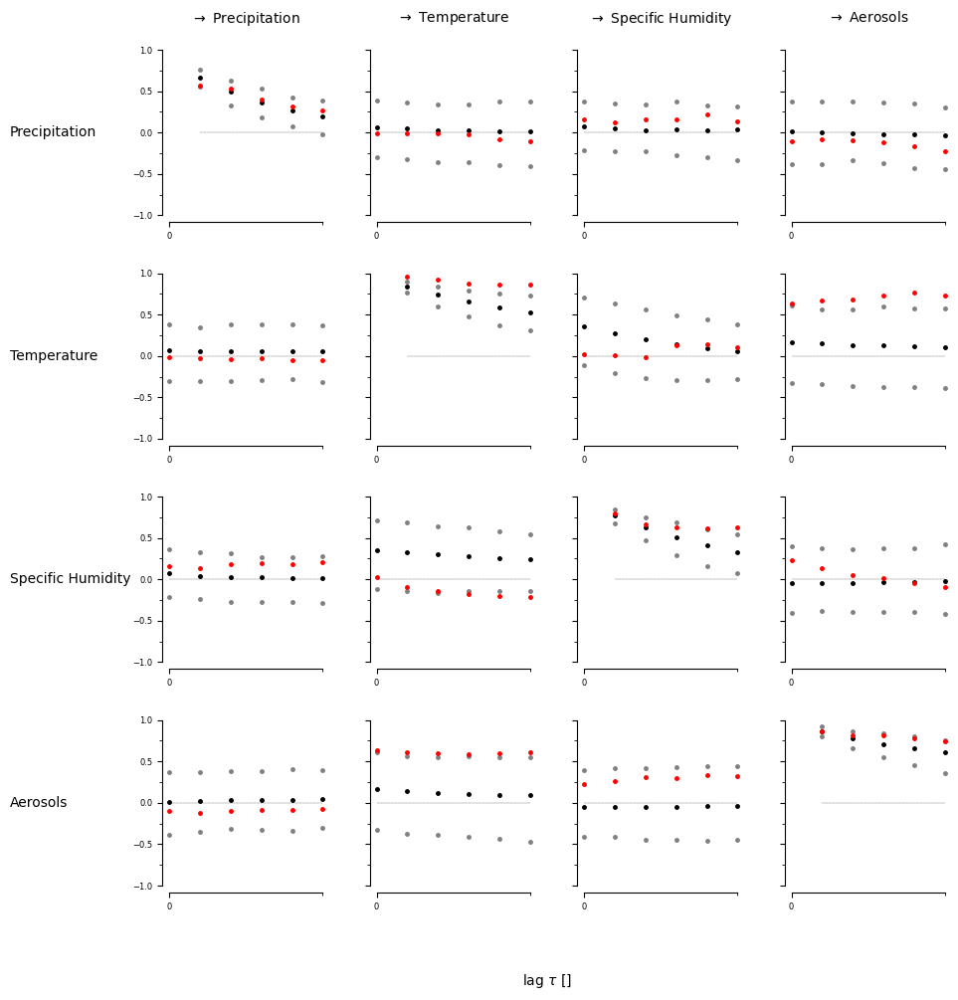

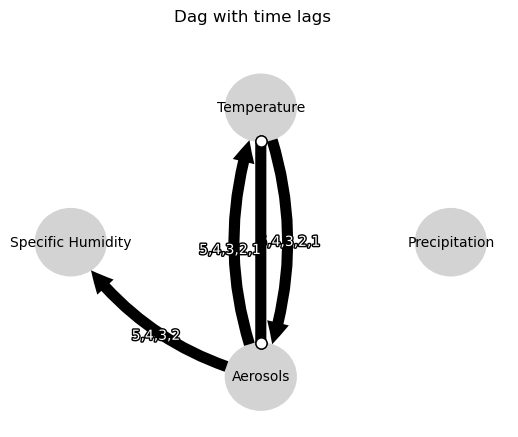

Negative precipitation values: 0


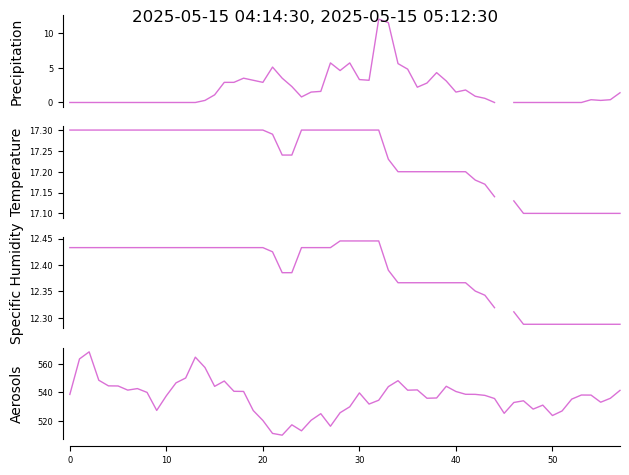

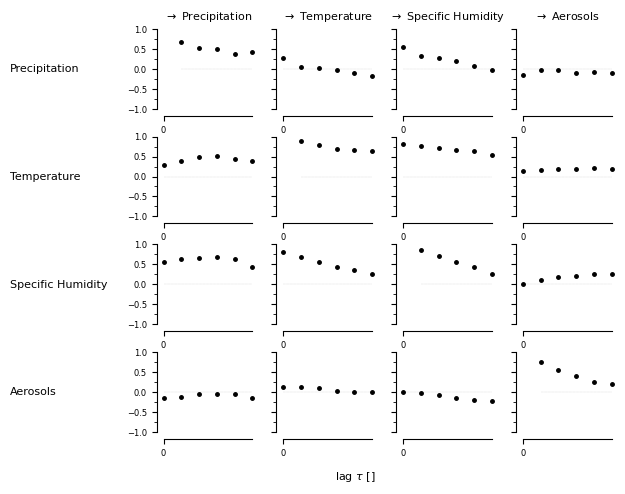

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


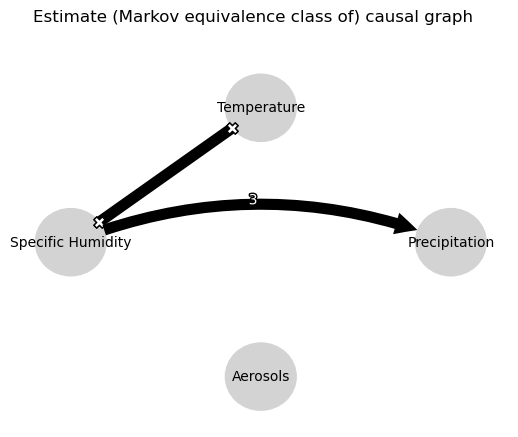

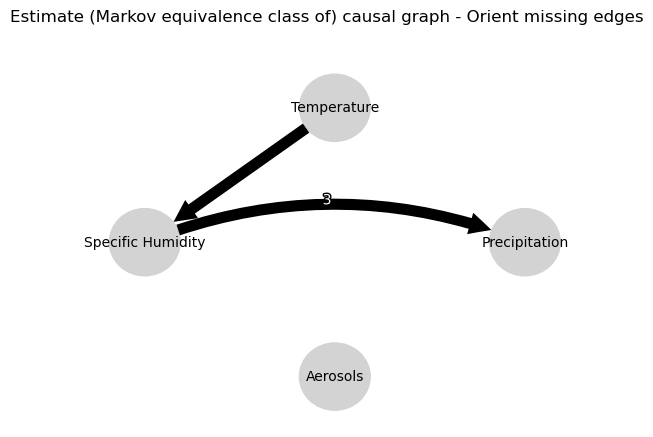

0.0
0.09190940515091253
0.08028660130474333
0.07724152742002978
0.04336220539655366
0.03139192619745059
0.1020217030585634
0.10795046306323501
0.07957320809242412
0.0768100004031095
0.057887280075927826
0.06833308973635768
0.20097312703632128
0.10607705470708118
0.0793419000155636
0.07116018654577137
0.05605670185394276
0.06326422965329344
0.027507863782685434
0.020930187743323968
0.057521155642240904
0.05681118899776391
0.07607351782685448
0.04806167740442913
0.1020217030585634
0.29151546205020834
0.3119899425728256
0.3152079595456723
0.2735525699264546
0.2221688142605269
0.0
0.7673660818518943
0.6499826226376899
0.5572862747848277
0.47536546938315183
0.42190744056391444
0.955039420952534
0.7627218225902119
0.6489122476952766
0.561446593348933
0.47971492118279335
0.422909668546257
-0.10978577284215946
-0.05212738987015984
-0.016086517604576283
0.015825787883798223
0.04632437478509946
0.060272537065836164
0.955039420952534
0.7543021808236078
0.6347225941361397
0.5495195276818933
0.4701

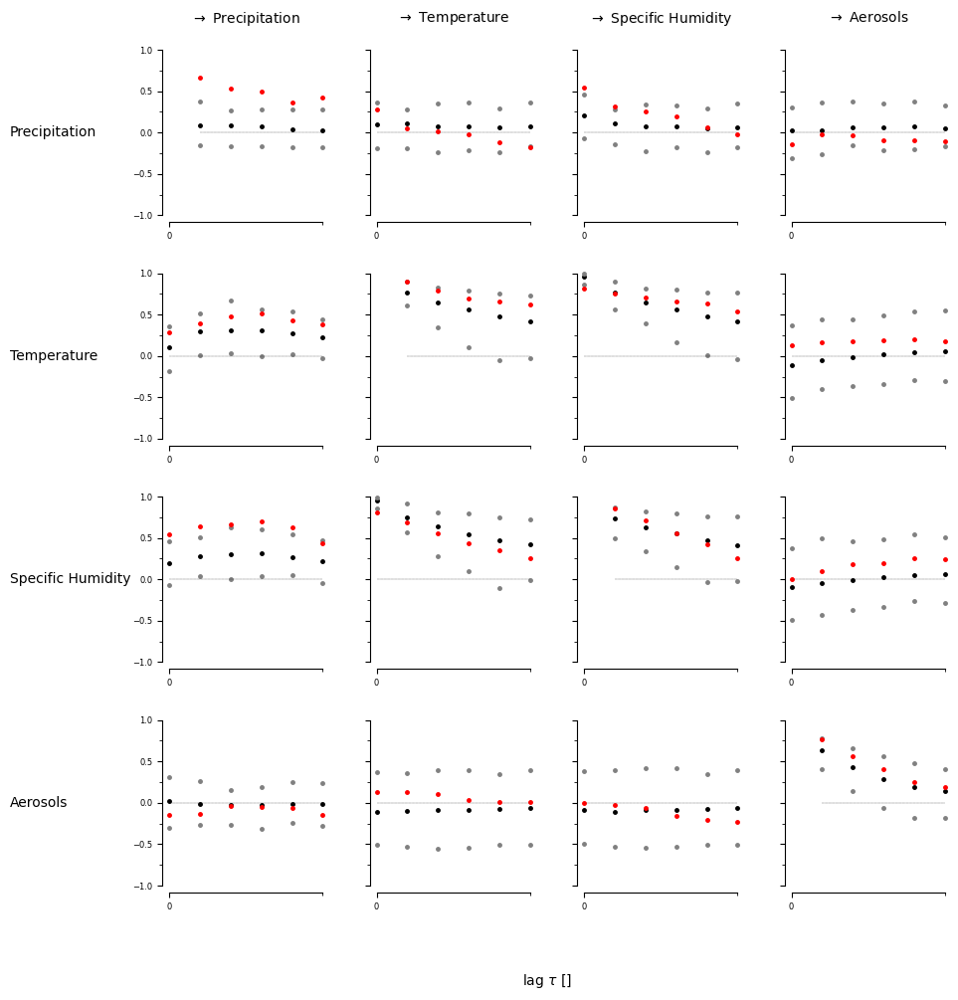

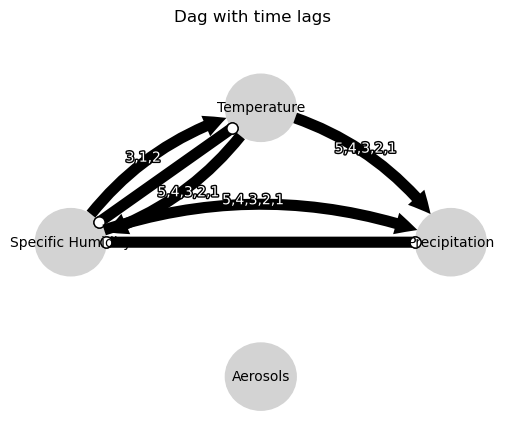

Negative precipitation values: 0


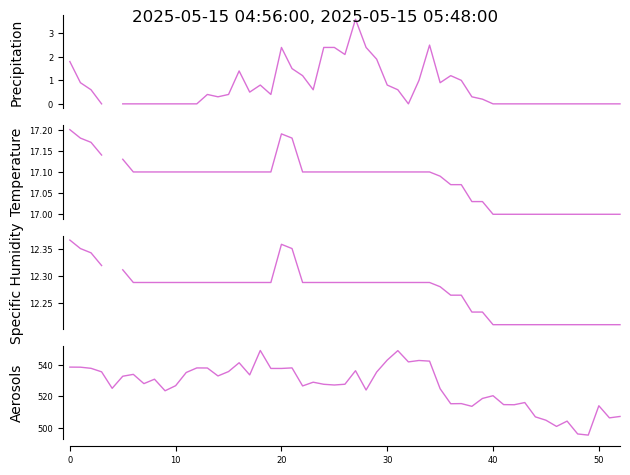

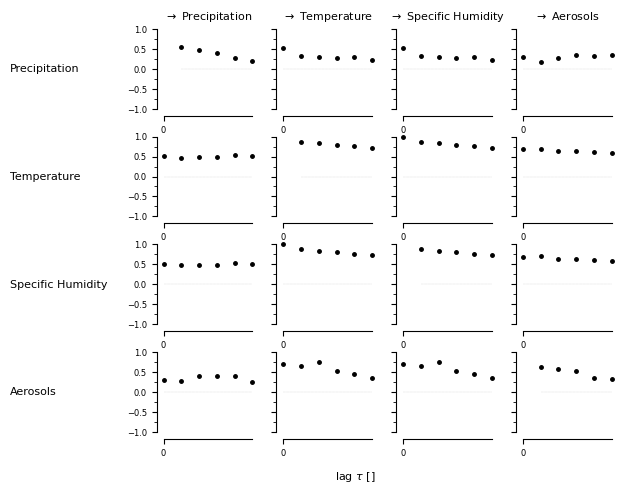

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


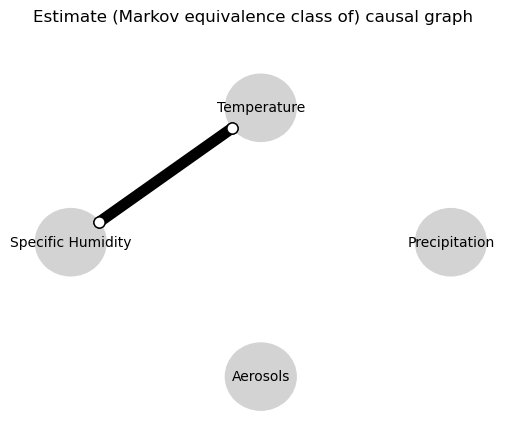

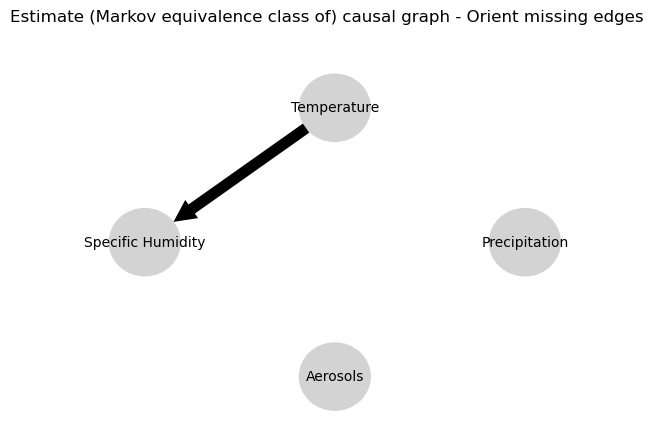

0.0
0.5748504148907311
0.34965726609485964
0.2230528172150034
0.12370070917859238
0.07397523206200408
0.17264631206574435
-0.051075186396673064
-0.00769324460201297
0.008876811879720154
0.002715747195307935
-0.0014930732653967228
0.17287381678467859
-0.050836415495613387
-0.007843989480881204
0.008668428196736125
0.002683836234173547
-0.0015631144896489679
0.17151613119804668
-0.028404253548256517
0.02102969451700778
0.02698208050150291
0.010764726921088366
0.008806054316302412
0.17264631206574435
0.133720153731489
0.1009011615546642
0.06157756385099847
0.05061011176629556
0.014917237056902783
0.0
-0.04923195325115684
4.329100481024612e-05
-0.03979868487251784
-0.00829022531286674
-0.01901686313314416
0.9998988200492701
-0.04903160842587293
-8.648874721378514e-05
-0.03999923385545884
-0.00838912986785759
-0.01885227427720175
0.7574127844576907
-0.03679363991415688
-0.012569207489623743
-0.02318531531938863
-0.0029498330142428437
-0.024606172545051628
0.9998988200492701
-0.0491797363262

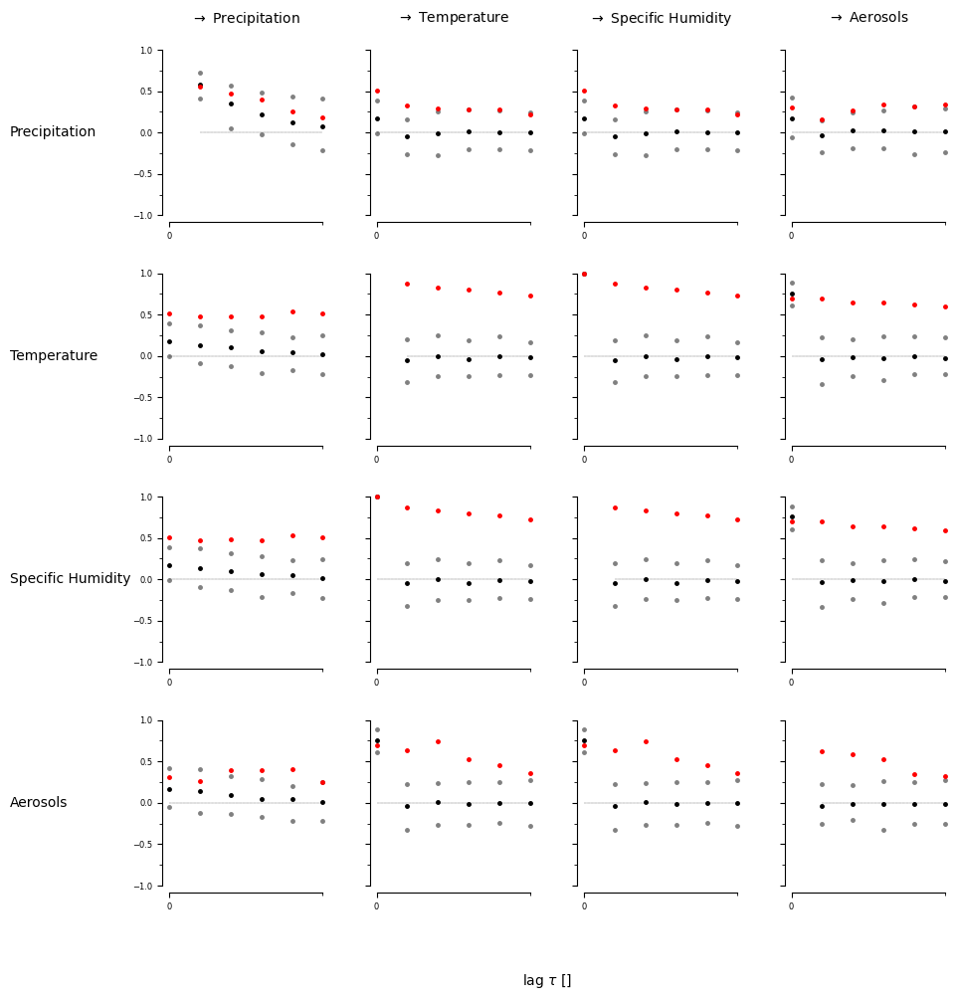

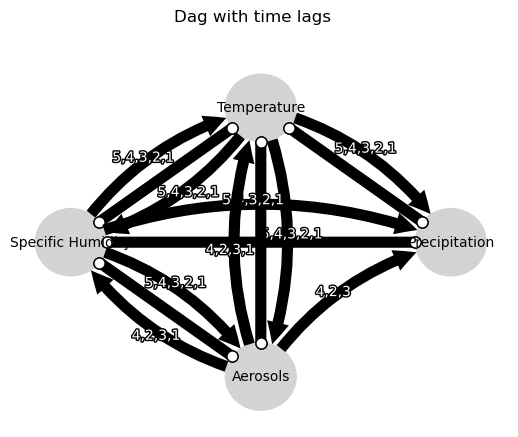

Negative precipitation values: 0


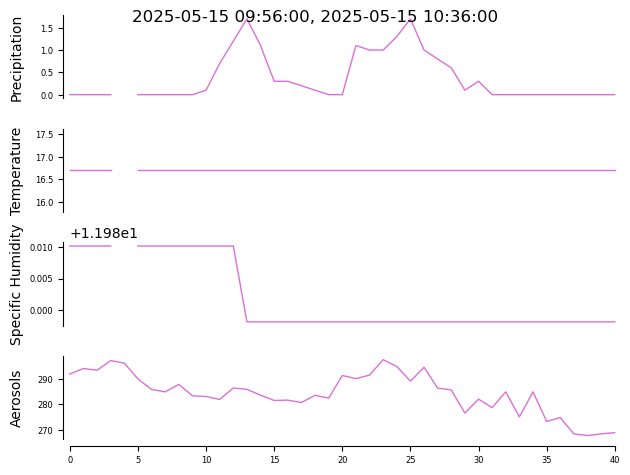

/opt/anaconda3/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


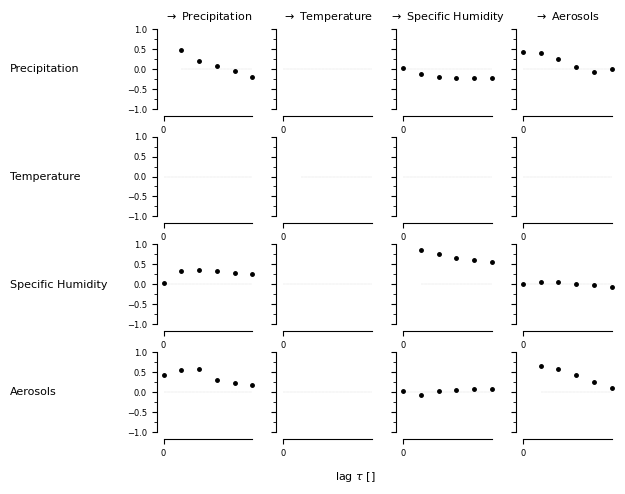

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


/opt/anaconda3/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/opt/anaconda3/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4847: NearConstantInputWarning: An input array is nearly constant; the computed correlation coefficient may be inaccurate.
  warnings.warn(stats.NearConstantInputWarning(msg))


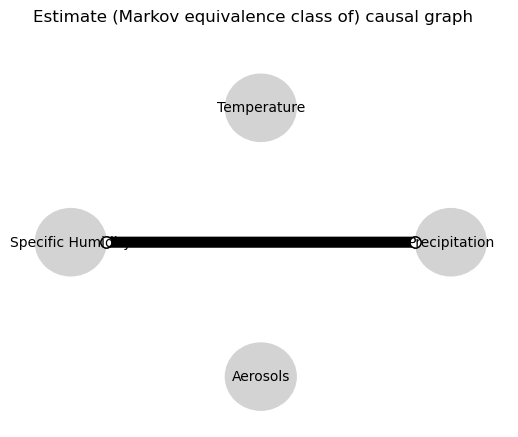

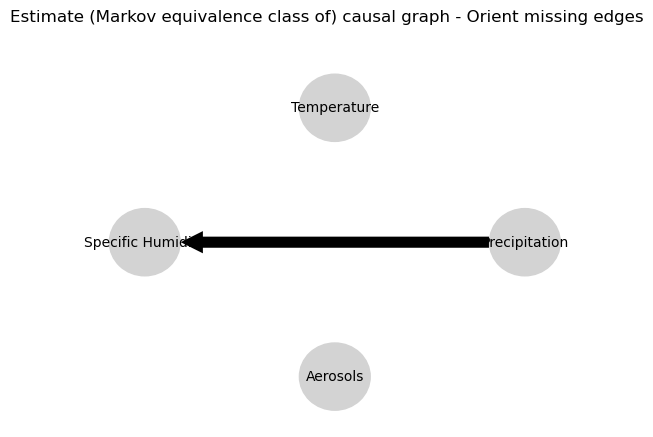

0.0
-0.032708736081276155
-0.06734476349627351
-0.013594052411642193
0.015478583969460028
0.016594273973657706
-0.018032128167985904
0.0031884573276476226
-0.005606579985171114
0.05098213473315501
0.0008698948056715697
0.029091912596498112
-0.22350780535368112
-0.1751375223925543
-0.1047471727054721
-0.09001808577058368
-0.09202488590996274
-0.07039158771930748
0.5401992355742784
0.003252586035270239
-0.0451433054776585
0.021456495669375086
-0.015083775148111567
-0.012301621283261453
-0.018032128167985904
0.02319260425339388
0.02067093665013795
0.029495445398738697
-0.019578197350823768
-0.03486940984648602
0.0
-0.015471255426805044
-0.036321755343983596
-0.04357063891582829
-0.05855389650550521
-0.012644029588936612
0.009463470282187532
0.026096581499362323
0.008929347561804659
-0.007878975947935175
-0.02040375607386516
-0.002119872138014921
-0.01563237124824868
0.056848722777640706
0.035032808753526185
0.015817497335900366
0.004688863525007902
-0.01291910241607936
0.00946347028218753

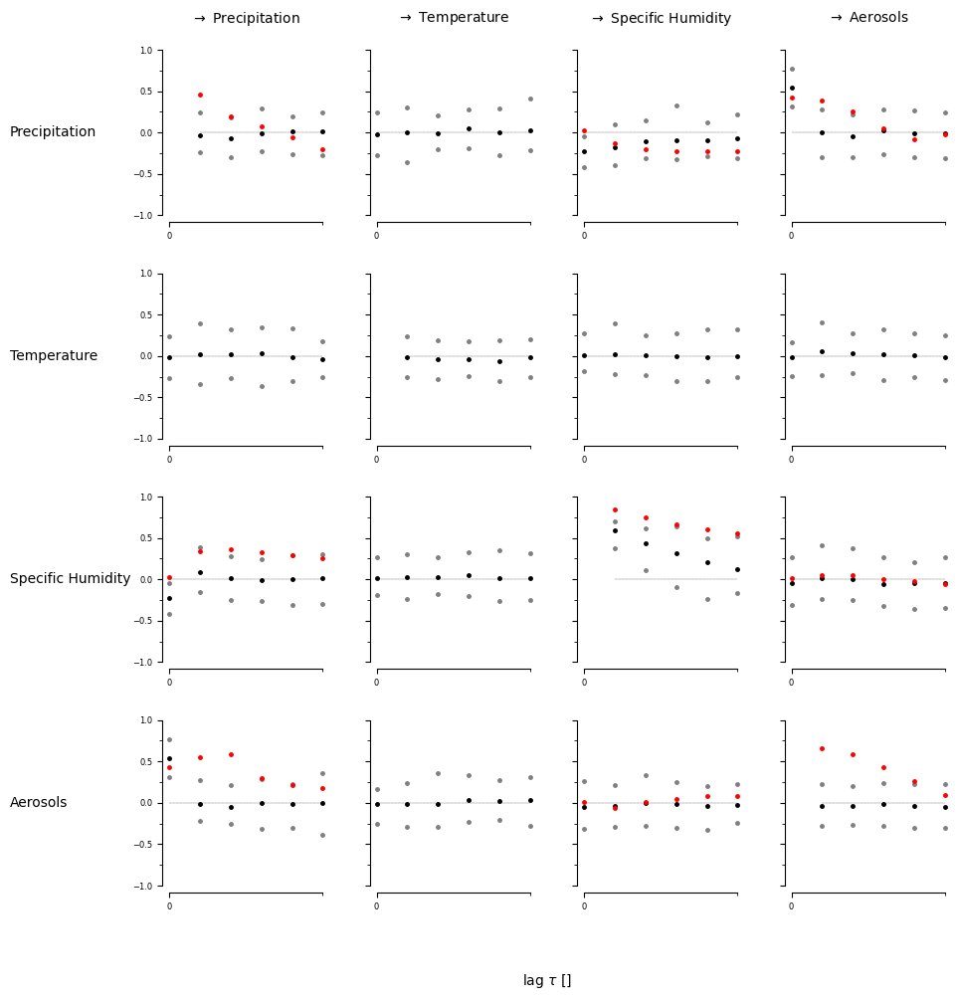

/opt/anaconda3/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


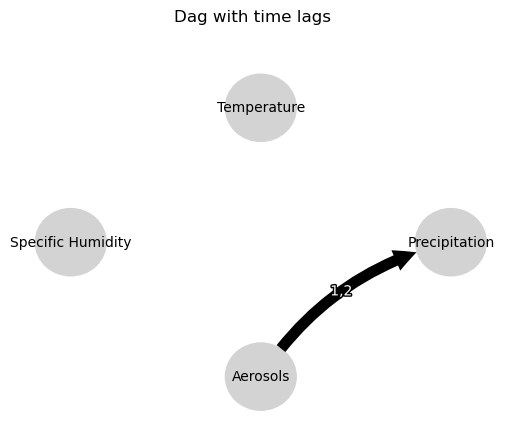

Negative precipitation values: 0


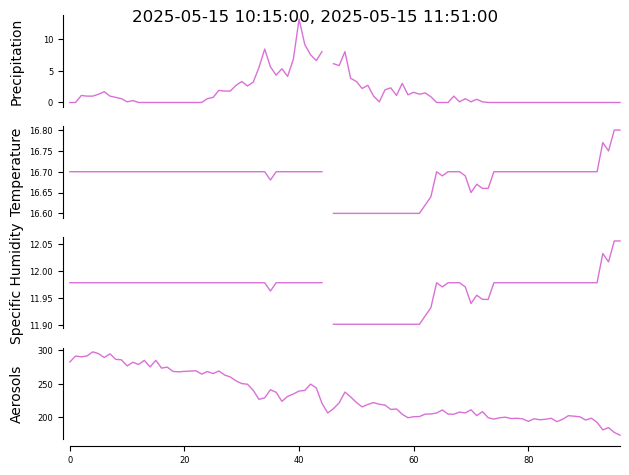

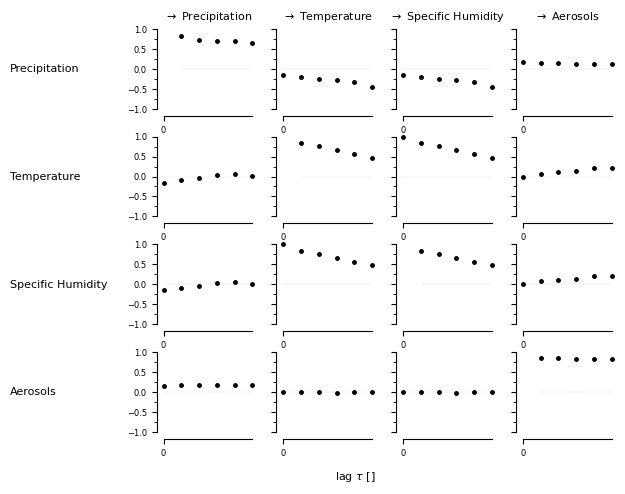

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


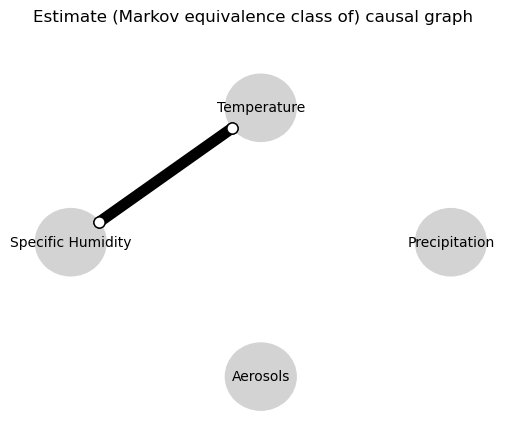

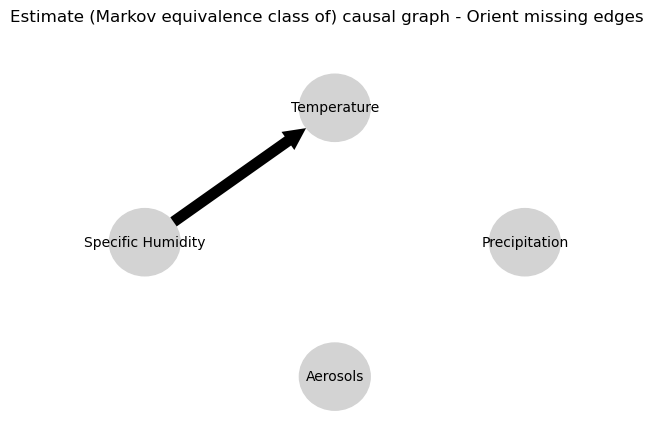

0.0
0.7900326873685174
0.6589990612398229
0.5580370680289869
0.4710956871917727
0.39491472712753783
0.0213612566808496
-0.024054145960794117
-0.01940273021065719
0.010561305342217442
0.006793876792216145
0.012258662057202292
0.02127181671651222
-0.02433457208824251
-0.019535801311977467
0.010333688965217995
0.006618029255367375
0.012190854555876835
0.0404011586151071
0.011896981369477665
0.029757316324745715
0.024082411933452567
0.028528819678912676
0.02023797452057898
0.0213612566808496
-0.00018120458319316655
0.006573044530026166
0.0044517510975342735
-0.0036896647249333135
-0.004284566009966221
0.0
0.0035638940329721204
-2.7460018889086667e-05
-0.03303122981223917
-0.006035739631235319
-0.005427120526242721
0.9999409426819749
0.003720646071071027
4.5913593132777816e-05
-0.03307205262491611
-0.005983892363667122
-0.005401627849592667
0.07373606269530489
-0.008015496441369174
0.008482271340093156
-0.0348367790221501
-0.002635199885787295
-0.00957910716764561
0.9999409426819749
0.00334

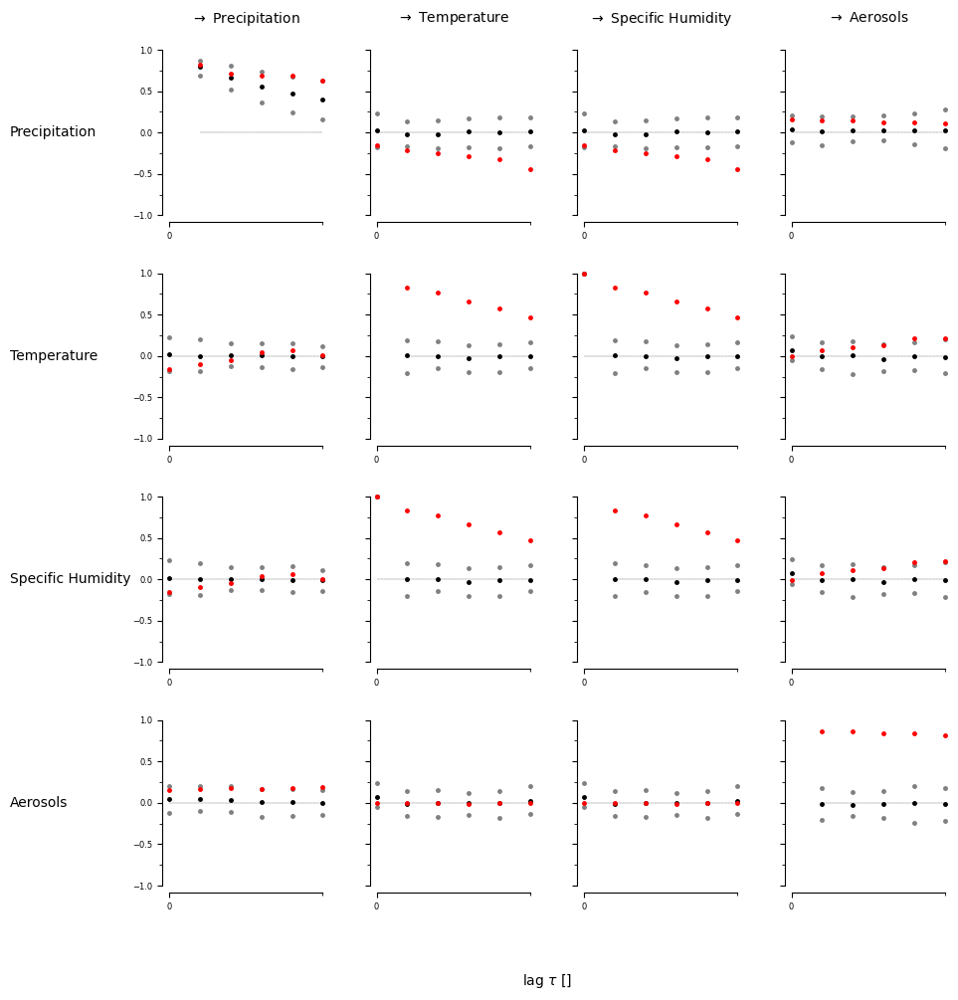

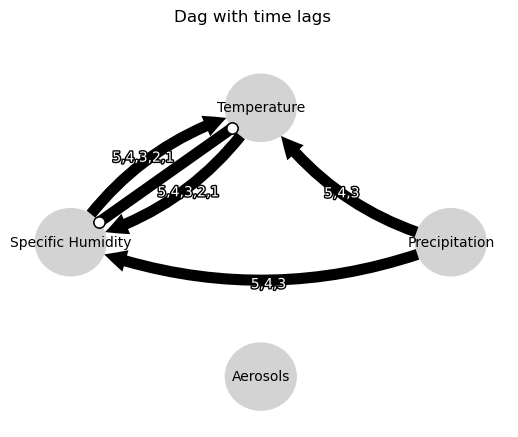

Negative precipitation values: 0


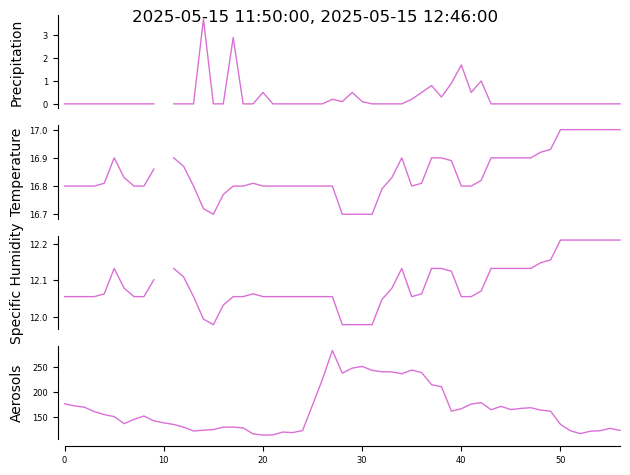

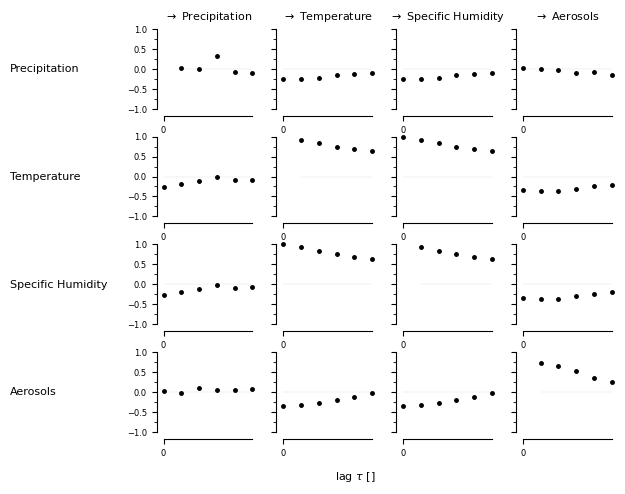

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


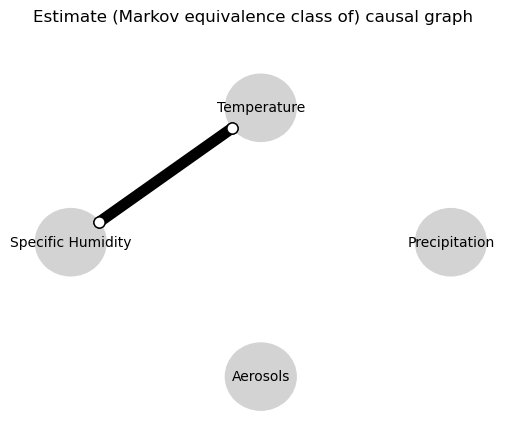

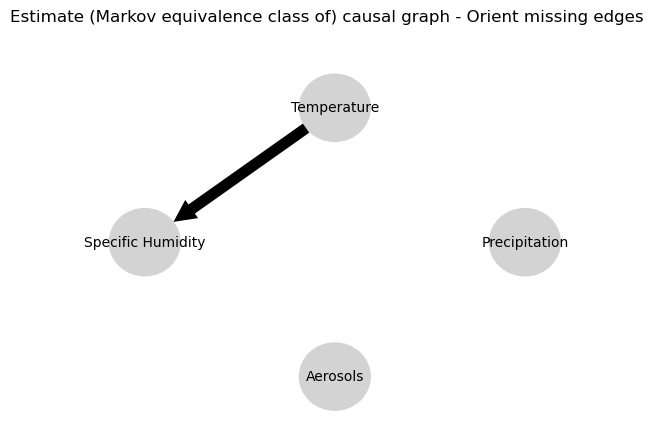

0.0
-0.011137598676299066
-0.03632274013817041
-0.007773810472949597
-0.012707992362382174
-0.021833115086957247
-0.23180936674223132
0.02801760409935785
-0.0037983370040836906
0.010037028457289453
-0.04200880259640785
-0.038888042077235736
-0.23130829560166763
0.02767021186040281
-0.0042734816039784055
0.010138363540050939
-0.041535977745606675
-0.03916632156514577
-0.006436016476626315
-0.02324018814463923
-0.01036554579549378
-0.017893353978859147
0.027513088954402125
0.03915990965812562
-0.23180936674223132
-0.003153466820832259
0.024553025494465787
0.03337697266145701
0.025474628878159777
0.029584416983948505
0.0
0.006210371531637508
-0.011361083384792667
-0.024424730902260904
-0.019749703829444184
-0.04120757505742097
0.9998561564665179
0.005940370654135967
-0.010935346707313044
-0.023860574428780465
-0.019762861412842756
-0.040645828110565656
-0.09791806802835788
-0.06917952773131122
-0.07088313949884266
-0.06708732451376026
-0.10008935736579738
-0.08704070546554522
0.9998561564

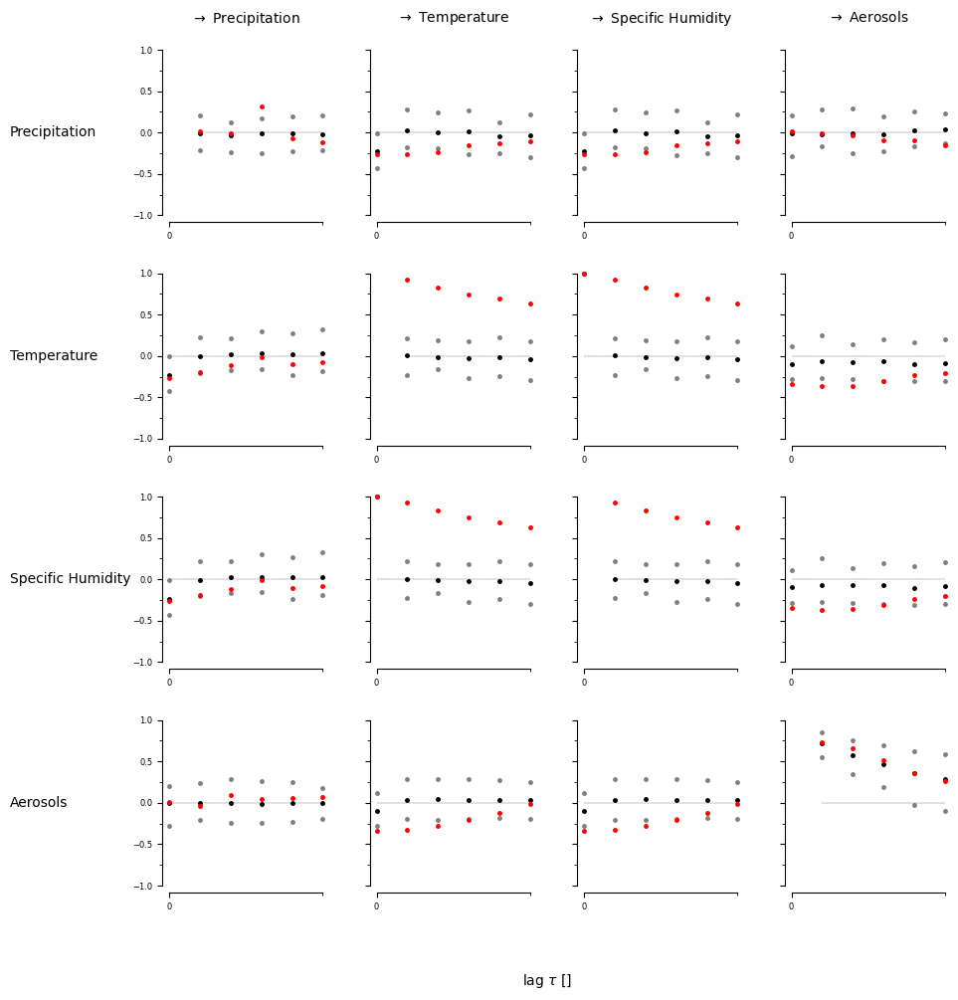

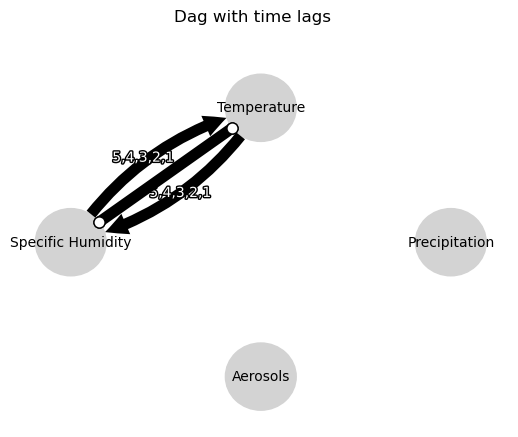

Negative precipitation values: 0


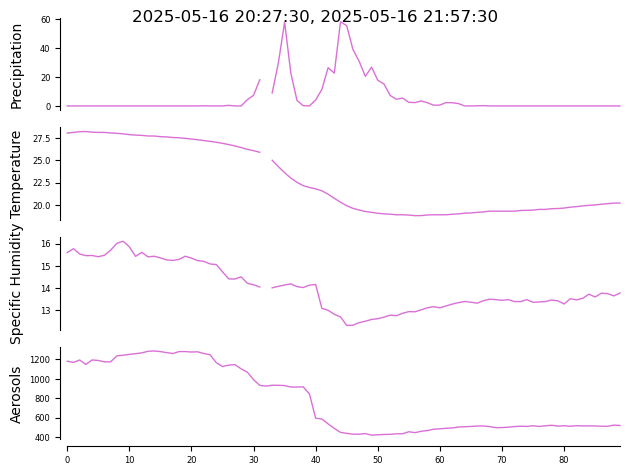

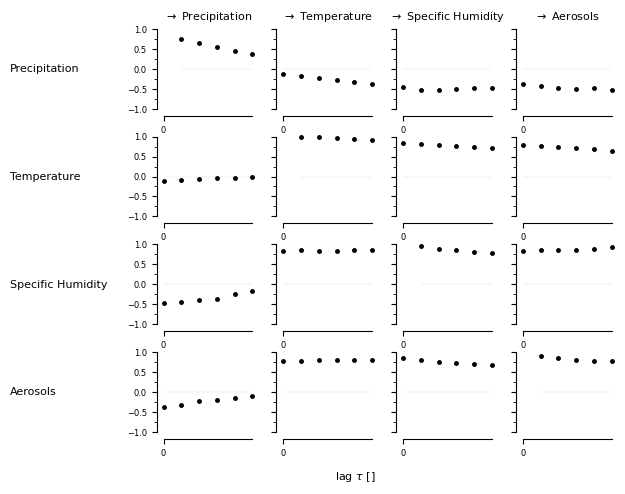

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


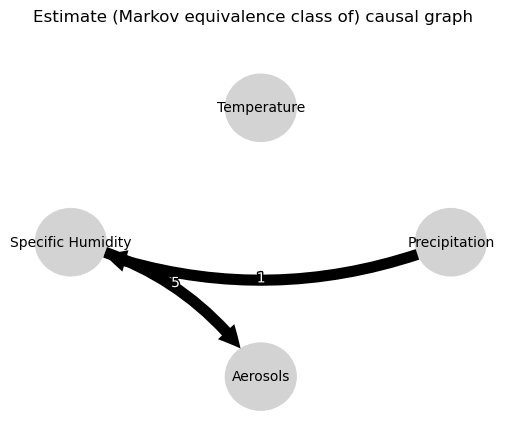

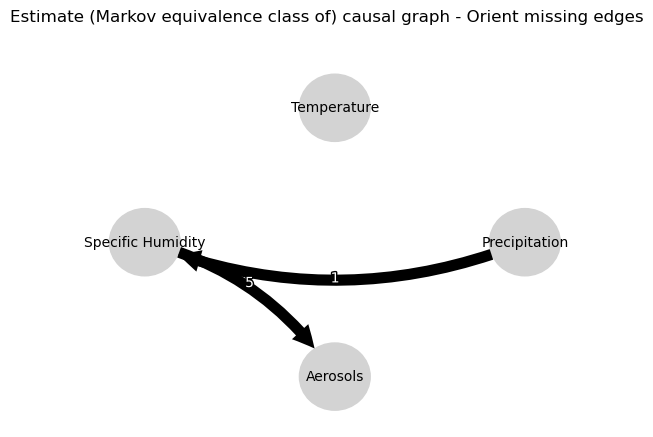

0.0
0.7007134210515233
0.5117029797671886
0.39206575195044785
0.2887630113242164
0.21091953943502975
-1.0208502287765986e-05
-0.02287378756232679
-0.03210085395356054
-0.04979955256601982
-0.058325586213152425
-0.06522145384974909
-0.21566388821477672
-0.22470019049067788
-0.22120466499448116
-0.23097321350188227
-0.2289948916660114
-0.22738762955983124
-0.11849459956523223
-0.09592328949534912
-0.07567230793023307
-0.05799164426837926
-0.042300760953120325
-0.029804665861537943
-1.0208502287765986e-05
0.04064522939543177
0.06399768404582801
0.07158583396640875
0.07629443901813439
0.07566545675066207
0.0
0.9363274596235182
0.8863497835826252
0.8390247042159382
0.7869987411892755
0.7373808877883321
0.18695948857912412
0.1463053532075547
0.11956267554208524
0.09927646342061573
0.08019534162444479
0.06147824001969572
0.05251811180342354
0.042260400603792346
0.02948104199101556
0.02082806984398062
0.012212618039216392
0.007360268410589276
0.18695948857912412
0.2093632677236811
0.2228799565

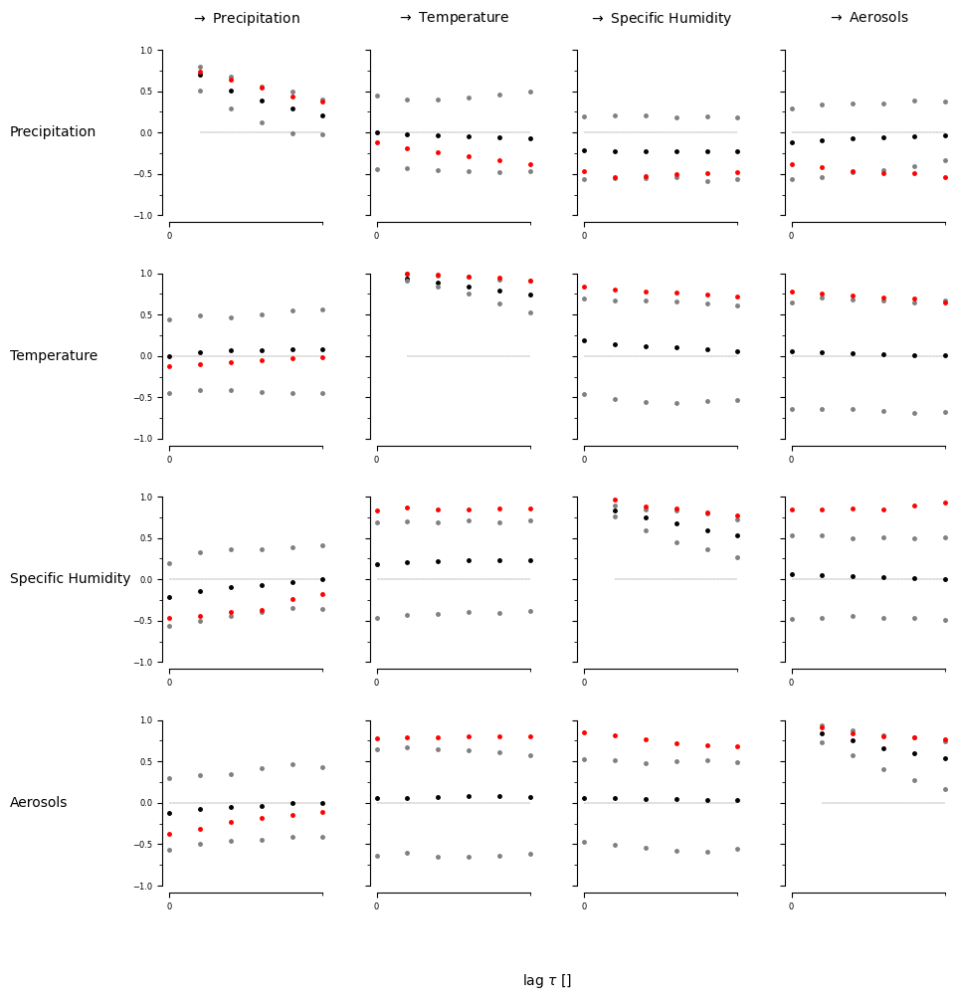

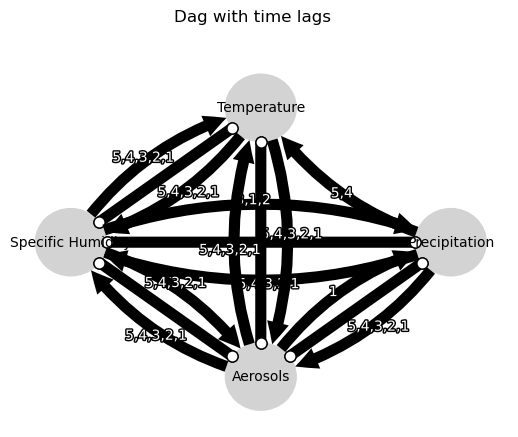

Negative precipitation values: 0


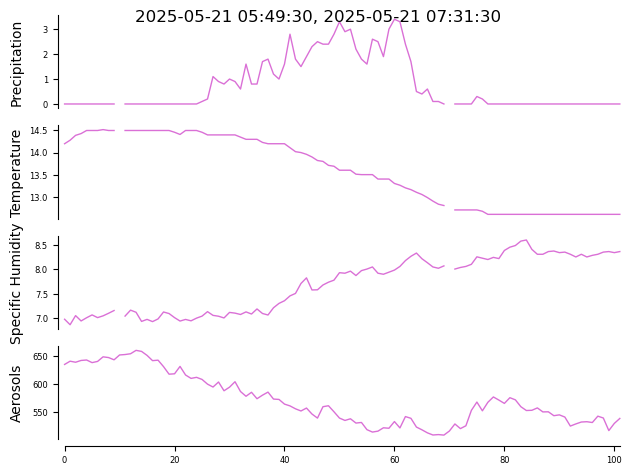

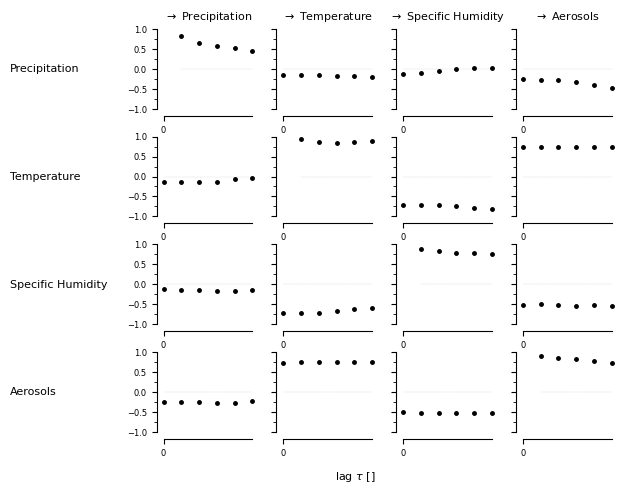

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


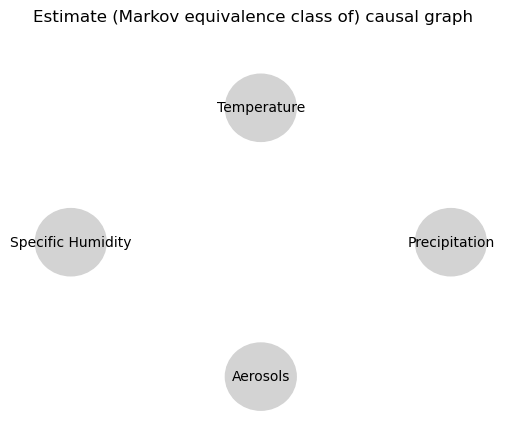

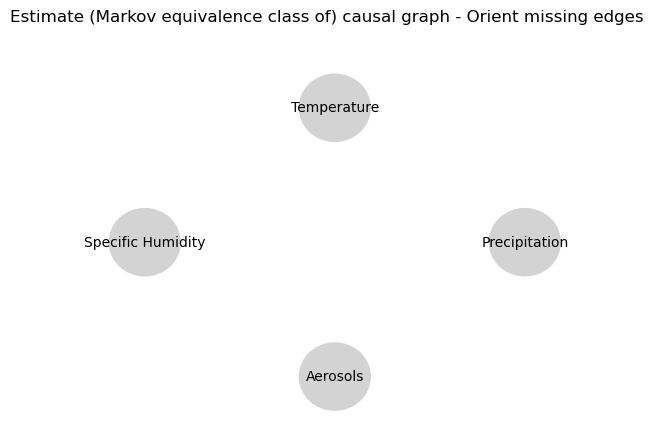

0.0
0.8211694960166956
0.7087596571126226
0.6187926463121233
0.5372901816794352
0.47106116704892675
-0.06289952363594332
-0.05989512058010864
-0.0586823023880826
-0.053211123579442715
-0.04263935847067861
-0.03868999444088842
-0.014676792029518446
-0.0049744586969002556
0.006614790392257053
0.0044666753096757736
0.005292346202484589
0.0013892801360750162
0.06651645290592474
0.07439877915656817
0.08841456533565131
0.09886325643957598
0.10600032689224126
0.10451877751709661
-0.06289952363594332
-0.05100212020454262
-0.03928412836005591
-0.03419552076153252
-0.02632026901726094
-0.02198004394972334
0.0
0.8690926728355195
0.7883164622249695
0.7264067447813222
0.6715266320172724
0.6250516357897566
0.07454455887557036
0.06446858266178865
0.05610357608137763
0.05191984718130746
0.05002668765086073
0.04976038620354096
-0.005178457768507847
-0.01516262013368784
-0.032682596051944145
-0.038778923365486946
-0.046032451724585546
-0.05662218070451861
0.07454455887557036
0.06703493866449296
0.057111

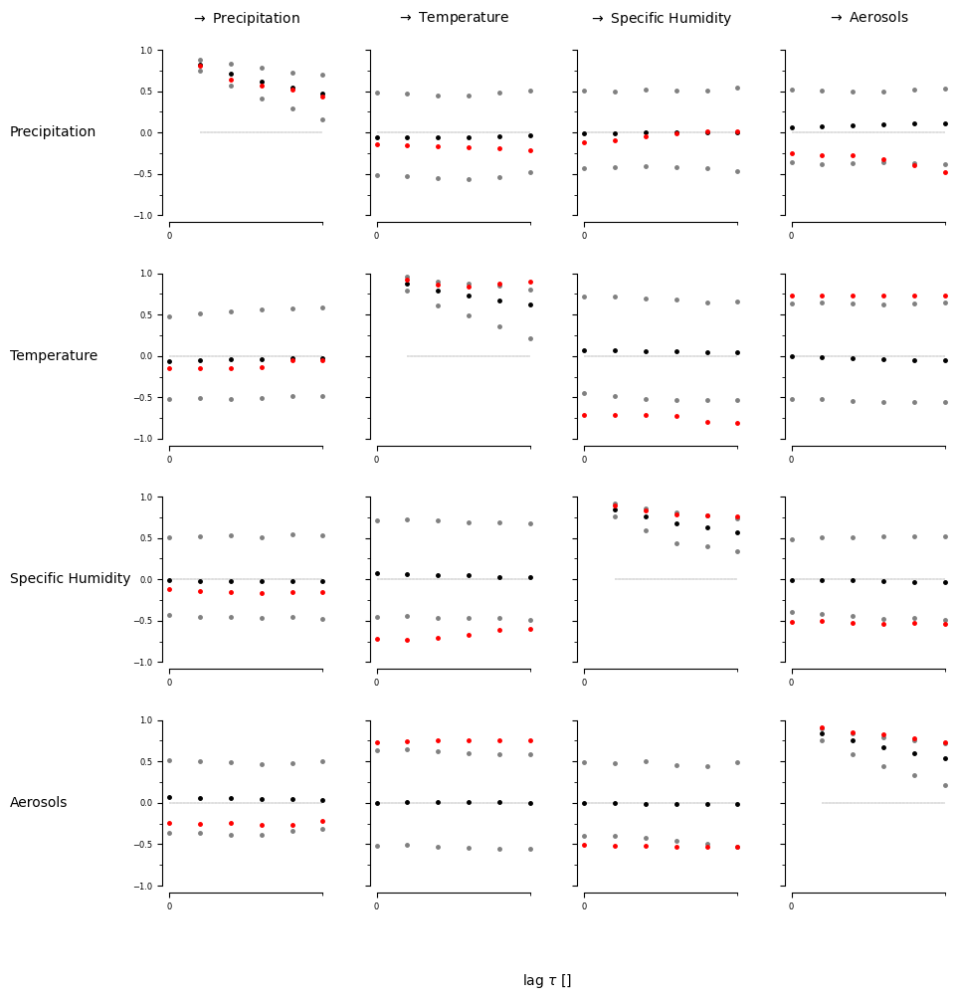

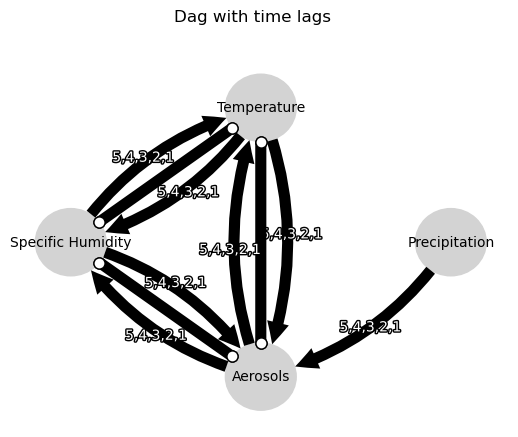

Negative precipitation values: 0


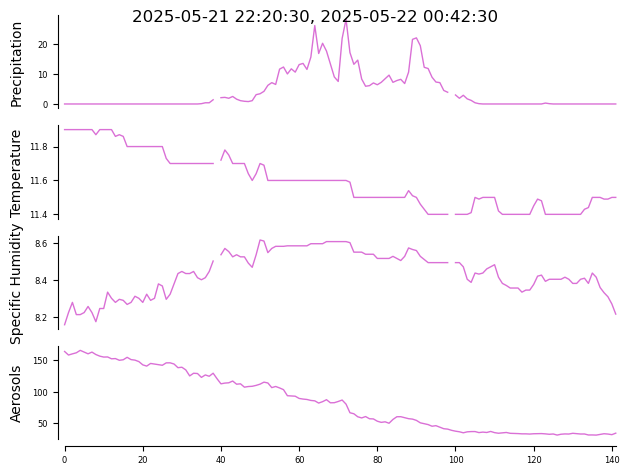

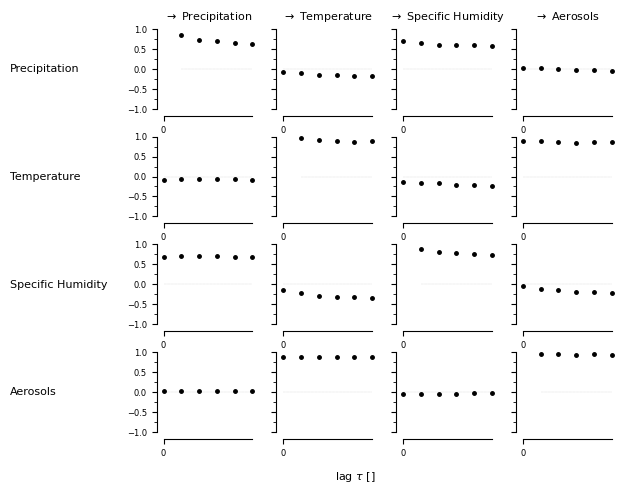

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


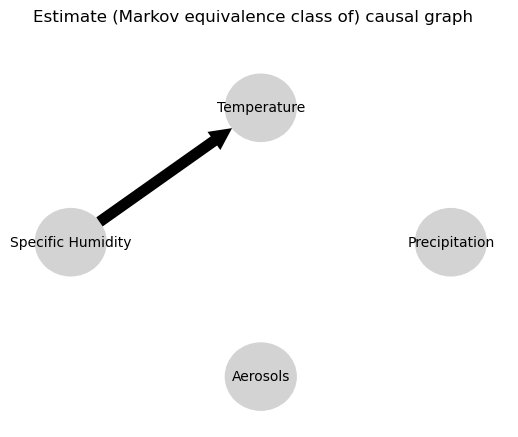

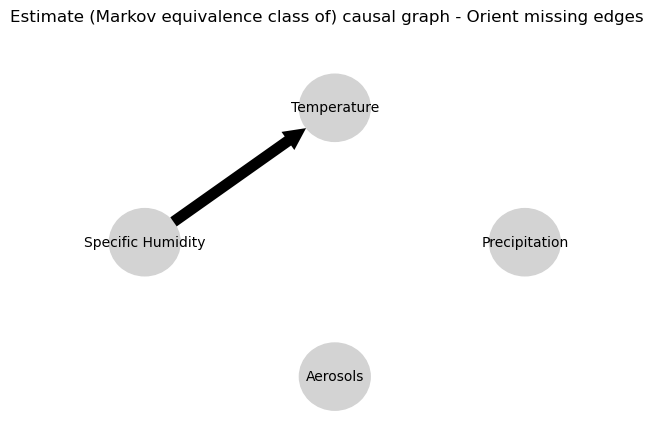

0.0
0.8413338853378886
0.7326905507409818
0.6436489973232028
0.5659728182890478
0.49632985003098407
0.07828888235388094
0.07602949864935316
0.07902614002556815
0.0844953366723198
0.086775693491926
0.09599903228034973
0.11852986980904205
0.11194338083716197
0.10600176767083677
0.10624566345284812
0.10741463193490858
0.11226497579200657
0.06132011840459322
0.05486337477521126
0.04976836977522811
0.04680306587379161
0.04163172594786491
0.03493227079243568
0.07828888235388094
0.07056015447299446
0.06796386766871632
0.061839206499479424
0.05546200220674573
0.05615700482821745
0.0
0.8768080537980819
0.7966689975190454
0.7287053190866745
0.6740476484385237
0.6292881490403501
0.583591512639122
0.5340298058112708
0.49153490686310014
0.4567917317146748
0.4243216835174897
0.3929211225525526
-0.006582106551904745
0.001634991192178904
0.002923487764379086
-0.0005539272136751205
-0.0010148347569390792
0.0009869776598795932
0.583591512639122
0.5227425081156132
0.4768642769399506
0.43246962002194606
0

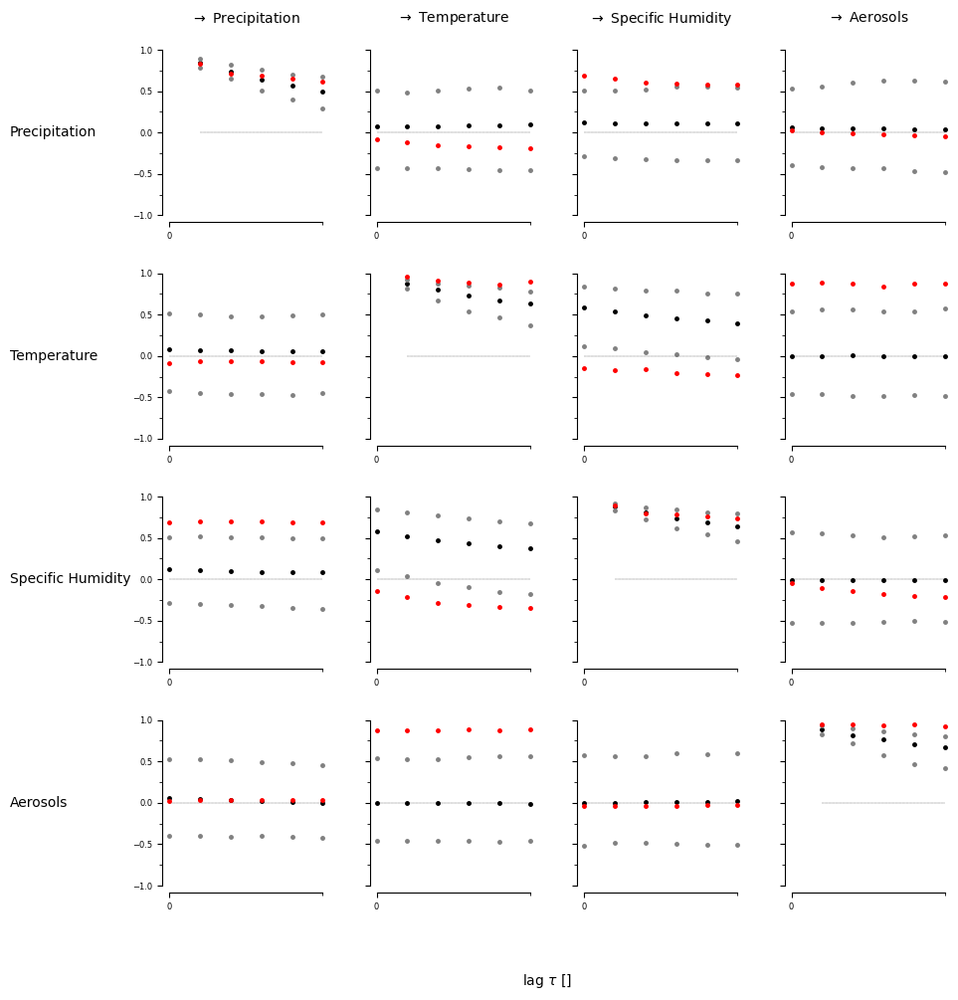

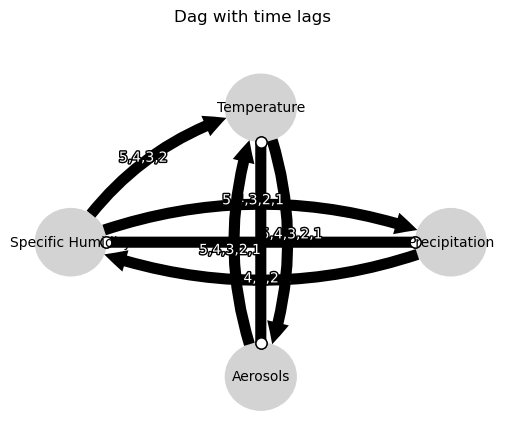

Negative precipitation values: 0


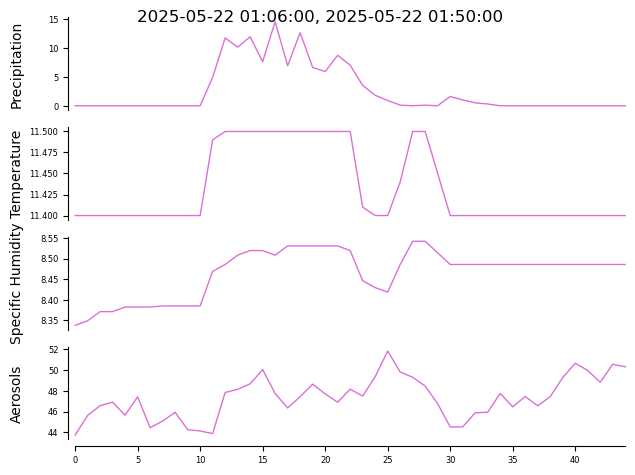

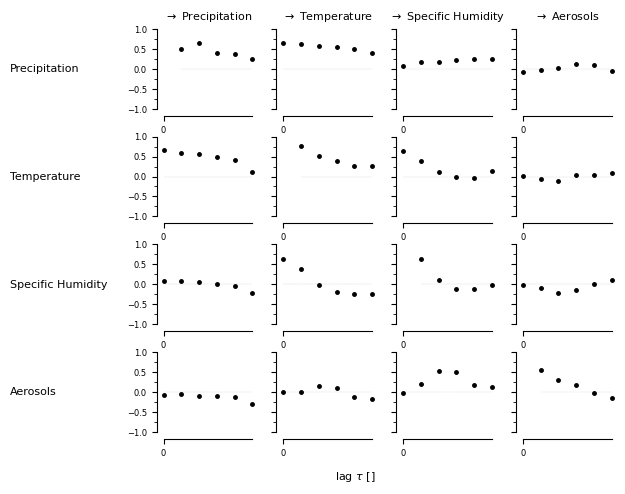

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


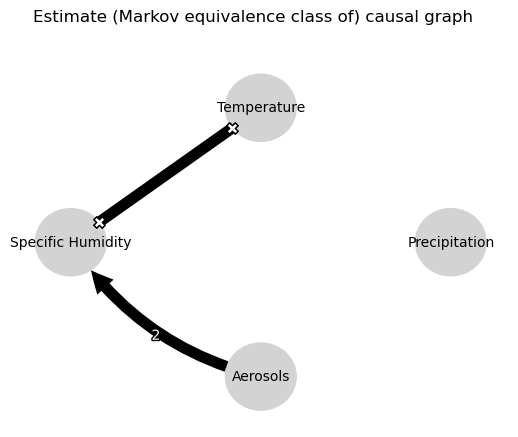

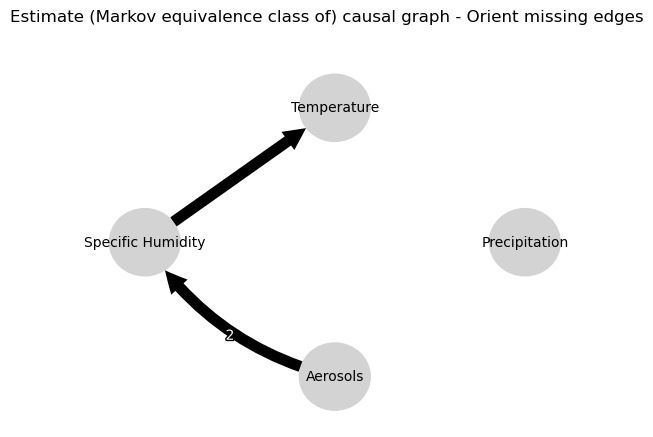

0.0
-0.020001096645935048
-0.021624025230778398
-0.011176460293478503
-0.03971707819189397
-0.008876841260934118
0.12947026031392112
0.044630450159250004
0.08804348414146121
0.041943813891457085
0.028570386157009558
0.04625401751886434
0.10770877667187884
0.04026620494496951
0.0684247696200086
0.0326986960700731
0.039527181487624595
0.03685921540570294
0.10180102396392644
0.0553255289345304
0.018040489852535587
-0.016883221023362413
-0.006019214905603504
-0.011865141609146125
0.12947026031392112
-0.032306440013916124
-0.04786962087748066
-0.03803167574315228
-0.055017535198124586
-0.05137059557979692
0.0
0.6257822552819488
0.4442455541279798
0.2977979404145208
0.1869712723179251
0.11247436883110865
0.7797675285971897
0.48039007127032574
0.32028651625481713
0.19268425303075523
0.10299552431502938
0.03662286349575682
0.029006197972564995
0.01175772240454663
0.00836054365447185
-0.009244277265548868
-0.02433076197917759
-0.020639849321245025
0.7797675285971897
0.5645346762312117
0.4161060

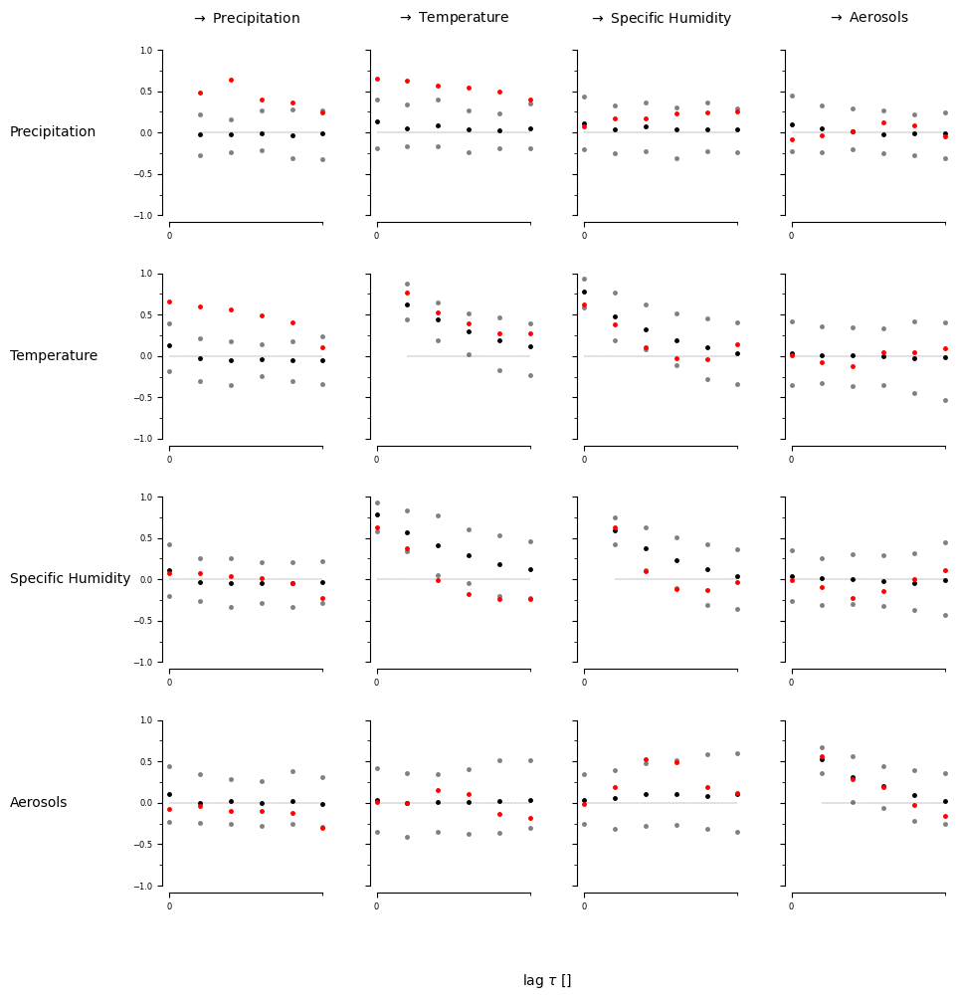

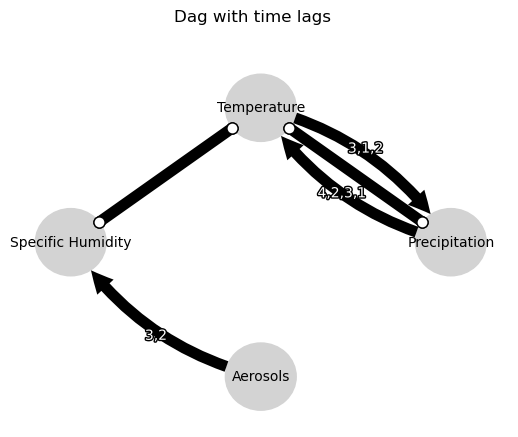

Negative precipitation values: 0


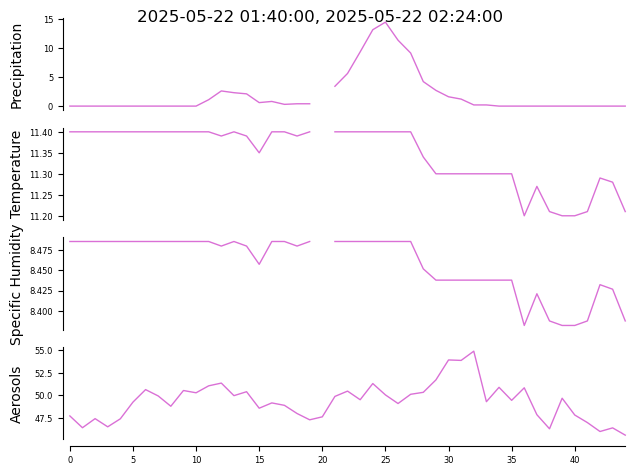

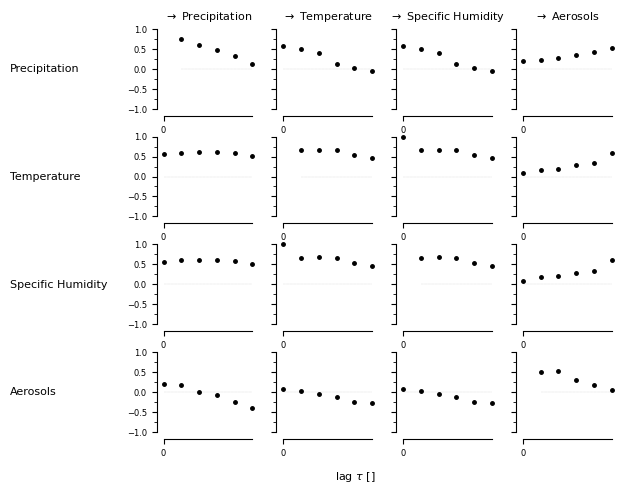

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


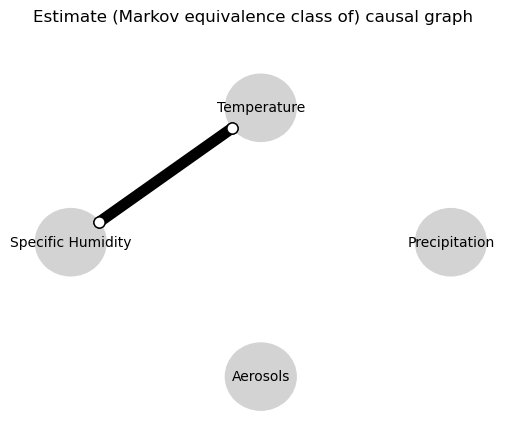

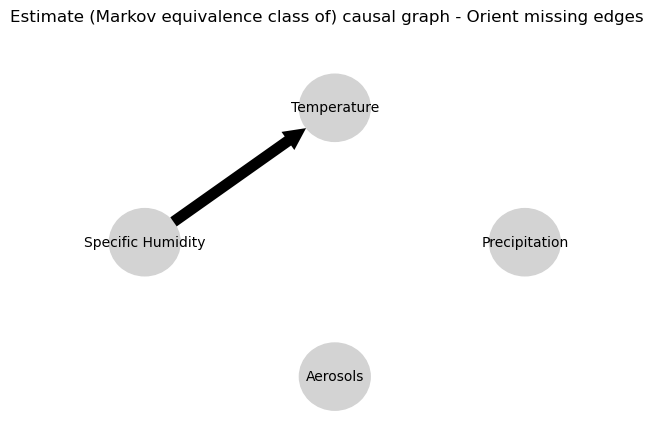

0.0
0.6719663654731168
0.5232141529915139
0.4012354756261367
0.31707943309087505
0.2334332727453782
0.10681932972384783
-0.006940893433773755
0.04402460497679906
0.004703095561692684
0.026139649602877152
-0.00874690386595336
0.10779491298032699
-0.009216611018549797
0.048605482580233825
0.006323005692047106
0.025230981317989308
-0.004681603968637137
0.03751356941307427
-0.0067944292684320555
0.04503000856045254
-0.01436603280124738
0.01776527575491285
-0.036195478253614195
0.10681932972384783
0.06997238404588646
0.05462339757414944
0.025462356324818435
0.061257260441052036
0.03650783327962084
0.0
-0.019354730217273564
0.008457442970663894
-0.040437848556436645
-0.005358087926722947
-0.045679797817051816
0.9827386079324881
-0.023377159556241887
0.009623190848839497
-0.040452048233738165
-0.003984383112527764
-0.04091057550359214
0.20921475389618713
-0.026923331489434047
0.09893272830625238
-0.023843168101227857
0.08740674572595095
0.011623323270184859
0.9827386079324881
-0.0237889690430

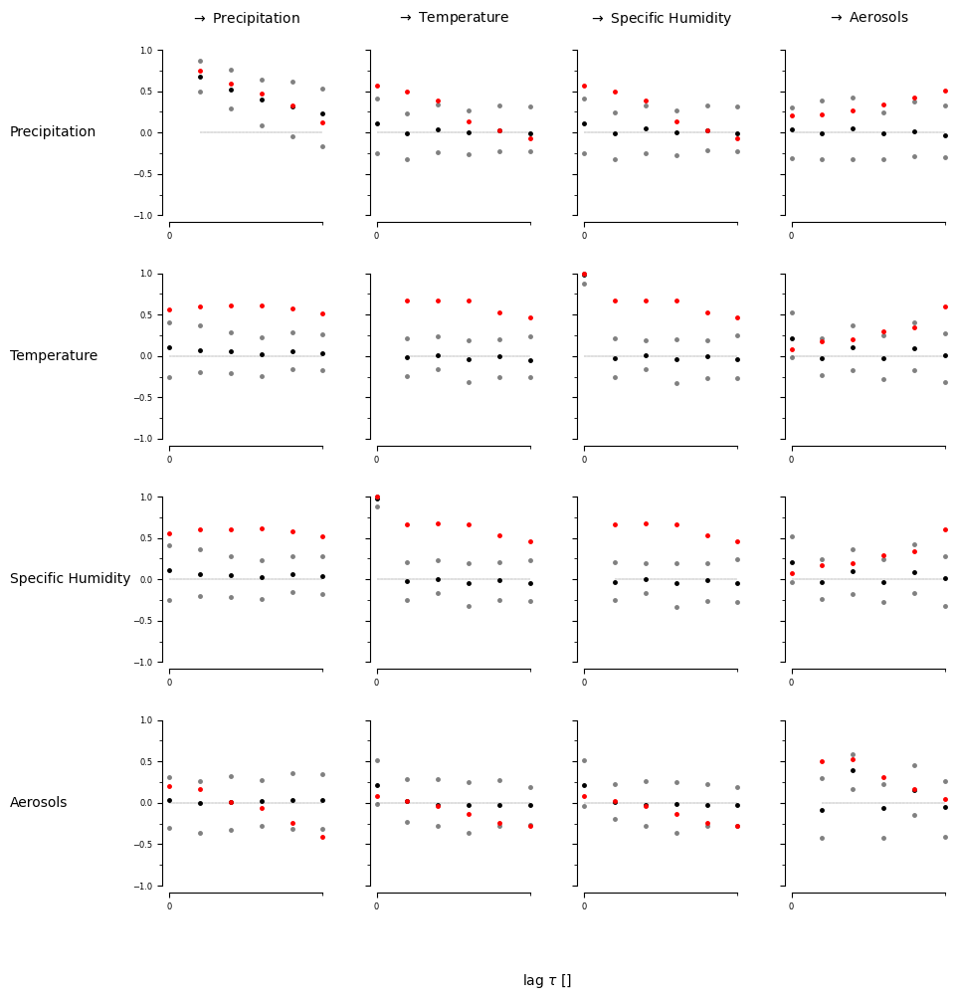

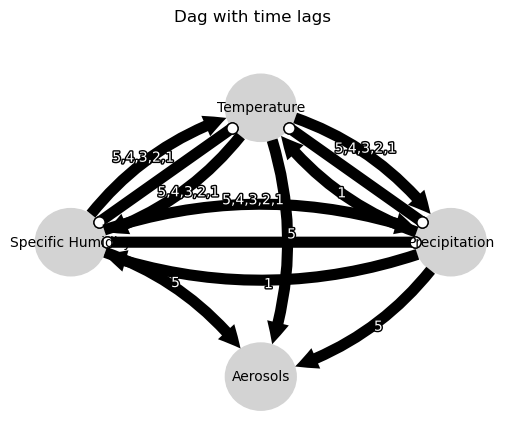

Negative precipitation values: 0


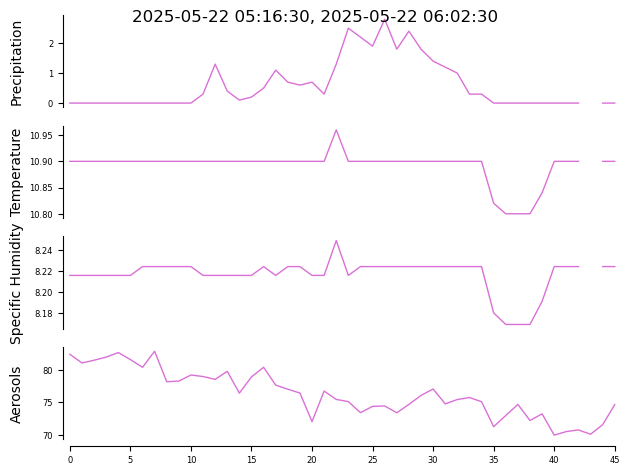

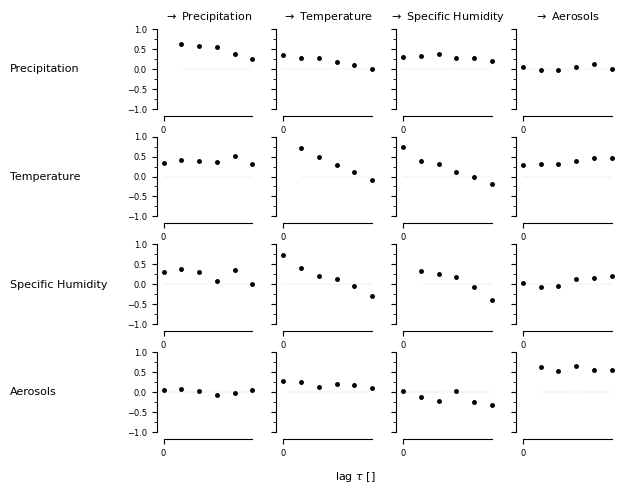

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


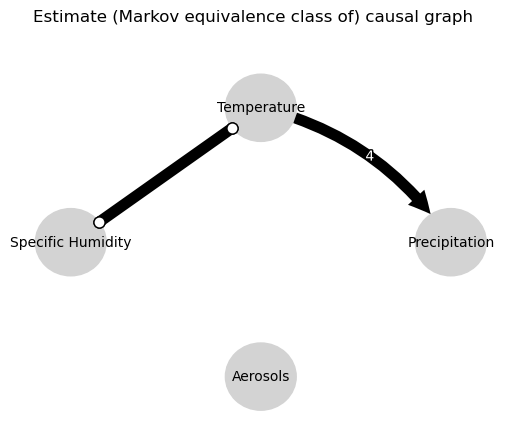

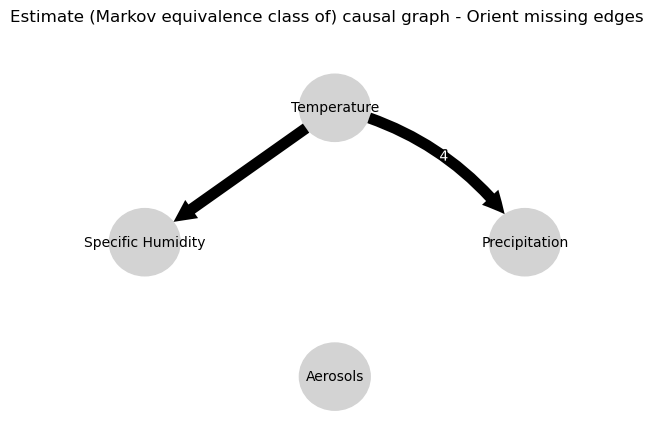

0.0
0.04847920646440554
0.02600429096676239
0.009524688710566755
0.011880594310402011
-0.004667315165554859
0.16026188811486905
0.09321144565892571
0.02384439250639244
0.018749943345494742
-0.03331537456256492
-0.046789583181727316
0.17382561389335527
0.08656229145501321
0.03206398525358596
0.009981226890870394
-0.05502856669156587
-0.030848107323386803
-0.24167643681076753
0.021474494825277954
-0.04589230588466622
0.01453432050606969
0.012478735180701458
0.022766357999087036
0.16026188811486905
0.07479827606285656
0.15161808083546588
0.2079491827884133
0.30785705625111953
0.19408491301336073
0.0
0.5614170044487258
0.36294208797322874
0.21110151220633105
0.11289909336947498
0.051790042928761194
0.9383493114306799
0.5336737214953962
0.3461020834652954
0.1924253213701154
0.10732950878505919
0.044484051767432094
0.07636500436010613
-0.04117261639164089
-0.013908111553199397
0.0007307636091818001
0.01746807316959907
0.01290706951947119
0.9383493114306799
0.5605158149772597
0.35810140447073

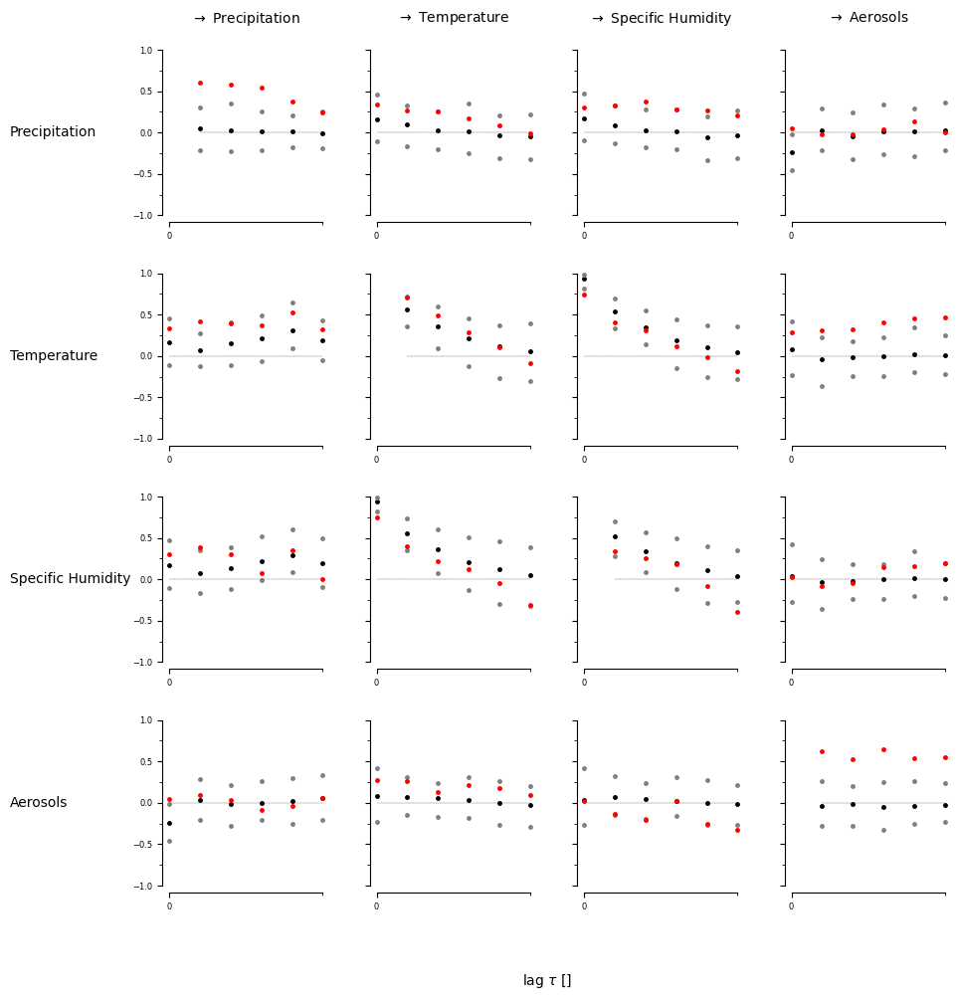

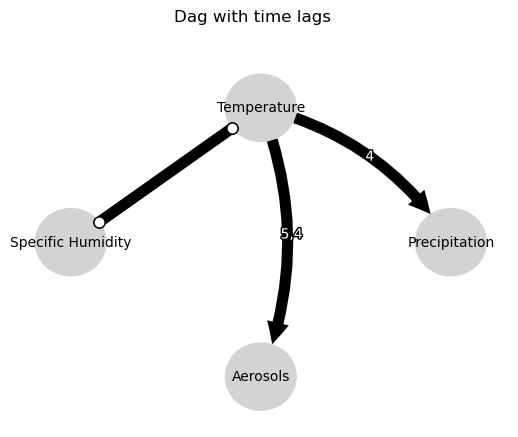

Negative precipitation values: 0


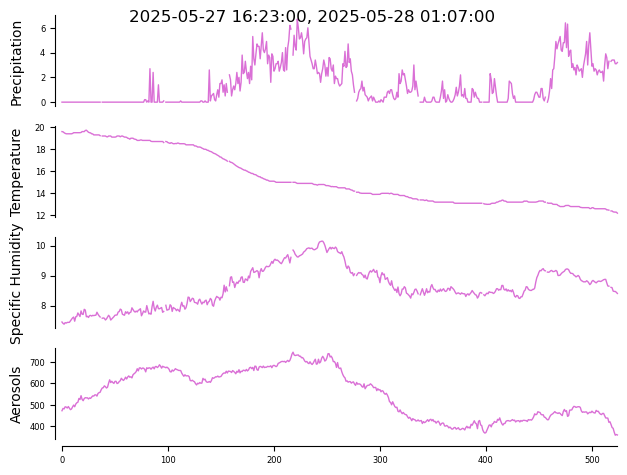

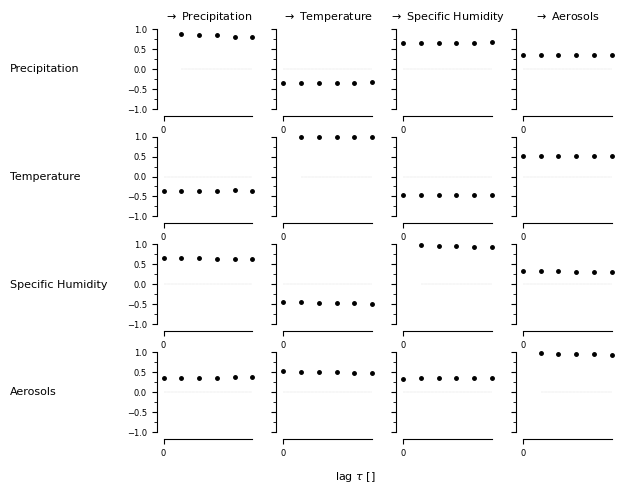

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


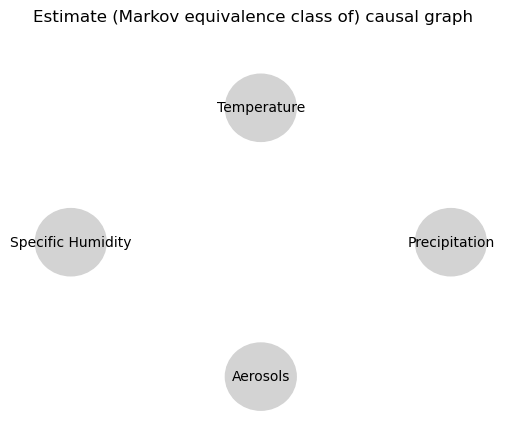

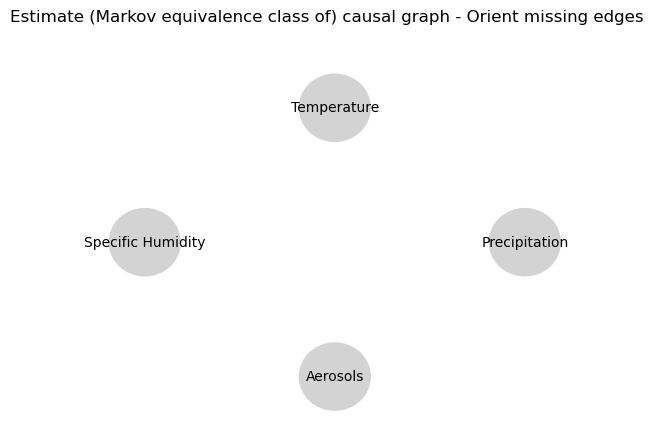

0.0
0.8718791298903069
0.8459188713940484
0.8296913340807515
0.7906752754267738
0.7620661676276351
-0.08618479649933178
-0.08721858818607052
-0.08789820192929884
-0.08788256743592487
-0.08819628802314386
-0.08902428935005086
-0.018523574448314224
-0.017733520949375886
-0.016471970245998377
-0.015525253303810691
-0.015084467749797626
-0.01511181626514083
-0.13959450500197723
-0.1397862675432853
-0.13898882832860632
-0.13885114701775733
-0.13820835248886132
-0.13844565968562095
-0.08618479649933178
-0.08350503357006053
-0.08195865151419705
-0.08011214337196593
-0.07818119245070519
-0.07695631928751298
0.0
0.9800328734361509
0.9623784501383092
0.9432943340109393
0.9246926364076441
0.9071879047770185
0.2185488681638408
0.2109369885608615
0.20358525190780913
0.19681619388822266
0.19005879522817218
0.18385313026296093
0.056524776898291815
0.0558453816391114
0.05506972704634037
0.05476832386786906
0.054529455286600366
0.05378765449214376
0.2185488681638408
0.21715798994731728
0.21489538388332

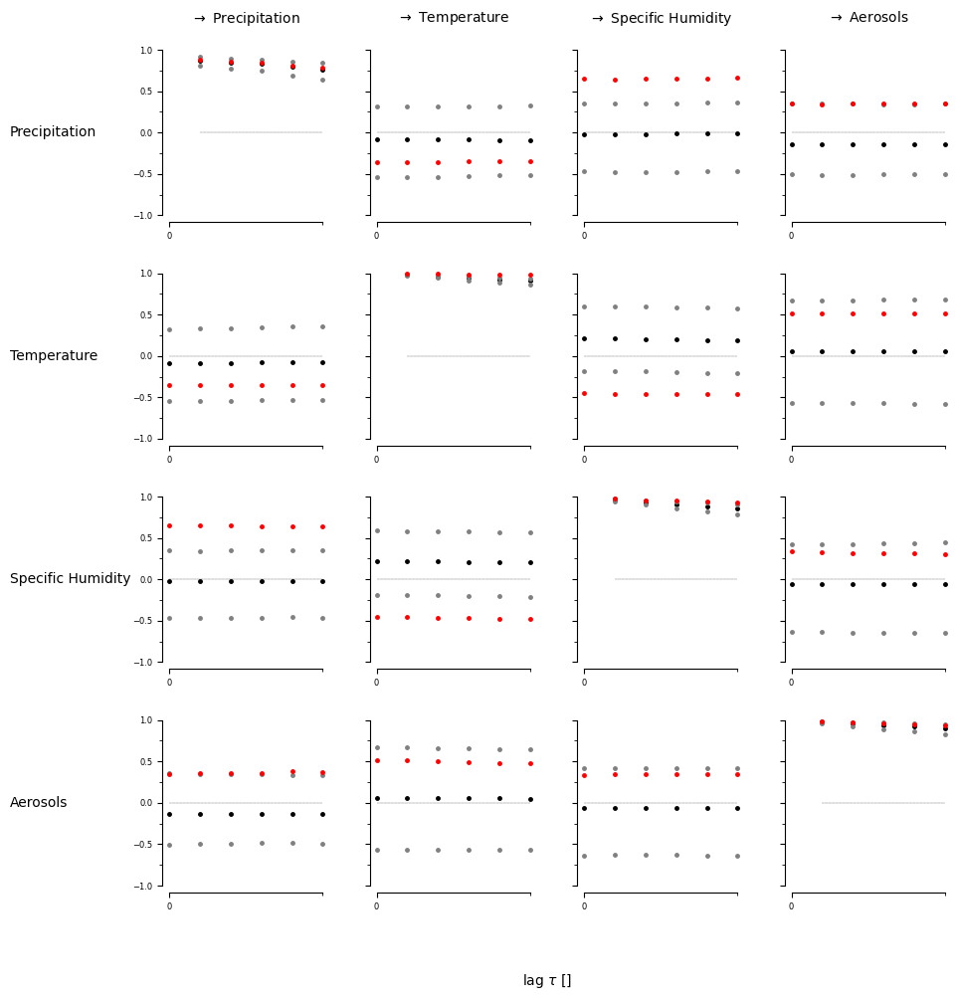

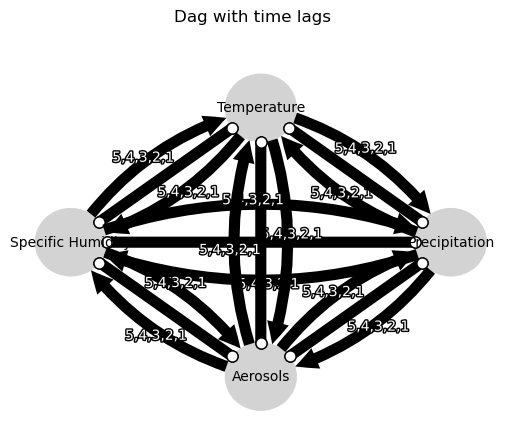

Negative precipitation values: 0


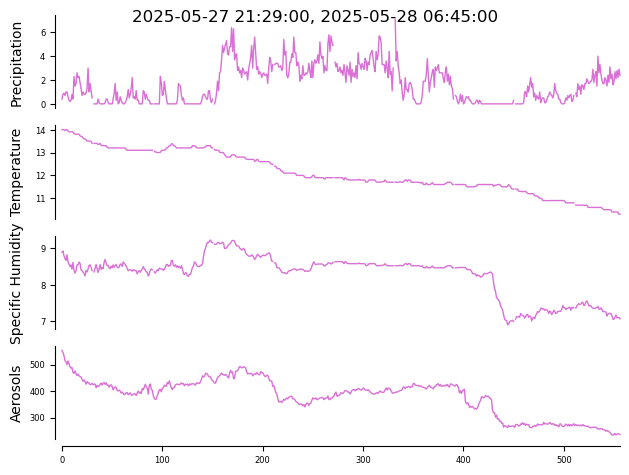

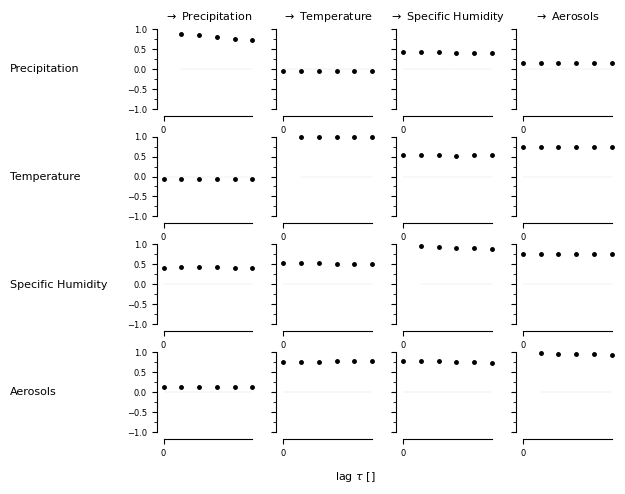

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


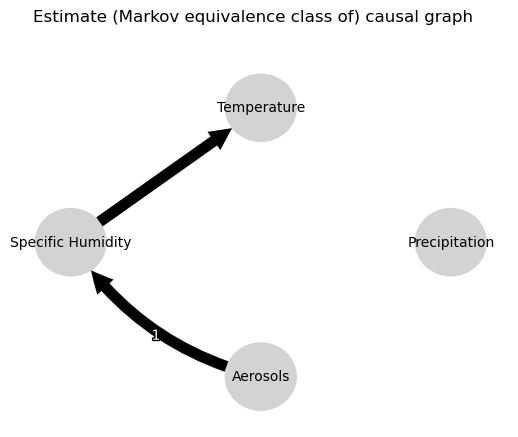

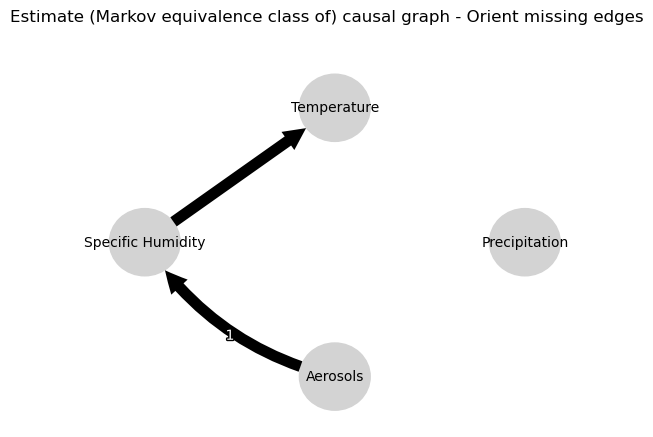

0.0
0.8656399369252932
0.8414666016903695
0.7811660473698661
0.7405463214578909
0.6961836149487529
-0.06504671200089392
-0.06303733583702335
-0.06153820475679626
-0.05994257059051326
-0.05827693700519787
-0.05717957689574659
0.00783597988608458
0.007171149039223906
0.007753360335545181
0.007505447266585891
0.005957726009401762
0.005315445384602415
-0.04434927748965481
-0.04366669294342228
-0.04152090409905744
-0.04135492725678181
-0.040244661824614086
-0.040330210410508466
-0.06504671200089392
-0.06054890162785551
-0.05878240198327582
-0.056229351821747625
-0.05445886803820195
-0.05285814911021877
0.0
0.9791012457160546
0.9650678836271013
0.9523652100880843
0.9404350990875963
0.9296466922896021
0.3297995705100319
0.31501331482986394
0.3014009587933837
0.2879080870042528
0.275492779994267
0.263565411793818
0.020235356173637947
0.015630651504050894
0.011234520727963191
0.0069601443876437415
0.002414210427401715
-0.002403230403624208
0.3297995705100319
0.3339169176501516
0.338461016649809

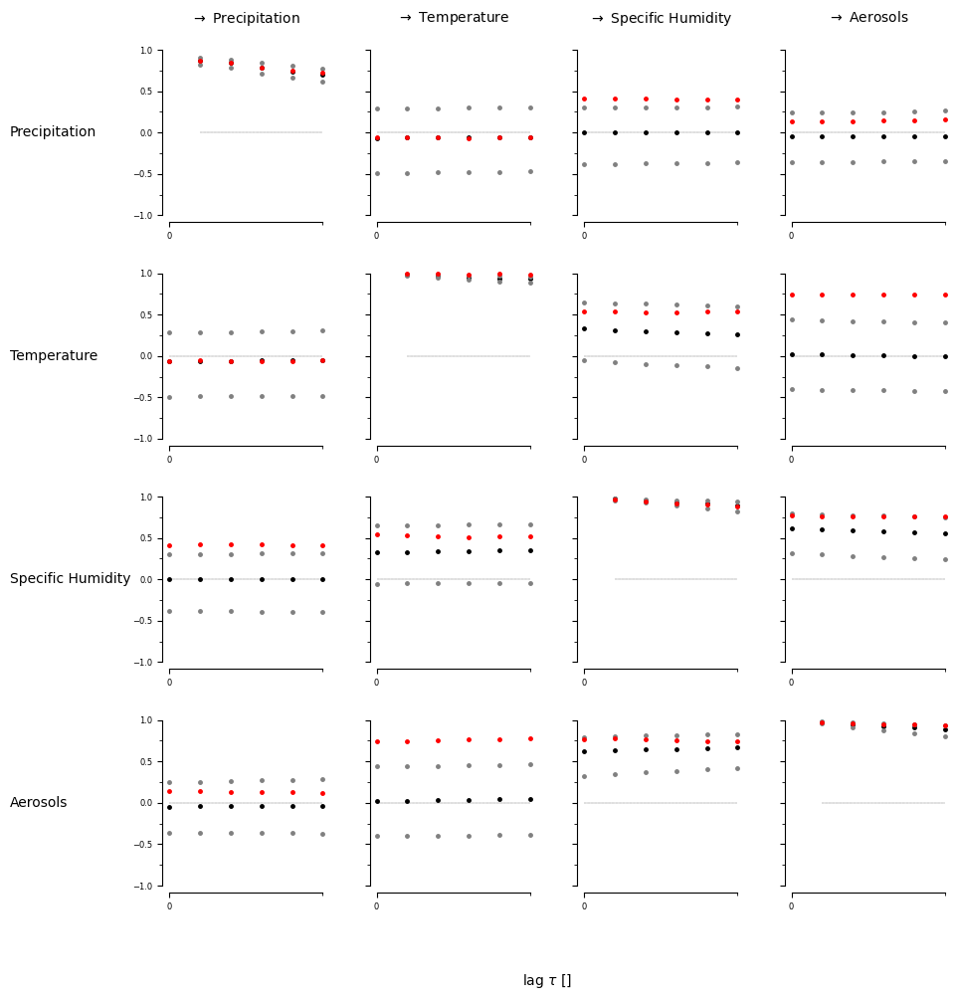

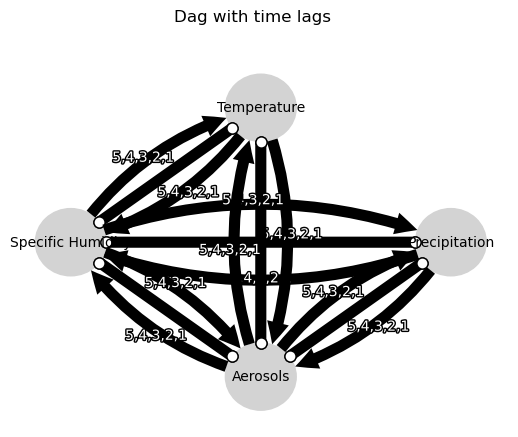

Negative precipitation values: 0


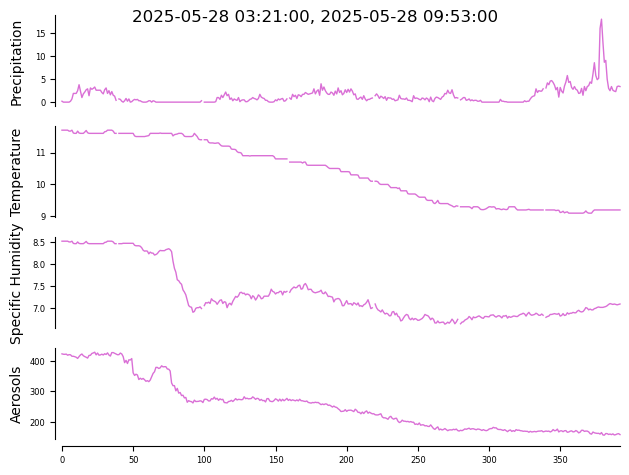

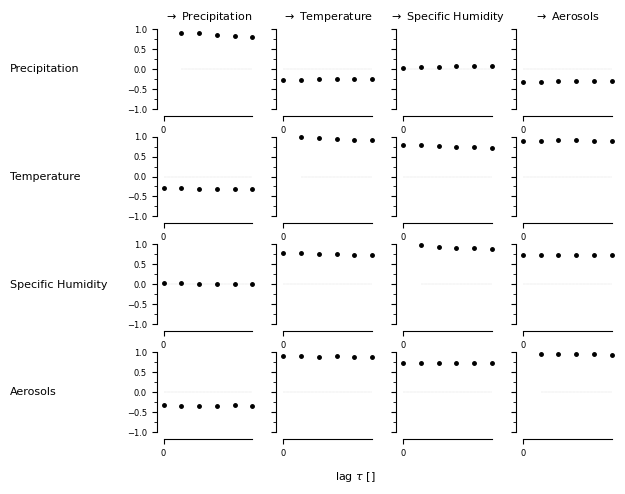

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


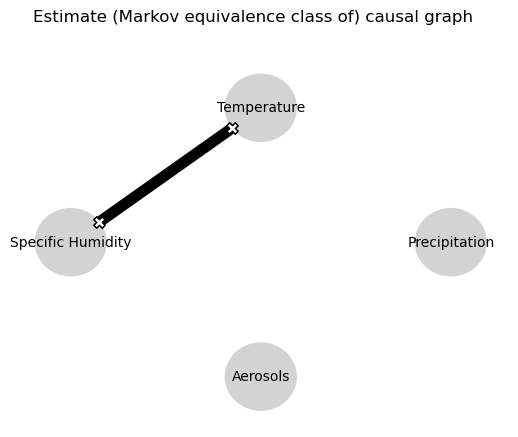

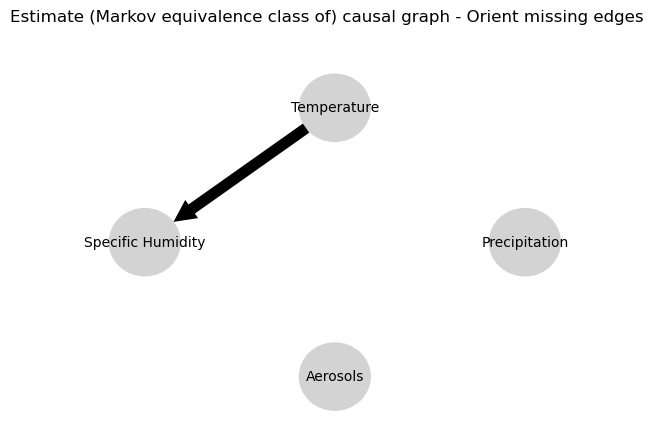

0.0
0.8662693541411012
0.7491061043020508
0.648393116563729
0.5624196843766046
0.4847313524800934
0.014515878230787364
0.014075314520280567
0.013405155796095787
0.011602225912095507
0.010020356563774757
0.007905822568304542
0.005195256019620322
0.008285789011873334
0.012457073955426367
0.015396471310896435
0.01756255537753619
0.01883368221142345
0.030820308250244396
0.03251201529379919
0.03362840316241748
0.03305478711520902
0.03092923871535152
0.03085081651320938
0.014515878230787364
0.010495405057184404
0.008352512900227036
0.006321374626469479
0.0036922427901703164
0.002116746080046164
0.0
0.9631561365769252
0.9376728139904569
0.9154309390581432
0.8946437439442245
0.8751346569062403
0.024449924915574153
0.013815750398281267
0.004666244550872758
-0.0034353845041187126
-0.010962779627399609
-0.018278130526427135
0.022246256581847562
0.020947671023582776
0.01951568788757804
0.018118555921138257
0.016680390298970598
0.015158315797942926
0.024449924915574153
0.021344012395851274
0.018692

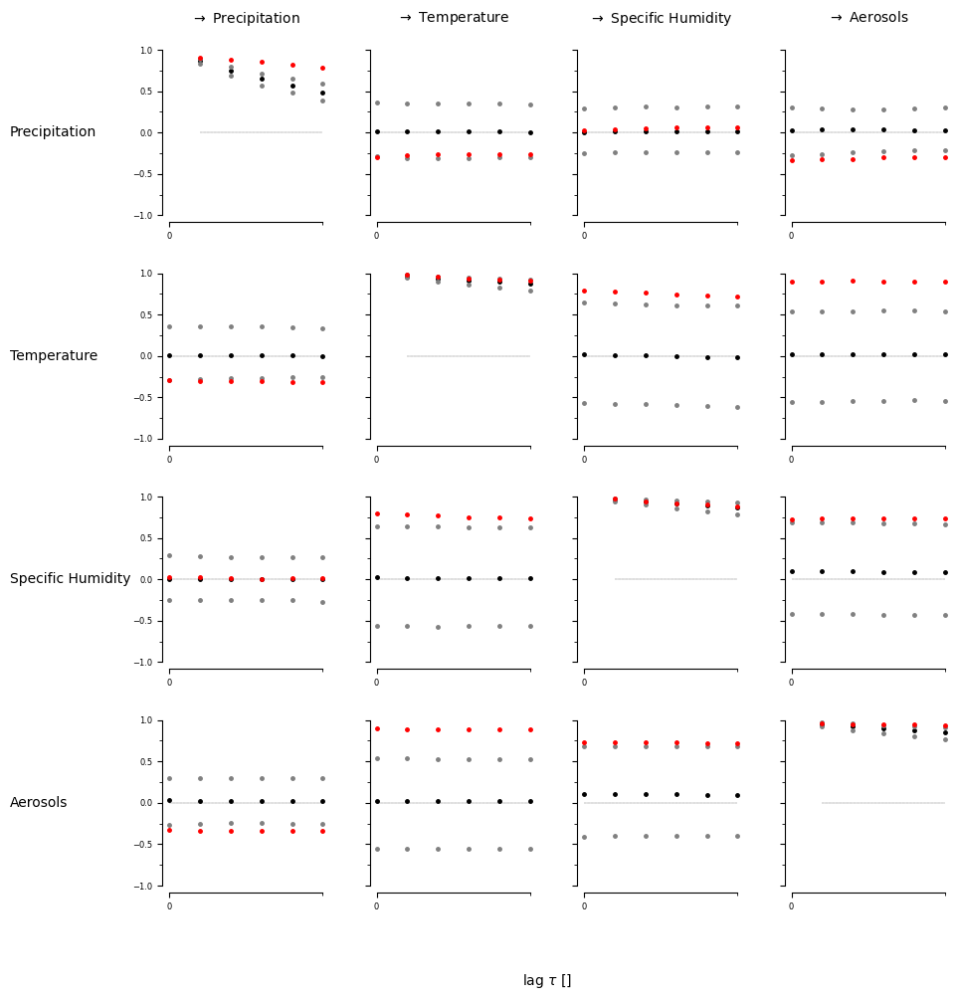

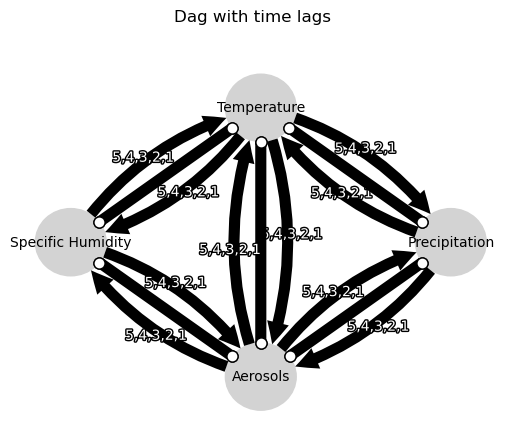

Negative precipitation values: 0


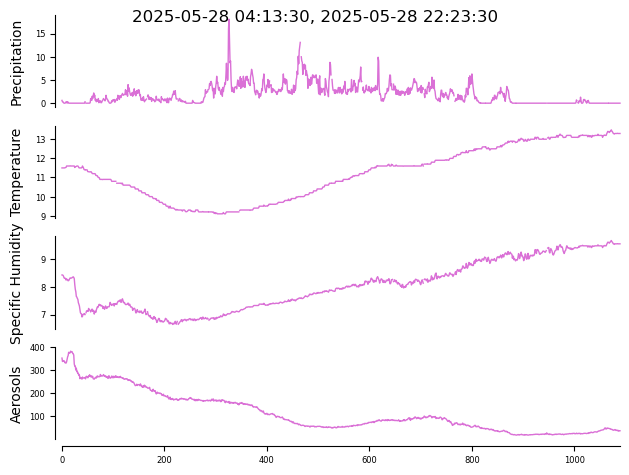

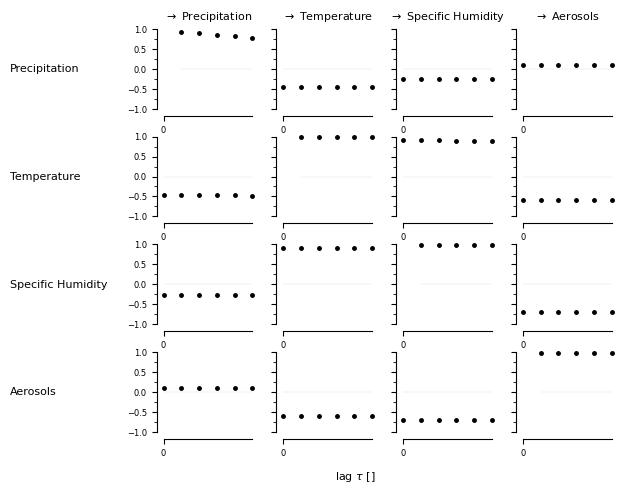

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


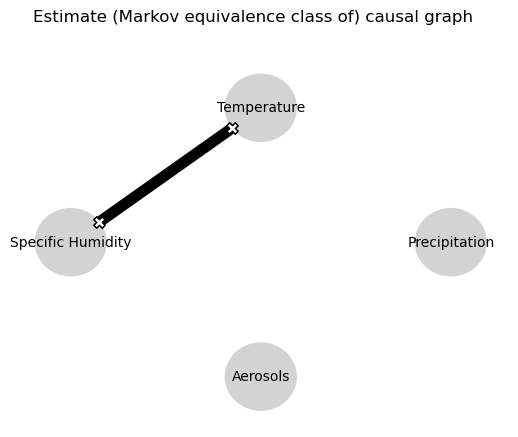

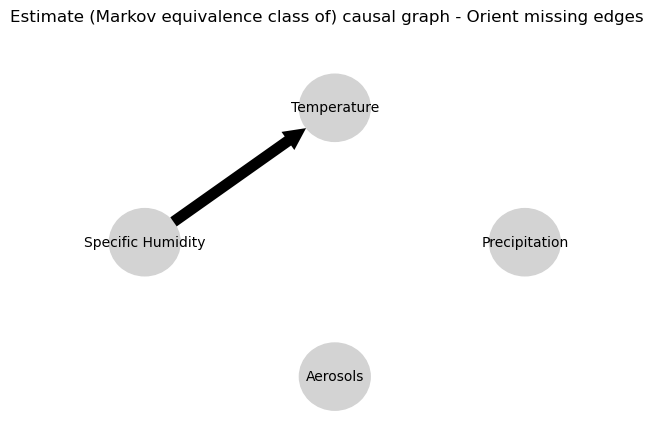

0.0
0.9075825111641295
0.8505878308600526
0.7931107081585782
0.7413899964209869
0.6916742251577014
0.04996544428891217
0.04999118498735612
0.05021509388236011
0.05063914898238193
0.051045519405254286
0.05123745704332406
0.061823377075114434
0.061615281285652884
0.06124464630492238
0.06165544962755203
0.062201139411857564
0.06246563788019871
0.021722160668307268
0.02102900015810232
0.020117146594009316
0.019167497345107407
0.017514277914708908
0.01650660035099652
0.04996544428891217
0.04767718147545988
0.045849793636051434
0.04437087653535893
0.043098565919188946
0.04164847985162424
0.0
0.9919370354198006
0.9863455825634249
0.9813776482325974
0.9768172979966383
0.9725904056593596
0.8669107219574238
0.8581518795036998
0.850671142633573
0.8440886183583303
0.8376977956604676
0.8316032791566559
0.039927722832078995
0.040015311003588315
0.04036865936959004
0.04042408801303621
0.040621854177907084
0.04075884062080773
0.8669107219574238
0.8677252477073119
0.8688647274553196
0.8700008915930826


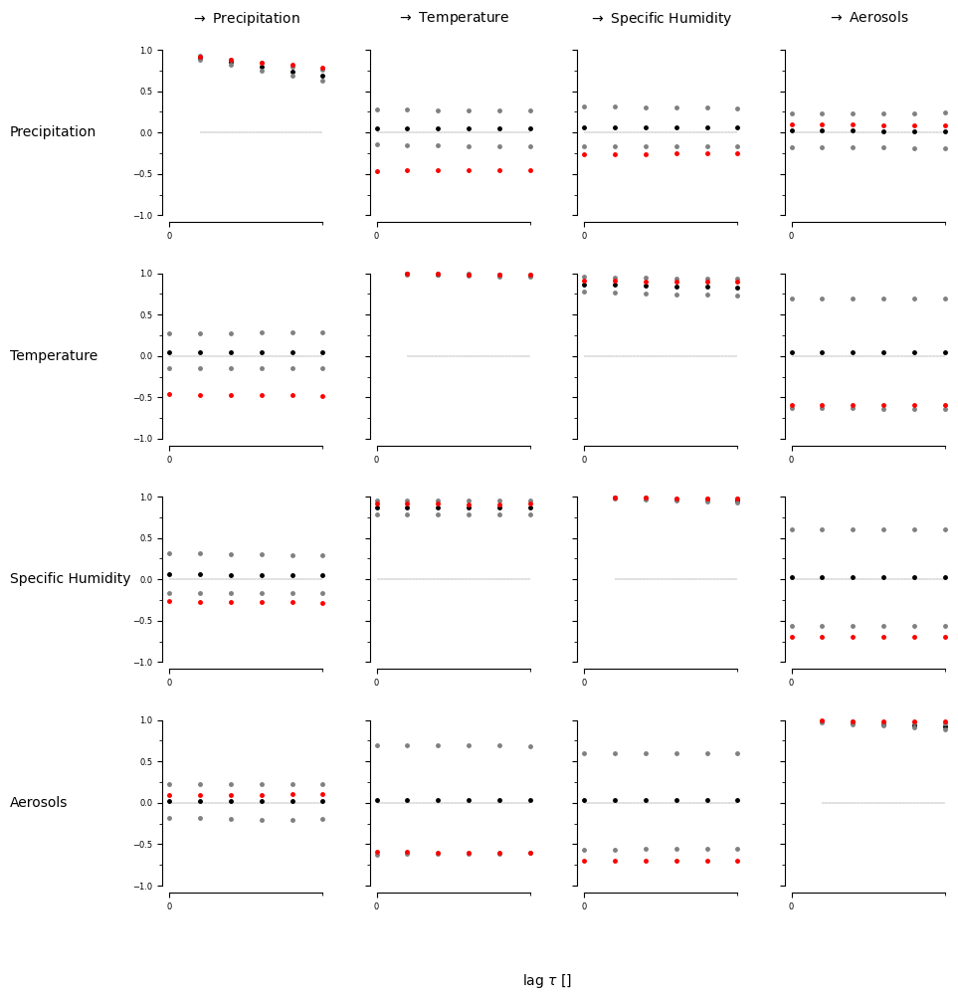

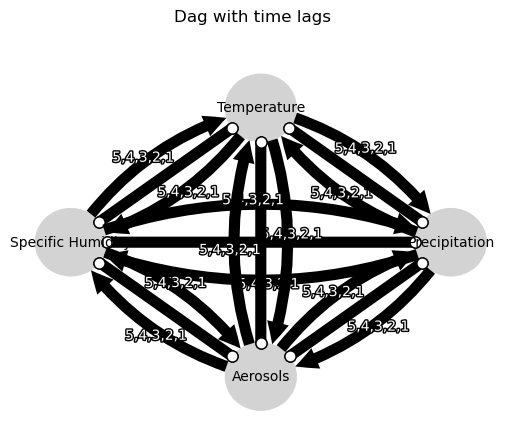

Negative precipitation values: 0


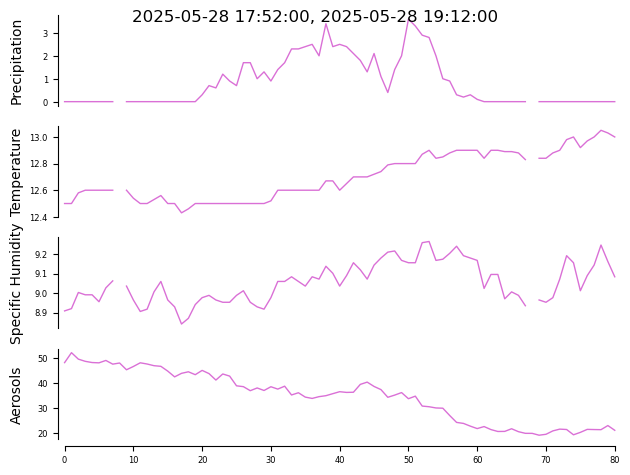

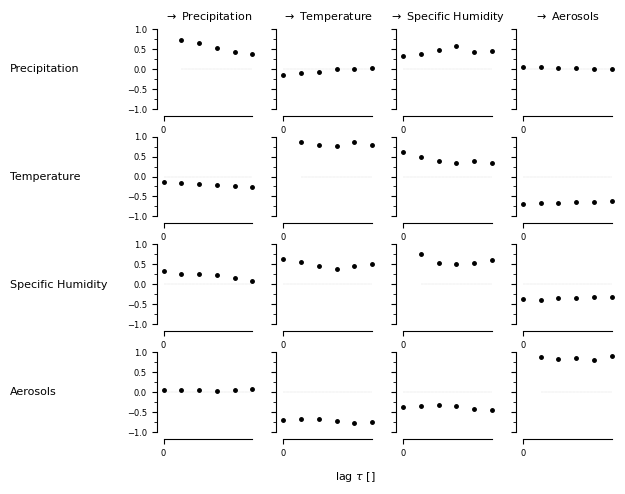

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


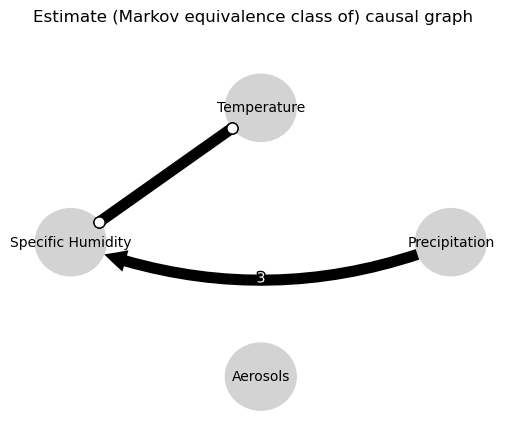

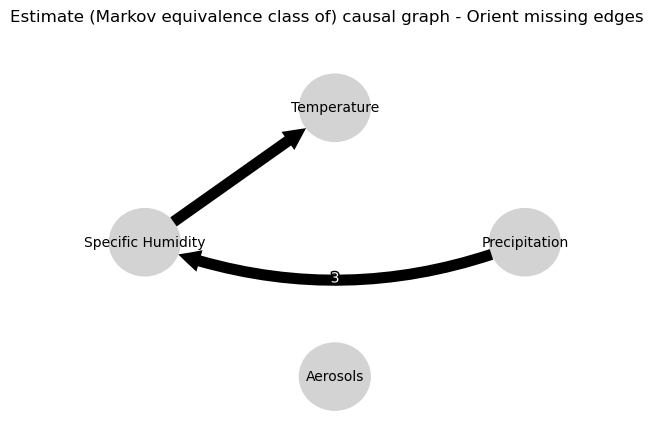

0.0
0.7710636486919927
0.642065982997311
0.538041329408679
0.4513904239918187
0.3736481005816963
0.12375549874884785
0.1297786051530878
0.14030563380477631
0.17082819211905906
0.19584152623222692
0.22308796440749024
0.29624228526845187
0.29003771798829814
0.29813653955983876
0.34196947523789545
0.35943299920464516
0.36548444520787465
-0.020422427313817985
-0.0214191147923416
-0.013372091842835374
-0.0021407760618206663
0.008635973221094474
0.005121080804140386
0.12375549874884785
0.0801975968907291
0.05072529385272275
0.016372852548387773
-0.025077751732636076
-0.052714868776811585
0.0
0.816456558474384
0.7082996579393349
0.6436931180045237
0.61651200284372
0.5490738646526087
0.5439860108172072
0.33239506930479457
0.17952269912222882
0.07636037741415018
-0.0031518727270460844
-0.06571171998610309
-0.102793214942901
-0.08567915055532214
-0.06507519980893968
-0.057332766960030125
-0.04431857443488121
-0.03142029919400045
0.5439860108172072
0.5346269404770898
0.48853081993366076
0.4771430

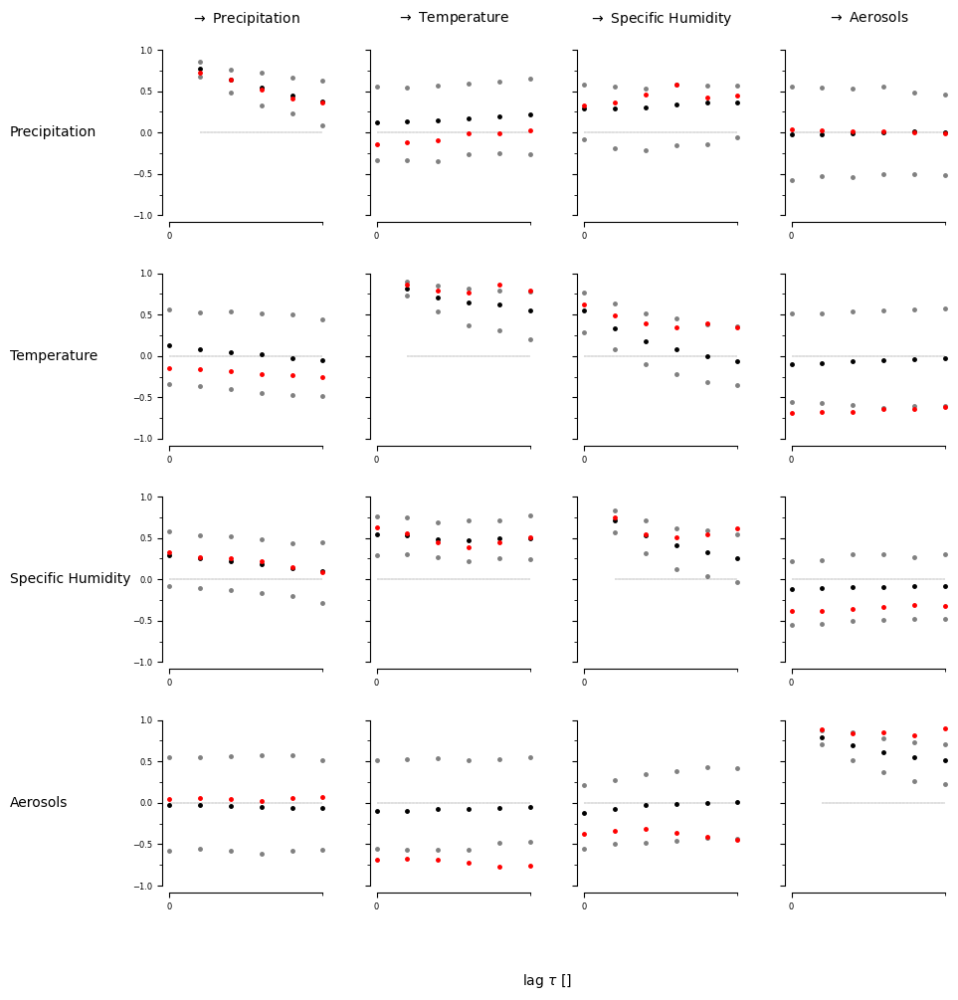

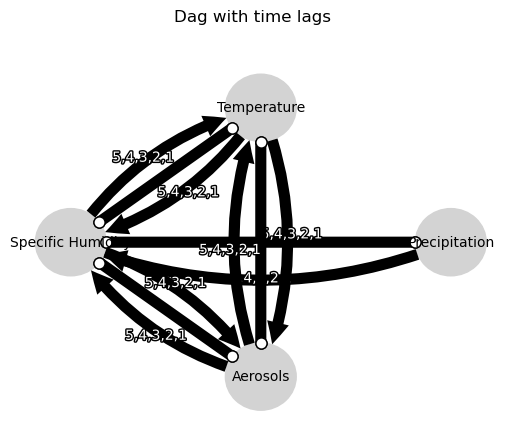

Negative precipitation values: 0


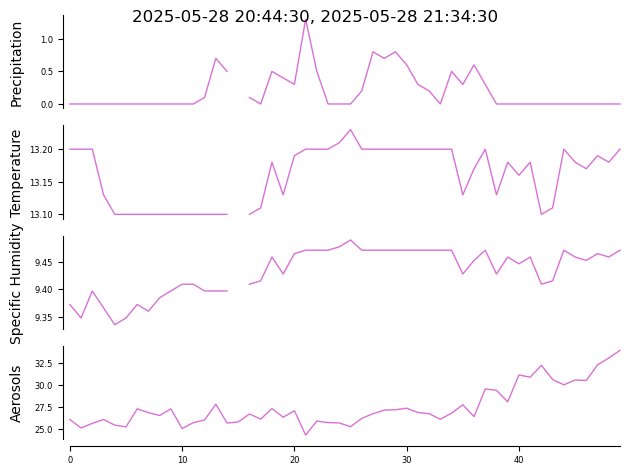

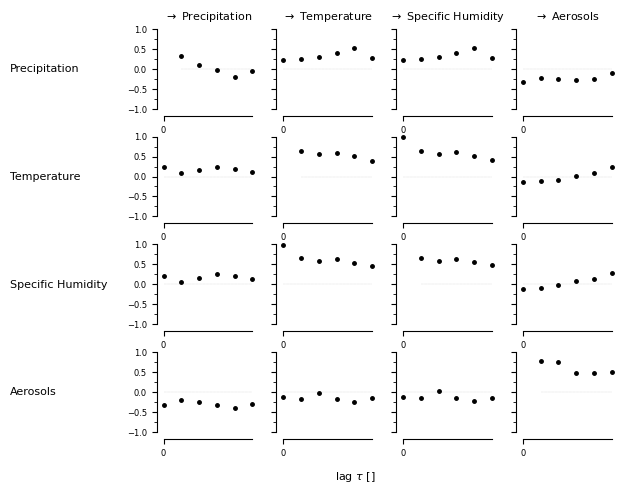

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


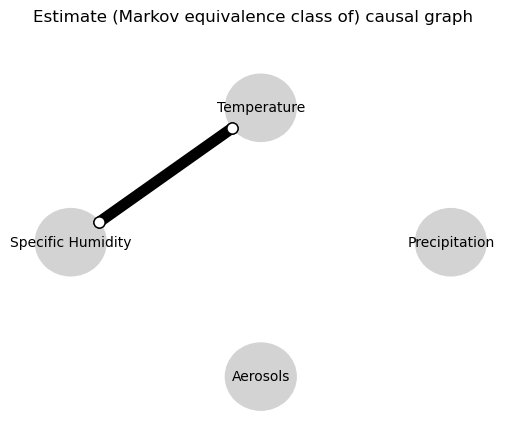

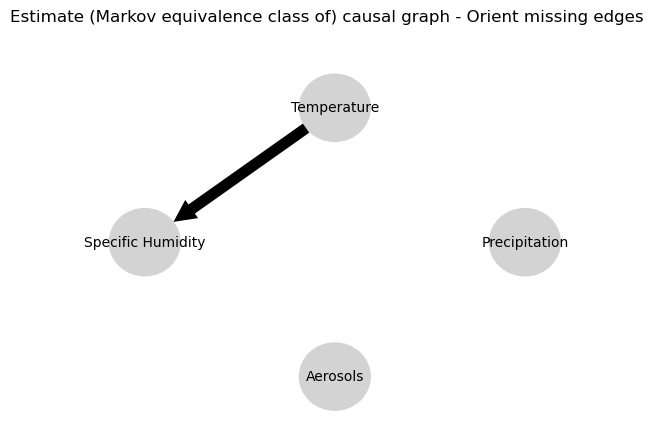

0.0
-0.022812751858382482
-0.051805524894649714
-0.014997894263461396
-0.03401272950846619
-0.03552803393080552
0.2670032835486685
0.012518351618667576
0.0246070090873001
-0.013510848837837828
0.011821970489916636
0.002333825485773867
0.2749381367416492
-0.012975535212189365
0.02719632661908165
-0.01403273270305835
0.02959262453901839
-0.004787182985961254
-0.07075876853503854
-0.044990316071201526
-0.05918989037318199
-0.04280348044928932
-0.03285256955995354
-0.01905056821798687
0.2670032835486685
-0.0067328811960079725
-0.01872153421610705
-0.001286423293394117
-0.027832909099384063
-0.0178037518286109
0.0
-0.025630288885453923
0.029857679774219312
-0.027139944453629297
-0.00920140792696367
-0.04878766429041716
0.8908692310612046
-0.02226907797422314
0.04279083326994087
-0.028784396512990154
-0.020047132944799192
-0.052926258017824246
0.017725048926608093
0.025436841844312167
0.011346244172461608
0.0113681330568801
-0.0012995791957330057
0.009206243428387136
0.8908692310612046
-0.01

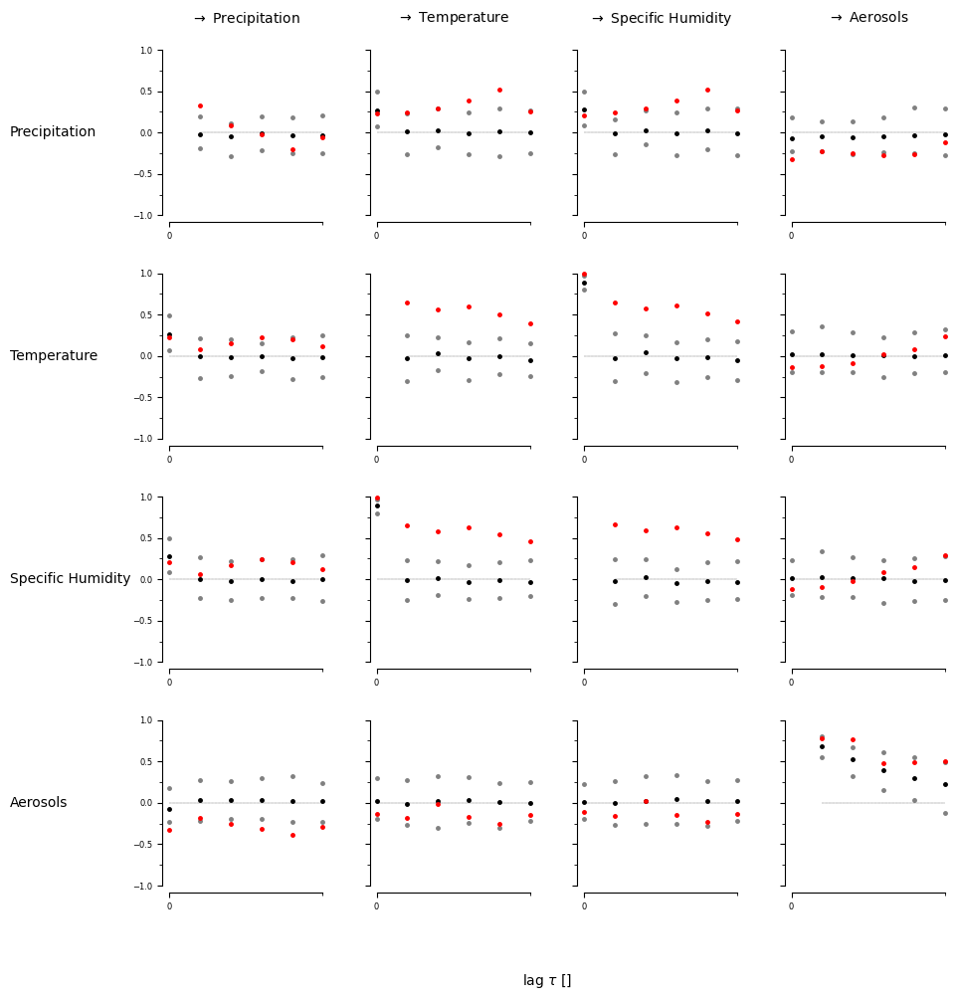

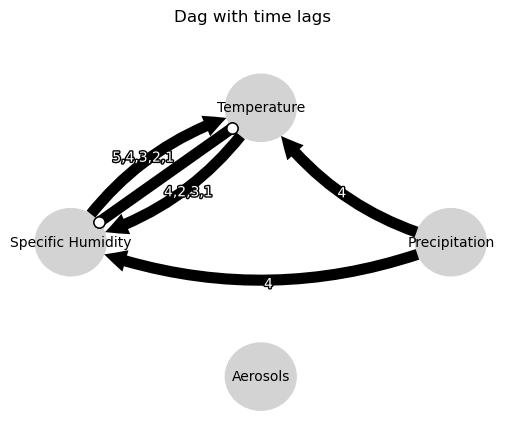

Negative precipitation values: 0


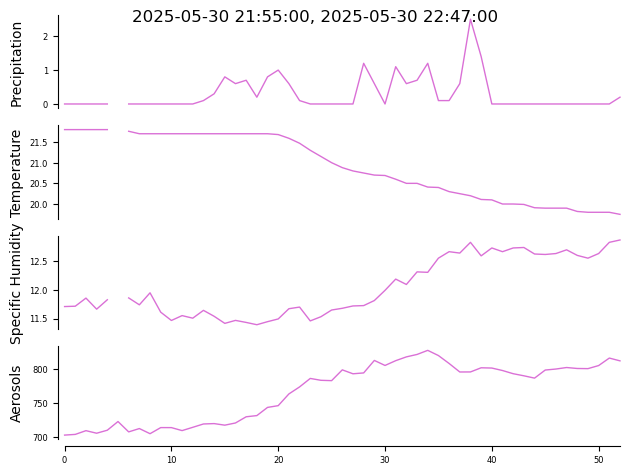

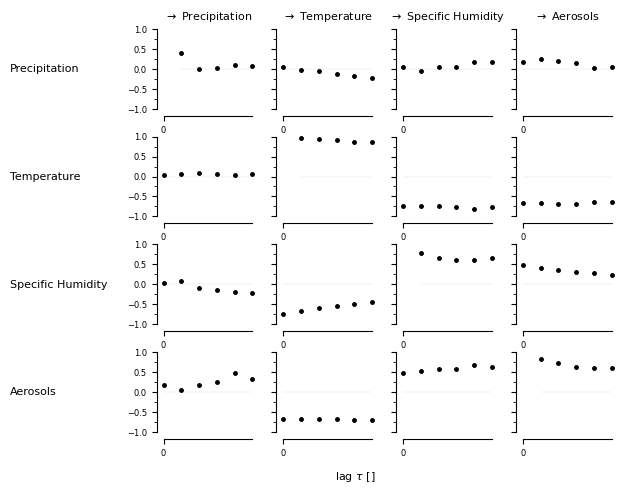

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


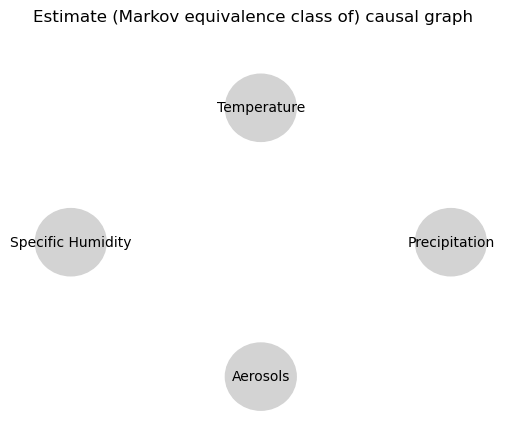

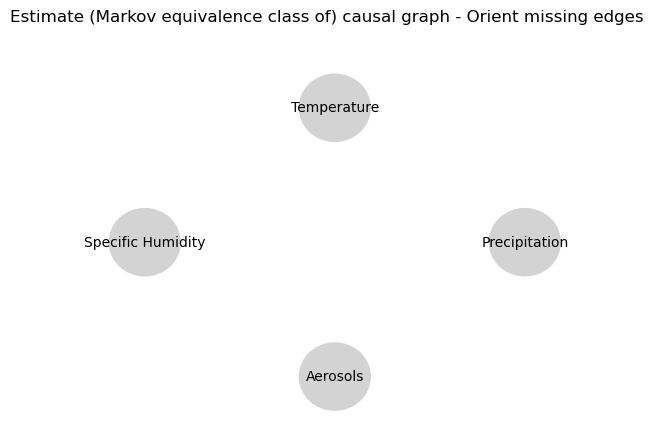

0.0
0.009010263740968331
-0.048205184128250124
-0.0294774061014168
-0.014498788445199069
-0.0018385234124288178
-0.03307211196918081
-0.021373031754049837
-0.004061482566775687
0.0156900864170973
0.0018636628362701754
0.049866767093303295
-0.008993257316969703
-0.003959864503572997
0.0022708415232184243
0.0002537789854127967
0.033821415514728795
0.022314140211304324
0.015117896330871317
0.03715389968999102
0.022330142723567658
0.02232290724747223
0.0014572046841918262
0.005083213506072242
-0.03307211196918081
-0.005450644338199263
-0.012385328975066048
-0.005235887821067262
-0.013397897077955944
-0.031498778639918304
0.0
0.7571245432341723
0.6365094348068233
0.5583079233633207
0.48068696802223765
0.4279092474492678
0.2098193092052315
0.19477180856176587
0.18068262980626743
0.1485161596643435
0.12503458452586222
0.10402382652512651
-0.09638538624155212
-0.07246155087096183
-0.06301343129672889
-0.04734815360309194
-0.028317373999017886
-0.01663790732413967
0.2098193092052315
0.190189947

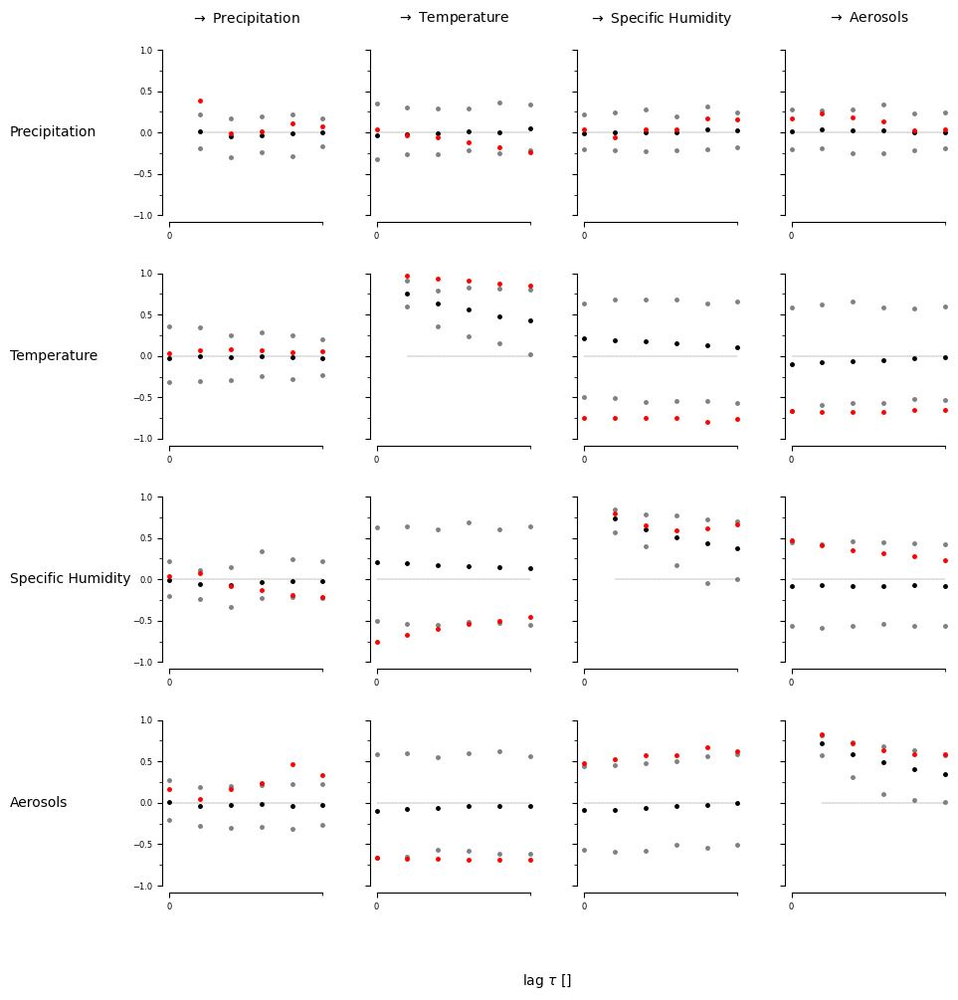

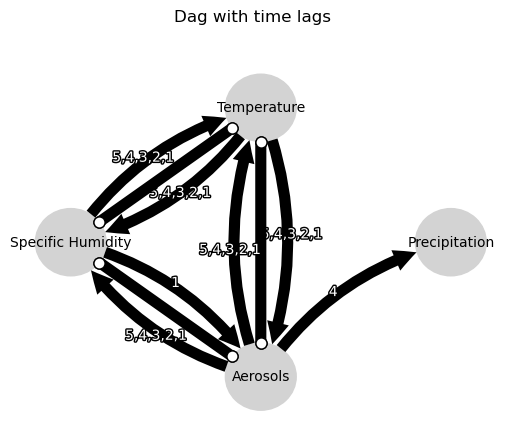

Negative precipitation values: 0


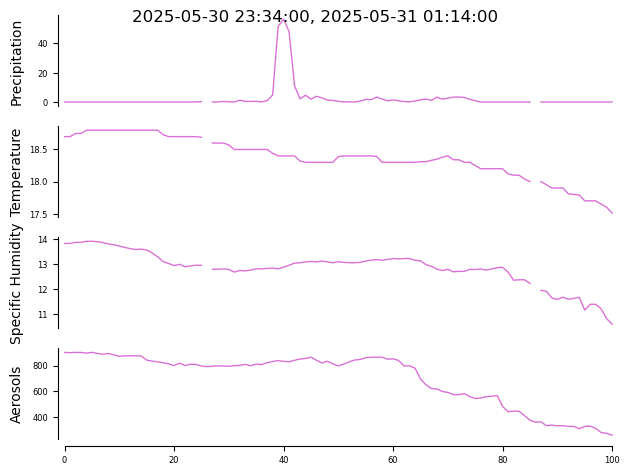

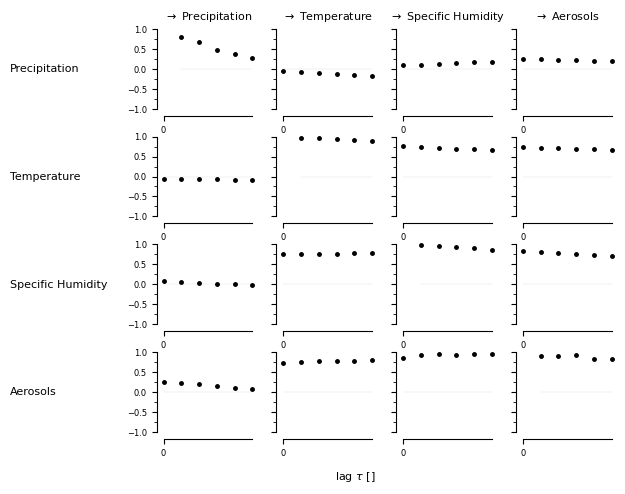

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


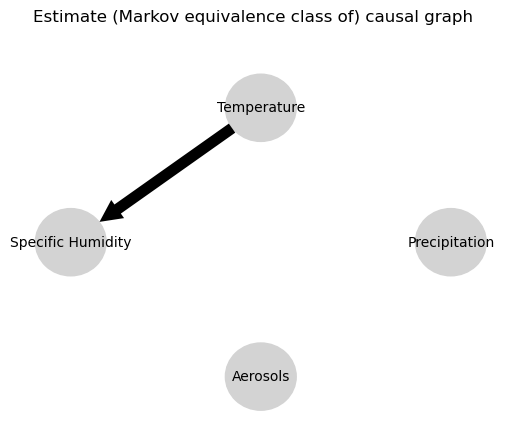

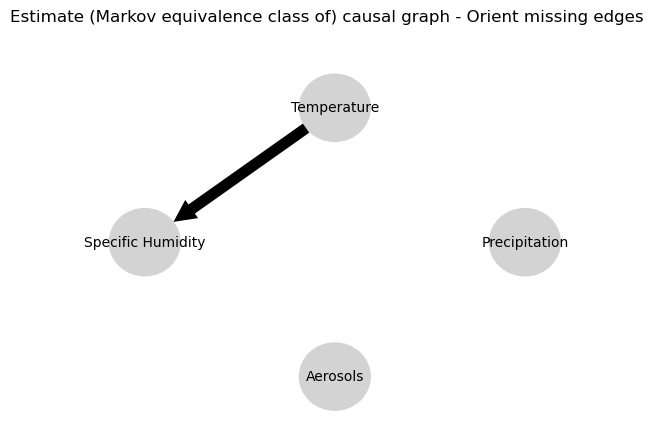

0.0
0.6896211906233625
0.4867458750729451
0.35390697543322763
0.24388923784843947
0.16728652900447671
0.032408727115178254
0.04041743965804202
0.04263393894279791
0.0433926656534009
0.049200364337509274
0.04797076947029514
0.04352001014943221
0.05283981749252654
0.05458912951255508
0.05490271781736087
0.05976108613432102
0.055027936472091116
-0.05645830467926815
-0.05865224713369981
-0.05741291387463607
-0.058110820570932545
-0.03935102798616737
-0.03937852153188387
0.032408727115178254
0.037258633522432805
0.03789949673320442
0.037060224204520556
0.039274207254307386
0.0377917914754527
0.0
0.95564690779136
0.9419950847122321
0.9315876927597604
0.925960481934441
0.9122105523325892
0.9049442237894693
0.8958227481021963
0.8877554468175133
0.8873740636184466
0.8850114881067696
0.8743390586930214
0.059135656242849916
0.05664202716323846
0.05513760354464212
0.058489393717713015
0.05568349220221874
0.059838943553868346
0.9049442237894693
0.8981630654275157
0.8875582917323019
0.88302873684239

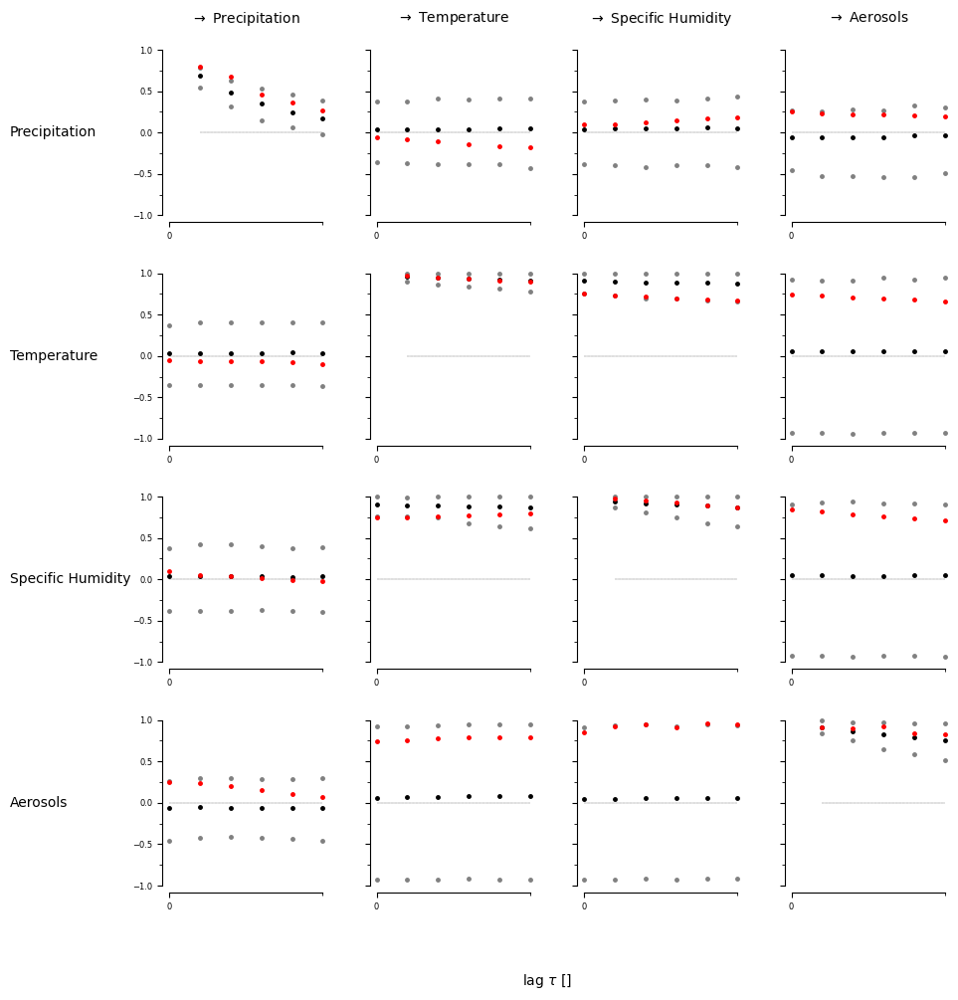

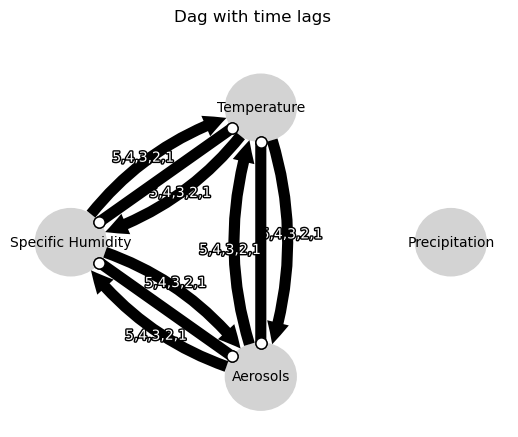

Negative precipitation values: 0


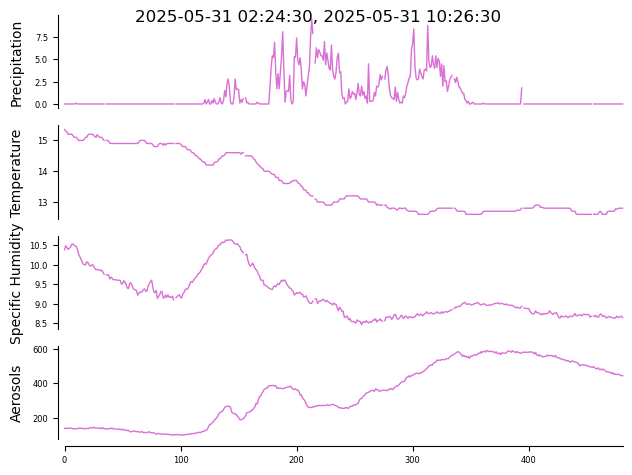

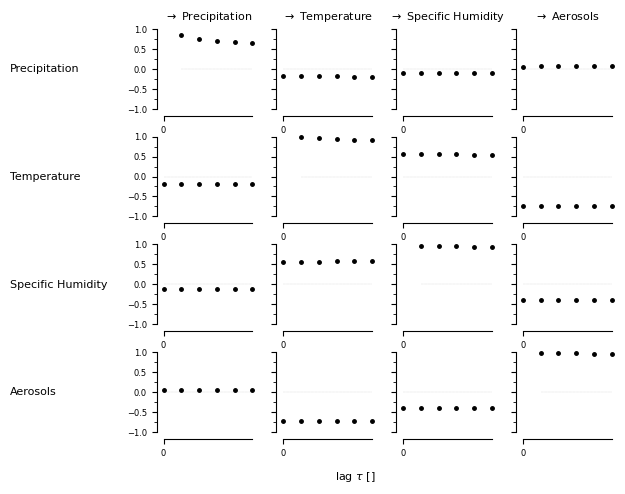

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


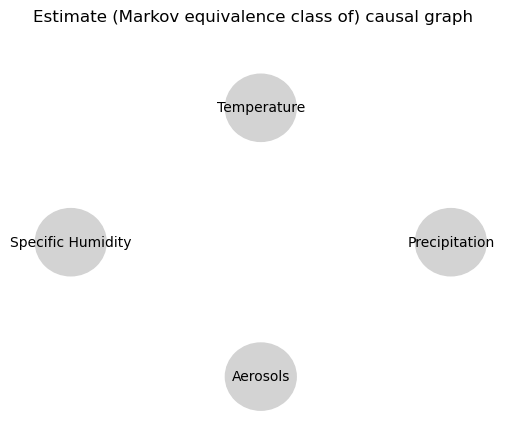

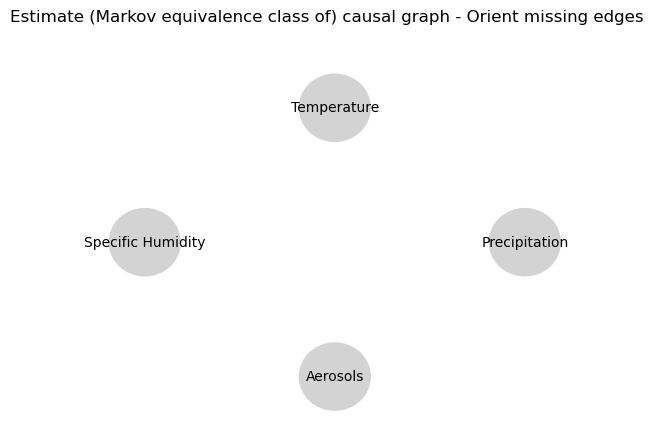

0.0
0.8677145352192874
0.758739248611238
0.6646886959029714
0.5831272402922031
0.5120247465965193
-0.021952008051418646
-0.02026765334472773
-0.017012575226788406
-0.015221091005012915
-0.013874500880670253
-0.012325102853203878
-0.034293478174176065
-0.03285014445862335
-0.03029970343787529
-0.027984782766340265
-0.025877569753893388
-0.024720845263887955
-0.03223803469143292
-0.030630188143106557
-0.02904734724087147
-0.02836956931345529
-0.026473576190245943
-0.024746620900785596
-0.021952008051418646
-0.015666276297843486
-0.011253061178010141
-0.006899784919045353
-0.0022468099234464784
0.0009889155020091779
0.0
0.9688129856114722
0.9459255412759994
0.9253938140409512
0.9064406839049903
0.8880871911863777
0.3597198880380241
0.3553101453363582
0.3498203687474273
0.34450276277459335
0.33817066289532055
0.33113995770893945
0.020548910588835224
0.020242303257404882
0.01973184995651091
0.01991080430259083
0.01958724033067555
0.019406152271696037
0.3597198880380241
0.35212028427878145
0

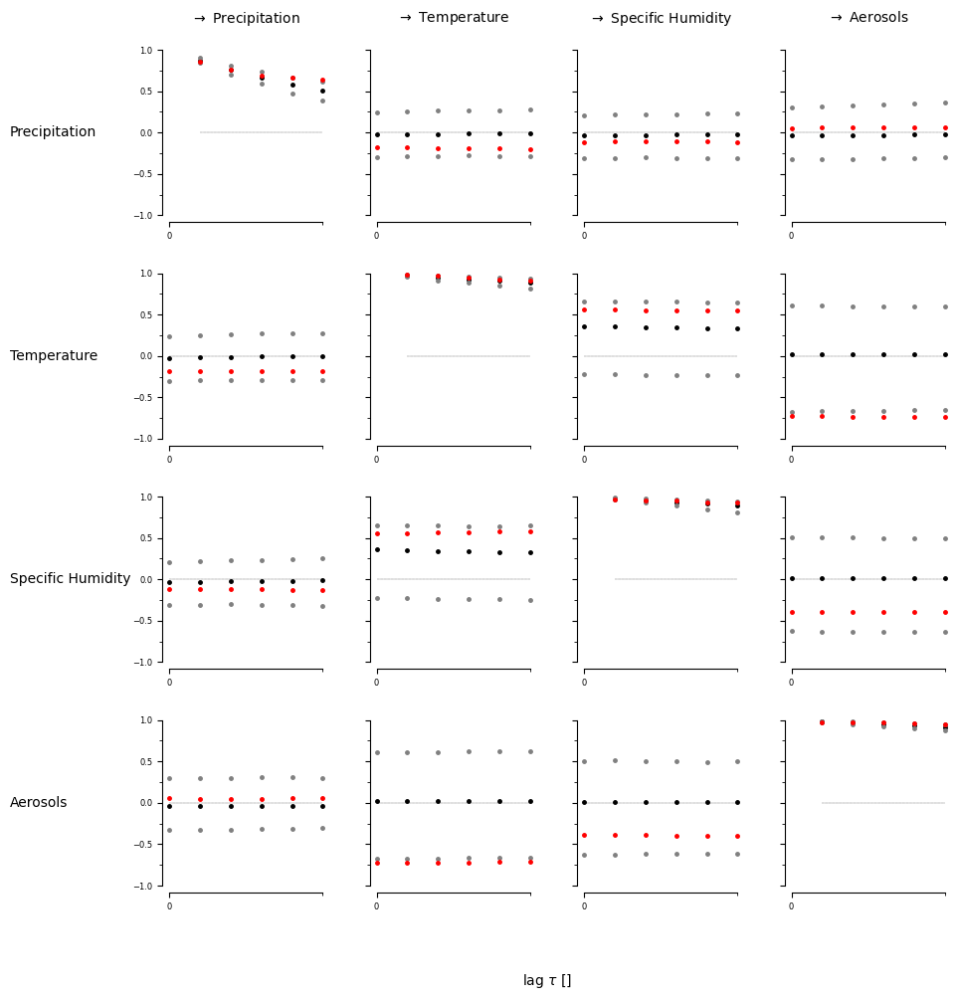

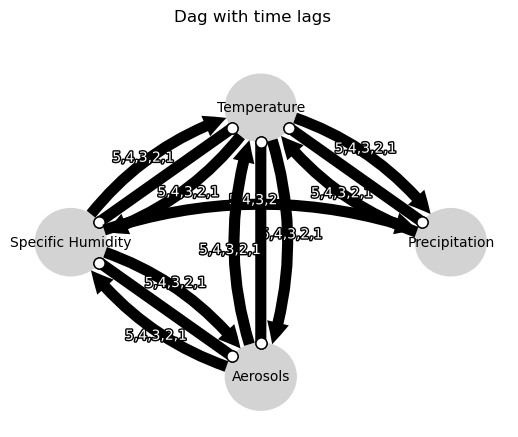

Negative precipitation values: 0


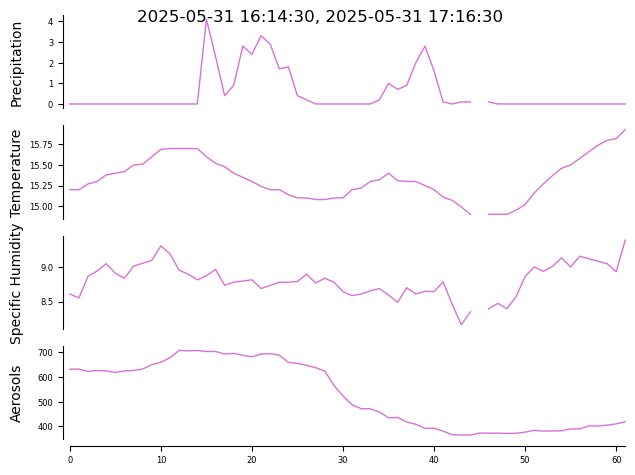

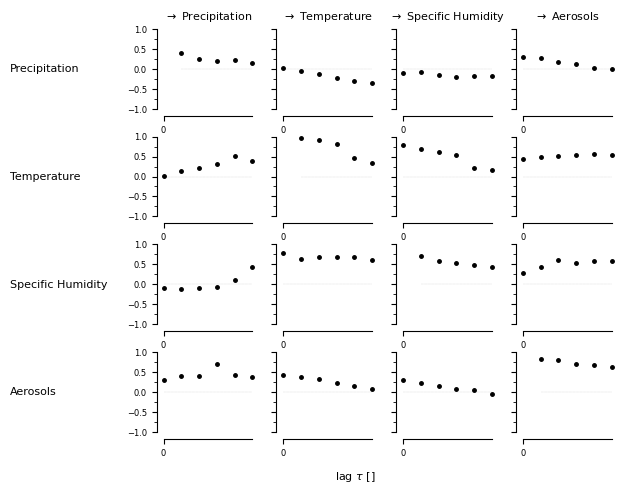

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


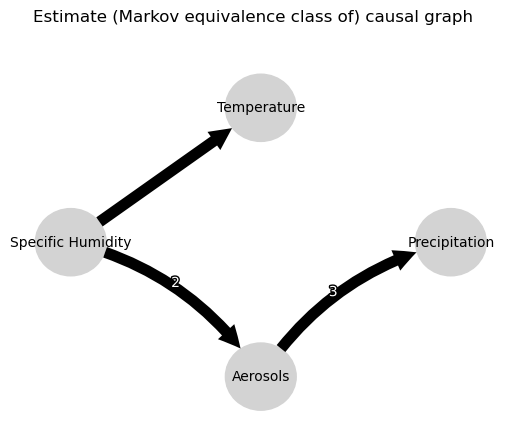

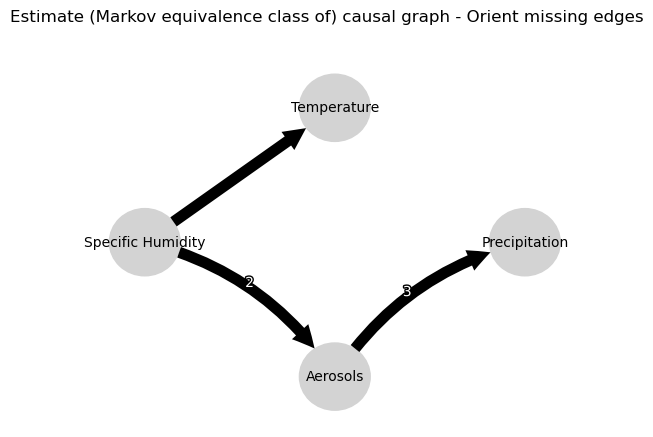

0.0
0.01458922282636946
-0.013217008755936037
0.012798000652196074
0.004218365970724953
-0.013752093797889225
-0.00740901236446158
-0.0055771222302000425
-0.003102184124873427
0.009029103175637878
-0.032934708257665674
-0.015410695345858932
-0.02159674847078966
-0.03340852942297585
-0.03644817735775625
-0.028530162571078016
-0.008443643588924772
-0.040674017631287966
0.15657622108195196
0.16189052229827555
0.12052001434784547
0.12572372162924167
0.07412809615465957
0.07467589769569448
-0.00740901236446158
0.09482185192586776
0.09394161140623897
0.11382252859189972
0.11299690643873789
0.10038685574019965
0.0
0.8339098530511283
0.7449583363282855
0.6615993205002506
0.5836758363396748
0.4954407595108395
0.5001503827101067
0.33198577874933816
0.2054918543949144
0.11640603402722757
0.055758734888054384
0.004693914626244102
0.39036759232422674
0.4351746580258515
0.46653099441615775
0.47842843203491037
0.4844062100402624
0.4602636799532881
0.5001503827101067
0.5915794613971449
0.6305910918845

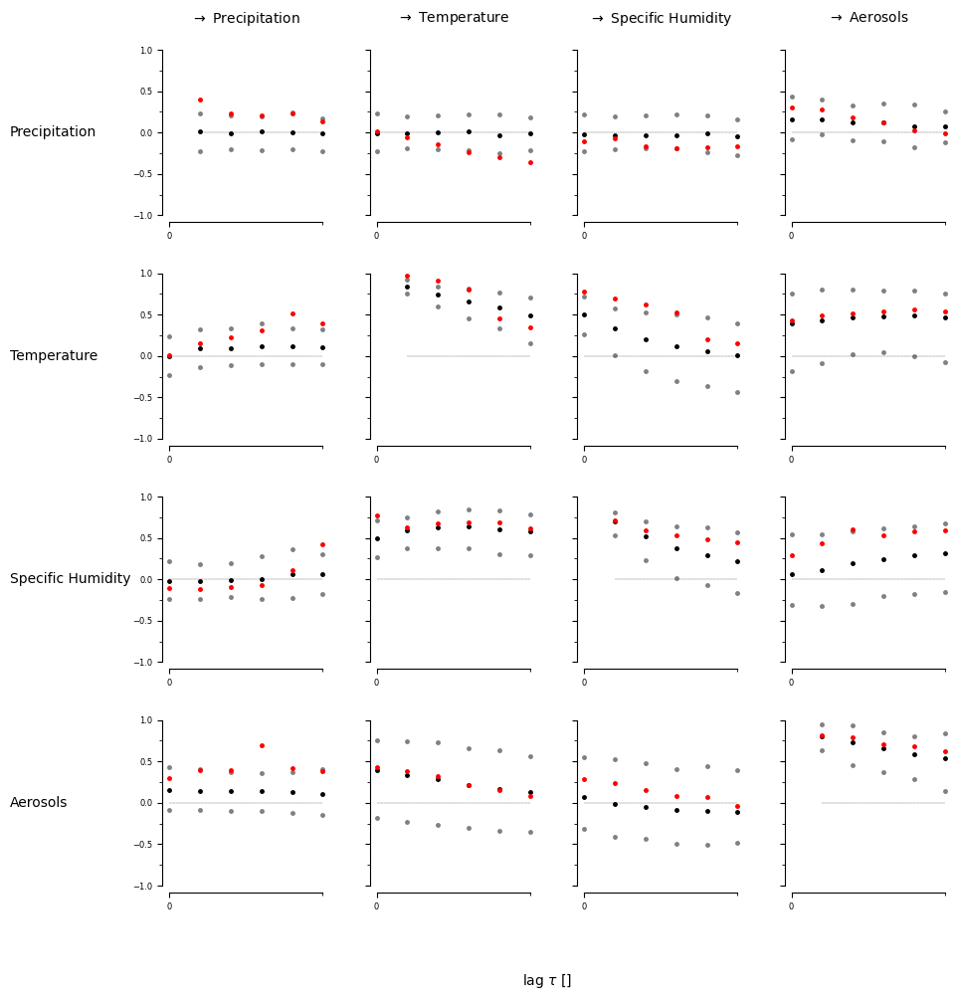

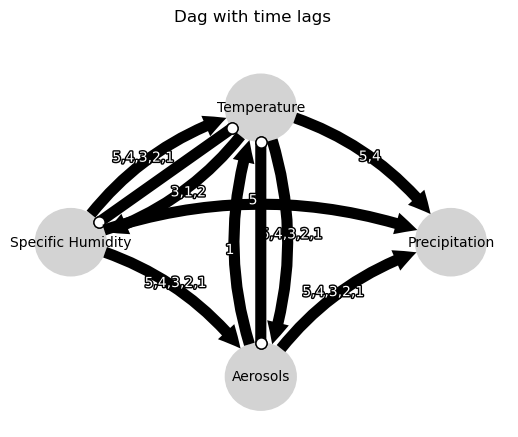

Negative precipitation values: 0


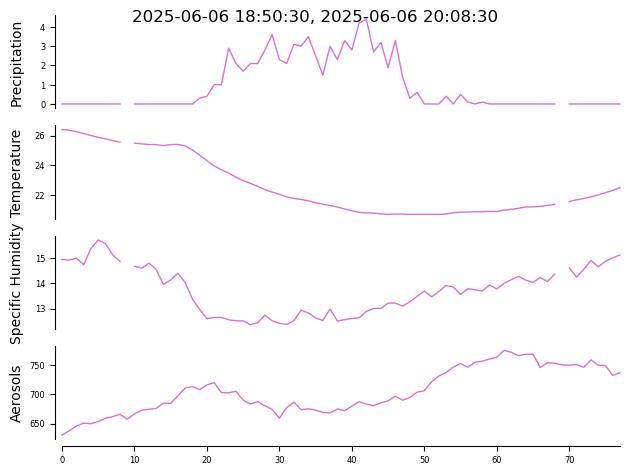

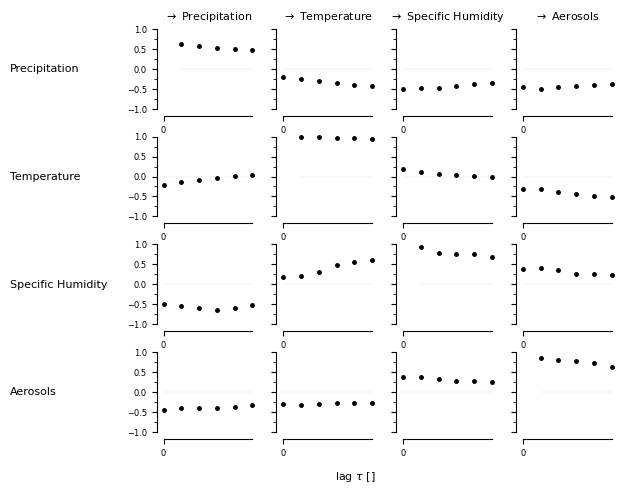

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


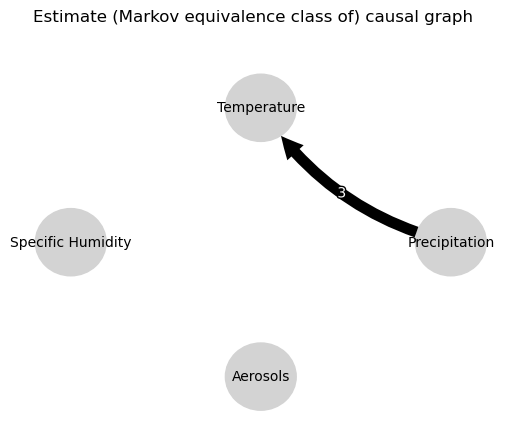

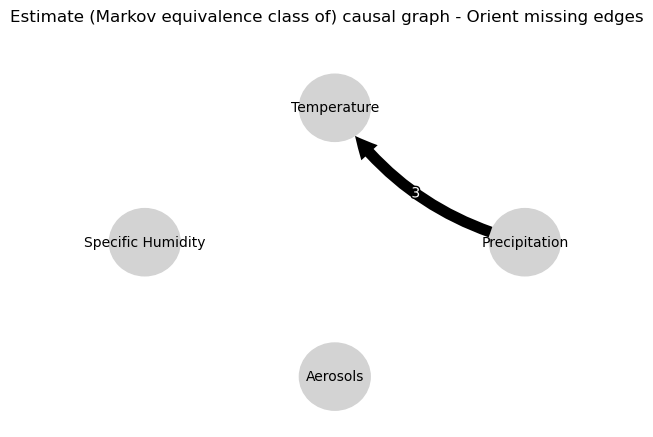

0.0
0.004373709892166507
-0.030390878312744483
-0.004343353060976234
-0.03914025535531221
-0.020240886939731074
-0.017838010113740574
0.0050684768997346355
0.018372623080106776
-0.20659453674582162
-0.1575528863227929
-0.14279723236422515
0.0019892061072000738
0.006604068129778961
0.026152256528912794
0.025451733689865884
0.050581897307942096
0.04637750055354837
-0.06670044539281979
-0.0688441167884862
-0.06344820234443393
-0.046440503779893526
-0.02734638568345419
-0.029644847534817283
-0.017838010113740574
0.07979199248649203
0.07556168177704
0.06370307612072558
0.0837960493924459
0.07770078815429059
0.0
0.8106964763057058
0.7188786957210621
0.6450879070433078
0.5571674650746656
0.48745472375309573
0.175199209070846
0.1475163433936948
0.12584337494242537
0.12725424502526697
0.11557971751058024
0.11308148666107531
0.13268607647866154
0.11502877157710806
0.1038548148760141
0.08961572906335269
0.07934569023370995
0.06672927401804224
0.175199209070846
0.13885031694981556
0.11079776198986

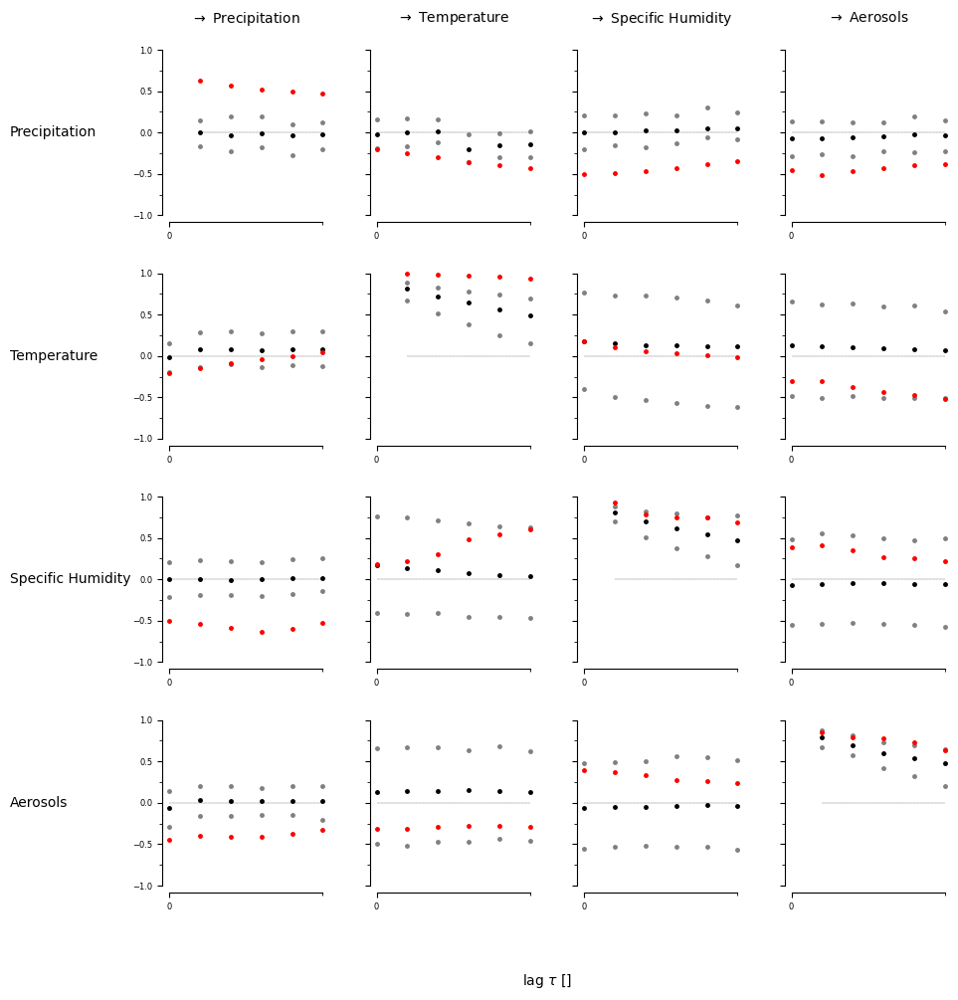

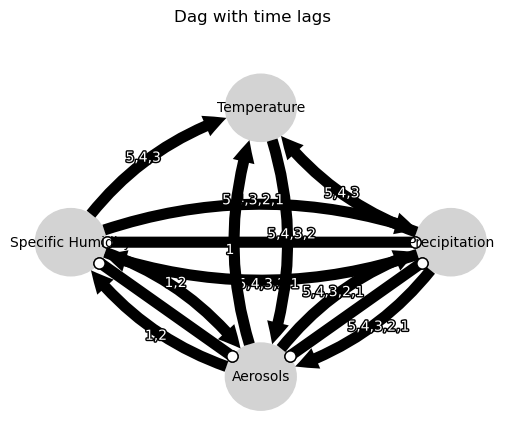

Negative precipitation values: 0


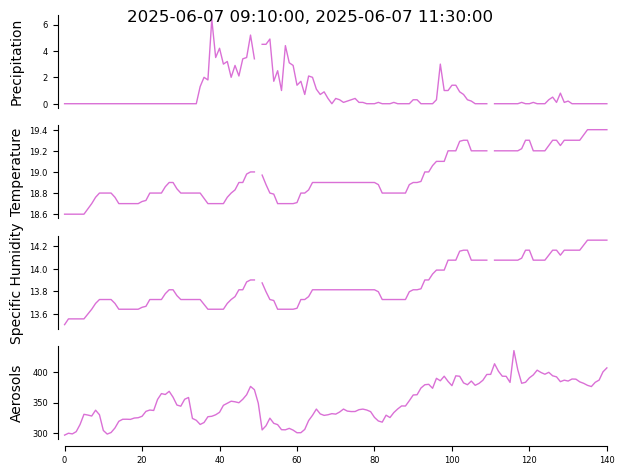

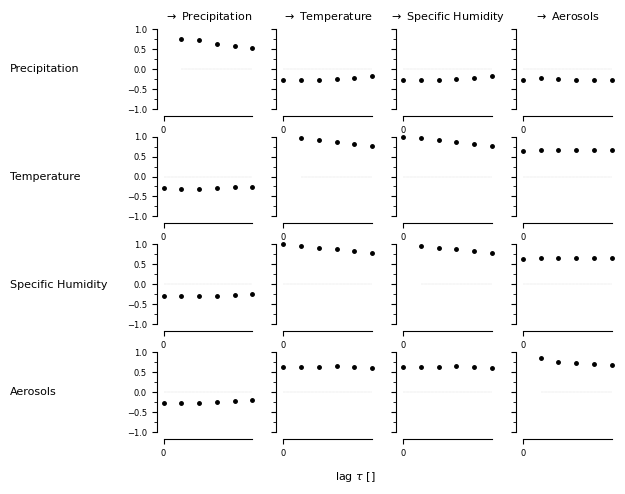

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


/opt/anaconda3/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


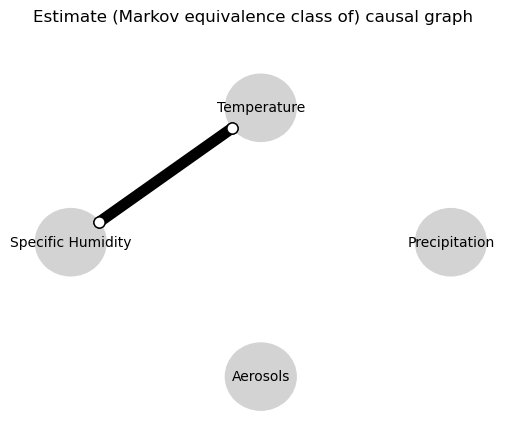

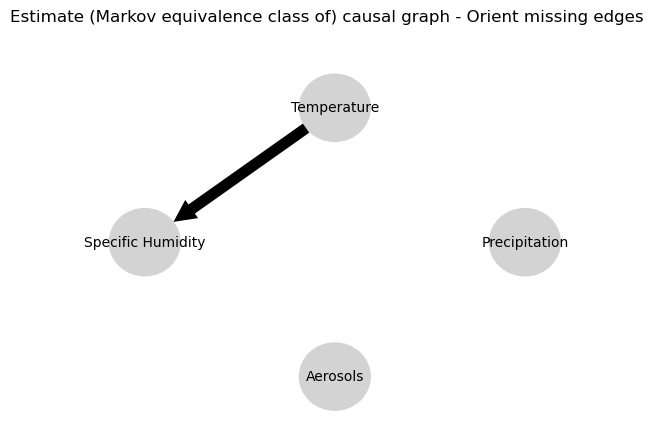

0.0
0.6747089212892762
0.6683117170208058
0.5521002862535458
0.5024401724664689
0.4261263879948837
-0.05497686799435714
-0.008269874902903249
-0.008094920578606134
0.004153936468374044
-0.0020877285171372363
0.009152315147277892
-0.054770927263845894
-0.008050580098378895
-0.007948649620316833
0.004524781500668406
-0.0020607406331729725
0.009278180848967636
0.06118273604404464
0.05653844097153295
0.046973998160651516
0.046555818145490147
0.0341202939951084
0.025727905668175684
-0.05497686799435714
-0.027152907099663844
-0.03219267926176605
-0.014115784707538756
-0.023326231902186106
-0.015662314395966503
0.0
0.008751327906322912
-0.0006919405103643534
-0.011610490428103117
0.0041156025992393165
-0.00696919262799407
0.999850173287439
0.008879230475131089
-0.0005858837011714402
-0.01162043433246681
0.003925254832655851
-0.007226512265075484
0.021630538583593276
0.022638034313634096
0.010723880366585857
0.020741301951337707
0.01768774821687365
0.02175476325049248
0.999850173287439
0.00891

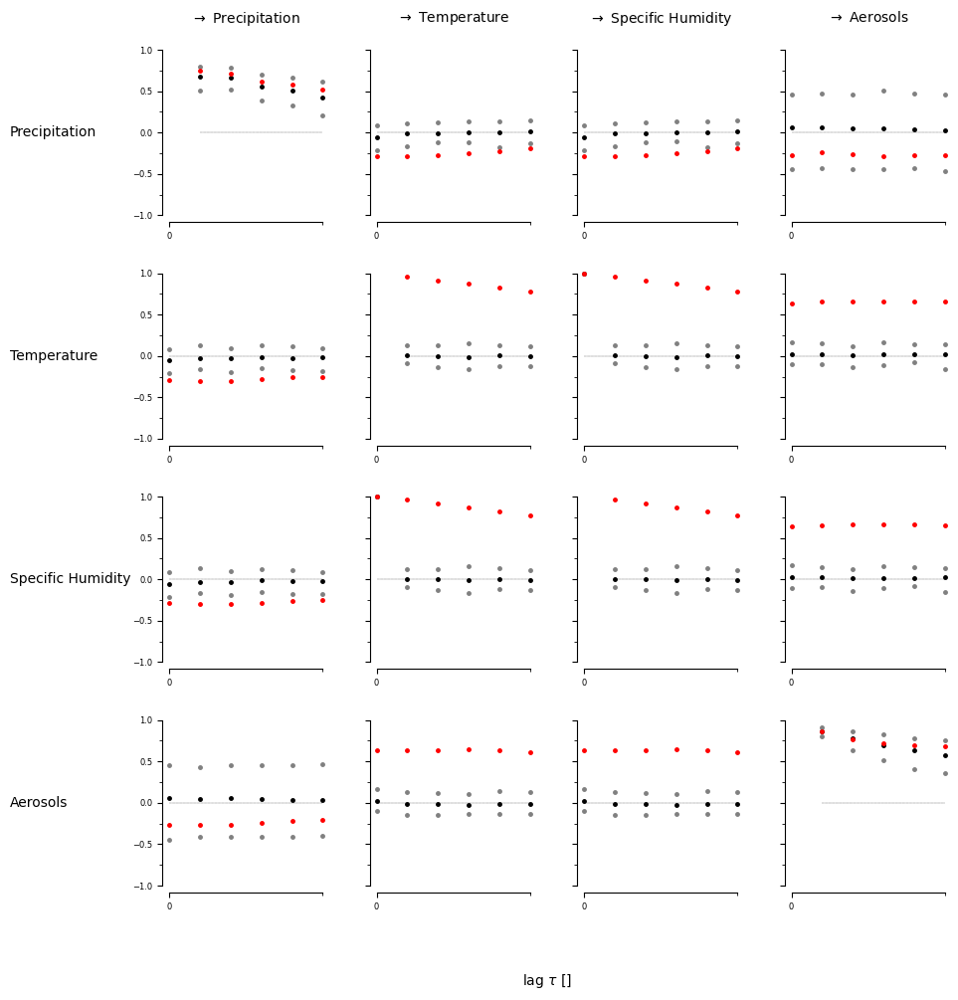

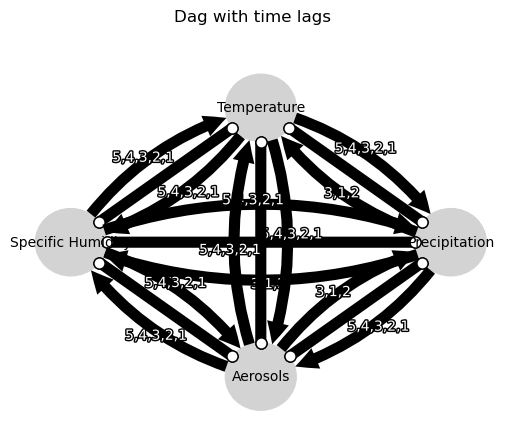

Negative precipitation values: 0


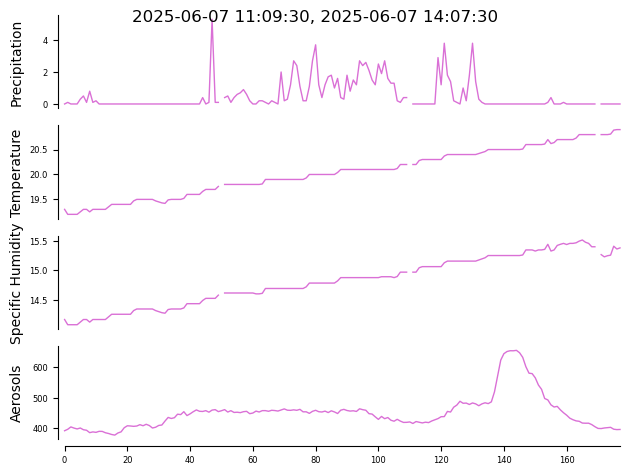

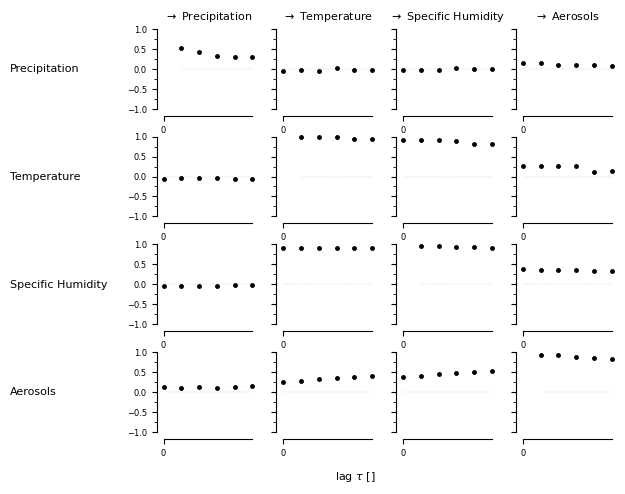

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


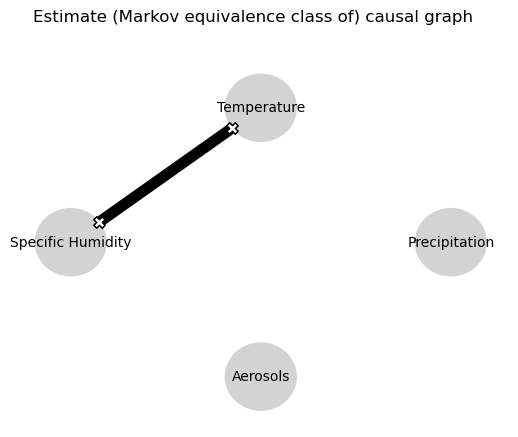

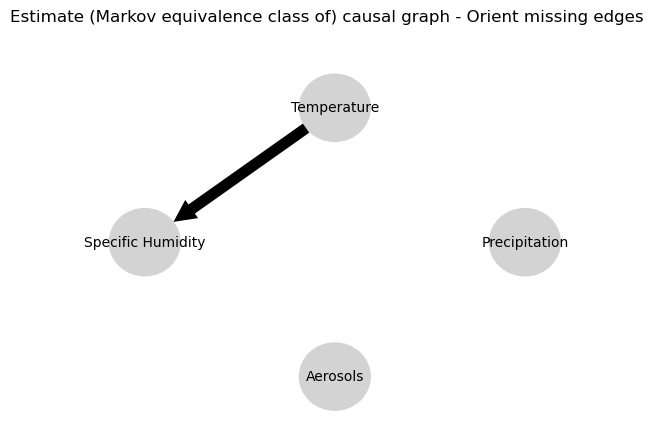

0.0
0.5143182268434768
0.2683927346774113
0.13430758930248904
0.0661317988902571
0.03544604761298061
-0.012808676375697985
-0.013607862099153892
-0.016156297578997857
-0.016876211025988075
-0.021072473018980062
-0.016993905383831862
-0.005513543300925281
-0.0100481082446383
-0.01544179672906634
-0.02064000398943574
-0.02278584079517944
-0.017255931628513566
0.006588296402879466
0.004940876778499902
0.0006396505294014313
-0.00321320172284829
-0.0022926360649304827
0.00048155679319184853
-0.012808676375697985
0.0017926994765058077
0.010589298400304066
0.007765884365168432
0.009678389539640791
0.011803037680170698
0.0
0.9218009787433071
0.8731588035218159
0.8319125731392569
0.7944379011437376
0.7575565989487951
0.9468088636585081
0.8818779619425102
0.8319747302621664
0.7918546089191153
0.7580746432589354
0.7243227567815768
-0.02751660236713115
-0.026408106106871384
-0.023057424972840884
-0.021103070933509306
-0.017306383543836228
-0.012703855164218587
0.9468088636585081
0.8886881062792235

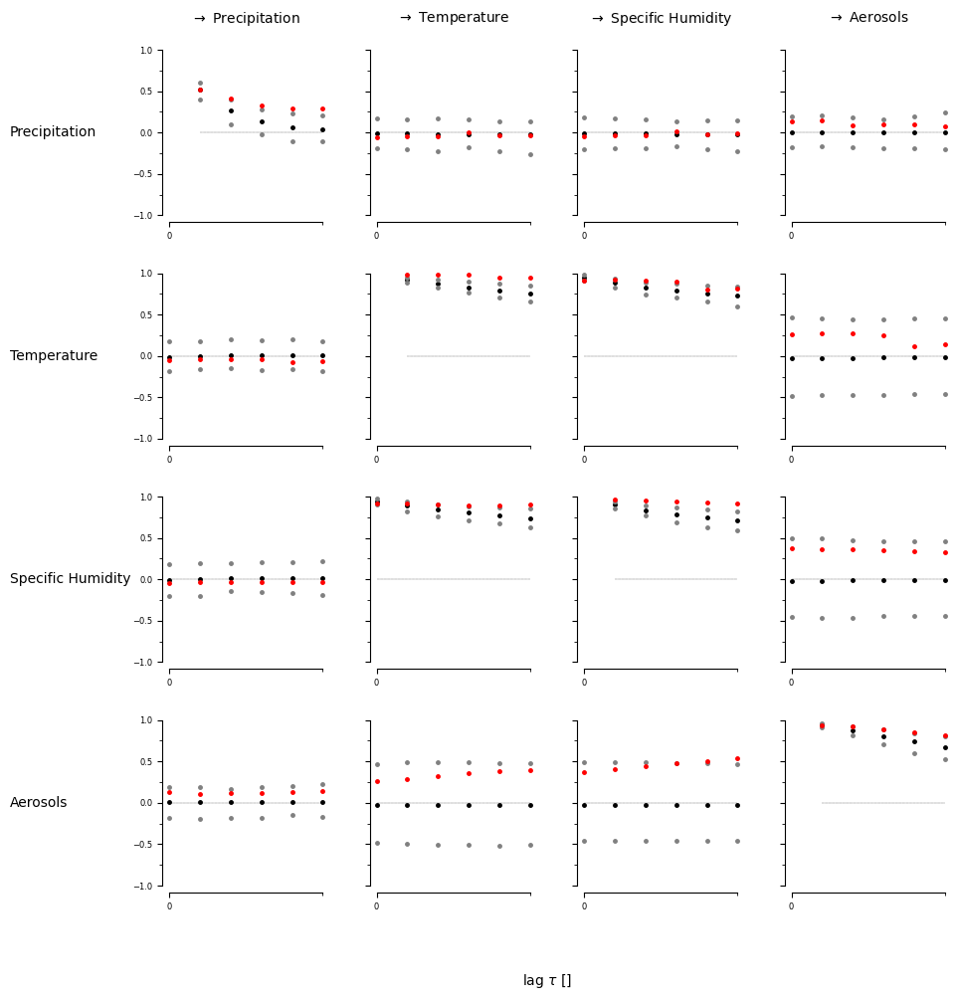

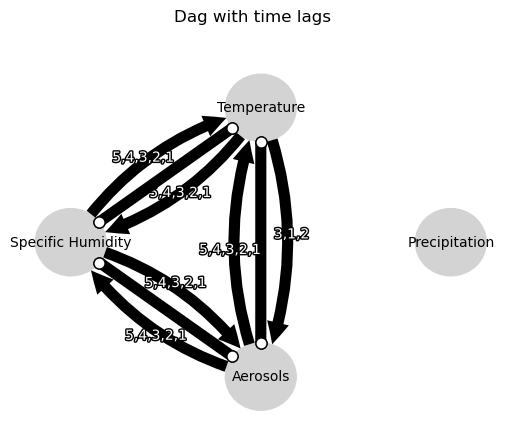

Negative precipitation values: 0


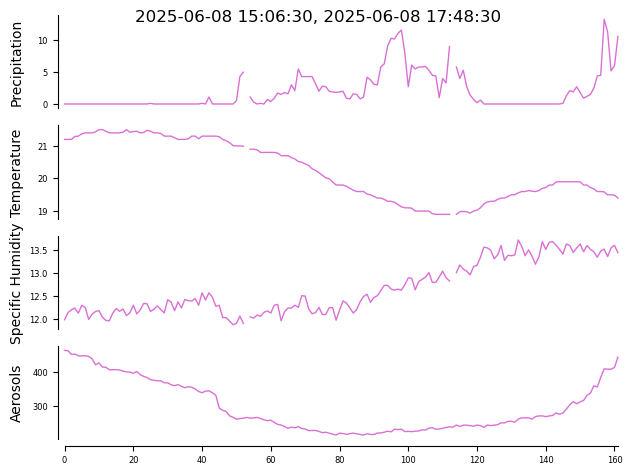

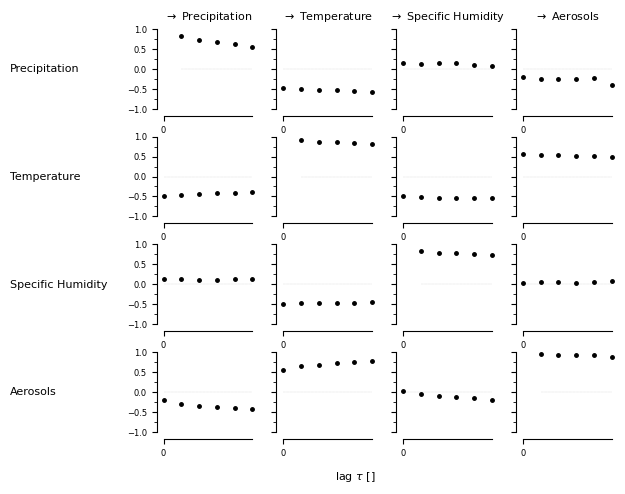

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


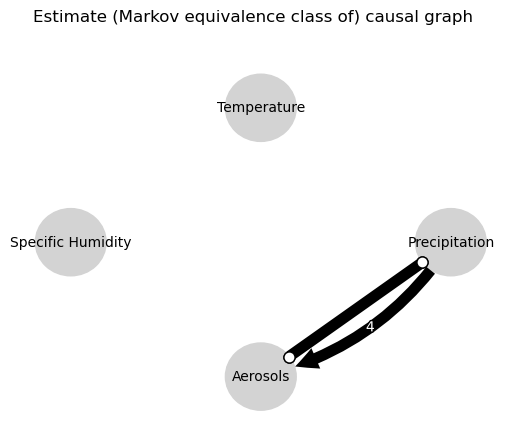

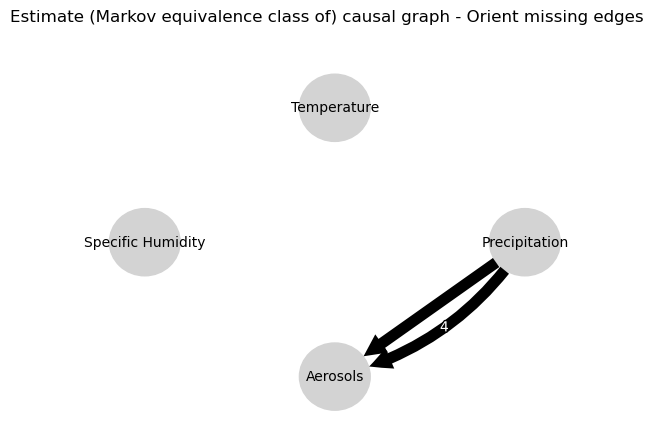

0.0
0.8476211376517863
0.7446225316859503
0.6541806131928267
0.5782246393771755
0.5085827302642474
-0.14607696352708538
-0.13894220175994676
-0.13536884830341744
-0.13260188075917095
-0.13171733010022407
-0.12638071765649206
-0.04897323727792082
-0.043912754940041904
-0.04304191173546281
-0.04841466286754818
-0.04714203210335802
-0.04813555759640879
0.05640909695587384
0.09221025318165818
0.12009754221185422
0.14328794226078853
0.1642661410086244
0.18225240917532579
-0.14607696352708538
-0.1291161582043115
-0.11770509288910812
-0.10873858058049488
-0.100201385591718
-0.08953274455989106
0.0
0.9139116203403
0.8613446450047959
0.8166293788949346
0.7798509883438193
0.743606725192414
0.3923952456613076
0.347260376923697
0.3265604463520579
0.31877768772729753
0.3043404983274787
0.2904199774640738
0.10393547458475805
0.09365085857689838
0.08499730573685986
0.07991737060768016
0.07365312653920336
0.07053434160635541
0.3923952456613076
0.37034666909949293
0.3511423128141148
0.3368227017070675


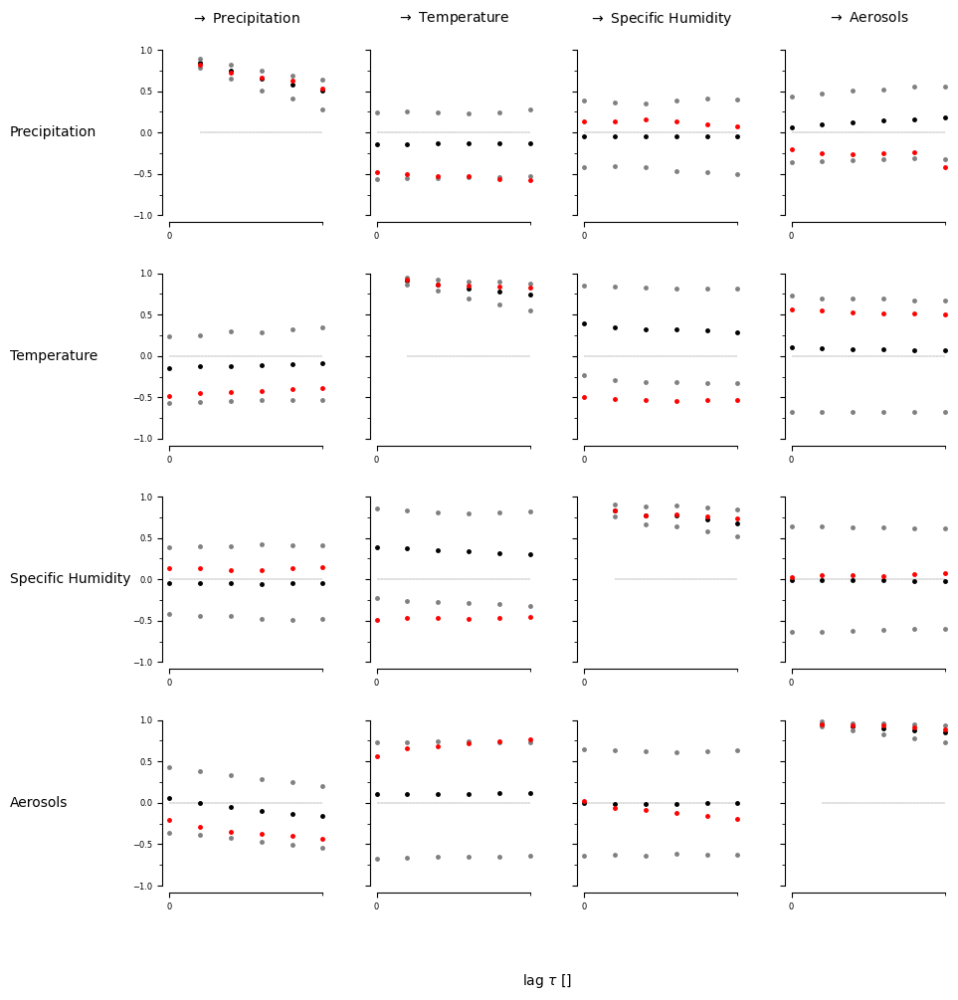

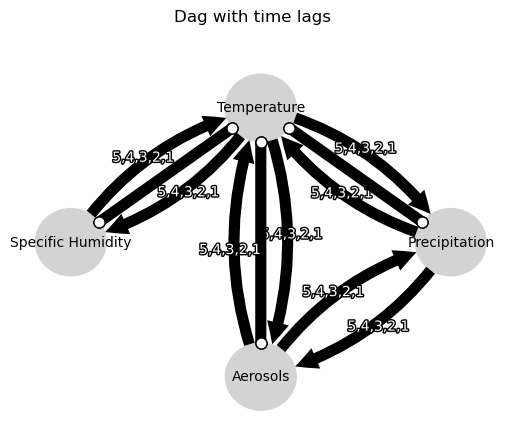

Negative precipitation values: 0


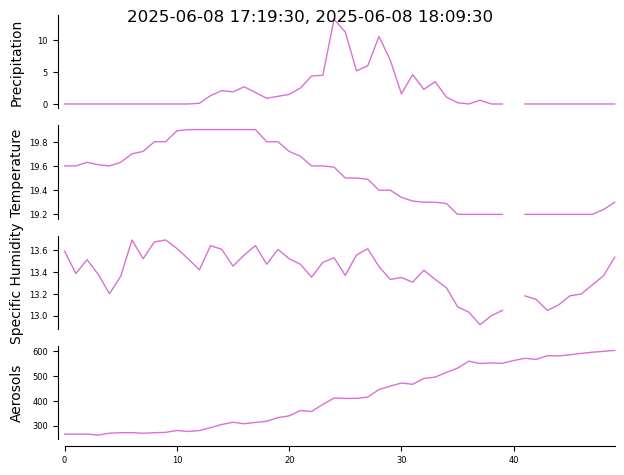

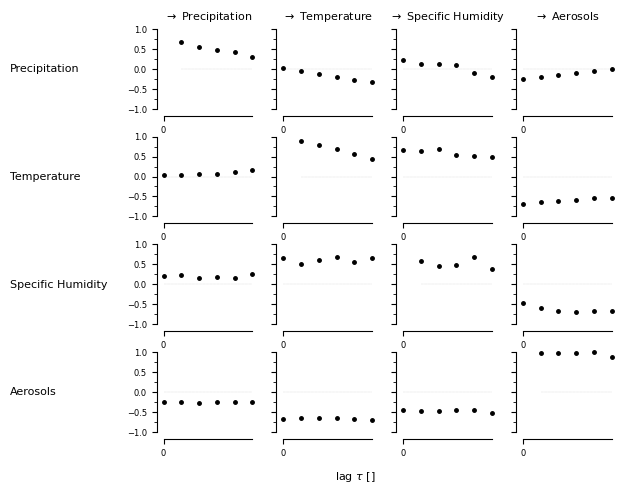

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


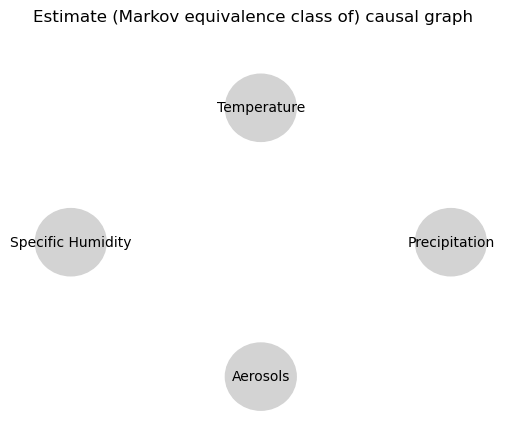

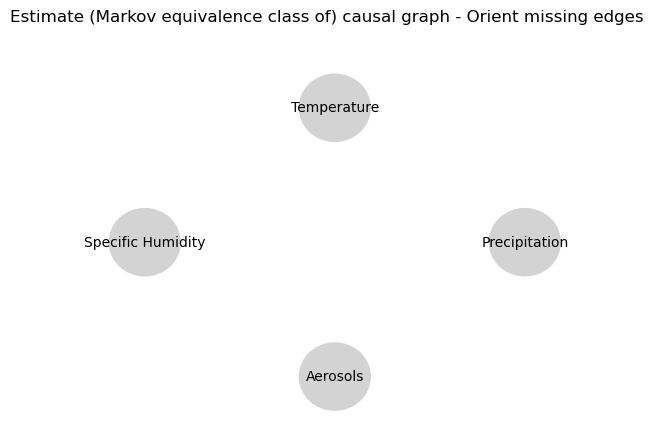

0.0
0.5682934448347732
0.3415749466834994
0.21087977540963707
0.10734054889840705
0.05082897253383582
-0.16042614543210187
-0.1423662162385387
-0.13620754475002253
-0.11315865550297649
-0.1183969223803272
-0.10154707074668229
-0.0024022638213197244
-0.040612714132600314
-0.06597683663827837
-0.03275880371572575
-0.033087922956826596
-0.03915995664561159
0.053912733851756905
0.022057083304714443
0.05982263929653744
0.03512827773724009
0.03858848470100685
0.004003913528295782
-0.16042614543210187
-0.10611965138972193
-0.05601552969928202
-0.016950179290990092
0.005649510744113817
0.01515536138931429
0.0
0.7222452227579956
0.6126755344647256
0.5286829203615282
0.4639965337093226
0.38640011772248484
0.15606474723645625
-0.013464451465581753
-0.0068272911528040395
0.0163519111346055
0.04213495480732443
-0.07093054302755228
-0.1735586383949506
-0.0995811114637272
-0.12833843602337797
-0.10387488897638456
-0.15627403978197554
-0.060924916418637357
0.15606474723645625
0.12182859647703564
0.117

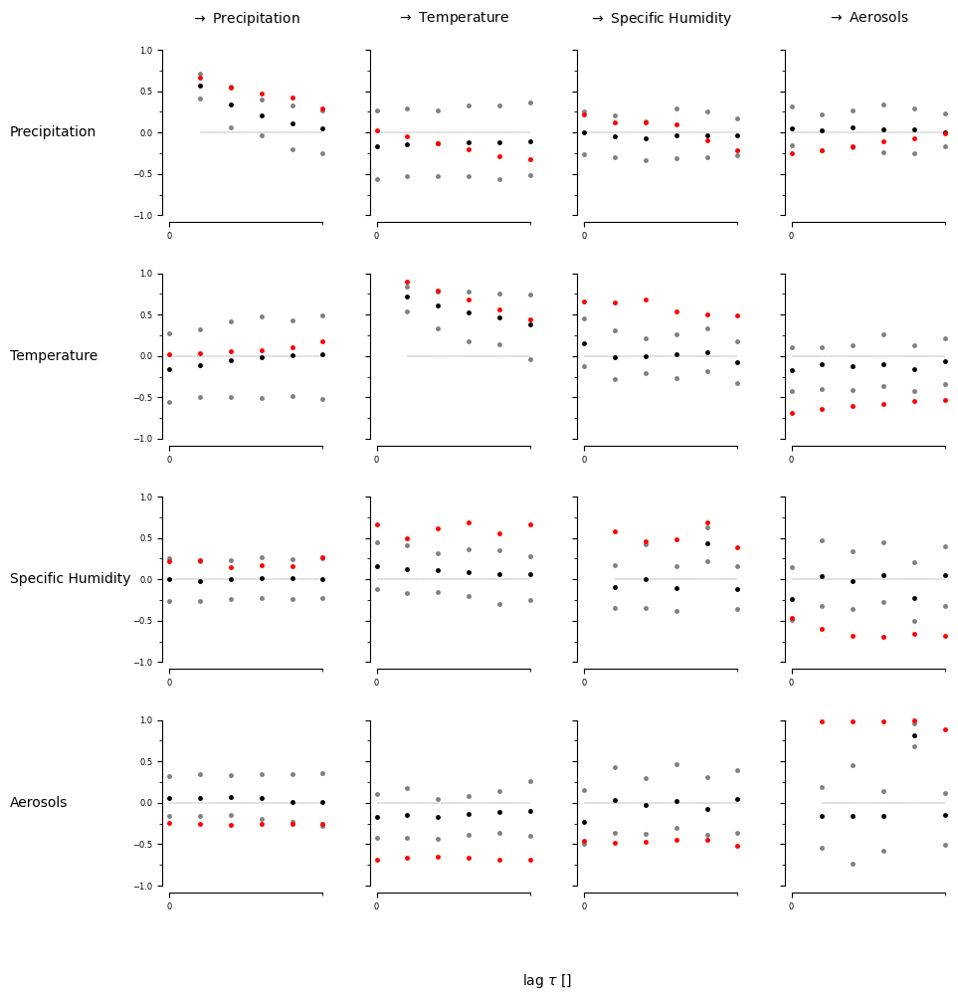

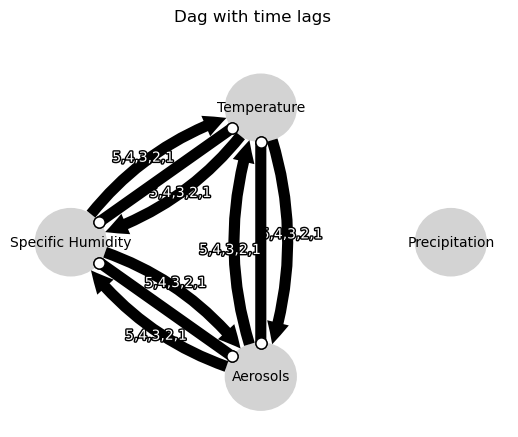

Negative precipitation values: 0


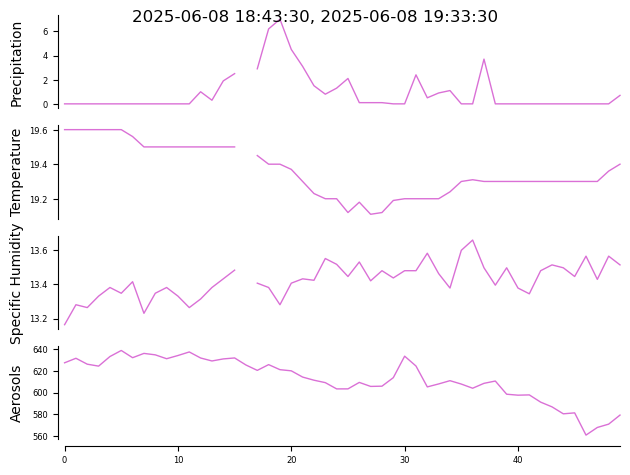

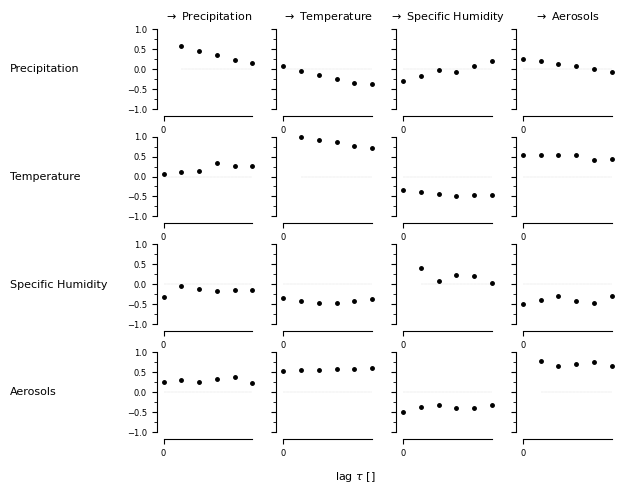

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


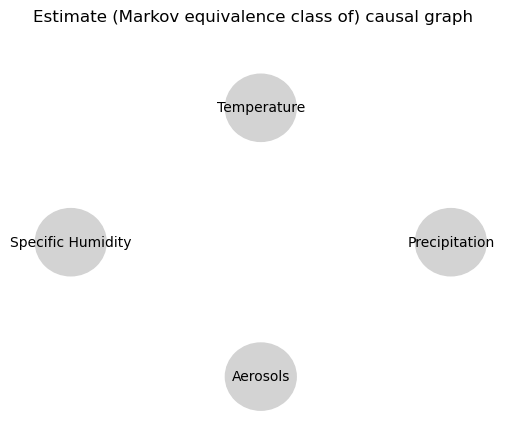

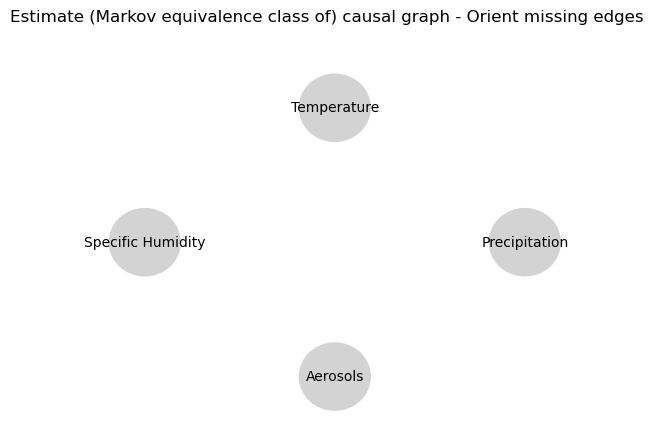

0.0
0.5161372526662771
0.28395926856385173
0.14794576237446727
0.036912347708454994
0.00044276538671000757
-0.14281966597522927
-0.10916979593020101
-0.08362057230935079
-0.07796231106827091
-0.05436955203482063
-0.026239068601610467
-0.07443262468176552
0.043570327930710084
0.10031866900338665
0.02971809110876892
0.09814690530406917
0.05044175477978527
0.06264375392095047
0.06511073185576936
0.034944927162959286
0.040012512429492296
0.02584043238479915
0.011343461633027416
-0.14281966597522927
-0.09994410656852022
-0.06554389733238333
-0.03445342161445883
-0.022790157005923593
-0.03547239691948768
0.0
0.6982588193929489
0.5543243719114392
0.47639820485793893
0.37675978929320153
0.30938438911005367
0.06575981160921418
-0.0324396630798281
-0.022569783760102304
-0.05128738051234426
-0.06439820037474328
-0.007714676385147546
0.17266261845233782
0.13825947370655756
0.1200592867992125
0.11397875805606406
0.09481831514668608
0.059201478635713185
0.06575981160921418
0.055495061972818165
0.027

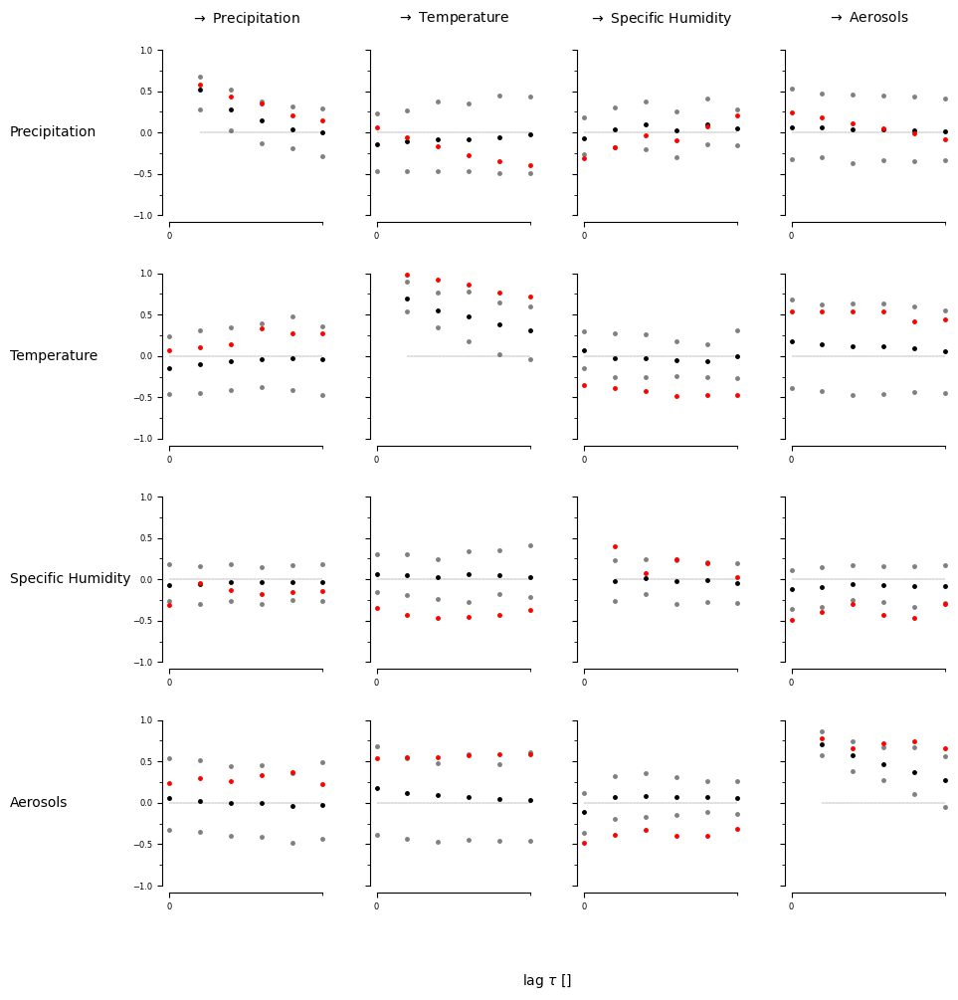

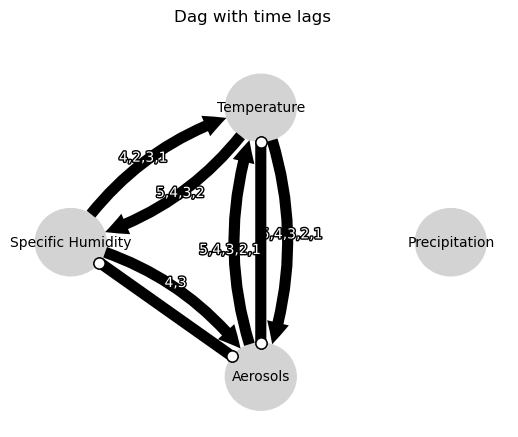

Negative precipitation values: 0


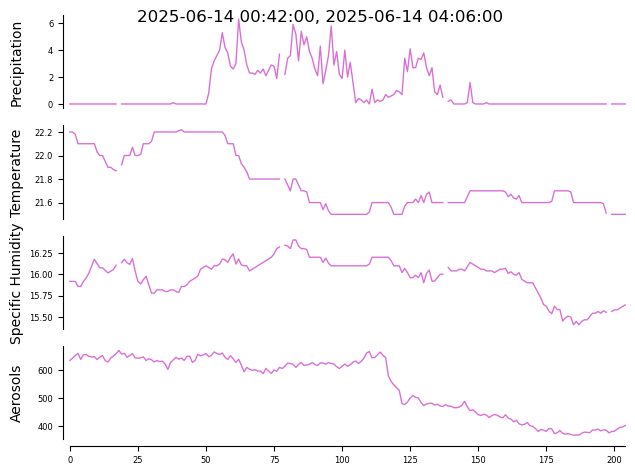

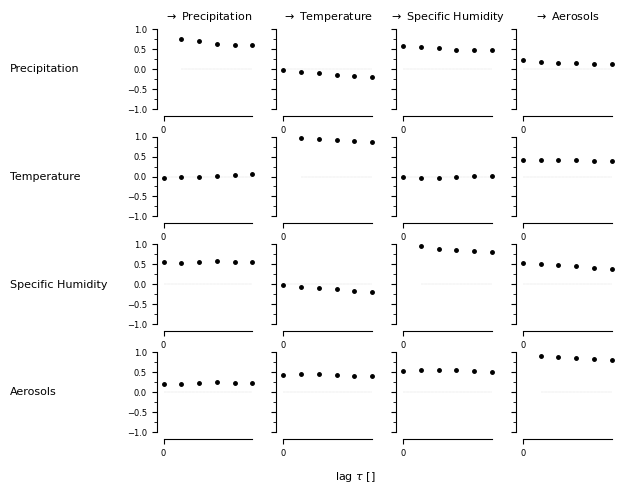

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


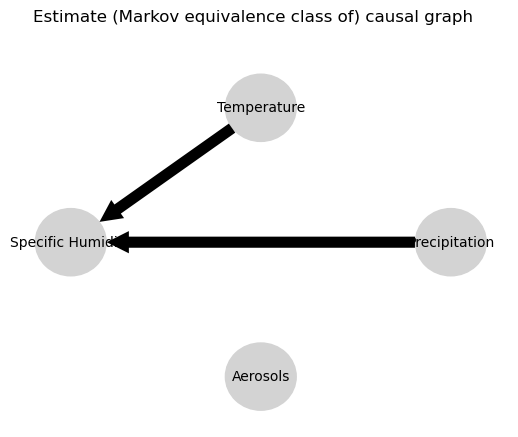

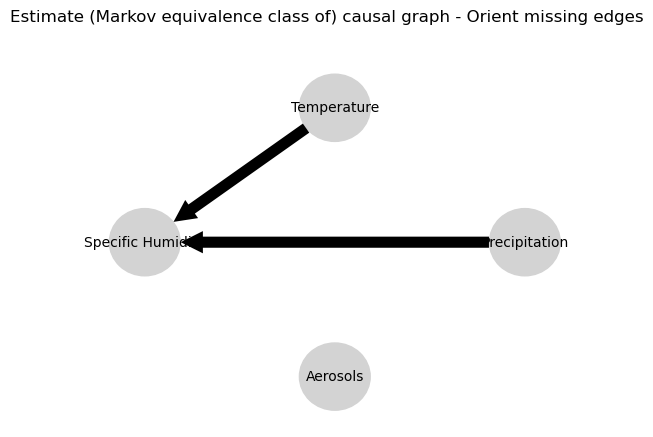

0.0
0.8356020189428521
0.7138446217638112
0.6078161707687371
0.5209997875388168
0.4452378560698607
0.05877563395067757
0.050293454722408544
0.044133857070130934
0.04013001933116098
0.03759481442828417
0.03946198695961813
0.14393154726858365
0.1540993883684202
0.16131159656894387
0.16788234163265403
0.17343921657233136
0.18074850148531285
-0.021394258946924073
-0.02092326630503919
-0.020784448888399823
-0.018104952985396036
-0.012959321166394214
-0.0103147125867422
0.05877563395067757
0.0495845460087367
0.04290353522210978
0.03709979215902803
0.03227157851145027
0.02680658540633388
0.0
0.9263690522110529
0.875892936707542
0.8297480805692663
0.790695138068045
0.7533451041571602
0.6794081410633233
0.6557021324674289
0.6364993479870696
0.6190279829084089
0.602477962997326
0.5875400632412575
0.019764232419630982
0.019267054067415176
0.01957144189983477
0.01876906424678379
0.020147409702715984
0.021542822990219715
0.6794081410633233
0.6390827362543517
0.6032283531999029
0.5713839440008897
0.

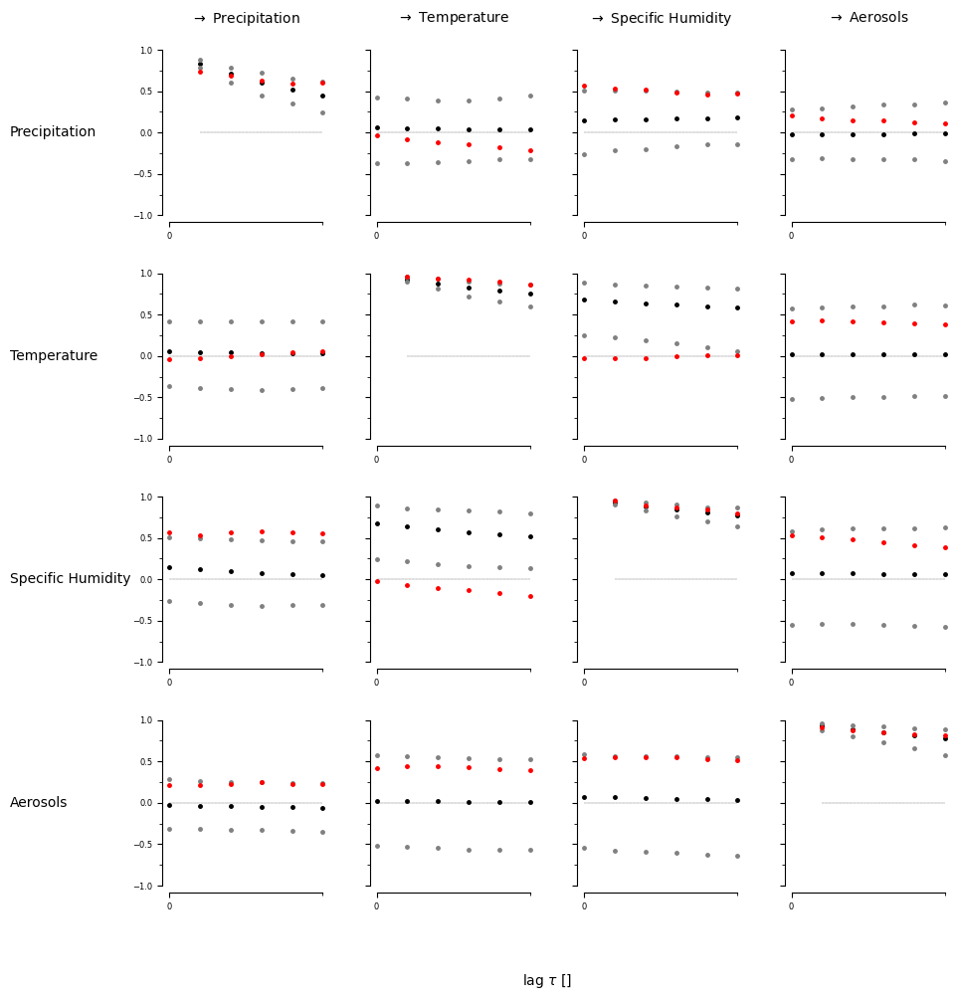

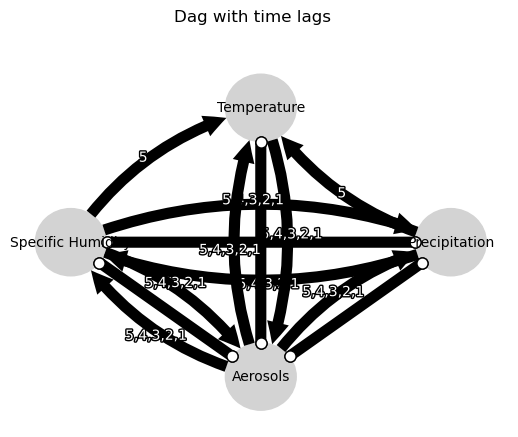

Negative precipitation values: 0


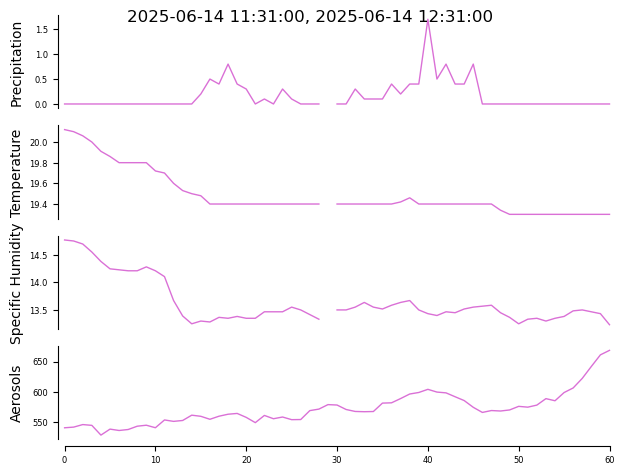

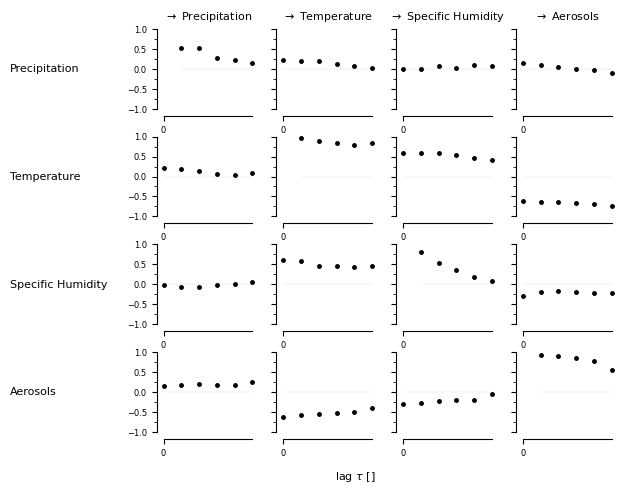

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


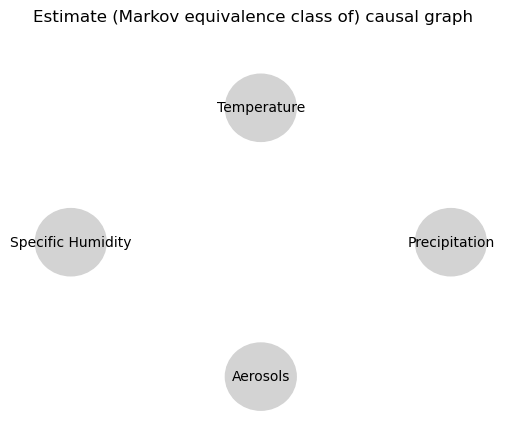

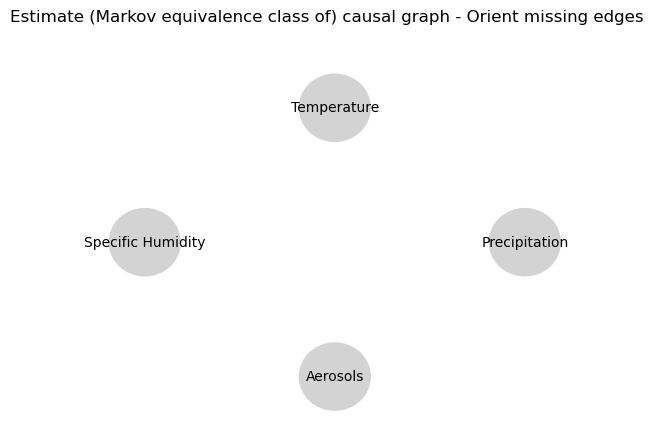

0.0
-0.031302521117366366
-0.03923070042610601
0.023119593883897237
-0.01915421668428726
-0.02003329143683673
0.04897827683012873
0.023818111817775888
0.03340220326654907
0.016282901793620453
0.022077849810436357
0.005731748026291806
0.022639952660529063
0.025543062415658752
0.004956609631175284
0.012751929808117093
-0.011115946126760468
-0.024317744308695984
-0.001033978128106238
-0.0016151965203052587
-0.010546846995386692
-0.005847300336990926
0.006969802747487577
0.007390584194587957
0.04897827683012873
0.013208572465288322
0.0418311729851394
0.03394827500199048
0.00935472525650451
0.009938384741370328
0.0
0.7266441097989241
0.5864114465308468
0.48041906080047636
0.3953106913744798
0.32201596413605843
0.5633670601256549
0.411430473699233
0.31379718426981074
0.2213500888449894
0.1517580312268197
0.09905342195082588
-0.04979838947769627
-0.06688886168864239
-0.06857351284156075
-0.0758918947079992
-0.07984207016657058
-0.08730004268831157
0.5633670601256549
0.4411317620110232
0.36594

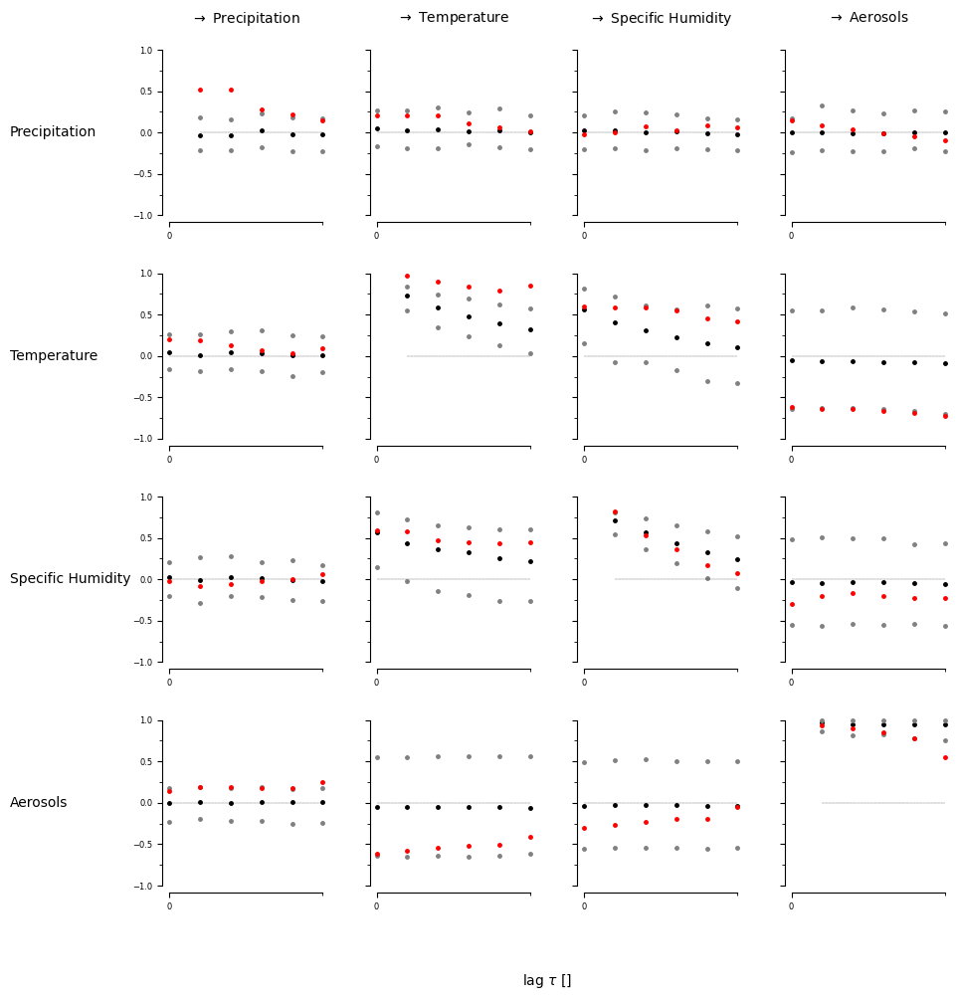

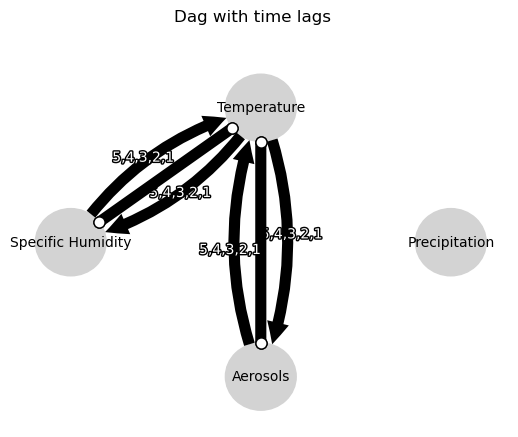

Negative precipitation values: 0


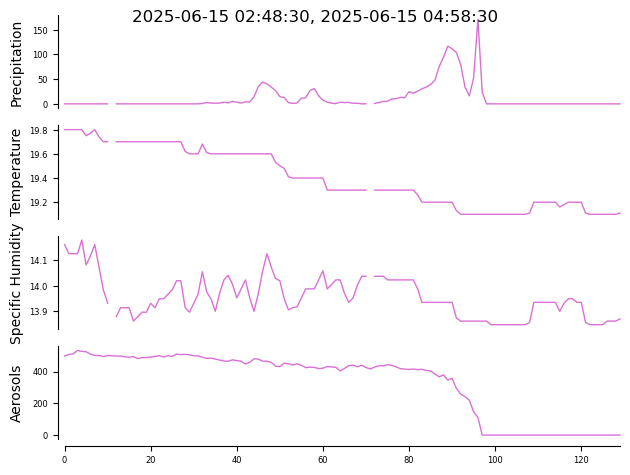

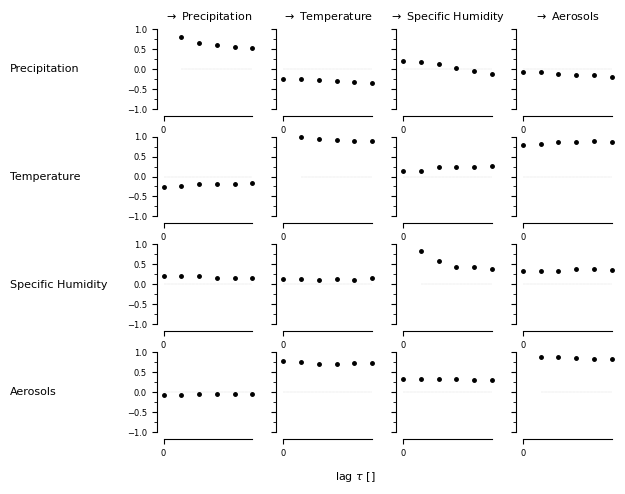

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


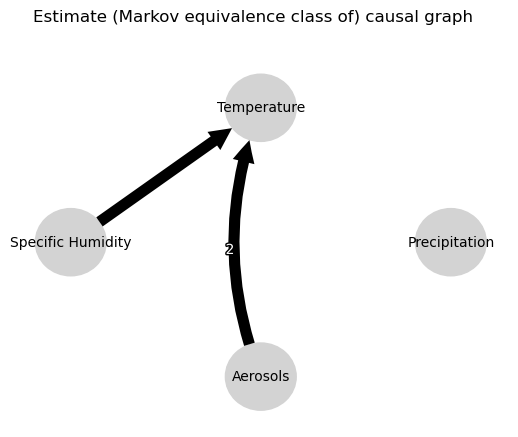

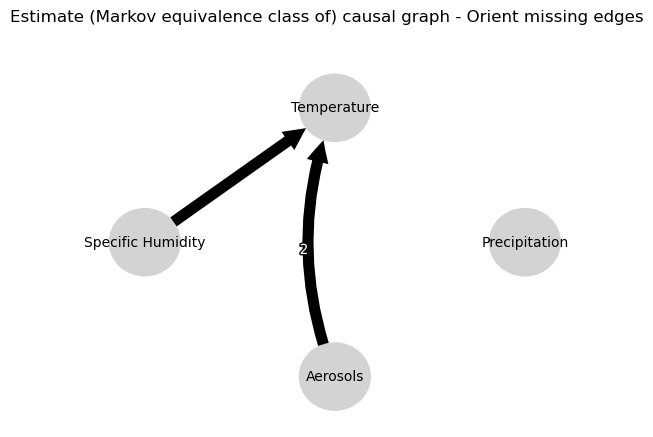

0.0
0.6959714226638912
0.4961704695905309
0.3658871090247575
0.2636484533103821
0.18586059697613116
-0.016630794955747118
-0.012894025598719994
-0.007862195320932228
-0.0025057373964058115
0.00020947190687094054
0.0008428332268494185
0.056746155157895765
0.060023029740374004
0.05719756709641752
0.04137500210830565
0.03850127757221736
0.023280377821556265
-0.007844207100129385
0.002660018796778435
-0.0054901060659722075
0.002897854794592356
-0.009075096950563348
-0.0012741671753444062
-0.016630794955747118
-0.025343030512790507
-0.034284063765902824
-0.03501912307240332
-0.04246171793831849
-0.04399781584410358
0.0
0.9119573496760757
0.8648755847246059
0.8189048566752319
0.7762986591487261
0.7366792084708521
0.23546390963626082
0.11985250769708912
0.0335539345671608
-0.036910771002318966
-0.08887934257819481
-0.1226749824538021
-0.10960300345254
-0.07903044151511442
-0.10682184494569956
-0.07956015071877852
-0.10571160608361918
-0.0737268246635637
0.23546390963626082
0.2480930500683803


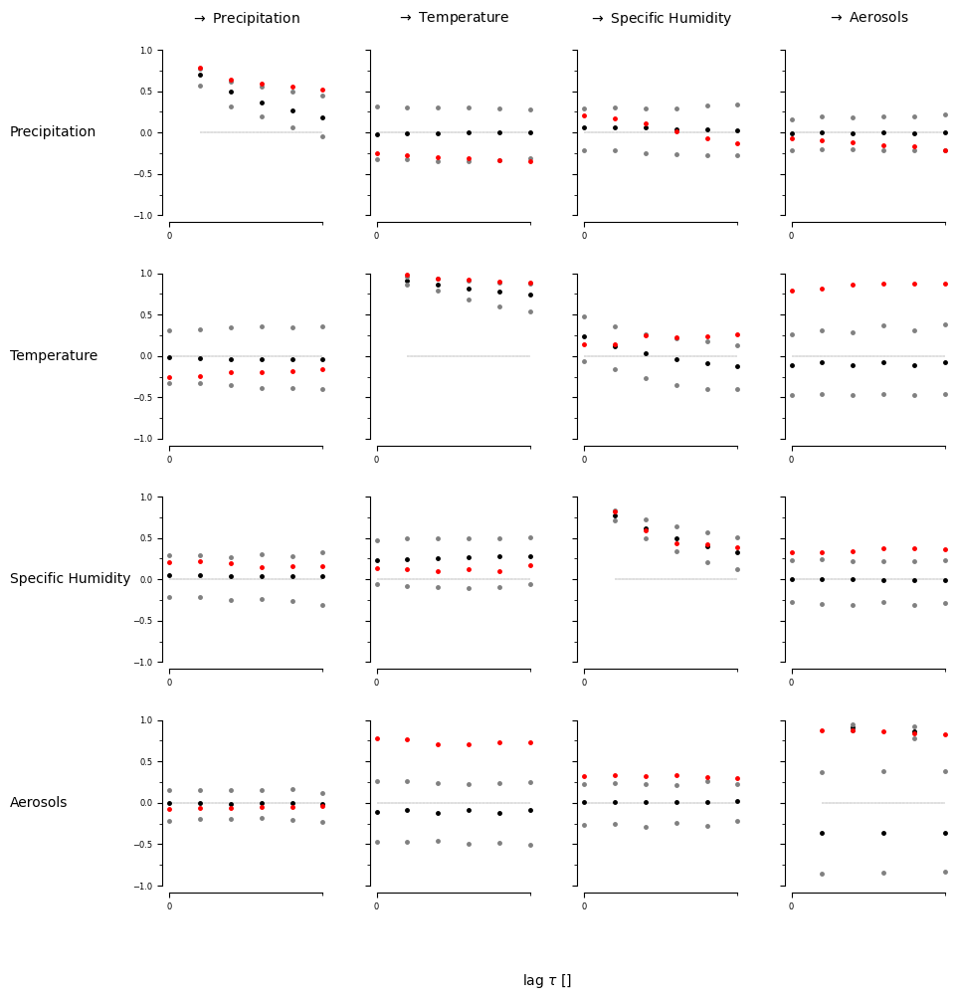

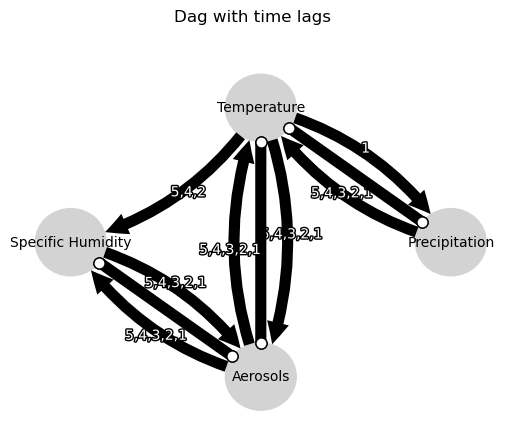

Negative precipitation values: 0


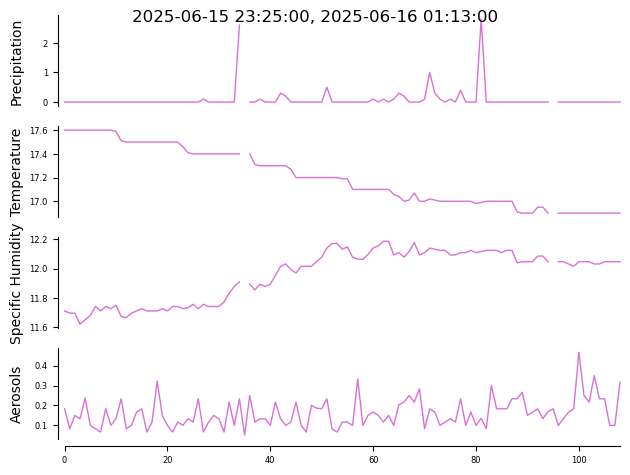

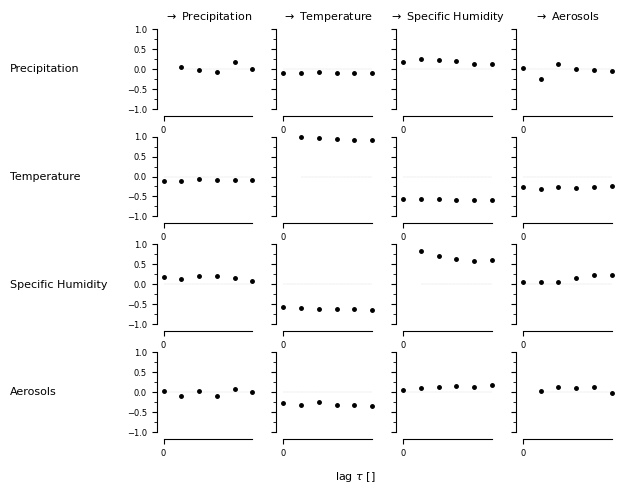

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


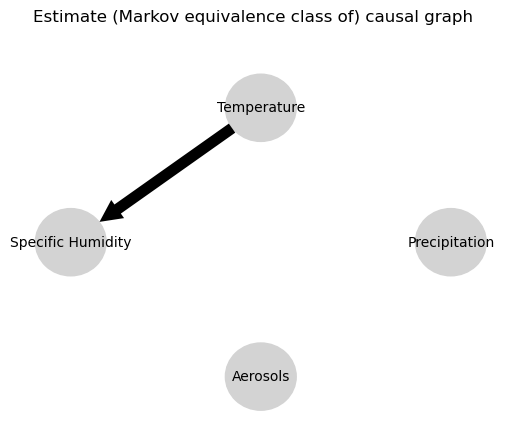

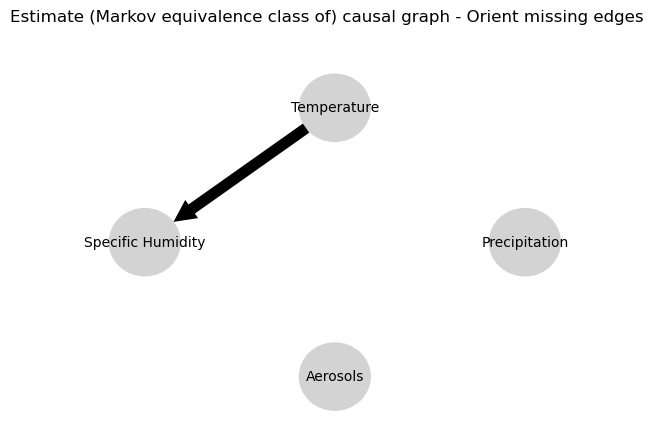

0.0
-0.002148711126935328
-0.01695116055040609
-0.0129067152281233
0.0017029541562883907
-0.014091586895916637
0.0127515403273876
0.005959967099392762
0.016439795584770035
0.025220450270281133
0.01675100719237578
0.03656499544532247
0.042597202872423336
0.035148238392666745
0.03523098429147016
0.0320552672634013
0.03244150494013539
0.040026424686347505
0.06636882494351554
-0.003671628740309378
0.009254057112224318
-0.036051035294452985
-0.00881125660501278
-0.01285904295861297
0.0127515403273876
-0.02667065848915286
-0.03536984119113692
-0.044381156930578654
-0.024827244480133154
-0.019501341719399466
0.0
0.8514119565295466
0.7706911753898297
0.7011522114324313
0.6485940424350618
0.6002777694178899
0.5648636690524617
0.491292409421584
0.441005771770474
0.3924142542551872
0.35021850101528623
0.31691805046014504
-0.0006652857255943481
0.03182607062728556
0.036508519878445736
0.03139787006193493
0.0237775153662893
0.024196176137718125
0.5648636690524617
0.5055619286183646
0.46204199634039

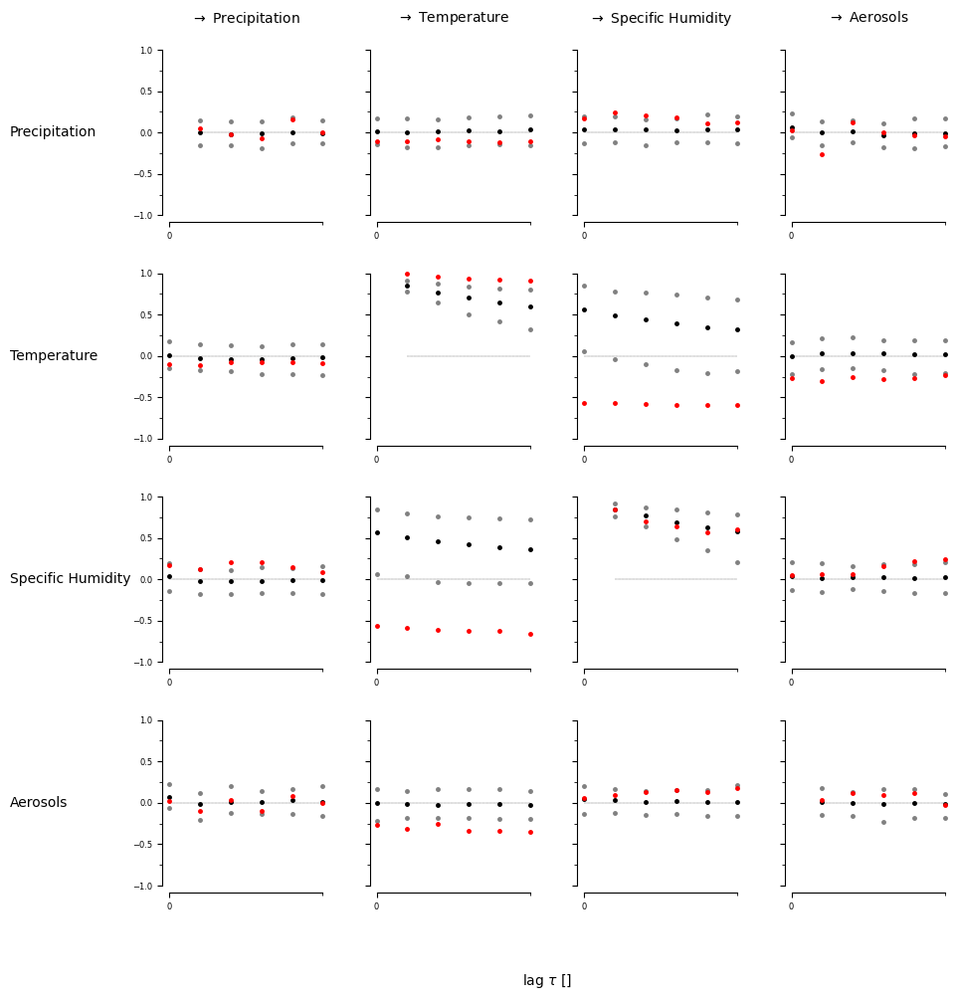

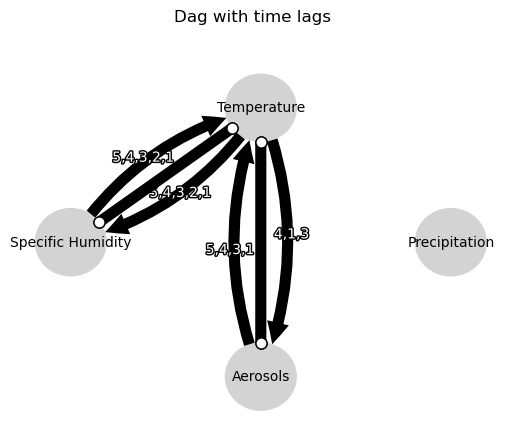

Negative precipitation values: 0


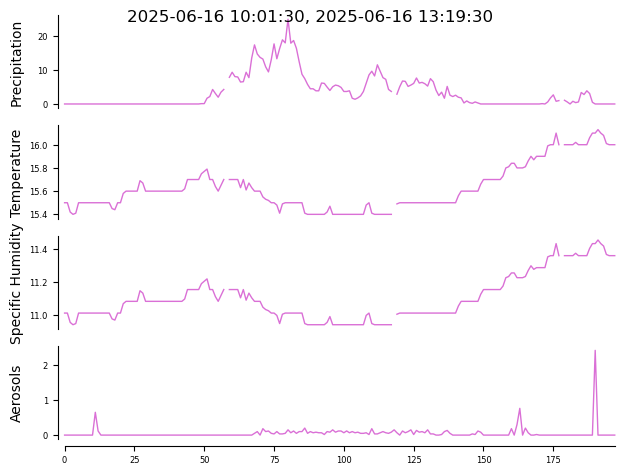

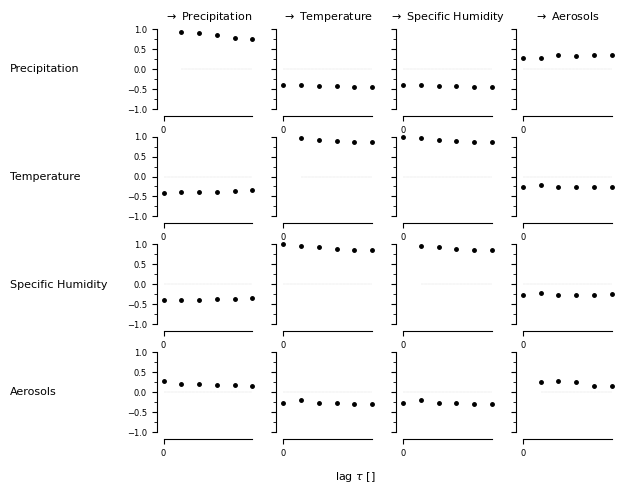

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


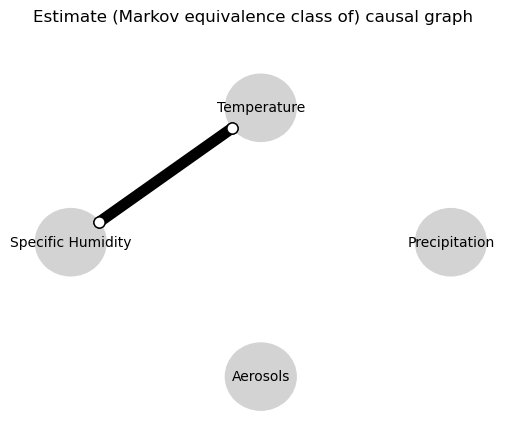

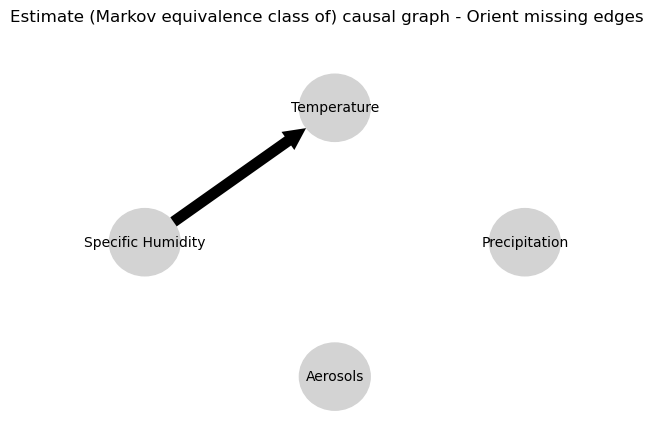

0.0
0.8797274124996106
0.8057551374905995
0.7430992505663977
0.6821961090577046
0.633096990602866
-0.004896958531451526
0.004042498008540209
0.007545761559021959
0.013482882317929783
0.01027148134082744
0.01960291113994303
-0.004613144322029203
0.004214451917838413
0.007360905839100363
0.013643780292125764
0.010735061561312017
0.019680134396641374
-0.02422192326854466
-0.004724686575064185
-0.0015599043246968518
-0.006743308978946733
-0.01274003839551991
-0.006742621695752618
-0.004896958531451526
-0.0005569896089964383
0.0012292488507066744
-0.0073607552868944935
-0.011816663343475555
-0.00563483967676506
0.0
0.007942590461205714
-0.010100213477753764
-0.016261960877822126
0.0005567750286274331
0.007235396372388089
0.9994024841293574
0.008024849767194113
-0.010353606285942223
-0.016088383454991036
0.0004904825704718299
0.006811115883584088
0.0615904220376749
-0.0024950386130665036
-0.01207289858341326
-0.0032871860822065247
0.0014961637610932655
0.00401020302475868
0.9994024841293574


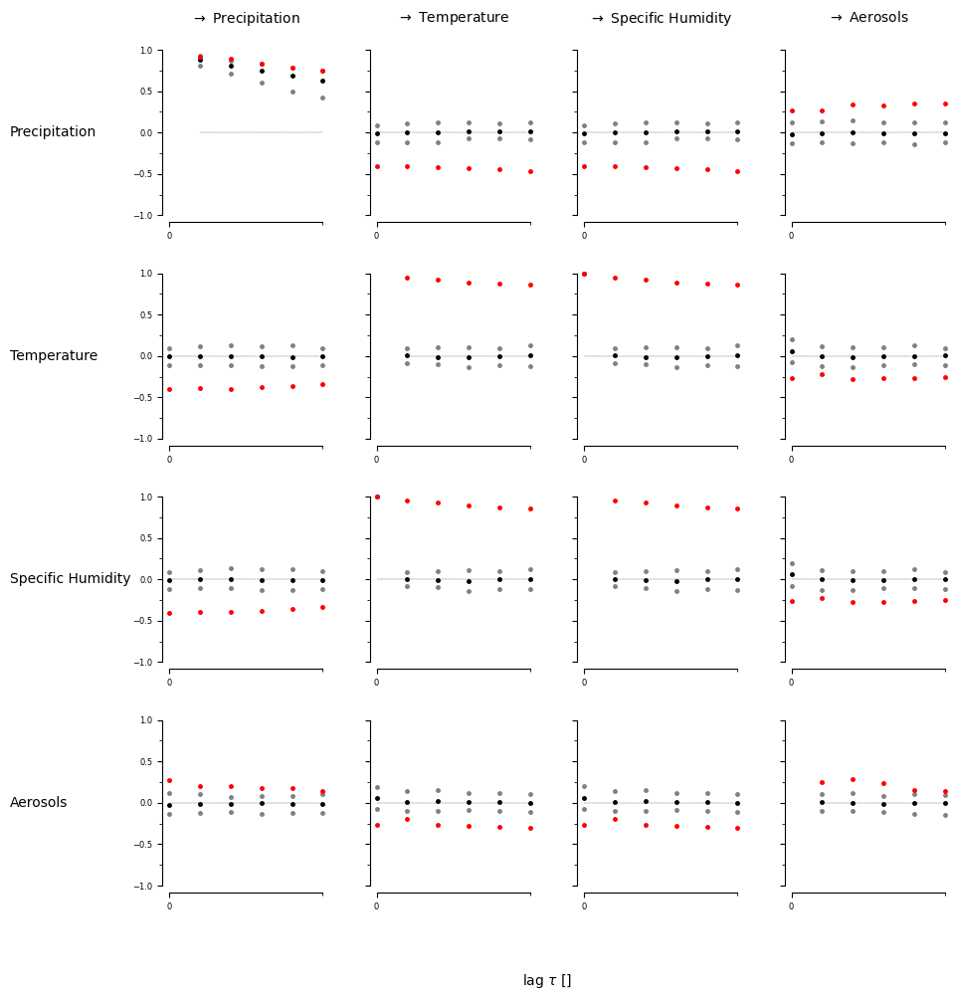

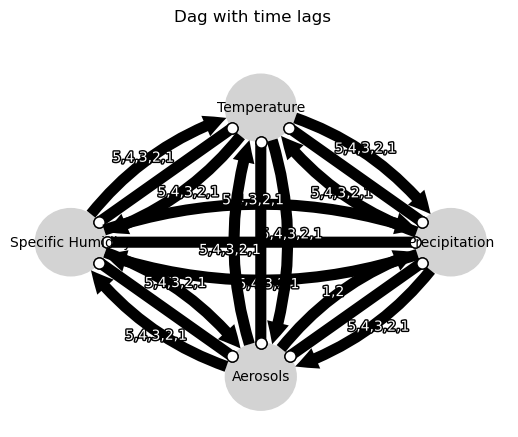

Negative precipitation values: 0


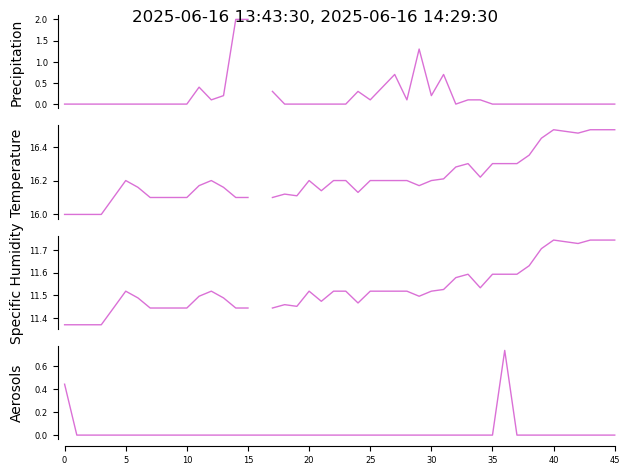

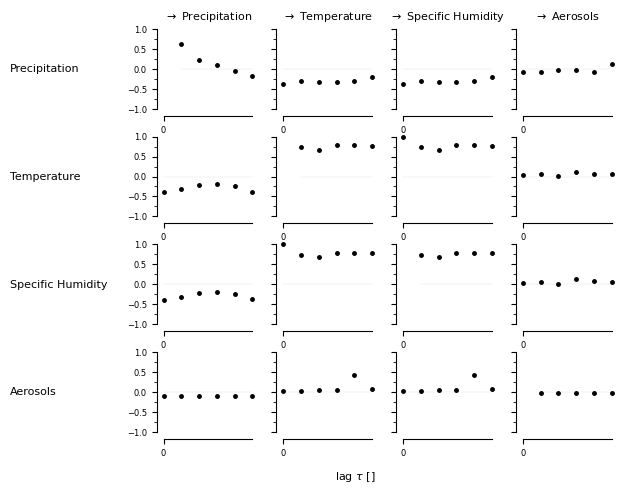

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


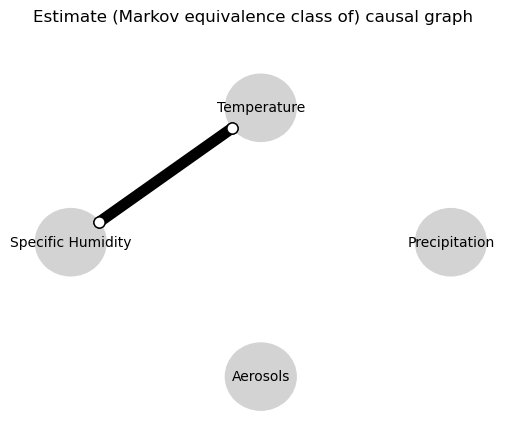

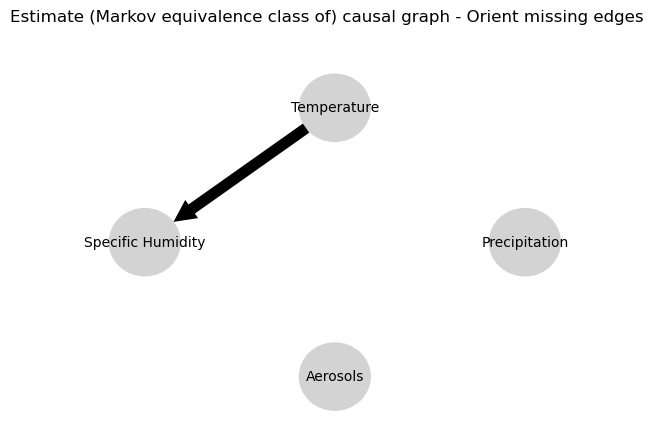

0.0
0.4644089829071511
0.24021237134853418
0.10040267769556659
0.01836117258348395
-0.01947068500368051
-0.18345104606437398
-0.004633447177491001
0.015287389864934227
0.02627377850460971
0.01577760365742551
0.03420242110612219
-0.18277148550495778
-0.004799956050006031
0.01607429682861191
0.026438323395194932
0.016309981888387483
0.034885987221957196
-0.008263688528943446
0.03480222847432228
0.01316398604043974
0.027313288846833105
0.003410072525064301
-0.02508550036758044
-0.18345104606437398
-0.11527169864900925
-0.03733397145744107
0.00271589440708624
0.012501727387808095
-0.006388036142149006
0.0
-0.03634665495469613
-0.0698302023156151
-0.018354719928905992
-0.043989100733384315
-0.022998614096391742
0.9998537311232141
-0.03670141583010509
-0.06967329024602038
-0.018729435948638195
-0.04399000302132853
-0.02273086874689204
0.057646737781800746
-0.0056927966422640145
0.019909613653248746
-0.02570556792362923
0.01352388906128957
0.008923582804626002
0.9998537311232141
-0.0360636143

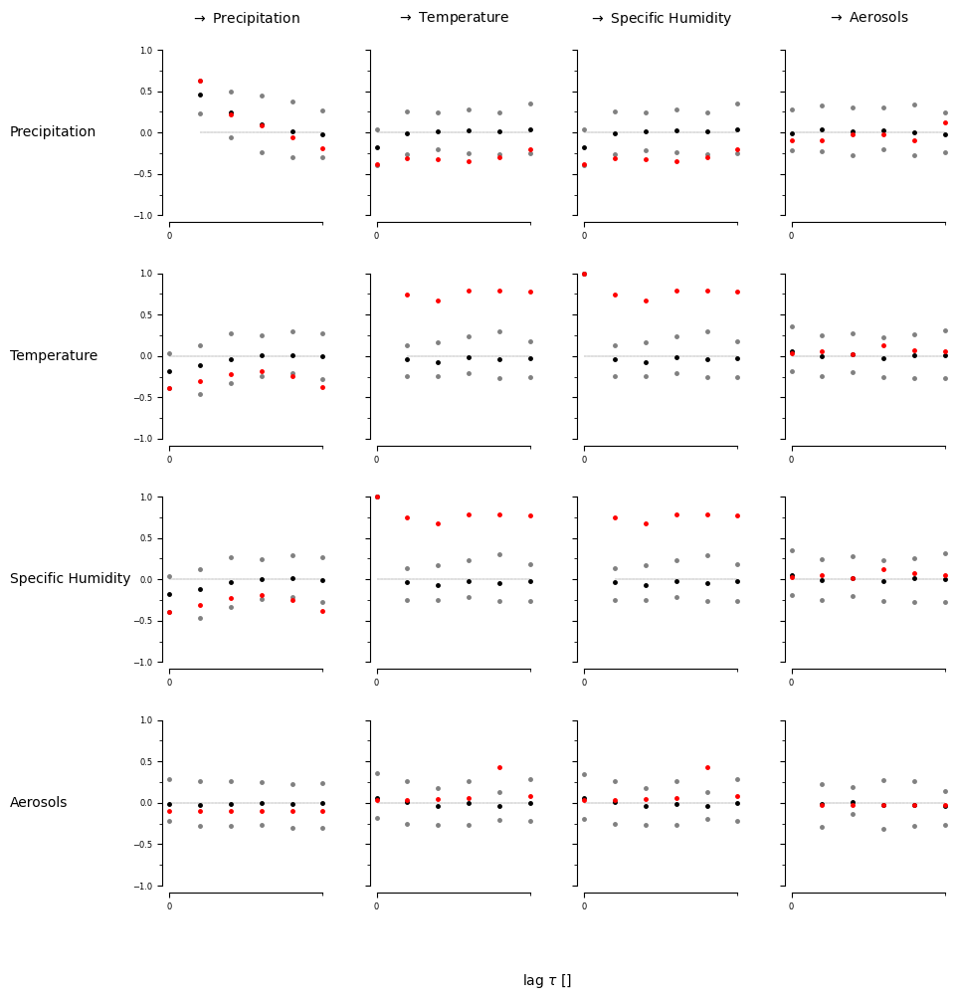

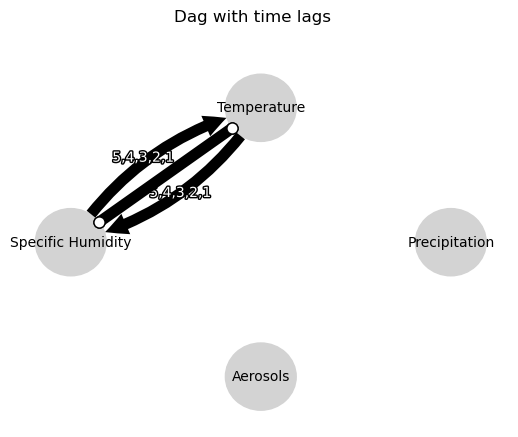

Negative precipitation values: 0


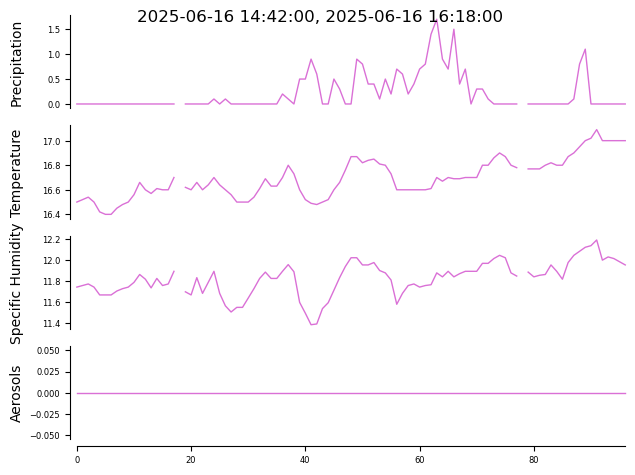

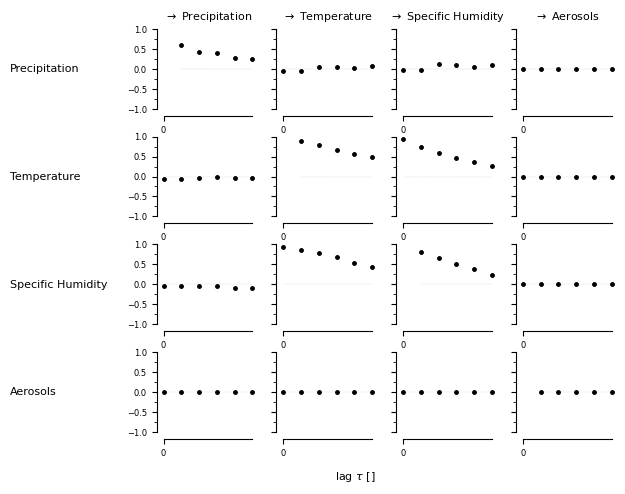

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']


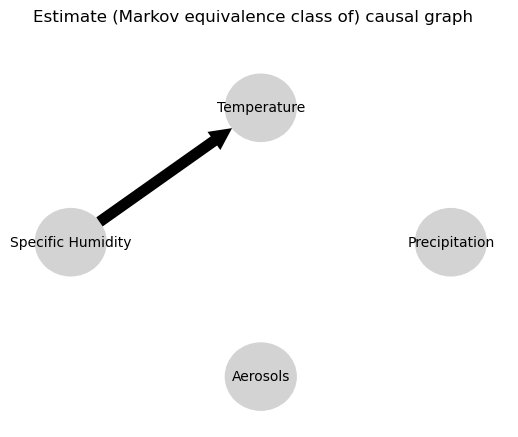

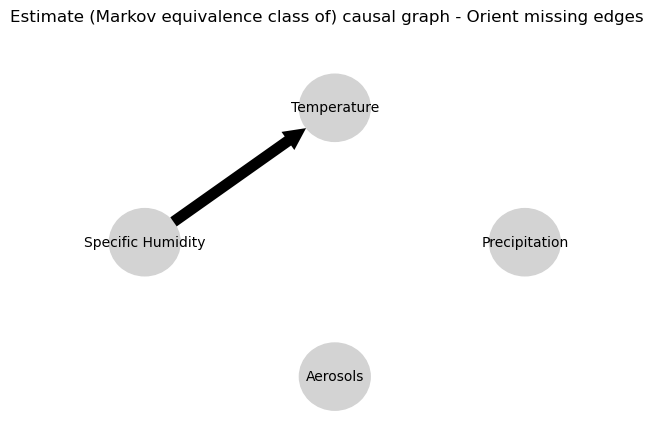

0.0
0.5590097266441889
0.326546072810256
0.18512447980968397
0.09397480037035227
0.03712036477966192
-0.0443017006612496
-0.021591472321355568
-0.0008057501610658361
0.008882340851403752
-0.004327031403471523
-0.026851487928355344
-0.05370052345872585
0.00974821093712168
0.02029785194410186
0.02370940558850127
-0.000412884214005102
-0.017493185568168205
0.0
0.0
0.0
0.0
0.0
0.0
-0.0443017006612496
-0.020827872426844588
-0.022793216690407788
-0.009788434040839062
-0.012599069835271114
-0.013635143063097321
0.0
0.5847176588779943
0.3579033978202794
0.22210054760975376
0.13856194878736275
0.0846127427384759
0.6447430866043972
-0.044029774283793136
-0.026941308075689098
-0.013123798064192482
-0.011876095933738527
-0.013311422319859339
0.0
0.0
0.0
0.0
0.0
0.0
0.6447430866043972
0.40123204874052976
0.23516003851424228
0.15790315658661352
0.10235523664556608
0.06363064149811896
0.0
-0.007597182008655056
-0.02538877742883373
-0.004588666905588595
-0.003179181534277597
-0.014017680268901682
0.0


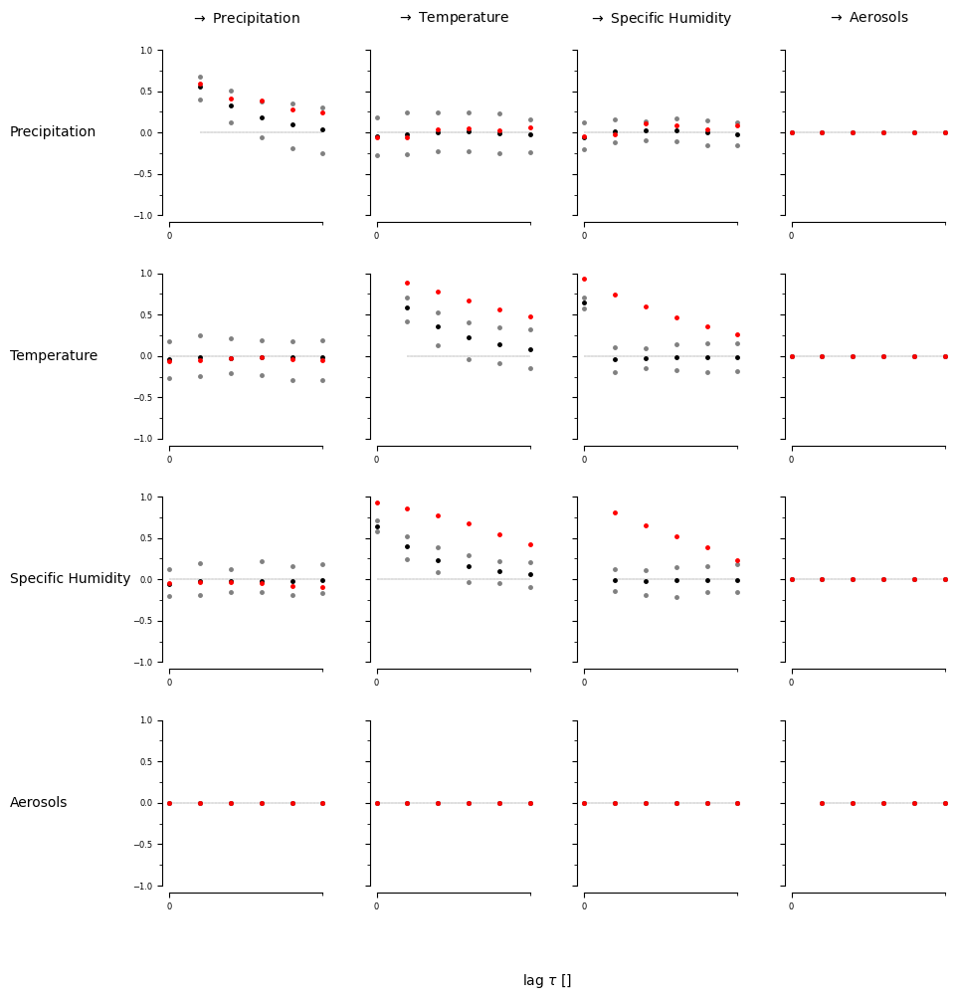

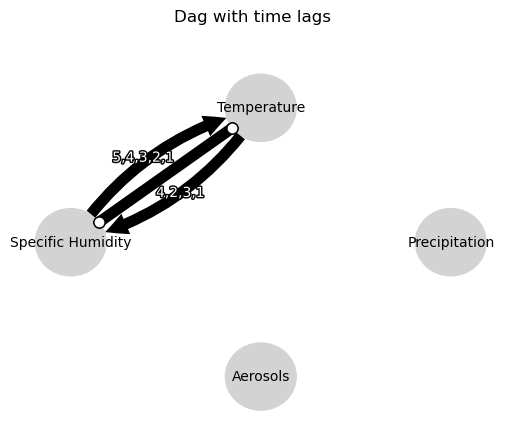

In [27]:
precipitaction = []

# Store Time lags
P_P_elem = []
P_T_elem = []
P_H_elem = []
P_aero_elem = []

T_P_elem = []
T_T_elem = []
T_H_elem = []
T_aero_elem = []

H_P_elem = []
H_T_elem = []
H_H_elem = []
H_aero_elem = []

aero_P_elem = []
aero_T_elem = []
aero_H_elem = []
aero_aero_elem = []

#Store Correlation coeficients
P_P_coef = []
P_T_coef = []
P_H_coef = []
P_aero_coef = []

T_P_coef = []
T_T_coef = []
T_H_coef = []
T_aero_coef = []

H_P_coef = []
H_T_coef = []
H_H_coef = []
H_aero_coef = []

aero_P_coef = []
aero_T_coef = []
aero_H_coef = []
aero_aero_coef = []


a=0
 
data = pd.read_csv(path + f"{site}_minute_meteorological_with_aerosols_data_wxt.csv")

with PdfPages(path + f'plots/{site}_min_rain_plots_aerosol.pdf') as pdf:
    
    for rain in events:

        var_names = ['Precipitation','Temperature', "Specific Humidity", "Aerosols"]
       
        data = pd.read_csv(path + f"{site}_minute_meteorological_with_aerosols_data_wxt.csv")

        data.index = pd.to_datetime(data['time'])

        data = data[str(events[a][0]): str(events[a][1])]
        
#         data_precip = data[str(only_r_events[a][0]): str(only_r_events[a][1])]

#         mean_precip = np.mean(data_precip['wxt_precip_rate_mean'])   
        
#         print(mean_precip)             
#         precipitaction.append(mean_precip)

        ##############################################################################################

        data['time'] = pd.to_datetime(data['time'])

        data.set_index('time', inplace=True)

        resampled = data.resample('1min').mean(numeric_only=True)
        
        # Optionally drop some columns and clean
        numeric = resampled[["wxt_precip_rate_mean", "temp_mean", "specific_humidity", "total_count"]]

        negative_precip_mask = numeric["wxt_precip_rate_mean"] < 0
        
        print(f"Negative precipitation values: {negative_precip_mask.sum()}")

        data_array = numeric.to_numpy()
        
        T, N = data_array.shape

#         # Create mask: True where data is missing
#         mask = np.isnan(data_array)

        data_array[negative_precip_mask.to_numpy(), :] = 999999  

        # Replace NaNs in the data with a placeholder (Tigramite default: 999999)
        data_array[np.isnan(data_array)] = 999999

        try: 
            # Create Tigramite DataFrame
            dataframe = pp.DataFrame(data_array,
                                        var_names=var_names,
                                        missing_flag=999999)


            ######################################## PLOTTING  #############################################

            fig, axes = tp.plot_timeseries(dataframe=dataframe, color='orchid')


            # Change font size of y-labels
            for ax in axes:
                ax.set_ylabel(ax.get_ylabel(), fontsize=10) 


            fig.suptitle(f"{events[a][0]}, {events[a][1]}")

            # Align y-axis labels
            fig.align_ylabels(axes)
            plt.show()

            pdf.savefig(fig)  # Save this figure to PDF
            plt.close(fig)    # Close to free memory


            a=a+1


            ###############################################################################################

            tau_max = 5

            parcorr = RobustParCorr(significance='analytic', 
                #                   mask_type='y'
                             )
            pcmci = PCMCI(
                dataframe=dataframe, 
                cond_ind_test=parcorr,
                verbosity=0)

            P_P = []
            P_T = []
            P_H = []
            P_aero =[]

            T_P = []
            T_T = []
            T_H = []
            T_aero = []

            H_P = []
            H_T = []
            H_H = []
            H_aero = []

            aero_P = []
            aero_T = []
            aero_H = []
            aero_aero = []

            ################################

            P_P_c = []
            P_T_c = []
            P_H_c = []
            P_aero_c = []

            T_P_c = []
            T_T_c = []
            T_H_c = []
            T_aero_c = []

            H_P_c = []
            H_T_c = []
            H_H_c = []
            H_aero_c = []

            aero_P_c = []
            aero_T_c = []
            aero_H_c = []
            aero_aero_c = []

            #####################################################################################
            try:


                original_correlations = pcmci.get_lagged_dependencies(tau_max=tau_max, val_only=True)['val_matrix']

                lag_func_matrix = tp.plot_lagfuncs(val_matrix = original_correlations, 
                                                   setup_args = {'var_names':var_names, 
                                                                 'x_base':20, 'y_base':.5,
                                                                 'label_fontsize': 8,
                                                                 'label_space_left':0.25})


                print(dir(lag_func_matrix))
                plt.show()

                results = pcmci.run_pcmciplus(tau_max=tau_max, pc_alpha=0.01)

                ##################################### Plotting ####################################################

                fig, axes = tp.plot_graph(results['graph'], var_names=var_names, node_size=0.5)

                fig.suptitle(f"Estimate (Markov equivalence class of) causal graph")

                # Align y-axis labels
                fig.align_ylabels(axes)
                plt.show()

                ####################################################################################################

                val_matrix = results['val_matrix']
                variable_order = np.argsort(
                                    np.abs(val_matrix).sum(axis=(0,2)))[::-1]

                # Transform conflicting links to unoriented links as a hack, might not work...
                graph = results['graph']
                graph[graph=='x-x'] = 'o-o'
                dag = pcmci._get_dag_from_cpdag(
                                cpdag_graph=graph,
                                variable_order=variable_order)

                ##################################### Plotting ####################################################

                fig, axes = tp.plot_graph(dag, var_names = var_names, node_size=0.5)


                fig.suptitle(f"Estimate (Markov equivalence class of) causal graph - Orient missing edges")

                # Align y-axis labels
                fig.align_ylabels(axes)
                plt.show()

                ####################################################################################################

                parents = toys.dag_to_links(dag)
                #print(parents)

                ###################################################################################################

                realizations = 50


                generator = surrogate_generator.generate_linear_model_from_data(dataframe, parents, tau_max, realizations=realizations, 
                            generate_noise_from='covariance')

                datasets = {}
                for r in range(realizations):
                    datasets[r] = next(generator)

                #####################################################################################################

                correlations = np.zeros((realizations, N, N, tau_max + 1))

                for r in range(realizations):
                    pcmci = PCMCI(
                        dataframe=pp.DataFrame(datasets[r]), 
                        cond_ind_test=RobustParCorr(),
                        verbosity=0)
                    correlations[r] = pcmci.get_lagged_dependencies(tau_max=tau_max, val_only=True)['val_matrix']

                # Get mean and 5th and 95th quantile
                correlation_mean = correlations.mean(axis=0)

                correlation_interval = np.percentile(correlations, q=[5, 95], axis=0)

                #met_vars = ["Precipitation", "Temperature", "Specific Humidity"]
                met_vars = ['Precipitation','Temperature', "Specific Humidity", "Aerosols"]

                for index in range(4):  # effect variable
                    for ind in range(4):  # cause variable

                        effect_var = met_vars[index]
                        cause_var = met_vars[ind]

                        for coefficient, element in enumerate(correlation_mean[index][ind]):

                                if effect_var == "Precipitation":
                                    if cause_var == "Precipitation":
                                        print(element)
                                        P_P_c.append(element)
                                    elif cause_var == "Temperature":
                                        print(element)
                                        P_T_c.append(element)
                                    elif cause_var == "Specific Humidity":
                                        print(element)
                                        P_H_c.append(element)
                                    elif cause_var == "Aerosols":
                                        print(element)
                                        P_aero_c.append(element)

                                ####################################

                                elif effect_var == "Temperature":
                                    if cause_var == "Precipitation":
                                        print(element)
                                        T_P_c.append(element)
                                    elif cause_var == "Temperature":
                                        print(element)
                                        T_T_c.append(element)
                                    elif cause_var == "Specific Humidity":
                                        print(element)
                                        T_H_c.append(element)
                                    elif cause_var == "Aerosols":
                                        print(element)
                                        T_aero_c.append(element)

                                ####################################

                                elif effect_var == "Specific Humidity":
                                    if cause_var == "Precipitation":
                                        #print(element)
                                        H_P_c.append(element)
                                    elif cause_var == "Temperature":
                                        print(element)
                                        H_T_c.append(element)
                                    elif cause_var == "Specific Humidity":
                                        print(element)
                                        H_H_c.append(element)
                                    elif cause_var == "Aerosols":
                                        print(element)
                                        H_aero_c.append(element)


                                ####################################

                                elif effect_var == "Aerosols":
                                    if cause_var == "Precipitation":
                                        #print(element)
                                        aero_P_c.append(element)
                                    elif cause_var == "Temperature":
                                        print(element)
                                        aero_T_c.append(element)
                                    elif cause_var == "Specific Humidity":
                                        print(element)
                                        aero_H_c.append(element)
                                    elif cause_var == "Aerosols":
                                        print(element)
                                        aero_aero_c.append(element)


                P_P_coef.append(P_P_c)
                P_T_coef.append(P_T_c)
                P_H_coef.append(P_H_c)
                P_aero_coef.append(P_aero_c)

                T_P_coef.append(T_P_c)
                T_T_coef.append(T_T_c)
                T_H_coef.append(T_H_c)
                T_aero_coef.append(T_aero_c)

                H_P_coef.append(H_P_c)
                H_T_coef.append(H_T_c)
                H_H_coef.append(H_H_c)
                H_aero_coef.append(H_aero_c)

                aero_P_coef.append(aero_P_c)
                aero_T_coef.append(aero_T_c)
                aero_H_coef.append(aero_H_c)
                aero_aero_coef.append(aero_aero_c)


                # Plot lag functions of mean and 5th and 95th quantile together with original correlation in one plot
                lag_func_matrix = tp.setup_matrix(N=N, tau_max=tau_max, x_base=10, figsize=(10, 10), var_names=var_names, label_space_left=0.17)
                lag_func_matrix.add_lagfuncs(val_matrix=correlation_mean, color='black')
                lag_func_matrix.add_lagfuncs(val_matrix=correlation_interval[0], color='grey')
                lag_func_matrix.add_lagfuncs(val_matrix=correlation_interval[1], color='grey')
                lag_func_matrix.add_lagfuncs(val_matrix=original_correlations, color='red')
                lag_func_matrix.savefig(name=None)

                pcmci = PCMCI(
                    dataframe=dataframe, 
                    cond_ind_test=parcorr,
                    verbosity=0)

                original_correlations_pvals = pcmci.get_lagged_dependencies(tau_max=tau_max)['p_matrix'] 

                graph = original_correlations_pvals<0.01

                fig, axes = tp.plot_graph(graph=graph, var_names=var_names, node_size=0.5)

                fig.suptitle(f"Dag with time lags")

                # Align y-axis labels
                fig.align_ylabels(axes)
                plt.show()

                pdf.savefig(fig)  # Save this figure to PDF
                plt.close(fig)    # Close to free memory

                for index in range(4):  # effect variable
                    for ind in range(4):  # cause variable

                        effect_var = met_vars[index]
                        cause_var = met_vars[ind]

                        for lag, element in enumerate(graph[index][ind]):

                            if element == True:  
                                if effect_var == "Precipitation":
                                    if cause_var == "Precipitation":
                                        P_P.append(lag)
                                    elif cause_var == "Temperature":
                                        P_T.append(lag)
                                    elif cause_var == "Specific Humidity":
                                        P_H.append(lag)
                                    elif cause_var == "Aerosols":
                                        P_aero.append(lag)

                                ####################################

                                elif effect_var == "Temperature":
                                    if cause_var == "Precipitation":
                                        T_P.append(lag)
                                    elif cause_var == "Temperature":
                                        T_T.append(lag)
                                    elif cause_var == "Specific Humidity":
                                        T_H.append(lag)
                                    elif cause_var == "Aerosols":
                                        T_aero.append(lag)

                                ####################################

                                elif effect_var == "Specific Humidity":
                                    if cause_var == "Precipitation":
                                        H_P.append(lag)
                                    elif cause_var == "Temperature":
                                        H_T.append(lag)
                                    elif cause_var == "Specific Humidity":
                                        H_H.append(lag)
                                    elif cause_var == "Aerosols":
                                        H_aero.append(lag)

                                ####################################

                                elif effect_var == "Aerosols":
                                    if cause_var == "Precipitation":
                                        aero_P.append(lag)
                                    elif cause_var == "Temperature":
                                        aero_T.append(lag)
                                    elif cause_var == "Specific Humidity":
                                        aero_H.append(lag)
                                    elif cause_var == "Aerosols":
                                        aero_aero.append(lag)

                            else:
                                element == False

                P_P_elem.append(P_P)
                P_T_elem.append(P_T)
                P_H_elem.append(P_H)
                P_aero_elem.append(P_aero)

                T_P_elem.append(T_P)
                T_T_elem.append(T_T)
                T_H_elem.append(T_H)
                T_aero_elem.append(T_aero)

                H_P_elem.append(H_P)
                H_T_elem.append(H_T)
                H_H_elem.append(H_H)
                H_aero_elem.append(H_aero)

                aero_P_elem.append(aero_P)
                aero_T_elem.append(aero_T)
                aero_H_elem.append(aero_H)
                aero_aero_elem.append(aero_aero)

            except ValueError as e:
                print(f"⚠️ Skipping event {a} ({events[0]} → {events[1]}) due to error: {e}")

                P_P_elem.append(np.nan)
                P_T_elem.append(np.nan)
                P_H_elem.append(np.nan)
                P_aero_elem.append(np.nan)

                T_P_elem.append(np.nan)
                T_T_elem.append(np.nan)
                T_H_elem.append(np.nan)
                T_aero_elem.append(np.nan)

                H_P_elem.append(np.nan)
                H_T_elem.append(np.nan)
                H_H_elem.append(np.nan)
                H_aero_elem.append(np.nan)

                aero_P_elem.append(np.nan)
                aero_T_elem.append(np.nan)
                aero_H_elem.append(np.nan)
                aero_aero_elem.append(np.nan)

                ######################################################################################

                P_P_coef.append(np.nan)
                P_T_coef.append(np.nan)
                P_H_coef.append(np.nan)
                P_aero_coef.append(np.nan)

                T_P_coef.append(np.nan)
                T_T_coef.append(np.nan)
                T_H_coef.append(np.nan)
                T_aero_coef.append(np.nan)

                H_P_coef.append(np.nan)
                H_T_coef.append(np.nan)
                H_H_coef.append(np.nan)
                H_aero_coef.append(np.nan)

                aero_P_coef.append(np.nan)
                aero_T_coef.append(np.nan)
                aero_H_coef.append(np.nan)
                aero_aero_coef.append(np.nan)


                continue
                
        except ValueError as e:
            print(f"⚠️ Skipping event {a} ({events[0]} → {events[1]}) due to error: {e}")
            continue


In [28]:
#rainy_times['mean precipitation'] = precipitaction 


rainy_times['P_P_coef'] = P_P_coef
rainy_times['P_T_coef'] = P_T_coef
rainy_times['P_H_coef'] = P_H_coef
rainy_times['P_aero_coef'] = P_aero_coef

rainy_times['T_P_coef'] = T_P_coef
rainy_times['T_T_coef'] = T_T_coef
rainy_times['T_H_coef'] = T_H_coef
rainy_times['T_aero_coef'] = T_aero_coef

rainy_times['H_P_coef'] = H_P_coef
rainy_times['H_T_coef'] = H_T_coef
rainy_times['H_H_coef'] = H_H_coef
rainy_times['H_aero_coef'] = H_aero_coef

rainy_times['aero_P_coef'] = aero_P_coef
rainy_times['aero_T_coef'] = aero_T_coef
rainy_times['aero_H_coef'] = aero_H_coef
rainy_times['aero_aero_coef'] = aero_aero_coef

############################################################################
rainy_times['P_P_elem'] = P_P_elem 
rainy_times['P_T_elem'] = P_T_elem 
rainy_times['P_H_elem'] = P_H_elem 
rainy_times['P_aero_elem'] = P_aero_elem 

rainy_times['T_P_elem'] = T_P_elem 
rainy_times['T_T_elem'] = T_T_elem 
rainy_times['T_H_elem'] = T_H_elem 
rainy_times['T_aero_elem'] = T_aero_elem 

rainy_times['H_P_elem'] = H_P_elem 
rainy_times['H_T_elem'] = H_T_elem 
rainy_times['H_H_elem'] = H_H_elem
rainy_times['H_aero_elem'] = H_aero_elem

rainy_times['aero_P_elem'] = aero_P_elem 
rainy_times['aero_T_elem'] = aero_T_elem 
rainy_times['aero_H_elem'] = aero_H_elem
rainy_times['aero_aero_elem'] = aero_aero_elem 

rainy_times.to_csv(path + f"{site}_continuous_rain_periods_aerosols.csv",index=False)

In [20]:
site = "S2"

path = f"{site}_data/"

# Rain Events
rainy_times = pd.read_csv(path + f"{site}_extended_rain_windows.csv")

start = rainy_times.extended_start
end   = rainy_times.extended_end

events = list(zip(
    pd.to_datetime(rainy_times['extended_start']),
    pd.to_datetime(rainy_times['extended_end'])
))

########################################################################################

only_rainy_times = pd.read_csv(path + f"{site}_continuous_rain_periods.csv")

start_r = rainy_times.extended_start
end_r   = rainy_times.extended_end

only_r_events = list(zip(
    pd.to_datetime(only_rainy_times['extended_start']),
    pd.to_datetime(only_rainy_times['extended_end'])))

FileNotFoundError: [Errno 2] No such file or directory: 'S3_data/S3_continuous_rain_periods.csv'

In [29]:
a = 0
cumulative_precipitation = []

for rain in events:
    # Data
    data = pd.read_csv(path + f"{site}_minute_meteorological_data_wxt.csv")
    data.index = pd.to_datetime(data['time'])

    # Events
    data = data[str(events[a][0]): str(events[a][1])]

    # Only precipitation time inside the event
    data_precip = data[str(only_r_events[a][0]): str(only_r_events[a][1])]

    dt = 1 / 60

    # Data - precipitation
    precip_rate = data_precip['wxt_precip_rate_mean']
    rain_step = precip_rate * dt
    
    #0+-0.5 uncertainity

    # Calculate rain accumulated
    cumulative_rain = rain_step.cumsum()
    
    print(cumulative_rain)
    
    # Save into array
    cumulative_precipitation.append(cumulative_rain)

    a += 1

    ##############################################################################################

    

time
2024-12-09 15:37:00    0.003333
2024-12-09 15:38:00    0.046667
2024-12-09 15:39:00    0.080000
2024-12-09 15:40:00    0.113333
2024-12-09 15:41:00    0.165000
2024-12-09 15:42:00    0.211667
2024-12-09 15:43:00    0.228333
2024-12-09 15:44:00    0.230000
2024-12-09 15:45:00    0.230000
2024-12-09 15:46:00    0.230000
2024-12-09 15:47:00    0.230000
2024-12-09 15:48:00    0.236667
2024-12-09 15:49:00    0.256667
2024-12-09 15:50:00    0.298333
2024-12-09 15:51:00    0.343333
2024-12-09 15:52:00    0.370000
2024-12-09 15:53:00    0.410000
2024-12-09 15:54:00    0.446667
2024-12-09 15:55:00    0.486667
2024-12-09 15:56:00    0.536667
2024-12-09 15:57:00    0.578333
2024-12-09 15:58:00    0.598333
2024-12-09 15:59:00    0.608333
2024-12-09 16:01:00    0.610000
2024-12-09 16:02:00    0.610000
2024-12-09 16:03:00    0.615000
2024-12-09 16:04:00    0.615000
2024-12-09 16:05:00    0.615000
2024-12-09 16:06:00    0.615000
2024-12-09 16:07:00    0.615000
2024-12-09 16:08:00    0.615000
202

time
2024-12-16 07:03:00    0.006667
2024-12-16 07:04:00    0.040000
2024-12-16 07:05:00    0.095000
2024-12-16 07:06:00    0.125000
2024-12-16 07:07:00    0.141667
                         ...   
2024-12-16 08:51:00    3.260000
2024-12-16 08:52:00    3.296667
2024-12-16 08:53:00    3.348333
2024-12-16 08:54:00    3.385000
2024-12-16 08:55:00    3.396667
Name: wxt_precip_rate_mean, Length: 112, dtype: float64
time
2024-12-16 09:11:00    0.016667
2024-12-16 09:12:00    0.018333
2024-12-16 09:13:00    0.021667
2024-12-16 09:14:00    0.021667
2024-12-16 09:15:00    0.021667
2024-12-16 09:16:00    0.021667
2024-12-16 09:17:00    0.028333
2024-12-16 09:18:00    0.038333
2024-12-16 09:19:00    0.041667
2024-12-16 09:20:00    0.043333
2024-12-16 09:21:00    0.043333
2024-12-16 09:22:00    0.060000
2024-12-16 09:23:00    0.088333
2024-12-16 09:24:00    0.093333
2024-12-16 09:25:00    0.105000
2024-12-16 09:26:00    0.111667
2024-12-16 09:27:00    0.113333
2024-12-16 09:28:00    0.133333
2024-1

time
2024-12-28 05:53:00    0.001667
2024-12-28 05:54:00    0.003333
2024-12-28 05:55:00    0.008333
2024-12-28 05:56:00    0.008333
2024-12-28 05:57:00    0.008333
2024-12-28 05:58:00    0.008333
2024-12-28 05:59:00    0.013333
2024-12-28 06:01:00    0.013333
2024-12-28 06:02:00    0.013333
2024-12-28 06:03:00    0.015000
2024-12-28 06:04:00    0.020000
2024-12-28 06:05:00    0.031667
2024-12-28 06:06:00    0.038333
2024-12-28 06:07:00    0.053333
2024-12-28 06:08:00    0.055000
2024-12-28 06:09:00    0.055000
2024-12-28 06:10:00    0.055000
2024-12-28 06:11:00    0.055000
2024-12-28 06:12:00    0.055000
2024-12-28 06:13:00    0.055000
2024-12-28 06:14:00    0.055000
2024-12-28 06:15:00    0.055000
2024-12-28 06:16:00    0.056667
2024-12-28 06:17:00    0.061667
2024-12-28 06:18:00    0.073333
2024-12-28 06:19:00    0.078333
2024-12-28 06:20:00    0.078333
2024-12-28 06:21:00    0.078333
2024-12-28 06:22:00    0.088333
2024-12-28 06:23:00    0.101667
2024-12-28 06:24:00    0.105000
Nam

time
2025-01-01 01:33:00    0.171667
2025-01-01 01:34:00    0.435000
2025-01-01 01:35:00    0.441667
2025-01-01 01:36:00    0.455000
2025-01-01 01:37:00    0.461667
2025-01-01 01:38:00    0.463333
2025-01-01 01:39:00    0.463333
2025-01-01 01:40:00    0.463333
2025-01-01 01:41:00    0.463333
2025-01-01 01:42:00    0.463333
2025-01-01 01:43:00    0.463333
2025-01-01 01:44:00    0.463333
2025-01-01 01:45:00    0.463333
2025-01-01 01:46:00    0.463333
2025-01-01 01:47:00    0.488333
2025-01-01 01:48:00    0.530000
2025-01-01 01:49:00    0.633333
2025-01-01 01:50:00    0.701667
2025-01-01 01:51:00    0.788333
2025-01-01 01:52:00    1.026667
2025-01-01 01:53:00    1.273333
2025-01-01 01:54:00    1.486667
2025-01-01 01:55:00    1.560000
2025-01-01 01:56:00    1.603333
2025-01-01 01:57:00    1.613333
2025-01-01 01:58:00    1.616667
Name: wxt_precip_rate_mean, dtype: float64
time
2025-01-03 22:36:00    0.015000
2025-01-03 22:37:00    0.031667
2025-01-03 22:38:00    0.036667
2025-01-03 22:39:00

time
2025-01-31 16:18:00     0.013333
2025-01-31 16:19:00     0.025000
2025-01-31 16:20:00     0.045000
2025-01-31 16:21:00     0.081667
2025-01-31 16:22:00     0.141667
                         ...    
2025-01-31 18:59:00    17.898333
2025-01-31 19:01:00    17.968333
2025-01-31 19:02:00    17.990000
2025-01-31 19:03:00    18.003333
2025-01-31 19:04:00    18.008333
Name: wxt_precip_rate_mean, Length: 164, dtype: float64
time
2025-02-01 00:36:00     0.001667
2025-02-01 00:37:00     0.001667
2025-02-01 00:38:00     0.001667
2025-02-01 00:39:00     0.001667
2025-02-01 00:40:00     0.001667
                         ...    
2025-02-01 05:46:00    15.288333
2025-02-01 05:47:00    15.326667
2025-02-01 05:48:00    15.345000
2025-02-01 05:49:00    15.348333
2025-02-01 05:50:00    15.351667
Name: wxt_precip_rate_mean, Length: 310, dtype: float64
time
2025-02-06 04:38:00    0.008333
2025-02-06 04:39:00    0.018333
2025-02-06 04:40:00    0.028333
2025-02-06 04:41:00    0.040000
2025-02-06 04:42:00

time
2025-02-16 07:45:00    0.006667
2025-02-16 07:46:00    0.056667
2025-02-16 07:47:00    0.075000
2025-02-16 07:48:00    0.091667
2025-02-16 07:49:00    0.128333
2025-02-16 07:50:00    0.181667
2025-02-16 07:51:00    0.263333
2025-02-16 07:52:00    0.301667
2025-02-16 07:53:00    0.315000
2025-02-16 07:54:00    0.366667
2025-02-16 07:55:00    0.385000
2025-02-16 07:56:00    0.403333
2025-02-16 07:57:00    0.411667
2025-02-16 07:58:00    0.418333
2025-02-16 07:59:00    0.421667
2025-02-16 08:01:00    0.421667
2025-02-16 08:02:00    0.421667
2025-02-16 08:03:00    0.421667
2025-02-16 08:04:00    0.421667
2025-02-16 08:05:00    0.426667
2025-02-16 08:06:00    0.525000
2025-02-16 08:07:00    0.595000
2025-02-16 08:08:00    0.723333
2025-02-16 08:09:00    0.795000
2025-02-16 08:10:00    0.836667
2025-02-16 08:11:00    0.876667
2025-02-16 08:12:00    0.936667
2025-02-16 08:13:00    0.960000
2025-02-16 08:14:00    0.973333
Name: wxt_precip_rate_mean, dtype: float64
time
2025-02-16 08:25:00

time
2025-03-21 03:49:00    0.001667
2025-03-21 03:50:00    0.025000
2025-03-21 03:51:00    0.058333
2025-03-21 03:52:00    0.096667
2025-03-21 03:53:00    0.118333
2025-03-21 03:54:00    0.141667
2025-03-21 03:55:00    0.175000
2025-03-21 03:56:00    0.213333
2025-03-21 03:57:00    0.260000
2025-03-21 03:58:00    0.295000
2025-03-21 03:59:00    0.341667
2025-03-21 04:01:00    0.365000
2025-03-21 04:02:00    0.366667
2025-03-21 04:03:00    0.370000
2025-03-21 04:04:00    0.376667
2025-03-21 04:05:00    0.396667
2025-03-21 04:06:00    0.405000
2025-03-21 04:07:00    0.406667
2025-03-21 04:08:00    0.430000
2025-03-21 04:09:00    0.451667
2025-03-21 04:10:00    0.485000
2025-03-21 04:11:00    0.513333
2025-03-21 04:12:00    0.518333
2025-03-21 04:13:00    0.518333
2025-03-21 04:14:00    0.520000
2025-03-21 04:15:00    0.530000
Name: wxt_precip_rate_mean, dtype: float64
time
2025-03-24 09:43:00     0.016667
2025-03-24 09:44:00     0.018333
2025-03-24 09:45:00     0.018333
2025-03-24 09:46

time
2025-04-11 01:27:00    0.001667
2025-04-11 01:28:00    0.001667
2025-04-11 01:29:00    0.001667
2025-04-11 01:30:00    0.001667
2025-04-11 01:31:00    0.001667
                         ...   
2025-04-11 02:40:00    0.415000
2025-04-11 02:41:00    0.420000
2025-04-11 02:42:00    0.425000
2025-04-11 02:43:00    0.428333
2025-04-11 02:44:00    0.431667
Name: wxt_precip_rate_mean, Length: 77, dtype: float64
time
2025-04-11 06:20:00    0.010000
2025-04-11 06:21:00    0.028333
2025-04-11 06:22:00    0.045000
2025-04-11 06:23:00    0.066667
2025-04-11 06:24:00    0.088333
2025-04-11 06:25:00    0.115000
2025-04-11 06:26:00    0.160000
2025-04-11 06:27:00    0.176667
2025-04-11 06:28:00    0.193333
2025-04-11 06:29:00    0.196667
2025-04-11 06:30:00    0.196667
2025-04-11 06:31:00    0.196667
2025-04-11 06:32:00    0.196667
2025-04-11 06:33:00    0.196667
2025-04-11 06:34:00    0.201667
2025-04-11 06:35:00    0.201667
2025-04-11 06:36:00    0.201667
2025-04-11 06:37:00    0.201667
2025-04

time
2025-04-15 16:09:00    0.008333
2025-04-15 16:10:00    0.046667
2025-04-15 16:11:00    0.056667
2025-04-15 16:12:00    0.068333
2025-04-15 16:13:00    0.076667
2025-04-15 16:14:00    0.076667
2025-04-15 16:15:00    0.076667
2025-04-15 16:16:00    0.076667
2025-04-15 16:17:00    0.085000
2025-04-15 16:18:00    0.100000
2025-04-15 16:19:00    0.100000
2025-04-15 16:20:00    0.100000
2025-04-15 16:21:00    0.100000
2025-04-15 16:22:00    0.100000
2025-04-15 16:23:00    0.100000
2025-04-15 16:24:00    0.100000
2025-04-15 16:25:00    0.100000
2025-04-15 16:26:00    0.100000
2025-04-15 16:27:00    0.100000
2025-04-15 16:28:00    0.116667
2025-04-15 16:29:00    0.173333
Name: wxt_precip_rate_mean, dtype: float64
time
2025-04-26 05:58:00    0.001667
2025-04-26 05:59:00    0.011667
2025-04-26 06:01:00    0.020000
2025-04-26 06:02:00    0.020000
2025-04-26 06:03:00    0.020000
2025-04-26 06:04:00    0.021667
2025-04-26 06:05:00    0.021667
2025-04-26 06:06:00    0.021667
2025-04-26 06:07:00

time
2025-05-13 05:04:00    0.021667
2025-05-13 05:05:00    0.021667
2025-05-13 05:06:00    0.021667
2025-05-13 05:07:00    0.021667
2025-05-13 05:08:00    0.021667
2025-05-13 05:09:00    0.021667
2025-05-13 05:10:00    0.021667
2025-05-13 05:11:00    0.021667
2025-05-13 05:12:00    0.021667
2025-05-13 05:13:00    0.030000
2025-05-13 05:14:00    0.030000
2025-05-13 05:15:00    0.036667
2025-05-13 05:16:00    0.051667
2025-05-13 05:17:00    0.058333
2025-05-13 05:18:00    0.058333
2025-05-13 05:19:00    0.058333
2025-05-13 05:20:00    0.060000
2025-05-13 05:21:00    0.060000
2025-05-13 05:22:00    0.060000
2025-05-13 05:23:00    0.060000
2025-05-13 05:24:00    0.061667
2025-05-13 05:25:00    0.063333
2025-05-13 05:26:00    0.065000
2025-05-13 05:27:00    0.065000
2025-05-13 05:28:00    0.065000
2025-05-13 05:29:00    0.065000
2025-05-13 05:30:00    0.065000
2025-05-13 05:31:00    0.065000
2025-05-13 05:32:00    0.065000
2025-05-13 05:33:00    0.065000
2025-05-13 05:34:00    0.065000
202

time
2025-05-14 03:07:00     0.010000
2025-05-14 03:08:00     0.025000
2025-05-14 03:09:00     0.098333
2025-05-14 03:10:00     0.171667
2025-05-14 03:11:00     0.205000
                         ...    
2025-05-14 04:07:00    16.868333
2025-05-14 04:08:00    16.906667
2025-05-14 04:09:00    16.946667
2025-05-14 04:10:00    16.946667
2025-05-14 04:11:00    16.968333
Name: wxt_precip_rate_mean, Length: 64, dtype: float64
time
2025-05-14 05:24:00    0.001667
2025-05-14 05:25:00    0.008333
2025-05-14 05:26:00    0.016667
2025-05-14 05:27:00    0.050000
2025-05-14 05:28:00    0.065000
                         ...   
2025-05-14 06:31:00    3.335000
2025-05-14 06:32:00    3.388333
2025-05-14 06:33:00    3.400000
2025-05-14 06:34:00    3.421667
2025-05-14 06:35:00    3.471667
Name: wxt_precip_rate_mean, Length: 71, dtype: float64
time
2025-05-16 22:05:00     0.005000
2025-05-16 22:06:00     0.025000
2025-05-16 22:07:00     0.036667
2025-05-16 22:08:00     0.036667
2025-05-16 22:09:00     0.05

time
2025-05-31 00:08:00     0.003333
2025-05-31 00:09:00     0.016667
2025-05-31 00:10:00     0.026667
2025-05-31 00:11:00     0.035000
2025-05-31 00:12:00     0.063333
                         ...    
2025-05-31 02:14:00    12.590000
2025-05-31 02:15:00    12.605000
2025-05-31 02:16:00    12.648333
2025-05-31 02:17:00    12.670000
2025-05-31 02:18:00    12.671667
Name: wxt_precip_rate_mean, Length: 129, dtype: float64
time
2025-05-31 06:52:00    0.053333
2025-05-31 06:53:00    0.066667
2025-05-31 06:54:00    0.090000
2025-05-31 06:55:00    0.093333
2025-05-31 06:56:00    0.135000
                         ...   
2025-05-31 08:16:00    2.563333
2025-05-31 08:17:00    2.648333
2025-05-31 08:18:00    2.735000
2025-05-31 08:19:00    2.781667
2025-05-31 08:20:00    2.806667
Name: wxt_precip_rate_mean, Length: 87, dtype: float64
time
2025-06-06 16:46:00    0.015000
2025-06-06 16:47:00    0.035000
2025-06-06 16:48:00    0.035000
2025-06-06 16:49:00    0.035000
2025-06-06 16:50:00    0.036667

In [30]:
for i, series in enumerate(cumulative_precipitation):
    if not series.empty:
        print(f"Evento {i}: {series.iloc[-1]}")
    else:
        print(f"Evento {i}: Serie vacía")


Evento 0: 0.7950000000000002
Evento 1: 8.81333333333334
Evento 2: 0.32666666666666666
Evento 3: 0.3383333333333333
Evento 4: 28.33666666666668
Evento 5: 20.730000000000008
Evento 6: 0.7133333333333332
Evento 7: 1.825
Evento 8: 1.2116666666666673
Evento 9: 0.8900000000000002
Evento 10: 3.3966666666666674
Evento 11: 0.3783333333333333
Evento 12: 1.3233333333333333
Evento 13: 1.2433333333333334
Evento 14: 5.436666666666667
Evento 15: 0.4783333333333332
Evento 16: 0.20333333333333337
Evento 17: 1.2300000000000004
Evento 18: 1.1683333333333332
Evento 19: 0.155
Evento 20: 0.10499999999999998
Evento 21: 1.4683333333333328
Evento 22: 4.421666666666665
Evento 23: 1.2966666666666664
Evento 24: 1.0383333333333333
Evento 25: 0.6350000000000001
Evento 26: 0.8150000000000001
Evento 27: 2.215
Evento 28: 0.6566666666666665
Evento 29: 13.875000000000002
Evento 30: 1.6166666666666665
Evento 31: 0.24166666666666667
Evento 32: 1.8466666666666662
Evento 33: 0.4316666666666666
Evento 34: 0.41000000000000003

In [31]:
cumulative_totals = [
    series.iloc[-1] if not series.empty else np.nan
    for series in cumulative_precipitation
]

df = pd.read_csv(path + f"{site}_continuous_rain_periods.csv")

df['cumulative_precipitation'] = cumulative_totals

df.to_csv(path + f"{site}_continuous_rain_periods.csv", index=False)
